## Dataframe Citation

#### Citations:

Ritchie, H., Roser, M., Mathieu, E., Macdonald, B., & Rosado, P. (2021–2022). GitHub - owid/co2-data: Data on CO2 and greenhouse gas emissions by Our World in Data [This data has been collected, aggregated, and documented by Hannah Ritchie, Max Roser, Edouard Mathieu, Bobbie Macdonald and Pablo Rosado. The mission of Our World in Data is to make data and research on the world’s largest problems understandable and accessible.]. Our World In Data. https://github.com/owid/co2-data

#### Dataframe Description:

Statement from Our World in Data about the data source:  https://github.com/owid/co2-data 

"CO2 emissions: this data is sourced from the Global Carbon Project. The Global Carbon Project typically releases a new update of CO2 emissions annually.

Greenhouse gas emissions (including methane, and nitrous oxide): this data is sourced from the CAIT Climate Data Explorer, and downloaded from the Climate Watch Portal.

Energy (primary energy, energy mix and energy intensity): this data is sourced from a combination of two sources. The BP Statistical Review of World Energy is published annually, but it does not provide data on primary energy consumption for all countries. For countries absent from this dataset, we calculate primary energy by multiplying the World Bank, World Development Indicators metric Energy use per capita by total population figures. The World Bank sources this metric from the IEA.


Other variables: this data is collected from a variety of sources (United Nations, World Bank, Gapminder, Maddison Project Database, etc.). More information is available in our codebook."

##### Imports:

In [1]:
import pandas as pd
import numpy as np
from scipy import stats

import seaborn as sns
import matplotlib.pylab as plt
%matplotlib inline

## Loading our Data

In [2]:
co2_df = pd.read_csv('owid-co2-data.csv', encoding='latin1')

In [3]:
co2_df.head()

,iso_code,country,year,co2,co2_per_capita,trade_co2,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
0,AFG,Afghanistan,1949,0.015,0.002,NaN,NaN,NaN,0.015,0.002,...,NaN,NaN,NaN,NaN,NaN,7624058.0,NaN,NaN,NaN,NaN
1,AFG,Afghanistan,1950,0.084,0.011,NaN,NaN,NaN,0.021,0.003,...,NaN,NaN,NaN,NaN,NaN,7752117.0,9.421400e+09,NaN,NaN,NaN
2,AFG,Afghanistan,1951,0.092,0.012,NaN,NaN,NaN,0.026,0.003,...,NaN,NaN,NaN,NaN,NaN,7840151.0,9.692280e+09,NaN,NaN,NaN
3,AFG,Afghanistan,1952,0.092,0.012,NaN,NaN,NaN,0.032,0.004,...,NaN,NaN,NaN,NaN,NaN,7935996.0,1.001733e+10,NaN,NaN,NaN
4,AFG,Afghanistan,1953,0.106,0.013,NaN,NaN,NaN,0.038,0.005,...,NaN,NaN,NaN,NaN,NaN,8039684.0,1.063052e+10,NaN,NaN,NaN


In [4]:
co2_df.tail()

,iso_code,country,year,co2,co2_per_capita,trade_co2,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
25984,ZWE,Zimbabwe,2016,10.738,0.765,1.415,0.639,0.046,6.959,0.496,...,2.076,11.50,0.820,6.21,0.443,14030338.0,2.096179e+10,46.666,3326.073,2.226
25985,ZWE,Zimbabwe,2017,9.582,0.673,1.666,0.678,0.048,5.665,0.398,...,2.023,11.62,0.816,6.35,0.446,14236599.0,2.194784e+10,45.936,3226.617,2.093
25986,ZWE,Zimbabwe,2018,11.854,0.821,1.308,0.697,0.048,7.101,0.492,...,2.173,11.96,0.828,6.59,0.456,14438812.0,2.271535e+10,47.502,3289.887,2.091
25987,ZWE,Zimbabwe,2019,10.949,0.748,1.473,0.697,0.048,6.020,0.411,...,NaN,NaN,NaN,NaN,NaN,14645473.0,NaN,49.427,3374.877,NaN
25988,ZWE,Zimbabwe,2020,10.531,0.709,NaN,0.697,0.047,6.257,0.421,...,NaN,NaN,NaN,NaN,NaN,14862927.0,NaN,NaN,NaN,NaN


In [5]:
co2_df.shape

(25989, 60)

In [6]:
columns = co2_df.columns
print(columns)

Index(['iso_code', 'country', 'year', 'co2', 'co2_per_capita', 'trade_co2',
       'cement_co2', 'cement_co2_per_capita', 'coal_co2',
       'coal_co2_per_capita', 'flaring_co2', 'flaring_co2_per_capita',
       'gas_co2', 'gas_co2_per_capita', 'oil_co2', 'oil_co2_per_capita',
       'other_industry_co2', 'other_co2_per_capita', 'co2_growth_prct',
       'co2_growth_abs', 'co2_per_gdp', 'co2_per_unit_energy',
       'consumption_co2', 'consumption_co2_per_capita',
       'consumption_co2_per_gdp', 'cumulative_co2', 'cumulative_cement_co2',
       'cumulative_coal_co2', 'cumulative_flaring_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'cumulative_other_co2', 'trade_co2_share',
       'share_global_co2', 'share_global_cement_co2', 'share_global_coal_co2',
       'share_global_flaring_co2', 'share_global_gas_co2',
       'share_global_oil_co2', 'share_global_other_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_c

In [7]:
co2_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25989 entries, 0 to 25988
Data columns (total 60 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   iso_code                             21960 non-null  object 
 1   country                              25989 non-null  object 
 2   year                                 25989 non-null  int64  
 3   co2                                  24670 non-null  float64
 4   co2_per_capita                       24032 non-null  float64
 5   trade_co2                            4096 non-null   float64
 6   cement_co2                           12668 non-null  float64
 7   cement_co2_per_capita                12638 non-null  float64
 8   coal_co2                             17909 non-null  float64
 9   coal_co2_per_capita                  17536 non-null  float64
 10  flaring_co2                          4641 non-null   float64
 11  flaring_co2_per_capita      

In [8]:
co2_df.describe().T

,count,mean,std,min,25%,50%,75%,max
year,25989.0,1.952168e+03,5.459294e+01,1.750000e+03,1.922000e+03,1.966000e+03,1.994000e+03,2.020000e+03
co2,24670.0,3.266583e+02,1.677027e+03,0.000000e+00,5.570000e-01,5.333000e+00,4.815325e+01,3.670250e+04
co2_per_capita,24032.0,4.115845e+00,1.470055e+01,0.000000e+00,2.530000e-01,1.226000e+00,4.612250e+00,7.486390e+02
trade_co2,4096.0,-8.124470e+00,2.620906e+02,-2.232999e+03,-1.663750e+00,1.874500e+00,9.700500e+00,2.047575e+03
cement_co2,12668.0,1.585364e+01,8.417983e+01,0.000000e+00,1.340000e-01,6.030000e-01,3.255000e+00,1.626371e+03
cement_co2_per_capita,12638.0,1.115863e-01,1.475345e-01,0.000000e+00,1.900000e-02,6.800000e-02,1.550000e-01,2.738000e+00
coal_co2,17909.0,2.122968e+02,8.632871e+02,0.000000e+00,3.590000e-01,4.540000e+00,4.208600e+01,1.506290e+04
coal_co2_per_capita,17536.0,1.543364e+00,2.524852e+00,0.000000e+00,5.600000e-02,4.415000e-01,2.141000e+00,3.418400e+01
flaring_co2,4641.0,1.769197e+01,4.242116e+01,0.000000e+00,2.880000e-01,2.396000e+00,1.571800e+01,4.350340e+02
flaring_co2_per_capita,4640.0,8.290545e-01,5.326217e+00,0.000000e+00,2.000000e-02,6.400000e-02,1.800000e-01,9.471100e+01


# Missing Data

In [9]:
co2_df.isnull().sum()

iso_code                                4029
country                                    0
year                                       0
co2                                     1319
co2_per_capita                          1957
trade_co2                              21893
cement_co2                             13321
cement_co2_per_capita                  13351
coal_co2                                8080
coal_co2_per_capita                     8453
flaring_co2                            21348
flaring_co2_per_capita                 21349
gas_co2                                16744
gas_co2_per_capita                     16754
oil_co2                                 4889
oil_co2_per_capita                      5198
other_industry_co2                     23781
other_co2_per_capita                   23781
co2_growth_prct                          293
co2_growth_abs                          1695
co2_per_gdp                            10138
co2_per_unit_energy                    16031
consumptio

In [10]:
for column in columns:
    print(column, end=" ") 
    print(co2_df[column].isnull().sum() / co2_df.shape[0] *100)

iso_code 15.50271268613644
country 0.0
year 0.0
co2 5.07522413328716
co2_per_capita 7.530108892223633
trade_co2 84.2394859363577
cement_co2 51.256300742621875
cement_co2_per_capita 51.37173419523645
coal_co2 31.0900765708569
coal_co2_per_capita 32.525299165031356
flaring_co2 82.14244488052638
flaring_co2_per_capita 82.14629266228019
gas_co2 64.42725768594406
gas_co2_per_capita 64.46573550348225
oil_co2 18.811804994420715
oil_co2_per_capita 20.000769556350765
other_industry_co2 91.50409788756781
other_co2_per_capita 91.50409788756781
co2_growth_prct 1.1274000538689444
co2_growth_abs 6.521990072723074
co2_per_gdp 39.00881142021625
co2_per_unit_energy 61.68378929547116
consumption_co2 84.2394859363577
consumption_co2_per_capita 84.2394859363577
consumption_co2_per_gdp 85.08215014044403
cumulative_co2 5.07522413328716
cumulative_cement_co2 51.256300742621875
cumulative_coal_co2 31.0900765708569
cumulative_flaring_co2 82.14244488052638
cumulative_gas_co2 64.42725768594406
cumulative_oil_co2

In [11]:
# getting the percentage of missing values for each column into a dictionary
percent_missing = {}
for column in columns:
    percent_missing[column] = co2_df[column].isnull().sum() / co2_df.shape[0] *100

In [12]:
percent_missing

{'iso_code': 15.50271268613644,
 'country': 0.0,
 'year': 0.0,
 'co2': 5.07522413328716,
 'co2_per_capita': 7.530108892223633,
 'trade_co2': 84.2394859363577,
 'cement_co2': 51.256300742621875,
 'cement_co2_per_capita': 51.37173419523645,
 'coal_co2': 31.0900765708569,
 'coal_co2_per_capita': 32.525299165031356,
 'flaring_co2': 82.14244488052638,
 'flaring_co2_per_capita': 82.14629266228019,
 'gas_co2': 64.42725768594406,
 'gas_co2_per_capita': 64.46573550348225,
 'oil_co2': 18.811804994420715,
 'oil_co2_per_capita': 20.000769556350765,
 'other_industry_co2': 91.50409788756781,
 'other_co2_per_capita': 91.50409788756781,
 'co2_growth_prct': 1.1274000538689444,
 'co2_growth_abs': 6.521990072723074,
 'co2_per_gdp': 39.00881142021625,
 'co2_per_unit_energy': 61.68378929547116,
 'consumption_co2': 84.2394859363577,
 'consumption_co2_per_capita': 84.2394859363577,
 'consumption_co2_per_gdp': 85.08215014044403,
 'cumulative_co2': 5.07522413328716,
 'cumulative_cement_co2': 51.256300742621875

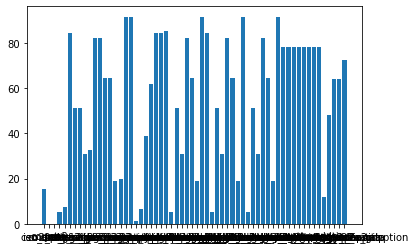

<Figure size 720x720 with 0 Axes>

In [13]:
column = list(percent_missing.keys())
percent = list(percent_missing.values())

plt.bar(range(len(percent_missing)), percent, tick_label=column)
plt.figure(figsize=(10,10))
plt.show()

In [14]:
#Getting the columns that have less than 50% of data missing
less_than_50_percent = {}
for col in percent_missing:
    if percent_missing[col] < 50:
        less_than_50_percent[col] = percent_missing[col]

In [15]:
less_than_50_percent

{'iso_code': 15.50271268613644,
 'country': 0.0,
 'year': 0.0,
 'co2': 5.07522413328716,
 'co2_per_capita': 7.530108892223633,
 'coal_co2': 31.0900765708569,
 'coal_co2_per_capita': 32.525299165031356,
 'oil_co2': 18.811804994420715,
 'oil_co2_per_capita': 20.000769556350765,
 'co2_growth_prct': 1.1274000538689444,
 'co2_growth_abs': 6.521990072723074,
 'co2_per_gdp': 39.00881142021625,
 'cumulative_co2': 5.07522413328716,
 'cumulative_coal_co2': 31.0900765708569,
 'cumulative_oil_co2': 18.811804994420715,
 'share_global_co2': 5.07522413328716,
 'share_global_coal_co2': 31.0900765708569,
 'share_global_oil_co2': 18.811804994420715,
 'share_global_cumulative_co2': 5.07522413328716,
 'share_global_cumulative_coal_co2': 31.0900765708569,
 'share_global_cumulative_oil_co2': 18.811804994420715,
 'population': 11.916580091577206,
 'gdp': 48.17422755781292}

In [16]:
#Getting the columns that have more than 50% of data missing
more_than_50_percent = {}
for col in percent_missing:
    if percent_missing[col] >= 50:
        more_than_50_percent[col] = percent_missing[col]

In [17]:
more_than_50_percent

{'trade_co2': 84.2394859363577,
 'cement_co2': 51.256300742621875,
 'cement_co2_per_capita': 51.37173419523645,
 'flaring_co2': 82.14244488052638,
 'flaring_co2_per_capita': 82.14629266228019,
 'gas_co2': 64.42725768594406,
 'gas_co2_per_capita': 64.46573550348225,
 'other_industry_co2': 91.50409788756781,
 'other_co2_per_capita': 91.50409788756781,
 'co2_per_unit_energy': 61.68378929547116,
 'consumption_co2': 84.2394859363577,
 'consumption_co2_per_capita': 84.2394859363577,
 'consumption_co2_per_gdp': 85.08215014044403,
 'cumulative_cement_co2': 51.256300742621875,
 'cumulative_flaring_co2': 82.14244488052638,
 'cumulative_gas_co2': 64.42725768594406,
 'cumulative_other_co2': 91.50409788756781,
 'trade_co2_share': 84.2394859363577,
 'share_global_cement_co2': 51.256300742621875,
 'share_global_flaring_co2': 82.14244488052638,
 'share_global_gas_co2': 64.42725768594406,
 'share_global_other_co2': 91.50409788756781,
 'share_global_cumulative_cement_co2': 51.256300742621875,
 'share_gl

In [18]:
#Getting the number of columns that are missing less than 50% of data
len(less_than_50_percent)

23

In [19]:
#Getting the number of columns that are missing more than 50% of data
len(more_than_50_percent)

37

In [20]:
#Getting the columns that have more than 80% of data missing
more_than_80_percent = {}
for col in percent_missing:
    if percent_missing[col] >= 80:
        more_than_80_percent[col] = percent_missing[col]

In [21]:
more_than_80_percent

{'trade_co2': 84.2394859363577,
 'flaring_co2': 82.14244488052638,
 'flaring_co2_per_capita': 82.14629266228019,
 'other_industry_co2': 91.50409788756781,
 'other_co2_per_capita': 91.50409788756781,
 'consumption_co2': 84.2394859363577,
 'consumption_co2_per_capita': 84.2394859363577,
 'consumption_co2_per_gdp': 85.08215014044403,
 'cumulative_flaring_co2': 82.14244488052638,
 'cumulative_other_co2': 91.50409788756781,
 'trade_co2_share': 84.2394859363577,
 'share_global_flaring_co2': 82.14244488052638,
 'share_global_other_co2': 91.50409788756781,
 'share_global_cumulative_flaring_co2': 82.14244488052638,
 'share_global_cumulative_other_co2': 91.50409788756781}

In [22]:
len(more_than_80_percent)

15

We should get rid of those columns with more than 80% of data missing

In [23]:
co2_df.shape

(25989, 60)

In [24]:
#Dropping our columns with over 80% of data missing
co2_df = co2_df.drop(columns=['trade_co2', 'flaring_co2', 'flaring_co2_per_capita', 'other_industry_co2', 'other_co2_per_capita', 'consumption_co2', 'consumption_co2_per_capita', 'consumption_co2_per_gdp', 'cumulative_flaring_co2', 'cumulative_other_co2', 'trade_co2_share', 'share_global_flaring_co2', 'share_global_other_co2', 'share_global_cumulative_flaring_co2', 'share_global_cumulative_other_co2'])

In [25]:
#Make sure we successfully removed those columns
co2_df.shape

(25989, 45)

### We will start with filling in null values in 'iso_code' column

In [26]:
co2_df['country'].nunique()

248

In [27]:
#Getting a list of all out countries
countries = co2_df['country'].unique()
print(countries)

['Afghanistan' 'Africa' 'Albania' 'Algeria' 'Andorra' 'Angola' 'Anguilla'
 'Antarctica' 'Antigua and Barbuda' 'Argentina' 'Armenia' 'Aruba' 'Asia'
 'Asia (excl. China & India)' 'Australia' 'Austria' 'Azerbaijan' 'Bahamas'
 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus' 'Belgium' 'Belize' 'Benin'
 'Bermuda' 'Bhutan' 'Bolivia' 'Bonaire Sint Eustatius and Saba'
 'Bosnia and Herzegovina' 'Botswana' 'Brazil' 'British Virgin Islands'
 'Brunei' 'Bulgaria' 'Burkina Faso' 'Burundi' 'Cambodia' 'Cameroon'
 'Canada' 'Cape Verde' 'Central African Republic' 'Chad' 'Chile' 'China'
 'Christmas Island' 'Colombia' 'Comoros' 'Congo' 'Cook Islands'
 'Costa Rica' "Cote d'Ivoire" 'Croatia' 'Cuba' 'Curacao' 'Cyprus'
 'Czechia' 'Democratic Republic of Congo' 'Denmark' 'Djibouti' 'Dominica'
 'Dominican Republic' 'EU-27' 'Ecuador' 'Egypt' 'El Salvador'
 'Equatorial Guinea' 'Eritrea' 'Estonia' 'Eswatini' 'Ethiopia' 'Europe'
 'Europe (excl. EU-27)' 'Europe (excl. EU-28)' 'European Union (27)'
 'European Union (28)' 

In [28]:
#Grabbing our rows with null values in iso_code column
df_missing_iso = co2_df[co2_df['iso_code'].isnull().values]
df_missing_iso

,iso_code,country,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
72,NaN,Africa,1884,0.022,0.005,NaN,NaN,0.022,0.005,NaN,...,NaN,NaN,NaN,NaN,NaN,130848603.0,NaN,NaN,NaN,NaN
73,NaN,Africa,1885,0.037,0.008,NaN,NaN,0.037,0.008,NaN,...,NaN,NaN,NaN,NaN,NaN,131563803.0,NaN,NaN,NaN,NaN
74,NaN,Africa,1886,0.048,0.010,NaN,NaN,0.048,0.010,NaN,...,NaN,NaN,NaN,NaN,NaN,132284841.0,NaN,NaN,NaN,NaN
75,NaN,Africa,1887,0.048,0.010,NaN,NaN,0.048,0.010,NaN,...,NaN,NaN,NaN,NaN,NaN,133011765.0,NaN,NaN,NaN,NaN
76,NaN,Africa,1888,0.081,0.017,NaN,NaN,0.081,0.017,NaN,...,NaN,NaN,NaN,NaN,NaN,133744628.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25453,NaN,Wallis and Futuna,2016,0.026,2.120,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,12098.0,NaN,NaN,NaN,NaN
25454,NaN,Wallis and Futuna,2017,0.026,2.156,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,11894.0,NaN,NaN,NaN,NaN
25455,NaN,Wallis and Futuna,2018,0.026,2.201,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,11653.0,NaN,NaN,NaN,NaN
25456,NaN,Wallis and Futuna,2019,0.026,2.312,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,11436.0,NaN,NaN,NaN,NaN


In [29]:
#Getting a list of the country names that do not have iso codes
country_missing_iso = df_missing_iso['country'].unique()
country_missing_iso

array(['Africa', 'Asia', 'Asia (excl. China & India)', 'EU-27', 'Europe',
       'Europe (excl. EU-27)', 'Europe (excl. EU-28)',
       'European Union (27)', 'European Union (28)',
       'French Equatorial Africa', 'French West Africa',
       'High-income countries', 'International transport',
       'Kuwaiti Oil Fires', 'Leeward Islands', 'Low-income countries',
       'Lower-middle-income countries', 'Macao', 'Micronesia (country)',
       'North America', 'North America (excl. USA)', 'Oceania',
       'Panama Canal Zone', 'Reunion', 'Ryukyu Islands', 'South America',
       'St. Kitts-Nevis-Anguilla', 'Upper-middle-income countries',
       'Wallis and Futuna'], dtype=object)

When taking a look at a website which has all the iso codes for the different countries, these countries did not have iso codes so we will just fill in 'noCode' for these countries with no iso codes because we will not really be using this column much.

In [30]:
#Replacing null vlaues in iso_code with 'noCode'
co2_df['iso_code'].fillna("noCode", inplace=True)

In [31]:
#Checking we actually filled in these values
co2_df.iso_code.isnull().sum()

0

##### Making a KNN function

In [32]:
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
def scaler_knn_funct(df, col_list, country):
    #scaling
    #scaler = MinMaxScaler()
    #df = pd.DataFrame(scaler.fit_transform(df), columns = df.columns)
    #df.head()
    #KNN
    imputer = KNNImputer(n_neighbors=2)
    data = df.values

    df = pd.DataFrame(imputer.fit_transform(df[col_list]))
    
    #checking that our values were filled in
    df.columns=[col_list]
    #df['country'] = country
    return(df)

In [33]:
cleaned = pd.DataFrame()
for country in countries:
    df = co2_df[co2_df.country == country]
    
    #getting rid of cetegorical data
    df = df.drop(columns=['iso_code', 'country'])
    cols = df.columns
    #df = df.drop(columns='country')
    df = df.dropna(axis=1, how='all')
    #scaling
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns = df.columns)
    
    print(df.shape)
    col_list = df.columns
    
    filled_in_df = scaler_knn_funct(df, col_list, country)
    #filled_in_df['country'] = country
    filled_in_df = scaler.inverse_transform(filled_in_df)
    filled_in_df = pd.DataFrame(filled_in_df)
    
    filled_in_df['country'] = country
    cleaned = pd.concat([cleaned,filled_in_df], axis=0, ignore_index=True)
    #cleaned.columns = col_list
    #cleaned = scaler.inverse_transform(cleaned)

    #cleaned['country'].concat(country)
    #cleaned = scaler.inverse_transform(cleaned)
   
    print(country)

(72, 43)
Afghanistan
(137, 33)
Africa
(88, 43)
Albania
(105, 43)
Algeria
(31, 22)
Andorra
(71, 43)
Angola
(31, 14)
Anguilla
(34, 13)
Antarctica
(64, 25)
Antigua and Barbuda
(134, 43)
Argentina
(191, 43)
Armenia
(95, 17)
Aruba
(191, 31)
Asia
(191, 30)
Asia (excl. China & India)
(161, 43)
Australia
(214, 43)
Austria
(191, 43)
Azerbaijan
(71, 35)
Bahamas
(88, 43)
Bahrain
(75, 43)
Bangladesh
(93, 43)
Barbados
(191, 43)
Belarus
(219, 43)
Belgium
(71, 30)
Belize
(63, 43)
Benin
(71, 22)
Bermuda
(51, 35)
Bhutan
(93, 43)
Bolivia
(95, 14)
Bonaire Sint Eustatius and Saba
(136, 43)
Bosnia and Herzegovina
(49, 43)
Botswana
(120, 43)
Brazil
(59, 17)
British Virgin Islands
(88, 35)
Brunei
(140, 43)
Bulgaria
(63, 33)
Burkina Faso
(71, 38)
Burundi
(66, 38)
Cambodia
(71, 43)
Cameroon
(236, 43)
Canada
(71, 38)
Cape Verde
(62, 28)
Central African Republic
(62, 33)
Chad
(126, 43)
Chile
(122, 43)
China
(51, 11)
Christmas Island
(100, 43)
Colombia
(62, 28)
Comoros
(62, 38)
Congo
(52, 25)
Cook Islands
(71, 38

In [34]:
cleaned.head()

,0,1,2,3,4,5,6,7,8,9,...,34,35,36,37,38,39,40,41,42,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan


In [35]:
cleaned.shape

(25989, 44)

In [36]:
print(cols)

Index(['year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy

In [37]:
len(cols)

43

In [38]:
cols = cols.insert(43, 'country')

In [39]:
len(cols)

44

In [40]:
cleaned.columns = cols

In [41]:
cleaned.head()

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan


In [42]:
cleaned.isnull().sum()

year                                      0
co2                                       0
co2_per_capita                            0
cement_co2                                0
cement_co2_per_capita                     0
coal_co2                                  0
coal_co2_per_capita                       0
gas_co2                                   0
gas_co2_per_capita                        0
oil_co2                                  29
oil_co2_per_capita                       59
co2_growth_prct                         245
co2_growth_abs                          245
co2_per_gdp                             279
co2_per_unit_energy                     551
cumulative_co2                          764
cumulative_cement_co2                   764
cumulative_coal_co2                    1370
cumulative_gas_co2                     1370
cumulative_oil_co2                     1606
share_global_co2                       1637
share_global_cement_co2                1650
share_global_coal_co2           

In [43]:
cleaned[cleaned.co2.isnull()]

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country


In [44]:
cleaned[cleaned['co2'].isnull()].country

Series([], Name: country, dtype: object)

In [45]:
cleaned.columns

Index(['year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy

In [46]:
cleaned.country

0        Afghanistan
1        Afghanistan
2        Afghanistan
3        Afghanistan
4        Afghanistan
            ...     
25984       Zimbabwe
25985       Zimbabwe
25986       Zimbabwe
25987       Zimbabwe
25988       Zimbabwe
Name: country, Length: 25989, dtype: object

In [47]:
cleaned[cleaned.country == 'NaN'].shape

(0, 44)

Now we will fill in the rest of our data by putting the entire dataframe into a KNN

In [48]:
#getting rid of cetegorical data
temp = cleaned
country_list = co2_df['country'].unique()

temp.country = temp.country.astype('category')
temp_encoded = pd.get_dummies(temp, columns=['country'], prefix=['country'])
    

In [49]:
temp.head()

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan


In [50]:
temp.shape

(25989, 44)

In [51]:
temp = temp.drop(columns=['country'])
#scaling
scaler = StandardScaler()
temp = pd.DataFrame(scaler.fit_transform(temp), columns = temp.columns)
temp.head()
#KNN
imputer = KNNImputer(n_neighbors=2)
data = temp.values

col_list = temp.columns

temp = pd.DataFrame(imputer.fit_transform(temp[col_list]))
temp = scaler.inverse_transform(temp)
    
#checking that our values were filled in
#temp.columns=[col_list]



In [52]:
temp = pd.DataFrame(temp)

In [53]:
temp.head()

,0,1,2,3,4,5,6,7,8,9,...,33,34,35,36,37,38,39,40,41,42
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,0.8535,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,0.6950,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,0.7820,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,0.7820,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,0.7820,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470


In [54]:
temp.columns = col_list

In [55]:
temp['country'] = co2_df['country']

In [56]:
temp.head()

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan


In [57]:
temp.tail()

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
25984,2016.0,10.738,0.765,0.639,0.046,6.959,0.496,3.139,0.224,-12.17,...,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.85,42573.62775,2.69575,Zimbabwe
25985,2017.0,9.582,0.673,0.678,0.048,5.665,0.398,3.239,0.228,-10.77,...,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.85,42573.62775,2.69575,Zimbabwe
25986,2018.0,11.854,0.821,0.697,0.048,7.101,0.492,4.056,0.281,23.72,...,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.85,42573.62775,2.69575,Zimbabwe
25987,2019.0,10.949,0.748,0.697,0.048,6.020,0.411,4.232,0.289,-7.64,...,2.145482e+10,49.4270,3374.877,2.1595,40677052.5,2.828654e+11,2322.85,42573.62775,2.69575,Zimbabwe
25988,2020.0,10.531,0.709,0.697,0.047,6.257,0.421,3.576,0.241,-3.82,...,2.145482e+10,47.6815,3300.747,2.1595,40677052.5,2.828654e+11,2322.85,42573.62775,2.69575,Zimbabwe


In [58]:
temp.shape

(25989, 44)

In [59]:
temp.country

0        Afghanistan
1        Afghanistan
2        Afghanistan
3        Afghanistan
4        Afghanistan
            ...     
25984       Zimbabwe
25985       Zimbabwe
25986       Zimbabwe
25987       Zimbabwe
25988       Zimbabwe
Name: country, Length: 25989, dtype: object

In [60]:
#Making sure we can access certain elements
temp.cement_co2.loc[54]

0.009999999999999787

In [61]:
co2_df = temp

In [62]:
co2_df.isnull().sum()

year                                  0
co2                                   0
co2_per_capita                        0
cement_co2                            0
cement_co2_per_capita                 0
coal_co2                              0
coal_co2_per_capita                   0
gas_co2                               0
gas_co2_per_capita                    0
oil_co2                               0
oil_co2_per_capita                    0
co2_growth_prct                       0
co2_growth_abs                        0
co2_per_gdp                           0
co2_per_unit_energy                   0
cumulative_co2                        0
cumulative_cement_co2                 0
cumulative_coal_co2                   0
cumulative_gas_co2                    0
cumulative_oil_co2                    0
share_global_co2                      0
share_global_cement_co2               0
share_global_coal_co2                 0
share_global_gas_co2                  0
share_global_oil_co2                  0


Now our data is all filled in :)

In [63]:
#Saving a new csv file with our new cleaned dataset for tableu
co2_df.to_csv('C:/Users/Quinn/Practicum Project/cleaned_co2.csv')

In [64]:
co2_df = pd.read_csv('cleaned_co2.csv', encoding='latin1')

In [65]:
co2_df.head()

,Unnamed: 0,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan


In [66]:
co2_df = co2_df.drop(columns='Unnamed: 0')

In [67]:
co2_df.shape

(25989, 44)

# EDA

## Feature Engineering

In [68]:
import seaborn as sns

For Pearsons correlation, +1 represent a positive correlation between two variables, -1 represnts a negative correlation between two variables, and 0 represents no correlation between two variables.

In [69]:
df = co2_df.drop(columns=['country'])

<AxesSubplot:>

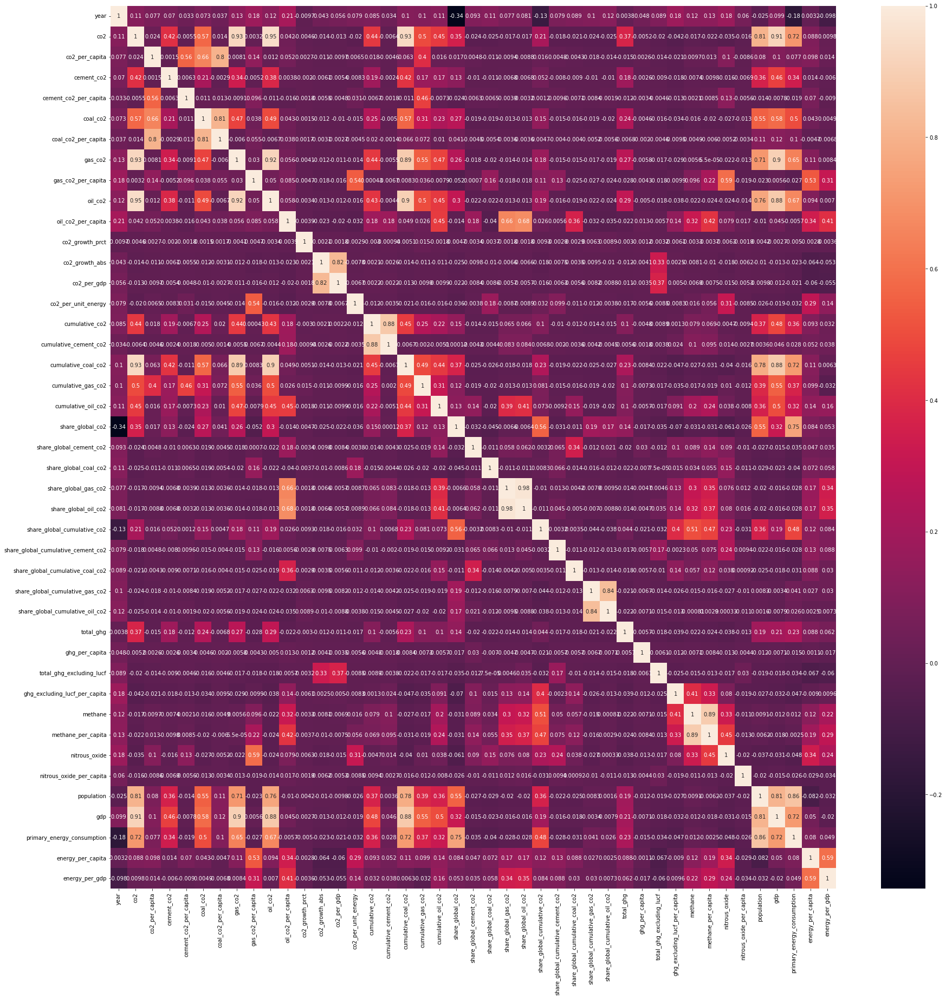

In [70]:
f = plt.figure(figsize=(30, 30))
correlations = df.corr()
sns.heatmap(df.corr(), annot=True)

In [71]:
print(correlations)

                                        year       co2  co2_per_capita  \
year                                1.000000  0.108146        0.076780   
co2                                 0.108146  1.000000        0.024468   
co2_per_capita                      0.076780  0.024468        1.000000   
cement_co2                          0.069638  0.416029        0.001472   
cement_co2_per_capita               0.032632 -0.005479        0.563906   
coal_co2                            0.073113  0.572284        0.658640   
coal_co2_per_capita                 0.036763  0.013682        0.803249   
gas_co2                             0.130807  0.926952        0.008102   
gas_co2_per_capita                  0.178876  0.003231        0.142299   
oil_co2                             0.119742  0.952456        0.011832   
oil_co2_per_capita                  0.210903  0.041545        0.052371   
co2_growth_prct                    -0.009735 -0.004582        0.002651   
co2_growth_abs                      0.

In [72]:
df.corr()

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
year,1.000000,0.108146,0.076780,0.069638,0.032632,0.073113,0.036763,0.130807,0.178876,0.119742,...,0.178516,0.124457,0.133126,0.175748,0.060495,-0.025299,0.099232,-0.182256,0.003234,-0.097945
co2,0.108146,1.000000,0.024468,0.416029,-0.005479,0.572284,0.013682,0.926952,0.003231,0.952456,...,-0.041708,-0.017189,-0.021748,-0.035344,-0.015595,0.805073,0.913429,0.716504,0.088445,0.009769
co2_per_capita,0.076780,0.024468,1.000000,0.001472,0.563906,0.658640,0.803249,0.008102,0.142299,0.011832,...,-0.021185,0.009730,0.013356,0.104687,-0.008638,0.079891,0.101708,0.077313,0.097628,0.014341
cement_co2,0.069638,0.416029,0.001472,1.000000,0.006265,0.214942,-0.002912,0.337459,-0.005198,0.381826,...,-0.018079,-0.007421,-0.009796,-0.016100,-0.006857,0.360849,0.462117,0.341101,0.014020,-0.005984
cement_co2_per_capita,0.032632,-0.005479,0.563906,0.006265,1.000000,0.010675,0.012627,-0.009072,0.095934,-0.011077,...,-0.012746,0.002111,0.008516,0.126298,-0.005601,-0.014053,-0.007843,-0.018965,0.070371,-0.008966
coal_co2,0.073113,0.572284,0.658640,0.214942,0.010675,1.000000,0.809976,0.473305,0.038036,0.493519,...,-0.033993,-0.016237,-0.019826,-0.026654,-0.012501,0.550102,0.583143,0.499346,0.043241,0.004947
coal_co2_per_capita,0.036763,0.013682,0.803249,-0.002912,0.012627,0.809976,1.000000,-0.006031,0.054989,-0.006734,...,-0.009488,-0.004879,-0.006036,-0.005155,-0.003433,0.108691,0.117504,0.102241,-0.004737,-0.006772
gas_co2,0.130807,0.926952,0.008102,0.337459,-0.009072,0.473305,-0.006031,1.000000,0.029586,0.916515,...,-0.028614,0.005640,0.000055,-0.022215,-0.013189,0.711842,0.902795,0.645949,0.106860,0.008378
gas_co2_per_capita,0.178876,0.003231,0.142299,-0.005198,0.095934,0.038036,0.054989,0.029586,1.000000,0.049910,...,-0.009871,0.095523,0.215375,0.589758,-0.018796,-0.023122,0.005645,-0.026668,0.528476,0.307928
oil_co2,0.119742,0.952456,0.011832,0.381826,-0.011077,0.493519,-0.006734,0.916515,0.049910,1.000000,...,-0.037577,-0.021812,-0.023735,-0.023812,-0.014164,0.763384,0.884148,0.665881,0.093926,0.006981


In [73]:
columns = df.columns

In [74]:
for col in columns:
    print('------------------------------------------------')
    print('Correlations for column ' + str(col))
    print(correlations[col])

------------------------------------------------
Correlations for column year
year                                  1.000000
co2                                   0.108146
co2_per_capita                        0.076780
cement_co2                            0.069638
cement_co2_per_capita                 0.032632
coal_co2                              0.073113
coal_co2_per_capita                   0.036763
gas_co2                               0.130807
gas_co2_per_capita                    0.178876
oil_co2                               0.119742
oil_co2_per_capita                    0.210903
co2_growth_prct                      -0.009735
co2_growth_abs                        0.042518
co2_per_gdp                           0.056016
co2_per_unit_energy                   0.079127
cumulative_co2                        0.085110
cumulative_cement_co2                 0.033694
cumulative_coal_co2                   0.103081
cumulative_gas_co2                    0.099806
cumulative_oil_co2           

Co2 is our target variable so lets look at the top 10 variables related to co2

In [75]:
print(correlations['co2'])

year                                  0.108146
co2                                   1.000000
co2_per_capita                        0.024468
cement_co2                            0.416029
cement_co2_per_capita                -0.005479
coal_co2                              0.572284
coal_co2_per_capita                   0.013682
gas_co2                               0.926952
gas_co2_per_capita                    0.003231
oil_co2                               0.952456
oil_co2_per_capita                    0.041545
co2_growth_prct                      -0.004582
co2_growth_abs                       -0.014447
co2_per_gdp                          -0.012569
co2_per_unit_energy                  -0.020227
cumulative_co2                        0.438630
cumulative_cement_co2                -0.006398
cumulative_coal_co2                   0.933696
cumulative_gas_co2                    0.495026
cumulative_oil_co2                    0.445784
share_global_co2                      0.352110
share_global_

<function matplotlib.pyplot.show(close=None, block=None)>

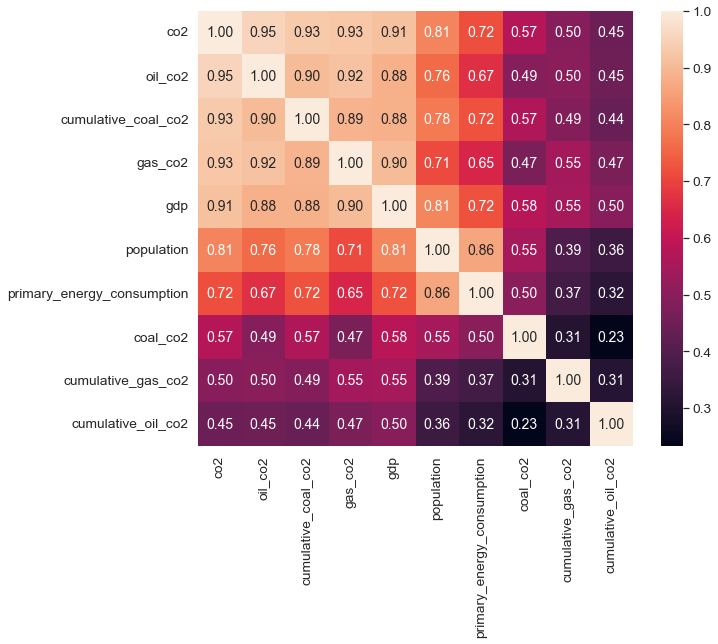

In [76]:
k = 10
cols = correlations.nlargest(k, 'co2')['co2'].index

#Numpy corrcoef gives a pearson correlation coefficient
cm = np.corrcoef(df[cols].values.T)
sns.set(font_scale = 1.25)
f, ax = plt.subplots(figsize=(10,8))
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size':14},yticklabels=cols.values, xticklabels=cols.values)
plt.show

### Feature Importance -- Random Forest

In [77]:
X = df[correlations.columns[:-1]]
X

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,total_ghg_excluding_lucf,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,14.0350,8.535000e-01,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,16.7450,6.950000e-01,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,15.9950,7.820000e-01,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,15.9950,7.820000e-01,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,15.9950,7.820000e-01,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25984,2016.0,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,...,0.4430,1.403034e+07,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775
25985,2017.0,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,...,0.4460,1.423660e+07,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775
25986,2018.0,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,...,0.4560,1.443881e+07,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775
25987,2019.0,10.949,0.748,0.697,0.0480,6.020,0.411,4.2320,0.2890,-7.6400,...,0.4445,1.464547e+07,2.145482e+10,49.4270,3374.877,2.1595,40677052.5,2.828654e+11,2322.8500,42573.62775


In [78]:
X = X.drop(columns=['co2'])

In [79]:
X

,year,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,total_ghg_excluding_lucf,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita
0,1949.0,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,14.0350,8.535000e-01,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600
1,1950.0,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,16.7450,6.950000e-01,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250
2,1951.0,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,15.9950,7.820000e-01,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500
3,1952.0,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,15.9950,7.820000e-01,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500
4,1953.0,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,15.9950,7.820000e-01,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25984,2016.0,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,-1.488,...,0.4430,1.403034e+07,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775
25985,2017.0,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,-1.156,...,0.4460,1.423660e+07,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775
25986,2018.0,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,2.273,...,0.4560,1.443881e+07,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775
25987,2019.0,0.748,0.697,0.0480,6.020,0.411,4.2320,0.2890,-7.6400,-0.905,...,0.4445,1.464547e+07,2.145482e+10,49.4270,3374.877,2.1595,40677052.5,2.828654e+11,2322.8500,42573.62775


In [80]:
y = df['co2'].values
y

array([ 0.015,  0.084,  0.092, ..., 11.854, 10.949, 10.531])

In [81]:
from sklearn.ensemble import RandomForestRegressor

In [82]:
model = RandomForestRegressor()

In [83]:
model.fit(X,y)

RandomForestRegressor()

In [84]:
importance_list = list(zip(X.columns, model.feature_importances_))
sorted_importance = sorted(importance_list, key=lambda x: x[1], reverse=True)
sorted_importance

[('oil_co2', 0.7870685304038091),
 ('coal_co2', 0.08932707872032494),
 ('cumulative_coal_co2', 0.028793484903923243),
 ('cumulative_co2', 0.018542263673936323),
 ('gas_co2', 0.017858450647297113),
 ('population', 0.017254915917536334),
 ('gdp', 0.010640820253390432),
 ('primary_energy_consumption', 0.007973798727293637),
 ('cement_co2', 0.004481244843229339),
 ('methane', 0.0028692939557205693),
 ('cumulative_oil_co2', 0.0016485494800499243),
 ('total_ghg', 0.0012547306286444227),
 ('cumulative_gas_co2', 0.0009215195004765063),
 ('ghg_per_capita', 0.000886369759218191),
 ('share_global_coal_co2', 0.0008138650685506117),
 ('co2_per_gdp', 0.0008082988746232291),
 ('cumulative_cement_co2', 0.0008078887850208348),
 ('energy_per_capita', 0.0007336882178673413),
 ('gas_co2_per_capita', 0.0007139301997843984),
 ('total_ghg_excluding_lucf', 0.0007007765737325588),
 ('cement_co2_per_capita', 0.0005741054730107398),
 ('ghg_excluding_lucf_per_capita', 0.0005268603344237996),
 ('coal_co2_per_capit

In [85]:
max_feature_len = len(max(X.columns, key=len))

In [86]:
#Printing the percentages
for feature, rank in sorted_importance:
    dots = max_feature_len - len(feature)
    print(f'{feature}: {"."*dots} {rank*100:.2f}%')

oil_co2: ........................... 78.71%
coal_co2: .......................... 8.93%
cumulative_coal_co2: ............... 2.88%
cumulative_co2: .................... 1.85%
gas_co2: ........................... 1.79%
population: ........................ 1.73%
gdp: ............................... 1.06%
primary_energy_consumption: ........ 0.80%
cement_co2: ........................ 0.45%
methane: ........................... 0.29%
cumulative_oil_co2: ................ 0.16%
total_ghg: ......................... 0.13%
cumulative_gas_co2: ................ 0.09%
ghg_per_capita: .................... 0.09%
share_global_coal_co2: ............. 0.08%
co2_per_gdp: ....................... 0.08%
cumulative_cement_co2: ............. 0.08%
energy_per_capita: ................. 0.07%
gas_co2_per_capita: ................ 0.07%
total_ghg_excluding_lucf: .......... 0.07%
cement_co2_per_capita: ............. 0.06%
ghg_excluding_lucf_per_capita: ..... 0.05%
coal_co2_per_capita: ............... 0.05%
share_glob

## Global Greenhouse Gas emissions by Sector

#### Database Citation:

#### Database Description:

This data from Climate Watch, the World Resources Institute(2020) represents Global greenhouse gas emissions by sector for the year 2020. I used this data because it is important for us to know where the majority of our emissions are going to so that we can find creative ways to reduce our greenhouse gas emissions.

In [87]:
from pandas import read_excel
sector = pd.read_excel('Global-GHG-Emissions-by-sector-based-on-WRI-2020.xlsx', index_col=0)

In [88]:
sector

,Share of global greenhouse gas emissions (%)
Sub-sector,
Road,11.9
Aviation,1.9
Rail,0.4
Pipeline,0.3
Ship,1.7
Residential,10.9
Commercial,6.6
Iron & Steel,7.2
Non-ferous metals,0.7


In [89]:
sector.columns

Index(['Share of global greenhouse gas emissions (%)'], dtype='object')

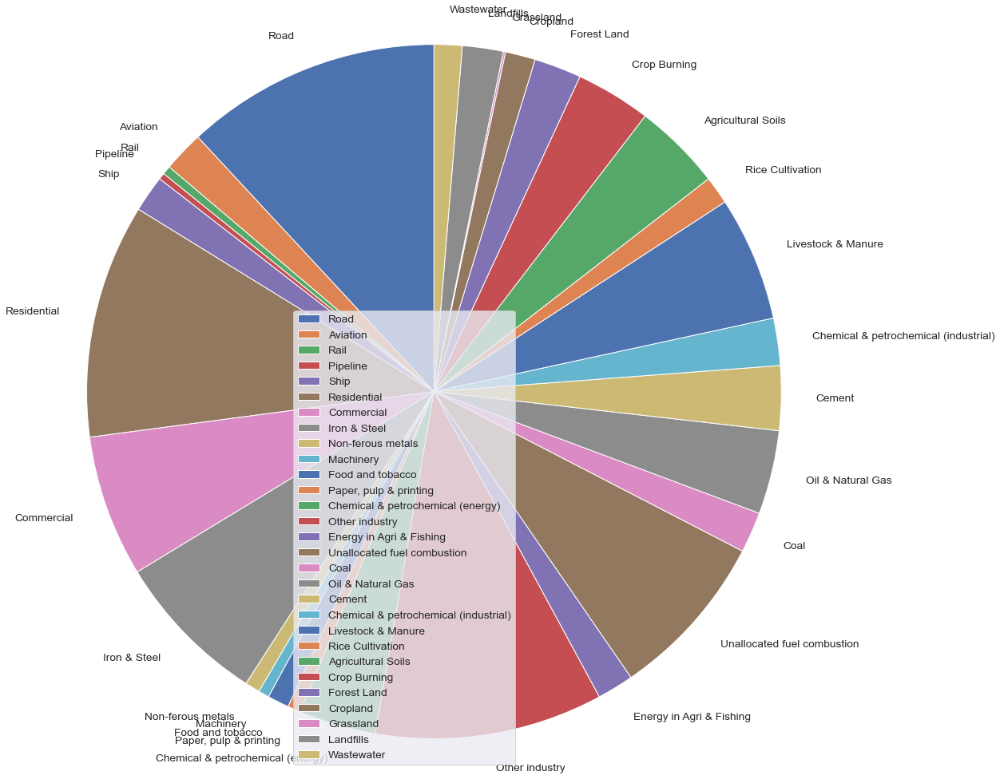

In [90]:
y = sector['Share of global greenhouse gas emissions (%)']
mylabels = sector.index

plt.pie(y, labels = mylabels, startangle = 90, radius=5)
plt.legend()
plt.show()


In [91]:
types = ['energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy', 'energy' ,'energy', 'energy', 'energy', 'energy', 'industry', 'industry', 'Agriculture, forest, and land use', 'Agriculture, forest, and land use', 'Agriculture, forest, and land use', 'Agriculture, forest, and land use', 'Agriculture, forest, and land use', 'Agriculture, forest, and land use', 'Agriculture, forest, and land use', 'waste', 'waste']

In [92]:
sector['type'] = types

In [93]:
sector

,Share of global greenhouse gas emissions (%),type
Sub-sector,,
Road,11.9,energy
Aviation,1.9,energy
Rail,0.4,energy
Pipeline,0.3,energy
Ship,1.7,energy
Residential,10.9,energy
Commercial,6.6,energy
Iron & Steel,7.2,energy
Non-ferous metals,0.7,energy


In [94]:
grouped = sector.groupby('type')

In [95]:
grouped.head()

,Share of global greenhouse gas emissions (%),type
Sub-sector,,
Road,11.9,energy
Aviation,1.9,energy
Rail,0.4,energy
Pipeline,0.3,energy
Ship,1.7,energy
Cement,3.0,industry
Chemical & petrochemical (industrial),2.2,industry
Livestock & Manure,5.8,"Agriculture, forest, and land use"
Rice Cultivation,1.3,"Agriculture, forest, and land use"


In [96]:
for t in types:
    print(sector[sector.type == t]['Share of global greenhouse gas emissions (%)'].sum())

73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
73.2
5.2
5.2
18.4
18.4
18.4
18.4
18.4
18.4
18.4
3.2
3.2


In [97]:
t = pd.DataFrame(columns = ['energy type', 'emission percentage'])

In [98]:
t['energy type'] = ['energy', 'industry', 'Agriculture, forest, and land use', 'waste']

In [99]:
t['emission percentage'] = [73.2, 5.2, 18.4, 3.2]

In [100]:
t

,energy type,emission percentage
0,energy,73.2
1,industry,5.2
2,"Agriculture, forest, and land use",18.4
3,waste,3.2


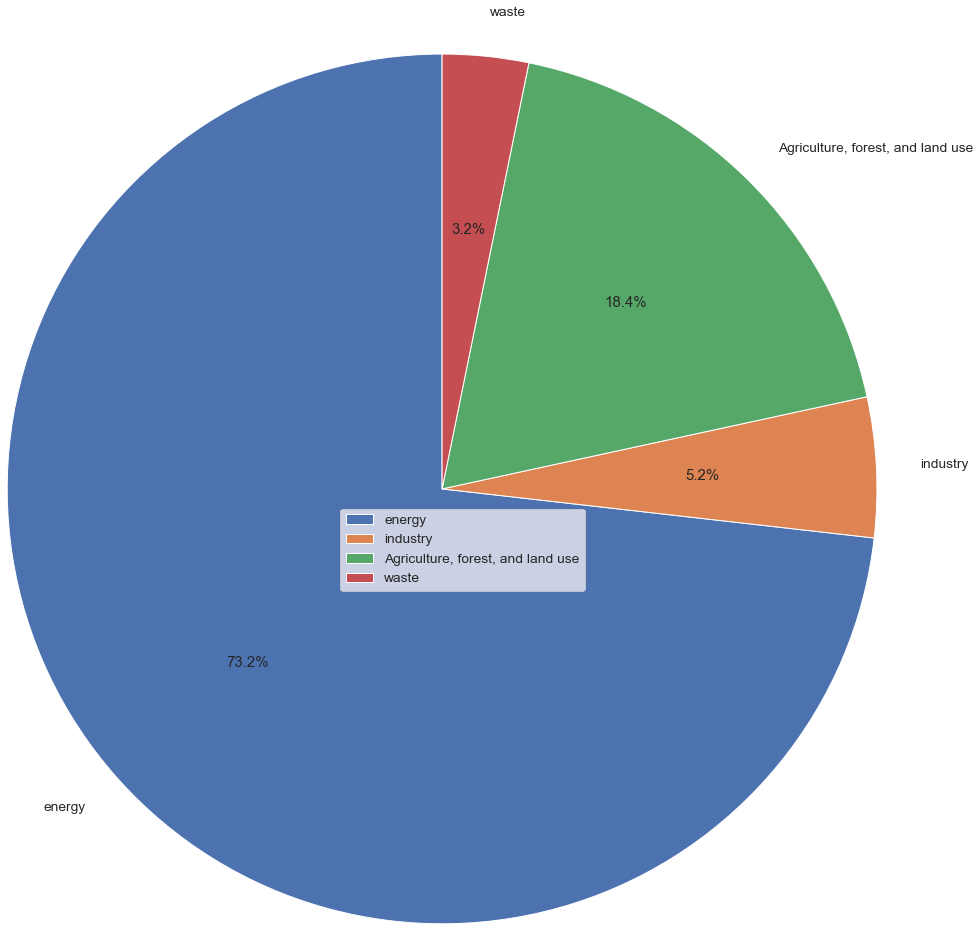

In [101]:
y = t['emission percentage']
mylabels = t['energy type']

plt.pie(y, labels = mylabels, autopct='%1.1f%%', startangle = 90, radius=5)
plt.legend()
plt.show()


We can see here that the majority of our emissions (73.2%) are for energy use, the second largest sector would be Agriculture, forest, and land use with 18.4%, next would be industry emissions with 5.2% and lastly we have waste with 3.2%

In [102]:
df = co2_df

In [103]:
import matplotlib.pylab as plt
countries = df.country.unique()
countries


array(['Afghanistan', 'Africa', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Anguilla', 'Antarctica', 'Antigua and Barbuda', 'Argentina',
       'Armenia', 'Aruba', 'Asia', 'Asia (excl. China & India)',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin',
       'Bermuda', 'Bhutan', 'Bolivia', 'Bonaire Sint Eustatius and Saba',
       'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'British Virgin Islands', 'Brunei', 'Bulgaria', 'Burkina Faso',
       'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros', 'Congo', 'Cook Islands',
       'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Curacao',
       'Cyprus', 'Czechia', 'Democratic Republic of Congo', 'Denmark',
       'Djibouti', 'Dominica', 'Dominican Republic', 'EU-27', 'Ecuador',
       'Egypt', 'El Salvador', 'Equa

Afghanistan


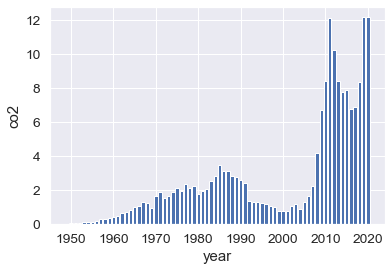

Africa


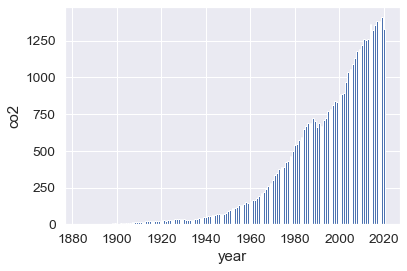

Albania


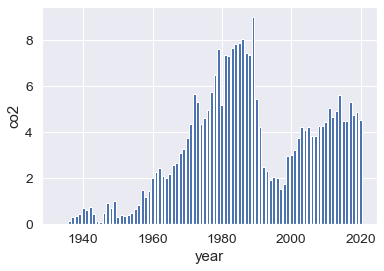

Algeria


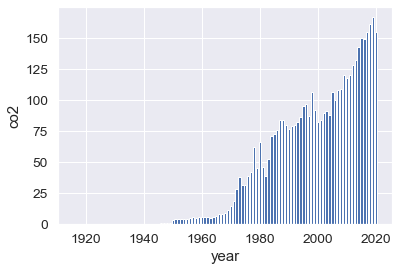

Andorra


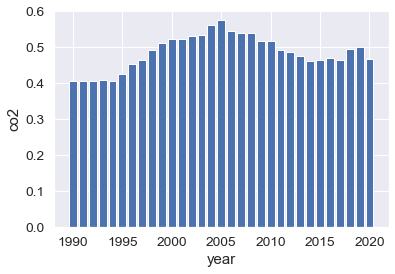

Angola


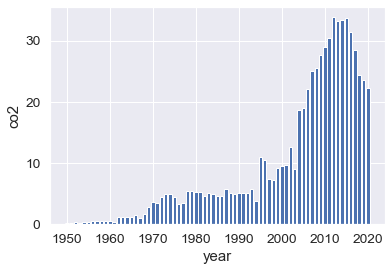

Anguilla


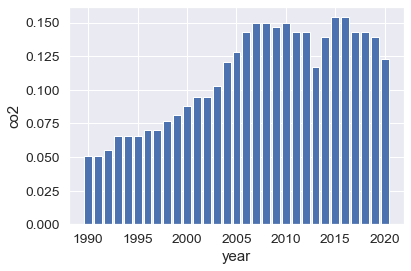

Antarctica


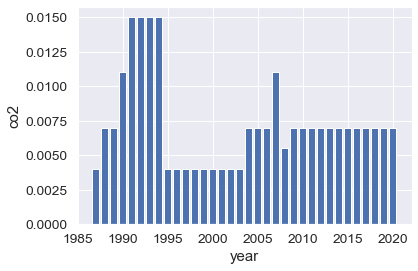

Antigua and Barbuda


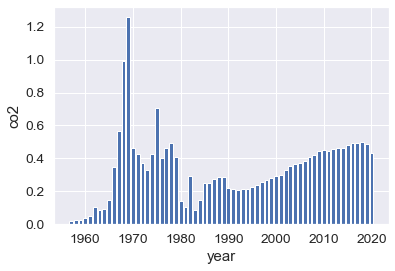

Argentina


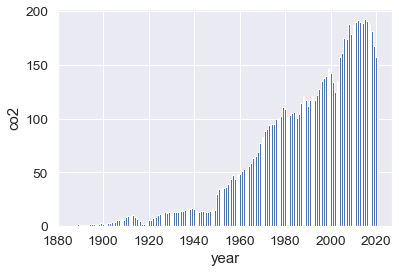

Armenia


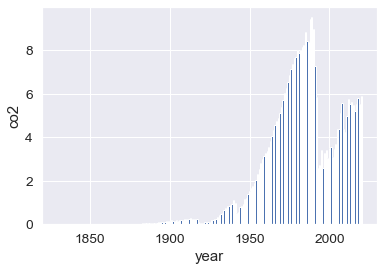

Aruba


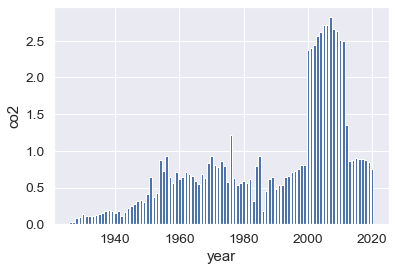

Asia


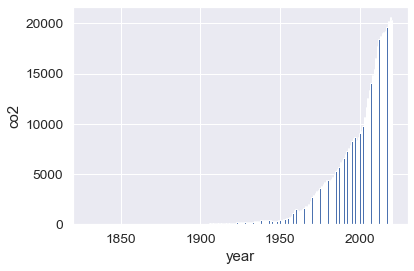

Asia (excl. China & India)


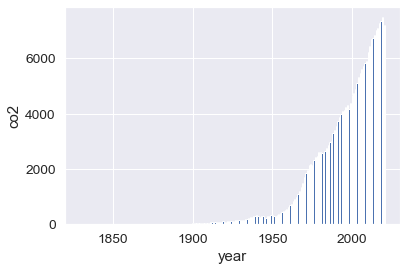

Australia


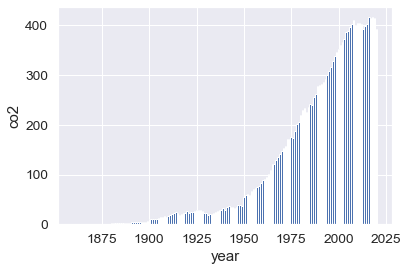

Austria


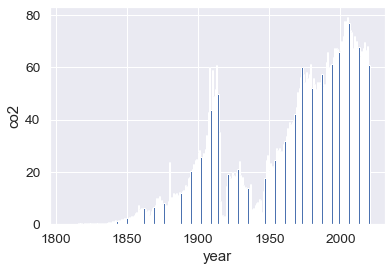

Azerbaijan


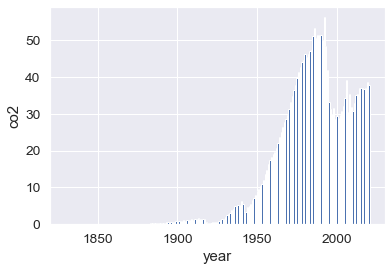

Bahamas


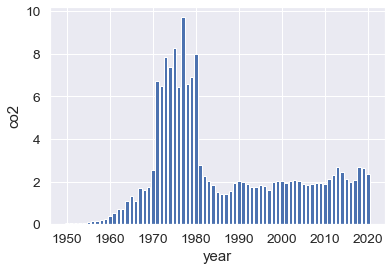

Bahrain


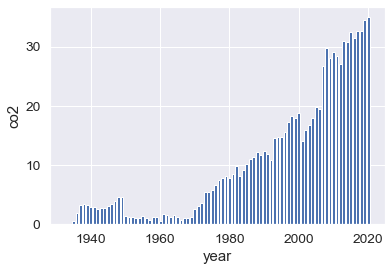

Bangladesh


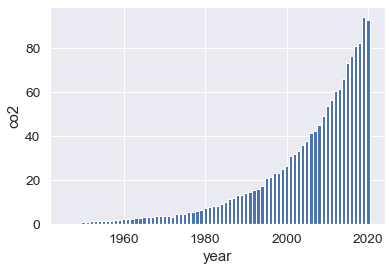

Barbados


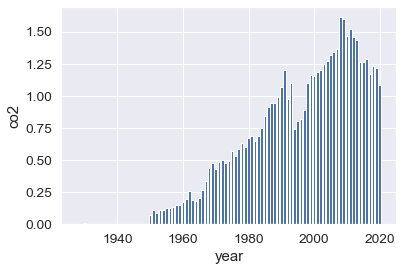

Belarus


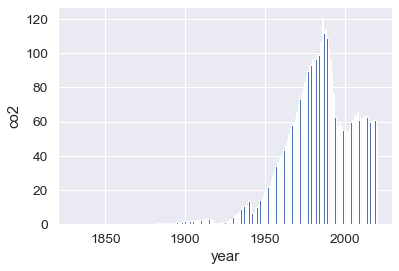

Belgium


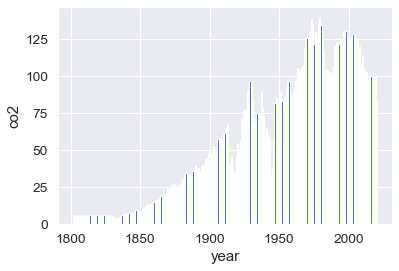

Belize


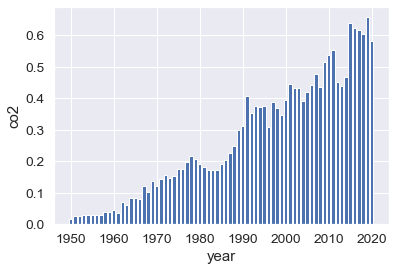

Benin


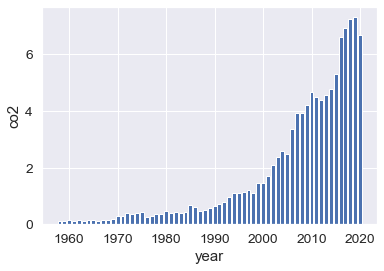

Bermuda


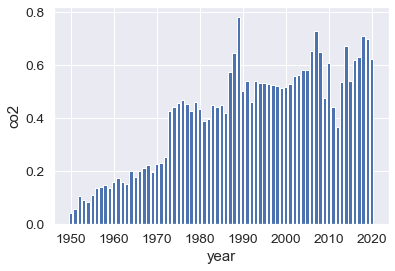

Bhutan


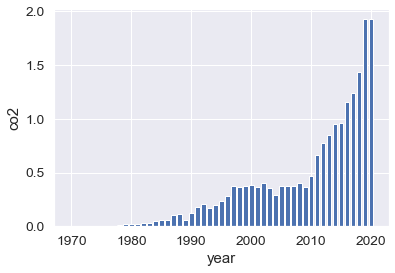

Bolivia


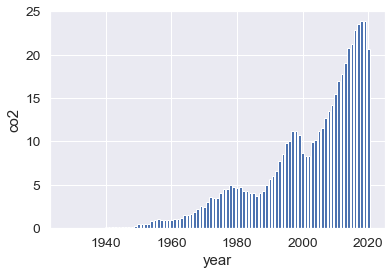

Bonaire Sint Eustatius and Saba


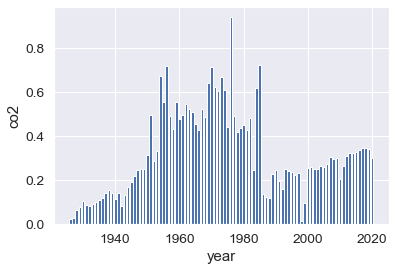

Bosnia and Herzegovina


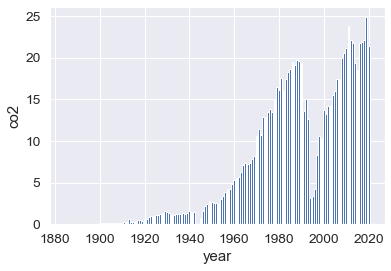

Botswana


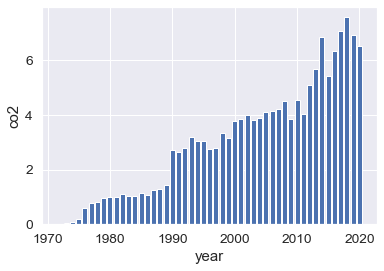

Brazil


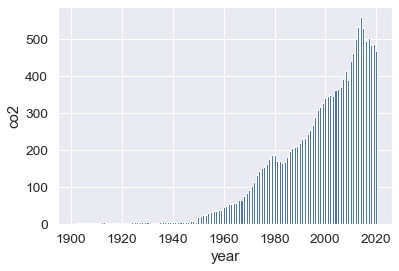

British Virgin Islands


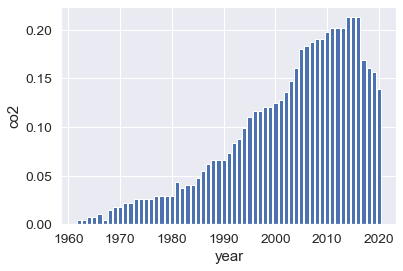

Brunei


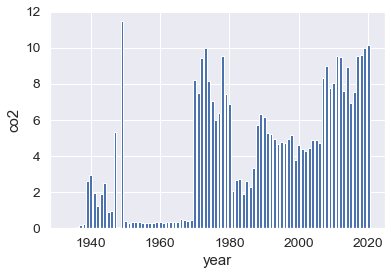

Bulgaria


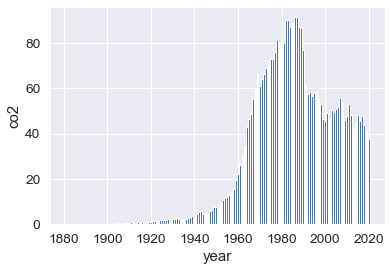

Burkina Faso


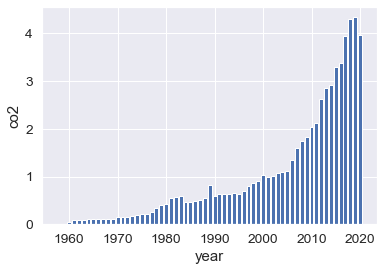

Burundi


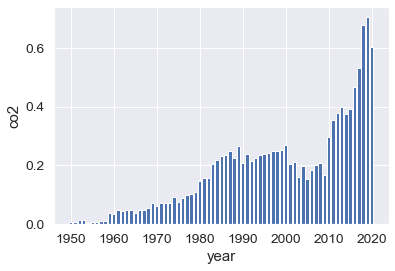

Cambodia


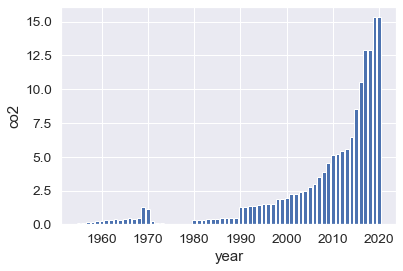

Cameroon


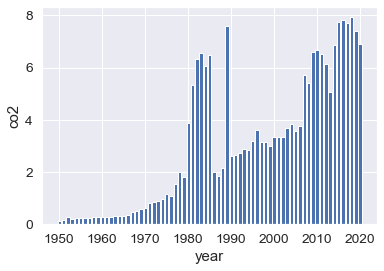

Canada


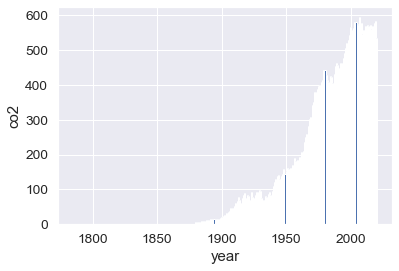

Cape Verde


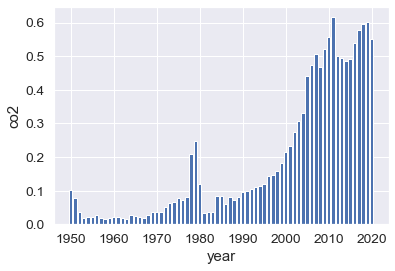

Central African Republic


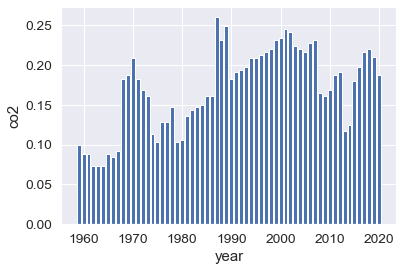

Chad


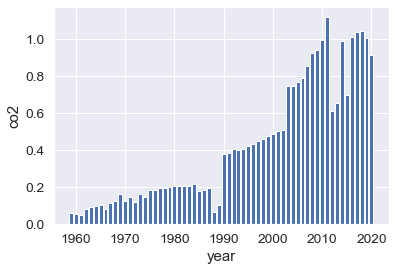

Chile


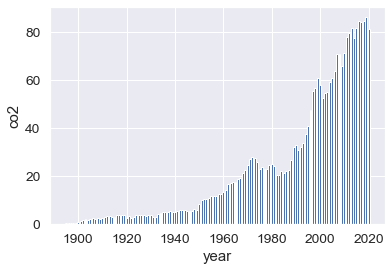

China


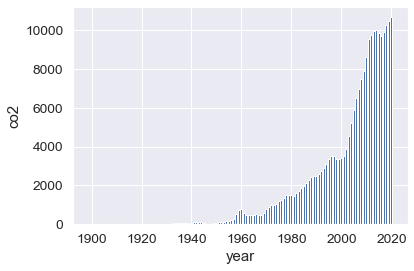

Christmas Island


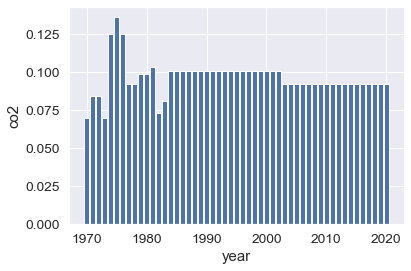

Colombia


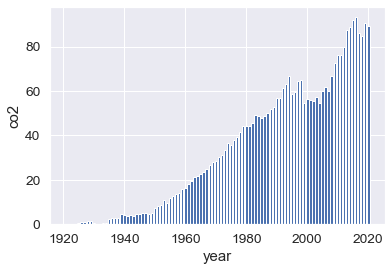

Comoros


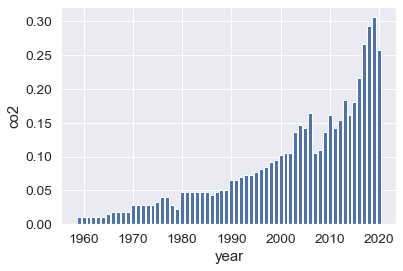

Congo


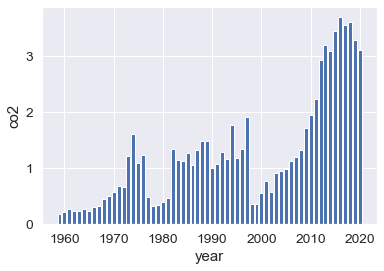

Cook Islands


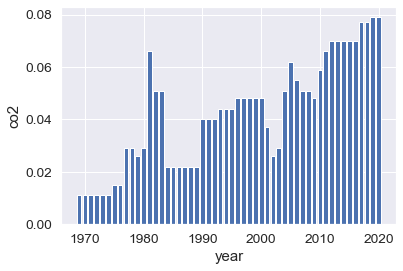

Costa Rica


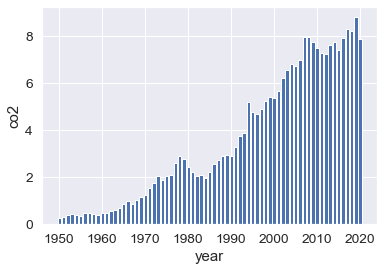

Cote d'Ivoire


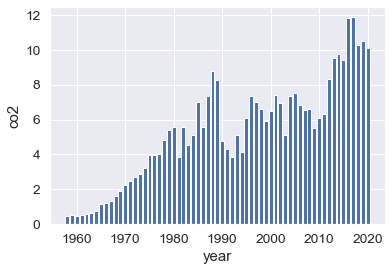

Croatia


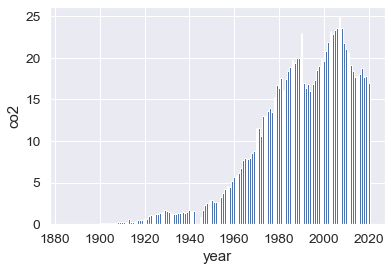

Cuba


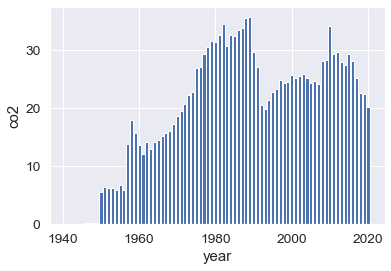

Curacao


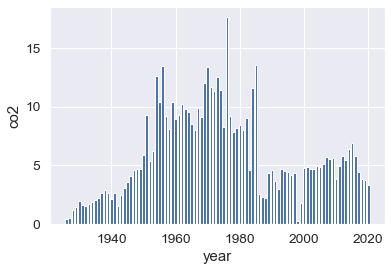

Cyprus


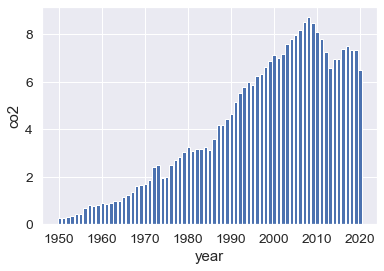

Czechia


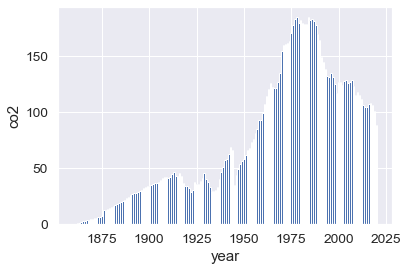

Democratic Republic of Congo


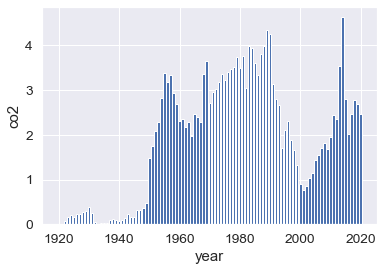

Denmark


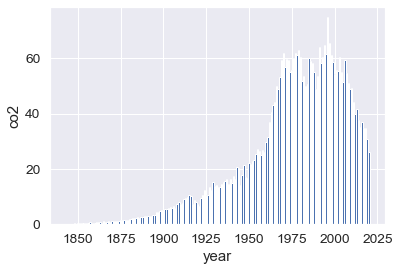

Djibouti


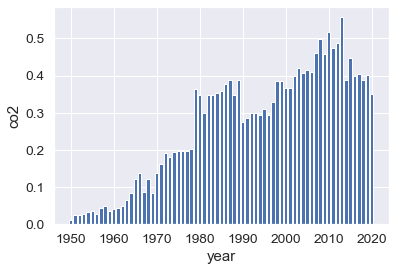

Dominica


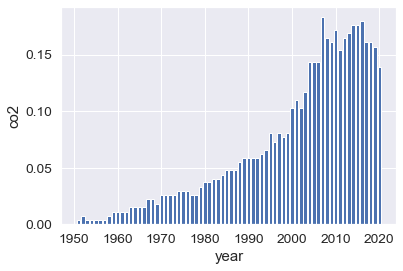

Dominican Republic


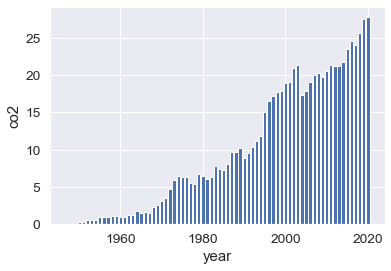

EU-27


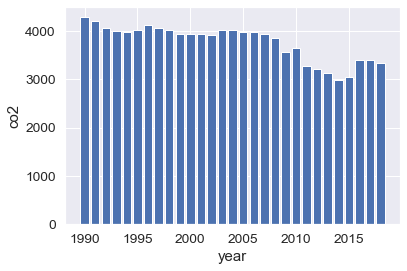

Ecuador


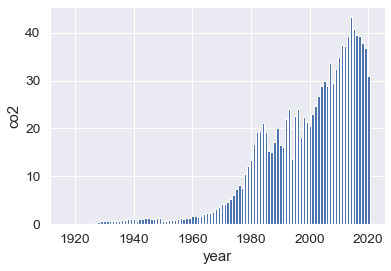

Egypt


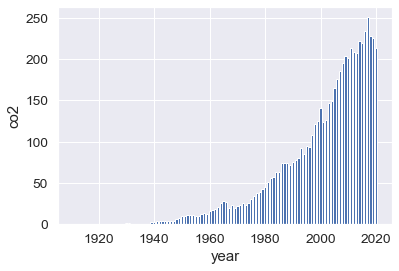

El Salvador


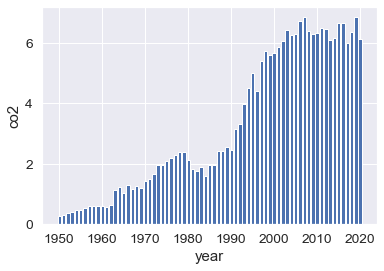

Equatorial Guinea


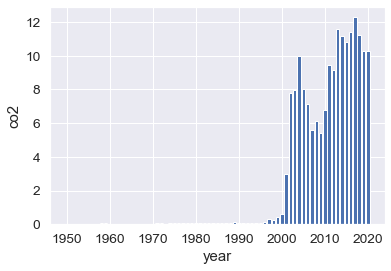

Eritrea


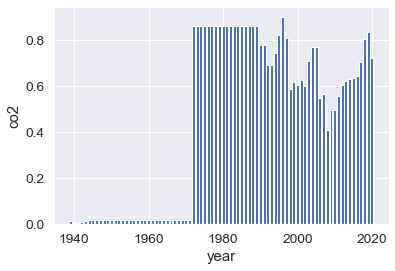

Estonia


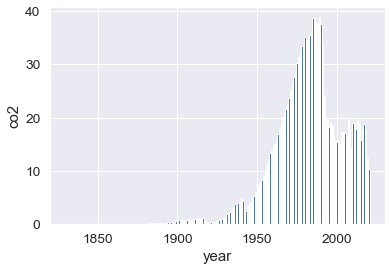

Eswatini


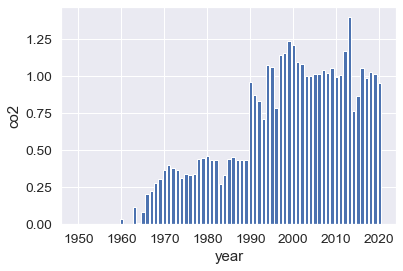

Ethiopia


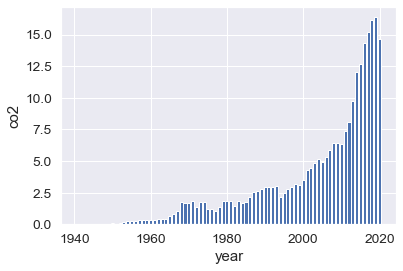

Europe


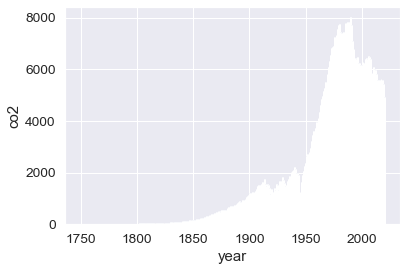

Europe (excl. EU-27)


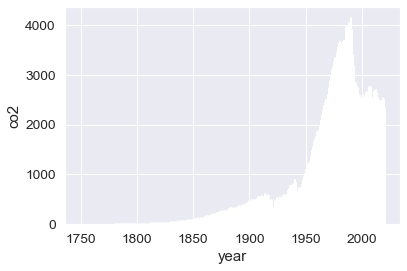

Europe (excl. EU-28)


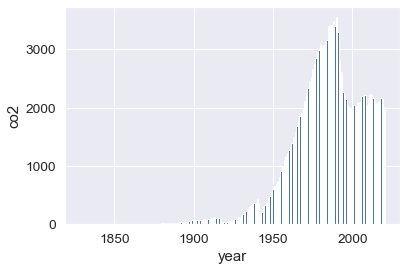

European Union (27)


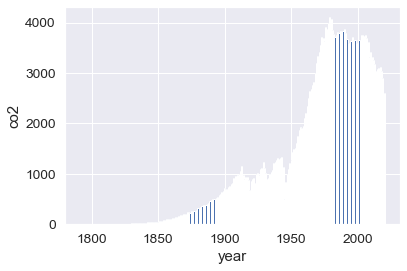

European Union (28)


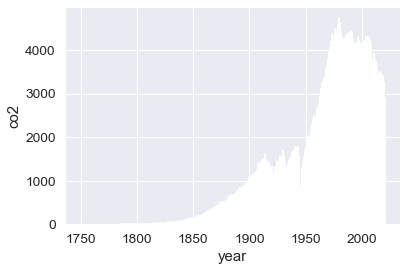

Faeroe Islands


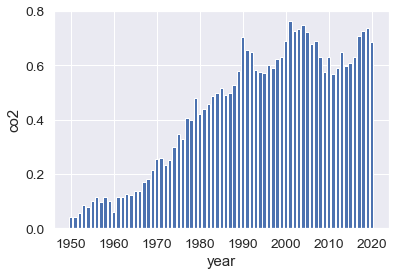

Fiji


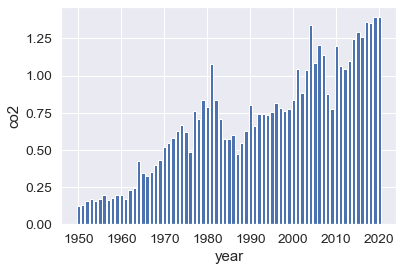

Finland


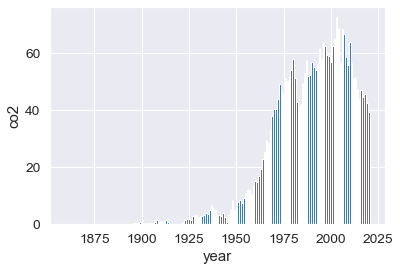

France


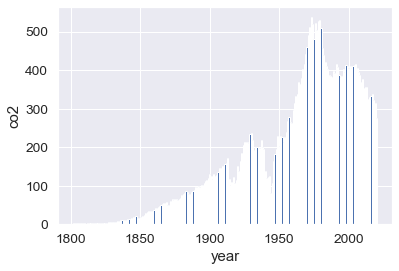

French Equatorial Africa


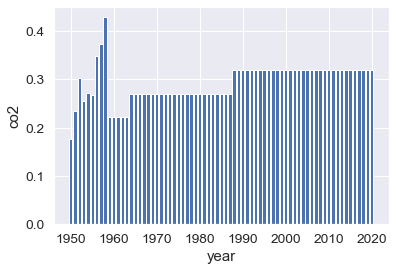

French Guiana


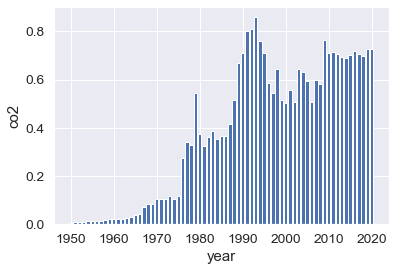

French Polynesia


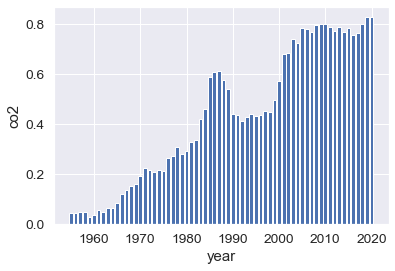

French West Africa


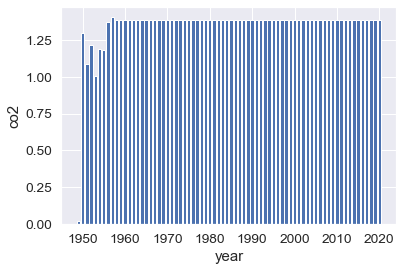

Gabon


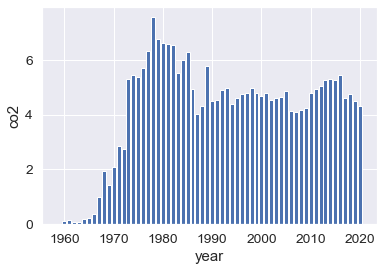

Gambia


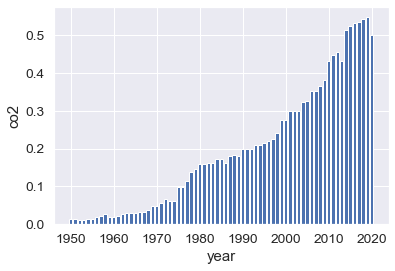

Georgia


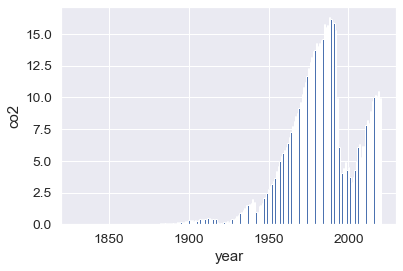

Germany


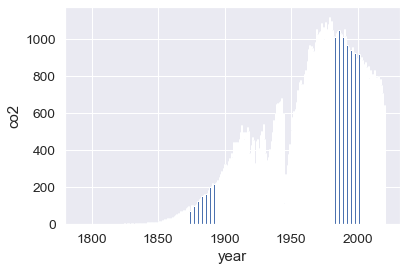

Ghana


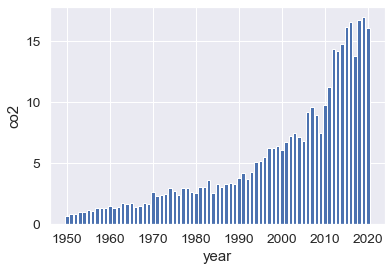

Greece


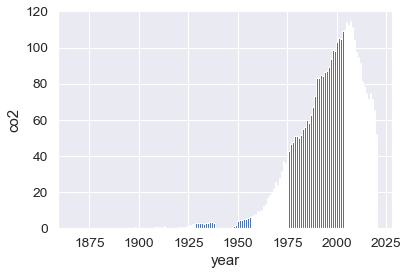

Greenland


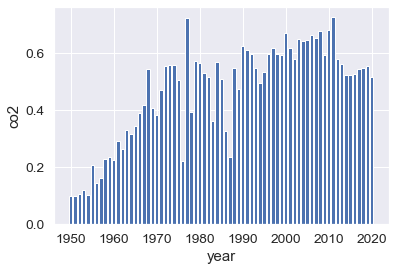

Grenada


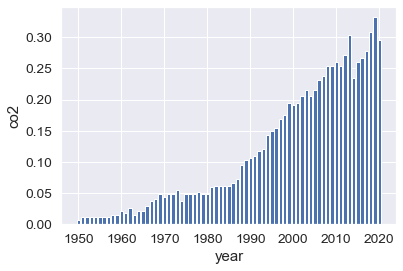

Guadeloupe


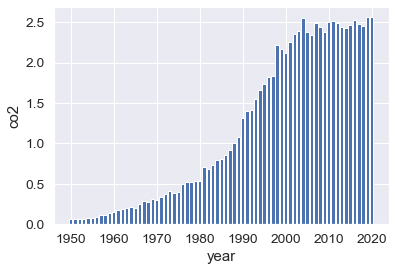

Guatemala


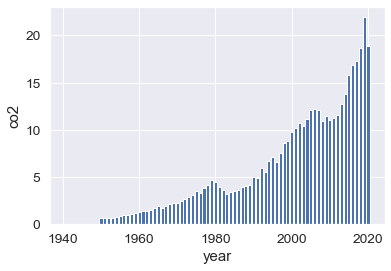

Guinea


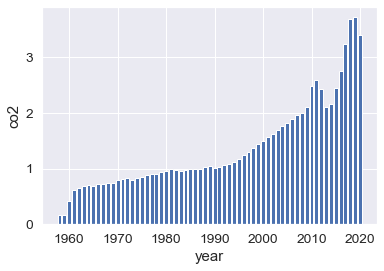

Guinea-Bissau


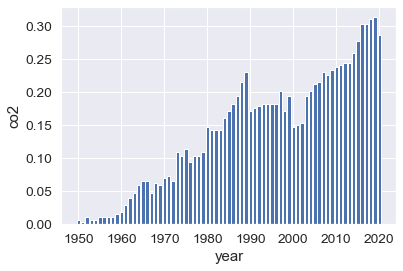

Guyana


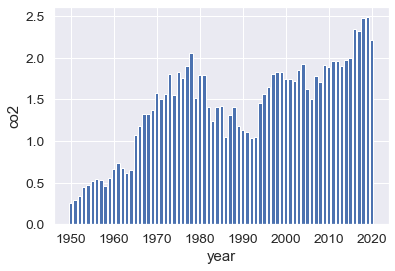

Haiti


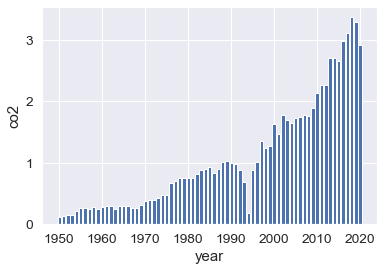

High-income countries


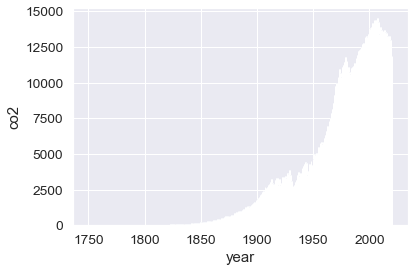

Honduras


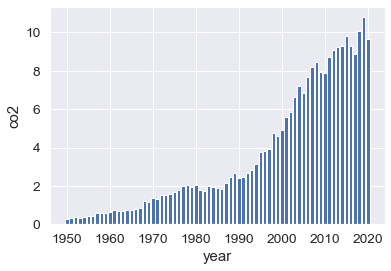

Hong Kong


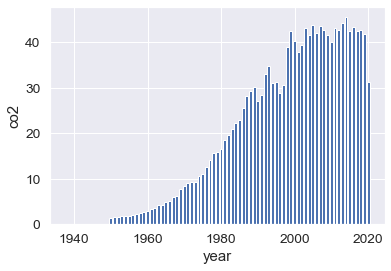

Hungary


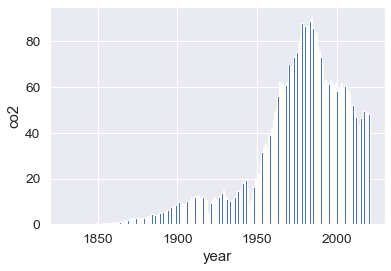

Iceland


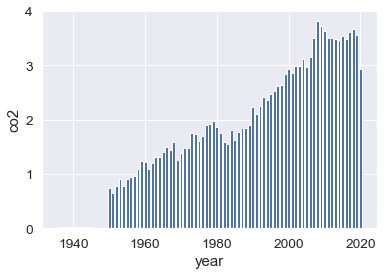

India


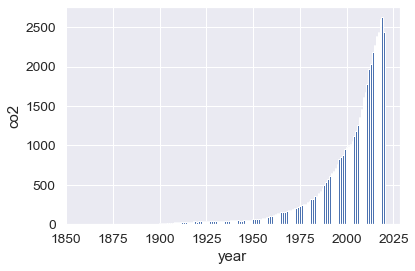

Indonesia


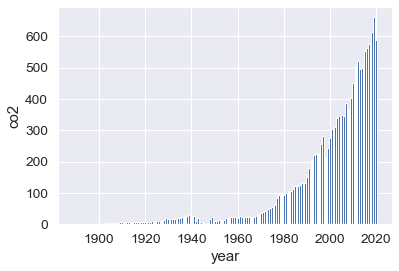

International transport


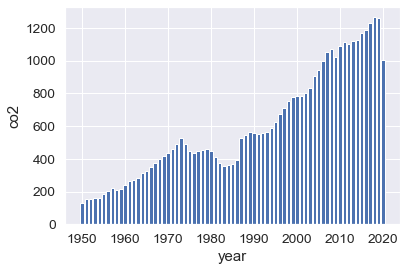

Iran


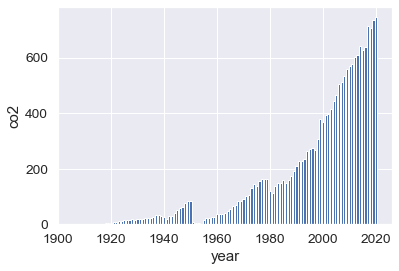

Iraq


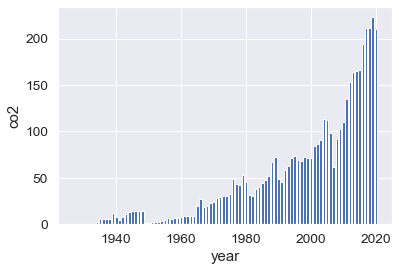

Ireland


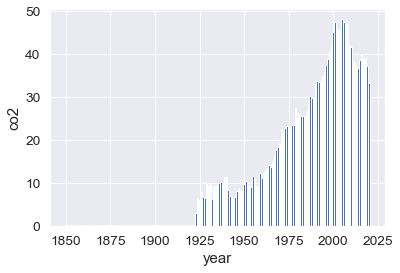

Israel


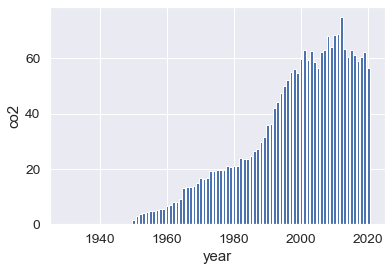

Italy


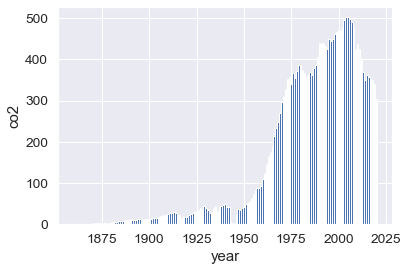

Jamaica


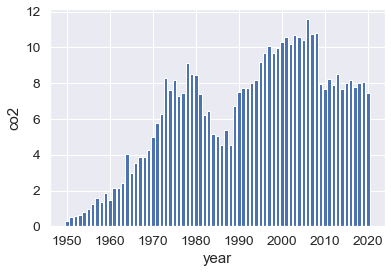

Japan


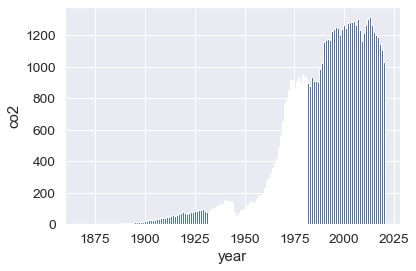

Jordan


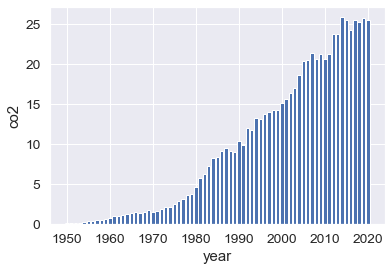

Kazakhstan


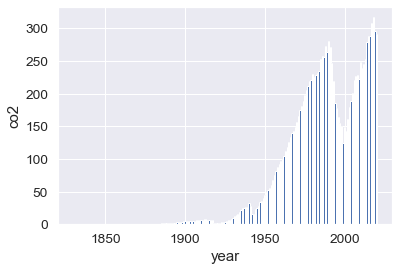

Kenya


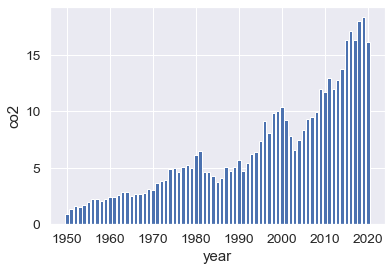

Kiribati


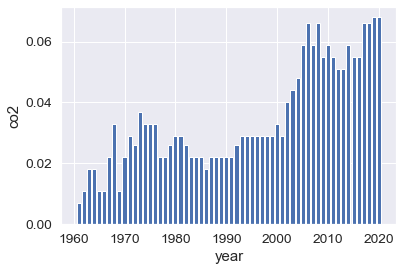

Kosovo


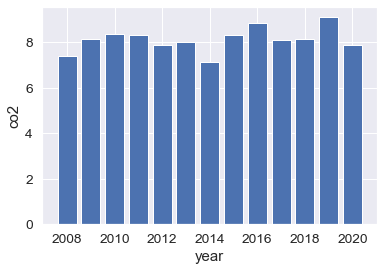

Kuwait


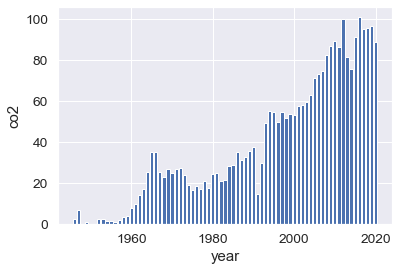

Kuwaiti Oil Fires


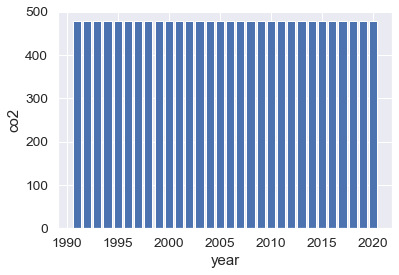

Kyrgyzstan


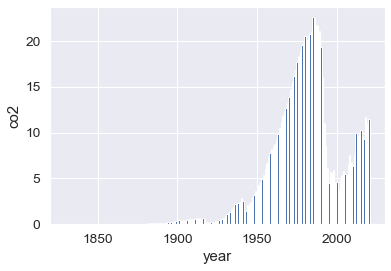

Laos


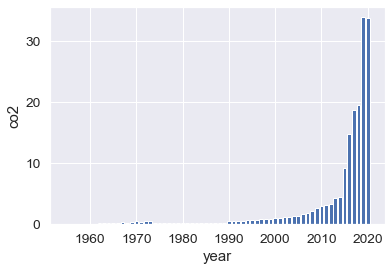

Latvia


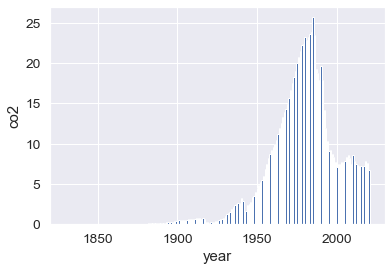

Lebanon


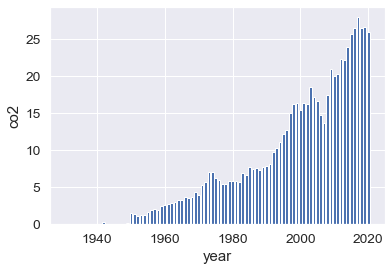

Leeward Islands


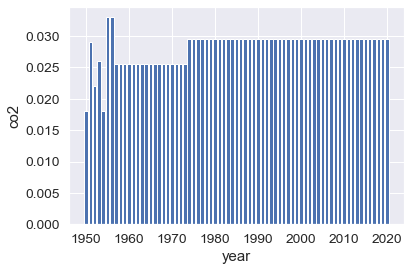

Lesotho


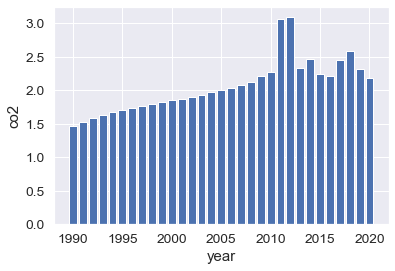

Liberia


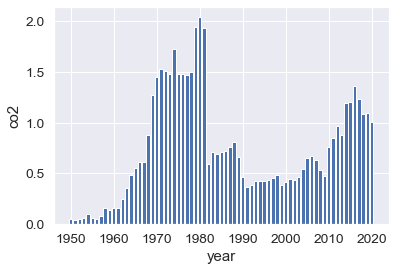

Libya


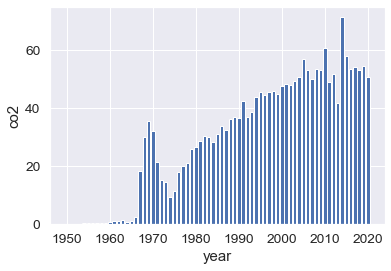

Liechtenstein


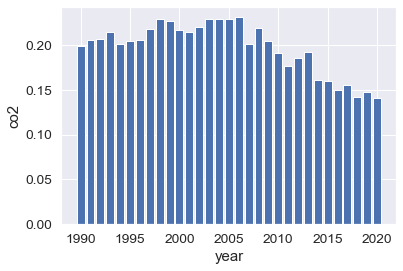

Lithuania


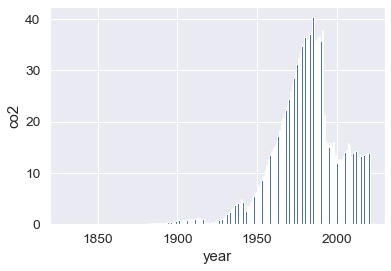

Low-income countries


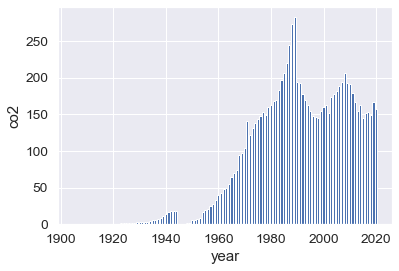

Lower-middle-income countries


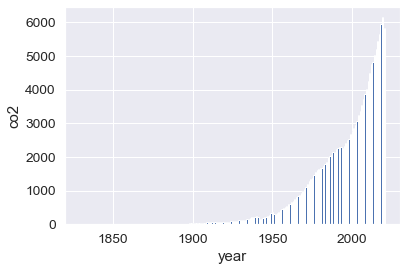

Luxembourg


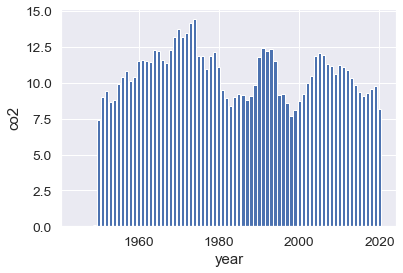

Macao


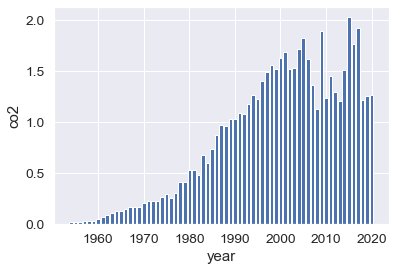

Madagascar


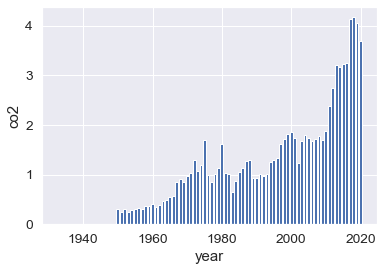

Malawi


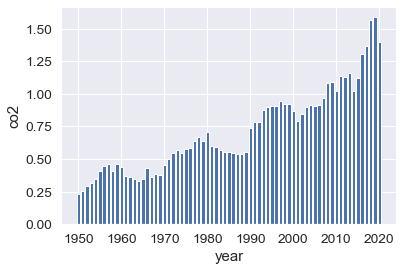

Malaysia


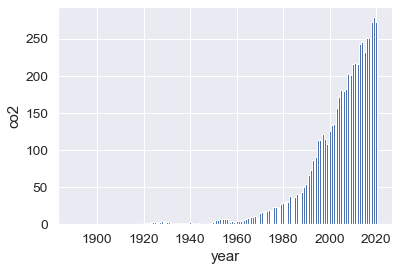

Maldives


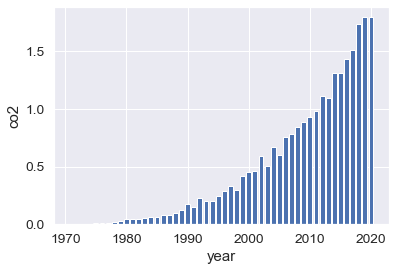

Mali


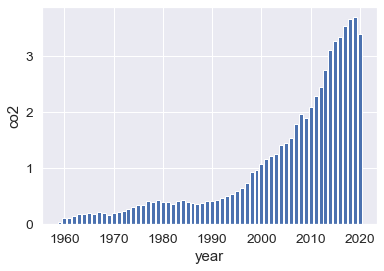

Malta


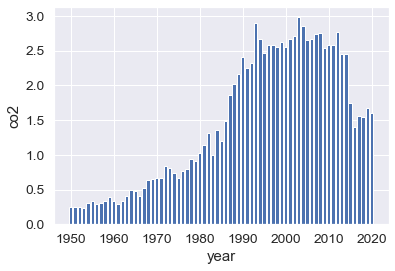

Marshall Islands


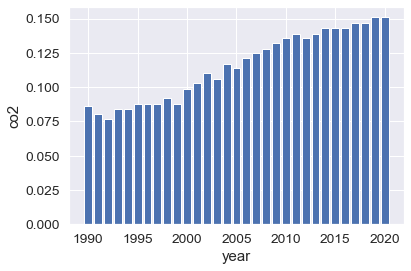

Martinique


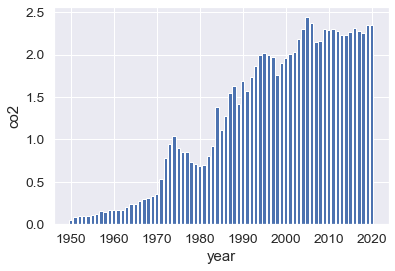

Mauritania


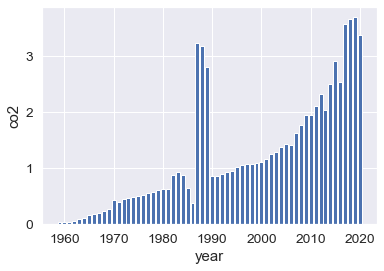

Mauritius


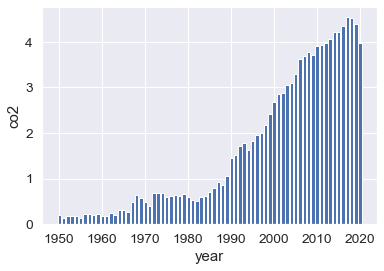

Mayotte


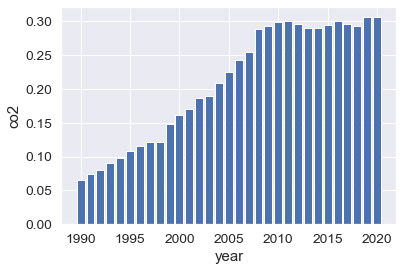

Mexico


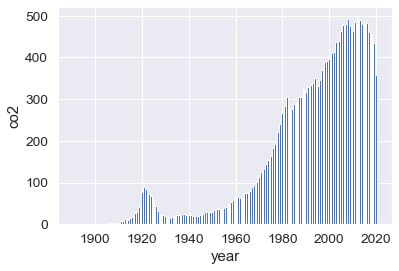

Micronesia (country)


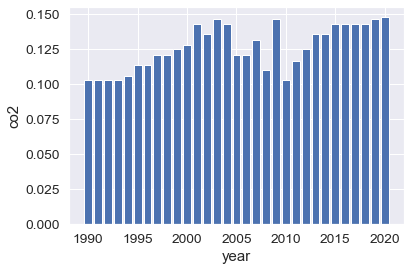

Moldova


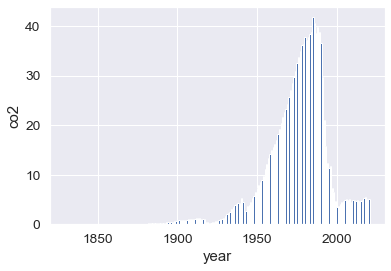

Mongolia


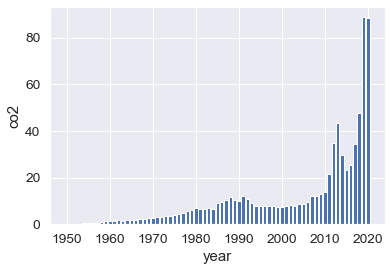

Montenegro


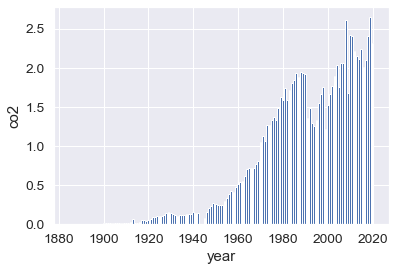

Montserrat


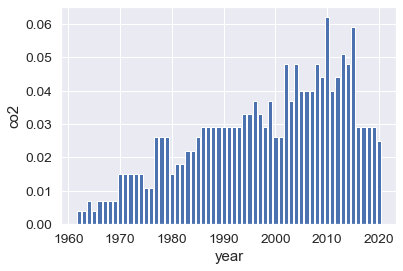

Morocco


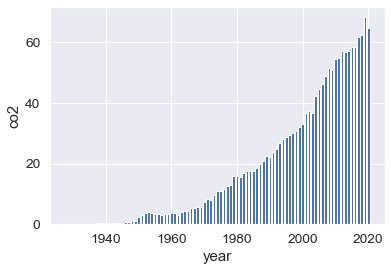

Mozambique


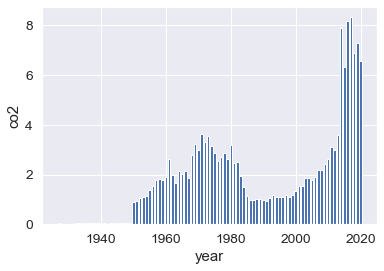

Myanmar


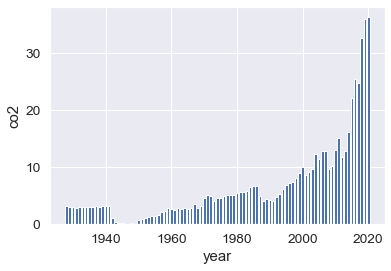

Namibia


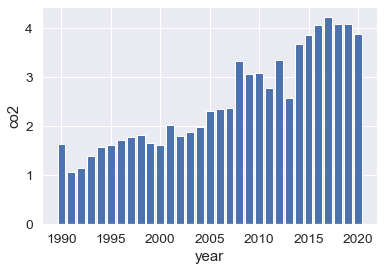

Nauru


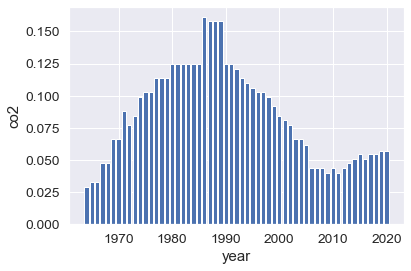

Nepal


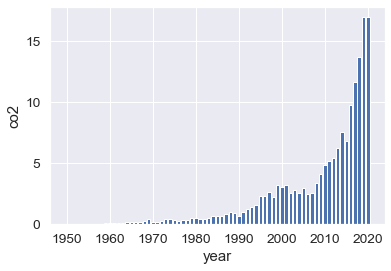

Netherlands


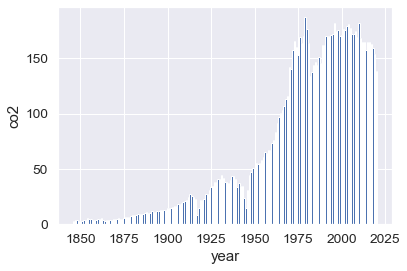

New Caledonia


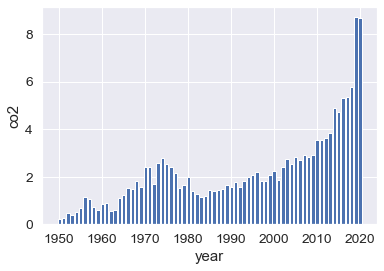

New Zealand


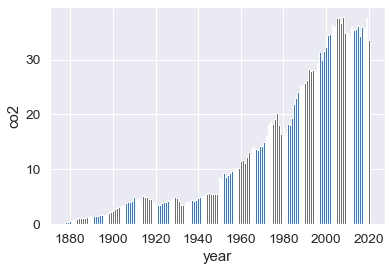

Nicaragua


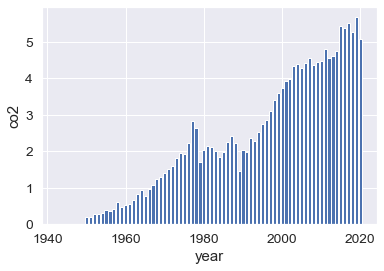

Niger


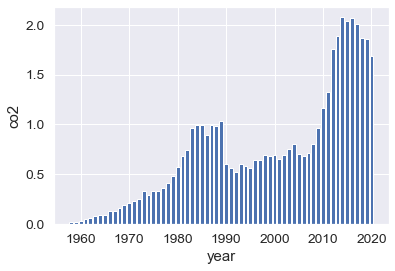

Nigeria


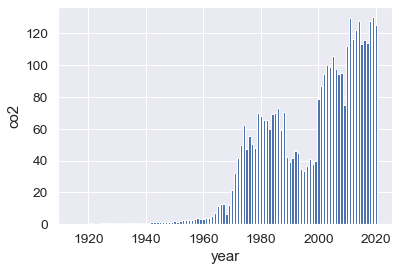

Niue


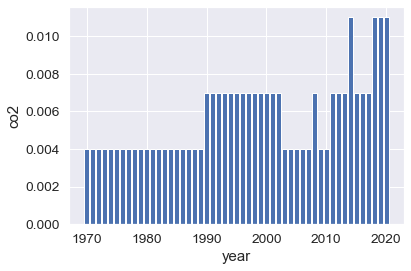

North America


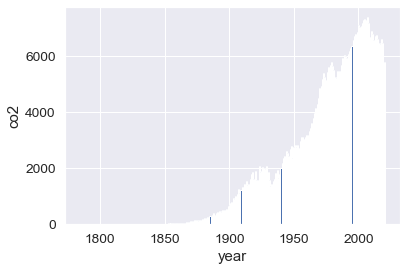

North America (excl. USA)


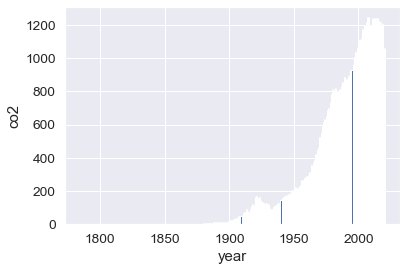

North Korea


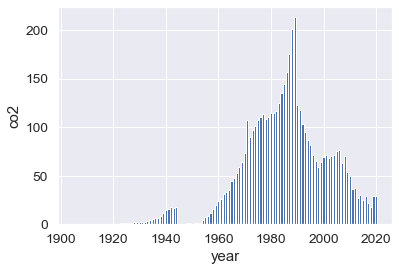

North Macedonia


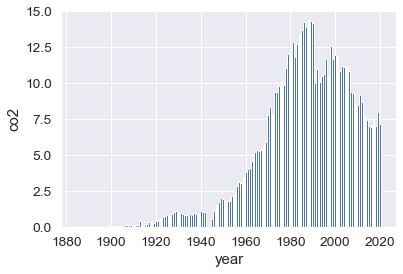

Norway


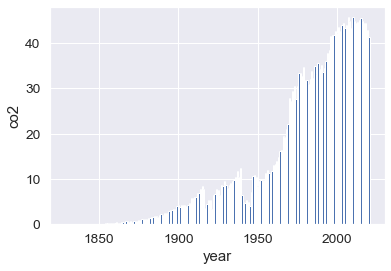

Oceania


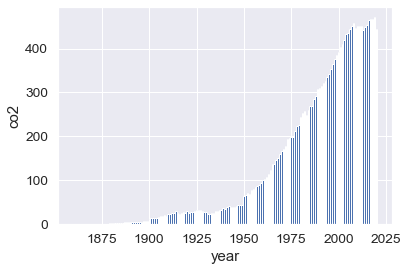

Oman


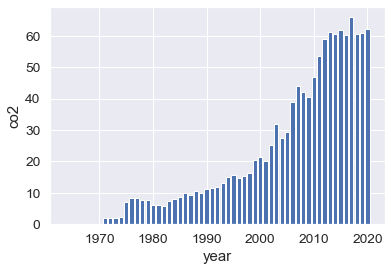

Pakistan


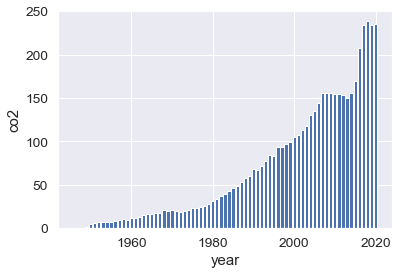

Palau


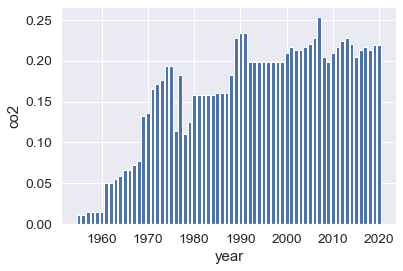

Palestine


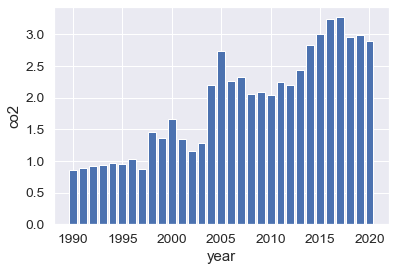

Panama


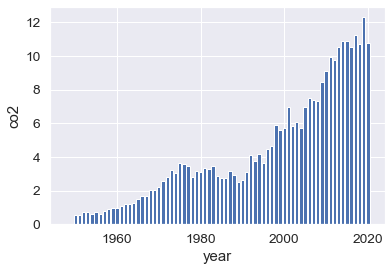

Panama Canal Zone


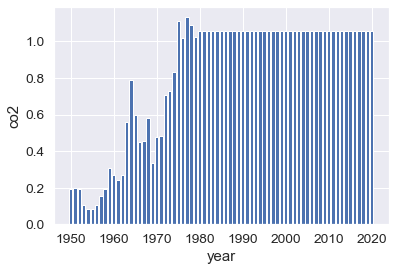

Papua New Guinea


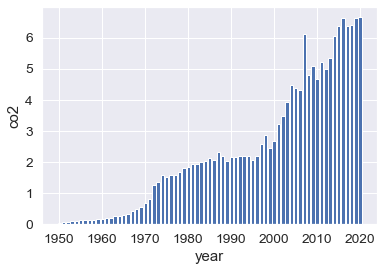

Paraguay


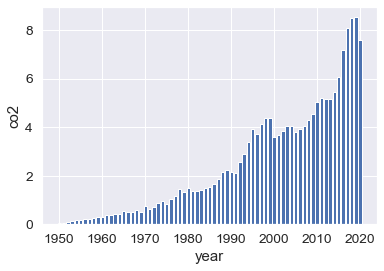

Peru


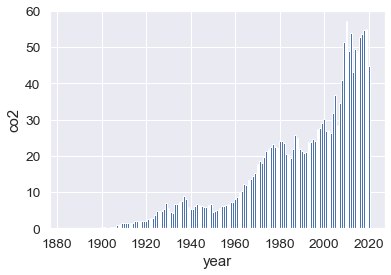

Philippines


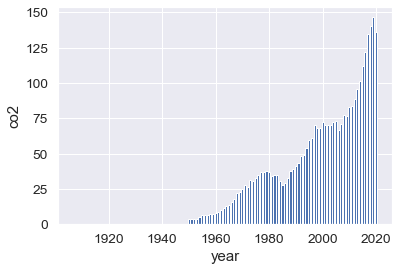

Poland


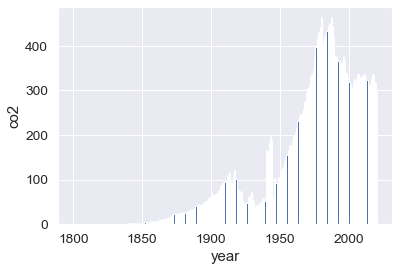

Portugal


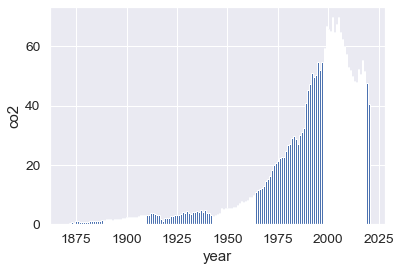

Puerto Rico


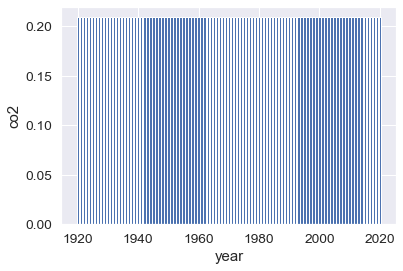

Qatar


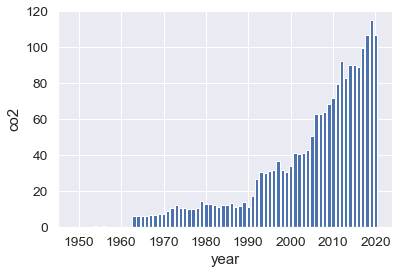

Reunion


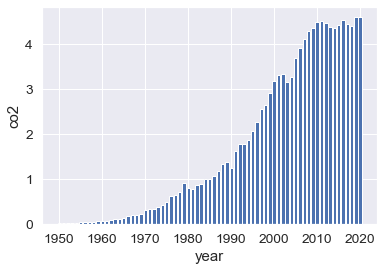

Romania


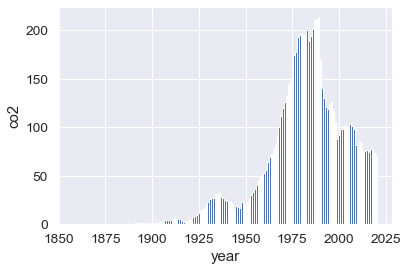

Russia


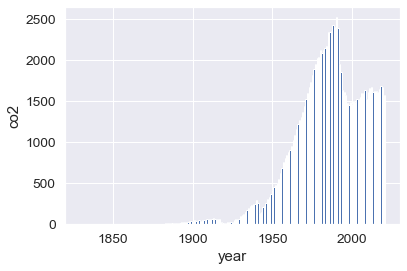

Rwanda


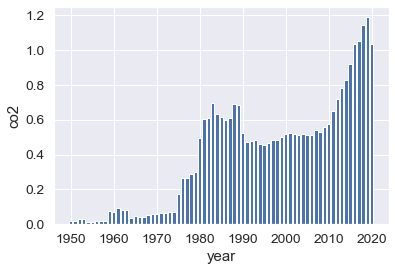

Ryukyu Islands


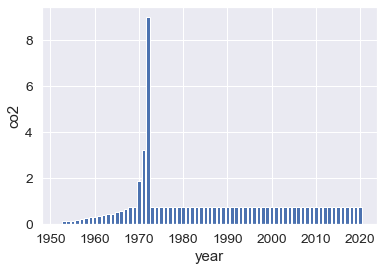

Saint Helena


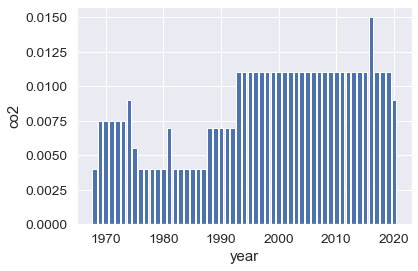

Saint Kitts and Nevis


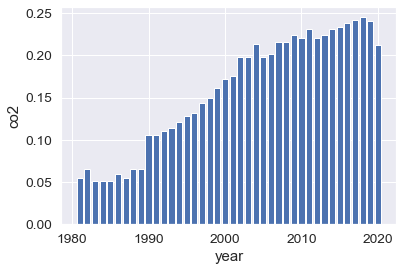

Saint Lucia


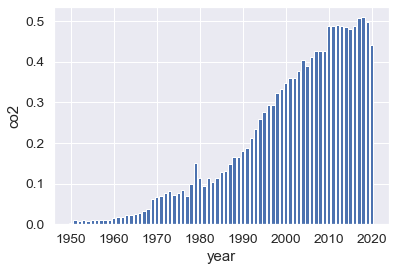

Saint Pierre and Miquelon


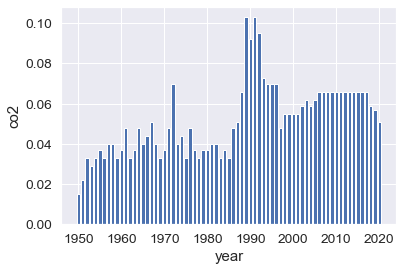

Saint Vincent and the Grenadines


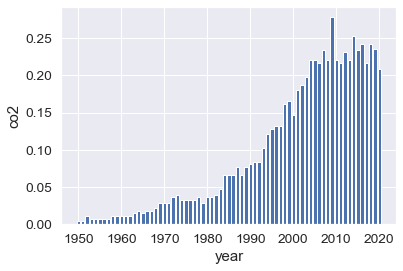

Samoa


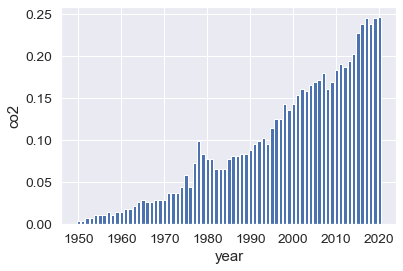

Sao Tome and Principe


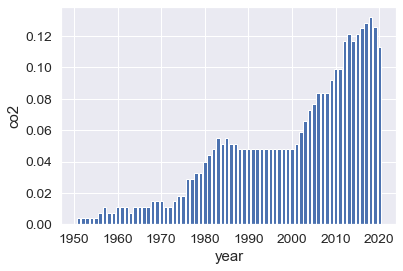

Saudi Arabia


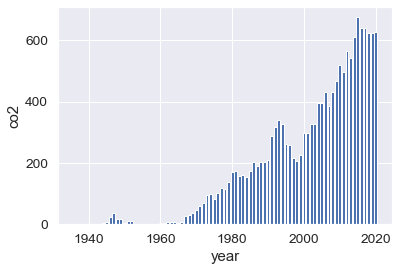

Senegal


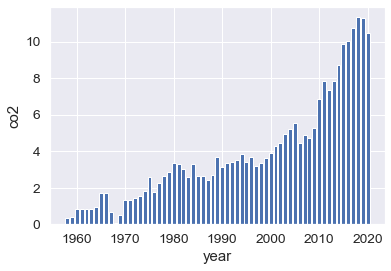

Serbia


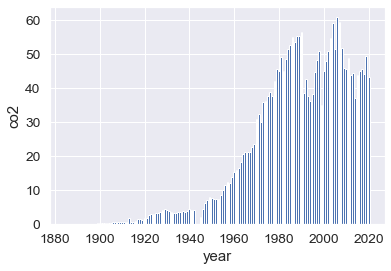

Seychelles


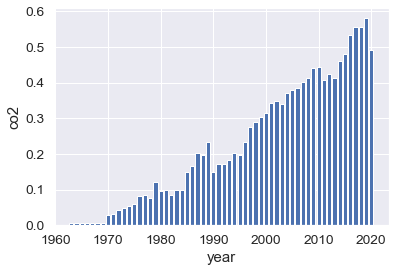

Sierra Leone


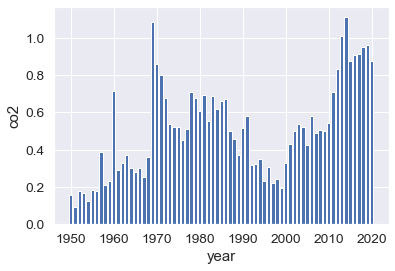

Singapore


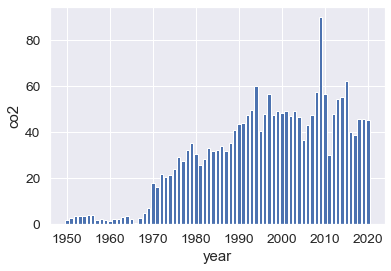

Sint Maarten (Dutch part)


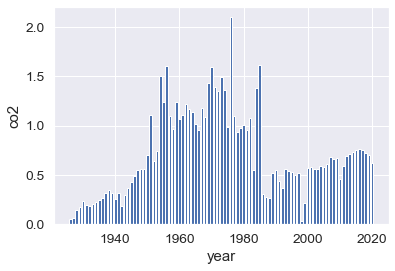

Slovakia


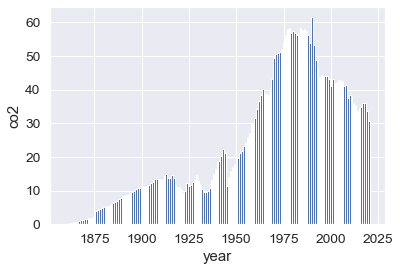

Slovenia


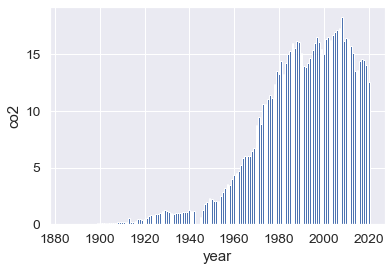

Solomon Islands


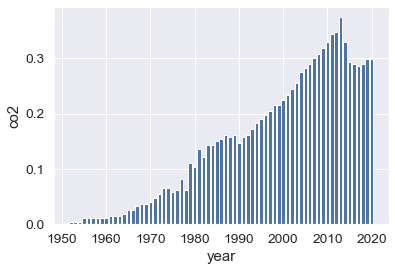

Somalia


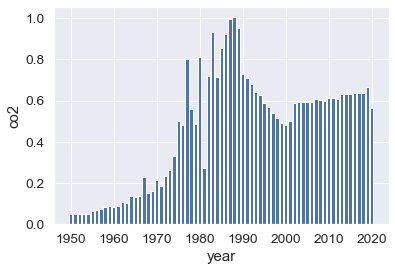

South Africa


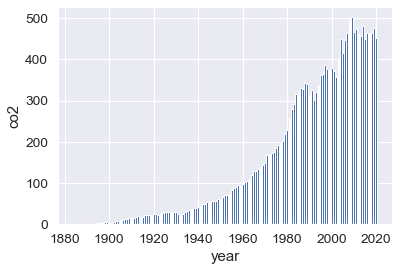

South America


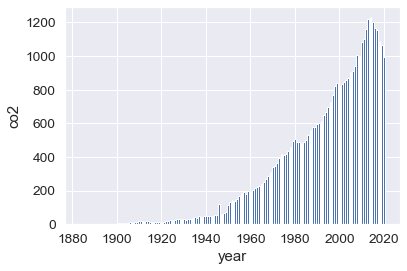

South Korea


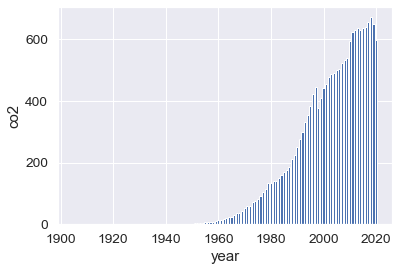

South Sudan


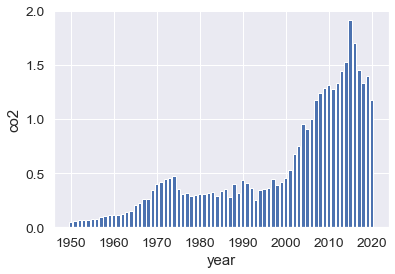

Spain


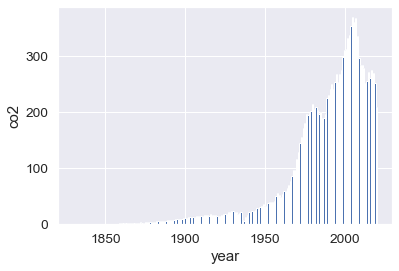

Sri Lanka


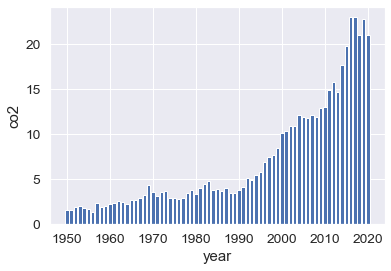

St. Kitts-Nevis-Anguilla


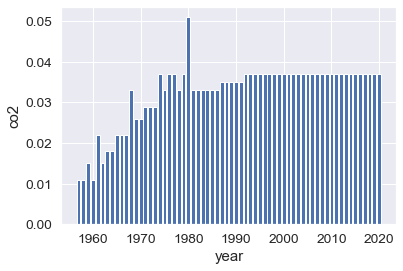

Sudan


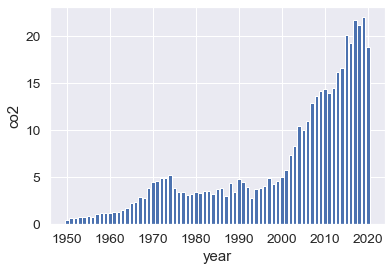

Suriname


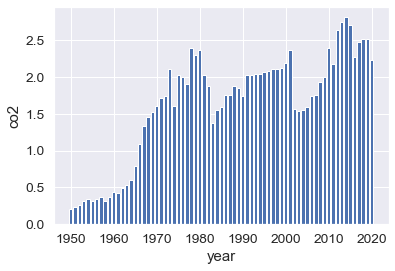

Sweden


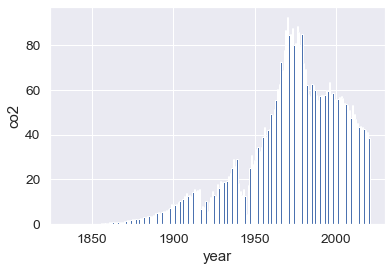

Switzerland


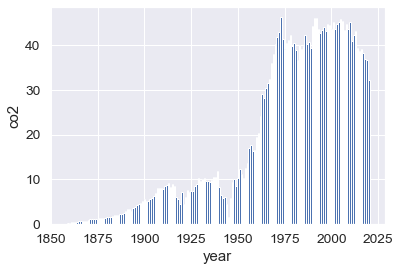

Syria


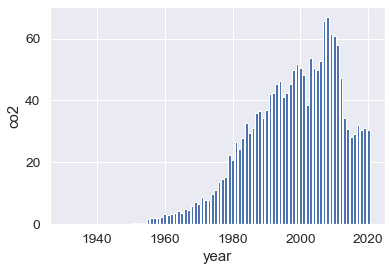

Taiwan


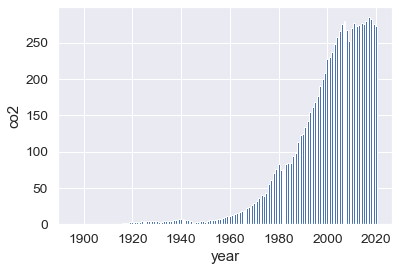

Tajikistan


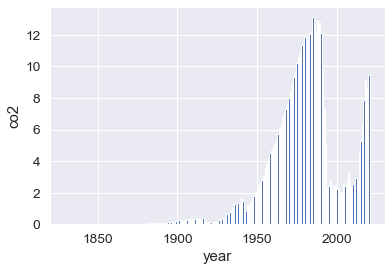

Tanzania


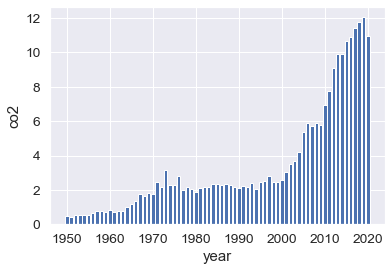

Thailand


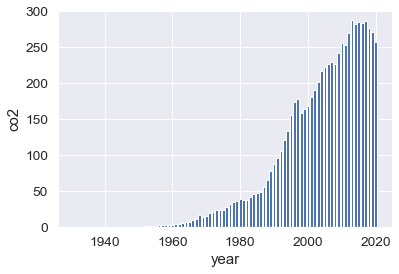

Timor


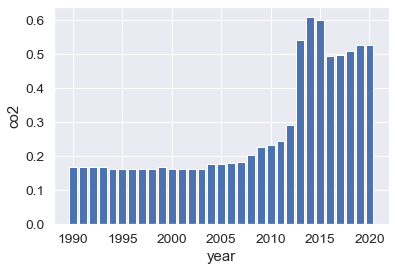

Togo


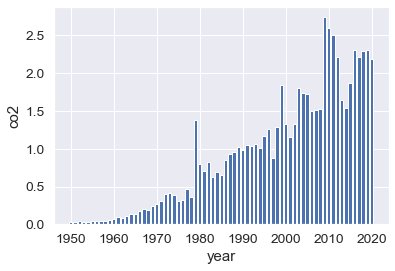

Tonga


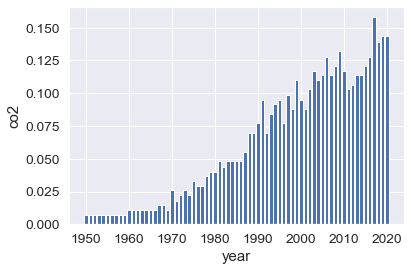

Trinidad and Tobago


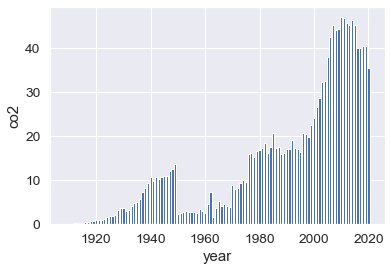

Tunisia


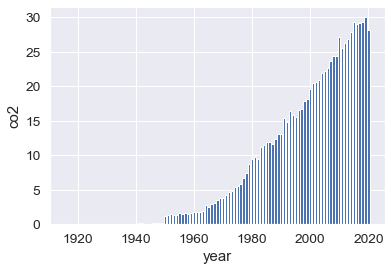

Turkey


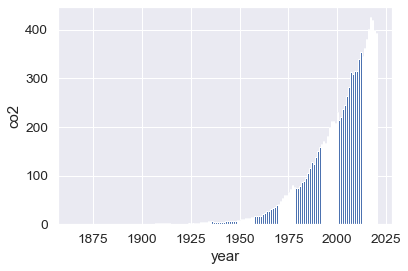

Turkmenistan


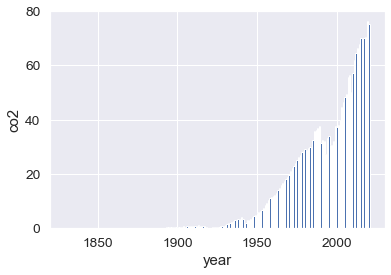

Turks and Caicos Islands


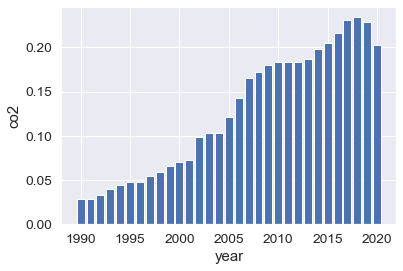

Tuvalu


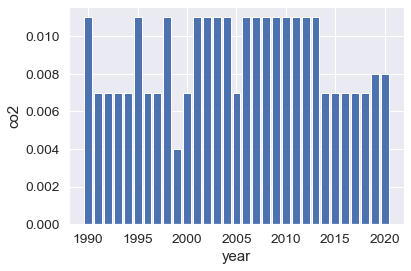

Uganda


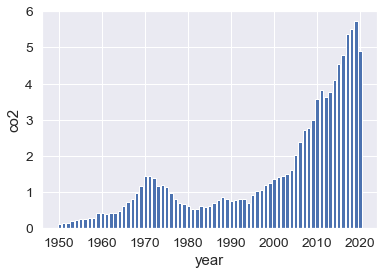

Ukraine


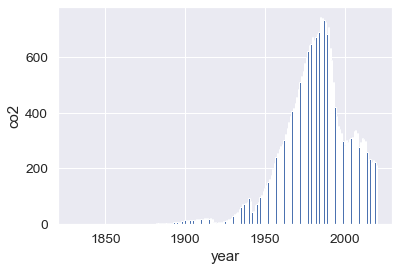

United Arab Emirates


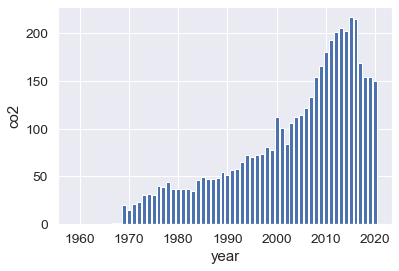

United Kingdom


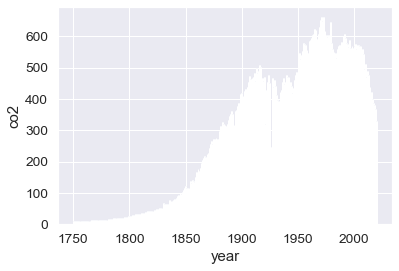

United States


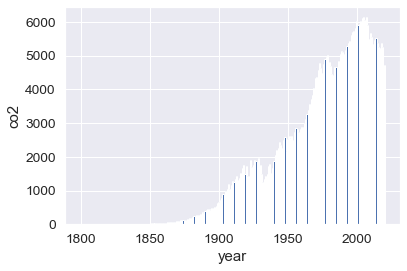

Upper-middle-income countries


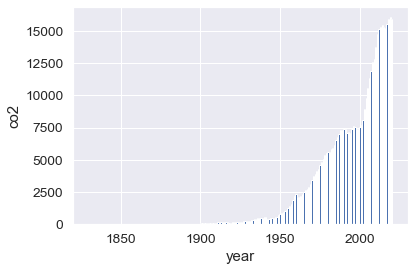

Uruguay


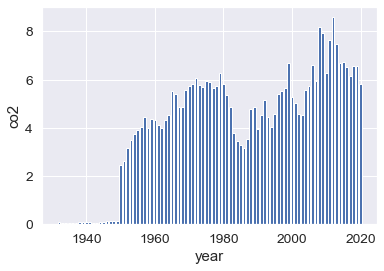

Uzbekistan


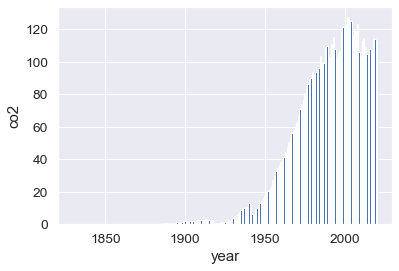

Vanuatu


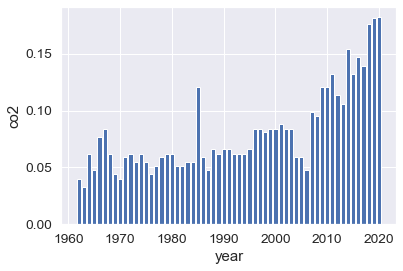

Venezuela


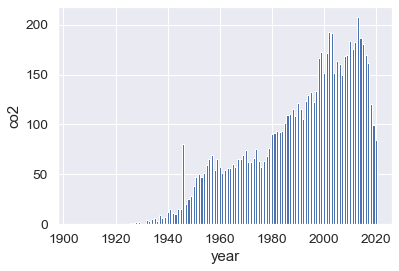

Vietnam


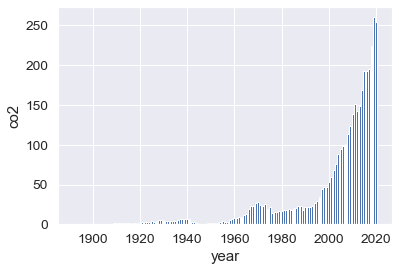

Wallis and Futuna


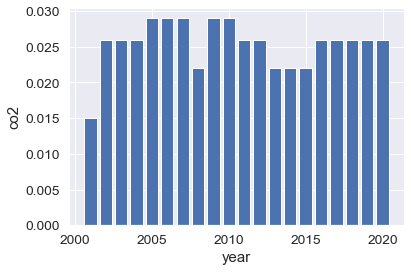

World


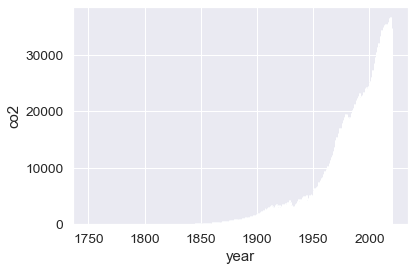

Yemen


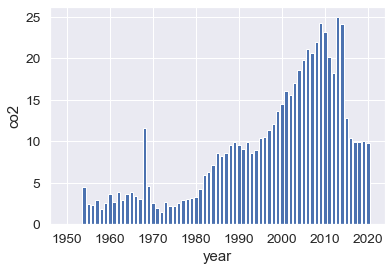

Zambia


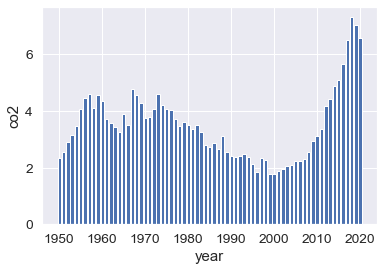

Zimbabwe


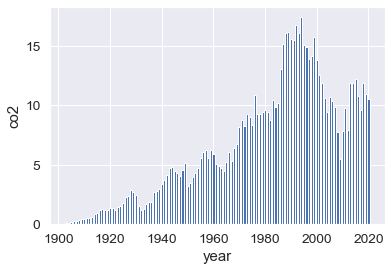

In [104]:
for region in countries:
    df_reg = co2_df[co2_df['country'] == region]
    reg_year = df_reg['year']
    reg_co2 = df_reg['co2']
    #plotting
    print(region)
    plt.bar(reg_year,reg_co2,align='center') # A bar chart 
    plt.xlabel('year') 
    plt.ylabel('co2') 
    #for i in range(len(reg_co2)):
        #plt.hlines(reg_co2[i],0,reg_year[i]) # Here you are drawing the horizontal lines 
    plt.show()

# Predicting future emission values for years 2021-2026

# Delete From HEREE to............................................................................!!!

#### Predicting co2

https://medium.com/@biksharma17/machine-learning-model-to-predict-and-reduce-carbon-dioxide-emissions-192a2828c3dc 

df_copy = co2_df.copy()

y = df_copy['co2'] #Dependent variable
x = df_copy.drop(columns=['co2']) # independent variable

We will remover 'country' becasue this will make our predicting model biased

x = x.drop(columns=['country'])

#splitting our data
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=42)

### Random Forest Regressor Prediction Model

from sklearn.ensemble import RandomForestRegressor

reg = RandomForestRegressor(max_depth=2, random_state=0, n_estimators=100)

reg.fit(X_train, y_train)

from sklearn.metrics import r2_score

pred = reg.predict(X_test)

r2_score(y_test, pred)

print(pred)

plt.hist(pred)

Our model predicts co2 values with 92.1% accuracy!

#### Now we need to use this model to predict values for future years:

# HERE !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

### I will now make a new dataframe to store our future values for 2021-2025

In [105]:
co2_df.columns

Index(['year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy

In [106]:
predictions2021 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [107]:
predictions2021['country'] = co2_df.country.unique()

In [108]:
predictions2021['year'] = 2021

In [109]:
predictions2021.head()

,country,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
0,Afghanistan,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Africa,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Albania,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Algeria,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Andorra,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [110]:
predictions2022 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [111]:
predictions2022['country'] = co2_df.country.unique()

In [112]:
predictions2022['year'] = 2022

In [113]:
predictions2023 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [114]:
predictions2023['country'] = co2_df['country'].unique()

In [115]:
predictions2023['year'] = 2023

In [116]:
predictions2024 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [117]:
predictions2024['country'] = co2_df.country.unique()

In [118]:
predictions2024['year'] = 2024

In [119]:
predictions2025 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [120]:
predictions2025['country'] = co2_df.country.unique()

In [121]:
predictions2025['year'] = 2025

In [122]:
predictions2025.head()

,country,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
0,Afghanistan,2025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Africa,2025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Albania,2025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Algeria,2025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Andorra,2025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [123]:
predictions2026 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [124]:
predictions2026['country'] = co2_df.country.unique()

In [125]:
predictions2026['year'] = 2026

##### Making a large dataframe of all our empty data above:

In [126]:
countries = predictions2021['country']
countries = countries.append(predictions2022['country'])
countries = countries.append(predictions2023['country'])
countries = countries.append(predictions2024['country'])
countries = countries.append(predictions2025['country'])
countries = countries.append(predictions2026['country'])

In [127]:
years = predictions2021['year']
years = years.append(predictions2022['year'])
years = years.append(predictions2023['year'])
years = years.append(predictions2024['year'])
years = years.append(predictions2025['year'])
years = years.append(predictions2026['year'])

In [128]:
data = (countries, years)

In [129]:
headers = ['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp']

In [130]:
df3 = pd.DataFrame(columns=['country', 'year', 'co2', 'co2_per_capita', 'cement_co2', 'cement_co2_per_capita',
       'coal_co2', 'coal_co2_per_capita', 'gas_co2', 'gas_co2_per_capita',
       'oil_co2', 'oil_co2_per_capita', 'co2_growth_prct', 'co2_growth_abs',
       'co2_per_gdp', 'co2_per_unit_energy', 'cumulative_co2',
       'cumulative_cement_co2', 'cumulative_coal_co2', 'cumulative_gas_co2',
       'cumulative_oil_co2', 'share_global_co2', 'share_global_cement_co2',
       'share_global_coal_co2', 'share_global_gas_co2', 'share_global_oil_co2',
       'share_global_cumulative_co2', 'share_global_cumulative_cement_co2',
       'share_global_cumulative_coal_co2', 'share_global_cumulative_gas_co2',
       'share_global_cumulative_oil_co2', 'total_ghg', 'ghg_per_capita',
       'total_ghg_excluding_lucf', 'ghg_excluding_lucf_per_capita', 'methane',
       'methane_per_capita', 'nitrous_oxide', 'nitrous_oxide_per_capita',
       'population', 'gdp', 'primary_energy_consumption', 'energy_per_capita',
       'energy_per_gdp'])

In [131]:
df3 = pd.concat(data, axis=1)

In [132]:
df3.head()

,country,year
0,Afghanistan,2021
1,Africa,2021
2,Albania,2021
3,Algeria,2021
4,Andorra,2021


In [133]:
df3['co2'] = np.nan
df3['co2_per_capita'] = np.nan
df3['cement_co2'] = np.nan
df3['cement_co2_per_capita'] = np.nan
df3['coal_co2'] = np.nan
df3['coal_co2_per_capita'] = np.nan
df3['gas_co2'] = np.nan
df3['gas_co2_per_capita'] = np.nan
df3['oil_co2'] = np.nan
df3['oil_co2_per_capita'] = np.nan
df3['co2_growth_prct'] = np.nan
df3['co2_growth_abs'] = np.nan
df3['co2_per_gdp'] = np.nan
df3['co2_per_unit_energy'] = np.nan
df3['cumulative_co2'] = np.nan
df3['cumulative_cement_co2'] = np.nan
df3['cumulative_coal_co2'] = np.nan 
df3['cumulative_gas_co2'] = np.nan
df3['cumulative_oil_co2'] = np.nan
df3['share_global_co2'] = np.nan
df3['share_global_cement_co2'] = np.nan
df3['share_global_coal_co2'] = np.nan
df3['share_global_gas_co2'] = np.nan
df3['share_global_oil_co2'] = np.nan
df3['share_global_cumulative_co2'] = np.nan
df3['share_global_cumulative_cement_co2'] = np.nan
df3['share_global_cumulative_coal_co2'] = np.nan 
df3['share_global_cumulative_gas_co2'] = np.nan
df3['share_global_cumulative_oil_co2'] = np.nan 
df3['total_ghg'] = np.nan
df3['ghg_per_capita'] = np.nan
df3['total_ghg_excluding_lucf'] = np.nan 
df3['ghg_excluding_lucf_per_capita'] = np.nan
df3['methane'] = np.nan
df3['methane_per_capita'] = np.nan
df3['nitrous_oxide'] = np.nan
df3['nitrous_oxide_per_capita'] = np.nan
df3['population'] = np.nan
df3['gdp'] = np.nan
df3['primary_energy_consumption'] = np.nan
df3['energy_per_capita'] = np.nan
df3['energy_per_gdp'] = np.nan

In [134]:
df3.head()

,country,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
0,Afghanistan,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Africa,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Albania,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Algeria,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Andorra,2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [135]:
df3.tail()

,country,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,ghg_excluding_lucf_per_capita,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp
243,Wallis and Futuna,2026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
244,World,2026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
245,Yemen,2026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
246,Zambia,2026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
247,Zimbabwe,2026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [136]:
df3.shape

(1488, 44)

## Inserting these empty rows into our dataframe:

In [137]:
# assign dataframes
data1 = co2_df
  
data2 = df3

# merge two data frames
print('After merging:')
predictions = pd.concat([data1, data2], axis=0)
predictions

After merging:


,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,2026.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Wallis and Futuna
244,2026.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,World
245,2026.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yemen
246,2026.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zambia


In [138]:
countries = co2_df.country.unique()

In [139]:
pred = pd.DataFrame()
predictions = pd.DataFrame()
for country in countries:
    df1 = co2_df[co2_df.country == country]
    df2 = df3[df3.country == country]
    pred = pd.concat([df1, df2], axis=0) 
    predictions = pd.concat([predictions,pred], axis=0, ignore_index=True)

In [140]:
predictions

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27472,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27473,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27474,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27475,2025.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


In [141]:
co2_df.shape #checking we filled it all in

(25989, 44)

In [142]:
predictions.shape

(27477, 44)

#### Now we will fill in these missing values

In [143]:
#Resetting our dataframe index
predictions = predictions.reset_index()

In [144]:
predictions

,index,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27472,27472,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27473,27473,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27474,27474,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27475,27475,2025.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


In [145]:
predictions = predictions.drop(columns=['index'])

In [146]:
predictions

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27472,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27473,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27474,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27475,2025.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


# DELETE from HERE to.....

countries = predictions['country'].unique()

country_column = predictions['country']
country_column

column_headings = predictions.columns

filled_predictions = pd.DataFrame()
for country in countries:
    df = predictions[predictions.country == country]
    
    #getting rid of cetegorical data
    df = df.drop(columns=['country'])
    cols = df.columns
    df = df.dropna(axis=0, how='all')
    #scaling
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns = df.columns)
    
    print(df.shape)
    col_list = df.columns
    
    filled_in_df = scaler_knn_funct(df, col_list, country)
    #filled_in_df['country'] = country
    filled_in_df = scaler.inverse_transform(filled_in_df)
    filled_in_df = pd.DataFrame(filled_in_df)
    
    #filled_in_df['country'] = country
    filled_predictions = pd.concat([filled_predictions,filled_in_df], axis=0, ignore_index=True)
    
    print(country)

filled_predictions.shape

filled_predictions['country'] = country_column

filled_predictions

filled_predictions.columns = [column_headings]

filled_predictions

filled_predictions.isnull().sum()

if isinstance(filled_predictions, pd.DataFrame):
    print('True')

#Saving a new csv file with our new cleaned dataset for tableu
filled_predictions.to_csv('C:/Users/Quinn/Practicum Project/predictions.csv')

filled = pd.read_csv('predictions.csv', encoding='latin1')

filled.tail()

filled = filled.drop(columns=['Unnamed: 0'])

filled

# HEREEEE...

# Trying Time series prediction method

https://medium.com/@stallonejacob/time-series-forecast-a-basic-introduction-using-python-414fcb963000 

In [147]:
from datetime import datetime

In [148]:
predictions.tail()

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
27472,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27473,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27474,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27475,2025.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27476,2026.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


In [149]:
df = predictions.copy()

In [150]:
df

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27472,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27473,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27474,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
27475,2025.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


In [151]:
df['year'] = pd.to_datetime(df['year'])

In [152]:
df.set_index('year', inplace=True)

In [153]:
#check datatype of index
df.index

DatetimeIndex(['1970-01-01 00:00:00.000001949',
               '1970-01-01 00:00:00.000001950',
               '1970-01-01 00:00:00.000001951',
               '1970-01-01 00:00:00.000001952',
               '1970-01-01 00:00:00.000001953',
               '1970-01-01 00:00:00.000001954',
               '1970-01-01 00:00:00.000001955',
               '1970-01-01 00:00:00.000001956',
               '1970-01-01 00:00:00.000001957',
               '1970-01-01 00:00:00.000001958',
               ...
               '1970-01-01 00:00:00.000002017',
               '1970-01-01 00:00:00.000002018',
               '1970-01-01 00:00:00.000002019',
               '1970-01-01 00:00:00.000002020',
               '1970-01-01 00:00:00.000002021',
               '1970-01-01 00:00:00.000002022',
               '1970-01-01 00:00:00.000002023',
               '1970-01-01 00:00:00.000002024',
               '1970-01-01 00:00:00.000002025',
               '1970-01-01 00:00:00.000002026'],
              dtype=

In [154]:
df_encoded = pd.get_dummies(df, columns=['country'])

In [155]:
df

,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
year,,,,,,,,,,,,,,,,,,,,,
1970-01-01 00:00:00.000001949,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1970-01-01 00:00:00.000001950,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
1970-01-01 00:00:00.000001951,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
1970-01-01 00:00:00.000001952,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
1970-01-01 00:00:00.000001953,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970-01-01 00:00:00.000002022,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
1970-01-01 00:00:00.000002023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
1970-01-01 00:00:00.000002024,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


In [156]:
#convert to time series:
ts = df_encoded
ts.head(10)

,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,country_Uruguay,country_Uzbekistan,country_Vanuatu,country_Venezuela,country_Vietnam,country_Wallis and Futuna,country_World,country_Yemen,country_Zambia,country_Zimbabwe
year,,,,,,,,,,,,,,,,,,,,,
1970-01-01 00:00:00.000001949,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001950,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001951,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001952,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001953,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001954,0.106,0.013,0.018,0.0020,0.043,0.005,0.3035,0.0290,0.0640,0.008,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001955,0.154,0.019,0.018,0.0020,0.062,0.008,0.3035,0.0290,0.0920,0.011,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001956,0.183,0.022,0.018,0.0020,0.062,0.007,0.3035,0.0290,0.1210,0.014,...,0,0,0,0,0,0,0,0,0,0
1970-01-01 00:00:00.000001957,0.293,0.034,0.018,0.0020,0.077,0.009,0.3035,0.0290,0.2160,0.025,...,0,0,0,0,0,0,0,0,0,0


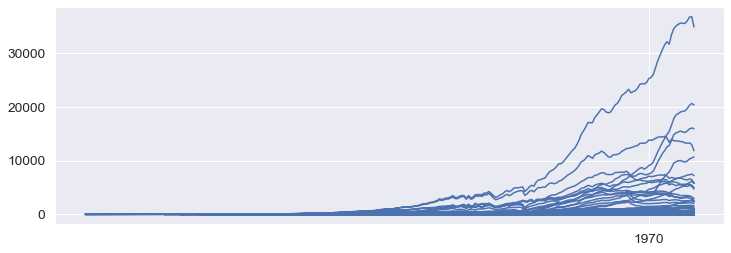

In [157]:
# Create figure        
fig = plt.figure() 
# Figure size
fig.set_size_inches(12, 4)

plt.plot(ts['co2'])

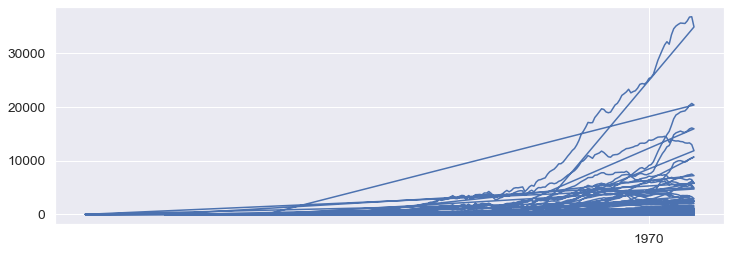

In [158]:
# Create figure        
fig = plt.figure() 
# Figure size
fig.set_size_inches(12, 4)

plt.plot(ts['co2'].dropna(axis=0)) #same plot but dropping null values

### Checking Stationarity:

In [159]:
from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries):
    
    #Determing rolling statistics
    rolmean = timeseries.rolling(window=12).mean() 
    rolstd = timeseries.rolling(window=12).std()
    
    # Create figure   
    fig = plt.figure() 
    # Figure size
    fig.set_size_inches(12, 4)
    
#Plot rolling statistics:
    plt.plot(timeseries, color='blue',label='Original')
    plt.plot(rolmean, color='red', label='Rolling Mean')
    plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show()
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

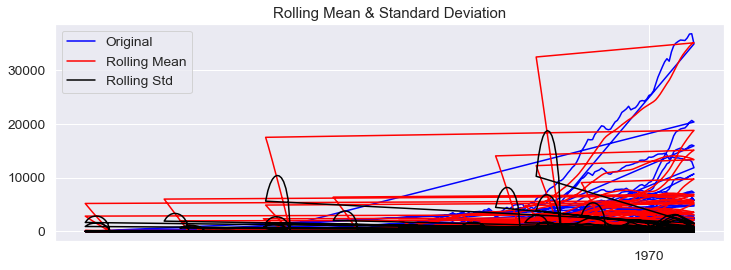

Results of Dickey-Fuller Test:
Test Statistic                -1.637950e+01
p-value                        2.760293e-29
#Lags Used                     4.100000e+01
Number of Observations Used    2.594700e+04
Critical Value (1%)           -3.430602e+00
Critical Value (5%)           -2.861651e+00
Critical Value (10%)          -2.566829e+00
dtype: float64


In [160]:
#getting rid of our rows with missing values
ts = ts.dropna(axis=0)
 
test_stationarity(ts['co2'])

We can see that our series is not stationary because we got a large p-value (p-value > 0.5)

This is not stationary because :

• mean is increasing even though the std is small.

• Test stat is > critical value.

# Time Series Forcasting for years 2021-2025 using ARIMA Model

https://machinelearningmastery.com/arima-for-time-series-forecasting-with-python/

In [161]:
from pandas.plotting import autocorrelation_plot

In [162]:
co2_df

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600,0.53450,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250,0.23850,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500,0.54700,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500,0.54700,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500,0.54700,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25984,2016.0,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,...,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25985,2017.0,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,...,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25986,2018.0,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,...,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25987,2019.0,10.949,0.748,0.697,0.0480,6.020,0.411,4.2320,0.2890,-7.6400,...,2.145482e+10,49.4270,3374.877,2.1595,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe


In [163]:
df = co2_df.drop(columns=['country'])

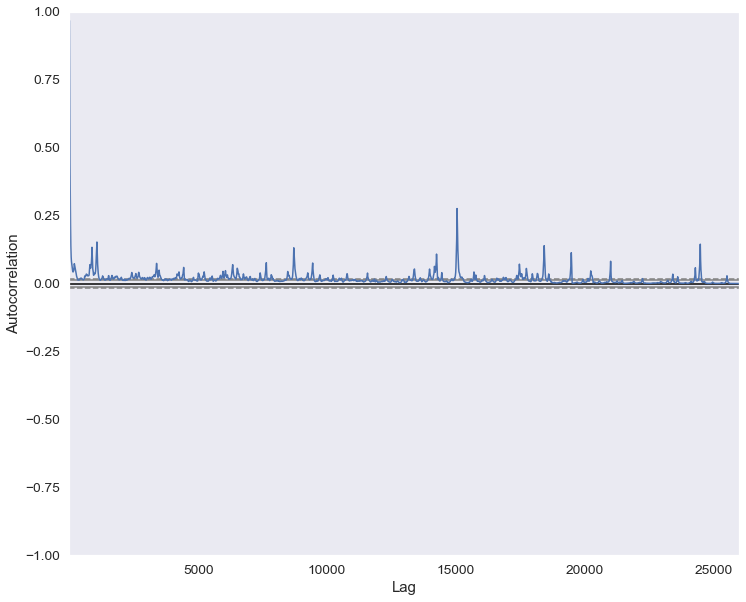

In [164]:
import matplotlib.pyplot as pyplot
# Create figure        
fig = pyplot.figure() 
# Figure size
fig.set_size_inches(12, 10)

autocorrelation_plot(df)
pyplot.show()

In [165]:
df = pd.read_csv('cleaned_co2.csv', parse_dates=True)

In [166]:
df

,Unnamed: 0,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,...,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600,0.53450,Afghanistan
1,1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,...,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250,0.23850,Afghanistan
2,2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,...,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500,0.54700,Afghanistan
3,3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,...,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500,0.54700,Afghanistan
4,4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,...,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500,0.54700,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25984,25984,2016.0,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,...,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25985,25985,2017.0,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,...,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25986,25986,2018.0,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,...,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25987,25987,2019.0,10.949,0.748,0.697,0.0480,6.020,0.411,4.2320,0.2890,...,2.145482e+10,49.4270,3374.877,2.1595,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe


In [167]:
df = df.drop(columns=['Unnamed: 0'])

In [168]:
df

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
0,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600,0.53450,Afghanistan
1,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250,0.23850,Afghanistan
2,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500,0.54700,Afghanistan
3,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500,0.54700,Afghanistan
4,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500,0.54700,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25984,2016.0,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,...,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25985,2017.0,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,...,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25986,2018.0,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,...,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
25987,2019.0,10.949,0.748,0.697,0.0480,6.020,0.411,4.2320,0.2890,-7.6400,...,2.145482e+10,49.4270,3374.877,2.1595,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe


In [169]:
df['Year'] = pd.to_datetime(df['year'], format='%Y')

In [170]:
df.index = df.Year

In [171]:
df

,year,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,...,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country,Year
Year,,,,,,,,,,,,,,,,,,,,,
1949-01-01,1949.0,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,...,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600,0.53450,Afghanistan,1949-01-01
1950-01-01,1950.0,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,...,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250,0.23850,Afghanistan,1950-01-01
1951-01-01,1951.0,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,...,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500,0.54700,Afghanistan,1951-01-01
1952-01-01,1952.0,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,...,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500,0.54700,Afghanistan,1952-01-01
1953-01-01,1953.0,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,...,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500,0.54700,Afghanistan,1953-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-01-01,2016.0,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,...,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe,2016-01-01
2017-01-01,2017.0,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,...,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe,2017-01-01
2018-01-01,2018.0,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,...,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe,2018-01-01


In [172]:
df = df.drop(columns=['year'])

In [173]:
df.head()

,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country,Year
Year,,,,,,,,,,,,,,,,,,,,,
1949-01-01,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan,1949-01-01
1950-01-01,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan,1950-01-01
1951-01-01,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan,1951-01-01
1952-01-01,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan,1952-01-01
1953-01-01,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan,1953-01-01


<AxesSubplot:xlabel='Year'>

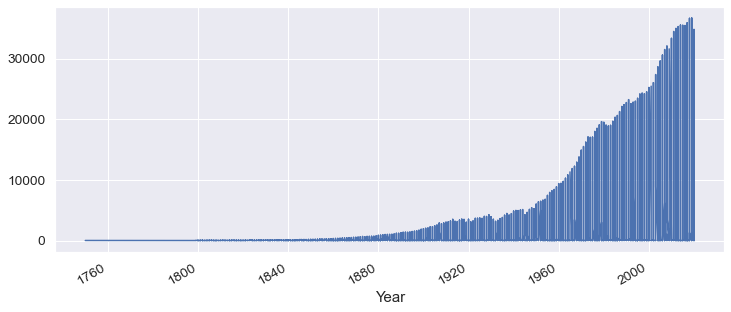

In [174]:
df['co2'].plot(figsize=(12, 5))

#### Our data is not stationary

In [175]:
df.index = pd.to_datetime(df.index, format='%Y')

In [176]:
#check datatype of index
df.index

DatetimeIndex(['1949-01-01', '1950-01-01', '1951-01-01', '1952-01-01',
               '1953-01-01', '1954-01-01', '1955-01-01', '1956-01-01',
               '1957-01-01', '1958-01-01',
               ...
               '2011-01-01', '2012-01-01', '2013-01-01', '2014-01-01',
               '2015-01-01', '2016-01-01', '2017-01-01', '2018-01-01',
               '2019-01-01', '2020-01-01'],
              dtype='datetime64[ns]', name='Year', length=25989, freq=None)

In [177]:
df = pd.get_dummies(df, columns=['country'])

In [178]:
df.head()

,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,country_Uruguay,country_Uzbekistan,country_Vanuatu,country_Venezuela,country_Vietnam,country_Wallis and Futuna,country_World,country_Yemen,country_Zambia,country_Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1949-01-01,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,0,0,0,0,0,0,0,0,0,0
1950-01-01,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,0,0,0,0,0,0,0,0,0,0
1951-01-01,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,0,0,0,0,0,0,0,0,0,0
1952-01-01,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,0,0,0,0,0,0,0,0,0,0
1953-01-01,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,0,0,0,0,0,0,0,0,0,0


In [179]:
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from matplotlib import pyplot
from math import sqrt

We will use order=(1,1,0) or order=(0,1,0) because our data is not stationary.

https://people.duke.edu/~rnau/411arim.htm 

https://www.kaggle.com/code/sumi25/understand-arima-and-tune-p-d-q/notebook

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:597: ValueWarning: A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it is not'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:597: ValueWarning: A date index has been provided, but it is not monotonic and so will be i

                               SARIMAX Results                                
Dep. Variable:                    co2   No. Observations:                25989
Model:                 ARIMA(1, 1, 0)   Log Likelihood             -185730.715
Date:                Thu, 16 Jun 2022   AIC                         371465.431
Time:                        14:05:09   BIC                         371481.762
Sample:                             0   HQIC                        371470.707
                              - 25989                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0606      0.001     53.305      0.000       0.058       0.063
sigma2      9.444e+04     17.160   5503.453      0.000    9.44e+04    9.45e+04
Ljung-Box (L1) (Q):                   0.00   Jarque-

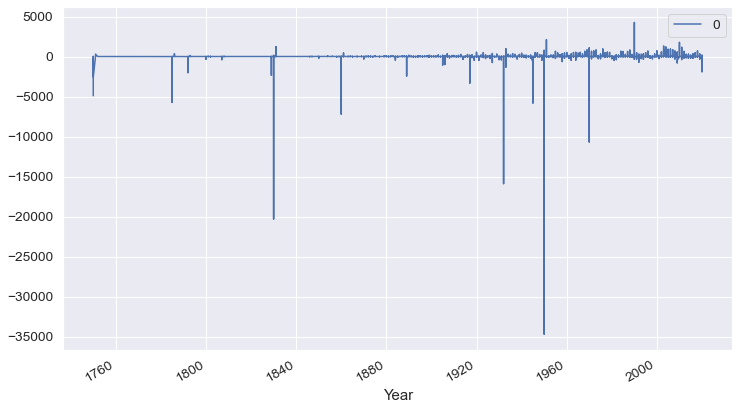

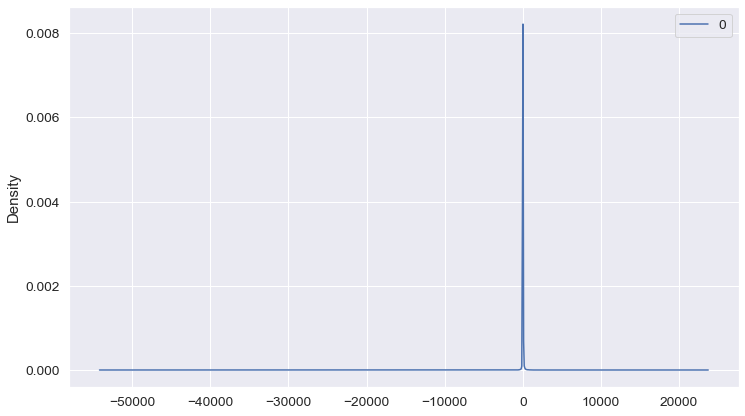

                  0
count  25989.000000
mean       0.000380
std      307.307531
min   -34692.405318
25%       -0.011000
50%        0.042344
75%        1.046359
max     4251.395918


In [180]:
# fit model
model = ARIMA(df['co2'], order=(1,1,0))
model_fit = model.fit()

# summary of fit model
print(model_fit.summary())

# line plot of residuals
residuals = pd.DataFrame(model_fit.resid)
residuals.plot(figsize=(12, 7))
pyplot.show()

# density plot of residuals
residuals.plot(kind='kde', figsize=(12, 7))
pyplot.show()

# summary stats of residuals
print(residuals.describe())

Our first plot is showing a line plot of the residual errors. The results show that indeed there is a slight bias in the prediction (a non-zero mean in the residuals).

We can see form our second plot that our errors are guassian and may be centered at 0

In [181]:
data = pd.read_csv('cleaned_co2.csv', index_col='year')

In [182]:
data = data.drop(columns=['Unnamed: 0'])

In [183]:
data.index = pd.to_datetime(data.index, format='%Y')

In [184]:
data

,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
year,,,,,,,,,,,,,,,,,,,,,
1949-01-01,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600,0.53450,Afghanistan
1950-01-01,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250,0.23850,Afghanistan
1951-01-01,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500,0.54700,Afghanistan
1952-01-01,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500,0.54700,Afghanistan
1953-01-01,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500,0.54700,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-01-01,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,-1.488,...,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
2017-01-01,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,-1.156,...,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
2018-01-01,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,2.273,...,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe


In [185]:
data.index.year

Int64Index([1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958,
            ...
            2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020],
           dtype='int64', name='year', length=25989)

In [186]:
countries = co2_df.country.unique()

-----------------------------------------------------------------------
Afghanistan
predicted=1.227881, expected=1.165000
predicted=1.162294, expected=1.084000
predicted=1.080518, expected=1.029000
predicted=1.026574, expected=0.810000
predicted=0.799655, expected=0.758000
predicted=0.755420, expected=0.798000
predicted=0.799963, expected=1.052000
predicted=1.065126, expected=1.186000
predicted=1.193975, expected=0.889000
predicted=0.874402, expected=1.303000
predicted=1.310268, expected=1.635000
predicted=1.651444, expected=2.269000
predicted=2.330445, expected=4.200000
predicted=4.862075, expected=6.740000
predicted=8.642842, expected=8.398000
predicted=9.575785, expected=12.106000
predicted=15.435248, expected=10.219000
predicted=9.632393, expected=8.441000
predicted=7.776266, expected=7.774000
predicted=7.524502, expected=7.904000
predicted=7.951797, expected=6.745000
predicted=6.323675, expected=6.860000
predicted=6.900049, expected=8.345000
predicted=8.867895, expected=12.147000


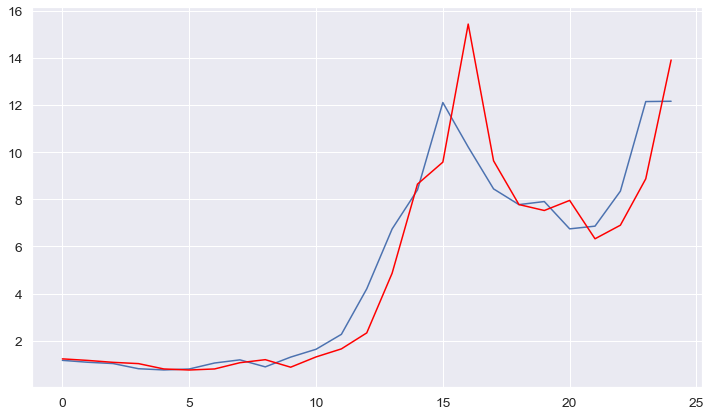

-----------------------------------------------------------------------
Africa
predicted=402.339111, expected=388.873000
predicted=397.818909, expected=387.839000
predicted=386.971392, expected=420.868000
predicted=448.218424, expected=433.857000
predicted=443.759067, expected=463.282000
predicted=486.692619, expected=500.009000
predicted=530.912236, expected=536.510000
predicted=567.966312, expected=549.389000
predicted=559.706095, expected=572.603000
predicted=591.533847, expected=595.441000
predicted=614.240097, expected=650.285000
predicted=698.746940, expected=666.684000
predicted=679.336995, expected=690.700000
predicted=709.512811, expected=690.794000
predicted=690.865009, expected=726.048000
predicted=752.643803, expected=699.221000
predicted=681.933165, expected=659.295000
predicted=632.236582, expected=689.026000
predicted=705.706946, expected=668.677000
predicted=658.362824, expected=708.858000
predicted=727.218336, expected=719.623000
predicted=724.395933, expected=771.9940

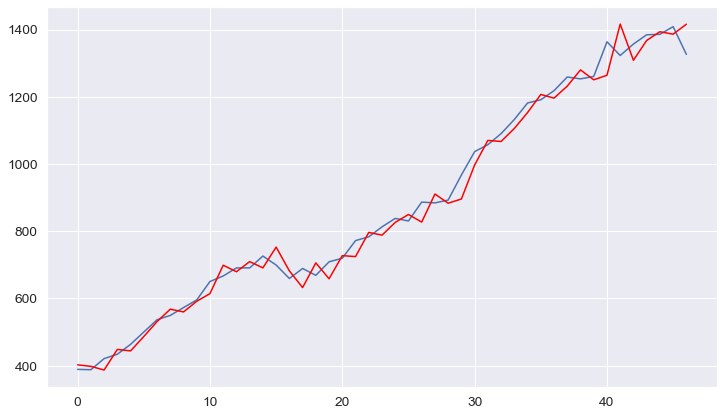

-----------------------------------------------------------------------
Albania
predicted=7.137624, expected=4.228000
predicted=4.462047, expected=2.495000
predicted=2.716598, expected=2.316000
predicted=2.335809, expected=1.913000
predicted=1.956849, expected=2.066000
predicted=2.049182, expected=1.993000
predicted=2.001042, expected=1.532000
predicted=1.582402, expected=1.744000
predicted=1.720428, expected=2.975000
predicted=2.846216, expected=3.004000
predicted=3.001099, expected=3.221000
predicted=3.199320, expected=3.748000
predicted=3.696827, expected=4.232000
predicted=4.188206, expected=4.104000
predicted=4.115706, expected=4.199000
predicted=4.190287, expected=3.844000
predicted=3.876839, expected=3.829000
predicted=3.830382, expected=4.272000
predicted=4.231116, expected=4.254000
predicted=4.255657, expected=4.448000
predicted=4.430120, expected=5.031000
predicted=4.978842, expected=4.668000
predicted=4.701995, expected=4.928000
predicted=4.903158, expected=5.621000
predicte

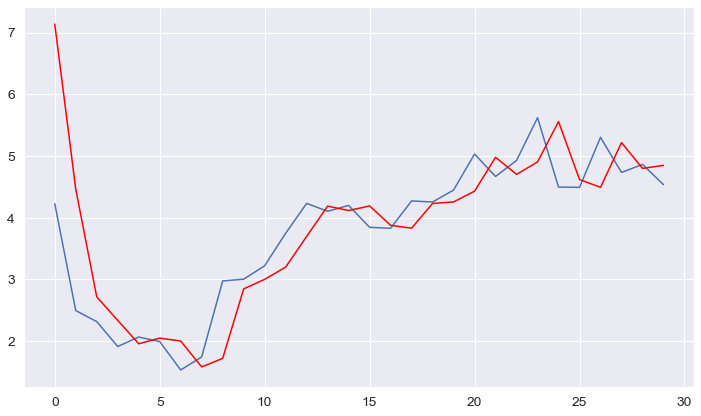

-----------------------------------------------------------------------
Algeria
predicted=65.325725, expected=72.609000
predicted=72.191804, expected=76.080000
predicted=75.217579, expected=83.884000
predicted=82.038894, expected=83.708000
predicted=83.748728, expected=79.808000
predicted=80.709537, expected=76.738000
predicted=77.429358, expected=78.807000
predicted=78.337616, expected=79.883000
predicted=79.640177, expected=81.944000
predicted=81.480790, expected=86.147000
predicted=85.217878, expected=94.981000
predicted=93.166898, expected=96.786000
predicted=96.436693, expected=87.005000
predicted=88.959015, expected=106.621000
predicted=101.498829, expected=91.668000
predicted=96.474697, expected=82.221000
predicted=84.667127, expected=83.780000
predicted=83.379999, expected=89.407000
predicted=87.978317, expected=91.048000
predicted=90.639323, expected=87.853000
predicted=88.652894, expected=106.473000
predicted=101.517493, expected=100.203000
predicted=101.911245, expected=108.

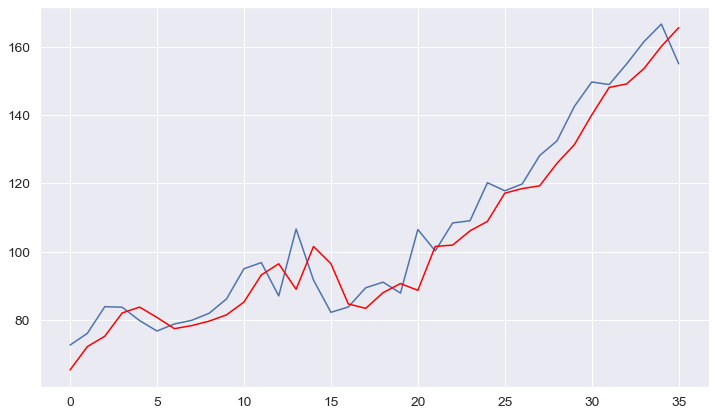

-----------------------------------------------------------------------
Andorra
predicted=0.506777, expected=0.517000
predicted=0.517000, expected=0.491000
predicted=0.479471, expected=0.487000
predicted=0.485367, expected=0.476000
predicted=0.471435, expected=0.462000
predicted=0.455936, expected=0.465000
predicted=0.466188, expected=0.469000
predicted=0.470652, expected=0.465000
predicted=0.463363, expected=0.495000
predicted=0.506178, expected=0.502000
predicted=0.504488, expected=0.466000
Test RMSE: 0.018


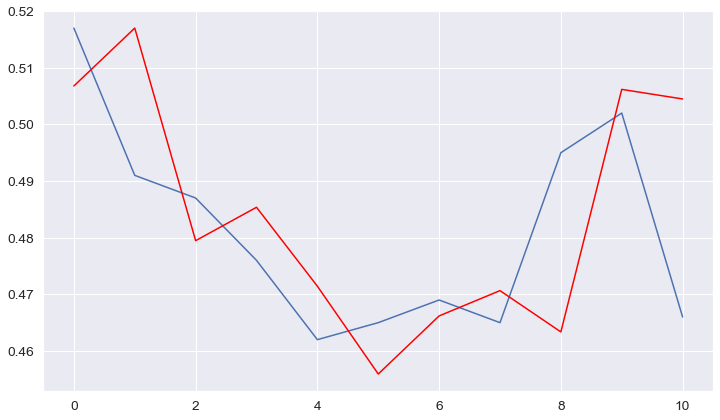

-----------------------------------------------------------------------
Angola
predicted=5.867513, expected=10.424000
predicted=10.557396, expected=7.348000
predicted=8.051787, expected=7.268000
predicted=7.283837, expected=9.130000
predicted=8.758056, expected=9.516000
predicted=9.445561, expected=9.671000
predicted=9.642870, expected=12.598000
predicted=12.084128, expected=8.989000
predicted=9.982624, expected=18.701000
predicted=13.202884, expected=19.006000
predicted=18.918837, expected=22.102000
predicted=21.232821, expected=24.977000
predicted=24.329421, expected=25.486000
predicted=25.379098, expected=27.565000
predicted=27.139014, expected=28.865000
predicted=28.619599, expected=30.330000
predicted=30.067984, expected=33.801000
predicted=33.264596, expected=33.229000
predicted=33.317715, expected=33.296000
predicted=33.285610, expected=33.621000
predicted=33.570618, expected=31.404000
predicted=31.754206, expected=28.420000
predicted=28.800552, expected=24.376000
predicted=24.6

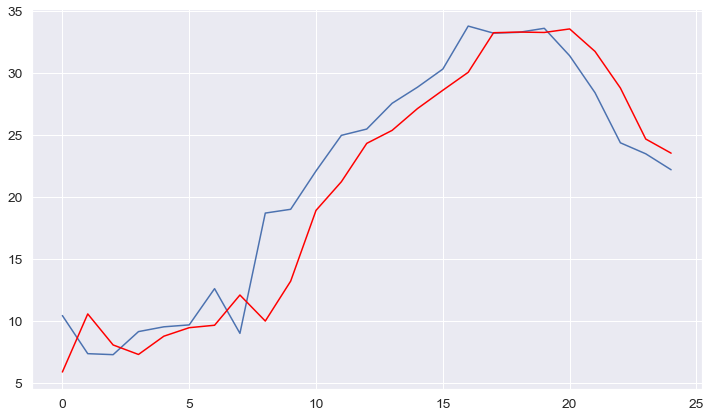

-----------------------------------------------------------------------
Anguilla
predicted=0.145163, expected=0.150000
predicted=0.151795, expected=0.143000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.138988, expected=0.143000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.143000, expected=0.117000
predicted=0.102764, expected=0.139000
predicted=0.139336, expected=0.154000
predicted=0.156376, expected=0.154000
predicted=0.154000, expected=0.143000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.141416, expected=0.143000
predicted=0.143000, expected=0.139000
predicted=0.138451, expected=0.123000
Test RMSE: 0.016


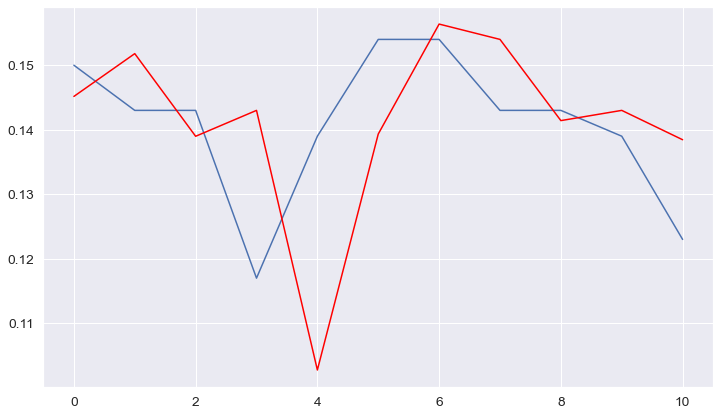

-----------------------------------------------------------------------
Antarctica
predicted=0.005676, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.006902, expected=0.007000
predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000
Test RMSE: 0.000


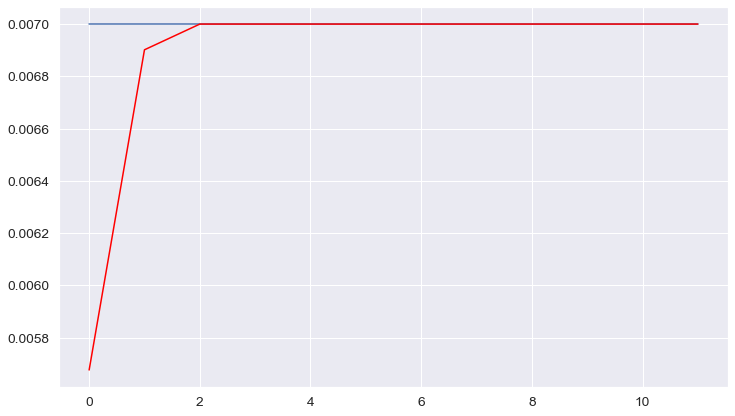

-----------------------------------------------------------------------
Antigua and Barbuda
predicted=0.270785, expected=0.282000
predicted=0.281843, expected=0.293000
predicted=0.292844, expected=0.297000
predicted=0.296943, expected=0.330000
predicted=0.329536, expected=0.352000
predicted=0.351703, expected=0.366000
predicted=0.365814, expected=0.374000
predicted=0.373894, expected=0.385000
predicted=0.384855, expected=0.407000
predicted=0.406714, expected=0.418000
predicted=0.417859, expected=0.443000
predicted=0.442684, expected=0.454000
predicted=0.453861, expected=0.443000
predicted=0.443140, expected=0.458000
predicted=0.457807, expected=0.462000
predicted=0.461949, expected=0.462000
predicted=0.462000, expected=0.480000
predicted=0.479769, expected=0.491000
predicted=0.490861, expected=0.491000
predicted=0.491000, expected=0.498000
predicted=0.497911, expected=0.486000
predicted=0.486153, expected=0.430000
Test RMSE: 0.019


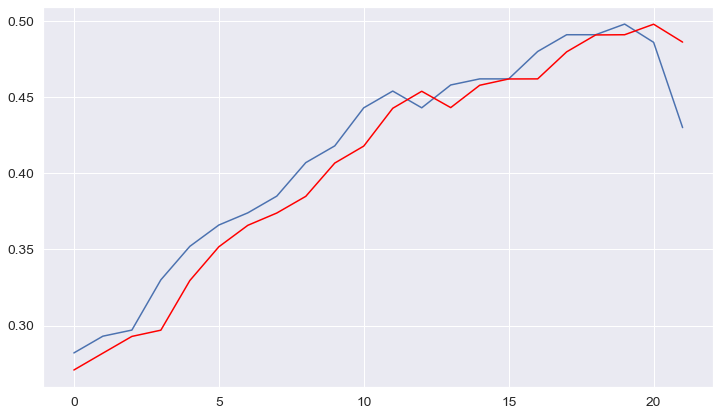

-----------------------------------------------------------------------
Argentina
predicted=95.956065, expected=94.845000
predicted=94.645557, expected=99.699000
predicted=101.199939, expected=100.706000
predicted=101.013956, expected=102.556000
predicted=103.125915, expected=110.616000
predicted=113.255801, expected=108.656000
predicted=108.108825, expected=101.969000
predicted=99.998780, expected=103.351000
predicted=103.720217, expected=105.142000
predicted=105.624828, expected=106.452000
predicted=106.807567, expected=100.531000
predicted=98.983771, expected=104.150000
predicted=104.966467, expected=114.877000
predicted=117.735568, expected=121.405000
predicted=123.404627, expected=117.020000
predicted=115.854488, expected=112.079000
predicted=110.687859, expected=117.506000
predicted=118.863326, expected=121.231000
predicted=122.206044, expected=117.777000
predicted=116.923947, expected=122.229000
predicted=123.256151, expected=127.765000
predicted=129.138804, expected=134.762000


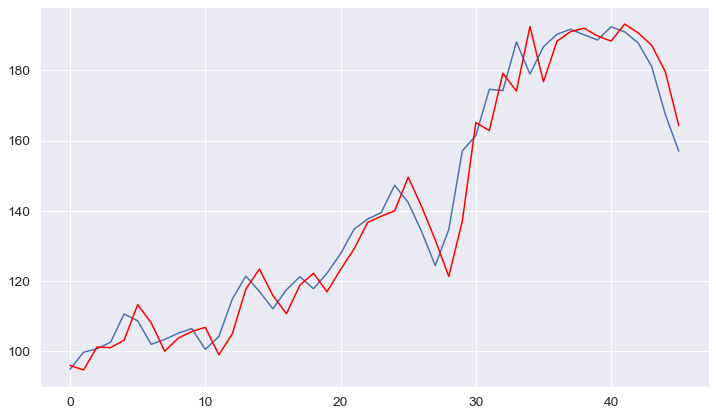

-----------------------------------------------------------------------
Armenia
predicted=2.469105, expected=2.560000
predicted=2.680604, expected=2.802000
predicted=2.939946, expected=2.993000
predicted=3.105062, expected=3.147000
predicted=3.238886, expected=3.277000
predicted=3.355487, expected=3.383000
predicted=3.447447, expected=3.556000
predicted=3.663485, expected=3.818000
predicted=3.988584, expected=4.065000
predicted=4.230946, expected=4.314000
predicted=4.486256, expected=4.558000
predicted=4.730788, expected=4.771000
predicted=4.923652, expected=4.911000
predicted=5.011025, expected=5.118000
predicted=5.268426, expected=5.382000
predicted=5.578729, expected=5.722000
predicted=5.984891, expected=6.027000
predicted=6.265817, expected=6.290000
predicted=6.497181, expected=6.539000
predicted=6.736836, expected=6.881000
predicted=7.159883, expected=7.148000
predicted=7.365141, expected=7.394000
predicted=7.595068, expected=7.653000
predicted=7.866578, expected=7.716000
predicte

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=3.758428, expected=2.595000
predicted=2.250618, expected=3.269000
predicted=3.518781, expected=3.397000
predicted=3.443953, expected=3.050000
predicted=2.923524, expected=3.491000
predicted=3.647741, expected=3.533000
predicted=3.547832, expected=3.077000
predicted=2.916388, expected=3.456000
predicted=3.585283, expected=3.691000
predicted=3.771585, expected=4.376000
predicted=4.615228, expected=4.402000
predicted=4.410914, expected=5.100000
predicted=5.339834, expected=5.575000
predicted=5.741552, expected=4.363000
predicted=3.971879, expected=4.253000
predicted=4.218998, expected=4.969000
predicted=5.187940, expected=5.748000
predicted=5.998409, expected=5.535000
predicted=5.469469, expected=5.604000
predicted=5.625153, expected=5.469000
predicted=5.427667, expected=5.203000
predicted=5.121251, expected=5.537000
predicted=5.638243, expected=5.826000
predicted=5.914290, expected=5.529000
predicted=5.439514, expected=5.890000
Test RMSE: 0.686


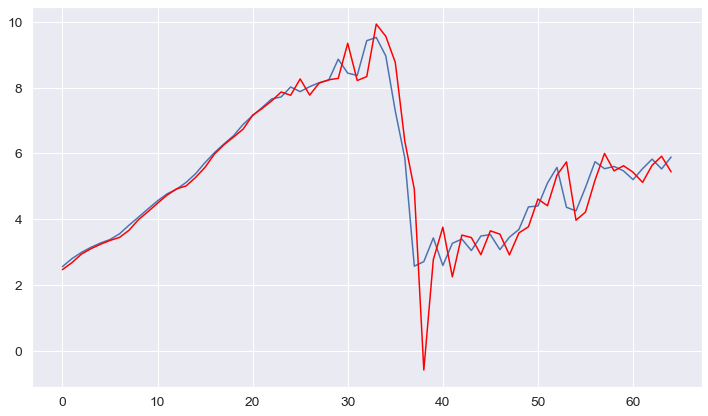

-----------------------------------------------------------------------
Aruba
predicted=0.330122, expected=0.612000
predicted=0.544700, expected=0.649000
predicted=0.634155, expected=0.487000
predicted=0.552347, expected=0.531000
predicted=0.513306, expected=0.539000
predicted=0.535786, expected=0.649000
predicted=0.604837, expected=0.660000
predicted=0.655609, expected=0.707000
predicted=0.688243, expected=0.725000
predicted=0.717827, expected=0.758000
predicted=0.744856, expected=0.806000
predicted=0.786916, expected=0.810000
predicted=0.808411, expected=2.378000
predicted=1.768075, expected=2.407000
predicted=2.401430, expected=2.437000
predicted=2.431243, expected=2.561000
predicted=2.537296, expected=2.616000
predicted=2.605590, expected=2.719000
predicted=2.699629, expected=2.715000
predicted=2.715751, expected=2.821000
predicted=2.801083, expected=2.656000
predicted=2.687502, expected=2.627000
predicted=2.632481, expected=2.506000
predicted=2.528786, expected=2.499000
predicted=

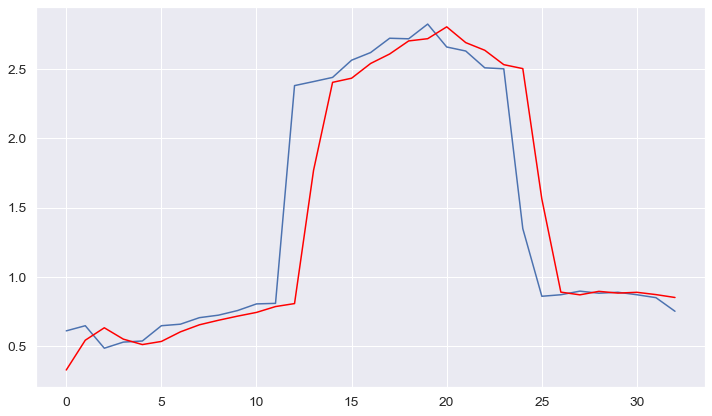

-----------------------------------------------------------------------
Asia
predicted=702.474311, expected=750.837000
predicted=780.275534, expected=845.233000
predicted=890.439641, expected=1139.733000
predicted=1378.974840, expected=1375.522000
predicted=1565.624258, expected=1540.394000
predicted=1668.810379, expected=1395.308000
predicted=1309.883434, expected=1344.446000
predicted=1315.479724, expected=1425.118000
predicted=1469.326270, expected=1509.495000
predicted=1556.750508, expected=1652.064000
predicted=1736.033300, expected=1799.358000
predicted=1890.572594, expected=1827.449000
predicted=1844.025352, expected=2018.387000
predicted=2133.863828, expected=2291.940000
predicted=2480.257065, expected=2699.301000
predicted=3034.195225, expected=2953.833000
predicted=3149.589906, expected=3124.010000
predicted=3253.258427, expected=3355.519000
predicted=3537.013703, expected=3415.347000
predicted=3460.020388, expected=3581.003000
predicted=3706.242091, expected=3806.119000
pred

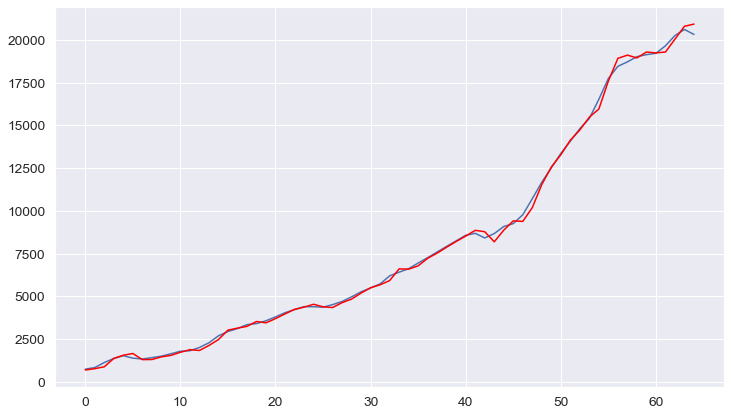

-----------------------------------------------------------------------
Asia (excl. China & India)
predicted=415.965485, expected=453.264000
predicted=465.575754, expected=497.709000
predicted=511.924345, expected=519.192000
predicted=526.301129, expected=553.810000
predicted=565.953322, expected=630.144000
predicted=662.371876, expected=704.138000
predicted=741.762171, expected=752.099000
predicted=777.350920, expected=825.738000
predicted=868.299766, expected=909.218000
predicted=962.432665, expected=997.910000
predicted=1058.978544, expected=1090.359000
predicted=1157.897315, expected=1207.498000
predicted=1300.143187, expected=1348.635000
predicted=1468.970189, expected=1506.667000
predicted=1648.570603, expected=1709.450000
predicted=1903.121435, expected=1852.479000
predicted=1982.074924, expected=1952.137000
predicted=2040.388453, expected=2137.936000
predicted=2310.208439, expected=2171.187000
predicted=2198.589817, expected=2163.349000
predicted=2156.927144, expected=2334.7080

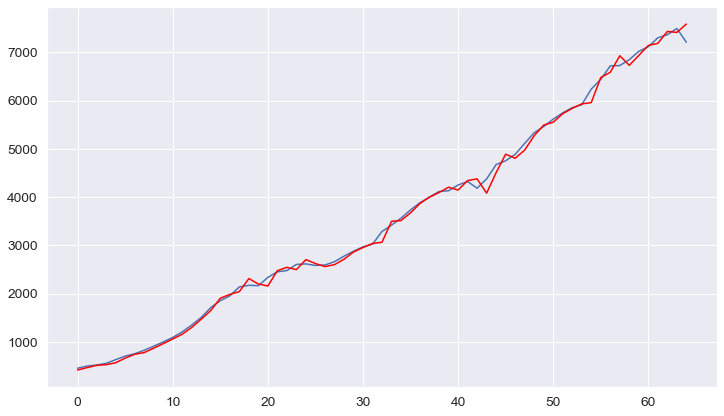

-----------------------------------------------------------------------
Australia
predicted=125.690073, expected=120.219000
predicted=120.005476, expected=129.144000
predicted=132.094550, expected=134.497000
predicted=136.375186, expected=142.124000
predicted=145.015177, expected=147.480000
predicted=149.598163, expected=152.630000
predicted=154.737802, expected=157.337000
predicted=159.315903, expected=170.829000
predicted=177.090458, expected=172.192000
predicted=172.760635, expected=175.717000
predicted=177.197688, expected=174.078000
predicted=173.402192, expected=187.609000
predicted=192.960007, expected=201.825000
predicted=208.501488, expected=204.875000
predicted=206.220887, expected=220.537000
predicted=227.814504, expected=230.140000
predicted=234.770773, expected=233.897000
predicted=235.694291, expected=224.792000
predicted=220.609256, expected=236.370000
predicted=240.950515, expected=240.998000
predicted=242.830123, expected=239.733000
predicted=239.239696, expected=255.8

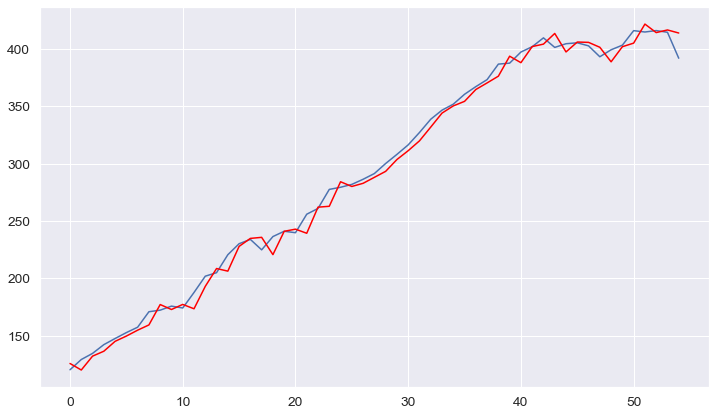

-----------------------------------------------------------------------
Austria
predicted=17.568633, expected=24.487000
predicted=24.475900, expected=26.574000
predicted=26.580259, expected=20.894000
predicted=20.898568, expected=23.264000
predicted=23.251989, expected=22.070000
predicted=22.077111, expected=21.715000
predicted=21.717066, expected=24.506000
predicted=24.488884, expected=29.070000
predicted=29.060443, expected=28.205000
predicted=28.207871, expected=29.179000
predicted=29.175510, expected=28.087000
predicted=28.091276, expected=27.910000
predicted=27.910682, expected=30.784000
predicted=30.772466, expected=31.824000
predicted=31.820809, expected=33.865000
predicted=33.860094, expected=36.949000
predicted=36.947660, expected=38.896000
predicted=38.898783, expected=38.141000
predicted=38.140259, expected=39.209000
predicted=39.209770, expected=39.916000
predicted=39.916681, expected=42.297000
predicted=42.300521, expected=44.638000
predicted=44.645514, expected=50.632000


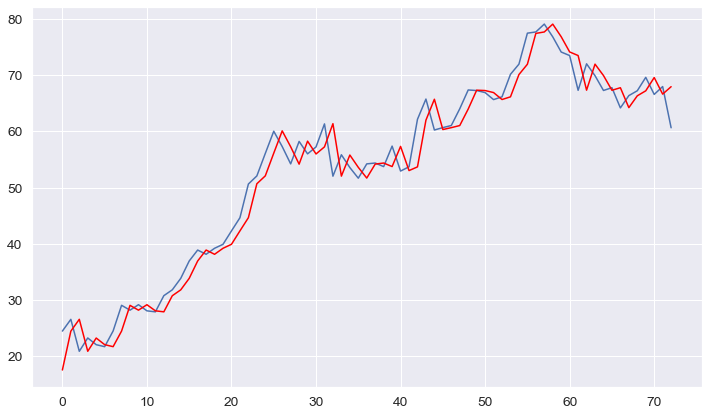

-----------------------------------------------------------------------
Azerbaijan
predicted=14.328989, expected=14.860000
predicted=15.564693, expected=16.271000
predicted=17.078126, expected=17.381000
predicted=18.034244, expected=18.278000
predicted=18.814832, expected=19.037000
predicted=19.496658, expected=19.653000
predicted=20.028628, expected=20.649000
predicted=21.269404, expected=22.166000
predicted=23.155717, expected=23.592000
predicted=24.551403, expected=25.035000
predicted=26.034584, expected=26.444000
predicted=27.442673, expected=27.669000
predicted=28.547355, expected=28.464000
predicted=29.032050, expected=29.657000
predicted=30.523818, expected=31.183000
predicted=32.319876, expected=33.112000
predicted=34.600598, expected=34.854000
predicted=36.215704, expected=36.344000
predicted=37.515157, expected=37.749000
predicted=38.862369, expected=39.695000
predicted=41.276968, expected=41.226000
predicted=42.468160, expected=42.634000
predicted=43.782081, expected=44.1090

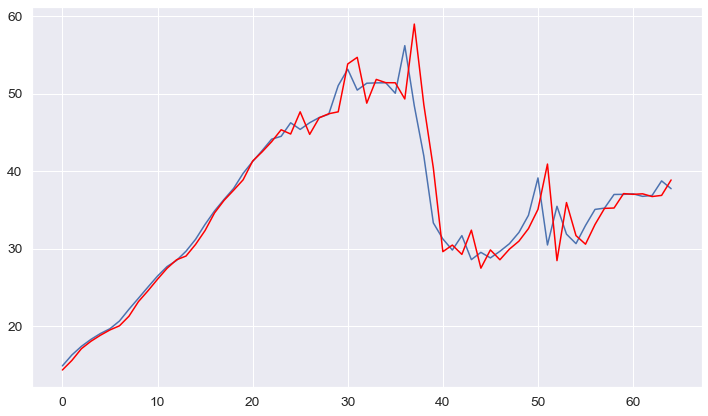

-----------------------------------------------------------------------
Bahamas
predicted=1.821198, expected=1.814000
predicted=1.820453, expected=1.608000
predicted=1.661182, expected=1.990000
predicted=1.890999, expected=2.034000
predicted=2.022624, expected=2.026000
predicted=2.028069, expected=1.946000
predicted=1.966699, expected=2.037000
predicted=2.013439, expected=2.070000
predicted=2.061455, expected=2.048000
predicted=2.053699, expected=1.905000
predicted=1.942047, expected=1.854000
predicted=1.867208, expected=1.872000
predicted=1.867337, expected=1.916000
predicted=1.904598, expected=1.949000
predicted=1.940447, expected=1.902000
predicted=1.914186, expected=2.114000
predicted=2.058995, expected=2.312000
predicted=2.260755, expected=2.704000
predicted=2.602981, expected=2.429000
predicted=2.500133, expected=2.136000
predicted=2.211417, expected=1.979000
predicted=2.019279, expected=2.096000
predicted=2.065958, expected=2.700000
predicted=2.545483, expected=2.638000
predicte

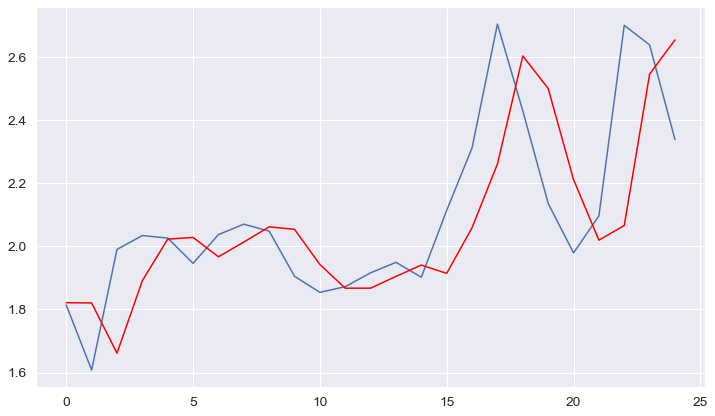

-----------------------------------------------------------------------
Bahrain
predicted=12.495429, expected=11.857000
predicted=11.792421, expected=10.874000
predicted=10.744775, expected=14.609000
predicted=14.719736, expected=14.754000
predicted=14.758660, expected=14.786000
predicted=14.787031, expected=15.590000
predicted=15.616311, expected=17.289000
predicted=17.388322, expected=18.366000
predicted=18.461419, expected=17.989000
predicted=17.959002, expected=18.794000
predicted=18.853563, expected=14.078000
predicted=14.046929, expected=15.868000
predicted=15.686706, expected=16.769000
predicted=16.698813, expected=17.884000
predicted=17.811379, expected=19.804000
predicted=19.729165, expected=19.421000
predicted=19.438475, expected=26.771000
predicted=26.207587, expected=29.681000
predicted=29.975556, expected=28.098000
predicted=27.994660, expected=29.075000
predicted=29.127973, expected=28.468000
predicted=28.437602, expected=27.019000
predicted=26.938428, expected=31.000000


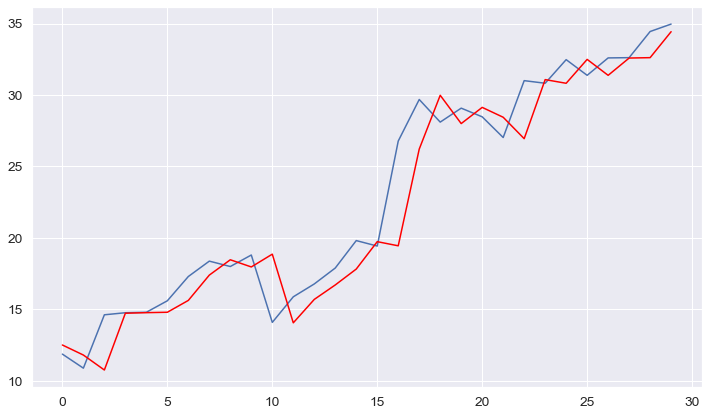

-----------------------------------------------------------------------
Bangladesh
predicted=18.290467, expected=21.042000
predicted=23.633765, expected=21.493000
predicted=21.711452, expected=23.126000
predicted=23.951552, expected=23.198000
predicted=23.231617, expected=25.075000
predicted=25.957229, expected=26.525000
predicted=27.250165, expected=31.035000
predicted=33.911242, expected=31.981000
predicted=32.444469, expected=33.459000
predicted=34.206892, expected=35.945000
predicted=37.305064, expected=37.677000
predicted=38.648237, expected=41.689000
predicted=44.225314, expected=42.642000
predicted=43.175737, expected=45.301000
predicted=46.849300, expected=49.148000
predicted=51.628289, expected=53.992000
predicted=57.498975, expected=56.556000
predicted=58.327710, expected=60.691000
predicted=63.718245, expected=61.782000
predicted=62.526624, expected=65.979000
predicted=68.934854, expected=73.277000
predicted=79.113384, expected=76.477000
predicted=78.780230, expected=80.9440

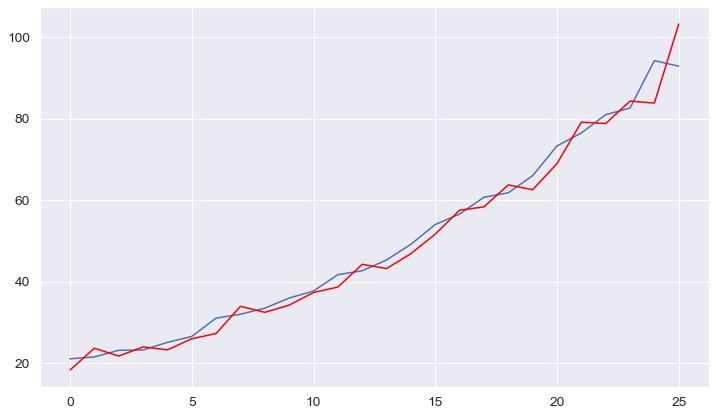

-----------------------------------------------------------------------
Barbados
predicted=0.946046, expected=0.989000
predicted=1.000591, expected=1.070000
predicted=1.094055, expected=1.202000
predicted=1.252948, expected=0.973000
predicted=0.958518, expected=1.101000
predicted=1.084239, expected=0.739000
predicted=0.871538, expected=0.807000
predicted=0.787085, expected=0.823000
predicted=0.818434, expected=0.888000
predicted=0.869683, expected=1.099000
predicted=1.049262, expected=1.162000
predicted=1.151178, expected=1.152000
predicted=1.153717, expected=1.186000
predicted=1.180133, expected=1.200000
predicted=1.197609, expected=1.245000
predicted=1.237392, expected=1.270000
predicted=1.265870, expected=1.319000
predicted=1.311077, expected=1.343000
predicted=1.339217, expected=1.363000
predicted=1.359876, expected=1.612000
predicted=1.576470, expected=1.597000
predicted=1.598969, expected=1.464000
predicted=1.480846, expected=1.517000
predicted=1.509736, expected=1.459000
predict

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.261000, expected=1.283000
predicted=1.280303, expected=1.170000
predicted=1.184397, expected=1.236000
predicted=1.226844, expected=1.215000
predicted=1.217946, expected=1.087000
Test RMSE: 0.122


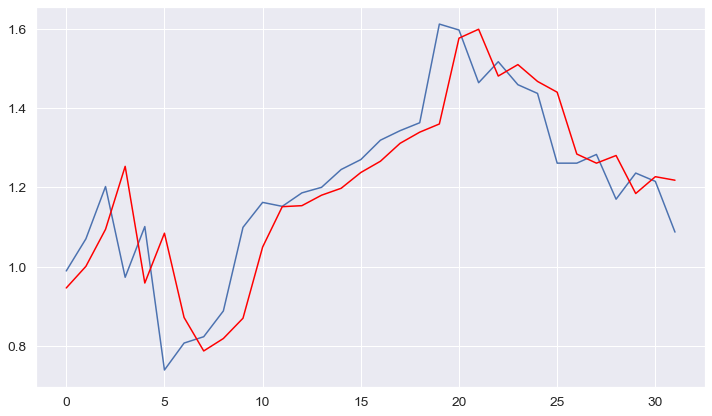

-----------------------------------------------------------------------
Belarus
predicted=30.206301, expected=31.296000
predicted=32.773432, expected=34.252000
predicted=35.945091, expected=36.570000
predicted=37.934906, expected=38.453000
predicted=39.580561, expected=40.046000
predicted=41.011186, expected=41.318000
predicted=42.093637, expected=43.395000
predicted=44.688139, expected=46.555000
predicted=48.613953, expected=49.522000
predicted=51.514512, expected=52.540000
predicted=54.626857, expected=55.496000
predicted=57.587797, expected=58.060000
predicted=59.895378, expected=59.721000
predicted=60.905869, expected=62.217000
predicted=64.027441, expected=65.460000
predicted=67.873865, expected=69.481000
predicted=72.578849, expected=73.131000
predicted=75.980617, expected=76.252000
predicted=78.702181, expected=79.191000
predicted=81.517070, expected=83.255000
predicted=86.554000, expected=86.430000
predicted=89.001525, expected=89.352000
predicted=91.730439, expected=92.428000


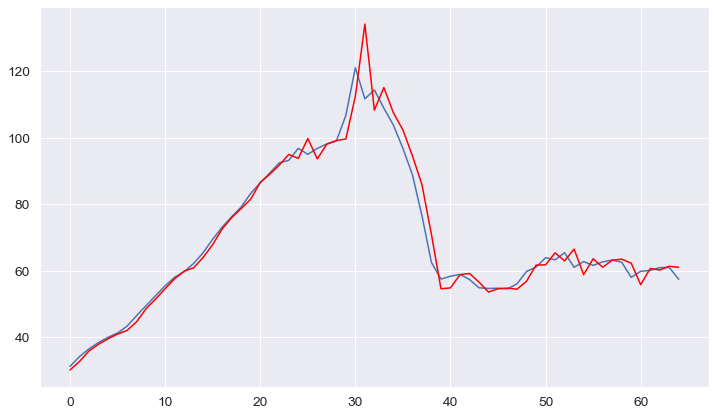

-----------------------------------------------------------------------
Belgium
predicted=38.824650, expected=56.411000
predicted=57.097461, expected=82.030000
predicted=85.813030, expected=85.057000
predicted=85.491534, expected=80.772000
predicted=80.169865, expected=76.200000
predicted=75.541074, expected=89.450000
predicted=91.181908, expected=83.464000
predicted=82.805861, expected=82.374000
predicted=82.253585, expected=85.735000
predicted=86.103738, expected=92.017000
predicted=92.731296, expected=96.780000
predicted=97.345748, expected=96.487000
predicted=96.452434, expected=87.685000
predicted=86.642177, expected=88.310000
predicted=88.382256, expected=90.908000
predicted=91.209166, expected=92.698000
predicted=92.906860, expected=98.018000
predicted=98.648249, expected=105.676000
predicted=106.638838, expected=103.554000
predicted=103.296832, expected=105.331000
predicted=105.544894, expected=105.097000
predicted=105.068869, expected=107.361000
predicted=107.632953, expected=

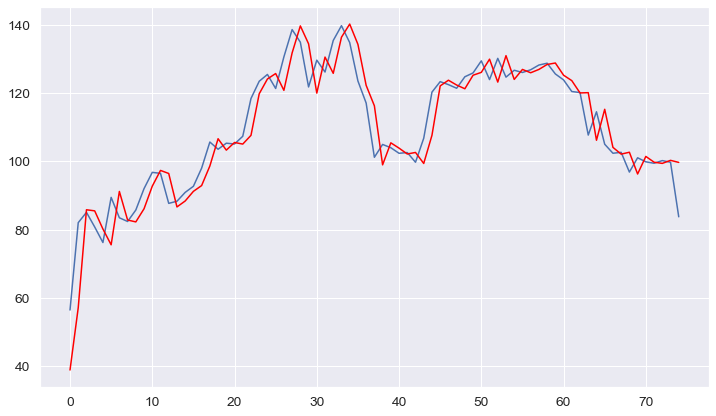

-----------------------------------------------------------------------
Belize
predicted=0.376449, expected=0.308000
predicted=0.320939, expected=0.388000
predicted=0.360737, expected=0.370000
predicted=0.375772, expected=0.348000
predicted=0.354753, expected=0.396000
predicted=0.380106, expected=0.447000
predicted=0.434268, expected=0.432000
predicted=0.435788, expected=0.432000
predicted=0.432000, expected=0.392000
predicted=0.402046, expected=0.421000
predicted=0.413218, expected=0.443000
predicted=0.437518, expected=0.476000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.468268, expected=0.436000
predicted=0.446135, expected=0.517000
predicted=0.491285, expected=0.539000
predicted=0.533679, expected=0.553000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.549721, expected=0.451000
predicted=0.477362, expected=0.440000
predicted=0.442207, expected=0.469000
predicted=0.463051, expected=0.641000
predicted=0.619142, expected=0.623000
predicted=0.625164, expected=0.616000
predicted=0.616830, expected=0.605000
predicted=0.606296, expected=0.658000
predicted=0.651453, expected=0.583000
Test RMSE: 0.057


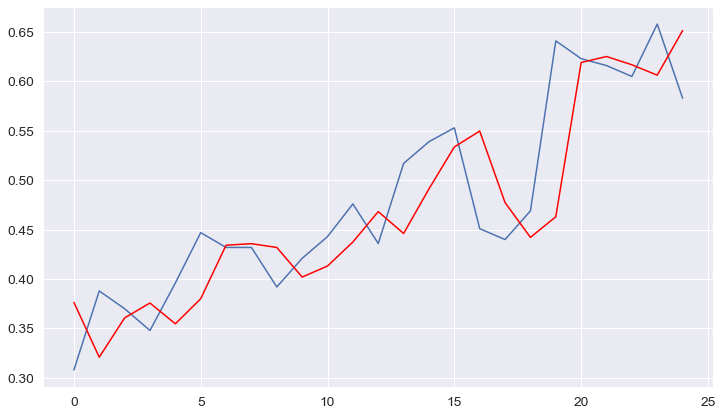

-----------------------------------------------------------------------
Benin
predicted=1.106603, expected=1.462000
predicted=1.456026, expected=1.473000
predicted=1.472978, expected=1.689000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.689914, expected=2.110000
predicted=2.198492, expected=2.394000
predicted=2.491319, expected=2.594000
predicted=2.670822, expected=2.490000
predicted=2.455126, expected=3.351000
predicted=3.529120, expected=3.931000
predicted=4.182943, expected=3.919000
predicted=3.914775, expected=4.225000
predicted=4.332044, expected=4.679000
predicted=4.862266, expected=4.480000
predicted=4.415688, expected=4.403000
predicted=4.378019, expected=4.566000
predicted=4.617814, expected=4.796000
predicted=4.872106, expected=5.326000
predicted=5.525240, expected=6.600000
predicted=7.350338, expected=6.938000
predicted=7.095533, expected=7.255000
predicted=7.406679, expected=7.315000
predicted=7.343325, expected=6.703000
Test RMSE: 0.419


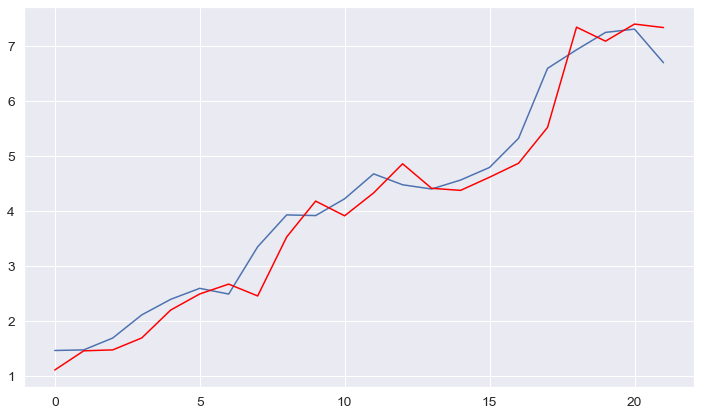

-----------------------------------------------------------------------
Bermuda
predicted=0.531000, expected=0.528000
predicted=0.528573, expected=0.524000
predicted=0.524764, expected=0.520000
predicted=0.520764, expected=0.513000
predicted=0.514336, expected=0.517000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.516236, expected=0.528000
predicted=0.525900, expected=0.557000
predicted=0.551515, expected=0.561000
predicted=0.560249, expected=0.583000
predicted=0.578878, expected=0.583000
predicted=0.583000, expected=0.652000
predicted=0.639101, expected=0.729000
predicted=0.717029, expected=0.649000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.663496, expected=0.476000
predicted=0.495300, expected=0.608000
predicted=0.582830, expected=0.443000
predicted=0.486197, expected=0.366000
predicted=0.380814, expected=0.535000
predicted=0.495666, expected=0.671000
predicted=0.651924, expected=0.539000
predicted=0.563480, expected=0.619000
predicted=0.602523, expected=0.630000
predicted=0.627800, expected=0.711000
predicted=0.695008, expected=0.698000
predicted=0.700559, expected=0.624000
Test RMSE: 0.086


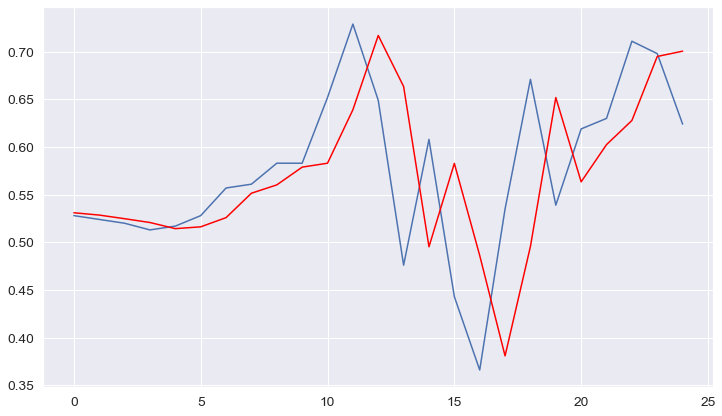

-----------------------------------------------------------------------
Bhutan
predicted=0.406670, expected=0.360000
predicted=0.354688, expected=0.291000
predicted=0.276523, expected=0.378000
predicted=0.379187, expected=0.374000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.373988, expected=0.373000
predicted=0.372997, expected=0.401000
predicted=0.401066, expected=0.369000
predicted=0.369593, expected=0.465000
predicted=0.456818, expected=0.667000
predicted=0.723449, expected=0.773000
predicted=0.813561, expected=0.853000
predicted=0.886692, expected=0.948000
predicted=0.992028, expected=0.965000
predicted=0.972532, expected=1.156000
predicted=1.244761, expected=1.239000
predicted=1.277032, expected=1.436000
predicted=1.541137, expected=1.927000
predicted=2.339830, expected=1.925000
Test RMSE: 0.160


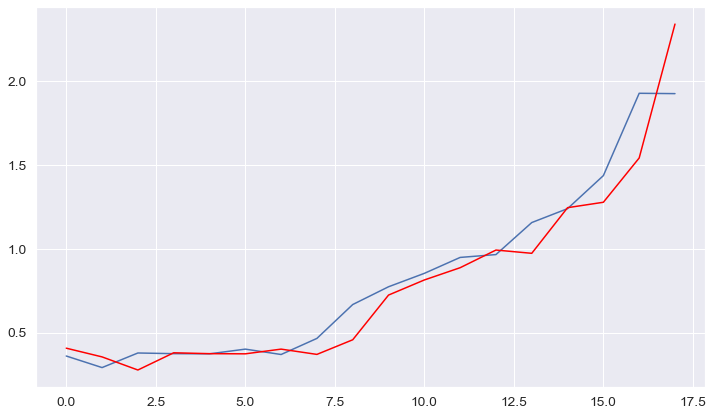

-----------------------------------------------------------------------
Bolivia
predicted=4.336299, expected=4.968000
predicted=5.132910, expected=5.727000
predicted=6.005784, expected=5.972000
predicted=6.060363, expected=6.621000
predicted=6.877788, expected=7.792000
predicted=8.413901, expected=8.594000
predicted=9.049376, expected=9.800000
predicted=10.595710, expected=10.086000
predicted=10.252511, expected=11.256000
predicted=11.977178, expected=11.246000
predicted=11.240751, expected=10.722000
predicted=10.446784, expected=8.641000
predicted=7.353930, expected=8.292000
predicted=8.124526, expected=8.384000
predicted=8.427564, expected=9.985000
predicted=10.757147, expected=10.185000
predicted=10.270521, expected=11.176000
predicted=11.610182, expected=11.548000
predicted=11.709720, expected=12.663000
predicted=13.169444, expected=13.554000
predicted=13.978617, expected=14.229000
predicted=14.558235, expected=15.426000
predicted=16.043754, expected=16.992000
predicted=17.880460, 

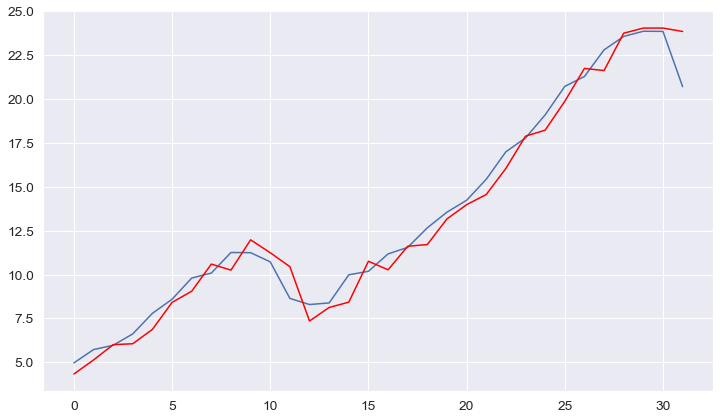

-----------------------------------------------------------------------
Bonaire Sint Eustatius and Saba
predicted=0.128271, expected=0.121000
predicted=0.121703, expected=0.230000
predicted=0.191675, expected=0.247000
predicted=0.241091, expected=0.197000
predicted=0.214408, expected=0.162000
predicted=0.174125, expected=0.250000
predicted=0.219349, expected=0.240000
predicted=0.243471, expected=0.238000
predicted=0.238694, expected=0.222000
predicted=0.227556, expected=0.233000
predicted=0.229179, expected=0.013000
predicted=0.089747, expected=0.096000
predicted=0.066965, expected=0.255000
predicted=0.201010, expected=0.260000
predicted=0.258332, expected=0.251000
predicted=0.254003, expected=0.251000
predicted=0.251000, expected=0.263000
predicted=0.258995, expected=0.261000
predicted=0.261668, expected=0.272000
predicted=0.268328, expected=0.306000
predicted=0.294656, expected=0.294000
predicted=0.298004, expected=0.301000
predicted=0.298664, expected=0.207000
predicted=0.238415, ex

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.342662, expected=0.301000
Test RMSE: 0.063


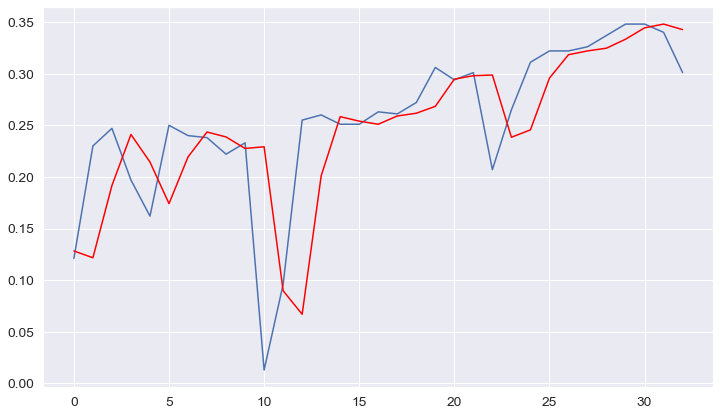

-----------------------------------------------------------------------
Bosnia and Herzegovina
predicted=13.380746, expected=12.900000
predicted=12.911237, expected=13.460000
predicted=13.575279, expected=13.891000
predicted=13.983592, expected=13.507000
predicted=13.428467, expected=15.093000
predicted=15.366445, expected=16.416000
predicted=16.741374, expected=16.141000
predicted=16.082331, expected=17.566000
predicted=17.845990, expected=16.136000
predicted=15.986748, expected=17.376000
predicted=17.419078, expected=18.324000
predicted=18.392276, expected=18.692000
predicted=18.721880, expected=19.520000
predicted=19.595035, expected=19.056000
predicted=19.020461, expected=19.663000
predicted=19.703841, expected=19.603000
predicted=19.599076, expected=19.314000
predicted=19.294945, expected=13.633000
predicted=12.978389, expected=15.029000
predicted=14.939897, expected=12.581000
predicted=12.857318, expected=3.205000
predicted=1.253285, expected=3.402000
predicted=3.418485, expected

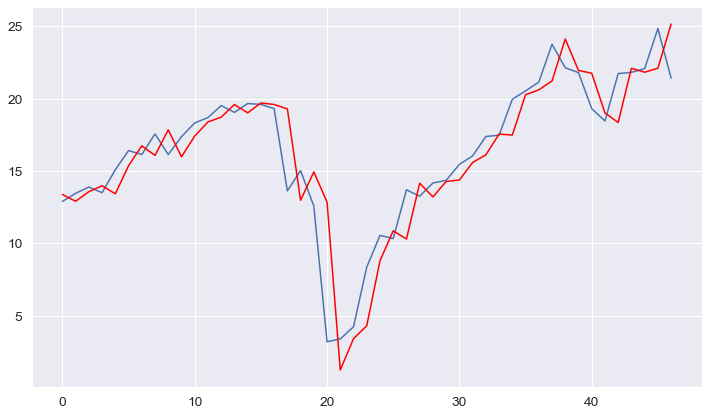

-----------------------------------------------------------------------
Botswana
predicted=3.824309, expected=3.895000
predicted=3.895076, expected=4.093000
predicted=4.094124, expected=4.133000
predicted=4.133328, expected=4.228000
predicted=4.228896, expected=4.503000
predicted=4.507816, expected=3.855000
predicted=3.879756, expected=4.537000
predicted=4.431533, expected=4.029000
predicted=4.141306, expected=5.077000
predicted=4.733747, expected=5.663000
predicted=5.574739, expected=6.850000
predicted=6.822903, expected=5.425000
predicted=5.779549, expected=6.334000
predicted=6.031580, expected=7.059000
predicted=6.884227, expected=7.561000
predicted=7.462923, expected=6.925000
predicted=7.064835, expected=6.519000
Test RMSE: 0.723


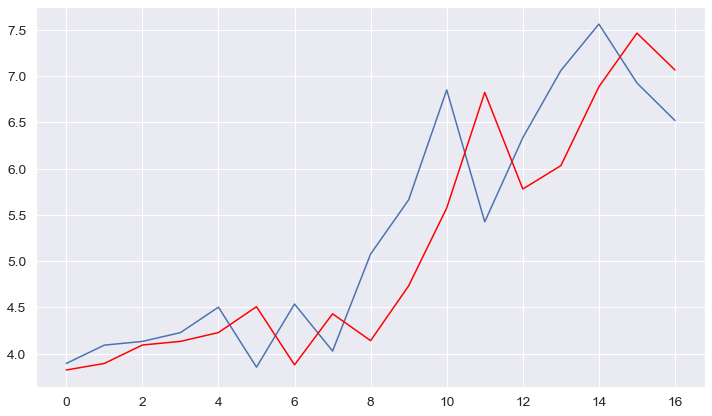

-----------------------------------------------------------------------
Brazil
predicted=195.867500, expected=185.937000
predicted=184.960786, expected=170.622000
predicted=159.781726, expected=170.924000
predicted=171.112705, expected=165.523000
predicted=162.153133, expected=167.683000
predicted=168.999631, expected=180.004000
predicted=187.646623, expected=197.293000
predicted=208.918158, expected=205.839000
predicted=211.408697, expected=207.596000
predicted=208.719397, expected=212.131000
predicted=215.041074, expected=218.658000
predicted=222.886667, expected=229.394000
predicted=236.516825, expected=233.601000
predicted=236.345707, expected=244.306000
predicted=251.413876, expected=254.002000
predicted=260.531177, expected=268.678000
predicted=278.935760, expected=289.311000
predicted=304.673332, expected=306.949000
predicted=320.302461, expected=317.359000
predicted=325.108234, expected=327.256000
predicted=334.676866, expected=340.183000
predicted=350.039411, expected=346.1660

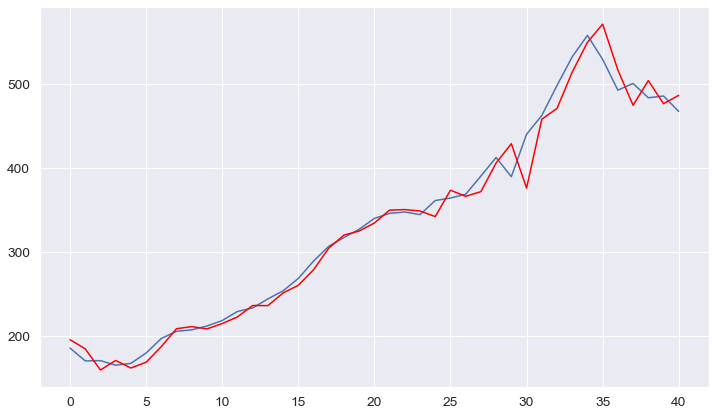

-----------------------------------------------------------------------
British Virgin Islands
predicted=0.121000, expected=0.125000
predicted=0.125994, expected=0.128000
predicted=0.128765, expected=0.136000
predicted=0.138183, expected=0.147000
predicted=0.150604, expected=0.161000
predicted=0.166723, expected=0.180000
predicted=0.189968, expected=0.183000
predicted=0.184372, expected=0.187000
predicted=0.188845, expected=0.191000
predicted=0.192862, expected=0.191000
predicted=0.191000, expected=0.198000
predicted=0.201233, expected=0.202000
predicted=0.203858, expected=0.202000
predicted=0.202000, expected=0.202000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.202000, expected=0.213000
predicted=0.218070, expected=0.213000
predicted=0.213000, expected=0.213000
predicted=0.213000, expected=0.169000
predicted=0.149839, expected=0.161000
predicted=0.158468, expected=0.157000
predicted=0.155723, expected=0.139000
Test RMSE: 0.012


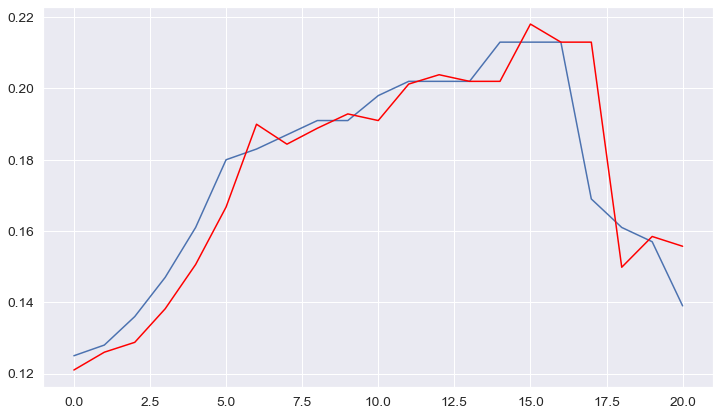

-----------------------------------------------------------------------
Brunei
predicted=6.263577, expected=5.305000
predicted=5.738146, expected=5.210000
predicted=5.256513, expected=4.965000
predicted=5.084971, expected=4.690000
predicted=4.824635, expected=4.785000
predicted=4.738480, expected=4.741000
predicted=4.762551, expected=4.932000
predicted=4.838423, expected=5.159000
predicted=5.047792, expected=3.803000
predicted=4.468290, expected=4.591000
predicted=4.204003, expected=4.389000
predicted=4.488159, expected=4.254000
predicted=4.320268, expected=4.470000
predicted=4.363939, expected=4.873000
predicted=4.675183, expected=4.869000
predicted=4.870963, expected=4.738000
predicted=4.802302, expected=8.310000
predicted=6.553485, expected=8.991000
predicted=8.669244, expected=7.746000
predicted=8.336045, expected=8.061000
predicted=7.911925, expected=9.545000
predicted=8.844339, expected=9.493000
predicted=9.517445, expected=7.628000
predicted=8.504368, expected=8.926000
predicted

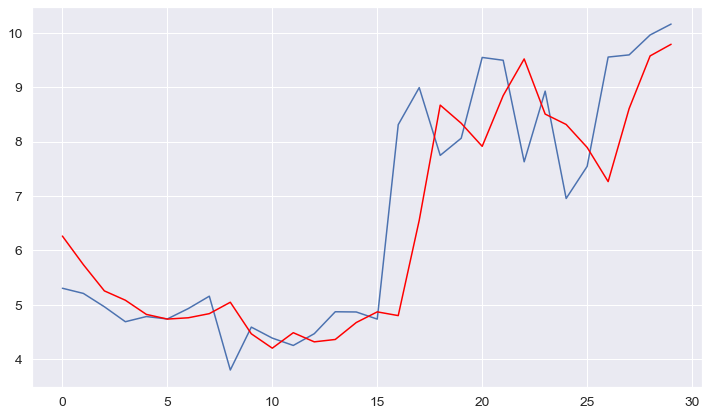

-----------------------------------------------------------------------
Bulgaria
predicted=67.014336, expected=68.717000
predicted=70.070878, expected=71.137000
predicted=72.399193, expected=72.922000
predicted=73.859651, expected=72.965000
predicted=72.987392, expected=75.796000
predicted=77.270873, expected=81.207000
predicted=84.193830, expected=78.928000
predicted=77.839521, expected=77.251000
predicted=76.444202, expected=80.087000
predicted=81.406807, expected=89.844000
predicted=94.954928, expected=90.061000
predicted=90.153805, expected=87.045000
predicted=85.759412, expected=89.221000
predicted=90.103450, expected=91.172000
predicted=91.972145, expected=91.273000
predicted=91.314157, expected=86.913000
predicted=85.140668, expected=86.482000
predicted=86.311518, expected=76.699000
predicted=72.760424, expected=61.517000
predicted=52.786504, expected=57.365000
predicted=55.310230, expected=58.426000
predicted=58.935500, expected=56.404000
predicted=55.439173, expected=57.950000

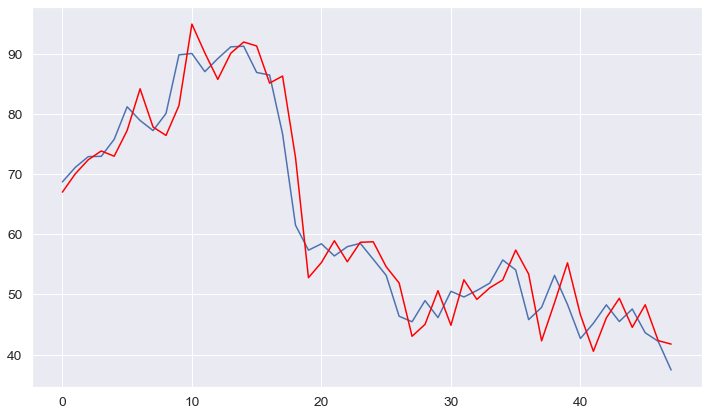

-----------------------------------------------------------------------
Burkina Faso
predicted=0.849572, expected=0.916000
predicted=0.907202, expected=1.030000
predicted=1.016090, expected=0.991000
predicted=0.996246, expected=1.001000
predicted=0.999646, expected=1.075000
predicted=1.065221, expected=1.100000
predicted=1.096967, expected=1.122000
predicted=1.119388, expected=1.356000
predicted=1.333424, expected=1.591000
predicted=1.616428, expected=1.734000
predicted=1.760730, expected=1.829000
predicted=1.849254, expected=2.036000
predicted=2.089696, expected=2.131000
predicted=2.157563, expected=2.619000
predicted=2.802814, expected=2.864000
predicted=2.967059, expected=2.911000
predicted=2.929904, expected=3.297000
predicted=3.460630, expected=3.381000
predicted=3.413731, expected=3.938000
predicted=4.180746, expected=4.301000
predicted=4.479072, expected=4.336000
predicted=4.351830, expected=3.970000
Test RMSE: 0.215


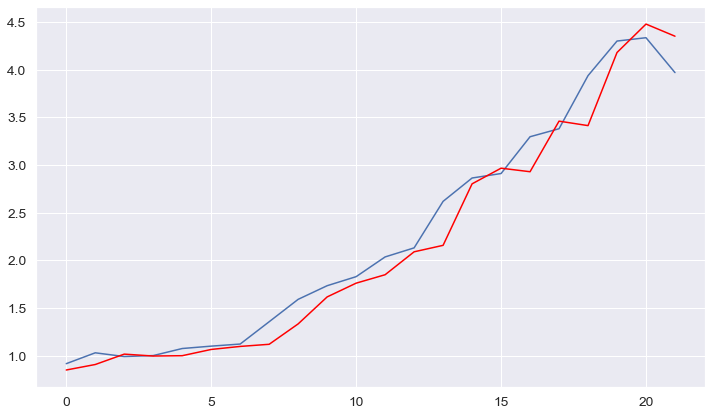

-----------------------------------------------------------------------
Burundi
predicted=0.236544, expected=0.242000
predicted=0.240550, expected=0.249000
predicted=0.246480, expected=0.249000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.249000, expected=0.253000
predicted=0.251565, expected=0.271000
predicted=0.264765, expected=0.205000
predicted=0.232464, expected=0.213000
predicted=0.210202, expected=0.161000
predicted=0.180621, expected=0.198000
predicted=0.182497, expected=0.154000
predicted=0.174040, expected=0.183000
predicted=0.169336, expected=0.202000
predicted=0.193586, expected=0.209000
predicted=0.205978, expected=0.169000
predicted=0.186345, expected=0.297000
predicted=0.222507, expected=0.354000
predicted=0.341873, expected=0.379000
predicted=0.374796, expected=0.398000
predicted=0.395034, expected=0.375000
predicted=0.378713, expected=0.391000
predicted=0.388285, expected=0.467000
predicted=0.456228, expected=0.530000
predicted=0.527356, expected=0.679000
predicted=0.696514, expected=0.704000
predicted=0.707278, expected=0.602000
Test RMSE: 0.060


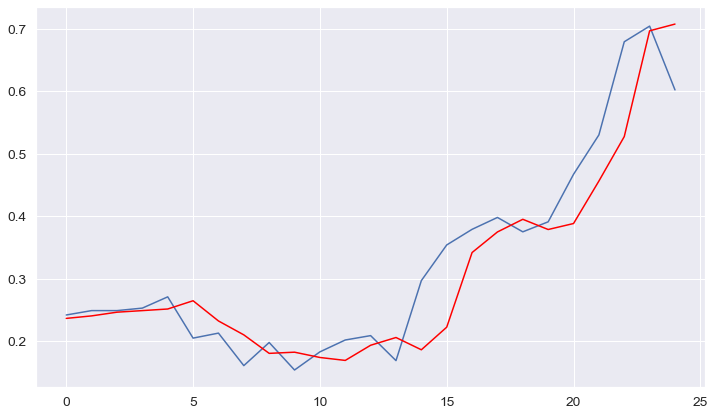

-----------------------------------------------------------------------
Cambodia
predicted=1.461070, expected=1.876000
predicted=1.912086, expected=1.894000
predicted=1.895535, expected=1.975000
predicted=1.981952, expected=2.250000
predicted=2.275855, expected=2.206000
predicted=2.202172, expected=2.378000
predicted=2.392478, expected=2.444000
predicted=2.449770, expected=2.774000
predicted=2.805402, expected=2.997000
predicted=3.023142, expected=3.471000
predicted=3.542726, expected=3.881000
predicted=3.963907, expected=4.557000
predicted=4.742874, expected=5.100000
predicted=5.283813, expected=5.194000
predicted=5.224709, expected=5.451000
predicted=5.536299, expected=5.578000
predicted=5.620490, expected=6.494000
predicted=6.823679, expected=8.527000
predicted=9.860723, expected=10.533000
predicted=12.125744, expected=12.875000
predicted=14.957559, expected=12.879000
predicted=12.881577, expected=15.329000
predicted=16.896030, expected=15.326000
Test RMSE: 0.903


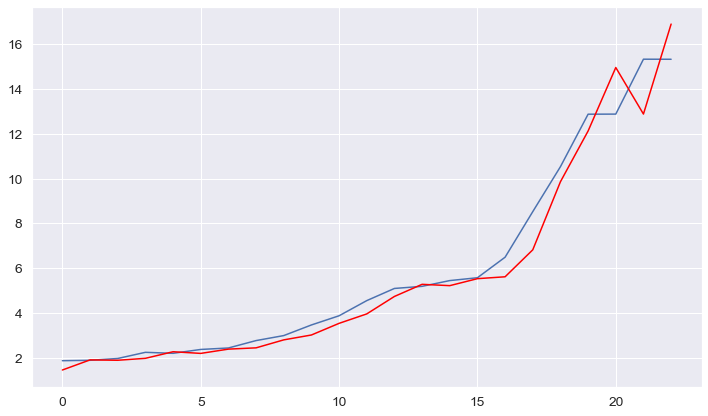

-----------------------------------------------------------------------
Cameroon
predicted=3.106202, expected=3.594000
predicted=3.489699, expected=3.157000
predicted=3.274586, expected=3.136000
predicted=3.141638, expected=2.997000
predicted=3.034329, expected=3.346000
predicted=3.252063, expected=3.326000
predicted=3.331379, expected=3.325000
predicted=3.325269, expected=3.699000
predicted=3.598339, expected=3.851000
predicted=3.810245, expected=3.591000
predicted=3.660836, expected=3.752000
predicted=3.708697, expected=5.703000
predicted=5.185891, expected=5.426000
predicted=5.497984, expected=6.594000
predicted=6.286486, expected=6.662000
predicted=6.644422, expected=6.521000
predicted=6.557472, expected=6.159000
predicted=6.252434, expected=5.070000
predicted=5.345930, expected=6.850000
predicted=6.367321, expected=7.746000
predicted=7.526192, expected=7.815000
predicted=7.798256, expected=7.698000
predicted=7.726407, expected=7.932000
predicted=7.875114, expected=7.398000
predict

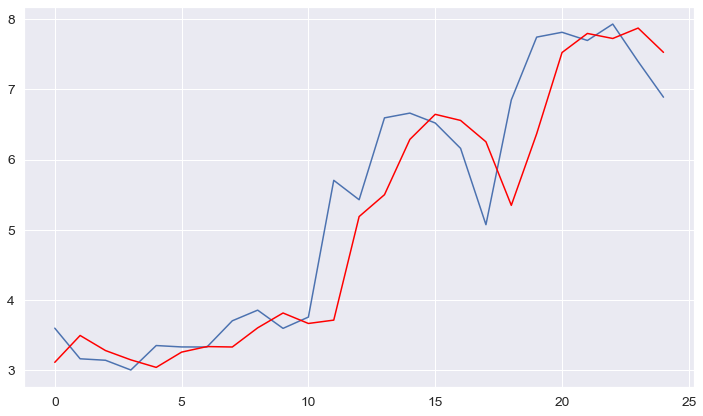

-----------------------------------------------------------------------
Canada
predicted=93.906024, expected=108.622000
predicted=107.638329, expected=120.152000
predicted=119.903257, expected=131.077000
predicted=131.243657, expected=138.062000
predicted=138.312360, expected=140.407000
predicted=140.500410, expected=130.521000
predicted=130.190244, expected=138.422000
predicted=138.515809, expected=143.548000
predicted=143.662031, expected=158.507000
predicted=159.134478, expected=145.022000
predicted=145.153268, expected=154.134000
predicted=153.786751, expected=162.678000
predicted=162.511496, expected=159.409000
predicted=159.492295, expected=160.608000
predicted=160.576462, expected=162.968000
predicted=162.907447, expected=169.473000
predicted=169.328794, expected=189.802000
predicted=189.955086, expected=182.811000
predicted=182.965588, expected=182.155000
predicted=182.168755, expected=184.481000
predicted=184.431515, expected=192.716000
predicted=192.572842, expected=194.00100

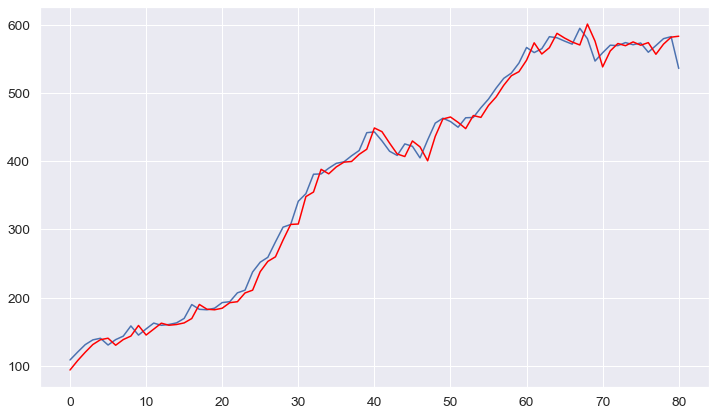

-----------------------------------------------------------------------
Cape Verde
predicted=0.122868, expected=0.143000
predicted=0.148933, expected=0.147000
predicted=0.148075, expected=0.158000
predicted=0.160966, expected=0.183000
predicted=0.189861, expected=0.216000
predicted=0.225479, expected=0.234000
predicted=0.239267, expected=0.275000
predicted=0.287501, expected=0.308000
predicted=0.318575, expected=0.330000
predicted=0.337200, expected=0.440000
predicted=0.480469, expected=0.473000
predicted=0.484741, expected=0.506000
predicted=0.518077, expected=0.469000
predicted=0.456316, expected=0.520000
predicted=0.535798, expected=0.557000
predicted=0.569003, expected=0.616000
predicted=0.636502, expected=0.502000
predicted=0.473871, expected=0.495000
predicted=0.493457, expected=0.487000
predicted=0.485232, expected=0.491000
predicted=0.491882, expected=0.539000
predicted=0.549682, expected=0.579000
predicted=0.588499, expected=0.597000
predicted=0.601338, expected=0.602000
predi

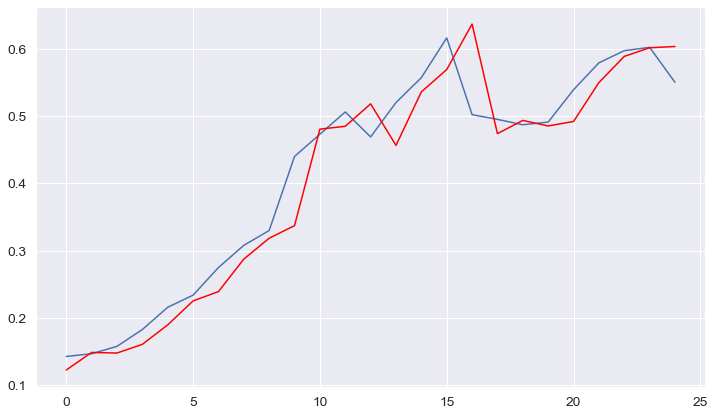

-----------------------------------------------------------------------
Central African Republic
predicted=0.219516, expected=0.231000
predicted=0.229684, expected=0.234000
predicted=0.233638, expected=0.245000
predicted=0.243684, expected=0.242000
predicted=0.242354, expected=0.224000
predicted=0.226094, expected=0.220000
predicted=0.220453, expected=0.216000
predicted=0.216450, expected=0.227000
predicted=0.225746, expected=0.231000
predicted=0.230543, expected=0.165000
predicted=0.173058, expected=0.161000
predicted=0.161403, expected=0.169000
predicted=0.168200, expected=0.187000
predicted=0.185243, expected=0.191000
predicted=0.190621, expected=0.117000
predicted=0.124457, expected=0.125000
predicted=0.124173, expected=0.180000
predicted=0.174965, expected=0.198000
predicted=0.196836, expected=0.216000
predicted=0.214952, expected=0.220000
predicted=0.219775, expected=0.210000
predicted=0.210571, expected=0.188000
Test RMSE: 0.027


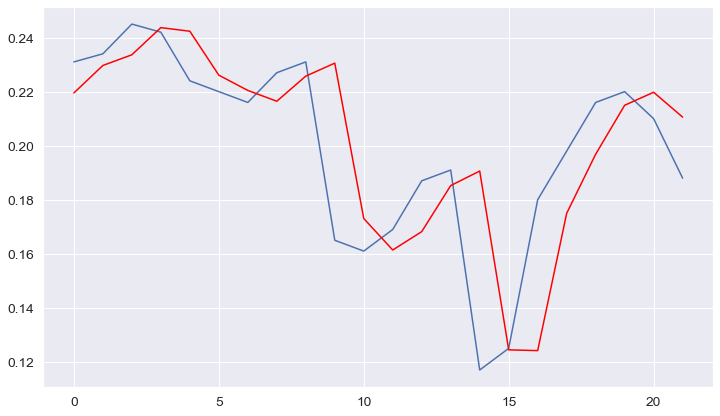

-----------------------------------------------------------------------
Chad
predicted=0.462120, expected=0.476000
predicted=0.476173, expected=0.487000
predicted=0.487151, expected=0.502000
predicted=0.502229, expected=0.509000
predicted=0.509114, expected=0.744000
predicted=0.751151, expected=0.747000
predicted=0.747075, expected=0.766000
predicted=0.766475, expected=0.791000
predicted=0.791709, expected=0.854000
predicted=0.856385, expected=0.927000
predicted=0.931605, expected=0.942000
predicted=0.943011, expected=0.997000
predicted=1.000955, expected=1.118000
predicted=1.131029, expected=0.614000
predicted=0.719099, expected=0.656000
predicted=0.650183, expected=0.990000
predicted=0.954356, expected=0.697000
predicted=0.772381, expected=1.013000
predicted=0.898019, expected=1.036000
predicted=1.028951, expected=1.044000
predicted=1.041551, expected=1.005000
predicted=1.016955, expected=0.912000
Test RMSE: 0.169


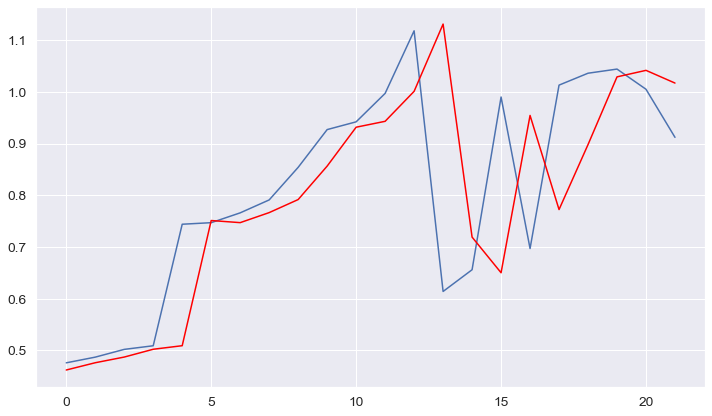

-----------------------------------------------------------------------
Chile
predicted=22.578655, expected=22.838000
predicted=22.763108, expected=24.725000
predicted=25.516713, expected=25.094000
predicted=25.244294, expected=24.339000
predicted=24.035383, expected=20.470000
predicted=18.759741, expected=20.668000
predicted=20.737383, expected=21.997000
predicted=22.466757, expected=21.284000
predicted=21.045595, expected=22.013000
predicted=22.250680, expected=22.399000
predicted=22.525365, expected=26.587000
predicted=28.033302, expected=32.003000
predicted=34.753957, expected=32.891000
predicted=33.273850, expected=30.950000
predicted=30.143825, expected=31.978000
predicted=32.377942, expected=33.953000
predicted=34.744650, expected=37.517000
predicted=39.083194, expected=41.072000
predicted=42.797560, expected=47.611000
predicted=51.446334, expected=55.433000
predicted=60.971275, expected=56.787000
predicted=57.583990, expected=60.890000
predicted=63.370524, expected=58.096000
pr

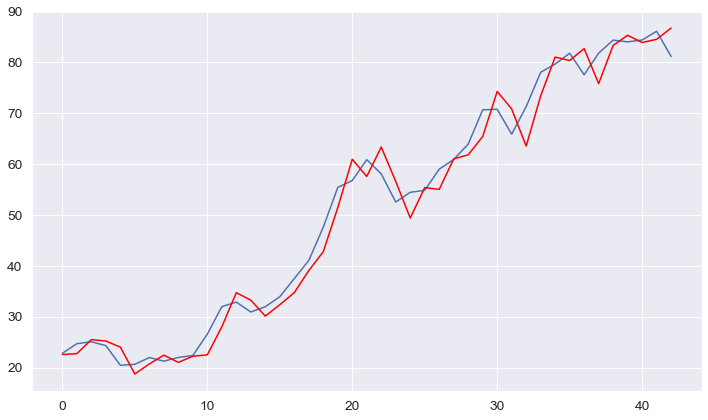

-----------------------------------------------------------------------
China
predicted=1576.218765, expected=1525.661000
predicted=1542.985400, expected=1494.496000
predicted=1478.220201, expected=1476.488000
predicted=1467.079218, expected=1606.585000
predicted=1673.561267, expected=1694.217000
predicted=1739.985266, expected=1844.828000
predicted=1927.186103, expected=1998.083000
predicted=2086.022067, expected=2104.213000
predicted=2165.824214, expected=2257.739000
predicted=2350.317341, expected=2425.894000
predicted=2531.565365, expected=2463.654000
predicted=2486.491992, expected=2484.855000
predicted=2497.676594, expected=2606.096000
predicted=2679.969958, expected=2730.788000
predicted=2808.300083, expected=2921.651000
predicted=3045.465435, expected=3100.002000
predicted=3219.038675, expected=3357.909000
predicted=3540.749182, expected=3503.234000
predicted=3604.139212, expected=3510.169000
predicted=3514.844097, expected=3360.455000
predicted=3259.818463, expected=3350.34000

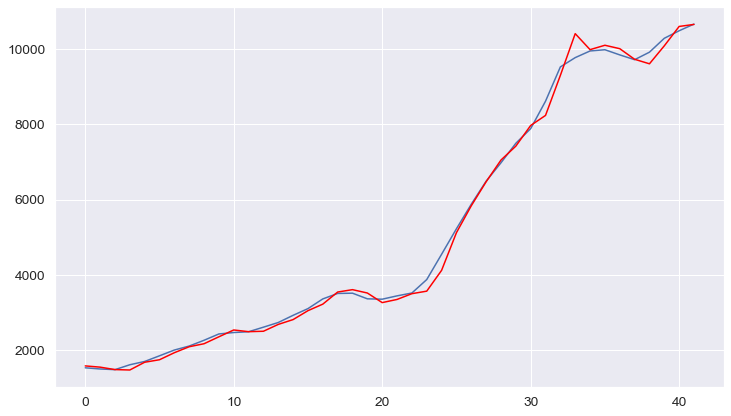

-----------------------------------------------------------------------
Christmas Island
predicted=0.101000, expected=0.092000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.092179, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
predicted=0.092000, expected=0.092000
Test RMSE: 0.002


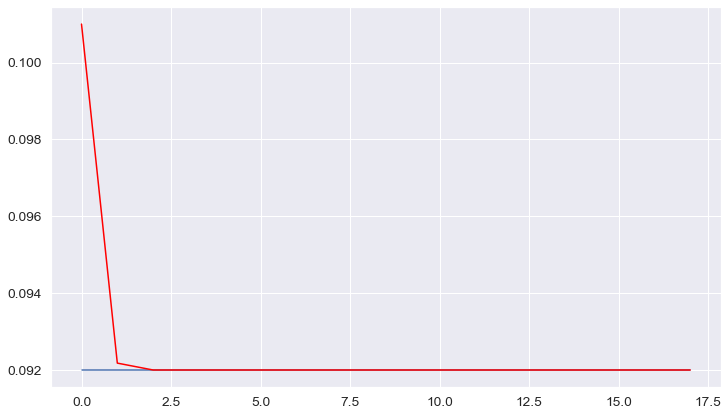

-----------------------------------------------------------------------
Colombia
predicted=49.009904, expected=50.124000
predicted=50.653186, expected=52.017000
predicted=52.781137, expected=52.793000
predicted=53.106464, expected=56.898000
predicted=58.660890, expected=56.654000
predicted=56.564872, expected=61.495000
predicted=63.213075, expected=63.338000
predicted=63.999532, expected=66.791000
predicted=68.143618, expected=58.775000
predicted=57.194156, expected=59.771000
predicted=59.878877, expected=64.497000
predicted=65.101428, expected=65.158000
predicted=65.243243, expected=54.761000
predicted=53.706932, expected=56.259000
predicted=56.302175, expected=55.939000
predicted=55.930249, expected=55.430000
predicted=55.415857, expected=57.094000
predicted=57.136376, expected=54.569000
predicted=54.533800, expected=60.060000
predicted=59.933599, expected=62.005000
predicted=62.014486, expected=60.179000
predicted=60.185871, expected=66.650000
predicted=66.441499, expected=72.557000

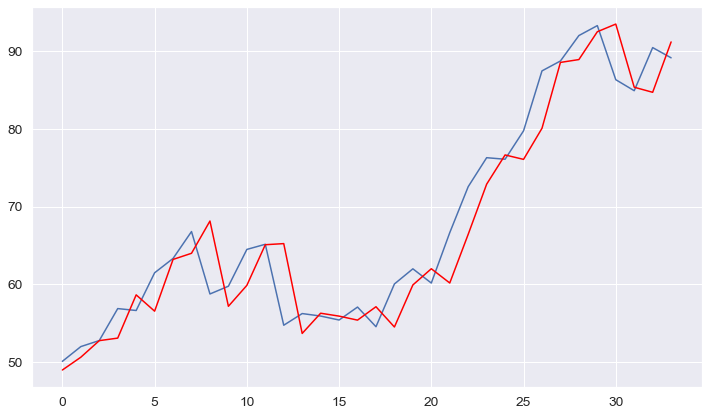

-----------------------------------------------------------------------
Comoros
predicted=0.091971, expected=0.095000
predicted=0.095039, expected=0.103000
predicted=0.103235, expected=0.106000
predicted=0.106132, expected=0.106000
predicted=0.106000, expected=0.136000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.137309, expected=0.147000
predicted=0.148793, expected=0.143000
predicted=0.142448, expected=0.165000
predicted=0.167267, expected=0.106000
predicted=0.125943, expected=0.110000
predicted=0.109224, expected=0.136000
predicted=0.131378, expected=0.161000
predicted=0.159219, expected=0.143000
predicted=0.145212, expected=0.154000
predicted=0.152436, expected=0.183000
predicted=0.180051, expected=0.161000
predicted=0.164567, expected=0.180000
predicted=0.176313, expected=0.216000
predicted=0.211648, expected=0.267000
predicted=0.269803, expected=0.293000
predicted=0.296645, expected=0.306000
predicted=0.308040, expected=0.258000
Test RMSE: 0.028


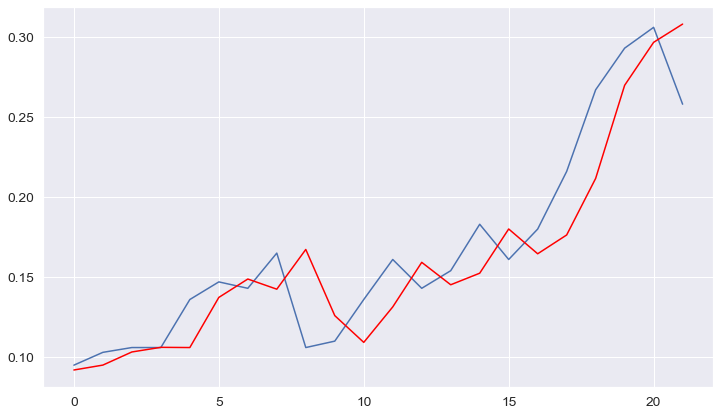

-----------------------------------------------------------------------
Congo
predicted=0.988916, expected=0.363000
predicted=0.360987, expected=0.565000
predicted=0.514205, expected=0.766000
predicted=0.717035, expected=0.575000
predicted=0.622395, expected=0.916000
predicted=0.828420, expected=0.949000
predicted=0.940726, expected=0.996000
predicted=0.984224, expected=1.127000
predicted=1.094297, expected=1.211000
predicted=1.190216, expected=1.330000
predicted=1.300758, expected=1.724000
predicted=1.630191, expected=1.962000
predicted=1.909920, expected=2.240000
predicted=2.182360, expected=2.945000
predicted=2.820622, expected=3.208000
predicted=3.171297, expected=3.102000
predicted=3.117056, expected=3.452000
predicted=3.400624, expected=3.702000
predicted=3.668766, expected=3.565000
predicted=3.583681, expected=3.623000
predicted=3.615048, expected=3.291000
predicted=3.337330, expected=3.117000
Test RMSE: 0.315


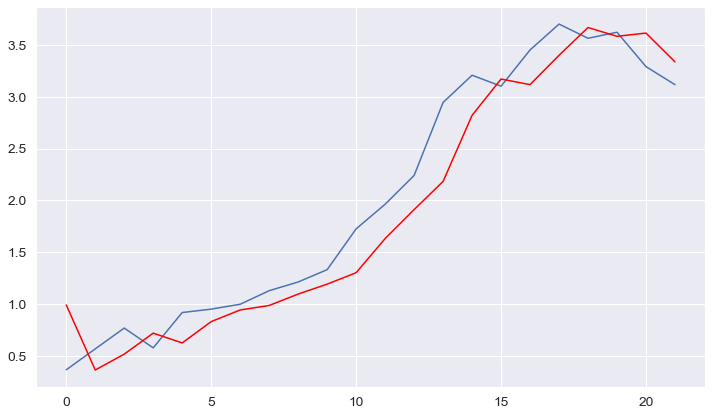

-----------------------------------------------------------------------
Cook Islands
predicted=0.027162, expected=0.029000
predicted=0.028664, expected=0.051000
predicted=0.048990, expected=0.062000
predicted=0.061833, expected=0.055000
predicted=0.055242, expected=0.051000
predicted=0.051108, expected=0.051000
predicted=0.051000, expected=0.048000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.048081, expected=0.059000
predicted=0.058613, expected=0.066000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.065893, expected=0.070000
predicted=0.069967, expected=0.070000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.070000, expected=0.070000
predicted=0.070000, expected=0.070000
predicted=0.070000, expected=0.070000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.070000, expected=0.077000
predicted=0.076942, expected=0.077000
predicted=0.077000, expected=0.079000
predicted=0.078984, expected=0.079000
Test RMSE: 0.007


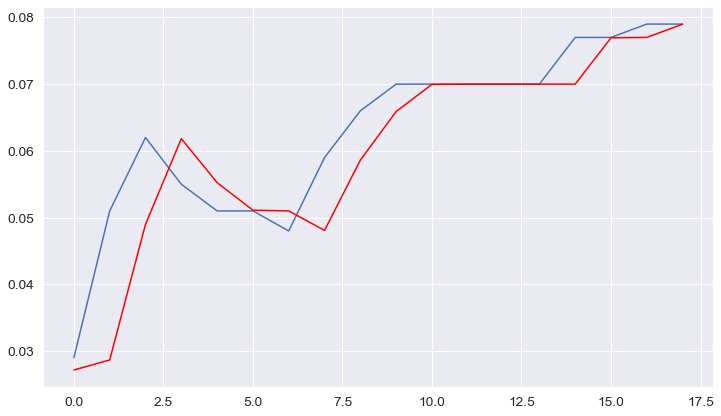

-----------------------------------------------------------------------
Costa Rica
predicted=4.746247, expected=4.686000
predicted=4.669436, expected=4.916000
predicted=4.947306, expected=5.234000
predicted=5.283066, expected=5.438000
predicted=5.472182, expected=5.394000
predicted=5.386811, expected=5.667000
predicted=5.710711, expected=6.245000
predicted=6.359347, expected=6.583000
predicted=6.660315, expected=6.842000
predicted=6.904953, expected=6.723000
predicted=6.695354, expected=7.007000
predicted=7.070568, expected=7.961000
predicted=8.227759, expected=7.990000
predicted=7.996890, expected=7.748000
predicted=7.690824, expected=7.493000
predicted=7.430502, expected=7.311000
predicted=7.265377, expected=7.260000
predicted=7.247203, expected=7.632000
predicted=7.724005, expected=7.748000
predicted=7.776879, expected=7.406000
predicted=7.323452, expected=7.923000
predicted=8.029467, expected=8.312000
predicted=8.401452, expected=8.222000
predicted=8.202309, expected=8.818000
predi

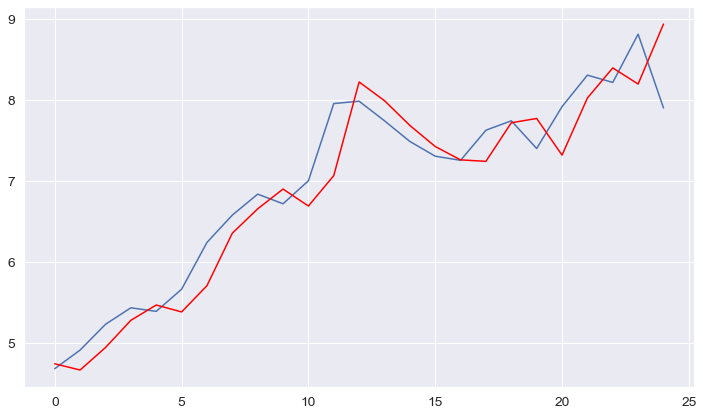

-----------------------------------------------------------------------
Cote d'Ivoire
predicted=6.625434, expected=5.940000
predicted=5.997737, expected=6.463000
predicted=6.412416, expected=7.398000
predicted=7.318795, expected=6.958000
predicted=6.998680, expected=5.133000
predicted=5.267484, expected=7.335000
predicted=6.997814, expected=7.497000
predicted=7.475590, expected=6.811000
predicted=6.903098, expected=6.537000
predicted=6.572494, expected=6.592000
predicted=6.584867, expected=5.514000
predicted=5.655005, expected=6.064000
predicted=5.987542, expected=6.342000
predicted=6.304341, expected=8.339000
predicted=8.089549, expected=9.526000
predicted=9.436120, expected=9.739000
predicted=9.724149, expected=9.405000
predicted=9.428674, expected=11.798000
predicted=11.597022, expected=11.860000
predicted=11.855386, expected=10.252000
predicted=10.374062, expected=10.480000
predicted=10.462119, expected=10.071000
Test RMSE: 1.100


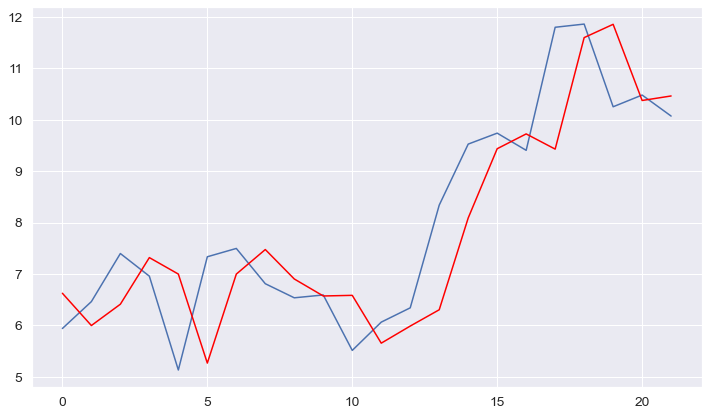

-----------------------------------------------------------------------
Croatia
predicted=13.370209, expected=13.036000
predicted=13.036541, expected=13.551000
predicted=13.606748, expected=13.976000
predicted=14.025532, expected=13.544000
predicted=13.497476, expected=15.251000
predicted=15.379172, expected=16.673000
predicted=16.899295, expected=16.358000
predicted=16.316441, expected=17.557000
predicted=17.698617, expected=16.126000
predicted=16.047486, expected=17.414000
predicted=17.405646, expected=18.425000
predicted=18.458021, expected=18.854000
predicted=18.872978, expected=19.784000
predicted=19.835586, expected=19.313000
predicted=19.293296, expected=20.024000
predicted=20.046921, expected=19.980000
predicted=19.978639, expected=22.978000
predicted=23.059675, expected=16.986000
predicted=19.204829, expected=16.371000
predicted=16.471033, expected=16.808000
predicted=16.735812, expected=16.053000
predicted=16.180461, expected=16.816000
predicted=16.682765, expected=17.344000


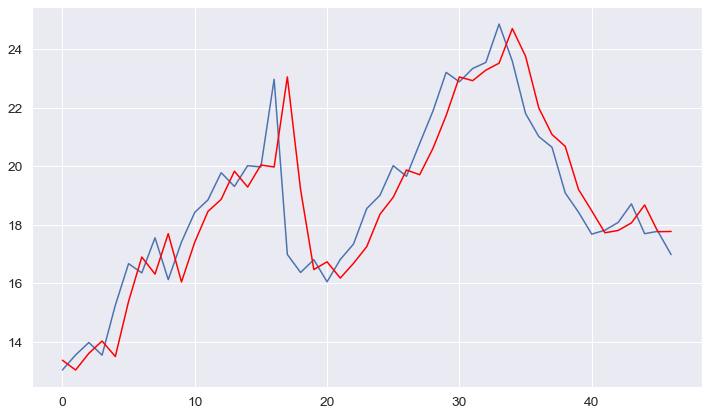

-----------------------------------------------------------------------
Cuba
predicted=19.048948, expected=19.823000
predicted=19.655973, expected=21.382000
predicted=21.712940, expected=22.835000
predicted=23.152381, expected=23.333000
predicted=23.442267, expected=24.809000
predicted=25.136391, expected=24.294000
predicted=24.181938, expected=24.467000
predicted=24.504568, expected=25.775000
predicted=26.060080, expected=25.216000
predicted=25.096244, expected=25.524000
predicted=25.589749, expected=25.943000
predicted=26.032623, expected=25.221000
predicted=25.067371, expected=24.442000
predicted=24.275008, expected=24.693000
predicted=24.746541, expected=24.240000
predicted=24.143546, expected=28.108000
predicted=28.907501, expected=28.396000
predicted=28.453699, expected=34.200000
predicted=35.392162, expected=29.431000
predicted=28.932486, expected=29.742000
predicted=29.771237, expected=28.024000
predicted=27.865027, expected=27.442000
predicted=27.386990, expected=29.311000
pre

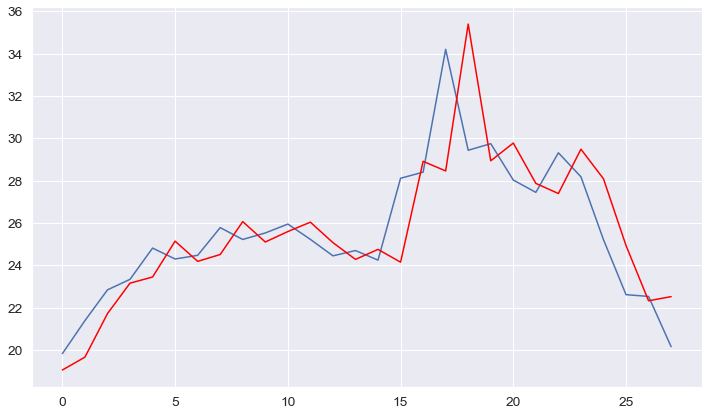

-----------------------------------------------------------------------
Curacao
predicted=2.403734, expected=2.268000
predicted=2.280285, expected=4.318000
predicted=3.598085, expected=4.624000
predicted=4.517769, expected=3.690000
predicted=4.014776, expected=3.040000
predicted=3.264916, expected=4.693000
predicted=4.117953, expected=4.499000
predicted=4.566268, expected=4.453000
predicted=4.468951, expected=4.165000
predicted=4.264881, expected=4.359000
predicted=4.291696, expected=0.241000
predicted=1.675472, expected=1.803000
predicted=1.257256, expected=4.784000
predicted=3.773236, expected=4.871000
predicted=4.842019, expected=4.696000
predicted=4.754310, expected=4.699000
predicted=4.698000, expected=4.931000
predicted=4.853676, expected=4.887000
predicted=4.901667, expected=5.093000
predicted=5.024320, expected=5.734000
predicted=5.520435, expected=5.515000
predicted=5.587977, expected=5.643000
predicted=5.600338, expected=3.887000
predicted=4.473022, expected=4.959000
predicte

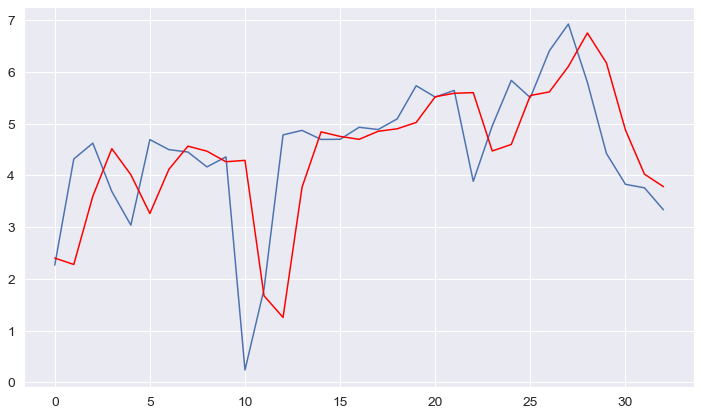

-----------------------------------------------------------------------
Cyprus
predicted=5.818083, expected=6.222000
predicted=6.360973, expected=6.310000
predicted=6.344369, expected=6.607000
predicted=6.725532, expected=6.874000
predicted=6.984832, expected=7.120000
predicted=7.225261, expected=6.994000
predicted=6.942556, expected=7.184000
predicted=7.259585, expected=7.574000
predicted=7.736969, expected=7.801000
predicted=7.897708, expected=7.955000
predicted=8.021262, expected=8.183000
predicted=8.282898, expected=8.502000
predicted=8.646683, expected=8.714000
predicted=8.811540, expected=8.469000
predicted=8.361576, expected=8.100000
predicted=7.931372, expected=7.786000
predicted=7.637792, expected=7.262000
predicted=6.998083, expected=6.581000
predicted=6.200950, expected=6.950000
predicted=7.113273, expected=6.970000
predicted=6.978620, expected=7.373000
predicted=7.547310, expected=7.523000
predicted=7.587583, expected=7.340000
predicted=7.262638, expected=7.340000
predicted

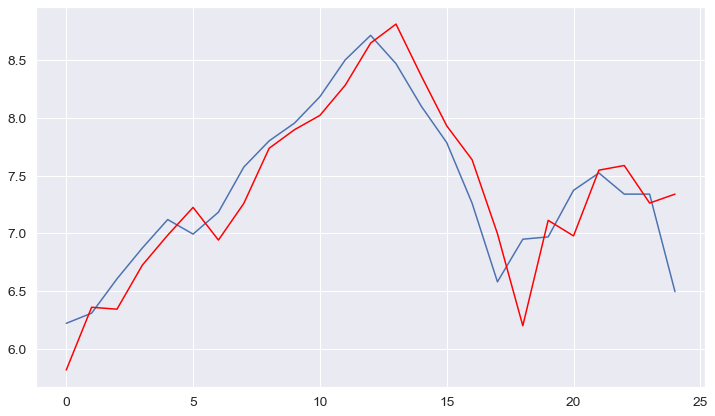

-----------------------------------------------------------------------
Czechia
predicted=121.533063, expected=121.522000
predicted=121.380757, expected=121.279000
predicted=121.228365, expected=126.880000
predicted=128.043325, expected=134.694000
predicted=136.455116, expected=154.420000
predicted=160.136198, expected=159.347000
predicted=160.744914, expected=160.825000
predicted=161.244605, expected=161.404000
predicted=161.568444, expected=163.145000
predicted=163.640115, expected=170.746000
predicted=172.943692, expected=177.452000
predicted=179.477716, expected=182.811000
predicted=184.474354, expected=184.394000
predicted=184.885125, expected=179.514000
predicted=178.015255, expected=181.592000
predicted=182.217013, expected=179.596000
predicted=178.999574, expected=177.937000
predicted=177.439965, expected=178.172000
predicted=178.242307, expected=184.302000
predicted=186.139029, expected=181.855000
predicted=181.144668, expected=183.149000
predicted=183.522384, expected=180.968

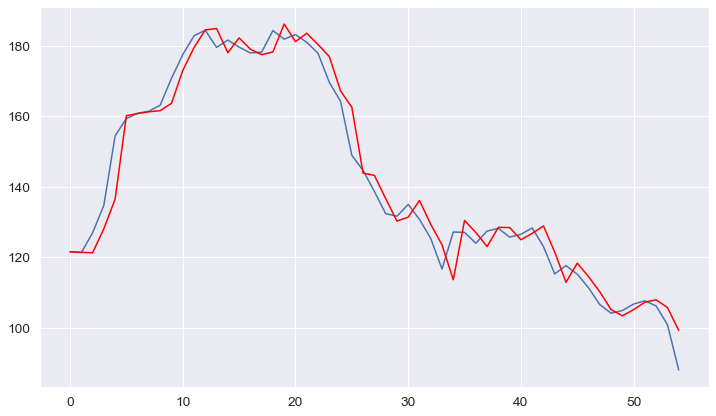

-----------------------------------------------------------------------
Democratic Republic of Congo
predicted=3.641705, expected=3.346000
predicted=3.367058, expected=3.816000
predicted=3.770777, expected=3.978000
predicted=3.964597, expected=4.352000
predicted=4.324301, expected=4.249000
predicted=4.257023, expected=3.133000
predicted=3.202293, expected=2.808000
predicted=2.811694, expected=2.662000
predicted=2.662839, expected=1.698000
predicted=1.687894, expected=2.104000
predicted=2.091451, expected=2.311000
predicted=2.306469, expected=1.875000
predicted=1.888468, expected=1.656000
predicted=1.660570, expected=1.317000
predicted=1.321614, expected=0.893000
predicted=0.892714, expected=0.770000
predicted=0.769299, expected=0.850000
predicted=0.850380, expected=1.037000
predicted=1.038156, expected=1.149000
predicted=1.149916, expected=1.445000
predicted=1.448359, expected=1.552000
predicted=1.553514, expected=1.697000
predicted=1.699261, expected=1.811000
predicted=1.812950, expec

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.965453, expected=2.440000
predicted=2.451818, expected=2.356000
predicted=2.354274, expected=3.538000
predicted=3.551689, expected=4.631000
predicted=4.756063, expected=2.793000
predicted=2.872751, expected=2.014000
predicted=1.975479, expected=2.474000
predicted=2.486602, expected=2.780000
predicted=2.790701, expected=2.689000
predicted=2.685975, expected=2.477000
Test RMSE: 0.578


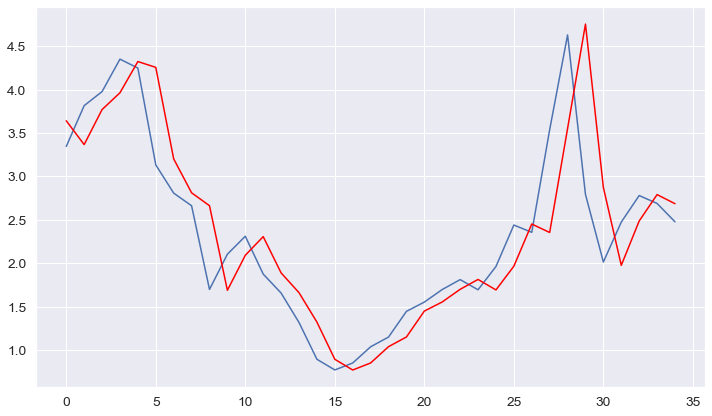

-----------------------------------------------------------------------
Denmark
predicted=26.211791, expected=29.750000
predicted=28.831989, expected=31.702000
predicted=31.309679, expected=36.890000
predicted=36.088051, expected=40.668000
predicted=40.426006, expected=43.147000
predicted=43.080243, expected=44.293000
predicted=44.274311, expected=50.078000
predicted=50.118940, expected=49.026000
predicted=49.039475, expected=53.273000
predicted=53.159451, expected=59.343000
predicted=59.652869, expected=62.039000
predicted=62.280883, expected=57.010000
predicted=56.746067, expected=59.594000
predicted=59.638692, expected=59.222000
predicted=59.216533, expected=55.042000
predicted=54.964918, expected=55.745000
predicted=55.752654, expected=60.103000
predicted=60.181259, expected=61.818000
predicted=61.875940, expected=61.096000
predicted=61.073733, expected=62.978000
predicted=63.030351, expected=60.348000
predicted=60.303874, expected=51.773000
predicted=51.215985, expected=53.684000


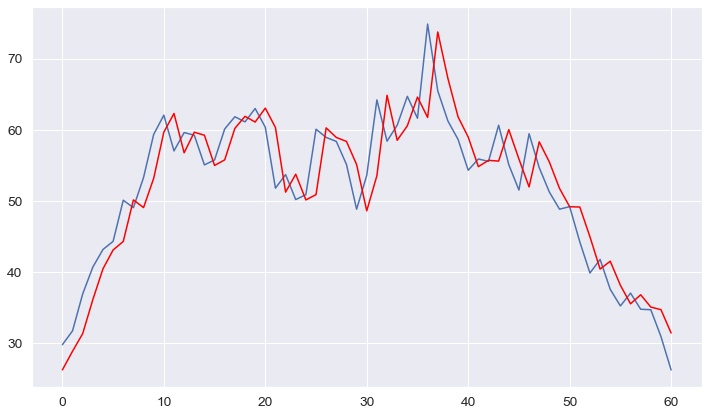

-----------------------------------------------------------------------
Djibouti
predicted=0.307034, expected=0.293000
predicted=0.297043, expected=0.330000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.321341, expected=0.385000
predicted=0.374173, expected=0.385000
predicted=0.385000, expected=0.366000
predicted=0.369574, expected=0.366000
predicted=0.366000, expected=0.399000
predicted=0.392821, expected=0.421000
predicted=0.417183, expected=0.407000
predicted=0.409477, expected=0.414000
predicted=0.412755, expected=0.410000
predicted=0.410713, expected=0.462000
predicted=0.452585, expected=0.498000
predicted=0.492671, expected=0.458000
predicted=0.464610, expected=0.517000
predicted=0.505595, expected=0.473000
predicted=0.482584, expected=0.487000
predicted=0.483915, expected=0.557000
predicted=0.542481, expected=0.388000
predicted=0.444275, expected=0.447000
predicted=0.427114, expected=0.400000
predicted=0.416480, expected=0.403000
predicted=0.401964, expected=0.389000
predicted=0.393842, expected=0.402000
predicted=0.397492, expected=0.351000
Test RMSE: 0.045


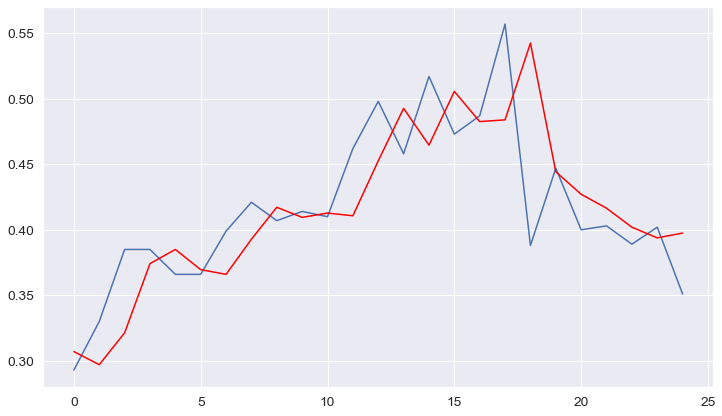

-----------------------------------------------------------------------
Dominica
predicted=0.073064, expected=0.081000
predicted=0.080201, expected=0.077000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.077535, expected=0.081000
predicted=0.080393, expected=0.103000
predicted=0.102189, expected=0.110000
predicted=0.110688, expected=0.103000
predicted=0.102597, expected=0.117000
predicted=0.116775, expected=0.143000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.148682, expected=0.143000
predicted=0.143000, expected=0.143000
predicted=0.143000, expected=0.183000
predicted=0.189104, expected=0.165000
predicted=0.166771, expected=0.161000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.161294, expected=0.172000
predicted=0.171079, expected=0.154000
predicted=0.156293, expected=0.165000
predicted=0.163226, expected=0.169000
predicted=0.168408, expected=0.176000
predicted=0.175009, expected=0.176000
predicted=0.176000, expected=0.180000
predicted=0.179440, expected=0.161000
predicted=0.163952, expected=0.161000
predicted=0.161000, expected=0.157000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.157578, expected=0.139000
Test RMSE: 0.015


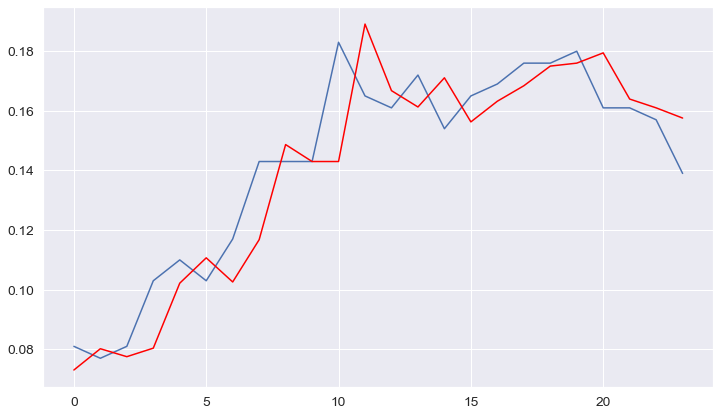

-----------------------------------------------------------------------
Dominican Republic
predicted=11.913405, expected=15.107000
predicted=16.101822, expected=16.484000
predicted=16.957386, expected=17.266000
predicted=17.545574, expected=17.788000
predicted=17.977794, expected=17.821000
predicted=17.832918, expected=18.992000
predicted=19.416085, expected=19.145000
predicted=19.198975, expected=20.949000
predicted=21.598808, expected=21.345000
predicted=21.482753, expected=17.333000
predicted=16.126530, expected=17.941000
predicted=18.040636, expected=19.112000
predicted=19.318125, expected=19.993000
predicted=20.160775, expected=20.332000
predicted=20.397493, expected=19.781000
predicted=19.676597, expected=20.553000
predicted=20.692636, expected=21.318000
predicted=21.462902, expected=21.255000
predicted=21.243239, expected=21.267000
predicted=21.269240, expected=21.801000
predicted=21.900771, expected=23.495000
predicted=23.836407, expected=24.645000
predicted=24.902845, expected

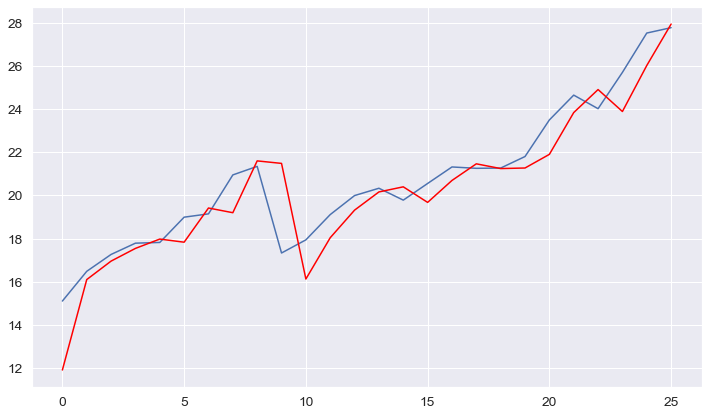

-----------------------------------------------------------------------
EU-27
predicted=3806.840962, expected=3566.880000
predicted=3402.992503, expected=3646.500000
predicted=3660.547806, expected=3274.400000
predicted=3283.281267, expected=3213.210000
predicted=3209.480483, expected=3136.340000
predicted=3130.517751, expected=2990.490000
predicted=2974.568712, expected=3046.380000
predicted=3050.785057, expected=3387.970000
predicted=3431.696597, expected=3401.950000
predicted=3403.443345, expected=3333.160000
Test RMSE: 205.068


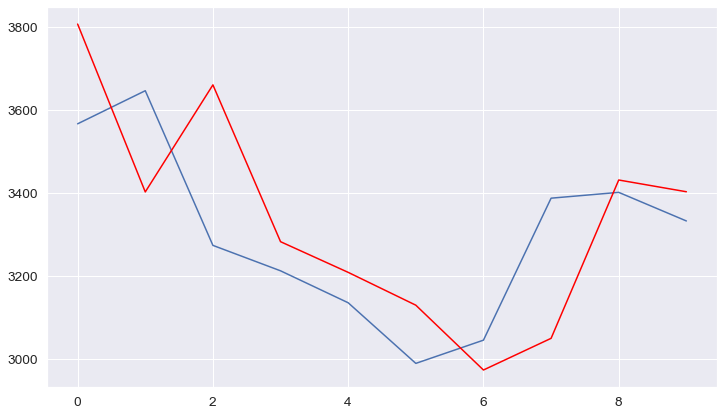

-----------------------------------------------------------------------
Ecuador
predicted=22.185212, expected=19.353000
predicted=18.488211, expected=15.194000
predicted=12.680211, expected=15.022000
predicted=14.945183, expected=17.169000
predicted=18.113401, expected=20.154000
predicted=21.662489, expected=16.458000
predicted=15.358964, expected=16.157000
predicted=16.077472, expected=21.960000
predicted=23.370174, expected=24.089000
predicted=24.678545, expected=13.540000
predicted=12.591929, expected=22.686000
predicted=19.468726, expected=24.025000
predicted=23.725520, expected=18.206000
predicted=19.637409, expected=22.313000
predicted=21.126000, expected=21.364000
predicted=21.635869, expected=20.562000
predicted=20.789627, expected=22.940000
predicted=22.254289, expected=24.753000
predicted=24.258172, expected=26.747000
predicted=26.225938, expected=28.786000
predicted=28.279711, expected=29.970000
predicted=29.686278, expected=28.895000
predicted=29.155158, expected=33.686000


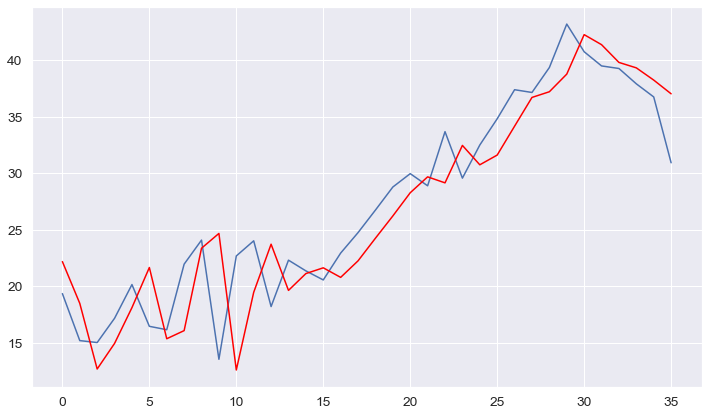

-----------------------------------------------------------------------
Egypt
predicted=58.573981, expected=56.980000
predicted=57.176531, expected=63.704000
predicted=66.187064, expected=63.807000
predicted=63.840224, expected=74.393000
predicted=77.825229, expected=74.614000
predicted=74.669170, expected=74.309000
predicted=74.232901, expected=71.905000
predicted=71.301442, expected=75.218000
predicted=75.981933, expected=77.296000
predicted=77.794367, expected=79.940000
predicted=80.598860, expected=92.278000
predicted=96.125822, expected=84.556000
predicted=83.878407, expected=94.890000
predicted=94.537023, expected=93.569000
predicted=93.630534, expected=107.513000
predicted=106.549022, expected=121.466000
predicted=123.389889, expected=124.496000
predicted=124.952762, expected=140.350000
predicted=143.344841, expected=124.294000
predicted=124.574331, expected=125.782000
predicted=125.739279, expected=146.463000
predicted=146.239347, expected=149.143000
predicted=149.188595, expec

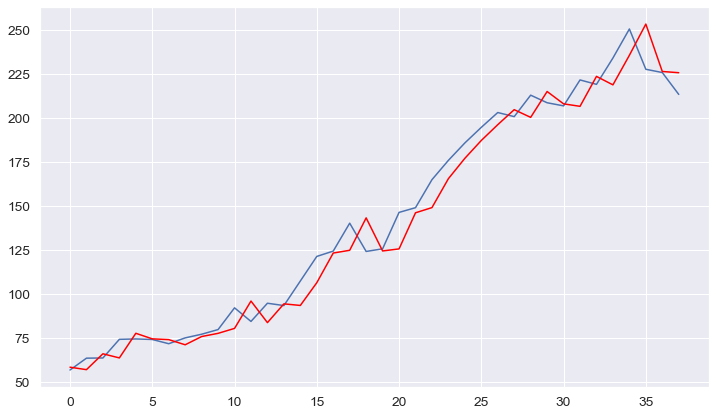

-----------------------------------------------------------------------
El Salvador
predicted=5.147380, expected=4.414000
predicted=4.309640, expected=5.416000
predicted=5.386826, expected=5.731000
predicted=5.748129, expected=5.588000
predicted=5.581928, expected=5.671000
predicted=5.674277, expected=5.857000
predicted=5.865009, expected=6.070000
predicted=6.081067, expected=6.435000
predicted=6.460311, expected=6.254000
predicted=6.244498, expected=6.298000
predicted=6.300216, expected=6.718000
predicted=6.740859, expected=6.846000
predicted=6.854177, expected=6.405000
predicted=6.382241, expected=6.312000
predicted=6.306610, expected=6.319000
predicted=6.319404, expected=6.499000
predicted=6.509441, expected=6.472000
predicted=6.470470, expected=6.094000
predicted=6.071809, expected=6.151000
predicted=6.154010, expected=6.675000
predicted=6.705723, expected=6.646000
predicted=6.644469, expected=6.016000
predicted=5.980623, expected=6.371000
predicted=6.375810, expected=6.853000
pred

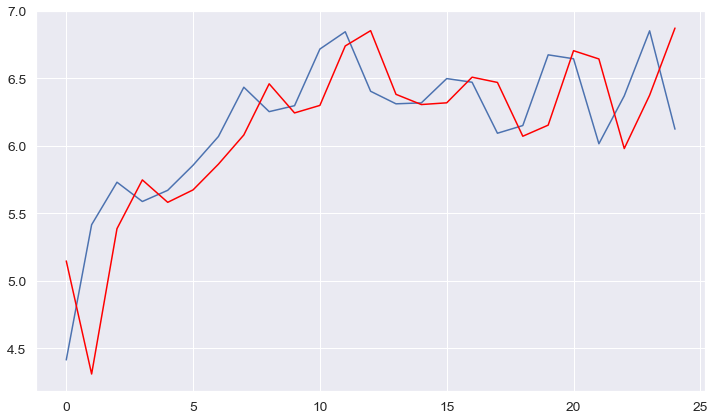

-----------------------------------------------------------------------
Equatorial Guinea
predicted=0.082281, expected=0.128000
predicted=0.118138, expected=0.304000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.364257, expected=0.264000
predicted=0.265749, expected=0.407000
predicted=0.383331, expected=0.616000
predicted=0.683137, expected=2.964000
predicted=5.060624, expected=7.782000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=12.519616, expected=7.962000
predicted=8.039773, expected=9.962000
predicted=10.847243, expected=8.039000
predicted=7.511082, expected=7.108000
predicted=6.833028, expected=5.584000
predicted=5.087786, expected=6.119000
predicted=6.272454, expected=5.408000
predicted=5.212125, expected=6.804000
predicted=7.150078, expected=9.464000
predicted=10.320045, expected=9.175000
predicted=9.099424, expected=11.578000
predicted=12.171289, expected=11.179000
predicted=11.097359, expected=10.834000
predicted=10.762752, expected=11.388000
predicted=11.500314, expected=12.285000
predicted=12.473709, expected=11.212000
predicted=11.007340, expected=10.270000
predicted=10.077656, expected=10.265000
Test RMSE: 1.652


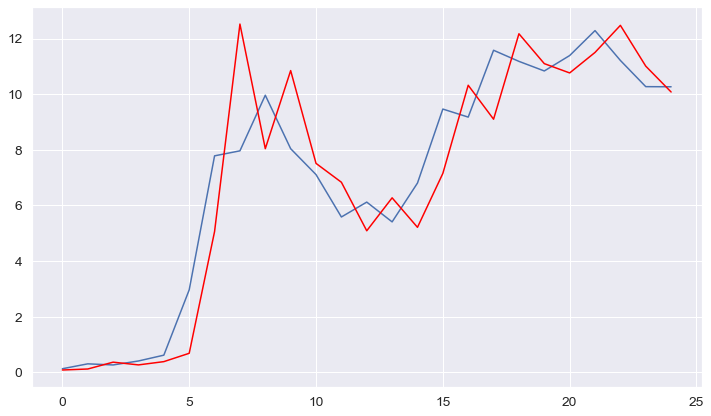

-----------------------------------------------------------------------
Eritrea
predicted=0.691995, expected=0.692000
predicted=0.692000, expected=0.744000
predicted=0.744003, expected=0.823000
predicted=0.823449, expected=0.898000
predicted=0.899026, expected=0.808000
predicted=0.807597, expected=0.586000
predicted=0.579219, expected=0.615000
predicted=0.615603, expected=0.604000
predicted=0.603772, expected=0.626000
predicted=0.626448, expected=0.601000
predicted=0.600508, expected=0.710000
predicted=0.711773, expected=0.769000
predicted=0.770412, expected=0.769000
predicted=0.769000, expected=0.549000
predicted=0.543756, expected=0.563000
predicted=0.563265, expected=0.409000
predicted=0.406468, expected=0.497000
predicted=0.497066, expected=0.497000
predicted=0.497000, expected=0.556000
predicted=0.556044, expected=0.605000
predicted=0.605194, expected=0.621000
predicted=0.621077, expected=0.631000
predicted=0.631050, expected=0.634000
predicted=0.634015, expected=0.645000
predicte

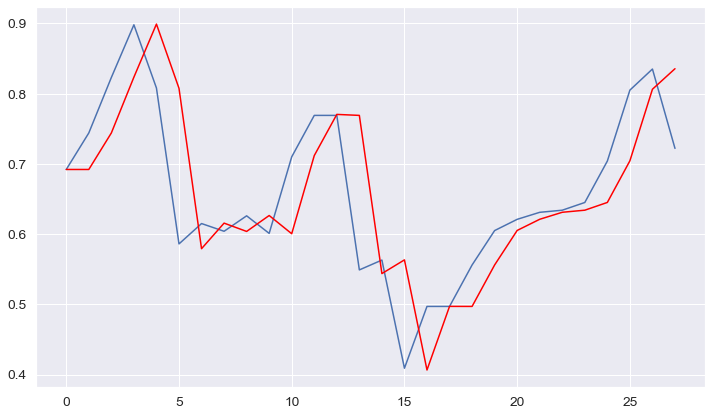

-----------------------------------------------------------------------
Estonia
predicted=11.020802, expected=11.408000
predicted=11.947116, expected=12.485000
predicted=13.105047, expected=13.328000
predicted=13.826594, expected=14.014000
predicted=14.426524, expected=14.594000
predicted=14.946839, expected=15.050000
predicted=15.329040, expected=15.795000
predicted=16.260132, expected=16.936000
predicted=17.680752, expected=18.009000
predicted=18.730529, expected=19.104000
predicted=19.862033, expected=20.174000
predicted=20.931771, expected=21.092000
predicted=21.749108, expected=21.681000
predicted=22.101061, expected=22.577000
predicted=23.226487, expected=23.751000
predicted=24.624229, expected=25.207000
predicted=26.327815, expected=26.528000
predicted=27.558458, expected=27.655000
predicted=28.538916, expected=28.715000
predicted=29.553062, expected=30.192000
predicted=31.390007, expected=31.353000
predicted=32.292938, expected=32.419000
predicted=33.286336, expected=33.527000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=15.246866, expected=19.404000
predicted=15.711923, expected=20.036000
predicted=20.433337, expected=18.213000
predicted=17.081078, expected=19.134000
predicted=19.687314, expected=18.645000
predicted=18.353729, expected=16.917000
predicted=15.881328, expected=15.912000
predicted=15.309914, expected=15.485000
predicted=15.229572, expected=15.866000
predicted=16.093376, expected=15.349000
predicted=15.041222, expected=17.235000
predicted=18.346434, expected=17.368000
predicted=17.445125, expected=17.156000
predicted=17.033103, expected=16.502000
predicted=16.122490, expected=20.022000
predicted=22.017667, expected=17.875000
predicted=16.808453, expected=14.489000
predicted=12.728151, expected=18.995000
predicted=20.910272, expected=19.091000
predicted=19.128588, expected=17.846000
predicted=17.359162, expected=19.738000
predicted=20.455005, expected=18.885000
predicted=18.571893, expected=15.859000
predicted=14.720499, expected=17.567000
predicted=18.152885, expected=18.788000


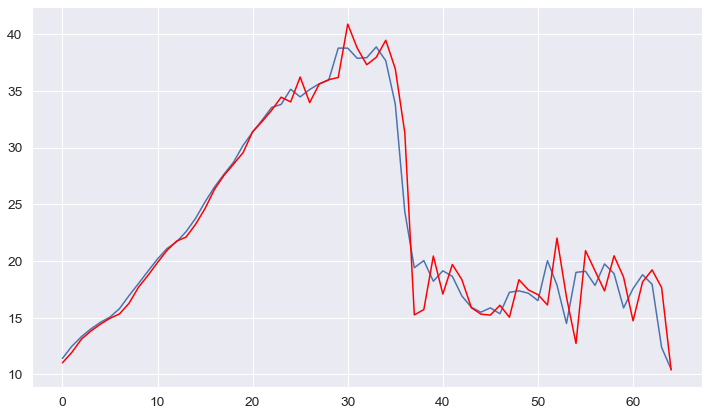

-----------------------------------------------------------------------
Eswatini
predicted=1.065303, expected=0.788000
predicted=0.831201, expected=1.143000
predicted=1.039662, expected=1.161000
predicted=1.156774, expected=1.238000
predicted=1.220063, expected=1.209000
predicted=1.215789, expected=1.096000
predicted=1.121947, expected=1.081000
predicted=1.084357, expected=1.004000
predicted=1.021117, expected=1.000000
predicted=1.000881, expected=1.015000
predicted=1.011693, expected=1.015000
predicted=1.015000, expected=1.041000
predicted=1.035267, expected=1.022000
predicted=1.026199, expected=1.059000
predicted=1.050791, expected=0.997000
predicted=1.010915, expected=1.008000
predicted=1.005533, expected=1.169000
predicted=1.133268, expected=1.400000
predicted=1.360887, expected=0.769000
predicted=0.973184, expected=0.868000
predicted=0.841092, expected=1.055000
predicted=1.007261, expected=0.986000
predicted=1.003825, expected=1.033000
predicted=1.020784, expected=1.013000
predict

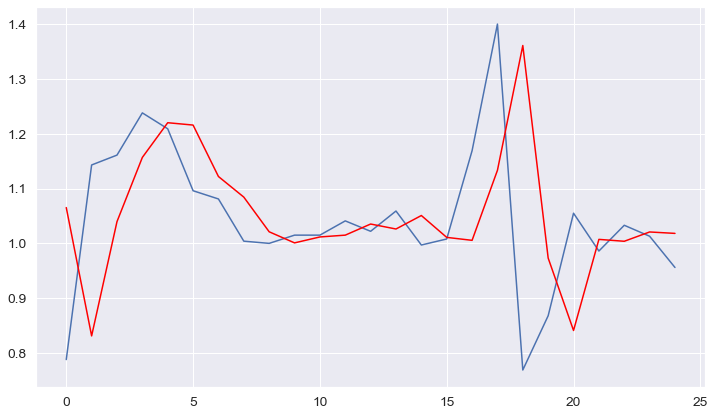

-----------------------------------------------------------------------
Ethiopia
predicted=2.935985, expected=2.994000
predicted=2.996725, expected=2.197000
predicted=2.174551, expected=2.506000
predicted=2.487341, expected=2.794000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.785471, expected=2.980000
predicted=2.977751, expected=3.147000
predicted=3.146652, expected=3.094000
predicted=3.094257, expected=3.463000
predicted=3.458938, expected=4.265000
predicted=4.327057, expected=4.432000
predicted=4.448424, expected=4.870000
predicted=4.920677, expected=5.159000
predicted=5.199554, expected=4.956000
predicted=4.930818, expected=5.318000
predicted=5.356375, expected=5.840000
predicted=5.915618, expected=6.418000
predicted=6.533412, expected=6.453000
predicted=6.459672, expected=6.337000
predicted=6.314981, expected=7.402000
predicted=7.577392, expected=8.109000
predicted=8.289108, expected=9.781000
predicted=10.462774, expected=12.017000
predicted=13.515898, expected=12.694000
predicted=13.064504, expected=14.347000
predicted=15.343130, expected=15.238000
predicted=15.766516, expected=16.149000
predicted=16.705737, expected=16.371000
predicted=16.503263, expected=14.665000
Test RMSE: 0.726


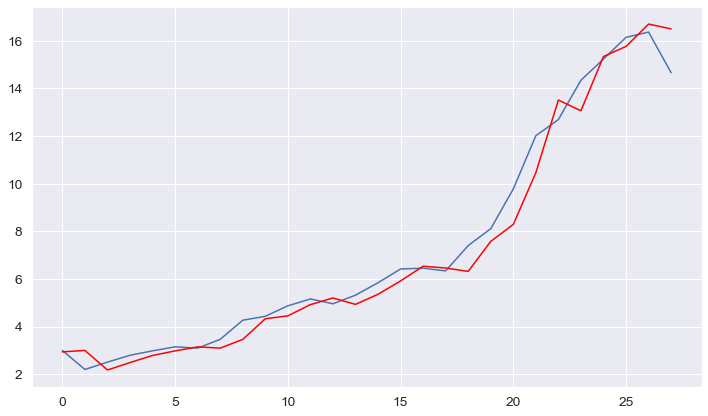

-----------------------------------------------------------------------
Europe
predicted=1557.287797, expected=1676.785000
predicted=1675.272623, expected=1820.242000
predicted=1787.873239, expected=1721.169000
predicted=1745.300838, expected=1606.566000
predicted=1631.575096, expected=1492.846000
predicted=1514.406457, expected=1537.176000
predicted=1528.569381, expected=1682.142000
predicted=1655.732574, expected=1766.803000
predicted=1753.683186, expected=1876.495000
predicted=1861.401828, expected=2036.583000
predicted=2019.593935, expected=2045.975000
predicted=2045.040744, expected=2094.155000
predicted=2089.397226, expected=2227.796000
predicted=2215.994904, expected=2142.812000
predicted=2151.581371, expected=1996.335000
predicted=2008.538397, expected=2002.950000
predicted=2002.406769, expected=1889.258000
predicted=1898.717933, expected=1233.343000
predicted=1216.984394, expected=1656.559000
predicted=1559.326249, expected=1907.211000
predicted=1877.776484, expected=2055.5230

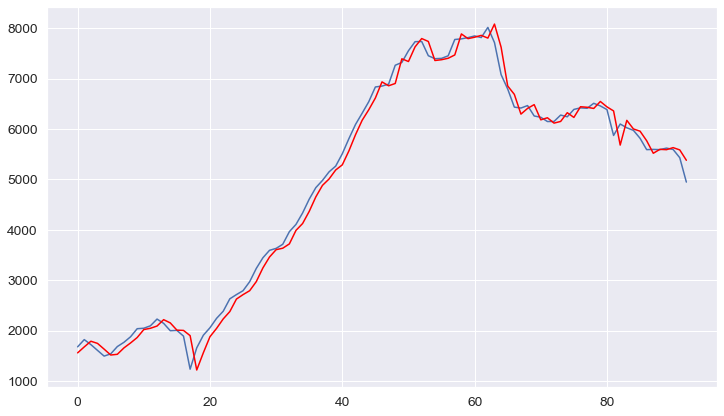

-----------------------------------------------------------------------
Europe (excl. EU-27)
predicted=441.762580, expected=551.665000
predicted=558.782509, expected=584.585000
predicted=572.257132, expected=597.865000
predicted=592.961542, expected=594.894000
predicted=595.990560, expected=598.733000
predicted=597.315835, expected=615.393000
predicted=609.250050, expected=688.692000
predicted=662.272448, expected=726.858000
predicted=714.188031, expected=792.686000
predicted=772.011706, expected=816.757000
predicted=809.608786, expected=813.699000
predicted=814.605398, expected=825.176000
predicted=821.771959, expected=907.475000
predicted=883.538556, expected=841.458000
predicted=861.929929, expected=675.681000
predicted=715.979814, expected=671.294000
predicted=672.206952, expected=747.589000
predicted=731.594445, expected=740.467000
predicted=741.937942, expected=808.953000
predicted=794.659258, expected=916.533000
predicted=898.124698, expected=960.199000
predicted=953.974111, exp

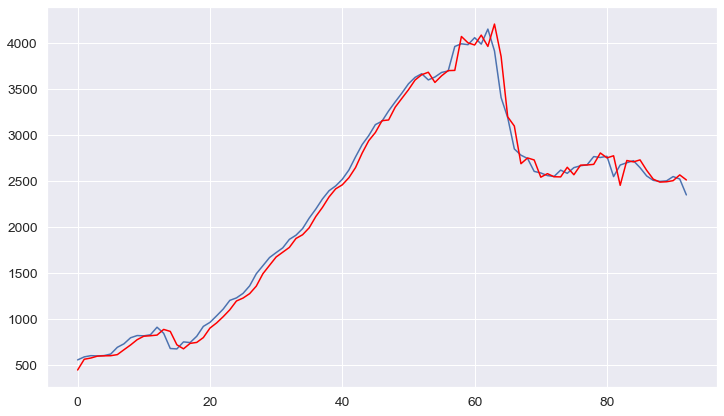

-----------------------------------------------------------------------
Europe (excl. EU-28)
predicted=838.010498, expected=912.353000
predicted=970.518705, expected=1002.712000
predicted=1054.803155, expected=1094.912000
predicted=1151.245526, expected=1163.166000
predicted=1205.531425, expected=1224.571000
predicted=1263.360684, expected=1279.513000
predicted=1314.667204, expected=1320.101000
predicted=1346.169093, expected=1387.814000
predicted=1432.199591, expected=1491.964000
predicted=1563.407337, expected=1585.957000
predicted=1651.974369, expected=1681.074000
predicted=1749.585887, expected=1774.977000
predicted=1844.014587, expected=1853.136000
predicted=1910.992157, expected=1910.881000
predicted=1953.625324, expected=1990.332000
predicted=2050.071679, expected=2108.523000
predicted=2200.289071, expected=2234.430000
predicted=2334.683868, expected=2345.218000
predicted=2434.105587, expected=2452.798000
predicted=2540.071383, expected=2532.467000
predicted=2596.833958, expecte

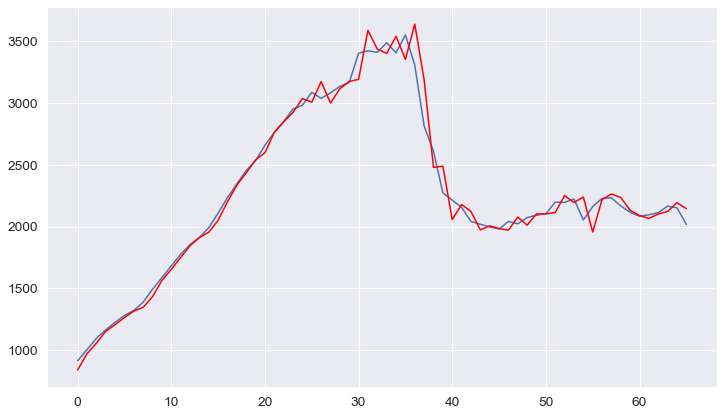

-----------------------------------------------------------------------
European Union (27)
predicted=1321.521665, expected=1331.656000
predicted=1332.157746, expected=1141.669000
predicted=1134.325157, expected=492.876000
predicted=237.048285, expected=847.606000
predicted=803.394770, expected=990.677000
predicted=983.536021, expected=1095.324000
predicted=1091.938198, expected=1211.059000
predicted=1208.880510, expected=1277.731000
predicted=1277.044743, expected=1429.766000
predicted=1429.850230, expected=1486.827000
predicted=1487.372504, expected=1515.000000
predicted=1515.315341, expected=1611.359000
predicted=1612.707812, expected=1743.357000
predicted=1746.907701, expected=1867.072000
predicted=1872.376290, expected=1926.397000
predicted=1929.332410, expected=1910.901000
predicted=1910.150984, expected=1940.654000
predicted=1942.080203, expected=2098.390000
predicted=2106.674747, expected=2197.685000
predicted=2204.274084, expected=2352.540000
predicted=2364.991230, expected=25

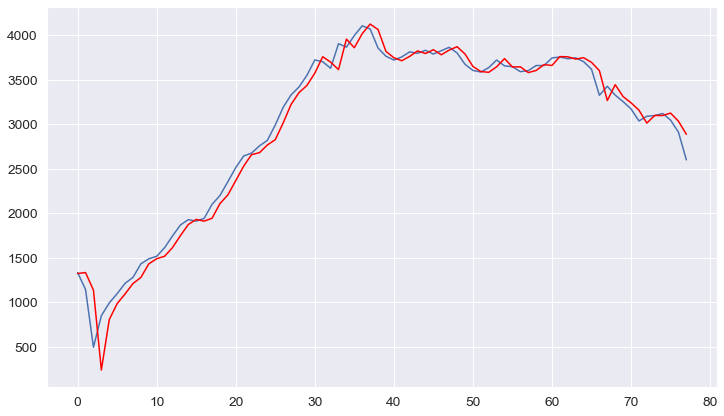

-----------------------------------------------------------------------
European Union (28)
predicted=1431.197437, expected=1562.759000
predicted=1563.739335, expected=1696.331000
predicted=1656.352990, expected=1564.378000
predicted=1607.204233, expected=1423.885000
predicted=1462.716933, expected=1290.012000
predicted=1320.794407, expected=1313.938000
predicted=1308.476956, expected=1416.654000
predicted=1393.702451, expected=1469.052000
predicted=1458.078735, expected=1537.605000
predicted=1523.763922, expected=1687.957000
predicted=1660.632978, expected=1681.216000
predicted=1682.405306, expected=1721.436000
predicted=1714.321764, expected=1795.465000
predicted=1782.784786, expected=1771.006000
predicted=1775.231813, expected=1789.554000
predicted=1786.338343, expected=1786.476000
predicted=1787.009456, expected=1583.693000
predicted=1618.610667, expected=910.501000
predicted=873.490708, expected=1283.734000
predicted=1209.463080, expected=1451.946000
predicted=1430.885457, expecte

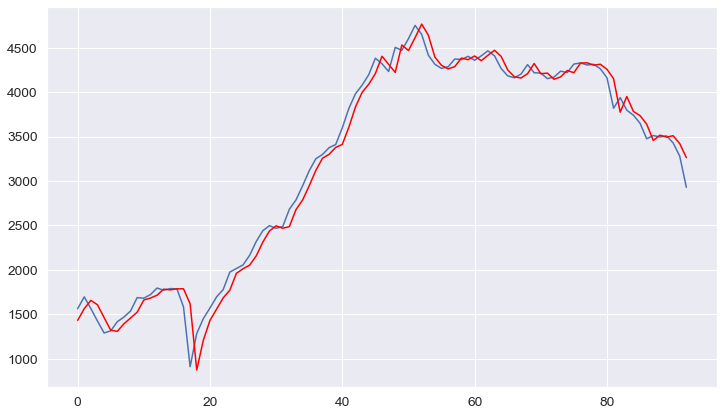

-----------------------------------------------------------------------
Faeroe Islands
predicted=0.572107, expected=0.601000
predicted=0.599928, expected=0.590000
predicted=0.590457, expected=0.623000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.621441, expected=0.630000
predicted=0.629700, expected=0.689000
predicted=0.686856, expected=0.762000
predicted=0.764135, expected=0.725000
predicted=0.725367, expected=0.733000
predicted=0.732890, expected=0.747000
predicted=0.746829, expected=0.722000
predicted=0.722422, expected=0.678000
predicted=0.678092, expected=0.689000
predicted=0.688908, expected=0.630000
predicted=0.630986, expected=0.575000
predicted=0.573669, expected=0.630000
predicted=0.629297, expected=0.568000
predicted=0.571202, expected=0.590000
predicted=0.588581, expected=0.649000
predicted=0.646055, expected=0.597000
predicted=0.601116, expected=0.608000
predicted=0.607089, expected=0.630000
predicted=0.628231, expected=0.707000
predicted=0.702083, expected=0.725000
predicted=0.724156, expected=0.736000
predicted=0.735507, expected=0.684000
Test RMSE: 0.043


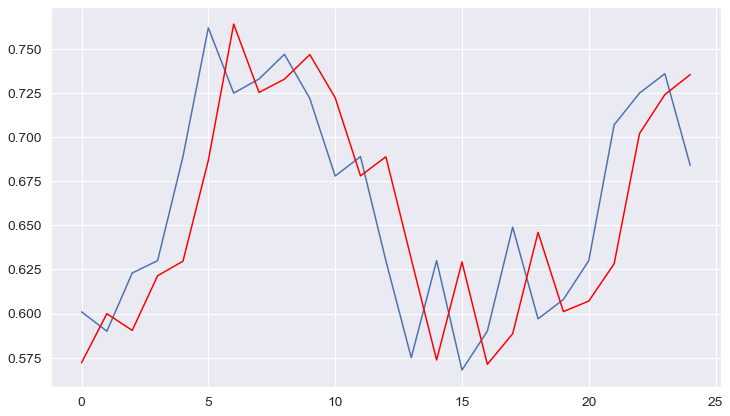

-----------------------------------------------------------------------
Fiji
predicted=0.750274, expected=0.814000
predicted=0.797732, expected=0.783000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.791609, expected=0.762000
predicted=0.767793, expected=0.775000
predicted=0.771408, expected=0.833000
predicted=0.817071, expected=1.046000
predicted=0.993650, expected=0.880000
predicted=0.928601, expected=1.037000
predicted=0.985833, expected=1.341000
predicted=1.272084, expected=1.082000
predicted=1.163278, expected=1.203000
predicted=1.163313, expected=1.140000
predicted=1.160907, expected=0.879000
predicted=0.959295, expected=0.778000
predicted=0.803213, expected=1.202000
predicted=1.075924, expected=1.068000
predicted=1.108300, expected=1.042000
predicted=1.049596, expected=1.099000
predicted=1.082272, expected=1.244000
predicted=1.202749, expected=1.294000
predicted=1.280403, expected=1.260000
predicted=1.269281, expected=1.362000
predicted=1.333849, expected=1.352000
predicted=1.354743, expected=1.392000
predicted=1.381012, expected=1.393000
Test RMSE: 0.152


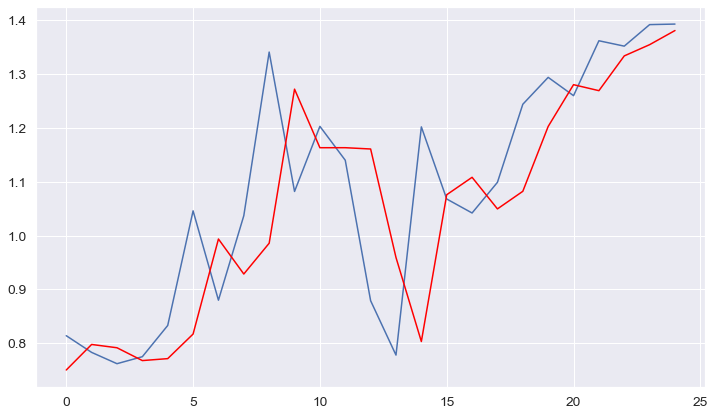

-----------------------------------------------------------------------
Finland
predicted=25.726578, expected=29.489000
predicted=30.541227, expected=28.588000
predicted=28.416074, expected=33.281000
predicted=34.024481, expected=37.897000
predicted=39.156034, expected=40.355000
predicted=41.100886, expected=40.537000
predicted=40.590879, expected=44.106000
predicted=45.174191, expected=49.320000
predicted=51.265894, expected=46.608000
predicted=45.886868, expected=46.026000
predicted=45.872171, expected=51.198000
predicted=52.495261, expected=50.137000
predicted=49.920434, expected=51.825000
predicted=52.156527, expected=54.237000
predicted=54.742628, expected=58.139000
predicted=59.074618, expected=51.403000
predicted=50.493585, expected=42.976000
predicted=40.556947, expected=41.463000
predicted=41.057253, expected=42.147000
predicted=42.327662, expected=49.549000
predicted=51.591822, expected=53.214000
predicted=54.320724, expected=57.533000
predicted=58.943914, expected=52.058000


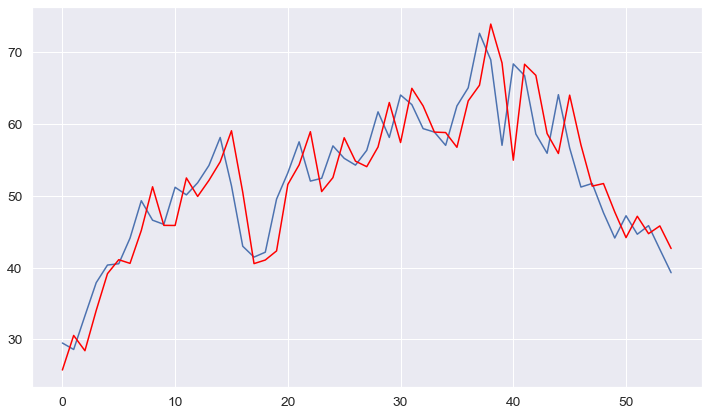

-----------------------------------------------------------------------
France
predicted=108.754185, expected=165.245000
predicted=173.935977, expected=183.624000
predicted=186.886314, expected=196.501000
predicted=198.897518, expected=229.051000
predicted=235.717149, expected=202.429000
predicted=198.302937, expected=228.916000
predicted=232.059966, expected=227.188000
predicted=226.992491, expected=214.739000
predicted=213.319138, expected=226.568000
predicted=227.833608, expected=239.231000
predicted=240.658512, expected=268.770000
predicted=272.544172, expected=277.841000
predicted=279.057915, expected=266.487000
predicted=265.016434, expected=262.289000
predicted=261.739999, expected=295.396000
predicted=299.535569, expected=314.659000
predicted=317.440606, expected=331.822000
predicted=334.481729, expected=337.791000
predicted=338.728831, expected=367.996000
predicted=372.939430, expected=362.962000
predicted=362.193306, expected=379.107000
predicted=381.522247, expected=403.4160

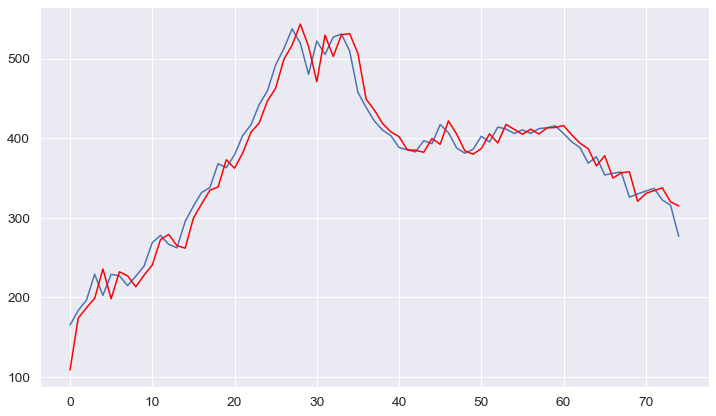

-----------------------------------------------------------------------
French Equatorial Africa
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=0.320500
predicted=0.320500, expected=

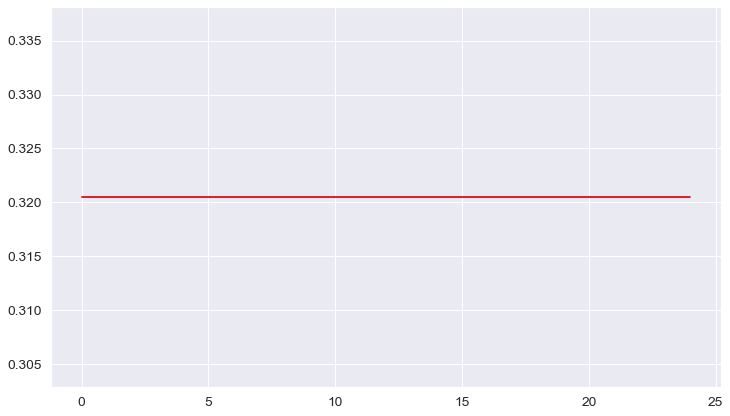

-----------------------------------------------------------------------
French Guiana
predicted=0.708041, expected=0.586000
predicted=0.574311, expected=0.546000
predicted=0.541524, expected=0.645000
predicted=0.653973, expected=0.515000
predicted=0.511975, expected=0.503000
predicted=0.502651, expected=0.558000
predicted=0.559433, expected=0.506000
predicted=0.505338, expected=0.646000
predicted=0.643193, expected=0.630000
predicted=0.630443, expected=0.595000
predicted=0.595886, expected=0.508000
predicted=0.509108, expected=0.600000
predicted=0.595940, expected=0.582000
predicted=0.582883, expected=0.766000
predicted=0.754645, expected=0.712000
predicted=0.716771, expected=0.714000
predicted=0.713824, expected=0.706000
predicted=0.706703, expected=0.692000
predicted=0.693225, expected=0.691000
predicted=0.691087, expected=0.702000
predicted=0.701053, expected=0.718000
predicted=0.716611, expected=0.705000
predicted=0.706120, expected=0.699000
predicted=0.699515, expected=0.728000
pr

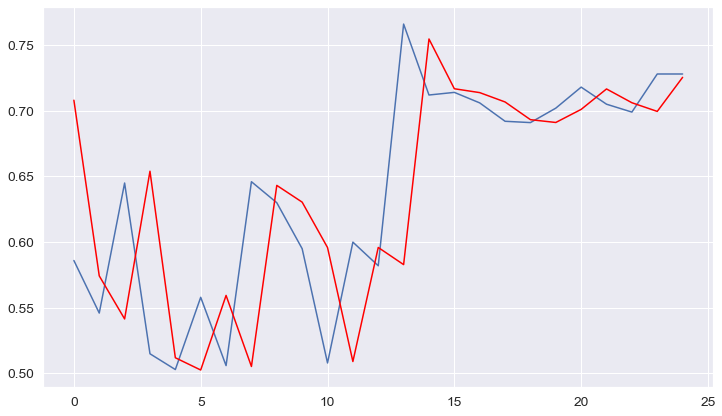

-----------------------------------------------------------------------
French Polynesia
predicted=0.460314, expected=0.451000
predicted=0.449956, expected=0.498000
predicted=0.514218, expected=0.572000
predicted=0.601083, expected=0.682000
predicted=0.735698, expected=0.685000
predicted=0.686266, expected=0.740000
predicted=0.762837, expected=0.725000
predicted=0.719174, expected=0.784000
predicted=0.806151, expected=0.780000
predicted=0.778575, expected=0.769000
predicted=0.765073, expected=0.795000
predicted=0.804174, expected=0.799000
predicted=0.800405, expected=0.802000
predicted=0.803055, expected=0.788000
predicted=0.783084, expected=0.773000
predicted=0.767706, expected=0.788000
predicted=0.793240, expected=0.769000
predicted=0.762445, expected=0.784000
predicted=0.789186, expected=0.758000
predicted=0.749162, expected=0.766000
predicted=0.768677, expected=0.802000
predicted=0.813971, expected=0.827000
predicted=0.835455, expected=0.828000
Test RMSE: 0.036


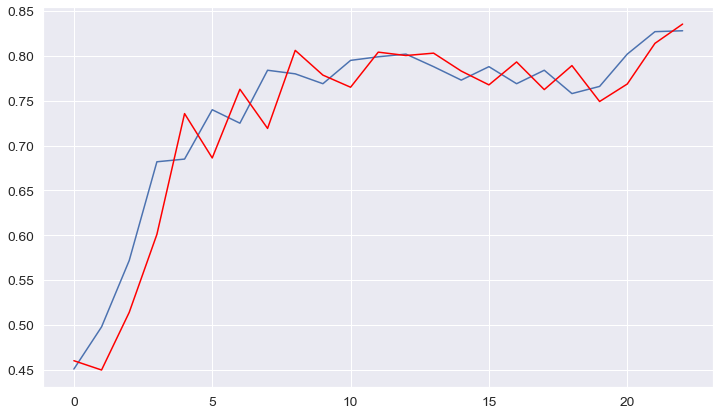

-----------------------------------------------------------------------
French West Africa
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
predicted=1.386500, expected=1.386500
Test RMSE: 0.000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


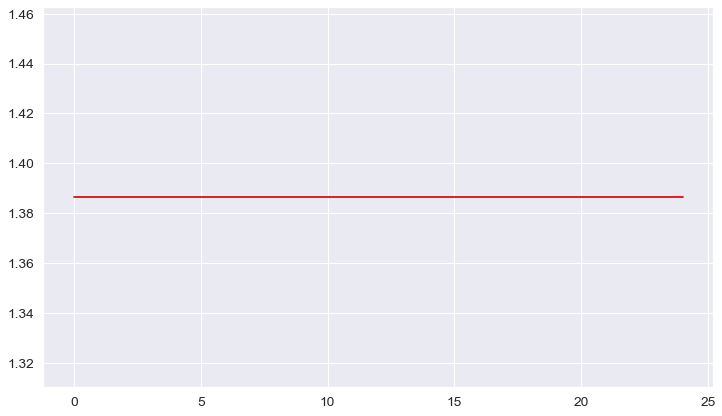

-----------------------------------------------------------------------
Gabon
predicted=4.948142, expected=4.788000
predicted=4.795530, expected=4.669000
predicted=4.674216, expected=4.772000
predicted=4.767426, expected=4.544000
predicted=4.554380, expected=4.614000
predicted=4.610766, expected=4.658000
predicted=4.655973, expected=4.859000
predicted=4.849823, expected=4.143000
predicted=4.180510, expected=4.090000
predicted=4.092619, expected=4.163000
predicted=4.159379, expected=4.233000
predicted=4.229544, expected=4.783000
predicted=4.756828, expected=4.930000
predicted=4.923642, expected=5.034000
predicted=5.029577, expected=5.269000
predicted=5.259271, expected=5.317000
predicted=5.315042, expected=5.269000
predicted=5.270964, expected=5.441000
predicted=5.433897, expected=4.598000
predicted=4.638320, expected=4.759000
predicted=4.750576, expected=4.488000
predicted=4.502687, expected=4.298000
Test RMSE: 0.296


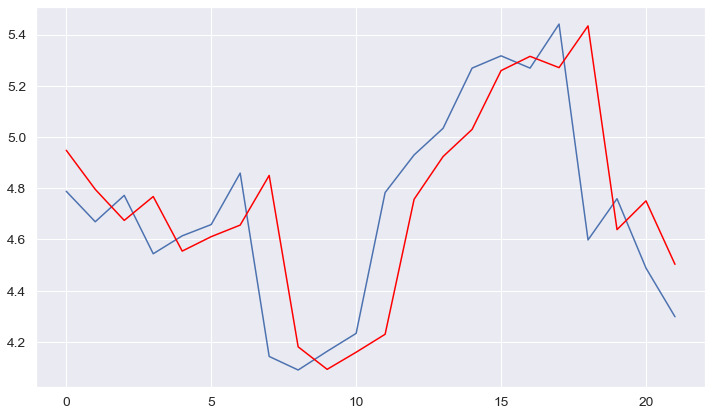

-----------------------------------------------------------------------
Gambia
predicted=0.216962, expected=0.220000
predicted=0.220571, expected=0.224000
predicted=0.224584, expected=0.242000
predicted=0.244936, expected=0.275000
predicted=0.284440, expected=0.275000
predicted=0.275000, expected=0.300000
predicted=0.305733, expected=0.300000
predicted=0.300000, expected=0.300000
predicted=0.300000, expected=0.322000
predicted=0.326530, expected=0.326000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.326816, expected=0.352000
predicted=0.357703, expected=0.352000
predicted=0.352000, expected=0.366000
predicted=0.368786, expected=0.381000
predicted=0.384328, expected=0.432000
predicted=0.448043, expected=0.447000
predicted=0.451641, expected=0.454000
predicted=0.456189, expected=0.432000
predicted=0.425471, expected=0.513000
predicted=0.522927, expected=0.524000
predicted=0.525404, expected=0.531000
predicted=0.531918, expected=0.535000
predicted=0.535529, expected=0.542000
predicted=0.542937, expected=0.547000
predicted=0.547677, expected=0.500000
Test RMSE: 0.026


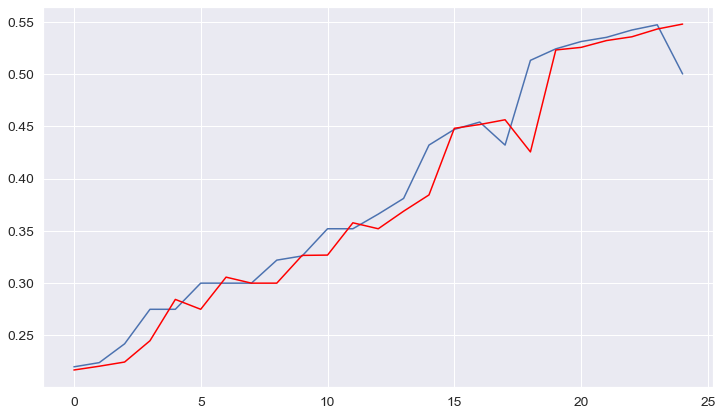

-----------------------------------------------------------------------
Georgia
predicted=4.422291, expected=4.586000
predicted=4.802440, expected=5.021000
predicted=5.269290, expected=5.363000
predicted=5.563854, expected=5.639000
predicted=5.803838, expected=5.872000
predicted=6.012805, expected=6.063000
predicted=6.179250, expected=6.372000
predicted=6.564169, expected=6.842000
predicted=7.148306, expected=7.285000
predicted=7.582911, expected=7.732000
predicted=8.041545, expected=8.168000
predicted=8.476957, expected=8.549000
predicted=8.822225, expected=8.797000
predicted=8.974237, expected=9.168000
predicted=9.437673, expected=9.637000
predicted=9.986412, expected=10.239000
predicted=10.703983, expected=10.780000
predicted=11.203161, expected=11.244000
predicted=11.609005, expected=11.682000
predicted=12.029407, expected=12.288000
predicted=12.781214, expected=12.759000
predicted=13.141267, expected=13.192000
predicted=13.545157, expected=13.647000
predicted=14.021323, expected=1

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=6.243768, expected=7.805000
predicted=8.600540, expected=8.252000
predicted=8.471513, expected=8.009000
predicted=7.890303, expected=8.934000
predicted=9.382825, expected=9.747000
predicted=10.144920, expected=10.066000
predicted=10.221884, expected=10.180000
predicted=10.235691, expected=10.105000
predicted=10.068374, expected=10.480000
predicted=10.662987, expected=9.968000
Test RMSE: 1.009


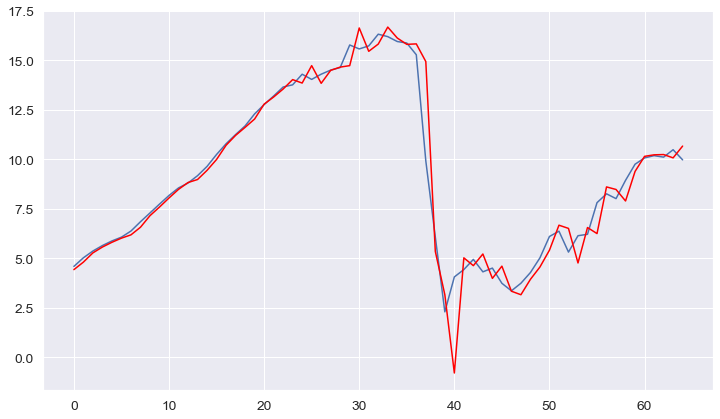

-----------------------------------------------------------------------
Germany
predicted=668.245305, expected=679.430000
predicted=680.000670, expected=600.273000
predicted=597.046258, expected=116.065000
predicted=-65.666883, expected=271.682000
predicted=257.048486, expected=317.660000
predicted=314.501615, expected=377.816000
predicted=374.152162, expected=432.148000
predicted=429.340077, expected=510.682000
predicted=507.535130, expected=576.866000
predicted=575.144901, expected=610.981000
predicted=610.300544, expected=623.492000
predicted=623.256794, expected=659.732000
predicted=659.092961, expected=723.498000
predicted=722.751013, expected=766.191000
predicted=765.987976, expected=777.908000
predicted=777.867254, expected=756.379000
predicted=756.467545, expected=755.795000
predicted=755.797375, expected=813.950000
predicted=813.707985, expected=834.840000
predicted=834.816531, expected=883.169000
predicted=883.235610, expected=945.498000
predicted=946.045101, expected=968.917

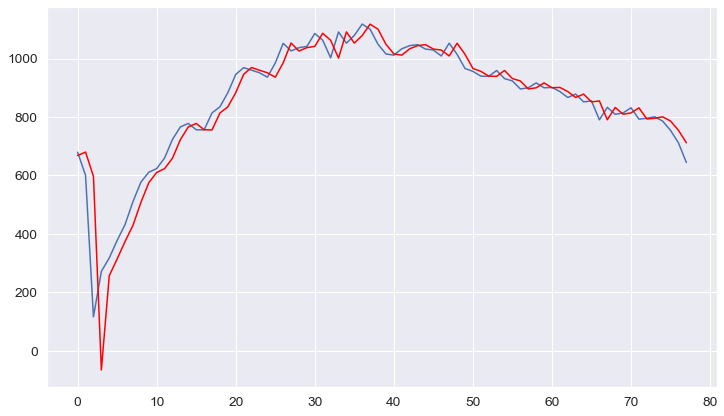

-----------------------------------------------------------------------
Ghana
predicted=5.131127, expected=5.469000
predicted=5.359203, expected=6.205000
predicted=5.978356, expected=6.245000
predicted=6.233769, expected=6.370000
predicted=6.334985, expected=6.101000
predicted=6.177462, expected=6.734000
predicted=6.541178, expected=7.233000
predicted=7.109512, expected=7.438000
predicted=7.391498, expected=7.153000
predicted=7.219410, expected=6.803000
predicted=6.879394, expected=9.159000
predicted=8.424045, expected=9.619000
predicted=9.569176, expected=8.925000
predicted=9.014810, expected=7.498000
predicted=7.578947, expected=9.710000
predicted=9.181243, expected=11.226000
predicted=11.181893, expected=14.315000
predicted=14.836393, expected=14.180000
predicted=14.165362, expected=14.755000
predicted=14.815988, expected=16.114000
predicted=16.287957, expected=16.547000
predicted=16.606697, expected=13.740000
predicted=13.450814, expected=16.683000
predicted=16.379341, expected=16.

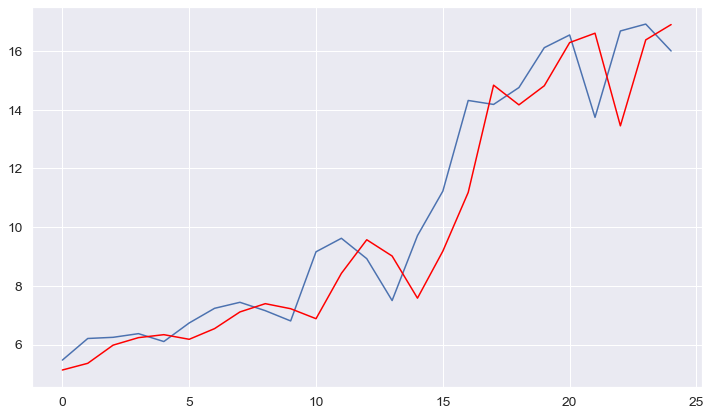

-----------------------------------------------------------------------
Greece
predicted=19.891459, expected=22.286000
predicted=23.628297, expected=25.434000
predicted=27.235680, expected=24.126000
predicted=23.573457, expected=27.750000
predicted=28.982537, expected=31.477000
predicted=33.161862, expected=37.131000
predicted=40.559382, expected=36.062000
predicted=35.627952, expected=38.670000
predicted=39.661980, expected=42.656000
predicted=44.401555, expected=46.657000
predicted=48.646301, expected=47.678000
predicted=48.162034, expected=50.819000
predicted=52.358034, expected=50.889000
predicted=50.921487, expected=50.125000
predicted=49.770654, expected=51.509000
predicted=52.140564, expected=54.789000
predicted=56.351653, expected=56.285000
predicted=56.996073, expected=59.772000
predicted=61.503350, expected=58.274000
predicted=57.612258, expected=62.576000
predicted=64.320954, expected=67.052000
predicted=69.098450, expected=73.231000
predicted=76.514835, expected=83.426000
p

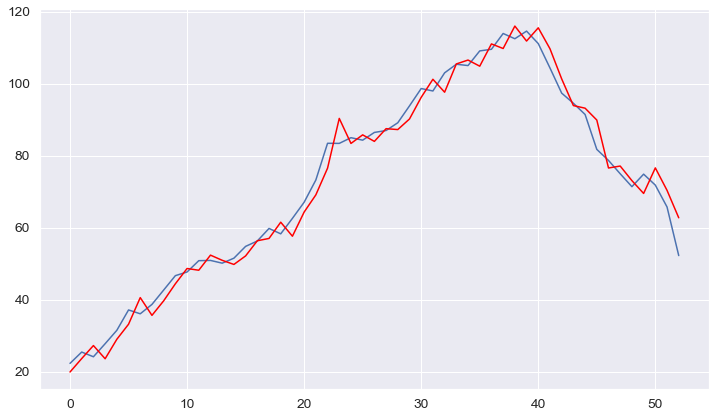

-----------------------------------------------------------------------
Greenland
predicted=0.513287, expected=0.597000
predicted=0.562893, expected=0.618000
predicted=0.606714, expected=0.597000
predicted=0.608296, expected=0.594000
predicted=0.595613, expected=0.668000
predicted=0.628178, expected=0.618000
predicted=0.644961, expected=0.580000
predicted=0.600349, expected=0.650000
predicted=0.612348, expected=0.640000
predicted=0.645358, expected=0.644000
predicted=0.641856, expected=0.662000
predicted=0.652352, expected=0.653000
predicted=0.657825, expected=0.678000
predicted=0.664587, expected=0.593000
predicted=0.638788, expected=0.679000
predicted=0.632322, expected=0.725000
predicted=0.700455, expected=0.578000
predicted=0.657381, expected=0.561000
predicted=0.569910, expected=0.521000
predicted=0.541931, expected=0.524000
predicted=0.522432, expected=0.525000
predicted=0.524477, expected=0.542000
predicted=0.533113, expected=0.548000
predicted=0.544864, expected=0.554000
predic

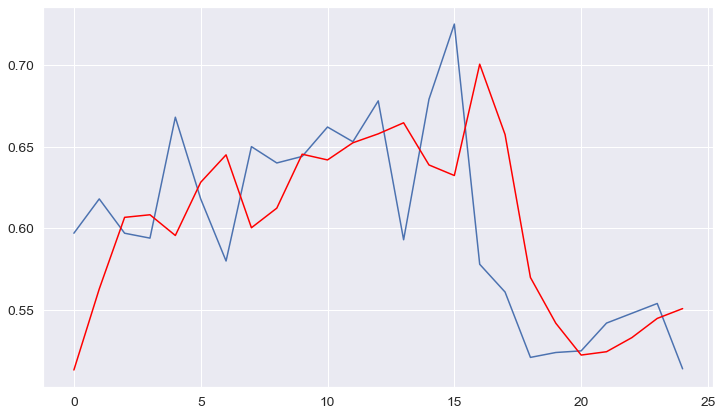

-----------------------------------------------------------------------
Grenada
predicted=0.150656, expected=0.154000
predicted=0.154414, expected=0.169000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.170910, expected=0.176000
predicted=0.177091, expected=0.194000
predicted=0.197591, expected=0.191000
predicted=0.190519, expected=0.194000
predicted=0.194471, expected=0.205000
predicted=0.206841, expected=0.216000
predicted=0.218190, expected=0.205000
predicted=0.203294, expected=0.216000
predicted=0.217257, expected=0.231000
predicted=0.233354, expected=0.238000
predicted=0.239228, expected=0.253000
predicted=0.256010, expected=0.253000
predicted=0.253000, expected=0.260000
predicted=0.261327, expected=0.253000
predicted=0.251773, expected=0.271000
predicted=0.273570, expected=0.304000
predicted=0.312760, expected=0.234000
predicted=0.248181, expected=0.260000
predicted=0.252675, expected=0.267000
predicted=0.265262, expected=0.278000
predicted=0.275357, expected=0.308000
predicted=0.301745, expected=0.332000
predicted=0.328781, expected=0.295000
Test RMSE: 0.023


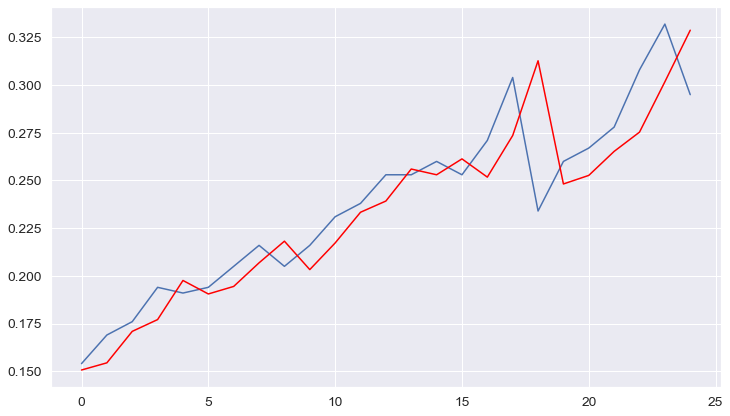

-----------------------------------------------------------------------
Guadeloupe
predicted=1.767214, expected=1.824000
predicted=1.868064, expected=1.838000
predicted=1.844661, expected=2.223000
predicted=2.412910, expected=2.171000
predicted=2.159431, expected=2.125000
predicted=2.114525, expected=2.258000
predicted=2.285730, expected=2.356000
predicted=2.378947, expected=2.388000
predicted=2.395571, expected=2.554000
predicted=2.595464, expected=2.383000
predicted=2.355262, expected=2.336000
predicted=2.328017, expected=2.488000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.511178, expected=2.439000
predicted=2.432701, expected=2.379000
predicted=2.370941, expected=2.505000
predicted=2.519731, expected=2.512000
predicted=2.512805, expected=2.485000
predicted=2.481907, expected=2.435000
predicted=2.429139, expected=2.432000
predicted=2.431649, expected=2.470000
predicted=2.474435, expected=2.527000
predicted=2.533890, expected=2.480000
predicted=2.474614, expected=2.458000
predicted=2.455443, expected=2.562000
predicted=2.573588, expected=2.562000
Test RMSE: 0.123


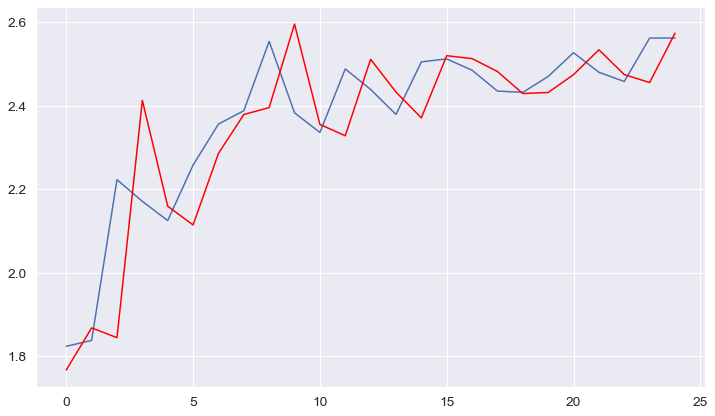

-----------------------------------------------------------------------
Guatemala
predicted=6.164431, expected=5.578000
predicted=5.536722, expected=6.751000
predicted=6.782429, expected=7.079000
predicted=7.107460, expected=6.571000
predicted=6.542062, expected=7.502000
predicted=7.481478, expected=8.639000
predicted=8.787321, expected=8.806000
predicted=8.828216, expected=9.765000
predicted=9.910228, expected=10.233000
predicted=10.319408, expected=10.722000
predicted=10.821928, expected=10.448000
predicted=10.397122, expected=11.180000
predicted=11.299911, expected=12.109000
predicted=12.313878, expected=12.177000
predicted=12.191234, expected=12.145000
predicted=12.138309, expected=10.893000
predicted=10.627317, expected=11.442000
predicted=11.514957, expected=11.098000
predicted=11.058264, expected=11.237000
predicted=11.252415, expected=11.558000
predicted=11.594626, expected=12.784000
predicted=12.958588, expected=13.785000
predicted=13.995361, expected=15.822000
predicted=16.48

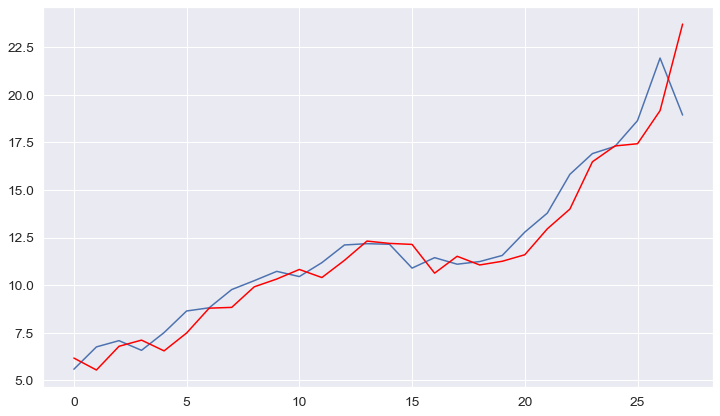

-----------------------------------------------------------------------
Guinea
predicted=1.402368, expected=1.433000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.471811, expected=1.491000
predicted=1.523669, expected=1.561000
predicted=1.601391, expected=1.623000
predicted=1.659364, expected=1.700000
predicted=1.746314, expected=1.762000
predicted=1.799743, expected=1.825000
predicted=1.863918, expected=1.891000
predicted=1.932397, expected=1.968000
predicted=2.017263, expected=1.997000
predicted=2.015327, expected=2.110000
predicted=2.182924, expected=2.484000
predicted=2.778998, expected=2.594000
predicted=2.659623, expected=2.422000
predicted=2.332113, expected=2.110000
predicted=1.917354, expected=2.165000
predicted=2.190285, expected=2.451000
predicted=2.590391, expected=2.744000
predicted=2.908869, expected=3.239000
predicted=3.586479, expected=3.686000
predicted=4.022799, expected=3.717000
predicted=3.736627, expected=3.394000
Test RMSE: 0.182


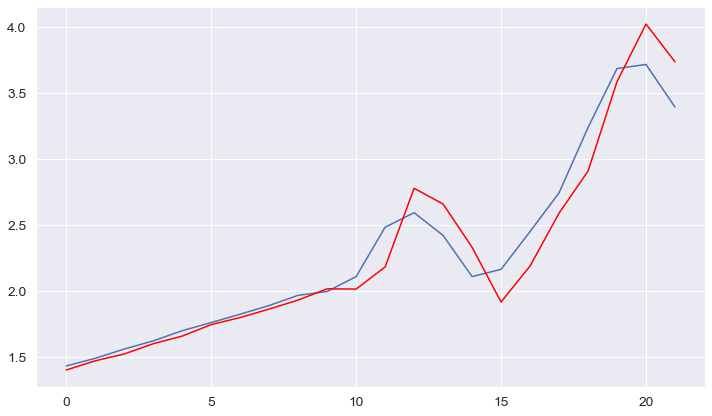

-----------------------------------------------------------------------
Guinea-Bissau
predicted=0.183000, expected=0.183000
predicted=0.183000, expected=0.202000
predicted=0.200192, expected=0.172000
predicted=0.176379, expected=0.194000
predicted=0.189772, expected=0.147000
predicted=0.159740, expected=0.150000
predicted=0.149284, expected=0.154000
predicted=0.153049, expected=0.194000
predicted=0.185135, expected=0.202000
predicted=0.200562, expected=0.213000
predicted=0.211058, expected=0.216000
predicted=0.215489, expected=0.231000
predicted=0.228488, expected=0.227000
predicted=0.227676, expected=0.234000
predicted=0.232788, expected=0.238000
predicted=0.237328, expected=0.242000
predicted=0.241321, expected=0.245000
predicted=0.244501, expected=0.245000
predicted=0.245000, expected=0.260000
predicted=0.257469, expected=0.278000
predicted=0.275299, expected=0.304000
predicted=0.300896, expected=0.304000
predicted=0.304000, expected=0.311000
predicted=0.310197, expected=0.314000
pr

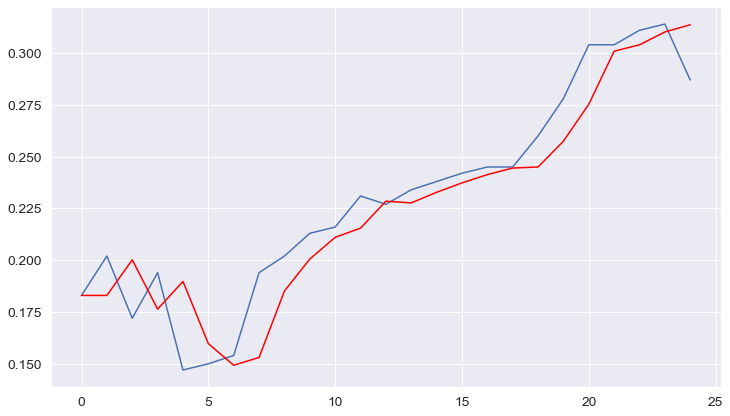

-----------------------------------------------------------------------
Guyana
predicted=1.549867, expected=1.652000
predicted=1.638726, expected=1.806000
predicted=1.782979, expected=1.828000
predicted=1.824802, expected=1.832000
predicted=1.831419, expected=1.748000
predicted=1.760230, expected=1.744000
predicted=1.744579, expected=1.715000
predicted=1.719200, expected=1.858000
predicted=1.836944, expected=1.927000
predicted=1.917363, expected=1.619000
predicted=1.665727, expected=1.510000
predicted=1.523619, expected=1.781000
predicted=1.742936, expected=1.707000
predicted=1.717781, expected=1.909000
predicted=1.878054, expected=1.887000
predicted=1.890351, expected=1.960000
predicted=1.948822, expected=1.960000
predicted=1.960000, expected=1.905000
predicted=1.913403, expected=1.972000
predicted=1.961649, expected=2.003000
predicted=1.998254, expected=2.345000
predicted=2.294582, expected=2.319000
predicted=2.322728, expected=2.481000
predicted=2.457447, expected=2.487000
predicted

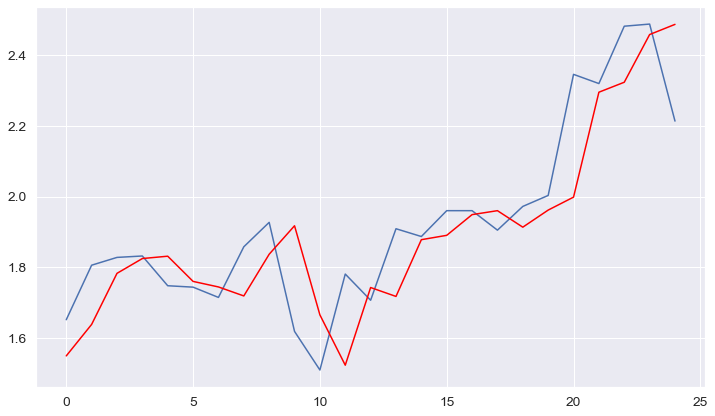

-----------------------------------------------------------------------
Haiti
predicted=0.546485, expected=1.019000
predicted=1.002561, expected=1.348000
predicted=1.327800, expected=1.235000
predicted=1.245274, expected=1.271000
predicted=1.267625, expected=1.634000
predicted=1.604601, expected=1.471000
predicted=1.490887, expected=1.785000
predicted=1.734307, expected=1.700000
predicted=1.714427, expected=1.652000
predicted=1.659956, expected=1.724000
predicted=1.711895, expected=1.752000
predicted=1.747352, expected=1.772000
predicted=1.768690, expected=1.761000
predicted=1.762822, expected=1.888000
predicted=1.866825, expected=2.137000
predicted=2.101882, expected=2.273000
predicted=2.257953, expected=2.264000
predicted=2.264991, expected=2.706000
predicted=2.656204, expected=2.705000
predicted=2.705099, expected=2.661000
predicted=2.665372, expected=2.983000
predicted=2.948254, expected=3.104000
predicted=3.094462, expected=3.368000
predicted=3.352222, expected=3.289000
predicted=

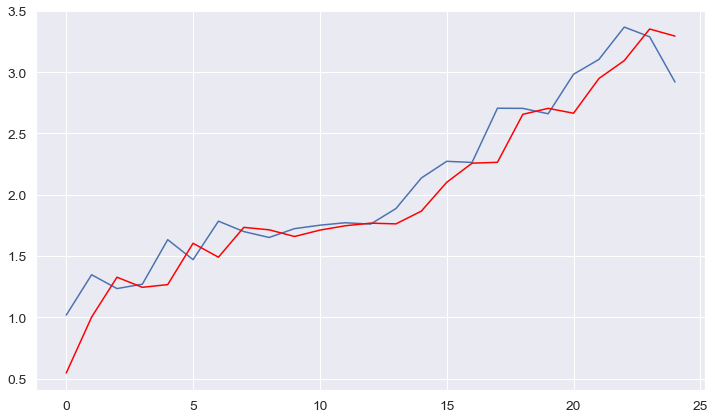

-----------------------------------------------------------------------
High-income countries
predicted=3576.522993, expected=3620.431000
predicted=3628.566606, expected=3892.720000
predicted=3826.324833, expected=3523.468000
predicted=3632.123309, expected=3088.239000
predicted=3166.841727, expected=2720.626000
predicted=2750.556457, expected=2852.511000
predicted=2839.413399, expected=3062.116000
predicted=3044.216418, expected=3179.175000
predicted=3170.714448, expected=3490.610000
predicted=3473.479428, expected=3748.570000
predicted=3744.130495, expected=3465.261000
predicted=3478.867710, expected=3680.468000
predicted=3665.042518, expected=3988.226000
predicted=3974.866789, expected=4147.568000
predicted=4143.964047, expected=4321.285000
predicted=4319.259584, expected=4404.735000
predicted=4404.238282, expected=4372.284000
predicted=4372.510415, expected=3533.140000
predicted=3530.420904, expected=3820.362000
predicted=3800.326864, expected=4274.380000
predicted=4260.837505, exp

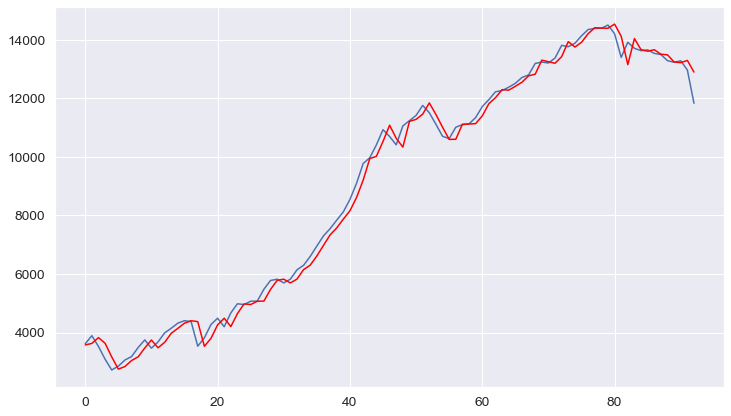

-----------------------------------------------------------------------
Honduras
predicted=3.982021, expected=3.817000
predicted=3.831208, expected=3.945000
predicted=3.981900, expected=4.737000
predicted=5.016755, expected=4.613000
predicted=4.588489, expected=4.929000
predicted=4.984972, expected=5.602000
predicted=5.781047, expected=5.868000
predicted=5.944696, expected=6.617000
predicted=6.881519, expected=7.194000
predicted=7.438713, expected=6.831000
predicted=6.712334, expected=7.677000
predicted=7.873731, expected=8.206000
predicted=8.362182, expected=8.438000
predicted=8.508466, expected=7.939000
predicted=7.801248, expected=7.890000
predicted=7.876898, expected=8.736000
predicted=8.954684, expected=9.094000
predicted=9.193837, expected=9.240000
predicted=9.281133, expected=9.309000
predicted=9.328491, expected=9.802000
predicted=9.943914, expected=9.293000
predicted=9.172952, expected=8.857000
predicted=8.743309, expected=10.050000
predicted=10.258010, expected=10.789000
pred

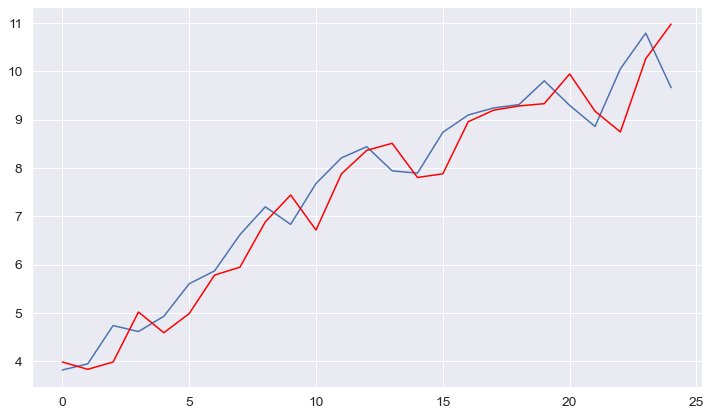

-----------------------------------------------------------------------
Hong Kong
predicted=29.051572, expected=32.919000
predicted=35.314358, expected=34.778000
predicted=35.718351, expected=31.079000
predicted=29.624863, expected=31.267000
predicted=31.328445, expected=28.909000
predicted=28.150735, expected=30.497000
predicted=30.916978, expected=38.925000
predicted=42.187377, expected=42.549000
predicted=44.016079, expected=40.283000
predicted=39.531447, expected=37.802000
predicted=36.928233, expected=39.485000
predicted=40.023369, expected=43.202000
predicted=44.489667, expected=41.569000
predicted=41.086396, expected=43.731000
predicted=44.326602, expected=41.915000
predicted=41.457661, expected=43.572000
predicted=43.960878, expected=42.791000
predicted=42.614362, expected=41.579000
predicted=41.300538, expected=40.063000
predicted=39.704725, expected=43.150000
predicted=43.809431, expected=42.742000
predicted=42.660420, expected=44.307000
predicted=44.615563, expected=45.49200

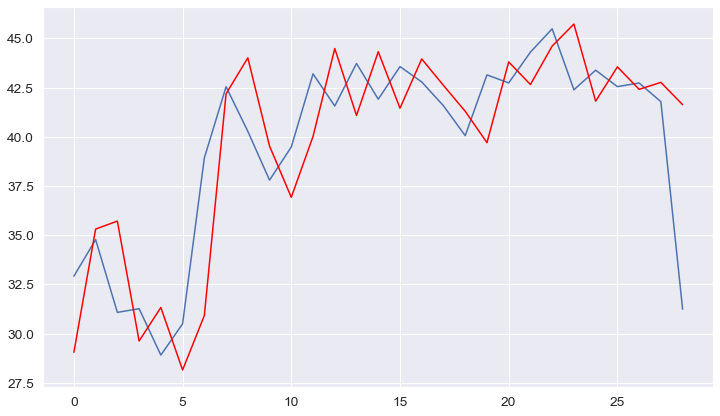

-----------------------------------------------------------------------
Hungary
predicted=36.291664, expected=33.163000
predicted=32.332145, expected=38.446000
predicted=39.884125, expected=39.244000
predicted=39.452645, expected=41.903000
predicted=42.614678, expected=45.328000
predicted=46.321362, expected=48.930000
predicted=50.071023, expected=50.512000
predicted=51.020405, expected=56.228000
predicted=58.198590, expected=62.341000
predicted=64.825849, expected=61.234000
predicted=60.841927, expected=61.673000
predicted=61.827531, expected=58.771000
predicted=57.758847, expected=61.093000
predicted=61.850478, expected=62.358000
predicted=62.774110, expected=69.935000
predicted=72.582111, expected=69.204000
predicted=68.986465, expected=69.342000
predicted=69.382996, expected=72.960000
predicted=74.038264, expected=73.981000
predicted=74.284885, expected=75.248000
predicted=75.627562, expected=79.842000
predicted=81.265957, expected=83.005000
predicted=84.032888, expected=87.964000


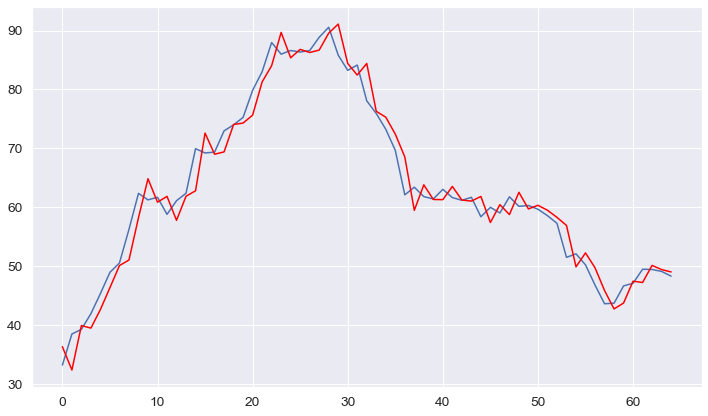

-----------------------------------------------------------------------
Iceland
predicted=2.126038, expected=2.255000
predicted=2.228798, expected=2.411000
predicted=2.386643, expected=2.365000
predicted=2.372295, expected=2.467000
predicted=2.450505, expected=2.523000
predicted=2.514235, expected=2.619000
predicted=2.604368, expected=2.638000
predicted=2.635146, expected=2.840000
predicted=2.810222, expected=2.932000
predicted=2.919978, expected=2.863000
predicted=2.872263, expected=2.991000
predicted=2.973107, expected=2.985000
predicted=2.985833, expected=3.109000
predicted=3.091725, expected=2.976000
predicted=2.995793, expected=3.153000
predicted=3.124240, expected=3.496000
predicted=3.454778, expected=3.811000
predicted=3.796075, expected=3.728000
predicted=3.732932, expected=3.625000
predicted=3.630604, expected=3.501000
predicted=3.506827, expected=3.497000
predicted=3.497185, expected=3.483000
predicted=3.483648, expected=3.459000
predicted=3.460107, expected=3.536000
predicte

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=3.598844, expected=3.663000
predicted=3.660214, expected=3.551000
predicted=3.556767, expected=2.936000
Test RMSE: 0.179


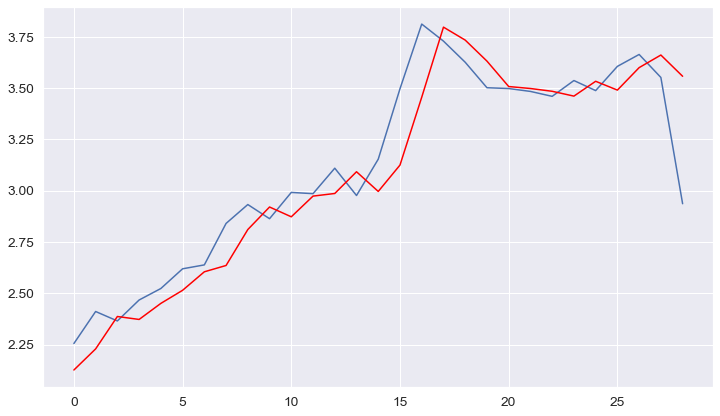

-----------------------------------------------------------------------
India
predicted=138.096467, expected=153.868000
predicted=160.649287, expected=159.540000
predicted=162.174189, expected=159.726000
predicted=159.810436, expected=174.246000
predicted=180.855531, expected=177.589000
predicted=179.007675, expected=181.899000
predicted=183.754982, expected=192.145000
predicted=196.791515, expected=203.227000
predicted=208.687692, expected=209.291000
predicted=212.301729, expected=216.061000
predicted=219.506154, expected=234.439000
predicted=244.761515, expected=244.990000
predicted=250.936634, expected=259.215000
predicted=267.758887, expected=263.398000
predicted=265.808720, expected=276.542000
predicted=284.342933, expected=291.992000
predicted=301.724083, expected=315.266000
predicted=331.531899, expected=325.684000
predicted=332.566616, expected=352.530000
predicted=371.752840, expected=361.889000
predicted=368.027453, expected=397.953000
predicted=423.771265, expected=426.69900

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=2142.398131, expected=2036.937000
predicted=2099.834622, expected=2185.856000
predicted=2319.498128, expected=2268.567000
predicted=2339.218728, expected=2382.223000
predicted=2481.509781, expected=2433.856000
predicted=2477.514336, expected=2599.806000
predicted=2745.148361, expected=2625.968000
predicted=2646.556147, expected=2441.792000
Test RMSE: 48.144


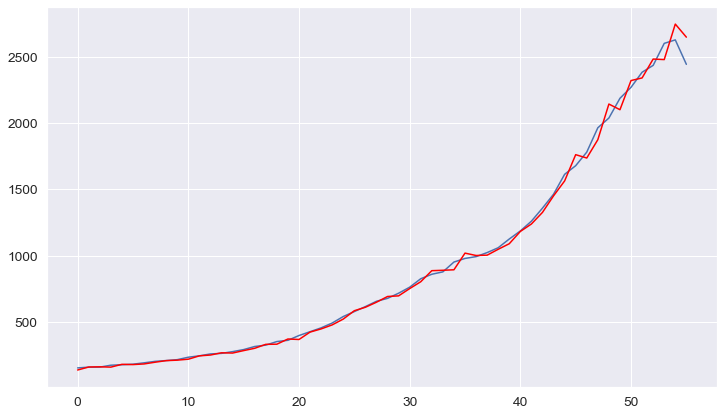

-----------------------------------------------------------------------
Indonesia
predicted=53.880586, expected=61.788000
predicted=61.782490, expected=82.416000
predicted=85.156227, expected=93.938000
predicted=96.739771, expected=95.137000
predicted=95.416117, expected=94.873000
predicted=94.811633, expected=100.297000
predicted=101.553348, expected=105.584000
predicted=106.872589, expected=105.184000
predicted=105.088447, expected=112.460000
predicted=114.186036, expected=121.597000
predicted=124.025005, expected=122.166000
predicted=122.312314, expected=123.878000
predicted=124.319041, expected=132.721000
predicted=135.062856, expected=131.674000
predicted=131.411995, expected=150.285000
predicted=154.755577, expected=180.621000
predicted=193.929660, expected=203.577000
predicted=215.647814, expected=219.762000
predicted=228.665162, expected=222.855000
predicted=224.486484, expected=226.543000
predicted=228.494111, expected=255.067000
predicted=270.791520, expected=280.734000
predi

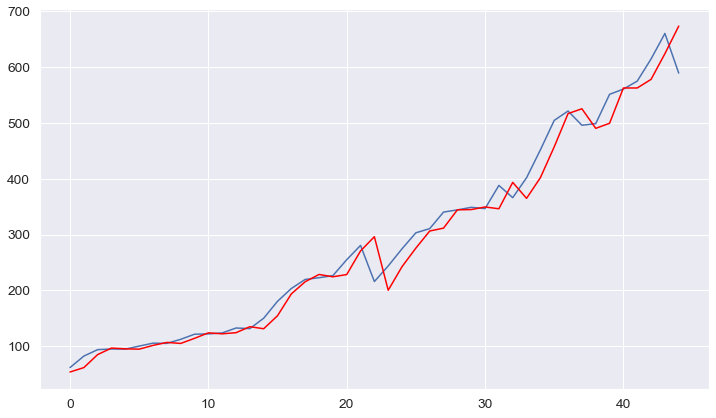

-----------------------------------------------------------------------
International transport
predicted=637.987873, expected=673.978000
predicted=699.002818, expected=709.382000
predicted=727.143200, expected=751.715000
predicted=773.818845, expected=776.287000
predicted=789.180213, expected=786.862000
predicted=792.399597, expected=781.931000
predicted=779.360198, expected=799.697000
predicted=808.920976, expected=834.217000
predicted=852.481325, expected=906.605000
predicted=947.745981, expected=945.110000
predicted=966.860862, expected=997.659000
predicted=1028.499045, expected=1055.405000
predicted=1090.734081, expected=1068.476000
predicted=1076.193766, expected=1022.624000
predicted=996.110108, expected=1086.420000
predicted=1118.962359, expected=1111.962000
predicted=1124.821587, expected=1101.737000
predicted=1096.679085, expected=1118.095000
predicted=1126.133796, expected=1128.692000
predicted=1133.907538, expected=1171.701000
predicted=1193.121546, expected=1185.328000
pre

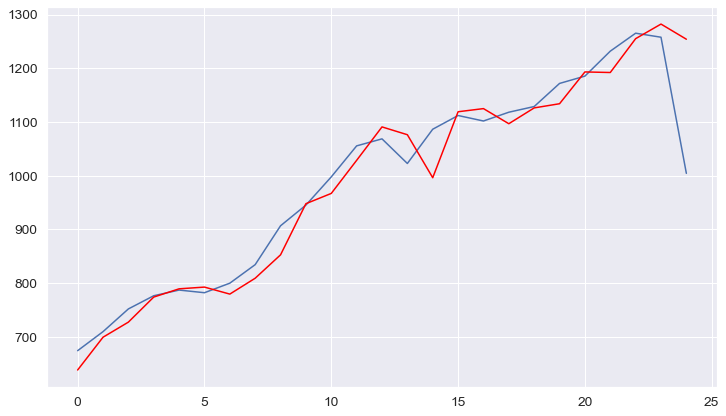

-----------------------------------------------------------------------
Iran
predicted=113.964471, expected=112.996000
predicted=111.815126, expected=137.771000
predicted=141.229332, expected=149.585000
predicted=151.446070, expected=149.864000
predicted=149.907512, expected=159.857000
predicted=161.417930, expected=147.603000
predicted=145.832543, expected=158.563000
predicted=160.003194, expected=175.143000
predicted=177.549735, expected=190.198000
predicted=192.639379, expected=209.944000
predicted=213.555107, expected=226.011000
predicted=229.254161, expected=226.935000
predicted=227.118932, expected=235.607000
predicted=237.338522, expected=263.820000
predicted=269.937923, expected=271.582000
predicted=273.290931, expected=273.769000
predicted=274.251136, expected=267.046000
predicted=265.571246, expected=305.503000
predicted=313.202940, expected=379.501000
predicted=406.239295, expected=369.150000
predicted=366.747454, expected=394.759000
predicted=400.353460, expected=397.625000

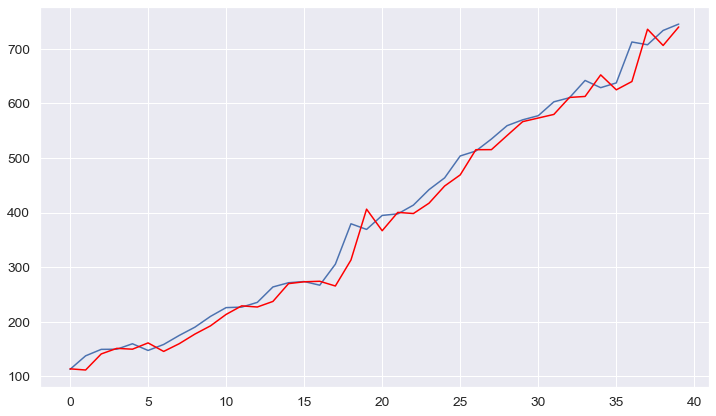

-----------------------------------------------------------------------
Iraq
predicted=68.241315, expected=72.242000
predicted=72.815728, expected=49.057000
predicted=48.203675, expected=45.185000
predicted=44.917131, expected=58.889000
predicted=59.495998, expected=63.130000
predicted=63.407061, expected=71.089000
predicted=71.717577, expected=74.083000
predicted=74.342542, expected=69.283000
predicted=68.896496, expected=68.079000
predicted=67.980127, expected=72.102000
predicted=72.424353, expected=71.681000
predicted=71.647764, expected=71.716000
predicted=71.718763, expected=84.556000
predicted=85.571275, expected=86.322000
predicted=86.468062, expected=90.785000
predicted=91.166928, expected=113.635000
predicted=116.437043, expected=112.764000
predicted=112.679926, expected=97.965000
predicted=96.478547, expected=61.169000
predicted=51.922502, expected=91.803000
predicted=90.151789, expected=102.969000
predicted=103.128960, expected=110.066000
predicted=110.261175, expected=135.2

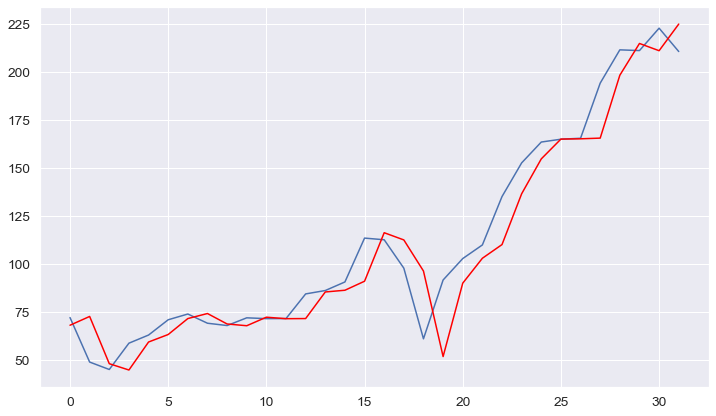

-----------------------------------------------------------------------
Ireland
predicted=12.209413, expected=13.107000
predicted=13.023150, expected=13.447000
predicted=13.410211, expected=14.216000
predicted=14.134774, expected=13.717000
predicted=13.771211, expected=15.095000
predicted=14.936803, expected=16.395000
predicted=16.269742, expected=17.802000
predicted=17.691773, expected=18.494000
predicted=18.446720, expected=19.394000
predicted=19.337725, expected=22.476000
predicted=22.359619, expected=22.036000
predicted=22.056150, expected=22.846000
predicted=22.806629, expected=23.293000
predicted=23.272688, expected=22.048000
predicted=22.110043, expected=22.293000
predicted=22.280347, expected=23.569000
predicted=23.506299, expected=23.580000
predicted=23.579468, expected=27.403000
predicted=27.219360, expected=26.272000
predicted=26.355078, expected=26.062000
predicted=26.076942, expected=25.566000
predicted=25.600924, expected=25.729000
predicted=25.717451, expected=25.549000


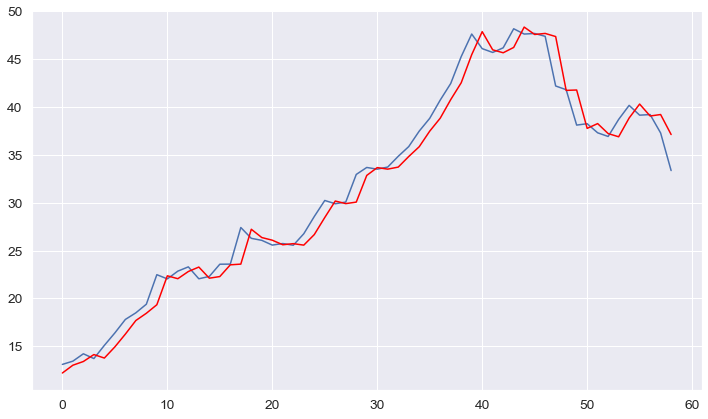

-----------------------------------------------------------------------
Israel
predicted=32.100850, expected=35.824000
predicted=38.134892, expected=36.148000
predicted=36.281005, expected=42.082000
predicted=44.637922, expected=44.235000
predicted=45.117941, expected=47.475000
predicted=48.939789, expected=49.866000
predicted=51.001907, expected=51.936000
predicted=52.953311, expected=54.866000
predicted=56.387609, expected=56.010000
predicted=56.595786, expected=54.756000
predicted=54.131479, expected=59.519000
predicted=61.673244, expected=63.024000
predicted=64.737507, expected=59.301000
predicted=57.861746, expected=62.415000
predicted=63.355616, expected=58.679000
predicted=57.809461, expected=56.524000
predicted=55.976414, expected=62.149000
predicted=63.250250, expected=62.800000
predicted=62.921170, expected=67.980000
predicted=69.008083, expected=63.861000
predicted=63.423828, expected=68.287000
predicted=68.466954, expected=68.595000
predicted=68.608061, expected=74.785000
p

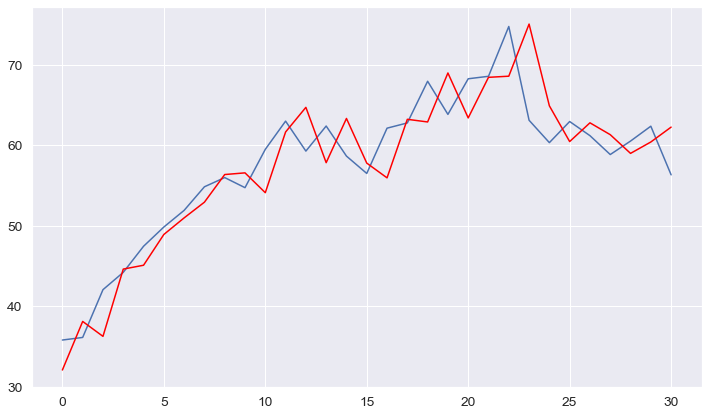

-----------------------------------------------------------------------
Italy
predicted=195.513773, expected=213.982000
predicted=225.894148, expected=234.130000
predicted=244.703848, expected=249.172000
predicted=257.301979, expected=269.661000
predicted=281.367562, expected=296.365000
predicted=312.891510, expected=311.049000
predicted=320.036429, expected=328.237000
predicted=339.036833, expected=353.349000
predicted=369.924910, expected=358.253000
predicted=361.317115, expected=341.052000
predicted=330.515816, expected=365.795000
predicted=379.187096, expected=354.418000
predicted=349.019789, expected=371.274000
predicted=378.811280, expected=385.256000
predicted=391.666093, expected=386.433000
predicted=386.963853, expected=375.300000
predicted=370.294711, expected=366.879000
predicted=363.060598, expected=358.409000
predicted=354.535093, expected=364.601000
predicted=367.380595, expected=368.982000
predicted=370.953046, expected=363.188000
predicted=360.600654, expected=380.09900

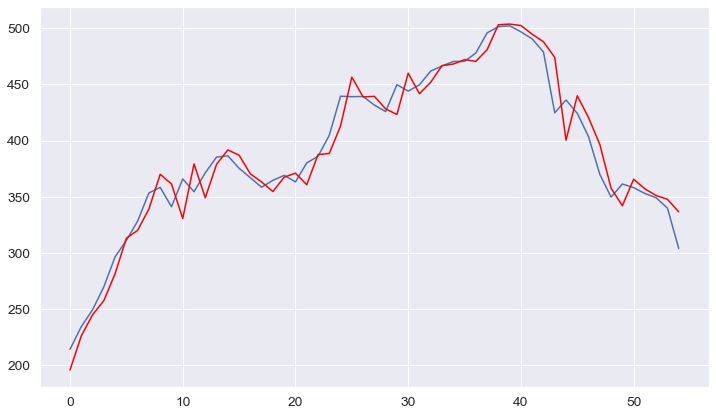

-----------------------------------------------------------------------
Jamaica
predicted=9.072579, expected=9.688000
predicted=9.646145, expected=10.068000
predicted=10.039918, expected=9.694000
predicted=9.723315, expected=9.958000
predicted=9.936517, expected=10.314000
predicted=10.286217, expected=10.576000
predicted=10.556453, expected=10.203000
predicted=10.231993, expected=10.667000
predicted=10.628415, expected=10.574000
predicted=10.581814, expected=10.417000
predicted=10.430116, expected=11.577000
predicted=11.473231, expected=10.749000
predicted=10.845091, expected=10.780000
predicted=10.776453, expected=7.934000
predicted=8.266067, expected=7.677000
predicted=7.696350, expected=8.256000
predicted=8.210346, expected=7.913000
predicted=7.941496, expected=8.492000
predicted=8.441223, expected=7.697000
predicted=7.775013, expected=7.995000
predicted=7.964509, expected=8.163000
predicted=8.146042, expected=7.798000
predicted=7.835355, expected=8.039000
predicted=8.013905, expect

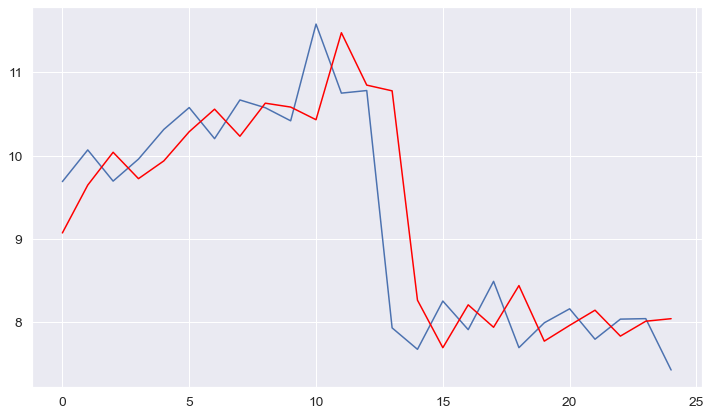

-----------------------------------------------------------------------
Japan
predicted=536.137673, expected=561.913000
predicted=616.041887, expected=653.215000
predicted=729.545845, expected=767.963000
predicted=873.337031, expected=796.544000
predicted=818.031366, expected=852.170000
predicted=895.017516, expected=914.265000
predicted=963.291834, expected=914.306000
predicted=914.336238, expected=868.511000
predicted=834.760382, expected=907.145000
predicted=933.471104, expected=933.238000
predicted=951.015981, expected=901.590000
predicted=880.689646, expected=953.071000
predicted=985.178681, expected=944.869000
predicted=940.012166, expected=926.835000
predicted=916.126217, expected=897.408000
predicted=879.784386, expected=880.909000
predicted=871.035302, expected=937.070000
predicted=969.749327, expected=912.401000
predicted=899.175783, expected=912.260000
predicted=912.185045, expected=902.530000
predicted=897.357094, expected=985.464000
predicted=1028.508865, expected=1021.682

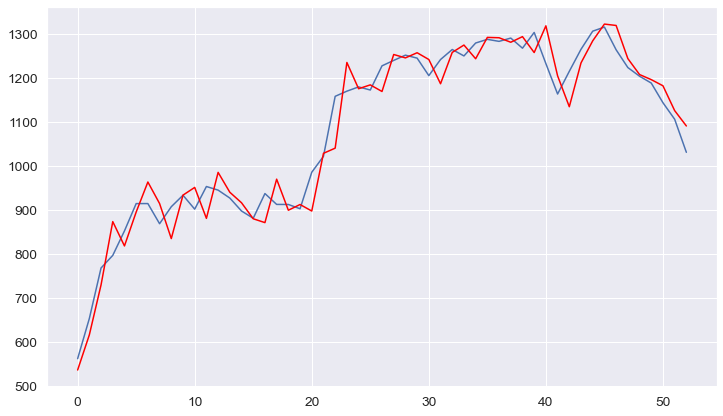

-----------------------------------------------------------------------
Jordan
predicted=13.204805, expected=13.825000
predicted=13.870891, expected=14.074000
predicted=14.094513, expected=14.253000
predicted=14.268200, expected=14.267000
predicted=14.268189, expected=15.200000
predicted=15.279962, expected=15.610000
predicted=15.652718, expected=16.420000
predicted=16.519487, expected=16.982000
predicted=17.063056, expected=18.671000
predicted=18.999361, expected=20.437000
predicted=20.985912, expected=20.526000
predicted=20.550650, expected=21.436000
predicted=21.690963, expected=20.718000
predicted=20.542559, expected=21.337000
predicted=21.474264, expected=20.615000
predicted=20.469888, expected=21.244000
predicted=21.356974, expected=23.814000
predicted=24.422848, expected=23.813000
predicted=23.812810, expected=25.895000
predicted=26.289409, expected=25.556000
predicted=25.505524, expected=24.346000
predicted=24.153299, expected=25.561000
predicted=25.701673, expected=25.260000
p

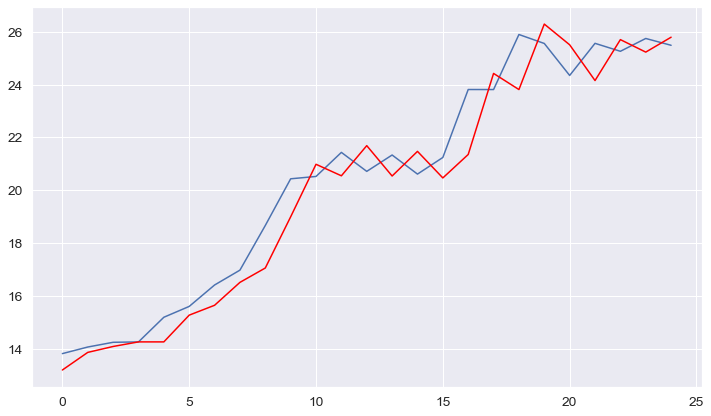

-----------------------------------------------------------------------
Kazakhstan
predicted=72.680728, expected=75.241000
predicted=78.787240, expected=82.348000
predicted=86.430721, expected=87.910000
predicted=91.193143, expected=92.451000
predicted=95.177147, expected=96.286000
predicted=98.615295, expected=99.302000
predicted=101.144783, expected=104.219000
predicted=107.284405, expected=111.738000
predicted=116.638610, expected=118.806000
predicted=123.551858, expected=126.031000
predicted=131.026093, expected=133.100000
predicted=138.100642, expected=139.147000
predicted=143.470239, expected=143.019000
predicted=145.777054, expected=148.911000
predicted=153.176418, expected=156.668000
predicted=162.431348, expected=166.123000
predicted=173.384271, expected=174.672000
predicted=181.321932, expected=181.926000
predicted=187.597445, expected=188.716000
predicted=194.065216, expected=198.233000
predicted=205.919345, expected=205.676000
predicted=211.676177, expected=212.478000
predi

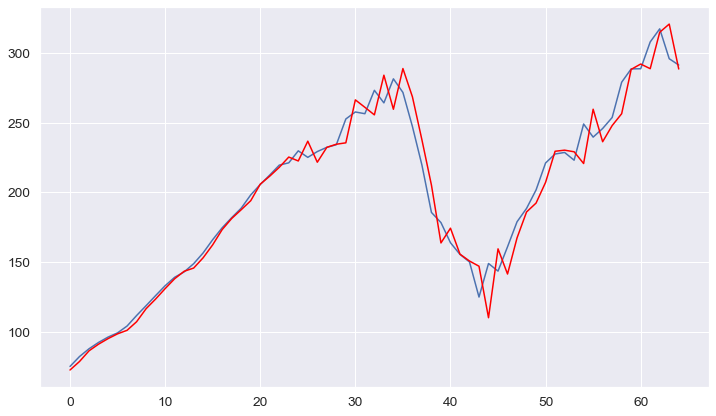

-----------------------------------------------------------------------
Kenya
predicted=7.363316, expected=9.155000
predicted=9.314864, expected=8.120000
predicted=8.159214, expected=9.896000
predicted=9.644456, expected=10.029000
predicted=10.014596, expected=10.391000
predicted=10.352669, expected=9.237000
predicted=9.381697, expected=7.819000
predicted=7.880176, expected=6.587000
predicted=6.545985, expected=7.439000
predicted=7.430608, expected=8.338000
predicted=8.355687, expected=9.336000
predicted=9.388067, expected=9.541000
predicted=9.552813, expected=9.911000
predicted=9.933293, expected=11.966000
predicted=12.144150, expected=11.745000
predicted=11.731411, expected=12.928000
predicted=12.991105, expected=11.988000
predicted=11.970689, expected=12.770000
predicted=12.767538, expected=13.773000
predicted=13.792081, expected=16.301000
predicted=16.522874, expected=17.156000
predicted=17.262886, expected=16.322000
predicted=16.233092, expected=18.016000
predicted=18.139763, expe

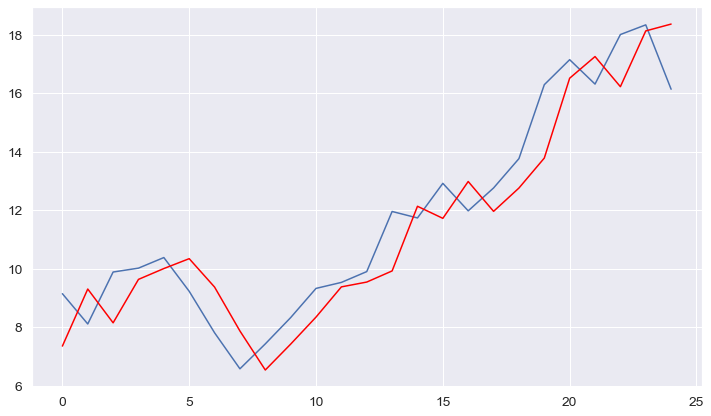

-----------------------------------------------------------------------
Kiribati
predicted=0.029000, expected=0.033000
predicted=0.032041, expected=0.029000
predicted=0.030006, expected=0.040000
predicted=0.036924, expected=0.044000
predicted=0.043084, expected=0.048000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.047135, expected=0.059000
predicted=0.056953, expected=0.066000
predicted=0.065109, expected=0.059000
predicted=0.060063, expected=0.066000
predicted=0.064775, expected=0.055000
predicted=0.057335, expected=0.059000
predicted=0.058113, expected=0.055000
predicted=0.055912, expected=0.051000
predicted=0.051872, expected=0.051000
predicted=0.051000, expected=0.059000
predicted=0.057269, expected=0.055000
predicted=0.055900, expected=0.055000
predicted=0.055000, expected=0.066000
predicted=0.063543, expected=0.066000
predicted=0.066000, expected=0.068000
predicted=0.067578, expected=0.068000
Test RMSE: 0.006


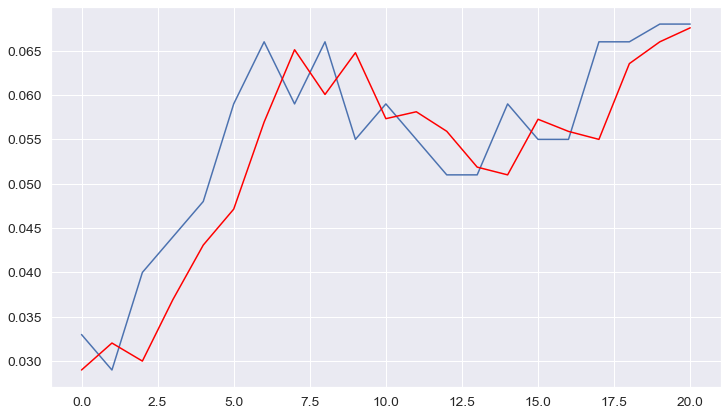

-----------------------------------------------------------------------
Kosovo
predicted=7.536863, expected=8.860000
predicted=8.785869, expected=8.094000
predicted=8.287894, expected=8.149000
predicted=8.136460, expected=9.100000
predicted=8.899219, expected=7.890000
Test RMSE: 0.916


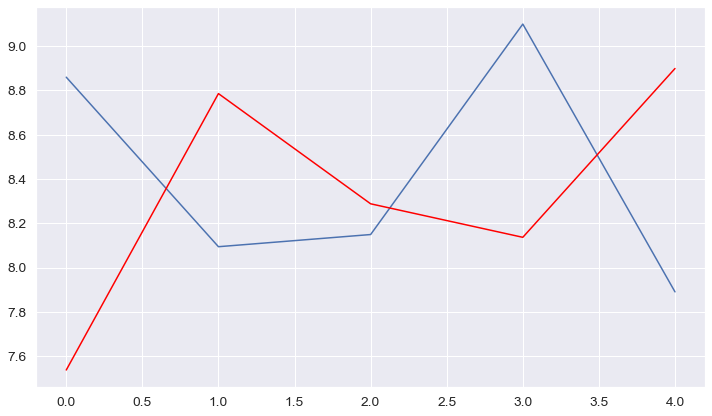

-----------------------------------------------------------------------
Kuwait
predicted=55.577353, expected=54.590000
predicted=54.555415, expected=49.914000
predicted=49.652178, expected=54.671000
predicted=54.877441, expected=51.560000
predicted=51.451043, expected=53.823000
predicted=53.893452, expected=53.385000
predicted=53.371625, expected=57.485000
predicted=57.606323, expected=57.981000
predicted=57.996080, expected=59.624000
predicted=59.674663, expected=63.109000
predicted=63.226755, expected=71.166000
predicted=71.553853, expected=73.390000
predicted=73.513612, expected=74.875000
predicted=74.959811, expected=82.297000
predicted=82.761198, expected=86.955000
predicted=87.316937, expected=89.272000
predicted=89.462241, expected=86.263000
predicted=86.026621, expected=100.074000
predicted=100.878774, expected=81.704000
predicted=82.762850, expected=75.482000
predicted=75.523560, expected=91.349000
predicted=90.657069, expected=100.859000
predicted=100.971852, expected=95.1450

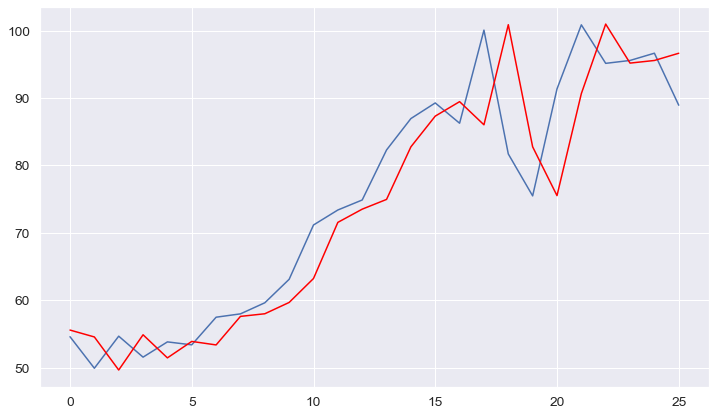

-----------------------------------------------------------------------
Kuwaiti Oil Fires
predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=477.925000, expected=477.925000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=477.925000, expected=477.925000
predicted=477.925000, expected=477.925000
Test RMSE: 0.000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


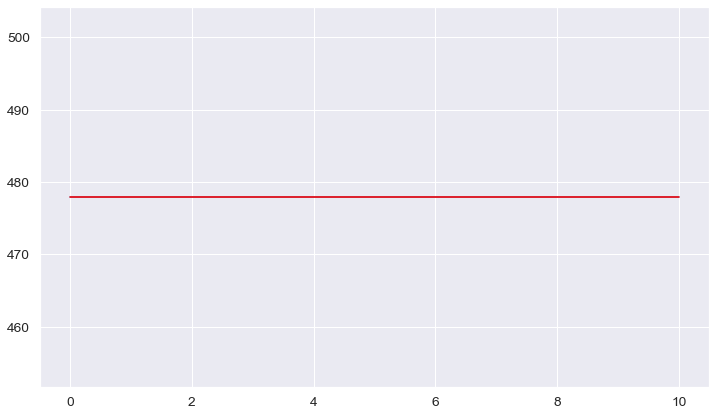

-----------------------------------------------------------------------
Kyrgyzstan
predicted=6.428541, expected=6.656000
predicted=6.970129, expected=7.284000
predicted=7.644646, expected=7.776000
predicted=8.066349, expected=8.178000
predicted=8.419295, expected=8.517000
predicted=8.722858, expected=8.785000
predicted=8.948736, expected=9.222000
predicted=9.494470, expected=9.888000
predicted=10.322185, expected=10.514000
predicted=10.934453, expected=11.153000
predicted=11.594869, expected=11.780000
predicted=12.223714, expected=12.318000
predicted=12.702868, expected=12.664000
predicted=12.910626, expected=13.188000
predicted=13.567653, expected=13.878000
predicted=14.391177, expected=14.733000
predicted=15.391322, expected=15.506000
predicted=16.108996, expected=16.168000
predicted=16.687351, expected=16.791000
predicted=17.283732, expected=17.655000
predicted=18.356008, expected=18.323000
predicted=18.863424, expected=18.936000
predicted=19.434331, expected=19.577000
predicted=20.

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=6.270979, expected=8.502000
predicted=6.377994, expected=6.147000
predicted=4.185884, expected=4.512000
predicted=3.168206, expected=5.664000
predicted=6.545060, expected=5.575000
predicted=5.508290, expected=5.915000
predicted=6.169681, expected=4.648000
predicted=3.708172, expected=4.602000
predicted=4.568573, expected=3.861000
predicted=3.322243, expected=4.921000
predicted=5.674848, expected=5.382000
predicted=5.707999, expected=5.808000
predicted=6.109512, expected=5.515000
predicted=5.308586, expected=5.419000
predicted=5.351408, expected=6.519000
predicted=7.291772, expected=7.547000
predicted=8.272879, expected=6.737000
predicted=6.181278, expected=6.314000
predicted=6.024349, expected=7.554000
predicted=8.392881, expected=9.998000
predicted=11.710225, expected=9.658000
predicted=9.439282, expected=10.095000
predicted=10.375005, expected=10.279000
predicted=10.396812, expected=9.646000
predicted=9.241704, expected=9.348000
predicted=9.157889, expected=11.698000
predic

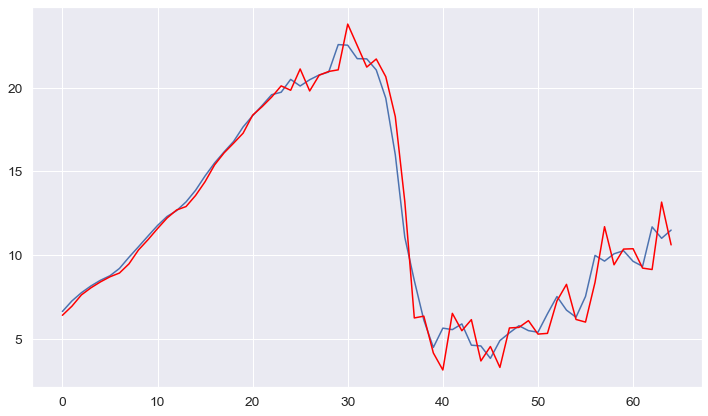

-----------------------------------------------------------------------
Laos
predicted=0.790922, expected=0.820000
predicted=0.819395, expected=0.846000
predicted=0.845503, expected=0.960000
predicted=0.958942, expected=1.063000
predicted=1.065919, expected=1.166000
predicted=1.172065, expected=1.221000
predicted=1.225049, expected=1.282000
predicted=1.287044, expected=1.337000
predicted=1.342029, expected=1.757000
predicted=1.822004, expected=1.835000
predicted=1.847875, expected=2.131000
predicted=2.191849, expected=2.667000
predicted=2.895202, expected=3.005000
predicted=3.170310, expected=3.170000
predicted=3.250707, expected=3.398000
predicted=3.514659, expected=4.261000
predicted=4.823677, expected=4.450000
predicted=4.541241, expected=9.232000
predicted=12.537588, expected=14.806000
predicted=20.153031, expected=18.661000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=22.008690, expected=19.524000
predicted=20.164549, expected=33.932000
predicted=45.576623, expected=33.847000
Test RMSE: 3.978


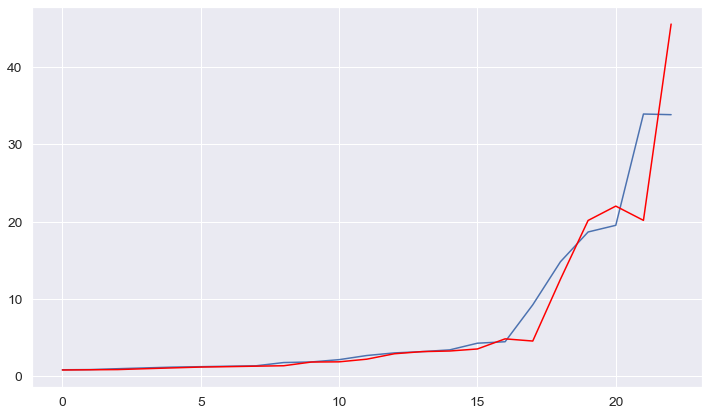

-----------------------------------------------------------------------
Latvia
predicted=7.252428, expected=7.516000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=7.866448, expected=8.226000
predicted=8.629311, expected=8.782000
predicted=9.106893, expected=9.234000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=9.502712, expected=9.617000
predicted=9.847456, expected=9.921000
predicted=10.105097, expected=10.417000
predicted=10.723671, expected=11.174000
predicted=11.663898, expected=11.885000
predicted=12.359483, expected=12.609000
predicted=13.106716, expected=13.318000
predicted=13.816990, expected=13.930000
predicted=14.365703, expected=14.326000
predicted=14.607000, expected=14.922000
predicted=15.352021, expected=15.698000
predicted=16.272641, expected=16.666000
predicted=17.408480, expected=17.546000
predicted=18.230405, expected=18.298000
predicted=18.886257, expected=19.008000
predicted=19.568117, expected=19.990000
predicted=20.784982, expected=20.761000
predicted=21.384019, expected=21.470000
predicted=22.045877, expected=22.212000
predicted=22.819967, expected=22.394000
predicted=22.539732, expected=23.275000
predicted=23.986937, expected=22.847000
predicted=22.525617, expected=23.277000
predicted=23.592040, expected=23.615000
predicted=23.862831, expected=23.829000
pred

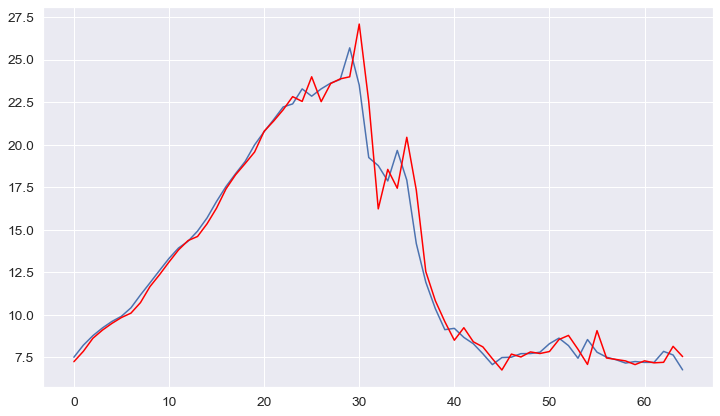

-----------------------------------------------------------------------
Lebanon
predicted=7.708419, expected=7.868000
predicted=7.863805, expected=8.115000
predicted=8.108713, expected=9.727000
predicted=9.739778, expected=10.355000
predicted=10.402449, expected=11.111000
predicted=11.190456, expected=12.255000
predicted=12.434004, expected=12.753000
predicted=12.841653, expected=15.099000
predicted=15.667268, expected=16.286000
predicted=16.648974, expected=16.430000
predicted=16.472499, expected=15.466000
predicted=15.187369, expected=16.407000
predicted=16.634928, expected=16.244000
predicted=16.206813, expected=18.529000
predicted=19.015792, expected=17.208000
predicted=17.100644, expected=16.650000
predicted=16.594618, expected=14.792000
predicted=14.551975, expected=13.746000
predicted=13.568482, expected=17.418000
predicted=17.651265, expected=20.958000
predicted=22.011340, expected=19.997000
predicted=19.817471, expected=20.264000
predicted=20.312131, expected=22.332000
predict

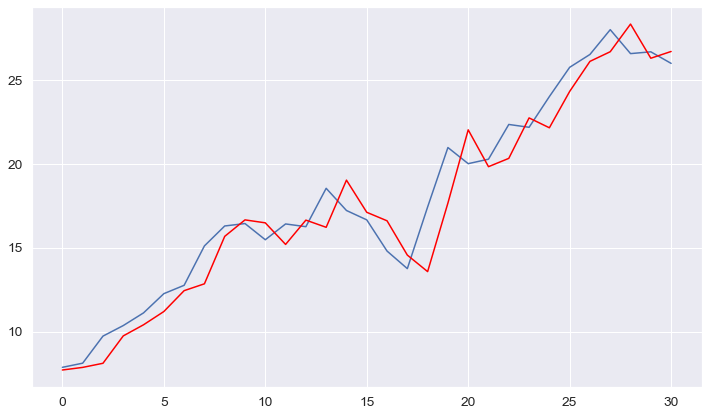

-----------------------------------------------------------------------
Leeward Islands
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
predicted=0.029500, expected=0.029500


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.029500, expected=0.029500
Test RMSE: 0.000


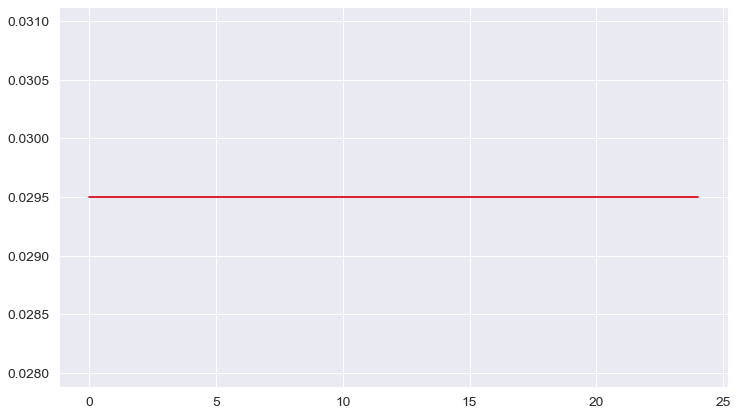

-----------------------------------------------------------------------
Lesotho


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.307018, expected=2.275000
predicted=2.329323, expected=3.063000
predicted=3.671975, expected=3.092000
predicted=3.096261, expected=2.334000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.249977, expected=2.473000
predicted=2.470119, expected=2.242000
predicted=2.252413, expected=2.213000
predicted=2.214114, expected=2.455000
predicted=2.444455, expected=2.583000
predicted=2.580457, expected=2.321000
predicted=2.332288, expected=2.183000
Test RMSE: 0.396


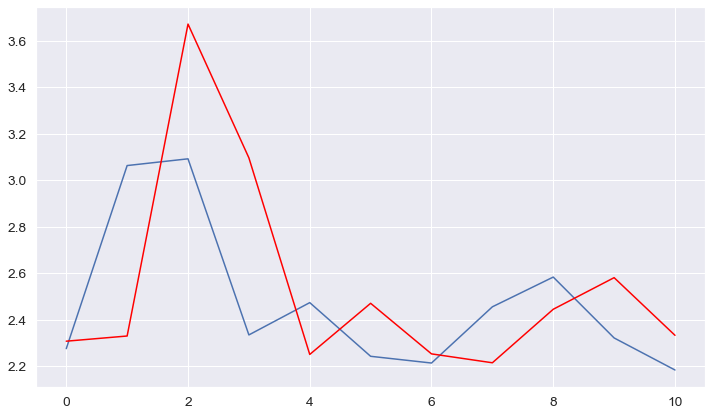

-----------------------------------------------------------------------
Liberia
predicted=0.423000, expected=0.435000
predicted=0.436099, expected=0.454000
predicted=0.455742, expected=0.484000
predicted=0.486758, expected=0.391000
predicted=0.382551, expected=0.421000
predicted=0.423685, expected=0.447000
predicted=0.449335, expected=0.436000
predicted=0.435013, expected=0.468000
predicted=0.470867, expected=0.546000
predicted=0.553063, expected=0.654000
predicted=0.664110, expected=0.673000
predicted=0.674786, expected=0.629000
predicted=0.624877, expected=0.534000
predicted=0.524950, expected=0.474000
predicted=0.468172, expected=0.761000
predicted=0.786943, expected=0.852000
predicted=0.860858, expected=0.963000
predicted=0.974188, expected=0.878000
predicted=0.869764, expected=1.192000
predicted=1.219256, expected=1.204000
predicted=1.205021, expected=1.357000
predicted=1.370124, expected=1.232000
predicted=1.222205, expected=1.085000
predicted=1.072598, expected=1.093000
predicte

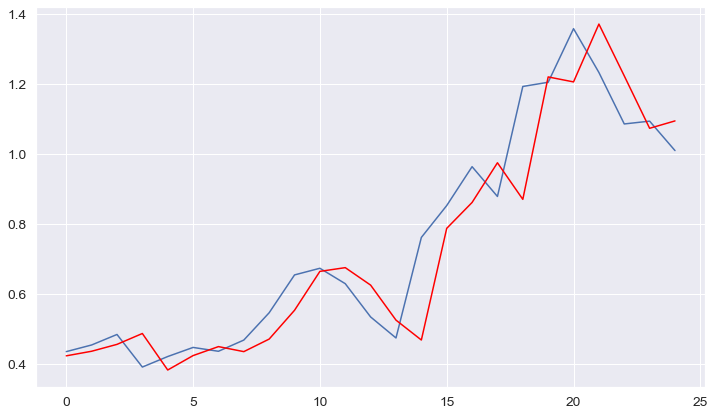

-----------------------------------------------------------------------
Libya
predicted=46.525274, expected=44.514000
predicted=44.012310, expected=45.506000
predicted=45.927337, expected=45.808000
predicted=45.936283, expected=45.055000
predicted=44.735253, expected=47.515000
predicted=48.553785, expected=48.463000
predicted=48.863219, expected=48.186000
predicted=48.069223, expected=49.474000
predicted=50.016574, expected=50.629000
predicted=51.116757, expected=56.989000
predicted=59.722972, expected=53.256000
predicted=51.821151, expected=49.977000
predicted=48.691881, expected=53.591000
predicted=54.944855, expected=53.121000
predicted=52.948172, expected=60.653000
predicted=63.391247, expected=49.212000
predicted=46.282920, expected=51.647000
predicted=52.138388, expected=41.914000
predicted=40.165155, expected=71.390000
predicted=69.437417, expected=58.184000
predicted=61.127513, expected=53.485000
predicted=54.325513, expected=54.399000
predicted=54.235340, expected=53.362000
pr

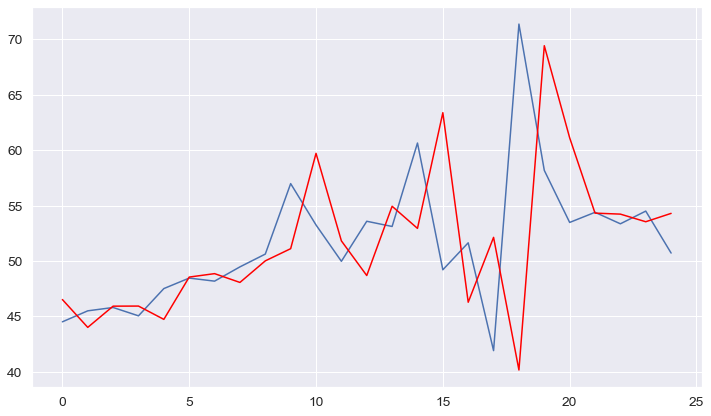

-----------------------------------------------------------------------
Liechtenstein
predicted=0.210352, expected=0.191000
predicted=0.194648, expected=0.177000
predicted=0.179220, expected=0.185000
predicted=0.183484, expected=0.192000
predicted=0.190863, expected=0.161000
predicted=0.168167, expected=0.160000
predicted=0.160170, expected=0.150000
predicted=0.151627, expected=0.155000
predicted=0.154122, expected=0.142000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.144432, expected=0.148000
predicted=0.146803, expected=0.141000
Test RMSE: 0.014


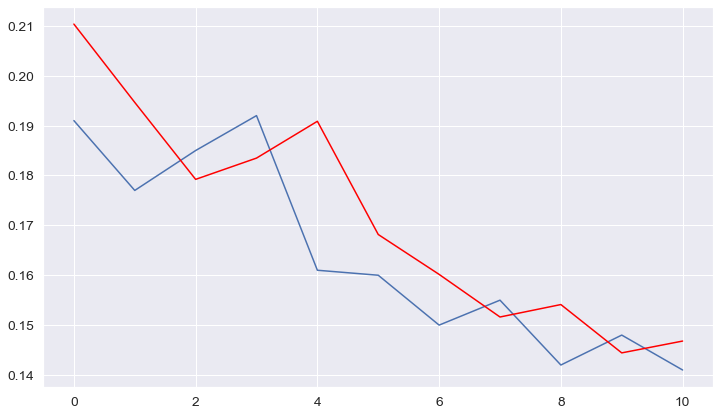

-----------------------------------------------------------------------
Lithuania
predicted=11.193960, expected=11.608000
predicted=12.156741, expected=12.704000
predicted=13.329614, expected=13.564000
predicted=14.068873, expected=14.259000
predicted=14.673877, expected=14.846000
predicted=15.200534, expected=15.321000
predicted=15.609830, expected=16.098000
predicted=16.580617, expected=17.279000
predicted=18.047352, expected=18.386000
predicted=19.128616, expected=19.506000
predicted=20.279560, expected=20.603000
predicted=21.378457, expected=21.565000
predicted=22.253397, expected=22.193000
predicted=22.640925, expected=23.131000
predicted=23.811552, expected=24.340000
predicted=25.240218, expected=25.880000
predicted=27.069794, expected=27.281000
predicted=28.378625, expected=28.491000
predicted=29.444974, expected=29.637000
predicted=30.548482, expected=31.203000
predicted=32.481822, expected=32.423000
predicted=33.416337, expected=33.555000
predicted=34.481615, expected=34.74900

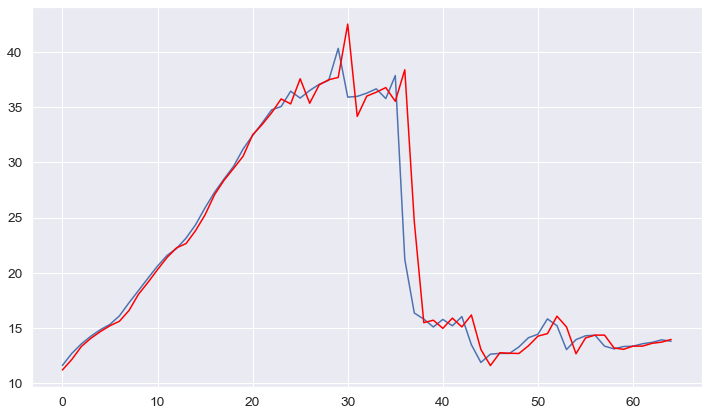

-----------------------------------------------------------------------
Low-income countries
predicted=162.842778, expected=168.651000
predicted=168.484194, expected=169.069000
predicted=169.057196, expected=182.697000
predicted=182.334711, expected=197.158000
predicted=197.570117, expected=205.873000
predicted=206.391223, expected=219.824000
predicted=221.066271, expected=244.312000
predicted=248.399035, expected=272.837000
predicted=281.169886, expected=282.294000
predicted=285.111310, expected=194.393000
predicted=181.714928, expected=192.489000
predicted=192.348049, expected=177.250000
predicted=176.089484, expected=169.556000
predicted=168.914160, expected=162.890000
predicted=162.311442, expected=155.050000
predicted=154.342007, expected=147.967000
predicted=147.301841, expected=146.177000
predicted=146.007859, expected=144.847000
predicted=144.721113, expected=154.523000
predicted=155.429917, expected=159.542000
predicted=160.026665, expected=162.955000
predicted=163.288183, exp

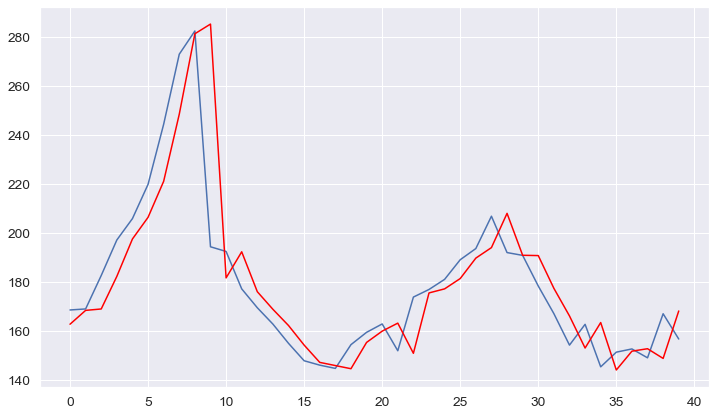

-----------------------------------------------------------------------
Lower-middle-income countries
predicted=434.655877, expected=450.586000
predicted=464.241258, expected=490.124000
predicted=506.876301, expected=523.309000
predicted=538.300645, expected=548.971000
predicted=560.938745, expected=590.440000
predicted=611.032095, expected=615.455000
predicted=628.049111, expected=649.725000
predicted=667.656383, expected=698.170000
predicted=725.284280, expected=738.738000
predicted=762.297558, expected=799.358000
predicted=837.334286, expected=852.733000
predicted=887.534715, expected=880.599000
predicted=898.507461, expected=934.910000
predicted=971.170430, expected=979.086000
predicted=1009.020246, expected=1046.759000
predicted=1095.085807, expected=1120.179000
predicted=1175.084007, expected=1191.580000
predicted=1246.519777, expected=1283.895000
predicted=1358.899294, expected=1337.706000
predicted=1379.928441, expected=1385.254000
predicted=1422.750424, expected=1463.333000
pr

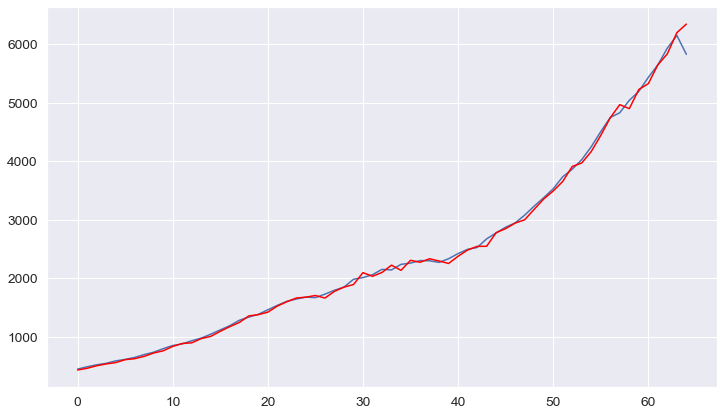

-----------------------------------------------------------------------
Luxembourg
predicted=11.374155, expected=9.152000
predicted=8.608698, expected=9.202000
predicted=9.212596, expected=8.554000
predicted=8.416874, expected=7.676000
predicted=7.485574, expected=8.128000
predicted=8.223307, expected=8.710000
predicted=8.834131, expected=9.207000
predicted=9.314190, expected=9.984000
predicted=10.154384, expected=10.459000
predicted=10.564385, expected=11.829000
predicted=12.141682, expected=12.087000
predicted=12.145700, expected=11.920000
predicted=11.882096, expected=11.317000
predicted=11.179518, expected=11.184000
predicted=11.153673, expected=10.638000
predicted=10.513085, expected=11.207000
predicted=11.334968, expected=11.102000
predicted=11.078524, expected=10.866000
predicted=10.813169, expected=10.321000
predicted=10.198322, expected=9.836000
predicted=9.725823, expected=9.348000
predicted=9.236204, expected=9.093000
predicted=9.034388, expected=9.261000
predicted=9.299522,

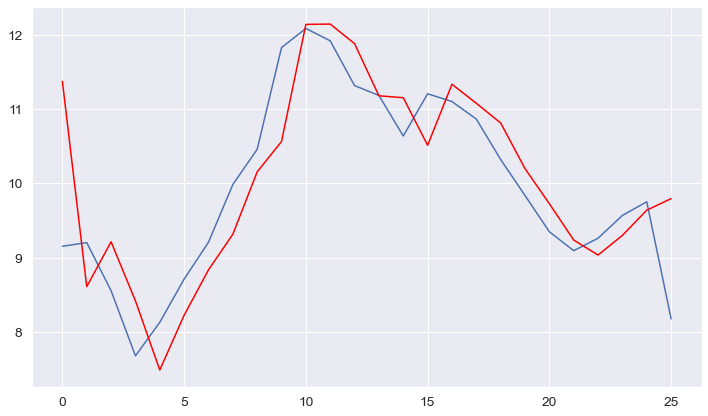

-----------------------------------------------------------------------
Macao
predicted=1.493464, expected=1.557000
predicted=1.563433, expected=1.517000
predicted=1.513895, expected=1.630000
predicted=1.636215, expected=1.685000
predicted=1.689411, expected=1.517000
predicted=1.510576, expected=1.532000
predicted=1.532354, expected=1.715000
predicted=1.721357, expected=1.828000
predicted=1.839587, expected=1.619000
predicted=1.614993, expected=1.363000
predicted=1.318922, expected=1.132000
predicted=1.065328, expected=1.891000
predicted=1.799488, expected=1.235000
predicted=1.578706, expected=1.456000
predicted=1.352001, expected=1.291000
predicted=1.370099, expected=1.204000
predicted=1.244191, expected=1.508000
predicted=1.363256, expected=2.028000
predicted=1.844016, expected=1.770000
predicted=1.866401, expected=1.920000
predicted=1.862912, expected=1.216000
predicted=1.516315, expected=1.256000
predicted=1.241819, expected=1.263000
Test RMSE: 0.316


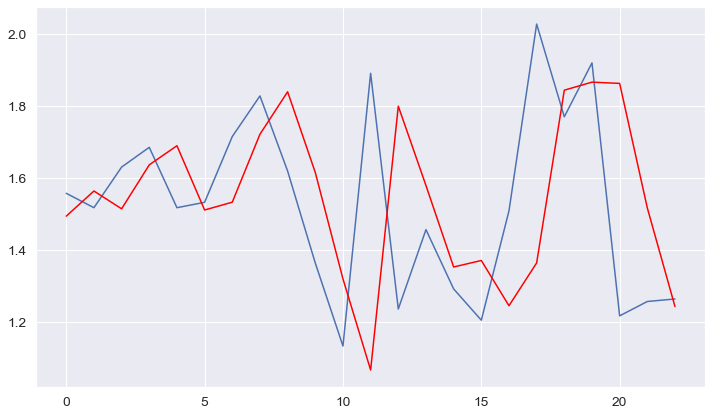

-----------------------------------------------------------------------
Madagascar
predicted=0.929066, expected=1.010000
predicted=0.991335, expected=0.981000
predicted=0.987779, expected=1.006000
predicted=1.000148, expected=1.247000
predicted=1.191292, expected=1.288000
predicted=1.278953, expected=1.341000
predicted=1.329364, expected=1.623000
predicted=1.563094, expected=1.711000
predicted=1.693905, expected=1.818000
predicted=1.797719, expected=1.867000
predicted=1.857868, expected=1.736000
predicted=1.760755, expected=1.232000
predicted=1.312133, expected=1.681000
predicted=1.577418, expected=1.790000
predicted=1.768580, expected=1.727000
predicted=1.739484, expected=1.667000
predicted=1.678794, expected=1.724000
predicted=1.712739, expected=1.780000
predicted=1.769011, expected=1.706000
predicted=1.720616, expected=1.872000
predicted=1.838551, expected=2.381000
predicted=2.294636, expected=2.748000
predicted=2.713001, expected=3.215000
predicted=3.197001, expected=3.162000
predi

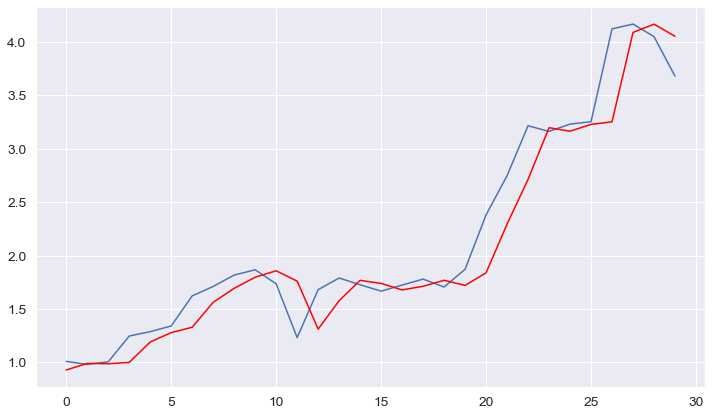

-----------------------------------------------------------------------
Malawi
predicted=0.907443, expected=0.905000
predicted=0.904779, expected=0.947000
predicted=0.951620, expected=0.923000
predicted=0.920614, expected=0.922000
predicted=0.921901, expected=0.865000
predicted=0.859320, expected=0.791000
predicted=0.781163, expected=0.846000
predicted=0.851153, expected=0.903000
predicted=0.909639, expected=0.912000
predicted=0.913058, expected=0.905000
predicted=0.904182, expected=0.917000
predicted=0.918396, expected=0.969000
predicted=0.975379, expected=1.087000
predicted=1.106762, expected=1.093000
predicted=1.093937, expected=1.025000
predicted=1.014577, expected=1.140000
predicted=1.151006, expected=1.132000
predicted=1.131343, expected=1.163000
predicted=1.165498, expected=1.021000
predicted=1.013473, expected=1.120000
predicted=1.117045, expected=1.306000
predicted=1.318535, expected=1.364000
predicted=1.370070, expected=1.570000
predicted=1.601445, expected=1.588000
predicted

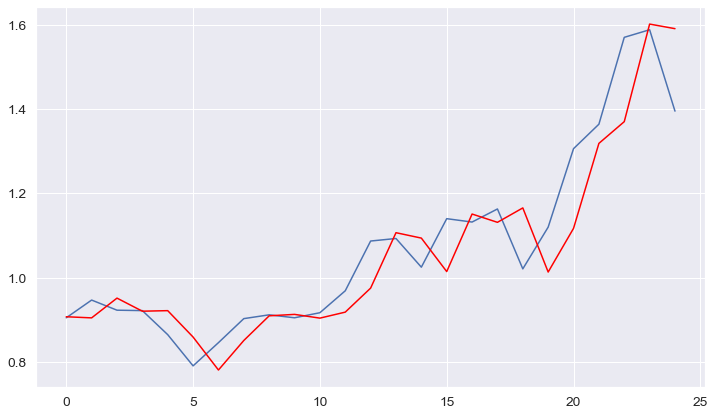

-----------------------------------------------------------------------
Malaysia
predicted=19.520972, expected=23.898000
predicted=24.823261, expected=22.621000
predicted=22.474934, expected=23.260000
predicted=23.327087, expected=27.306000
predicted=27.826067, expected=28.033000
predicted=28.131384, expected=30.878000
predicted=31.308534, expected=30.642000
predicted=30.609666, expected=38.048000
predicted=38.960380, expected=34.794000
predicted=34.927948, expected=36.330000
predicted=36.231448, expected=40.102000
predicted=39.971774, expected=40.878000
predicted=40.863538, expected=42.869000
predicted=42.846266, expected=50.084000
predicted=50.474095, expected=54.269000
predicted=54.915787, expected=65.785000
predicted=69.354509, expected=72.961000
predicted=75.885427, expected=86.719000
predicted=94.532199, expected=90.631000
predicted=92.540190, expected=113.934000
predicted=128.002256, expected=113.442000
predicted=113.279957, expected=122.085000
predicted=124.899647, expected=114

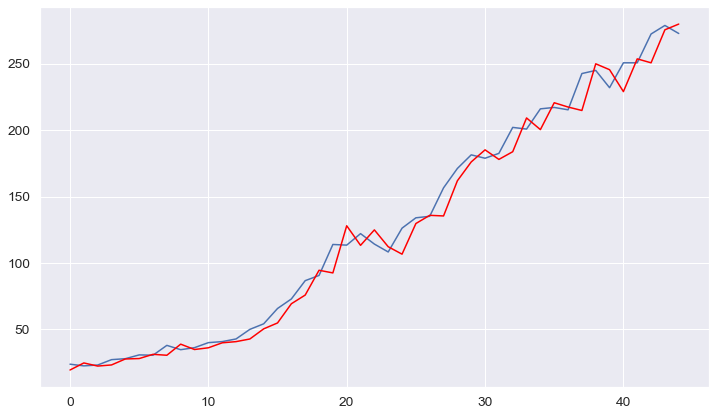

-----------------------------------------------------------------------
Maldives
predicted=0.522362, expected=0.667000
predicted=0.604239, expected=0.601000
predicted=0.627141, expected=0.758000
predicted=0.681723, expected=0.780000
predicted=0.772187, expected=0.843000
predicted=0.821471, expected=0.883000
predicted=0.870599, expected=0.934000
predicted=0.919239, expected=0.986000
predicted=0.972357, expected=1.110000
predicted=1.084445, expected=1.092000
predicted=1.095594, expected=1.315000
predicted=1.264748, expected=1.312000
predicted=1.312514, expected=1.436000
predicted=1.414527, expected=1.513000
predicted=1.504130, expected=1.740000
predicted=1.732733, expected=1.794000
predicted=1.795121, expected=1.796000
Test RMSE: 0.113


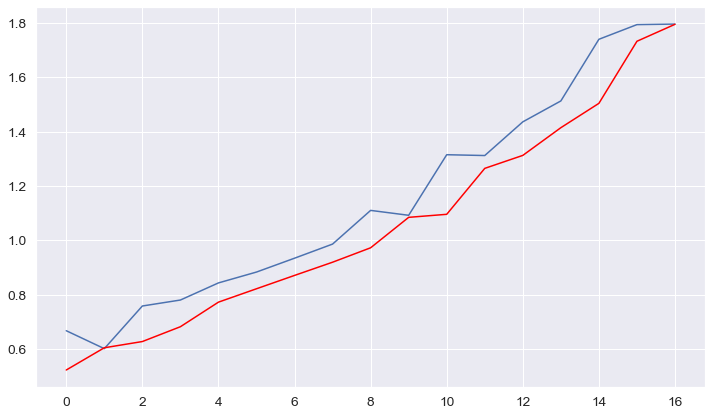

-----------------------------------------------------------------------
Mali
predicted=1.061296, expected=0.971000
predicted=0.986138, expected=1.066000
predicted=1.107879, expected=1.161000
predicted=1.207625, expected=1.209000
predicted=1.232626, expected=1.246000
predicted=1.264435, expected=1.407000
predicted=1.494213, expected=1.455000
predicted=1.478855, expected=1.535000
predicted=1.576265, expected=1.788000
predicted=1.945329, expected=1.957000
predicted=2.064431, expected=1.887000
predicted=1.851174, expected=2.088000
predicted=2.177379, expected=2.279000
predicted=2.377508, expected=2.437000
predicted=2.523662, expected=2.743000
predicted=2.939706, expected=3.099000
predicted=3.364623, expected=3.271000
predicted=3.389776, expected=3.329000
predicted=3.368084, expected=3.534000
predicted=3.675132, expected=3.660000
predicted=3.746184, expected=3.688000
predicted=3.706854, expected=3.390000
Test RMSE: 0.136


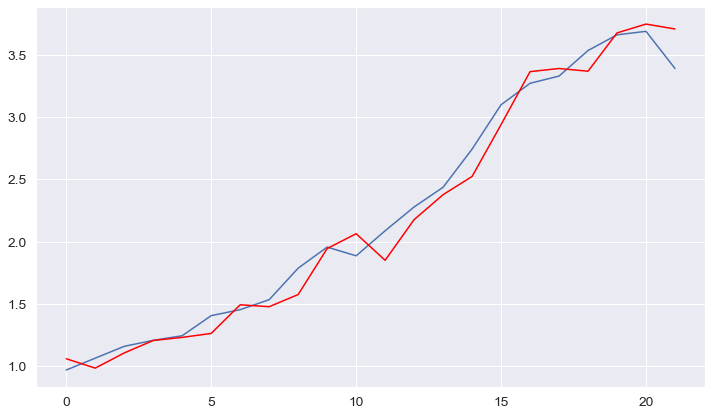

-----------------------------------------------------------------------
Malta
predicted=2.476627, expected=2.578000
predicted=2.566656, expected=2.586000
predicted=2.585245, expected=2.545000
predicted=2.548882, expected=2.628000
predicted=2.619927, expected=2.546000
predicted=2.554372, expected=2.665000
predicted=2.652007, expected=2.707000
predicted=2.702625, expected=2.979000
predicted=2.953114, expected=2.846000
predicted=2.861480, expected=2.654000
predicted=2.672538, expected=2.666000
predicted=2.664852, expected=2.738000
predicted=2.731153, expected=2.747000
predicted=2.746151, expected=2.533000
predicted=2.553469, expected=2.580000
predicted=2.575323, expected=2.577000
predicted=2.577298, expected=2.761000
predicted=2.742627, expected=2.444000
predicted=2.487120, expected=2.448000
predicted=2.447486, expected=1.741000
predicted=1.832588, expected=1.405000
predicted=1.400613, expected=1.559000
predicted=1.557294, expected=1.538000
predicted=1.538261, expected=1.669000
predicted=

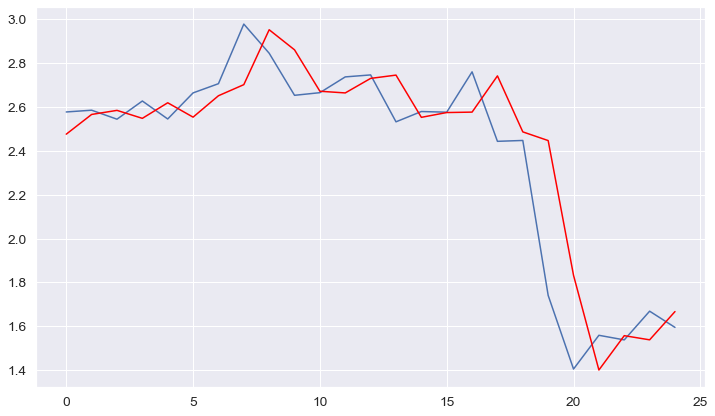

-----------------------------------------------------------------------
Marshall Islands
predicted=0.131507, expected=0.136000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.135635, expected=0.139000
predicted=0.138796, expected=0.136000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.136247, expected=0.139000
predicted=0.138712, expected=0.143000
predicted=0.142701, expected=0.143000
predicted=0.143000, expected=0.143000
predicted=0.143000, expected=0.147000
predicted=0.146708, expected=0.147000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.147000, expected=0.151000
predicted=0.150716, expected=0.151000
Test RMSE: 0.003


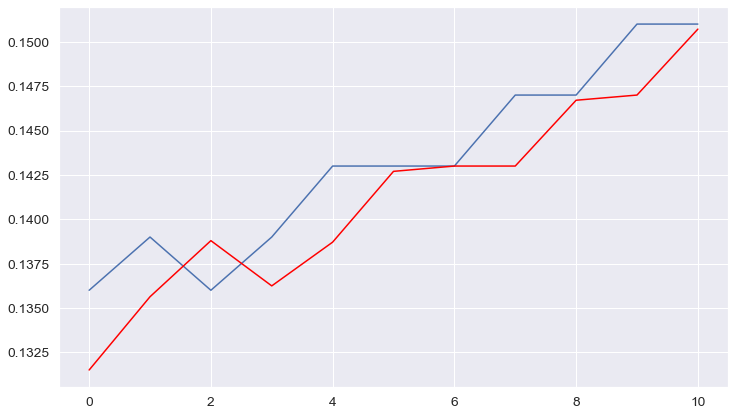

-----------------------------------------------------------------------
Martinique
predicted=2.020585, expected=2.001000
predicted=2.001388, expected=1.973000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.973524, expected=1.761000
predicted=1.763449, expected=1.898000
predicted=1.891859, expected=1.963000
predicted=1.960813, expected=2.003000
predicted=2.001779, expected=2.028000
predicted=2.027267, expected=2.181000
predicted=2.177189, expected=2.307000
predicted=2.306634, expected=2.441000
predicted=2.443133, expected=2.378000
predicted=2.377597, expected=2.147000
predicted=2.141966, expected=2.159000
predicted=2.159217, expected=2.298000
predicted=2.300755, expected=2.296000
predicted=2.295962, expected=2.303000
predicted=2.303134, expected=2.278000
predicted=2.277526, expected=2.232000
predicted=2.231075, expected=2.229000
predicted=2.228939, expected=2.264000
predicted=2.264704, expected=2.316000
predicted=2.317139, expected=2.273000
predicted=2.272157, expected=2.253000
predicted=2.252591, expected=2.348000
predicted=2.349760, expected=2.348000
Test RMSE: 0.095


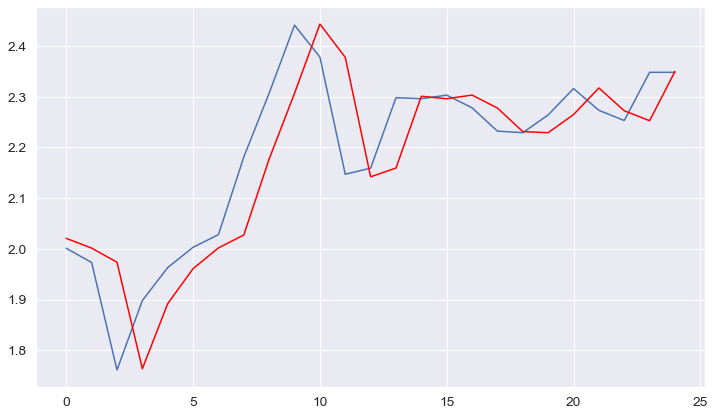

-----------------------------------------------------------------------
Mauritania
predicted=1.070075, expected=1.096000
predicted=1.095721, expected=1.114000
predicted=1.113807, expected=1.172000
predicted=1.171384, expected=1.249000
predicted=1.248208, expected=1.290000
predicted=1.289589, expected=1.385000
predicted=1.384076, expected=1.436000
predicted=1.435523, expected=1.422000
predicted=1.422132, expected=1.638000
predicted=1.635916, expected=1.773000
predicted=1.772010, expected=1.960000
predicted=1.958989, expected=1.960000
predicted=1.960000, expected=2.110000
predicted=2.109190, expected=2.330000
predicted=2.329388, expected=2.045000
predicted=2.047198, expected=2.499000
predicted=2.491023, expected=2.924000
predicted=2.922876, expected=2.535000
predicted=2.540833, expected=3.569000
predicted=3.522845, expected=3.668000
predicted=3.664601, expected=3.698000
predicted=3.696977, expected=3.377000
Test RMSE: 0.302


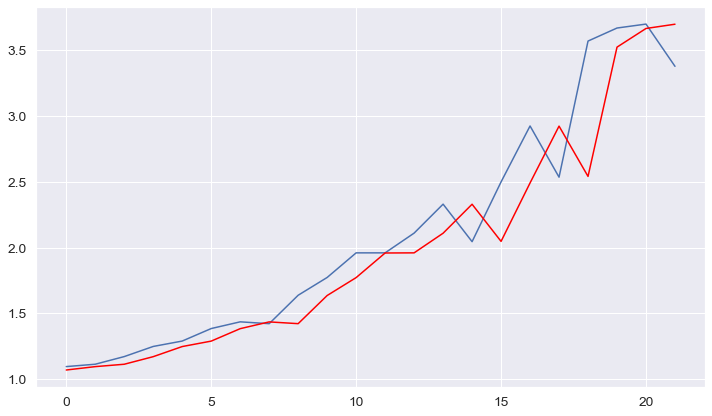

-----------------------------------------------------------------------
Mauritius
predicted=1.850366, expected=1.949000
predicted=1.966240, expected=1.997000
predicted=2.004130, expected=2.169000
predicted=2.196721, expected=2.426000
predicted=2.482858, expected=2.689000
predicted=2.766430, expected=2.862000
predicted=2.918423, expected=2.884000
predicted=2.891019, expected=3.059000
predicted=3.115595, expected=3.089000
predicted=3.098541, expected=3.294000
predicted=3.360568, expected=3.627000
predicted=3.755196, expected=3.686000
predicted=3.707376, expected=3.767000
predicted=3.796634, expected=3.708000
predicted=3.686827, expected=3.913000
predicted=3.983850, expected=3.917000
predicted=3.918331, expected=3.964000
predicted=3.979654, expected=4.067000
predicted=4.101707, expected=4.206000
predicted=4.254224, expected=4.210000
predicted=4.211366, expected=4.346000
predicted=4.392495, expected=4.536000
predicted=4.604271, expected=4.514000
predicted=4.506421, expected=4.378000
predic

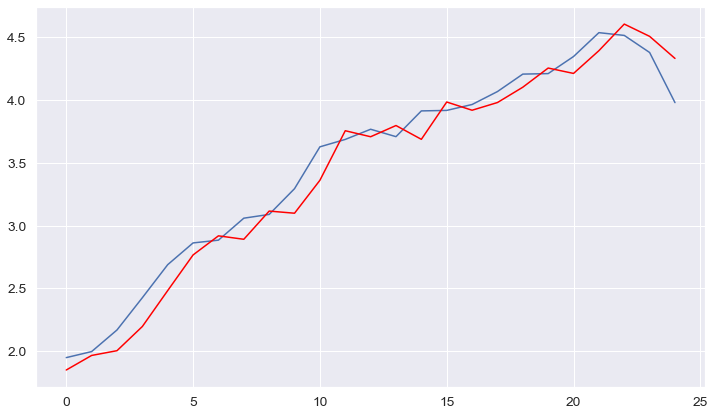

-----------------------------------------------------------------------
Mayotte
predicted=0.295477, expected=0.299000
predicted=0.302736, expected=0.300000
predicted=0.300619, expected=0.296000
predicted=0.293587, expected=0.290000
predicted=0.286357, expected=0.290000
predicted=0.290000, expected=0.295000
predicted=0.298020, expected=0.301000
predicted=0.304714, expected=0.296000
predicted=0.292968, expected=0.293000
predicted=0.291181, expected=0.306000
predicted=0.313745, expected=0.306000
Test RMSE: 0.006


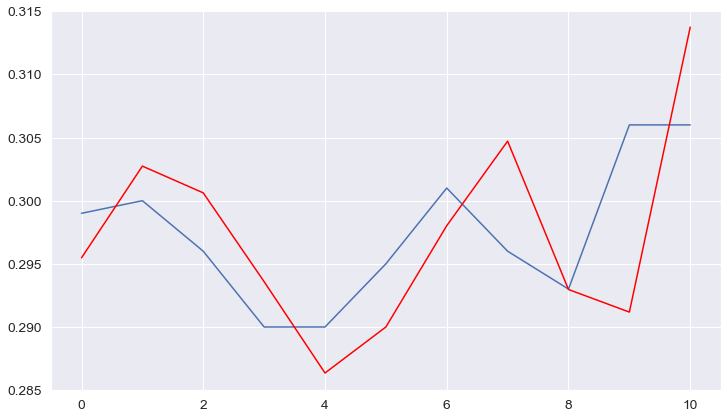

-----------------------------------------------------------------------
Mexico
predicted=170.504594, expected=183.740000
predicted=197.636381, expected=192.394000
predicted=198.314488, expected=222.116000
predicted=243.831914, expected=240.259000
predicted=253.142522, expected=267.744000
predicted=288.566349, expected=283.707000
predicted=295.462601, expected=303.905000
predicted=319.192527, expected=277.566000
predicted=260.912973, expected=276.649000
predicted=276.119625, expected=287.371000
predicted=293.545101, expected=293.412000
predicted=296.889875, expected=306.022000
predicted=313.371516, expected=305.666000
predicted=305.462911, expected=323.480000
predicted=333.622621, expected=317.042000
predicted=313.610296, expected=330.133000
predicted=336.938872, expected=332.780000
predicted=334.139073, expected=338.067000
predicted=340.788301, expected=351.528000
predicted=358.546673, expected=331.597000
predicted=322.055601, expected=345.766000
predicted=351.799568, expected=368.6450

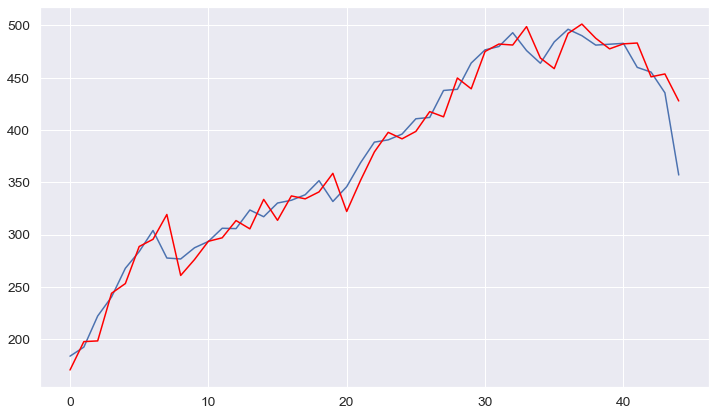

-----------------------------------------------------------------------
Micronesia (country)
predicted=0.124573, expected=0.103000
predicted=0.138715, expected=0.117000
predicted=0.107940, expected=0.125000
predicted=0.120174, expected=0.136000
predicted=0.129337, expected=0.136000
predicted=0.136000, expected=0.143000
predicted=0.138856, expected=0.143000
predicted=0.143000, expected=0.143000
predicted=0.143000, expected=0.143000
predicted=0.143000, expected=0.147000
predicted=0.144654, expected=0.148000
Test RMSE: 0.012


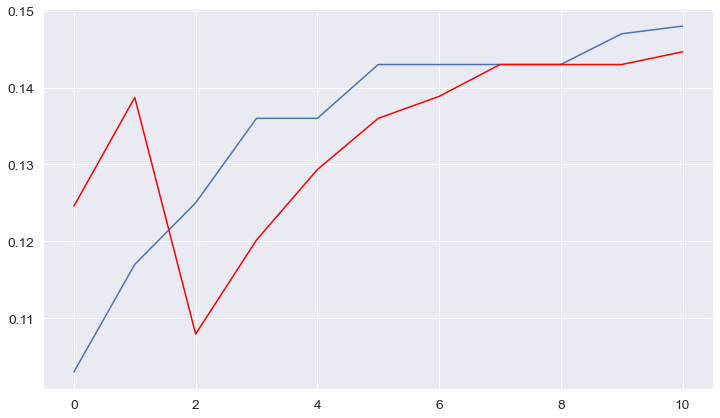

-----------------------------------------------------------------------
Moldova
predicted=11.758187, expected=12.175000
predicted=12.751764, expected=13.329000
predicted=13.993255, expected=14.235000
predicted=14.771048, expected=14.977000
predicted=15.423625, expected=15.608000
predicted=15.992420, expected=16.110000
predicted=16.417786, expected=16.926000
predicted=17.436949, expected=18.158000
predicted=18.965148, expected=19.317000
predicted=20.099406, expected=20.507000
predicted=21.334579, expected=21.674000
predicted=22.504714, expected=22.678000
predicted=23.400511, expected=23.328000
predicted=23.794033, expected=24.303000
predicted=25.013718, expected=25.578000
predicted=26.531874, expected=27.151000
predicted=28.368595, expected=28.576000
predicted=29.693186, expected=29.801000
predicted=30.766805, expected=30.956000
predicted=31.873958, expected=32.555000
predicted=33.858623, expected=33.805000
predicted=34.821510, expected=34.958000
predicted=35.900316, expected=36.156000


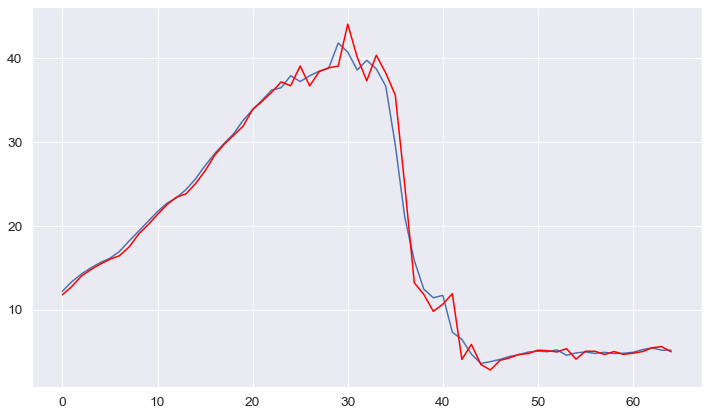

-----------------------------------------------------------------------
Mongolia
predicted=7.895679, expected=8.023000
predicted=8.037695, expected=7.688000
predicted=7.648858, expected=7.687000
predicted=7.686884, expected=7.535000
predicted=7.517301, expected=7.487000
predicted=7.481400, expected=7.870000
predicted=7.914415, expected=8.262000
predicted=8.309513, expected=8.008000
predicted=7.978372, expected=8.571000
predicted=8.633388, expected=8.574000
predicted=8.574329, expected=9.406000
predicted=9.497225, expected=12.079000
predicted=12.584322, expected=12.017000
predicted=12.008038, expected=13.074000
predicted=13.224691, expected=13.820000
predicted=13.939712, expected=21.426000
predicted=23.768552, expected=35.031000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=48.041314, expected=43.559000
predicted=50.456559, expected=29.586000
predicted=25.247580, expected=23.243000
predicted=20.954370, expected=25.327000
predicted=25.982002, expected=34.265000
predicted=37.325445, expected=47.537000
predicted=53.833733, expected=88.691000
predicted=125.618899, expected=88.442000
Test RMSE: 11.733


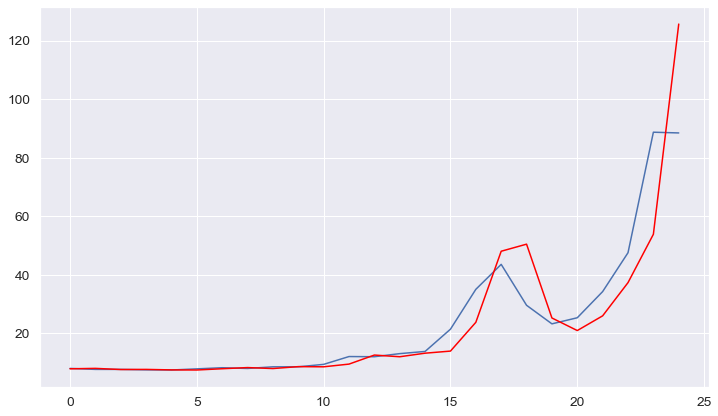

-----------------------------------------------------------------------
Montenegro
predicted=1.321931, expected=1.273000
predicted=1.274032, expected=1.329000
predicted=1.340637, expected=1.371000
predicted=1.380104, expected=1.333000
predicted=1.325155, expected=1.490000
predicted=1.517321, expected=1.621000
predicted=1.653582, expected=1.594000
predicted=1.588181, expected=1.735000
predicted=1.762703, expected=1.594000
predicted=1.579127, expected=1.716000
predicted=1.720325, expected=1.810000
predicted=1.816803, expected=1.846000
predicted=1.848933, expected=1.928000
predicted=1.935445, expected=1.882000
predicted=1.878473, expected=1.942000
predicted=1.946041, expected=1.936000
predicted=1.935604, expected=1.915000
predicted=1.913618, expected=1.355000
predicted=1.297885, expected=1.483000
predicted=1.475094, expected=1.294000
predicted=1.312414, expected=1.257000
predicted=1.260041, expected=1.327000
predicted=1.320995, expected=1.553000
predicted=1.538927, expected=1.670000
predi

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=2.264146, expected=2.645000
predicted=2.541247, expected=2.310000
Test RMSE: 0.248


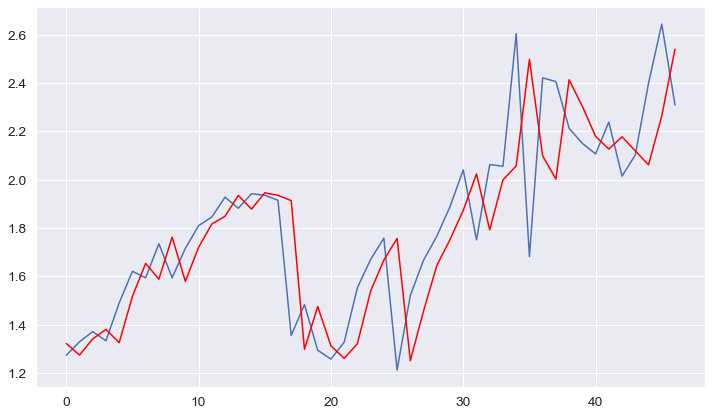

-----------------------------------------------------------------------
Montserrat
predicted=0.035998, expected=0.026000
predicted=0.028772, expected=0.026000
predicted=0.026000, expected=0.048000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.043348, expected=0.037000
predicted=0.040569, expected=0.048000
predicted=0.043769, expected=0.040000
predicted=0.043302, expected=0.040000
predicted=0.040000, expected=0.040000
predicted=0.040000, expected=0.048000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.044835, expected=0.044000
predicted=0.045599, expected=0.062000
predicted=0.054076, expected=0.040000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.052549, expected=0.044000
predicted=0.042028, expected=0.051000
predicted=0.047652, expected=0.048000
predicted=0.049432, expected=0.059000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.053623, expected=0.029000
predicted=0.046760, expected=0.029000
predicted=0.029000, expected=0.029000
predicted=0.029000, expected=0.029000
predicted=0.029000, expected=0.025000
Test RMSE: 0.011


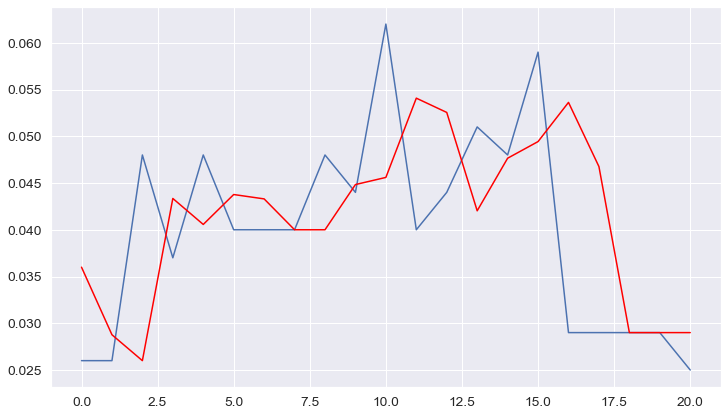

-----------------------------------------------------------------------
Morocco
predicted=21.249930, expected=22.661000
predicted=23.280058, expected=22.298000
predicted=22.186470, expected=23.688000
predicted=24.092237, expected=24.737000
predicted=25.068424, expected=26.779000
predicted=27.522764, expected=28.124000
predicted=28.654086, expected=28.750000
predicted=28.998650, expected=29.525000
predicted=29.838754, expected=29.978000
predicted=30.162543, expected=30.881000
predicted=31.255518, expected=31.986000
predicted=32.460487, expected=33.199000
predicted=33.741248, expected=36.806000
predicted=38.691991, expected=37.306000
predicted=37.526505, expected=36.570000
predicted=36.251186, expected=42.226000
predicted=44.255473, expected=44.661000
predicted=45.594105, expected=46.249000
predicted=46.882848, expected=48.913000
predicted=50.059283, expected=51.369000
predicted=52.503435, expected=50.860000
predicted=50.642600, expected=54.365000
predicted=55.802655, expected=54.868000


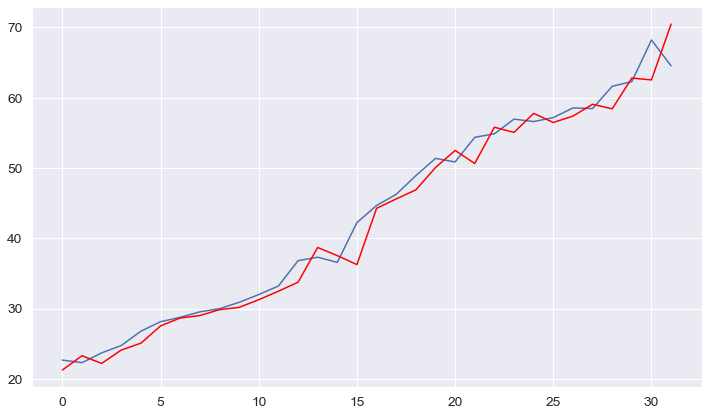

-----------------------------------------------------------------------
Mozambique
predicted=1.002170, expected=1.035000
predicted=1.031174, expected=0.989000
predicted=0.995080, expected=0.949000
predicted=0.954274, expected=1.038000
predicted=1.026213, expected=1.192000
predicted=1.171977, expected=1.080000
predicted=1.094827, expected=1.109000
predicted=1.105152, expected=1.092000
predicted=1.094257, expected=1.170000
predicted=1.159626, expected=1.112000
predicted=1.119751, expected=1.168000
predicted=1.160489, expected=1.322000
predicted=1.301572, expected=1.554000
predicted=1.524701, expected=1.537000
predicted=1.539139, expected=1.856000
predicted=1.815577, expected=1.864000
predicted=1.863006, expected=1.770000
predicted=1.781694, expected=1.916000
predicted=1.897540, expected=2.189000
predicted=2.156333, expected=2.180000
predicted=2.181068, expected=2.439000
predicted=2.408172, expected=2.635000
predicted=2.613462, expected=3.107000
predicted=3.062212, expected=2.981000
predi

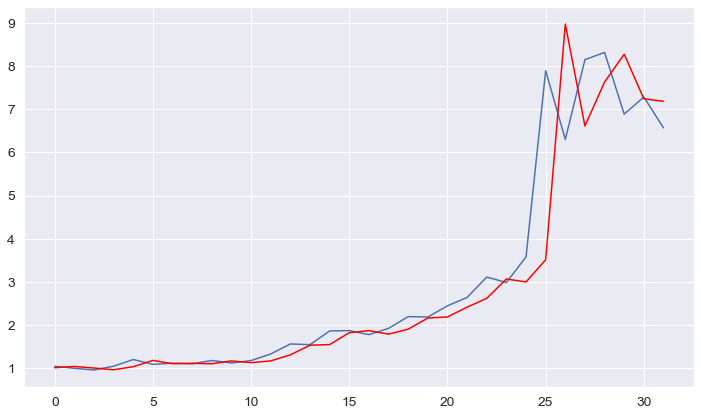

-----------------------------------------------------------------------
Myanmar
predicted=3.908465, expected=4.425000
predicted=4.486340, expected=4.236000
predicted=4.202667, expected=4.137000
predicted=4.119461, expected=4.842000
predicted=4.963804, expected=5.303000
predicted=5.389155, expected=6.196000
predicted=6.382150, expected=6.907000
predicted=7.073726, expected=7.203000
predicted=7.273895, expected=7.445000
predicted=7.503632, expected=8.036000
predicted=8.183265, expected=8.930000
predicted=9.173464, expected=10.044000
predicted=10.390973, expected=8.681000
predicted=8.380246, expected=9.154000
predicted=9.236606, expected=9.779000
predicted=9.895081, expected=12.370000
predicted=13.019130, expected=11.529000
predicted=11.425371, expected=12.779000
predicted=12.887121, expected=12.794000
predicted=12.795244, expected=9.722000
predicted=9.472417, expected=10.156000
predicted=10.169643, expected=13.083000
predicted=13.262003, expected=15.068000
predicted=15.394864, expected=1

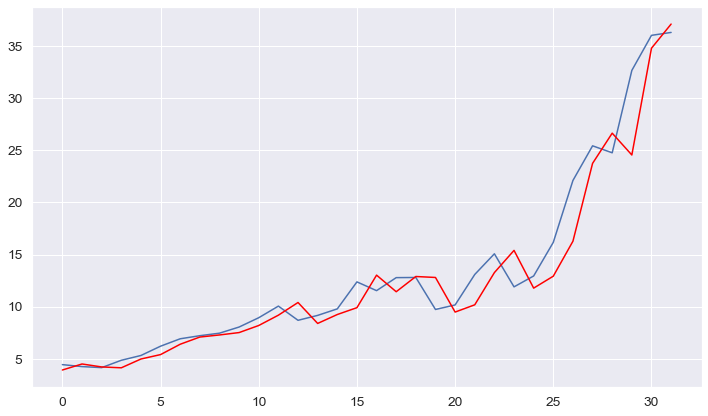

-----------------------------------------------------------------------
Namibia
predicted=3.110812, expected=3.085000
predicted=3.079393, expected=2.782000
predicted=2.842192, expected=3.355000
predicted=3.190138, expected=2.568000
predicted=2.926555, expected=3.678000
predicted=2.948849, expected=3.851000
predicted=3.779914, expected=4.051000
predicted=3.971077, expected=4.216000
predicted=4.151992, expected=4.077000
predicted=4.131413, expected=4.082000
predicted=4.080049, expected=3.877000
Test RMSE: 0.457


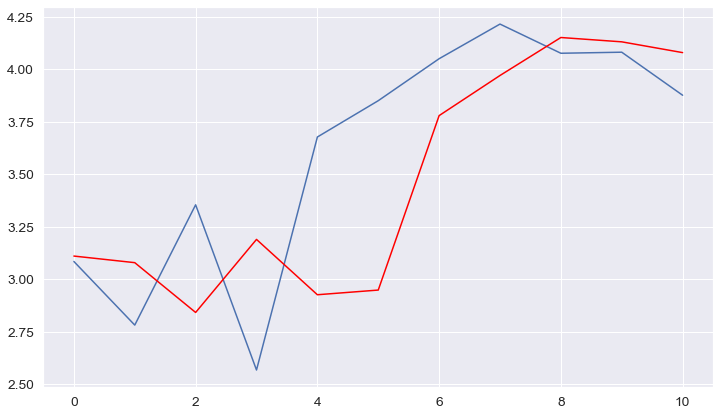

-----------------------------------------------------------------------
Nauru
predicted=0.084176, expected=0.081000
predicted=0.081048, expected=0.077000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.077053, expected=0.066000
predicted=0.066035, expected=0.066000
predicted=0.066000, expected=0.062000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.062013, expected=0.044000
predicted=0.043768, expected=0.044000
predicted=0.044000, expected=0.044000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.044000, expected=0.040000
predicted=0.039952, expected=0.044000
predicted=0.044035, expected=0.040000
predicted=0.039979, expected=0.044000
predicted=0.044008, expected=0.048000
predicted=0.048021, expected=0.051000
predicted=0.051023, expected=0.055000
predicted=0.055041, expected=0.051000
predicted=0.050972, expected=0.055000
predicted=0.055015, expected=0.055000
predicted=0.055000, expected=0.057000
predicted=0.057007, expected=0.057000
Test RMSE: 0.006


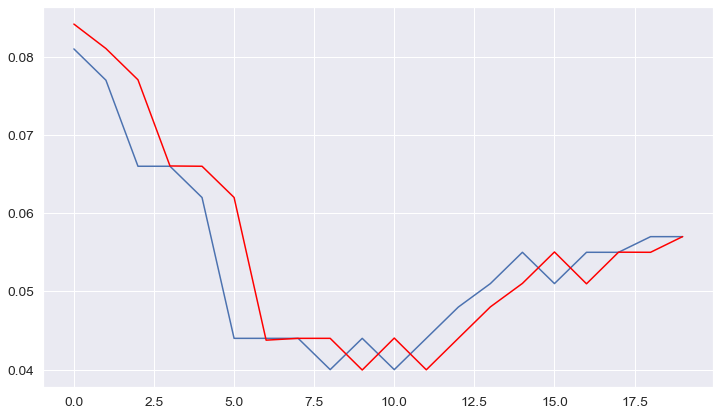

-----------------------------------------------------------------------
Nepal
predicted=2.675352, expected=2.353000
predicted=2.366424, expected=2.641000
predicted=2.732285, expected=2.223000
predicted=2.148505, expected=3.191000
predicted=3.025637, expected=3.037000
predicted=3.062547, expected=3.236000
predicted=3.200589, expected=2.596000
predicted=2.743507, expected=2.810000
predicted=2.757263, expected=2.582000
predicted=2.641330, expected=2.987000
predicted=2.870188, expected=2.456000
predicted=2.639196, expected=2.570000
predicted=2.531952, expected=3.352000
predicted=3.114379, expected=4.129000
predicted=4.052854, expected=4.824000
predicted=4.849012, expected=5.220000
predicted=5.254826, expected=5.470000
predicted=5.496149, expected=6.218000
predicted=6.322143, expected=7.591000
predicted=8.006681, expected=6.817000
predicted=6.747692, expected=9.760000
predicted=9.202557, expected=11.648000
predicted=12.085551, expected=13.690000
predicted=14.460091, expected=16.967000
predi

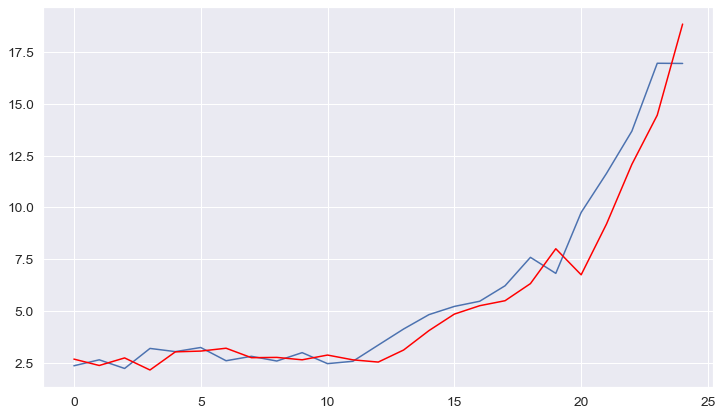

-----------------------------------------------------------------------
Netherlands
predicted=74.669341, expected=75.819000
predicted=76.295955, expected=83.282000
predicted=84.869644, expected=91.145000
predicted=93.082318, expected=96.777000
predicted=98.277238, expected=100.404000
predicted=101.399450, expected=103.558000
predicted=104.440150, expected=106.682000
predicted=107.570438, expected=113.446000
predicted=115.451126, expected=115.802000
predicted=116.504035, expected=141.803000
predicted=150.506129, expected=140.666000
predicted=140.414658, expected=157.495000
predicted=161.066387, expected=165.260000
predicted=167.123843, expected=159.985000
predicted=158.831489, expected=152.525000
predicted=150.799301, expected=169.131000
predicted=172.122739, expected=163.606000
predicted=162.874810, expected=169.793000
predicted=170.532591, expected=187.007000
predicted=189.642836, expected=176.632000
predicted=175.742523, expected=164.110000
predicted=162.596543, expected=133.487000
p

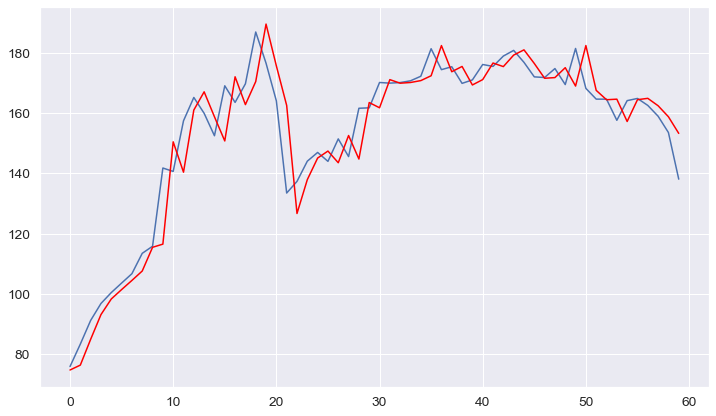

-----------------------------------------------------------------------
New Caledonia
predicted=2.049670, expected=2.184000
predicted=2.166785, expected=1.817000
predicted=1.872567, expected=1.810000
predicted=1.811027, expected=2.056000
predicted=2.019833, expected=2.220000
predicted=2.197559, expected=1.877000
predicted=1.927656, expected=2.392000
predicted=2.299450, expected=2.726000
predicted=2.680026, expected=2.515000
predicted=2.546231, expected=2.810000
predicted=2.763283, expected=2.707000
predicted=2.723628, expected=2.927000
predicted=2.890636, expected=2.848000
predicted=2.861196, expected=2.933000
predicted=2.918710, expected=3.557000
predicted=3.458313, expected=3.540000
predicted=3.542543, expected=3.638000
predicted=3.623309, expected=3.849000
predicted=3.818151, expected=4.873000
predicted=4.761701, expected=4.736000
predicted=4.751406, expected=5.315000
predicted=5.243593, expected=5.345000
predicted=5.341537, expected=5.785000
predicted=5.735015, expected=8.706000
pr

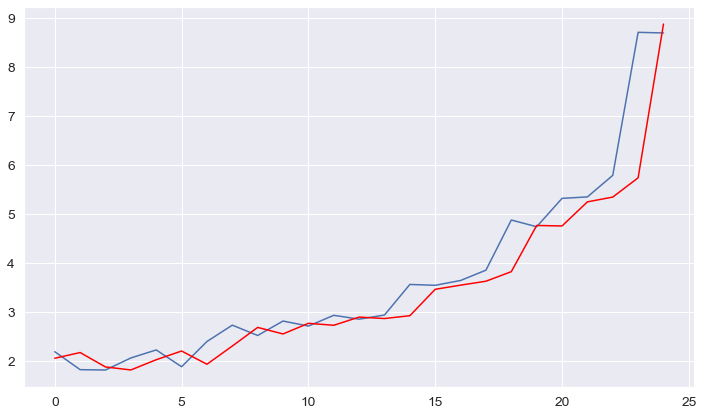

-----------------------------------------------------------------------
New Zealand
predicted=15.028985, expected=16.190000
predicted=16.214826, expected=18.200000
predicted=18.434354, expected=18.760000
predicted=18.838425, expected=18.270000
predicted=18.206902, expected=19.249000
predicted=19.357479, expected=20.313000
predicted=20.464671, expected=18.024000
predicted=17.892337, expected=16.494000
predicted=16.269566, expected=17.479000
predicted=17.575791, expected=16.561000
predicted=16.494208, expected=18.270000
predicted=18.324741, expected=17.998000
predicted=17.992820, expected=19.337000
predicted=19.351170, expected=21.858000
predicted=22.072938, expected=22.946000
predicted=23.085440, expected=24.165000
predicted=24.348485, expected=25.449000
predicted=25.674145, expected=25.453000
predicted=25.453681, expected=25.649000
predicted=25.682375, expected=26.333000
predicted=26.451041, expected=28.275000
predicted=28.653109, expected=27.863000
predicted=27.793328, expected=28.028

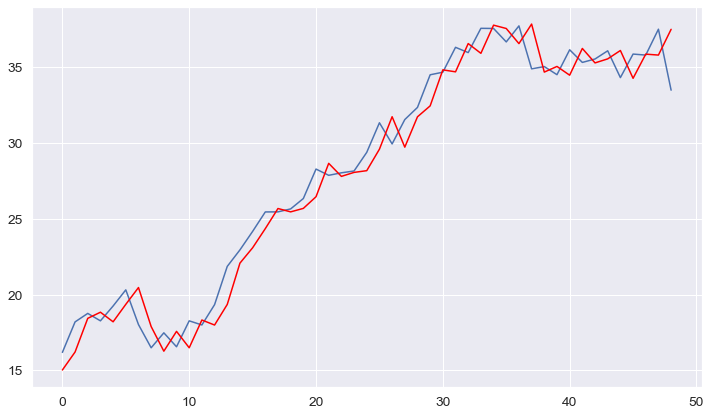

-----------------------------------------------------------------------
Nicaragua
predicted=2.289358, expected=2.518000
predicted=2.497362, expected=2.755000
predicted=2.738758, expected=2.847000
predicted=2.841415, expected=3.114000
predicted=3.099837, expected=3.393000
predicted=3.384722, expected=3.597000
predicted=3.594430, expected=3.721000
predicted=3.720376, expected=3.922000
predicted=3.922455, expected=3.990000
predicted=3.990420, expected=4.335000
predicted=4.339459, expected=4.378000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=4.378705, expected=4.270000
predicted=4.268345, expected=4.418000
predicted=4.419605, expected=4.551000
predicted=4.553155, expected=4.366000
predicted=4.364265, expected=4.445000
predicted=4.445420, expected=4.468000
predicted=4.468133, expected=4.806000
predicted=4.808673, expected=4.546000
predicted=4.550019, expected=4.616000
predicted=4.614626, expected=4.756000
predicted=4.753573, expected=5.430000
predicted=5.434715, expected=5.383000
predicted=5.383048, expected=5.504000
predicted=5.503718, expected=5.281000
predicted=5.282897, expected=5.673000
predicted=5.662073, expected=5.074000
Test RMSE: 0.261


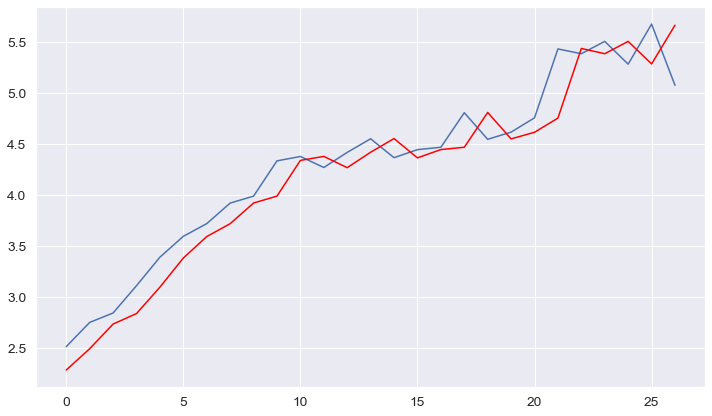

-----------------------------------------------------------------------
Niger
predicted=0.700733, expected=0.683000
predicted=0.682012, expected=0.694000
predicted=0.694771, expected=0.653000
predicted=0.650183, expected=0.696000
predicted=0.698714, expected=0.754000
predicted=0.758072, expected=0.809000
predicted=0.813339, expected=0.709000
predicted=0.702782, expected=0.688000
predicted=0.686606, expected=0.716000
predicted=0.717810, expected=0.802000
predicted=0.808134, expected=0.961000
predicted=0.978103, expected=1.170000
predicted=1.208878, expected=1.322000
predicted=1.358580, expected=1.754000
predicted=1.913718, expected=1.891000
predicted=1.939595, expected=2.075000
predicted=2.145364, expected=2.035000
predicted=2.020862, expected=2.064000
predicted=2.074181, expected=2.006000
predicted=1.985798, expected=1.863000
predicted=1.811756, expected=1.853000
predicted=1.849497, expected=1.690000
Test RMSE: 0.124


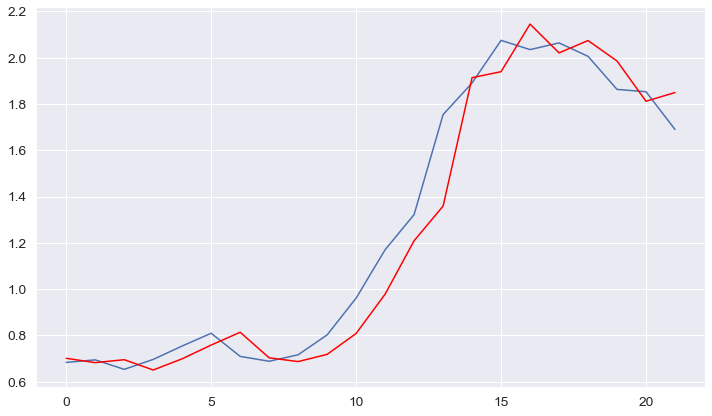

-----------------------------------------------------------------------
Nigeria
predicted=59.746908, expected=69.406000
predicted=68.971900, expected=69.636000
predicted=69.626654, expected=73.192000
predicted=73.049356, expected=59.024000
predicted=60.039061, expected=70.421000
predicted=68.663690, expected=42.119000
predicted=50.910682, expected=38.857000
predicted=39.462019, expected=41.929000
predicted=41.350101, expected=46.265000
predicted=45.471721, expected=44.814000
predicted=45.081004, expected=34.935000
predicted=36.699676, expected=33.417000
predicted=33.670984, expected=36.789000
predicted=36.219180, expected=41.009000
predicted=40.319562, expected=37.746000
predicted=38.291406, expected=39.587000
predicted=39.276557, expected=78.823000
predicted=73.225117, expected=86.719000
predicted=86.529509, expected=94.304000
predicted=94.224886, expected=100.008000
predicted=100.003113, expected=98.685000
predicted=98.688290, expected=105.758000
predicted=105.726079, expected=97.809

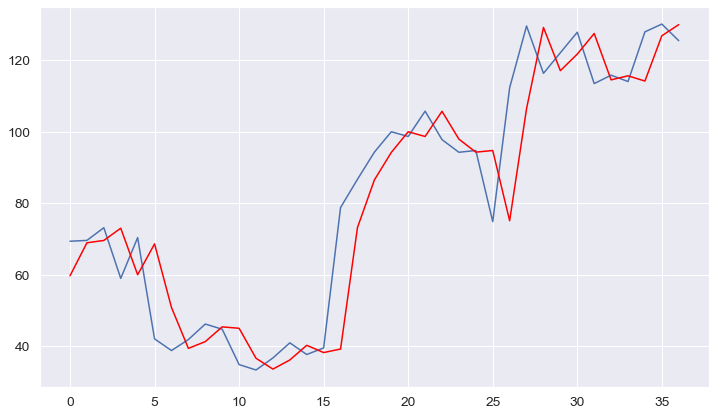

-----------------------------------------------------------------------
Niue
predicted=0.007000, expected=0.004000
predicted=0.004000, expected=0.004000
predicted=0.004000, expected=0.004000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.004000, expected=0.004000
predicted=0.004000, expected=0.004000
predicted=0.004000, expected=0.007000
predicted=0.007000, expected=0.004000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.005000, expected=0.004000
predicted=0.004000, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.006250, expected=0.007000
predicted=0.007000, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.007000, expected=0.011000
predicted=0.010200, expected=0.007000
predicted=0.008639, expected=0.007000
predicted=0.007000, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.007000, expected=0.011000
predicted=0.009701, expected=0.011000
predicted=0.011000, expected=0.011000
Test RMSE: 0.002


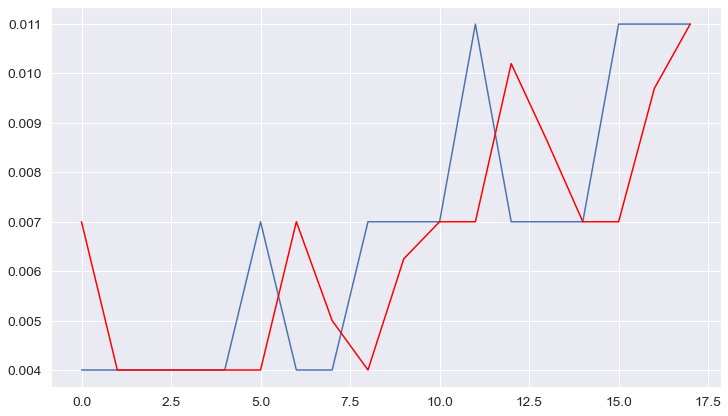

-----------------------------------------------------------------------
North America
predicted=1771.086584, expected=2020.177000
predicted=1987.181610, expected=2199.466000
predicted=2179.050770, expected=2360.895000
predicted=2346.575294, expected=2442.572000
predicted=2436.285468, expected=2620.135000
predicted=2608.479185, expected=2528.287000
predicted=2535.278935, expected=2437.620000
predicted=2443.927071, expected=2676.599000
predicted=2656.313203, expected=2790.213000
predicted=2783.106833, expected=2352.741000
predicted=2394.869129, expected=2744.654000
predicted=2670.337786, expected=2840.649000
predicted=2826.020356, expected=2768.178000
predicted=2779.445415, expected=2831.916000
predicted=2821.871972, expected=2718.204000
predicted=2736.537903, expected=2966.226000
predicted=2922.692388, expected=3124.031000
predicted=3100.512912, expected=3103.255000
predicted=3106.346693, expected=3022.679000
predicted=3034.596441, expected=3114.884000
predicted=3100.935362, expected=31

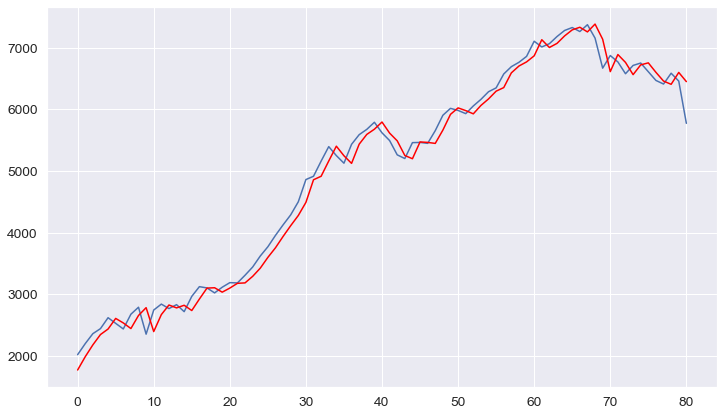

-----------------------------------------------------------------------
North America (excl. USA)
predicted=131.909849, expected=145.263000
predicted=148.016426, expected=155.971000
predicted=158.171820, expected=162.729000
predicted=164.171678, expected=170.587000
predicted=172.319534, expected=175.281000
predicted=176.333439, expected=168.792000
predicted=167.373748, expected=180.217000
predicted=182.563003, expected=190.847000
predicted=193.185741, expected=207.768000
predicted=211.889912, expected=187.994000
predicted=184.346449, expected=203.293000
predicted=205.322789, expected=222.073000
predicted=225.207745, expected=217.096000
predicted=216.362038, expected=219.090000
predicted=219.380618, expected=228.891000
predicted=230.343065, expected=237.878000
predicted=239.292862, expected=264.211000
predicted=269.088402, expected=267.649000
predicted=268.270884, expected=275.742000
predicted=277.229666, expected=283.147000
predicted=284.548454, expected=291.974000
predicted=293.699317

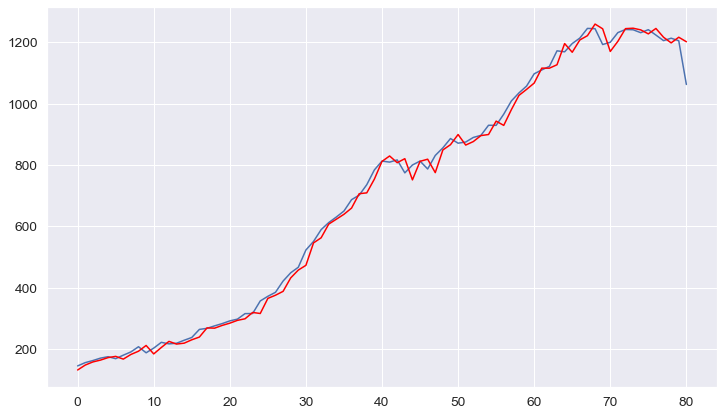

-----------------------------------------------------------------------
North Korea
predicted=113.949011, expected=114.395000
predicted=114.384314, expected=116.892000
predicted=116.807546, expected=125.163000
predicted=124.953956, expected=134.662000
predicted=134.725539, expected=144.285000
predicted=144.685002, expected=156.835000
predicted=157.900369, expected=175.619000
predicted=178.672439, expected=200.808000
predicted=208.145853, expected=213.072000
predicted=217.038815, expected=122.400000
predicted=119.419880, expected=117.227000
predicted=116.973470, expected=102.963000
predicted=102.180183, expected=94.869000
predicted=94.357533, expected=86.720000
predicted=86.165090, expected=81.261000
predicted=80.872026, expected=71.638000
predicted=70.914132, expected=65.158000
predicted=64.642480, expected=58.769000
predicted=58.241744, expected=64.100000
predicted=64.524495, expected=69.165000
predicted=69.578056, expected=71.664000
predicted=71.869859, expected=68.642000
predicted=6

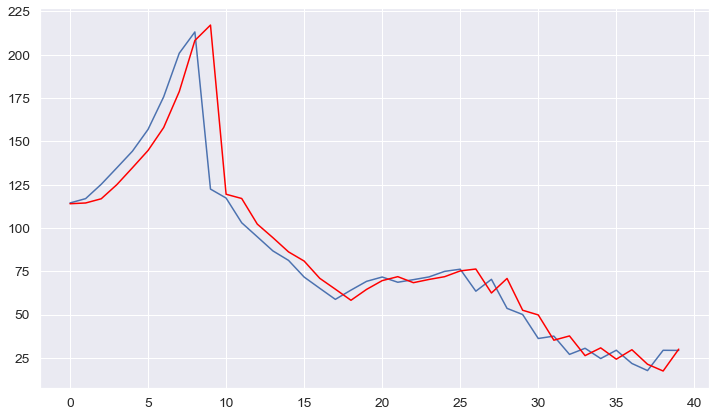

-----------------------------------------------------------------------
North Macedonia
predicted=9.779550, expected=9.429000
predicted=9.437381, expected=9.838000
predicted=9.922254, expected=10.155000
predicted=10.223168, expected=9.875000
predicted=9.817693, expected=11.035000
predicted=11.235238, expected=12.003000
predicted=12.241361, expected=11.803000
predicted=11.760269, expected=12.845000
predicted=13.050148, expected=11.801000
predicted=11.691575, expected=12.708000
predicted=12.739931, expected=13.401000
predicted=13.451231, expected=13.670000
predicted=13.691962, expected=14.277000
predicted=14.332295, expected=13.938000
predicted=13.911890, expected=14.383000
predicted=14.413122, expected=14.339000
predicted=14.336105, expected=14.184000
predicted=14.173742, expected=10.035000
predicted=9.610866, expected=10.985000
predicted=10.926102, expected=10.124000
predicted=10.195792, expected=10.534000
predicted=10.496530, expected=10.637000
predicted=10.627749, expected=11.684000


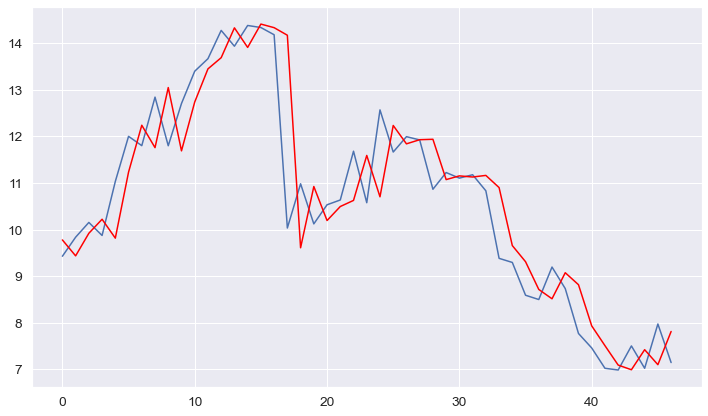

-----------------------------------------------------------------------
Norway
predicted=9.878191, expected=11.414000
predicted=11.356883, expected=11.952000
predicted=11.935727, expected=11.358000
predicted=11.377389, expected=11.186000
predicted=11.191465, expected=11.808000
predicted=11.787731, expected=13.087000
predicted=13.053236, expected=13.335000
predicted=13.329129, expected=14.060000
predicted=14.043719, expected=14.965000
predicted=14.949257, expected=16.170000
predicted=16.159140, expected=16.390000
predicted=16.388470, expected=19.540000
predicted=19.534258, expected=19.304000
predicted=19.305609, expected=21.114000
predicted=21.096338, expected=22.194000
predicted=22.197912, expected=27.979000
predicted=28.240886, expected=27.166000
predicted=27.156763, expected=29.395000
predicted=29.398276, expected=30.492000
predicted=30.507757, expected=27.695000
predicted=27.700186, expected=30.612000
predicted=30.486757, expected=33.348000
predicted=33.340977, expected=33.331000
pr

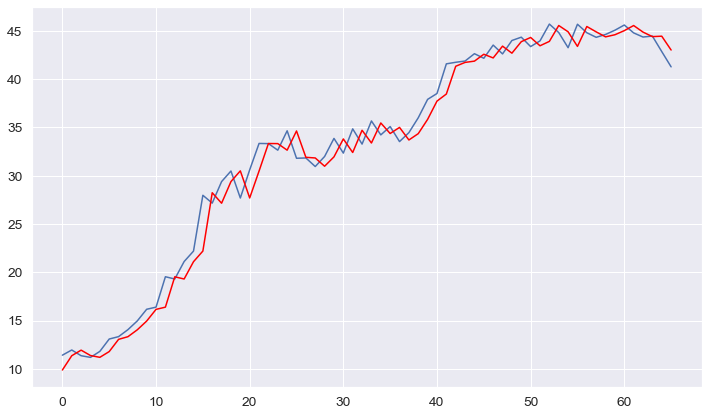

-----------------------------------------------------------------------
Oceania
predicted=141.742133, expected=136.762000
predicted=136.774727, expected=145.475000
predicted=148.472679, expected=151.161000
predicted=153.220124, expected=159.429000
predicted=162.642182, expected=165.833000
predicted=168.442645, expected=172.156000
predicted=174.837007, expected=177.758000
predicted=180.203216, expected=194.305000
predicted=202.379542, expected=196.740000
predicted=197.801254, expected=199.435000
predicted=200.615612, expected=198.481000
predicted=198.066102, expected=213.266000
predicted=219.569176, expected=224.620000
predicted=229.878735, expected=226.513000
predicted=227.356226, expected=243.555000
predicted=251.378823, expected=252.122000
predicted=256.099523, expected=257.191000
predicted=259.563356, expected=247.750000
predicted=243.555007, expected=260.634000
predicted=265.567215, expected=268.324000
predicted=271.365869, expected=268.056000
predicted=267.952366, expected=285.610

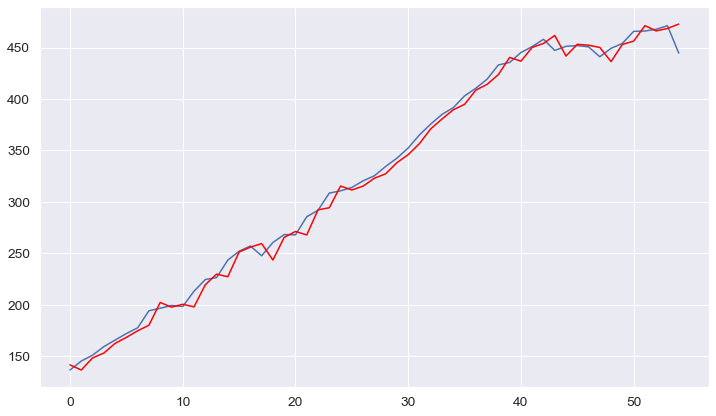

-----------------------------------------------------------------------
Oman
predicted=21.802529, expected=20.107000
predicted=19.752162, expected=25.235000
predicted=25.939944, expected=32.028000
predicted=35.074000, expected=27.592000
predicted=27.148139, expected=29.467000
predicted=29.538276, expected=39.047000
predicted=40.403137, expected=43.970000
predicted=45.304024, expected=42.110000
predicted=41.707453, expected=40.654000
predicted=40.328979, expected=46.915000
predicted=48.104842, expected=53.476000
predicted=55.380568, expected=58.968000
predicted=60.902822, expected=61.278000
predicted=62.103757, expected=60.676000
predicted=60.465527, expected=61.856000
predicted=62.266290, expected=60.310000
predicted=59.780935, expected=65.906000
predicted=67.691655, expected=60.617000
predicted=59.397168, expected=60.757000
predicted=60.787188, expected=62.163000
Test RMSE: 4.638


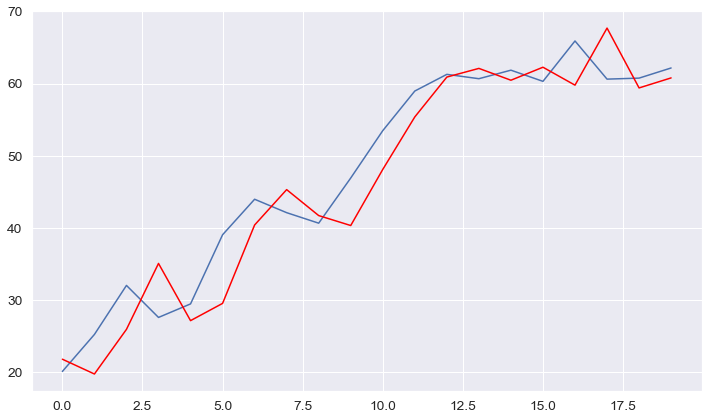

-----------------------------------------------------------------------
Pakistan
predicted=88.776232, expected=83.614000
predicted=83.375752, expected=93.539000
predicted=99.220158, expected=93.788000
predicted=93.899547, expected=96.741000
predicted=98.068598, expected=99.389000
predicted=100.603174, expected=105.420000
predicted=108.354008, expected=107.126000
predicted=107.930184, expected=112.904000
predicted=115.725459, expected=117.491000
predicted=119.820575, expected=129.960000
predicted=137.317651, expected=134.757000
predicted=137.372054, expected=143.726000
predicted=148.983100, expected=155.846000
predicted=163.848166, expected=155.356000
predicted=155.084888, expected=155.221000
predicted=155.146297, expected=154.145000
predicted=153.549312, expected=154.660000
predicted=154.944530, expected=153.876000
predicted=153.443214, expected=150.451000
predicted=148.551956, expected=156.243000
predicted=159.294856, expected=169.252000
predicted=176.833997, expected=207.019000
predi

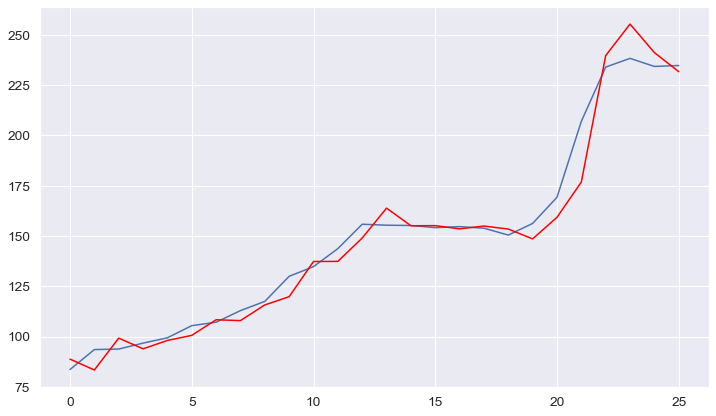

-----------------------------------------------------------------------
Palau
predicted=0.198000, expected=0.198000
predicted=0.198000, expected=0.198000
predicted=0.198000, expected=0.209000
predicted=0.205474, expected=0.216000
predicted=0.213783, expected=0.213000
predicted=0.213951, expected=0.213000
predicted=0.213000, expected=0.216000
predicted=0.215049, expected=0.220000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.218733, expected=0.227000
predicted=0.224747, expected=0.253000
predicted=0.244975, expected=0.205000
predicted=0.221863, expected=0.198000
predicted=0.200197, expected=0.209000
predicted=0.205526, expected=0.216000
predicted=0.213815, expected=0.224000
predicted=0.221522, expected=0.227000
predicted=0.226075, expected=0.220000
predicted=0.222163, expected=0.205000
predicted=0.209576, expected=0.213000
predicted=0.210546, expected=0.216000
predicted=0.215084, expected=0.213000
predicted=0.213916, expected=0.219000
predicted=0.217164, expected=0.219000
Test RMSE: 0.013


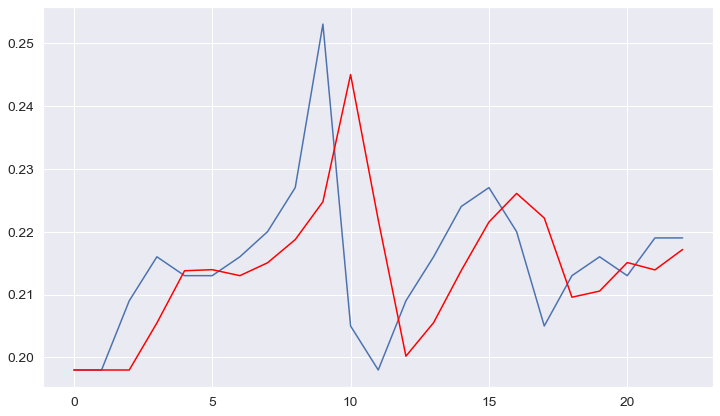

-----------------------------------------------------------------------
Palestine
predicted=2.088677, expected=2.034000
predicted=2.033030, expected=2.246000
predicted=2.248698, expected=2.198000
predicted=2.197619, expected=2.437000
predicted=2.437692, expected=2.836000
predicted=2.853693, expected=3.004000
predicted=3.015575, expected=3.232000
predicted=3.251070, expected=3.268000
predicted=3.271070, expected=2.957000
predicted=2.931872, expected=2.986000
predicted=2.988159, expected=2.899000
Test RMSE: 0.201


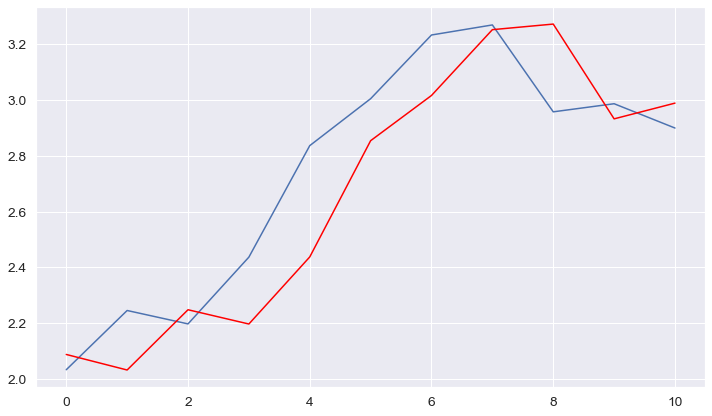

-----------------------------------------------------------------------
Panama
predicted=3.689043, expected=4.447000
predicted=4.326743, expected=4.630000
predicted=4.610399, expected=5.901000
predicted=5.820320, expected=5.622000
predicted=5.649616, expected=5.728000
predicted=5.717181, expected=6.953000
predicted=6.850667, expected=5.821000
predicted=6.078771, expected=6.090000
predicted=6.028384, expected=5.711000
predicted=5.801025, expected=6.971000
predicted=6.618015, expected=7.524000
predicted=7.422376, expected=7.350000
predicted=7.382557, expected=7.335000
predicted=7.337797, expected=8.461000
predicted=8.249778, expected=9.072000
predicted=8.999423, expected=9.953000
predicted=9.885488, expected=9.768000
predicted=9.783488, expected=10.513000
predicted=10.443792, expected=10.855000
predicted=10.830114, expected=10.878000
predicted=10.876351, expected=10.555000
predicted=10.578322, expected=11.212000
predicted=11.155856, expected=10.731000
predicted=10.780569, expected=12.294

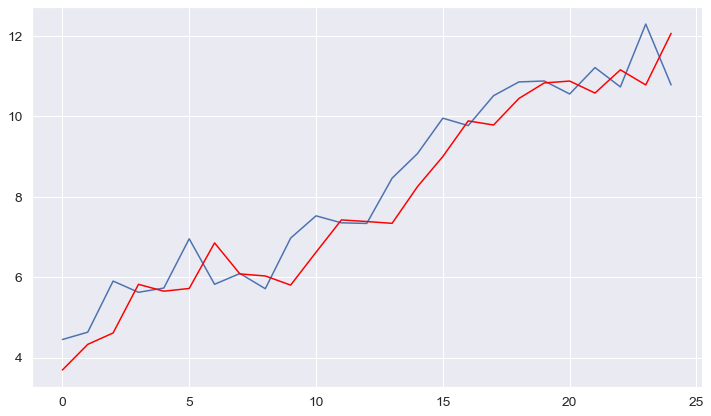

-----------------------------------------------------------------------
Panama Canal Zone
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.057000
predicted=1.057000, expected=1.05700

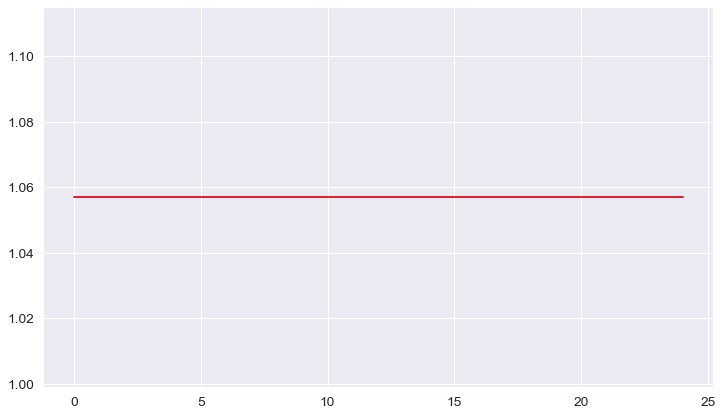

-----------------------------------------------------------------------
Papua New Guinea
predicted=2.032982, expected=2.187000
predicted=2.210094, expected=2.576000
predicted=2.678388, expected=2.862000
predicted=2.965847, expected=2.444000
predicted=2.371157, expected=2.664000
predicted=2.674601, expected=3.206000
predicted=3.293770, expected=3.484000
predicted=3.550698, expected=3.942000
predicted=4.087147, expected=4.485000
predicted=4.717699, expected=4.382000
predicted=4.347656, expected=4.305000
predicted=4.279142, expected=6.115000
predicted=6.575445, expected=4.793000
predicted=5.264548, expected=5.089000
predicted=4.993115, expected=4.661000
predicted=4.805526, expected=5.225000
predicted=5.020790, expected=4.976000
predicted=5.067000, expected=5.331000
predicted=5.198229, expected=6.049000
predicted=5.808433, expected=6.364000
predicted=6.273518, expected=6.636000
predicted=6.561544, expected=6.375000
predicted=6.448009, expected=6.408000
predicted=6.398807, expected=6.618000

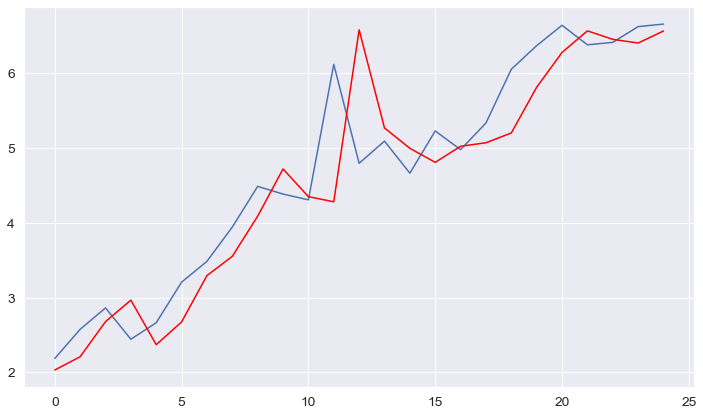

-----------------------------------------------------------------------
Paraguay
predicted=4.225230, expected=3.719000
predicted=3.642674, expected=4.128000
predicted=4.241273, expected=4.384000
predicted=4.464055, expected=4.376000
predicted=4.373604, expected=3.606000
predicted=3.374230, expected=3.696000
predicted=3.713403, expected=3.857000
predicted=3.889040, expected=4.031000
predicted=4.067337, expected=4.061000
predicted=4.067253, expected=3.780000
predicted=3.722472, expected=3.909000
predicted=3.932644, expected=4.042000
predicted=4.067145, expected=4.278000
predicted=4.325291, expected=4.532000
predicted=4.587787, expected=5.022000
predicted=5.150275, expected=5.199000
predicted=5.246834, expected=5.173000
predicted=5.166090, expected=5.172000
predicted=5.171734, expected=5.458000
predicted=5.533965, expected=6.051000
predicted=6.237901, expected=7.183000
predicted=7.727721, expected=8.073000
predicted=8.575603, expected=8.509000
predicted=8.750562, expected=8.525000
predict

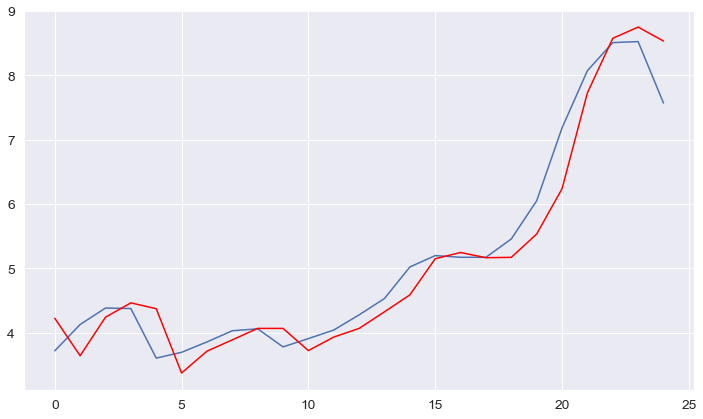

-----------------------------------------------------------------------
Peru
predicted=20.004792, expected=21.325000
predicted=21.675656, expected=21.927000
predicted=22.063228, expected=22.400000
predicted=22.508793, expected=23.296000
predicted=23.508134, expected=22.413000
predicted=22.219458, expected=22.217000
predicted=22.174027, expected=24.065000
predicted=24.457875, expected=24.027000
predicted=24.019424, expected=23.600000
predicted=23.514746, expected=20.393000
predicted=19.683017, expected=20.632000
predicted=20.674629, expected=19.455000
predicted=19.249938, expected=21.775000
predicted=22.083407, expected=25.694000
predicted=26.636431, expected=25.018000
predicted=24.901492, expected=21.762000
predicted=21.127582, expected=21.401000
predicted=21.333737, expected=20.758000
predicted=20.636906, expected=20.986000
predicted=21.028453, expected=23.885000
predicted=24.442429, expected=23.759000
predicted=23.736974, expected=24.669000
predicted=24.827134, expected=24.224000
pre

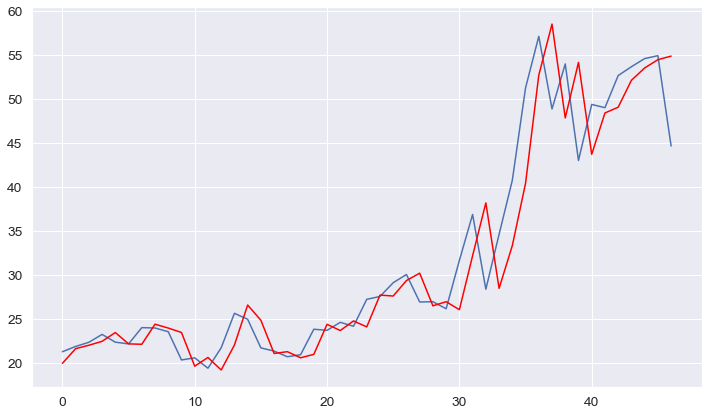

-----------------------------------------------------------------------
Philippines
predicted=33.913000, expected=34.839000
predicted=34.914687, expected=35.239000
predicted=35.336722, expected=30.831000
predicted=29.827232, expected=27.899000
predicted=27.042625, expected=29.025000
predicted=29.307283, expected=32.496000
predicted=33.453231, expected=37.485000
predicted=39.311078, expected=38.907000
predicted=39.411597, expected=41.350000
predicted=42.253844, expected=43.472000
predicted=44.290747, expected=48.293000
predicted=50.363704, expected=48.929000
predicted=49.181817, expected=54.122000
predicted=56.258639, expected=59.950000
predicted=62.803492, expected=61.255000
predicted=61.851721, expected=70.062000
predicted=74.410733, expected=68.253000
predicted=67.633875, expected=68.176000
predicted=68.149853, expected=72.348000
predicted=73.760277, expected=70.304000
predicted=69.690061, expected=70.156000
predicted=70.111910, expected=70.215000
predicted=70.232576, expected=72.771

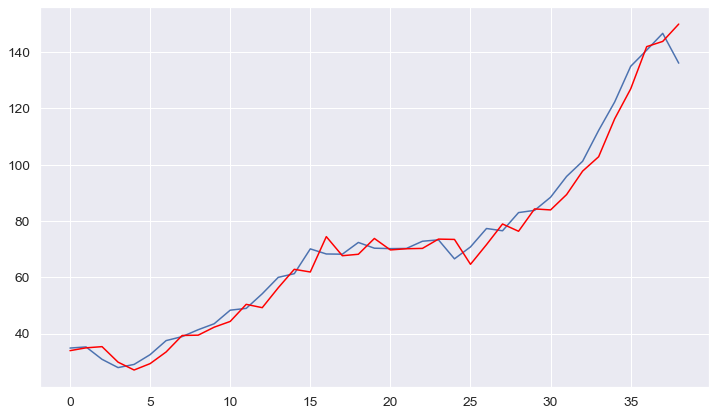

-----------------------------------------------------------------------
Poland
predicted=190.761261, expected=59.458000
predicted=80.260842, expected=104.594000
predicted=94.450818, expected=91.546000
predicted=94.511774, expected=88.925000
predicted=89.517049, expected=105.426000
predicted=101.685207, expected=112.123000
predicted=110.627085, expected=122.132000
predicted=119.911151, expected=128.042000
predicted=126.739906, expected=139.193000
predicted=136.752000, expected=147.568000
predicted=145.754087, expected=154.202000
predicted=152.774148, expected=166.417000
predicted=163.809144, expected=178.682000
predicted=176.106149, expected=176.735000
predicted=177.143631, expected=189.660000
predicted=186.941263, expected=199.577000
predicted=197.521807, expected=207.235000
predicted=205.662030, expected=216.607000
predicted=214.696842, expected=230.999000
predicted=228.107365, expected=242.880000
predicted=240.540561, expected=246.981000
predicted=246.179374, expected=252.431000
pred

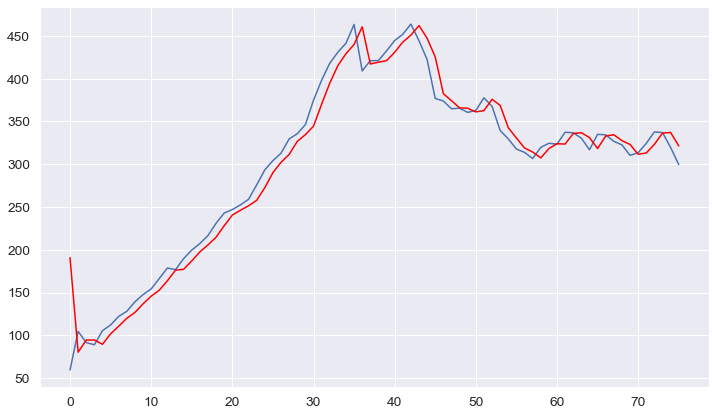

-----------------------------------------------------------------------
Portugal
predicted=13.047656, expected=14.593000
predicted=14.816069, expected=15.236000
predicted=15.344866, expected=16.376000
predicted=16.601996, expected=18.307000
predicted=18.844417, expected=19.945000
predicted=20.525096, expected=20.645000
predicted=20.897404, expected=21.275000
predicted=21.507510, expected=22.326000
predicted=22.730976, expected=22.605000
predicted=22.711385, expected=22.585000
predicted=22.577395, expected=24.856000
predicted=25.715039, expected=26.773000
predicted=27.618977, expected=27.000000
predicted=27.093727, expected=29.000000
predicted=29.845757, expected=29.902000
predicted=30.285680, expected=28.794000
predicted=28.354830, expected=27.130000
predicted=26.423489, expected=30.221000
predicted=31.145313, expected=31.198000
predicted=31.492813, expected=32.568000
predicted=33.004870, expected=40.822000
predicted=44.810550, expected=45.334000
predicted=47.661343, expected=47.152000

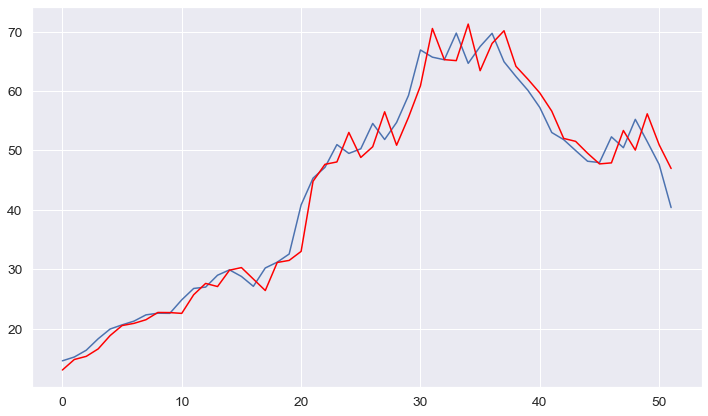

-----------------------------------------------------------------------
Puerto Rico
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximu

predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.209000, expected=0.209000
predicted=0.209000, expected=0.209000
Test RMSE: 0.000


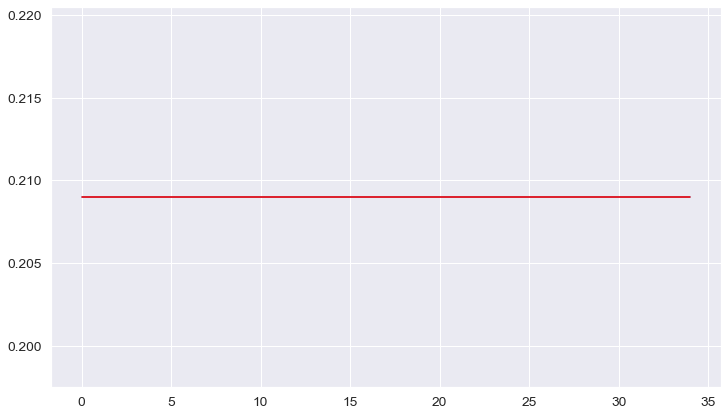

-----------------------------------------------------------------------
Qatar
predicted=31.580793, expected=31.668000
predicted=31.773450, expected=36.789000
predicted=38.286354, expected=31.722000
predicted=30.901477, expected=30.756000
predicted=30.597005, expected=34.012000
predicted=34.510046, expected=41.214000
predicted=42.842060, expected=40.703000
predicted=40.610025, expected=41.300000
predicted=41.408053, expected=42.711000
predicted=42.969586, expected=50.690000
predicted=52.394823, expected=63.197000
predicted=68.424709, expected=62.901000
predicted=62.812728, expected=64.257000
predicted=64.660463, expected=68.597000
predicted=69.928112, expected=71.920000
predicted=72.987447, expected=79.648000
predicted=82.408449, expected=92.304000
predicted=98.250410, expected=82.697000
predicted=80.463622, expected=90.419000
predicted=91.413147, expected=90.137000
predicted=90.103513, expected=88.907000
predicted=88.760488, expected=99.757000
predicted=100.898619, expected=106.927000


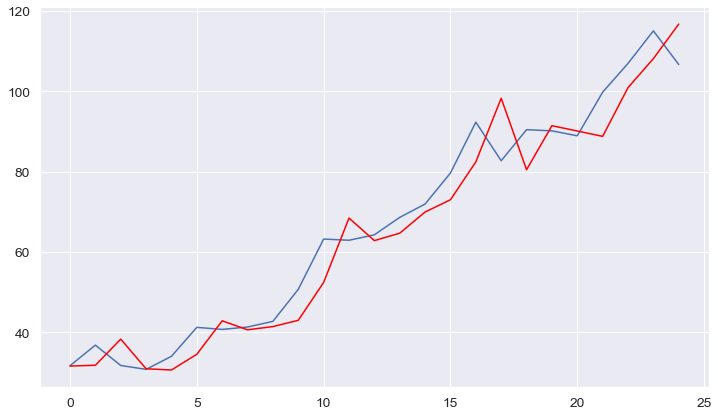

-----------------------------------------------------------------------
Reunion
predicted=2.096648, expected=2.276000
predicted=2.328837, expected=2.565000
predicted=2.668047, expected=2.644000
predicted=2.671179, expected=2.905000
predicted=3.003297, expected=3.183000
predicted=3.308396, expected=3.311000
predicted=3.368890, expected=3.334000
predicted=3.344263, expected=3.145000
predicted=3.061935, expected=3.269000
predicted=3.317050, expected=3.693000
predicted=3.882137, expected=3.917000
predicted=4.020398, expected=4.109000
predicted=4.201405, expected=4.276000
predicted=4.358666, expected=4.347000
predicted=4.382027, expected=4.486000
predicted=4.555526, expected=4.499000
predicted=4.505411, expected=4.450000
predicted=4.425863, expected=4.361000
predicted=4.316896, expected=4.354000
predicted=4.350551, expected=4.424000
predicted=4.458461, expected=4.525000
predicted=4.575150, expected=4.441000
predicted=4.400305, expected=4.401000
predicted=4.381620, expected=4.588000
predicte

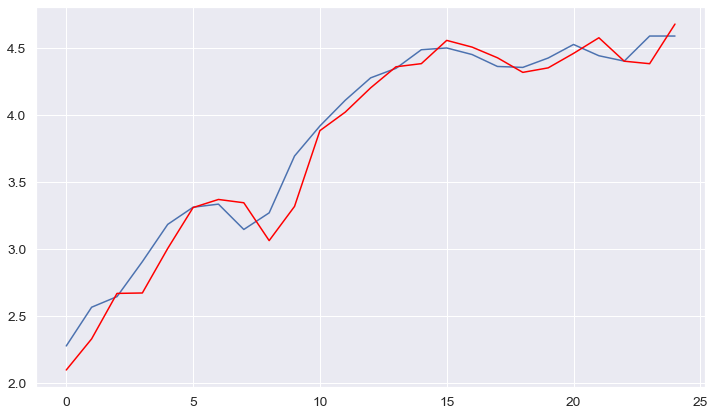

-----------------------------------------------------------------------
Romania
predicted=73.133466, expected=78.637000
predicted=81.628886, expected=84.091000
predicted=86.728684, expected=92.029000
predicted=96.270680, expected=100.079000
predicted=104.764604, expected=111.527000
predicted=119.072905, expected=119.981000
predicted=125.658768, expected=125.681000
predicted=129.510652, expected=132.254000
predicted=136.778939, expected=144.765000
predicted=154.029157, expected=150.720000
predicted=154.915682, expected=162.006000
predicted=170.352577, expected=174.472000
predicted=184.125561, expected=178.077000
predicted=180.684587, expected=193.539000
predicted=205.178933, expected=195.676000
predicted=197.102854, expected=196.199000
predicted=196.547639, expected=197.730000
predicted=198.751186, expected=195.329000
predicted=193.734835, expected=200.116000
predicted=203.251324, expected=188.817000
predicted=181.870799, expected=193.907000
predicted=196.666391, expected=201.641000
pre

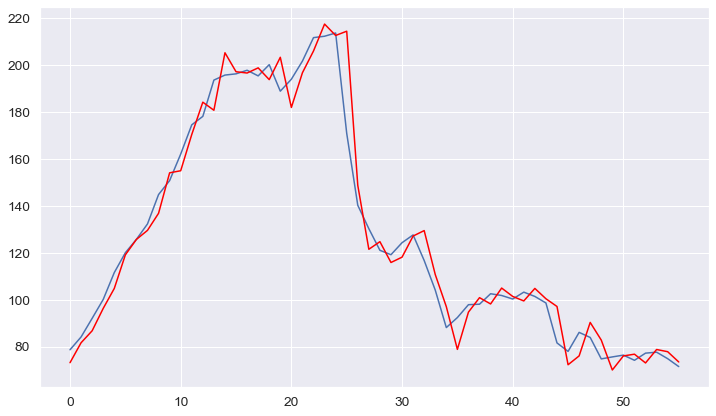

-----------------------------------------------------------------------
Russia
predicted=666.901294, expected=690.554000
predicted=723.041841, expected=755.682000
predicted=793.021006, expected=806.603000
predicted=836.601613, expected=848.035000
predicted=872.855058, expected=882.927000
predicted=904.071265, expected=910.542000
predicted=927.378422, expected=955.667000
predicted=983.740886, expected=1024.911000
predicted=1069.968234, expected=1090.020000
predicted=1133.684408, expected=1156.312000
predicted=1202.087209, expected=1221.123000
predicted=1266.915015, expected=1276.867000
predicted=1316.688634, expected=1312.749000
predicted=1338.291552, expected=1367.141000
predicted=1406.499715, expected=1437.871000
predicted=1490.377669, expected=1525.874000
predicted=1593.491817, expected=1605.411000
predicted=1667.325286, expected=1673.209000
predicted=1726.275036, expected=1736.921000
predicted=1787.188563, expected=1825.755000
predicted=1897.645680, expected=1896.073000
predicted=19

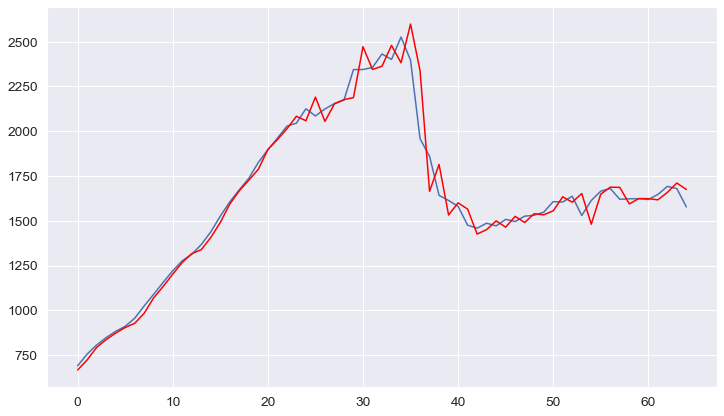

-----------------------------------------------------------------------
Rwanda
predicted=0.452896, expected=0.464000
predicted=0.466700, expected=0.483000
predicted=0.488724, expected=0.482000
predicted=0.481700, expected=0.503000
predicted=0.509308, expected=0.515000
predicted=0.518618, expected=0.522000
predicted=0.524113, expected=0.519000
predicted=0.518095, expected=0.509000
predicted=0.505980, expected=0.516000
predicted=0.518109, expected=0.514000
predicted=0.513398, expected=0.514000
predicted=0.514000, expected=0.542000
predicted=0.550436, expected=0.528000
predicted=0.523848, expected=0.558000
predicted=0.566786, expected=0.573000
predicted=0.577416, expected=0.647000
predicted=0.669370, expected=0.718000
predicted=0.741334, expected=0.782000
predicted=0.804349, expected=0.827000
predicted=0.843163, expected=0.919000
predicted=0.954149, expected=1.036000
predicted=1.086307, expected=1.050000
predicted=1.055672, expected=1.142000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.179900, expected=1.187000
predicted=1.205707, expected=1.033000
Test RMSE: 0.051


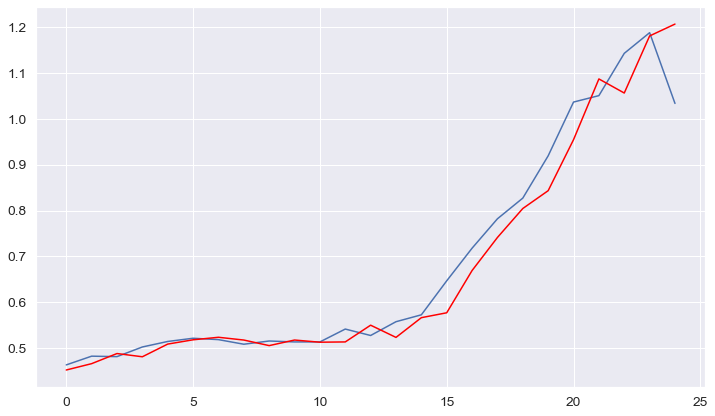

-----------------------------------------------------------------------
Ryukyu Islands
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
predicted=0.764500, expected=0.764500
T

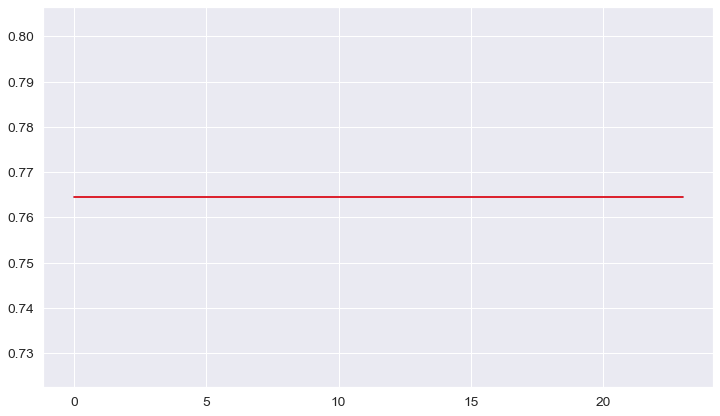

-----------------------------------------------------------------------
Saint Helena
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.015000
predicted=0.014500, expected=0.011000
predicted=0.012136, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.009000
Test RMSE: 0.001


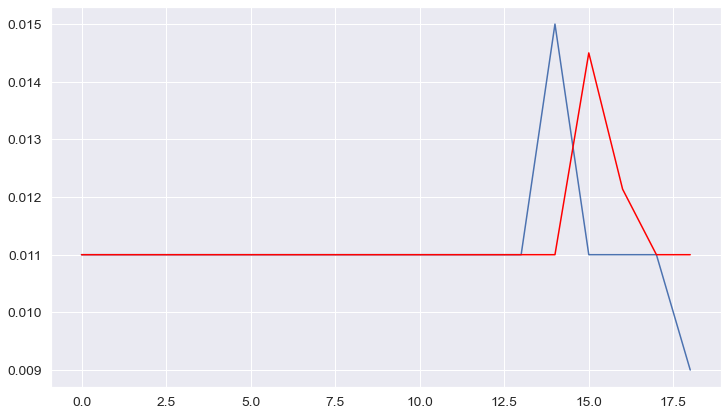

-----------------------------------------------------------------------
Saint Kitts and Nevis
predicted=0.202050, expected=0.216000
predicted=0.216389, expected=0.216000
predicted=0.216000, expected=0.224000
predicted=0.224211, expected=0.220000
predicted=0.219929, expected=0.231000
predicted=0.231072, expected=0.220000
predicted=0.220257, expected=0.224000
predicted=0.223867, expected=0.231000
predicted=0.230815, expected=0.234000
predicted=0.233937, expected=0.238000
predicted=0.237927, expected=0.242000
predicted=0.241942, expected=0.245000
predicted=0.244965, expected=0.240000
predicted=0.240076, expected=0.212000
Test RMSE: 0.010


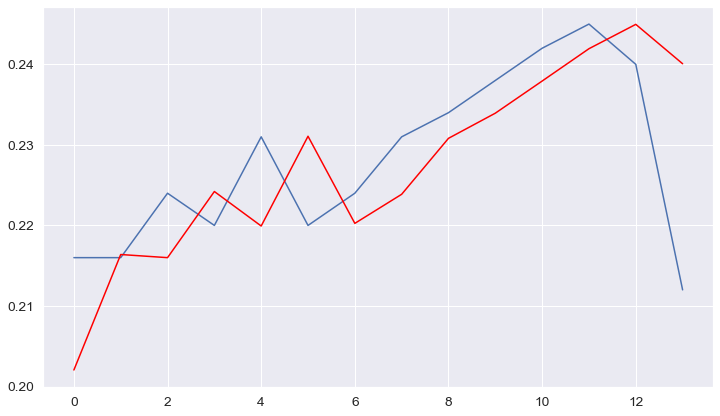

-----------------------------------------------------------------------
Saint Lucia
predicted=0.277533, expected=0.293000
predicted=0.296457, expected=0.293000
predicted=0.293000, expected=0.322000
predicted=0.327395, expected=0.333000
predicted=0.335206, expected=0.348000
predicted=0.351195, expected=0.359000
predicted=0.361455, expected=0.359000
predicted=0.359000, expected=0.377000
predicted=0.380976, expected=0.403000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.409604, expected=0.388000
predicted=0.384856, expected=0.410000
predicted=0.413903, expected=0.425000
predicted=0.427977, expected=0.425000
predicted=0.425000, expected=0.425000
predicted=0.425000, expected=0.487000
predicted=0.498883, expected=0.487000
predicted=0.487000, expected=0.491000
predicted=0.491608, expected=0.487000
predicted=0.486396, expected=0.484000
predicted=0.483545, expected=0.480000
predicted=0.479391, expected=0.487000
predicted=0.488053, expected=0.506000
predicted=0.508995, expected=0.509000
predicted=0.509473, expected=0.497000
predicted=0.495134, expected=0.440000
Test RMSE: 0.021


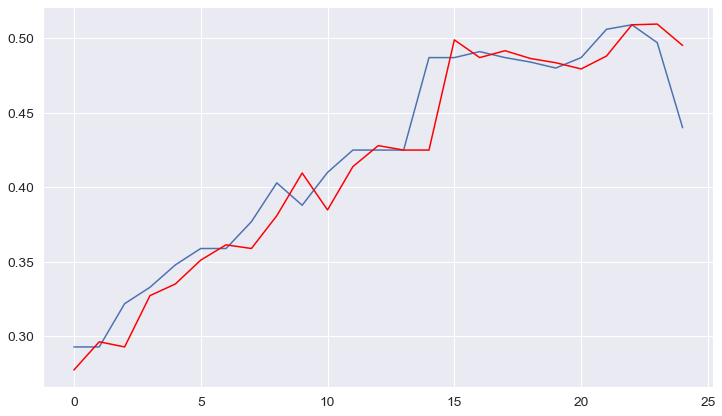

-----------------------------------------------------------------------
Saint Pierre and Miquelon
predicted=0.070000, expected=0.070000
predicted=0.070000, expected=0.048000
predicted=0.051624, expected=0.055000
predicted=0.053765, expected=0.055000
predicted=0.055000, expected=0.055000
predicted=0.055000, expected=0.055000
predicted=0.055000, expected=0.059000
predicted=0.058300, expected=0.062000
predicted=0.061482, expected=0.059000
predicted=0.059522, expected=0.062000
predicted=0.061475, expected=0.066000
predicted=0.065308, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.066000
predicted=0.066000, expected=0.059000
predicted=0.060208, expected=0.057000
predicted=0.057338, expected=0.051000
Test RMSE: 0.005


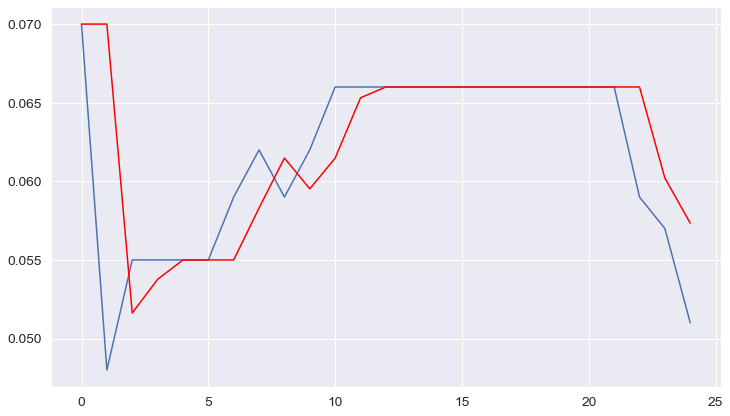

-----------------------------------------------------------------------
Saint Vincent and the Grenadines
predicted=0.129276, expected=0.132000
predicted=0.132768, expected=0.132000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.132000, expected=0.161000
predicted=0.166523, expected=0.165000
predicted=0.165699, expected=0.147000
predicted=0.144326, expected=0.180000
predicted=0.178220, expected=0.187000
predicted=0.187099, expected=0.198000
predicted=0.198350, expected=0.220000
predicted=0.221882, expected=0.220000
predicted=0.220000, expected=0.216000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.215691, expected=0.234000
predicted=0.235121, expected=0.220000
predicted=0.219853, expected=0.278000
predicted=0.269944, expected=0.220000
predicted=0.246445, expected=0.216000
predicted=0.217277, expected=0.231000
predicted=0.226224, expected=0.220000
predicted=0.223644, expected=0.253000
predicted=0.241218, expected=0.234000
predicted=0.241115, expected=0.242000
predicted=0.238994, expected=0.216000
predicted=0.226108, expected=0.242000
predicted=0.231162, expected=0.236000
predicted=0.238452, expected=0.209000
Test RMSE: 0.023


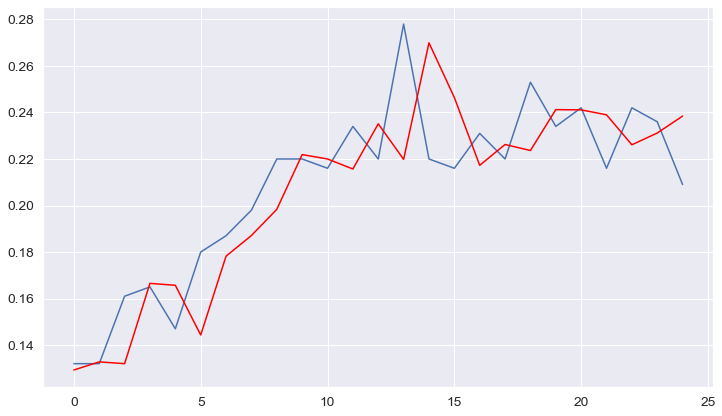

-----------------------------------------------------------------------
Samoa
predicted=0.112914, expected=0.125000
predicted=0.125141, expected=0.125000
predicted=0.125000, expected=0.143000
predicted=0.143222, expected=0.136000
predicted=0.136158, expected=0.143000
predicted=0.142754, expected=0.154000
predicted=0.153839, expected=0.161000
predicted=0.161037, expected=0.158000
predicted=0.158000, expected=0.165000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.164963, expected=0.169000
predicted=0.169007, expected=0.172000
predicted=0.172014, expected=0.180000
predicted=0.180084, expected=0.161000
predicted=0.161500, expected=0.169000
predicted=0.168537, expected=0.183000
predicted=0.182543, expected=0.191000
predicted=0.190938, expected=0.187000
predicted=0.187057, expected=0.194000
predicted=0.193860, expected=0.202000
predicted=0.201933, expected=0.227000
predicted=0.227802, expected=0.238000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.238855, expected=0.245000
predicted=0.245627, expected=0.238000
predicted=0.237438, expected=0.245000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.245498, expected=0.246000
Test RMSE: 0.010


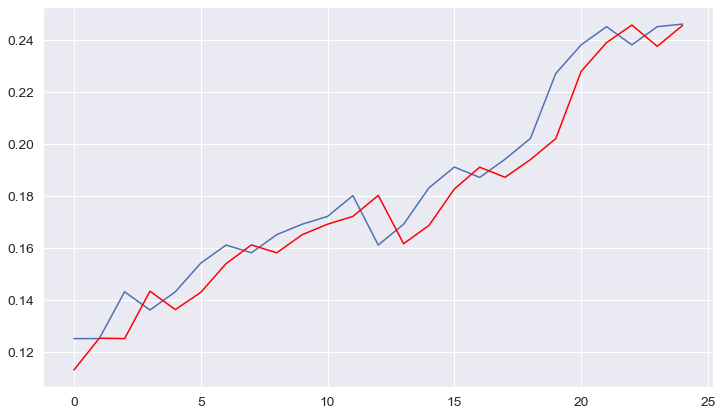

-----------------------------------------------------------------------
Sao Tome and Principe
predicted=0.048000, expected=0.048000
predicted=0.048000, expected=0.048000
predicted=0.048000, expected=0.048000
predicted=0.048000, expected=0.048000
predicted=0.048000, expected=0.051000
predicted=0.051026, expected=0.059000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.059468, expected=0.066000
predicted=0.067083, expected=0.073000
predicted=0.074573, expected=0.077000
predicted=0.078005, expected=0.084000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.086014, expected=0.084000
predicted=0.084000, expected=0.084000
predicted=0.084000, expected=0.092000
predicted=0.094142, expected=0.099000
predicted=0.101227, expected=0.099000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.099000, expected=0.117000
predicted=0.122385, expected=0.121000
predicted=0.122109, expected=0.117000
predicted=0.115961, expected=0.121000
predicted=0.121970, expected=0.125000
predicted=0.126011, expected=0.128000
predicted=0.128778, expected=0.132000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.133069, expected=0.126000
predicted=0.124534, expected=0.113000
Test RMSE: 0.006


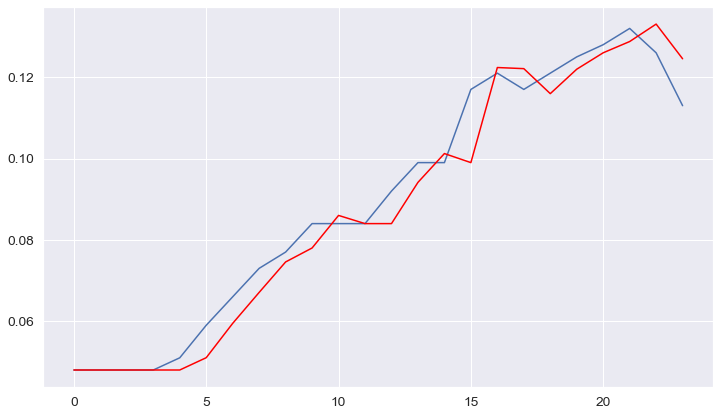

-----------------------------------------------------------------------
Saudi Arabia
predicted=306.573873, expected=316.175000
predicted=323.944175, expected=340.642000
predicted=348.298215, expected=328.139000
predicted=324.634778, expected=262.421000
predicted=240.757033, expected=258.275000
predicted=257.150584, expected=215.807000
predicted=203.935090, expected=207.240000
predicted=204.900359, expected=225.986000
predicted=230.948090, expected=296.364000
predicted=318.854816, expected=296.588000
predicted=296.646577, expected=325.698000
predicted=333.315300, expected=326.517000
predicted=326.725525, expected=394.585000
predicted=412.010152, expected=395.855000
predicted=396.137185, expected=431.292000
predicted=439.211634, expected=386.507000
predicted=378.984110, expected=432.336000
predicted=436.967494, expected=465.844000
predicted=470.400666, expected=517.716000
predicted=526.871776, expected=497.659000
predicted=494.847123, expected=563.179000
predicted=570.223048, expected=54

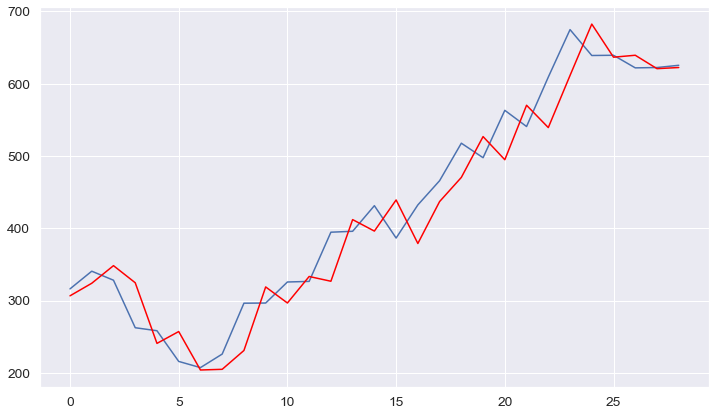

-----------------------------------------------------------------------
Senegal
predicted=3.317444, expected=3.604000
predicted=3.576018, expected=3.902000
predicted=3.874285, expected=4.258000
predicted=4.229766, expected=4.437000
predicted=4.424358, expected=4.928000
predicted=4.898537, expected=5.238000
predicted=5.225309, expected=5.539000
predicted=5.529990, expected=4.422000
predicted=4.497011, expected=4.863000
predicted=4.815690, expected=4.740000
predicted=4.753595, expected=5.258000
predicted=5.197661, expected=6.862000
predicted=6.805065, expected=7.819000
predicted=7.902124, expected=7.362000
predicted=7.338926, expected=7.853000
predicted=7.869792, expected=8.724000
predicted=8.778673, expected=9.845000
predicted=9.982697, expected=10.016000
predicted=10.037393, expected=10.746000
predicted=10.842590, expected=11.330000
predicted=11.419305, expected=11.266000
predicted=11.256536, expected=10.451000
Test RMSE: 0.678


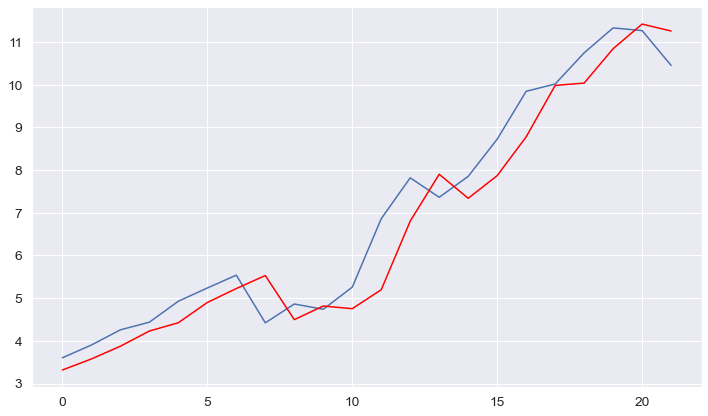

-----------------------------------------------------------------------
Serbia
predicted=37.290236, expected=36.135000
predicted=36.156195, expected=37.697000
predicted=37.972442, expected=38.822000
predicted=39.029695, expected=37.613000
predicted=37.401710, expected=42.023000
predicted=42.641949, expected=45.762000
predicted=46.567649, expected=44.923000
predicted=44.768405, expected=49.165000
predicted=49.866825, expected=44.978000
predicted=44.687914, expected=48.647000
predicted=48.640625, expected=51.492000
predicted=51.607514, expected=52.622000
predicted=52.680663, expected=54.994000
predicted=55.141305, expected=53.689000
predicted=53.625110, expected=55.460000
predicted=55.530628, expected=55.355000
predicted=55.350935, expected=56.448000
predicted=56.489851, expected=38.616000
predicted=39.225779, expected=42.818000
predicted=42.217481, expected=37.623000
predicted=38.530413, expected=36.326000
predicted=36.529134, expected=38.374000
predicted=38.045529, expected=44.810000
p

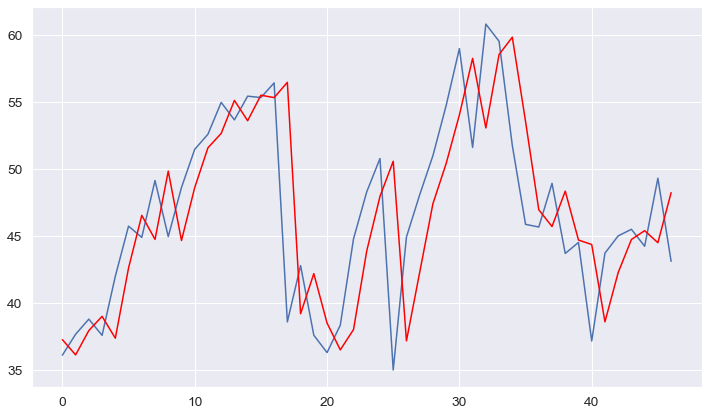

-----------------------------------------------------------------------
Seychelles
predicted=0.313497, expected=0.344000
predicted=0.340492, expected=0.348000
predicted=0.347555, expected=0.341000
predicted=0.341786, expected=0.370000
predicted=0.366569, expected=0.381000
predicted=0.379867, expected=0.385000
predicted=0.384607, expected=0.403000
predicted=0.401246, expected=0.414000
predicted=0.413035, expected=0.440000
predicted=0.438045, expected=0.443000
predicted=0.442790, expected=0.407000
predicted=0.409623, expected=0.425000
predicted=0.423276, expected=0.414000
predicted=0.415124, expected=0.462000
predicted=0.456148, expected=0.480000
predicted=0.478530, expected=0.535000
predicted=0.532452, expected=0.557000
predicted=0.556915, expected=0.557000
predicted=0.557000, expected=0.581000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.580909, expected=0.491000
Test RMSE: 0.032


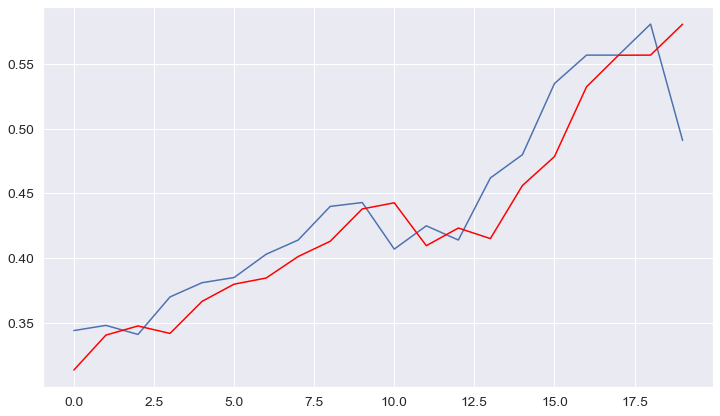

-----------------------------------------------------------------------
Sierra Leone
predicted=0.261966, expected=0.308000
predicted=0.287321, expected=0.224000
predicted=0.246854, expected=0.242000
predicted=0.237106, expected=0.194000
predicted=0.207083, expected=0.330000
predicted=0.292369, expected=0.432000
predicted=0.405104, expected=0.502000
predicted=0.484010, expected=0.535000
predicted=0.526596, expected=0.520000
predicted=0.523823, expected=0.425000
predicted=0.449124, expected=0.579000
predicted=0.538605, expected=0.487000
predicted=0.511625, expected=0.506000
predicted=0.500919, expected=0.502000
predicted=0.503070, expected=0.542000
predicted=0.531294, expected=0.711000
predicted=0.666578, expected=0.832000
predicted=0.802394, expected=1.008000
predicted=0.967761, expected=1.110000
predicted=1.088291, expected=0.876000
predicted=0.928969, expected=0.905000
predicted=0.898533, expected=0.912000
predicted=0.910440, expected=0.953000
predicted=0.943869, expected=0.961000
pre

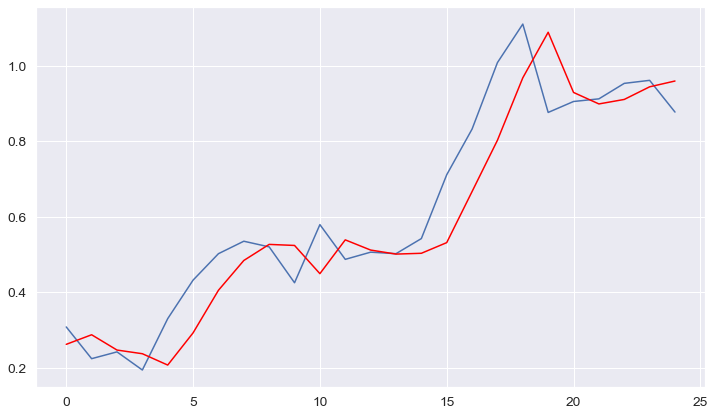

-----------------------------------------------------------------------
Singapore
predicted=45.587042, expected=48.013000
predicted=45.702491, expected=56.737000
predicted=54.776546, expected=47.412000
predicted=50.072899, expected=49.200000
predicted=48.702300, expected=48.394000
predicted=48.618831, expected=49.200000
predicted=48.974756, expected=47.093000
predicted=47.684784, expected=49.438000
predicted=48.771653, expected=46.859000
predicted=47.602039, expected=36.468000
predicted=39.200629, expected=43.045000
predicted=41.108967, expected=47.518000
predicted=46.344792, expected=57.572000
predicted=55.316016, expected=90.098000
predicted=90.713702, expected=56.620000
predicted=70.649378, expected=30.272000
predicted=31.562534, expected=48.145000
predicted=45.478784, expected=54.366000
predicted=53.649131, expected=55.209000
predicted=55.113568, expected=62.130000
predicted=61.355121, expected=40.275000
predicted=43.387234, expected=39.066000
predicted=39.216443, expected=46.00200

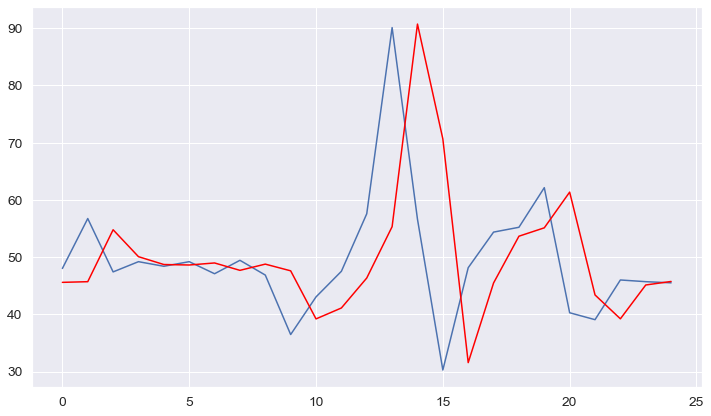

-----------------------------------------------------------------------
Sint Maarten (Dutch part)
predicted=0.286932, expected=0.271000
predicted=0.272404, expected=0.515000
predicted=0.429324, expected=0.552000
predicted=0.539157, expected=0.440000
predicted=0.478941, expected=0.363000
predicted=0.389640, expected=0.560000
predicted=0.491479, expected=0.537000
predicted=0.544973, expected=0.531000
predicted=0.533080, expected=0.497000
predicted=0.508789, expected=0.520000
predicted=0.512022, expected=0.029000
predicted=0.200000, expected=0.215000
predicted=0.150030, expected=0.571000
predicted=0.450319, expected=0.581000
predicted=0.577669, expected=0.560000
predicted=0.566996, expected=0.561000
predicted=0.560667, expected=0.588000
predicted=0.579003, expected=0.583000
predicted=0.584666, expected=0.607000
predicted=0.599000, expected=0.684000
predicted=0.658351, expected=0.658000
predicted=0.666662, expected=0.673000
predicted=0.668002, expected=0.464000
predicted=0.533732, expected

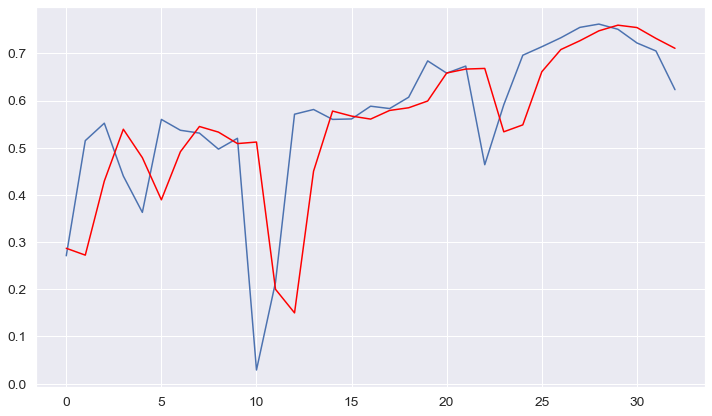

-----------------------------------------------------------------------
Slovakia
predicted=38.833885, expected=38.814000
predicted=38.765272, expected=38.725000
predicted=38.706540, expected=40.525000
predicted=40.896965, expected=43.029000
predicted=43.590651, expected=49.345000
predicted=51.166418, expected=50.445000
predicted=50.743243, expected=50.927000
predicted=51.058063, expected=51.103000
predicted=51.150875, expected=51.627000
predicted=51.769715, expected=54.054000
predicted=54.725887, expected=56.200000
predicted=56.822364, expected=57.931000
predicted=58.447943, expected=58.400000
predicted=58.539932, expected=56.847000
predicted=56.388069, expected=57.515000
predicted=57.708257, expected=56.841000
predicted=56.647382, expected=56.337000
predicted=56.191835, expected=56.391000
predicted=56.406535, expected=58.377000
predicted=58.949066, expected=57.617000
predicted=57.405093, expected=58.038000
predicted=58.154686, expected=57.338000
predicted=57.144814, expected=56.282000

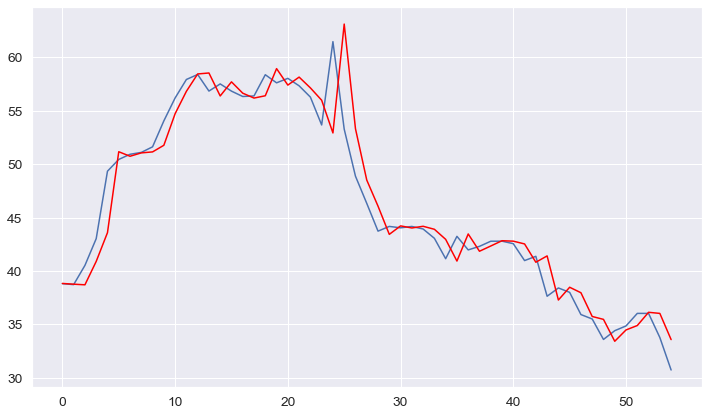

-----------------------------------------------------------------------
Slovenia
predicted=11.017928, expected=10.621000
predicted=10.628391, expected=11.074000
predicted=11.165046, expected=11.420000
predicted=11.492513, expected=11.093000
predicted=11.027797, expected=12.395000
predicted=12.611786, expected=13.480000
predicted=13.740166, expected=13.241000
predicted=13.191494, expected=14.393000
predicted=14.611573, expected=13.205000
predicted=13.086781, expected=14.222000
predicted=14.252483, expected=15.000000
predicted=15.052248, expected=15.301000
predicted=15.323982, expected=15.980000
predicted=16.038177, expected=15.576000
predicted=15.547254, expected=16.145000
predicted=16.179172, expected=16.065000
predicted=16.060430, expected=15.083000
predicted=15.023453, expected=13.962000
predicted=13.843417, expected=13.873000
predicted=13.863619, expected=14.234000
predicted=14.271212, expected=14.628000
predicted=14.670690, expected=15.342000
predicted=15.427807, expected=15.987000

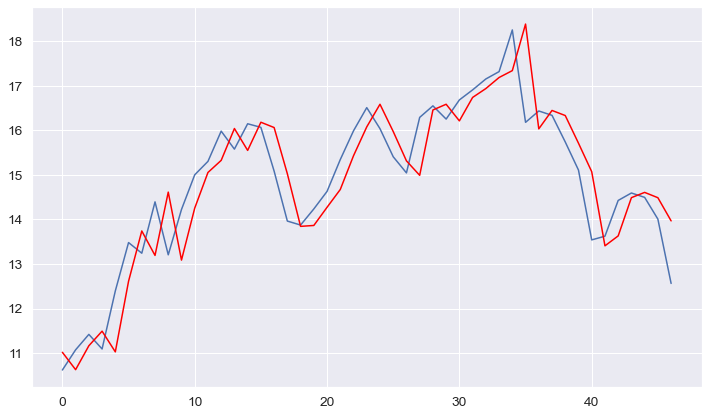

-----------------------------------------------------------------------
Solomon Islands
predicted=0.195483, expected=0.205000
predicted=0.202501, expected=0.216000
predicted=0.212319, expected=0.216000
predicted=0.216000, expected=0.224000
predicted=0.221317, expected=0.234000
predicted=0.230804, expected=0.245000
predicted=0.241785, expected=0.256000
predicted=0.253058, expected=0.275000
predicted=0.270471, expected=0.282000
predicted=0.280546, expected=0.289000
predicted=0.287604, expected=0.300000
predicted=0.297939, expected=0.308000
predicted=0.306621, expected=0.319000
predicted=0.317251, expected=0.330000
predicted=0.328456, expected=0.344000
predicted=0.342348, expected=0.348000
predicted=0.347568, expected=0.374000
predicted=0.371543, expected=0.330000
predicted=0.339722, expected=0.293000
predicted=0.293915, expected=0.289000
predicted=0.289037, expected=0.286000
predicted=0.286025, expected=0.289000
predicted=0.288973, expected=0.298000
predicted=0.297939, expected=0.299000


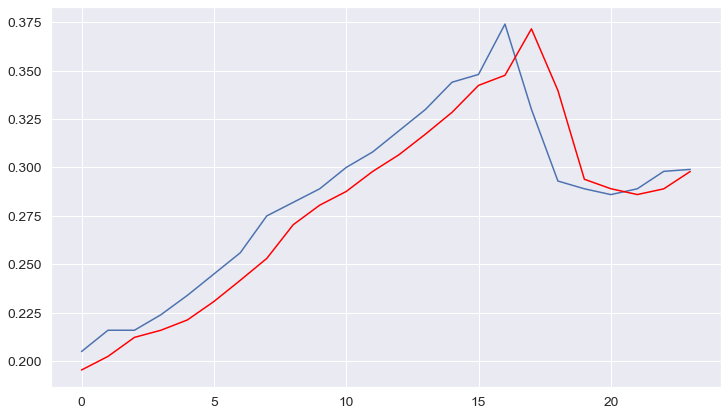

-----------------------------------------------------------------------
Somalia
predicted=0.606799, expected=0.568000
predicted=0.577317, expected=0.539000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.551849, expected=0.513000
predicted=0.524495, expected=0.491000
predicted=0.500712, expected=0.480000
predicted=0.484853, expected=0.502000
predicted=0.492286, expected=0.586000
predicted=0.549075, expected=0.594000
predicted=0.590512, expected=0.594000
predicted=0.594000, expected=0.594000
predicted=0.594000, expected=0.594000
predicted=0.594000, expected=0.608000
predicted=0.601888, expected=0.601000
predicted=0.604057, expected=0.597000
predicted=0.598747, expected=0.612000
predicted=0.605445, expected=0.612000
predicted=0.612000, expected=0.608000
predicted=0.609748, expected=0.630000
predicted=0.620379, expected=0.630000
predicted=0.630000, expected=0.630000
predicted=0.630000, expected=0.638000
predicted=0.634501, expected=0.638000
predicted=0.638000, expected=0.638000
predicted=0.638000, expected=0.665000
predicted=0.653184, expected=0.562000
Test RMSE: 0.033


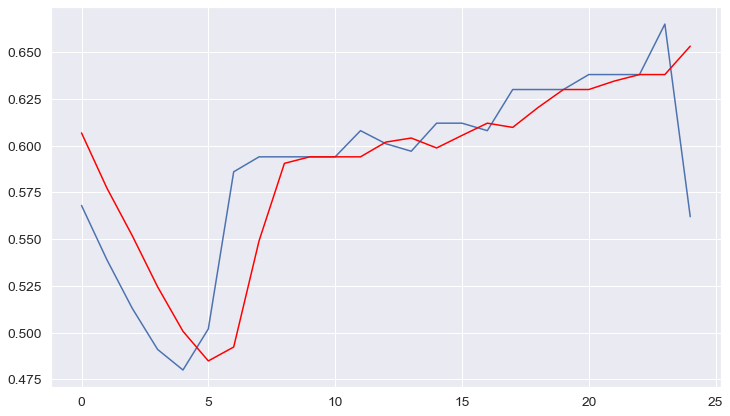

-----------------------------------------------------------------------
South Africa
predicted=174.315884, expected=176.552000
predicted=178.261634, expected=185.011000
predicted=189.687852, expected=192.917000
predicted=197.456776, expected=199.747000
predicted=203.761106, expected=201.891000
predicted=203.131476, expected=218.684000
predicted=228.773415, expected=228.217000
predicted=233.892412, expected=257.099000
predicted=277.736546, expected=280.459000
predicted=297.834993, expected=291.930000
predicted=299.972347, expected=315.624000
predicted=333.472204, expected=323.890000
predicted=329.638851, expected=330.526000
predicted=335.153866, expected=328.696000
predicted=327.439350, expected=342.696000
predicted=352.203633, expected=340.752000
predicted=339.506098, expected=312.973000
predicted=294.878034, expected=326.069000
predicted=332.311631, expected=301.367000
predicted=291.558747, expected=320.391000
predicted=325.579902, expected=338.625000
predicted=344.338083, expected=36

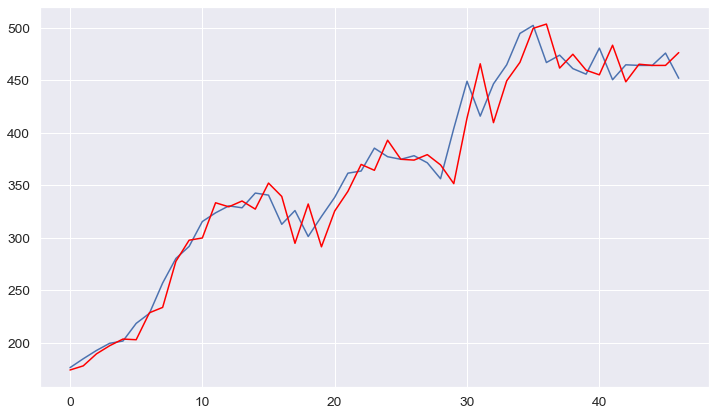

-----------------------------------------------------------------------
South America
predicted=393.018821, expected=416.699000
predicted=417.912674, expected=412.131000
predicted=411.937897, expected=419.568000
predicted=419.866048, expected=435.041000
predicted=435.770983, expected=461.426000
predicted=463.318884, expected=494.425000
predicted=498.398673, expected=508.467000
predicted=510.418118, expected=489.334000
predicted=486.988255, expected=490.651000
predicted=490.807496, expected=485.838000
predicted=485.267734, expected=491.927000
predicted=492.637975, expected=502.054000
predicted=503.267801, expected=530.170000
predicted=533.949035, expected=557.530000
predicted=562.138486, expected=580.554000
predicted=585.005389, expected=580.184000
predicted=580.114438, expected=595.614000
predicted=598.510583, expected=603.004000
predicted=604.415794, expected=615.051000
predicted=617.397531, expected=650.401000
predicted=657.946480, expected=667.658000
predicted=671.605446, expected=6

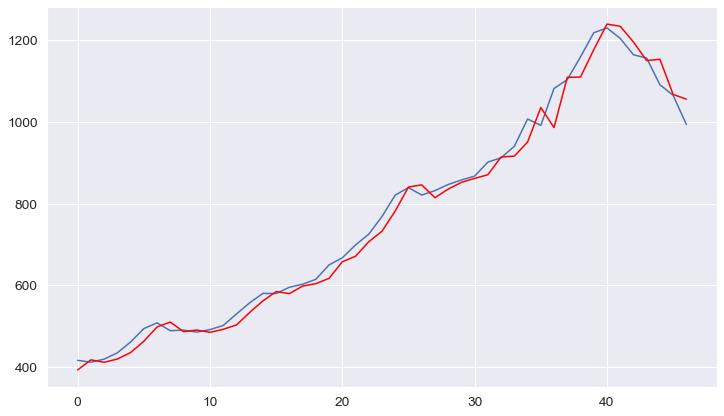

-----------------------------------------------------------------------
South Korea
predicted=135.559669, expected=139.613000
predicted=142.833782, expected=140.806000
predicted=141.551576, expected=149.165000
predicted=154.443590, expected=160.735000
predicted=168.482214, expected=168.792000
predicted=174.206847, expected=176.337000
predicted=181.490373, expected=185.399000
predicted=191.751305, expected=211.000000
predicted=231.366555, expected=223.565000
predicted=232.531927, expected=250.469000
predicted=271.918974, expected=275.657000
predicted=296.471789, expected=300.033000
predicted=320.701457, expected=330.272000
predicted=357.307107, expected=355.836000
predicted=378.509354, expected=383.696000
predicted=408.942091, expected=421.095000
predicted=456.418945, expected=445.188000
predicted=466.919191, expected=378.444000
predicted=334.607889, expected=410.996000
predicted=419.989244, expected=440.531000
predicted=450.055098, expected=456.245000
predicted=461.499995, expected=476

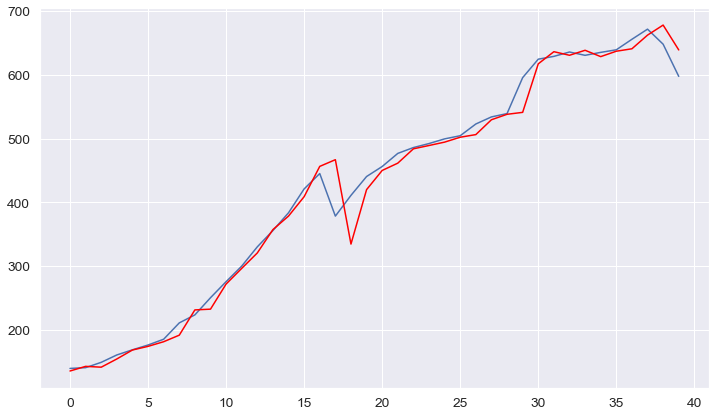

-----------------------------------------------------------------------
South Sudan
predicted=0.352712, expected=0.367000
predicted=0.364001, expected=0.450000
predicted=0.428108, expected=0.390000
predicted=0.407441, expected=0.423000
predicted=0.413149, expected=0.460000
predicted=0.449425, expected=0.529000
predicted=0.510930, expected=0.674000
predicted=0.648831, expected=0.753000
predicted=0.747270, expected=0.952000
predicted=0.958330, expected=0.912000
predicted=0.912641, expected=0.999000
predicted=0.996059, expected=1.173000
predicted=1.180384, expected=1.239000
predicted=1.244700, expected=1.291000
predicted=1.296163, expected=1.313000
predicted=1.315265, expected=1.281000
predicted=1.277806, expected=1.330000
predicted=1.334550, expected=1.444000
predicted=1.457100, expected=1.524000
predicted=1.535402, expected=1.913000
predicted=2.011661, expected=1.704000
predicted=1.710624, expected=1.455000
predicted=1.434175, expected=1.337000
predicted=1.321712, expected=1.395000
pred

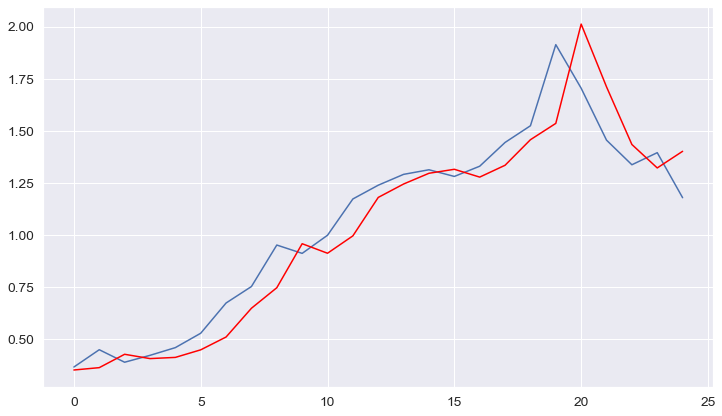

-----------------------------------------------------------------------
Spain
predicted=40.312158, expected=42.333000
predicted=42.488992, expected=50.213000
predicted=51.078819, expected=55.873000
predicted=56.900432, expected=52.079000
predicted=51.575585, expected=48.866000
predicted=48.382113, expected=53.607000
predicted=54.184541, expected=59.976000
predicted=61.039751, expected=58.743000
predicted=58.564920, expected=64.324000
predicted=65.068734, expected=71.020000
predicted=72.239998, expected=77.617000
predicted=79.145871, expected=86.394000
predicted=88.971962, expected=97.017000
predicted=101.019170, expected=96.737000
predicted=96.644757, expected=116.766000
predicted=123.225648, expected=128.459000
predicted=133.125864, expected=144.716000
predicted=152.659865, expected=154.957000
predicted=160.176536, expected=172.666000
predicted=182.885003, expected=181.054000
predicted=185.771142, expected=197.746000
predicted=207.862878, expected=194.829000
predicted=193.310074, expe

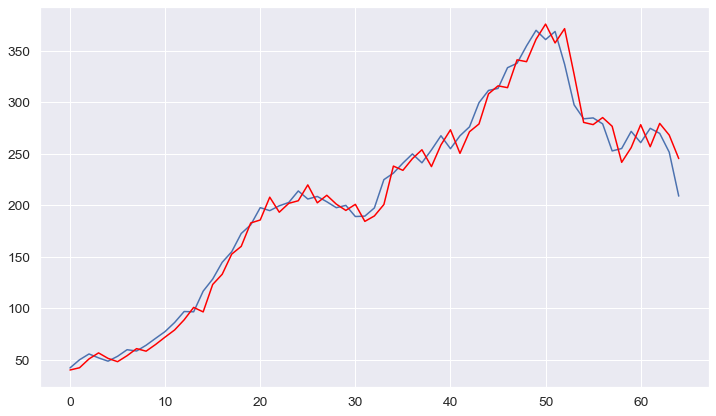

-----------------------------------------------------------------------
Sri Lanka
predicted=5.774210, expected=6.971000
predicted=6.908291, expected=7.520000
predicted=7.527886, expected=7.736000
predicted=7.741428, expected=8.517000
predicted=8.548868, expected=10.134000
predicted=10.376311, expected=10.326000
predicted=10.353664, expected=10.948000
predicted=11.042680, expected=10.953000
predicted=10.953742, expected=12.147000
predicted=12.324404, expected=11.935000
predicted=11.909728, expected=11.793000
predicted=11.775845, expected=12.152000
predicted=12.194169, expected=11.987000
predicted=11.968381, expected=12.945000
predicted=13.043396, expected=13.051000
predicted=13.061936, expected=14.886000
predicted=15.095599, expected=15.798000
predicted=15.959820, expected=14.679000
predicted=14.542172, expected=17.691000
predicted=17.587750, expected=19.830000
predicted=20.211829, expected=23.027000
predicted=24.122766, expected=23.030000
predicted=23.030804, expected=20.998000
predict

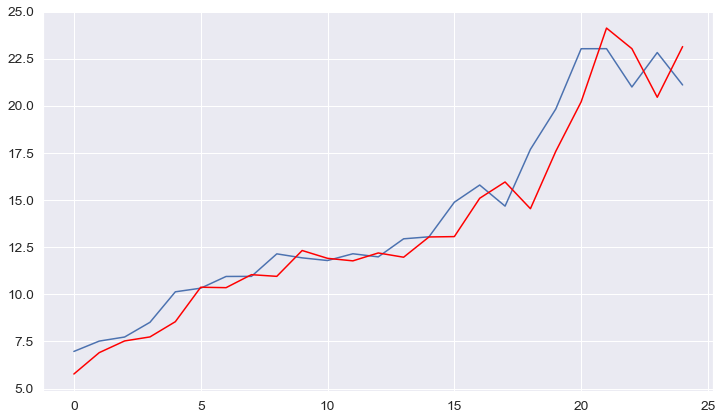

-----------------------------------------------------------------------
St. Kitts-Nevis-Anguilla
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
predicted=0.037000, expected=0.037000
Test RMSE: 0.000


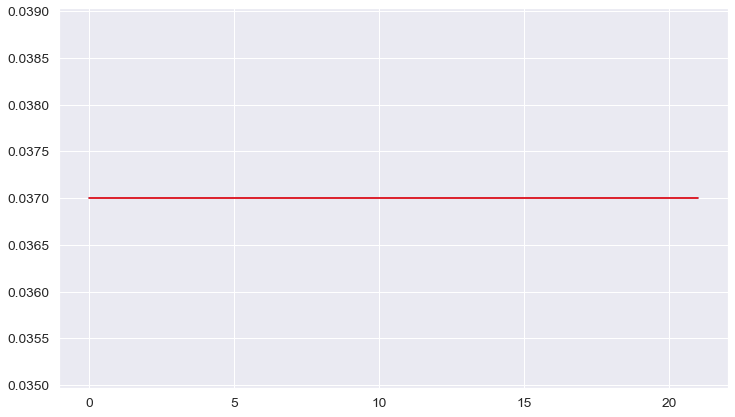

-----------------------------------------------------------------------
Sudan
predicted=3.870265, expected=4.028000
predicted=3.993481, expected=4.940000
predicted=4.696402, expected=4.285000
predicted=4.477116, expected=4.645000
predicted=4.536691, expected=5.055000
predicted=4.936780, expected=5.817000
predicted=5.615680, expected=7.418000
predicted=7.136732, expected=8.285000
predicted=8.220217, expected=10.471000
predicted=10.532248, expected=10.028000
predicted=10.036080, expected=10.984000
predicted=10.949868, expected=12.905000
predicted=12.980172, expected=13.634000
predicted=13.694437, expected=14.189000
predicted=14.241864, expected=14.398000
predicted=14.418526, expected=14.017000
predicted=13.980656, expected=14.539000
predicted=14.585061, expected=16.175000
predicted=16.364432, expected=16.645000
predicted=16.706031, expected=20.163000
predicted=20.789962, expected=19.311000
predicted=19.256651, expected=21.715000
predicted=21.759268, expected=21.180000
predicted=21.184479

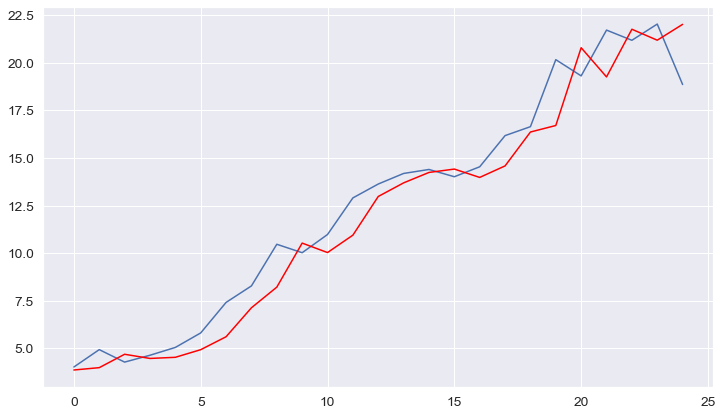

-----------------------------------------------------------------------
Suriname
predicted=2.057680, expected=2.083000
predicted=2.079161, expected=2.104000
predicted=2.100341, expected=2.104000
predicted=2.104000, expected=2.123000
predicted=2.119687, expected=2.192000
predicted=2.180022, expected=2.363000
predicted=2.334599, expected=1.560000
predicted=1.754168, expected=1.538000
predicted=1.541709, expected=1.556000
predicted=1.552962, expected=1.589000
predicted=1.583438, expected=1.739000
predicted=1.714041, expected=1.756000
predicted=1.753215, expected=1.935000
predicted=1.905909, expected=1.994000
predicted=1.984793, expected=2.396000
predicted=2.337347, expected=2.180000
predicted=2.216799, expected=2.635000
predicted=2.541964, expected=2.744000
predicted=2.725234, expected=2.809000
predicted=2.798015, expected=2.702000
predicted=2.720320, expected=2.276000
predicted=2.341826, expected=2.474000
predicted=2.439750, expected=2.514000
predicted=2.507270, expected=2.520000
predict

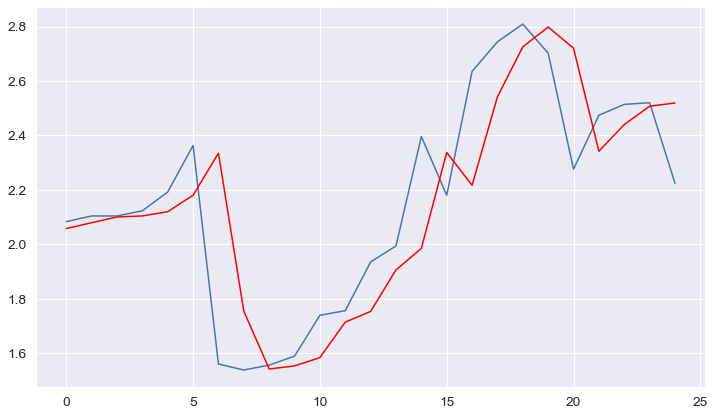

-----------------------------------------------------------------------
Sweden
predicted=43.448380, expected=38.843000
predicted=38.875345, expected=42.071000
predicted=41.991778, expected=42.388000
predicted=42.380701, expected=49.171000
predicted=49.032199, expected=48.800000
predicted=48.808250, expected=51.273000
predicted=51.215466, expected=55.313000
predicted=55.264752, expected=60.368000
predicted=60.421967, expected=62.562000
predicted=62.610750, expected=72.517000
predicted=72.967517, expected=68.930000
predicted=68.906067, expected=77.606000
predicted=77.407306, expected=86.381000
predicted=86.784220, expected=92.287000
predicted=92.794401, expected=84.509000
predicted=84.147099, expected=84.703000
predicted=84.711383, expected=87.290000
predicted=87.402785, expected=79.823000
predicted=79.609203, expected=80.760000
predicted=80.780938, expected=88.241000
predicted=88.446361, expected=85.740000
predicted=85.706911, expected=79.476000
predicted=79.324879, expected=84.869000
p

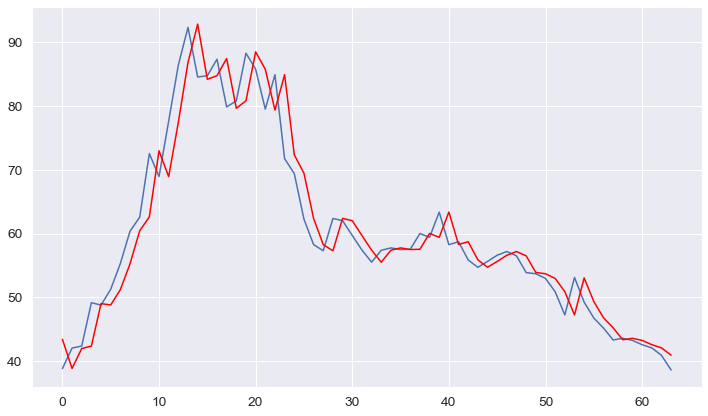

-----------------------------------------------------------------------
Switzerland
predicted=27.996792, expected=30.329000
predicted=30.611542, expected=31.489000
predicted=31.649953, expected=32.519000
predicted=32.667433, expected=35.981000
predicted=36.542009, expected=38.047000
predicted=38.435173, expected=40.244000
predicted=40.696625, expected=41.888000
predicted=42.247114, expected=42.916000
predicted=43.145863, expected=46.203000
predicted=46.985861, expected=41.427000
predicted=40.677442, expected=39.051000
predicted=38.603829, expected=40.437000
predicted=40.674078, expected=41.038000
predicted=41.141993, expected=42.170000
predicted=42.368610, expected=39.865000
predicted=39.485999, expected=40.491000
predicted=40.588419, expected=38.812000
predicted=38.557812, expected=36.586000
predicted=36.221330, expected=40.023000
predicted=40.478607, expected=39.129000
predicted=39.025141, expected=39.781000
predicted=39.855195, expected=42.247000
predicted=42.541123, expected=40.205

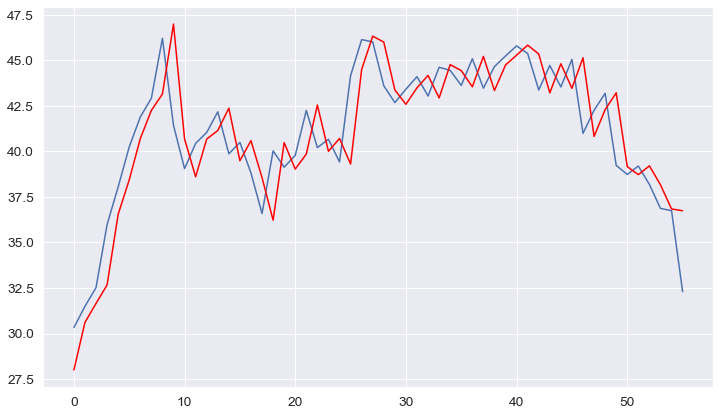

-----------------------------------------------------------------------
Syria
predicted=34.625715, expected=37.045000
predicted=36.559267, expected=42.201000
predicted=41.671120, expected=42.562000
predicted=42.531691, expected=45.222000
predicted=45.009307, expected=46.190000
predicted=46.124695, expected=41.200000
predicted=41.630494, expected=42.322000
predicted=42.211218, expected=45.378000
predicted=45.115337, expected=49.756000
predicted=49.595554, expected=51.772000
predicted=51.760644, expected=50.481000
predicted=50.498965, expected=48.140000
predicted=48.149684, expected=38.439000
predicted=37.789572, expected=53.582000
predicted=49.026160, expected=50.385000
predicted=51.245439, expected=49.882000
predicted=50.014062, expected=52.841000
predicted=52.057718, expected=65.719000
predicted=63.101009, expected=66.877000
predicted=66.709120, expected=61.562000
predicted=62.370283, expected=60.717000
predicted=60.836917, expected=57.785000
predicted=58.192343, expected=47.231000
pr

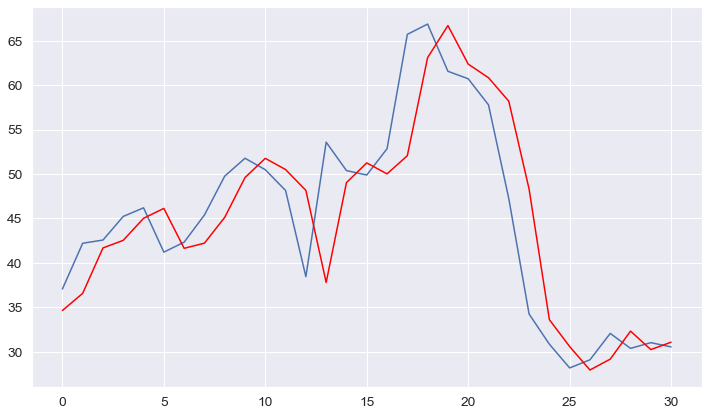

-----------------------------------------------------------------------
Taiwan
predicted=64.352293, expected=71.023000
predicted=78.373548, expected=75.760000
predicted=78.990388, expected=83.507000
predicted=89.154673, expected=75.043000
predicted=70.734885, expected=75.376000
predicted=75.522628, expected=83.127000
predicted=86.569737, expected=84.854000
predicted=85.584876, expected=84.722000
predicted=84.666440, expected=94.321000
predicted=98.334642, expected=98.172000
predicted=99.774183, expected=113.075000
predicted=120.276204, expected=123.107000
predicted=128.389107, expected=124.066000
predicted=124.532201, expected=133.586000
predicted=138.286356, expected=142.172000
predicted=146.682719, expected=153.793000
predicted=160.464393, expected=161.160000
predicted=165.432693, expected=168.873000
predicted=173.481965, expected=176.779000
predicted=181.637101, expected=190.542000
predicted=199.609279, expected=200.159000
predicted=206.536579, expected=207.796000
predicted=212.9106

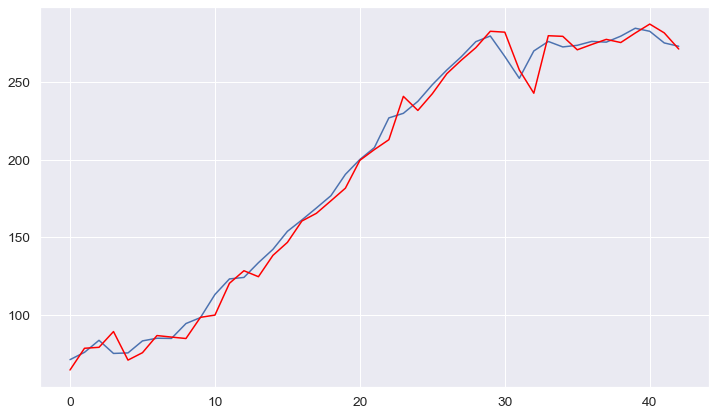

-----------------------------------------------------------------------
Tajikistan
predicted=3.704166, expected=3.838000
predicted=4.019077, expected=4.200000
predicted=4.407240, expected=4.484000
predicted=4.651155, expected=4.714000
predicted=4.851641, expected=4.909000
predicted=5.027078, expected=5.064000
predicted=5.158448, expected=5.318000
predicted=5.476011, expected=5.706000
predicted=5.958640, expected=6.070000
predicted=6.314305, expected=6.439000
predicted=6.693954, expected=6.801000
predicted=7.056985, expected=7.115000
predicted=7.339615, expected=7.319000
predicted=7.464441, expected=7.625000
predicted=7.846834, expected=8.022000
predicted=8.317327, expected=8.518000
predicted=8.900139, expected=8.967000
predicted=9.317520, expected=9.352000
predicted=9.654298, expected=9.715000
predicted=10.002383, expected=10.216000
predicted=10.622897, expected=10.607000
predicted=10.923801, expected=10.967000
predicted=11.260152, expected=11.347000
predicted=11.659192, expected=11.43

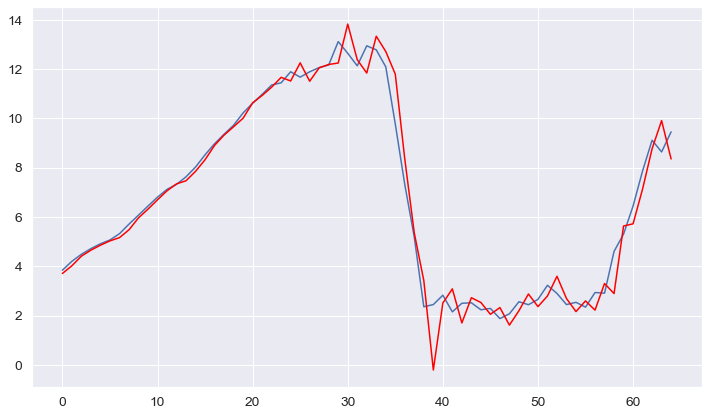

-----------------------------------------------------------------------
Tanzania
predicted=2.237844, expected=2.527000
predicted=2.480129, expected=2.824000
predicted=2.676548, expected=2.481000
predicted=2.655811, expected=2.459000
predicted=2.469888, expected=2.572000
predicted=2.516000, expected=3.041000
predicted=2.814944, expected=3.486000
predicted=3.301205, expected=3.687000
predicted=3.610509, expected=4.232000
predicted=4.038481, expected=5.359000
predicted=5.113781, expected=5.880000
predicted=5.835222, expected=5.710000
predicted=5.726237, expected=5.915000
predicted=5.894457, expected=5.771000
predicted=5.785962, expected=6.927000
predicted=6.779891, expected=7.752000
predicted=7.759088, expected=9.062000
predicted=9.229652, expected=9.909000
predicted=10.087642, expected=9.900000
predicted=9.898226, expected=10.639000
predicted=10.784127, expected=10.873000
predicted=10.920245, expected=11.407000
predicted=11.519852, expected=11.791000
predicted=11.876668, expected=12.0430

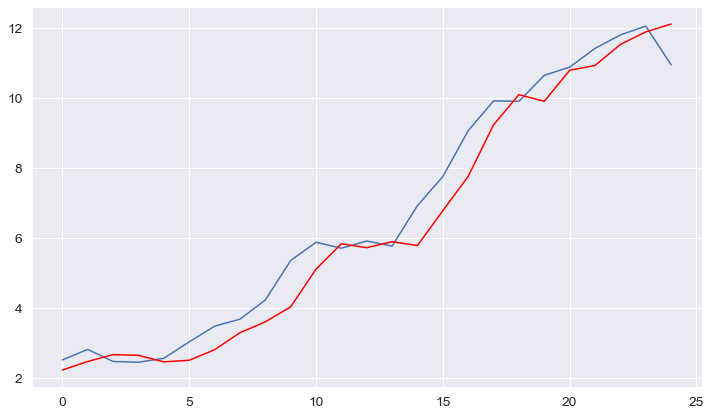

-----------------------------------------------------------------------
Thailand
predicted=87.198315, expected=87.916000
predicted=96.317799, expected=96.748000
predicted=104.135544, expected=105.964000
predicted=113.879815, expected=120.911000
predicted=134.752494, expected=133.299000
predicted=144.561155, expected=155.517000
predicted=177.037073, expected=173.729000
predicted=190.966141, expected=178.594000
predicted=182.707835, expected=158.145000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=142.207565, expected=164.987000
predicted=169.009957, expected=168.800000
predicted=171.040223, expected=180.708000
predicted=187.875178, expected=190.810000
predicted=197.024141, expected=201.993000
predicted=209.075502, expected=217.171000
predicted=227.254652, expected=222.990000
predicted=226.735861, expected=226.331000
predicted=228.479577, expected=229.410000
predicted=231.393427, expected=226.873000
predicted=225.249799, expected=242.274000
predicted=251.901528, expected=255.405000
predicted=263.820897, expected=253.612000
predicted=252.530114, expected=270.268000
predicted=280.155582, expected=287.598000
predicted=298.437357, expected=282.648000
predicted=279.878303, expected=285.688000
predicted=287.368151, expected=283.435000
predicted=282.196128, expected=285.960000
predicted=287.343455, expected=276.177000
predicted=270.884338, expected=271.625000
predicted=269.169678, expected=257.766000
Test RMSE: 9.900


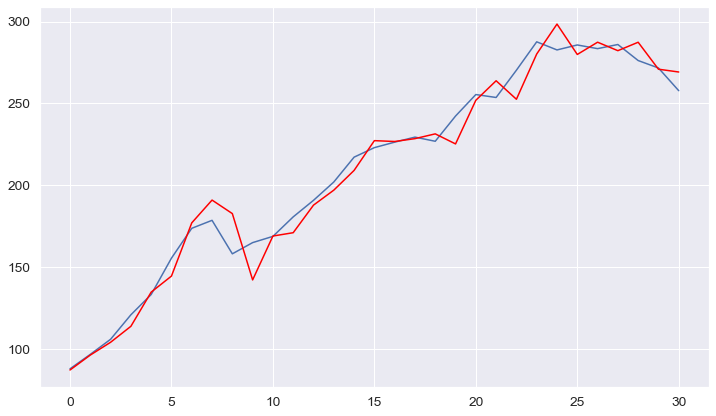

-----------------------------------------------------------------------
Timor
predicted=0.242638, expected=0.234000
predicted=0.237303, expected=0.245000
predicted=0.250597, expected=0.293000
predicted=0.326299, expected=0.542000
predicted=0.767171, expected=0.608000
predicted=0.636450, expected=0.601000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


predicted=0.598201, expected=0.495000
predicted=0.451806, expected=0.498000
predicted=0.499051, expected=0.509000
predicted=0.512863, expected=0.525000
predicted=0.530651, expected=0.526000
Test RMSE: 0.089


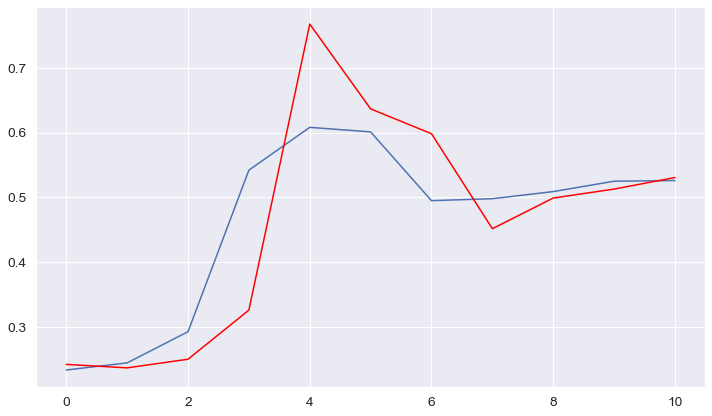

-----------------------------------------------------------------------
Togo
predicted=1.099896, expected=1.265000
predicted=1.226271, expected=0.879000
predicted=1.052092, expected=1.290000
predicted=1.085073, expected=1.850000
predicted=1.660558, expected=1.331000
predicted=1.547927, expected=1.159000
predicted=1.217389, expected=1.322000
predicted=1.265526, expected=1.805000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=1.654093, expected=1.744000
predicted=1.762141, expected=1.722000
predicted=1.728526, expected=1.501000
predicted=1.566166, expected=1.517000
predicted=1.512340, expected=1.523000
predicted=1.521252, expected=2.741000
predicted=2.392492, expected=2.596000
predicted=2.629374, expected=2.504000
predicted=2.524803, expected=2.216000
predicted=2.279277, expected=1.643000
predicted=1.745597, expected=1.542000
predicted=1.557662, expected=1.866000
predicted=1.813688, expected=2.306000
predicted=2.249096, expected=2.210000
predicted=2.222738, expected=2.290000
predicted=2.279283, expected=2.305000
predicted=2.302996, expected=2.192000
Test RMSE: 0.393


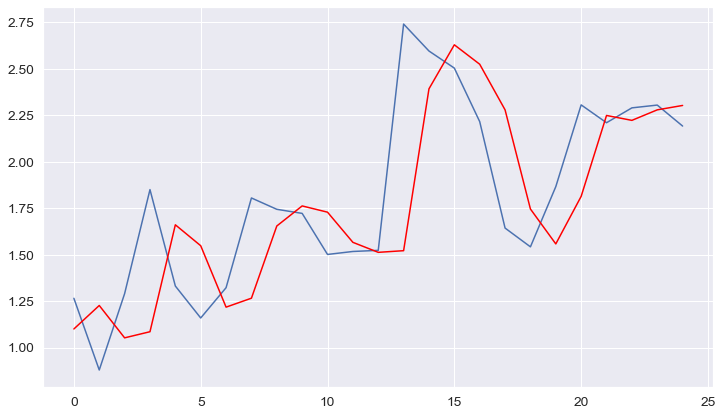

-----------------------------------------------------------------------
Tonga
predicted=0.093978, expected=0.077000
predicted=0.083540, expected=0.099000
predicted=0.088611, expected=0.088000
predicted=0.093243, expected=0.110000
predicted=0.098231, expected=0.095000
predicted=0.103317, expected=0.088000
predicted=0.091466, expected=0.103000
predicted=0.095265, expected=0.117000
predicted=0.110882, expected=0.110000
predicted=0.113079, expected=0.114000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.112235, expected=0.128000
predicted=0.122022, expected=0.114000
predicted=0.120320, expected=0.121000
predicted=0.117826, expected=0.132000
predicted=0.127238, expected=0.117000
predicted=0.123834, expected=0.103000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.108536, expected=0.106000
predicted=0.104834, expected=0.114000
predicted=0.110930, expected=0.114000
predicted=0.114000, expected=0.121000
predicted=0.118345, expected=0.128000
predicted=0.125431, expected=0.158000
predicted=0.148221, expected=0.139000
predicted=0.146007, expected=0.144000
predicted=0.142184, expected=0.144000
Test RMSE: 0.013


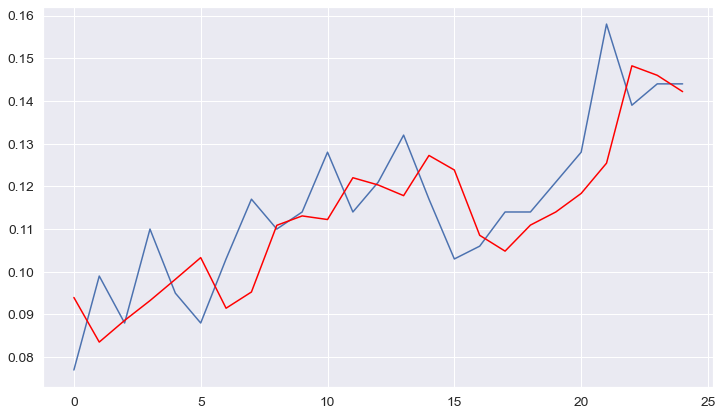

-----------------------------------------------------------------------
Trinidad and Tobago
predicted=17.197782, expected=18.405000
predicted=18.247440, expected=16.276000
predicted=16.582306, expected=17.504000
predicted=17.318617, expected=20.723000
predicted=20.285444, expected=17.355000
predicted=17.922416, expected=17.489000
predicted=17.467071, expected=15.833000
predicted=16.105219, expected=16.105000
predicted=16.060281, expected=16.981000
predicted=16.837685, expected=16.968000
predicted=16.970122, expected=19.103000
predicted=18.754278, expected=17.411000
predicted=17.703089, expected=17.024000
predicted=17.089390, expected=16.460000
predicted=16.554867, expected=20.768000
predicted=20.010998, expected=20.560000
predicted=20.595067, expected=19.751000
predicted=19.886977, expected=22.464000
predicted=21.990990, expected=24.191000
predicted=23.920319, expected=26.569000
predicted=26.228137, expected=28.591000
predicted=28.333872, expected=32.251000
predicted=31.868158, expecte

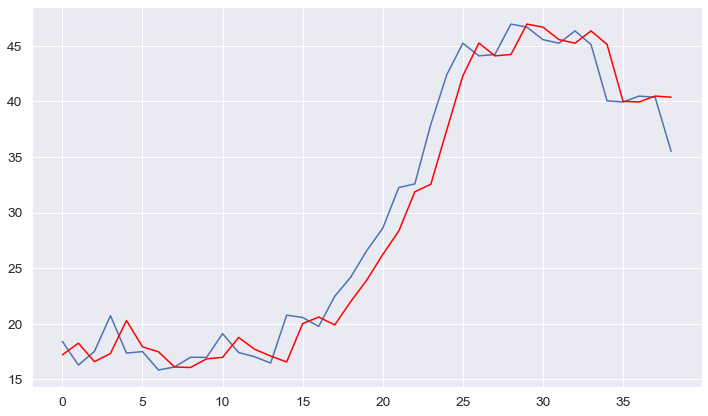

-----------------------------------------------------------------------
Tunisia
predicted=11.566669, expected=11.871000
predicted=11.997764, expected=11.992000
predicted=12.032136, expected=11.663000
predicted=11.555232, expected=12.377000
predicted=12.592989, expected=13.140000
predicted=13.396881, expected=13.126000
predicted=13.121527, expected=15.364000
predicted=16.068853, expected=14.891000
predicted=14.815175, expected=16.353000
predicted=16.525487, expected=15.777000
predicted=15.741506, expected=15.547000
predicted=15.531520, expected=16.581000
predicted=16.637957, expected=16.747000
predicted=16.757042, expected=17.809000
predicted=17.882076, expected=18.119000
predicted=18.143872, expected=19.672000
predicted=19.829651, expected=20.546000
predicted=20.674261, expected=20.559000
predicted=20.560856, expected=20.926000
predicted=20.978479, expected=21.927000
predicted=22.083765, expected=22.269000
predicted=22.324959, expected=22.602000
predicted=22.657677, expected=23.684000


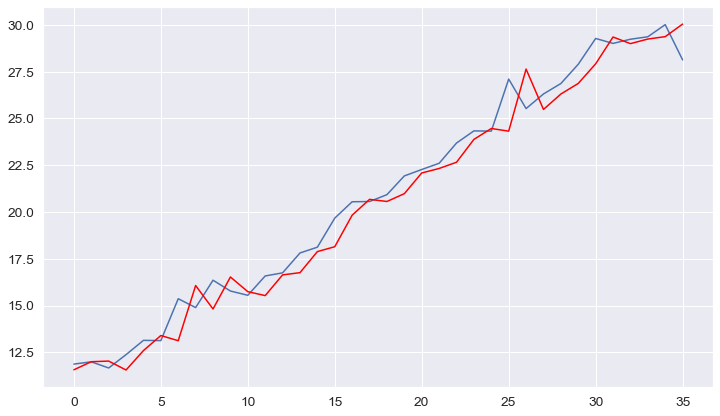

-----------------------------------------------------------------------
Turkey
predicted=33.221051, expected=33.479000
predicted=34.320670, expected=36.265000
predicted=37.581934, expected=38.753000
predicted=40.018341, expected=42.579000
predicted=44.773515, expected=47.638000
predicted=51.027342, expected=53.722000
predicted=58.382181, expected=59.310000
predicted=63.763888, expected=60.929000
predicted=62.097572, expected=65.419000
predicted=68.769883, expected=73.359000
predicted=79.956155, expected=81.121000
predicted=87.798872, expected=76.714000
predicted=73.983740, expected=75.038000
predicted=74.020301, expected=75.212000
predicted=75.316742, expected=79.186000
predicted=81.584120, expected=86.210000
predicted=90.771447, expected=89.812000
predicted=92.096914, expected=94.906000
predicted=98.248900, expected=105.662000
predicted=113.536108, expected=115.618000
predicted=123.269073, expected=128.442000
predicted=139.195664, expected=124.728000
predicted=122.402346, expected=137

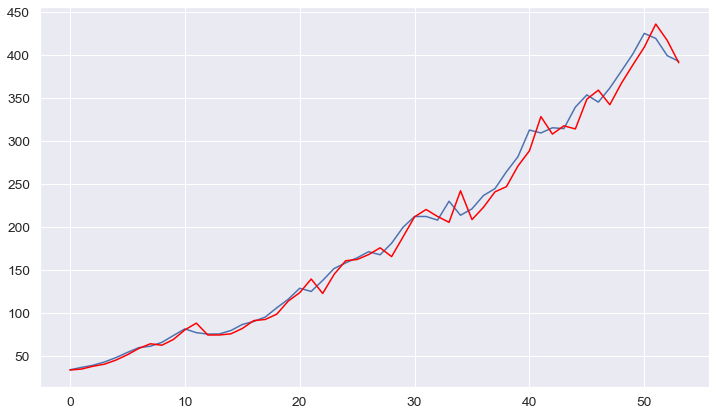

-----------------------------------------------------------------------
Turkmenistan
predicted=9.050605, expected=9.394000
predicted=9.840415, expected=10.288000
predicted=10.798256, expected=10.993000
predicted=11.407236, expected=11.561000
predicted=11.900417, expected=12.043000
predicted=12.334523, expected=12.441000
predicted=12.683516, expected=13.082000
predicted=13.481306, expected=14.053000
predicted=14.687259, expected=14.967000
predicted=15.583082, expected=15.887000
predicted=16.525503, expected=16.785000
predicted=17.422741, expected=17.572000
predicted=18.137689, expected=18.086000
predicted=18.454190, expected=18.851000
predicted=19.408386, expected=19.815000
predicted=20.534807, expected=21.056000
predicted=22.016768, expected=22.171000
predicted=23.045029, expected=23.130000
predicted=23.886088, expected=24.034000
predicted=24.752572, expected=25.282000
predicted=26.299849, expected=26.252000
predicted=27.040801, expected=27.144000
predicted=27.872896, expected=28.08200

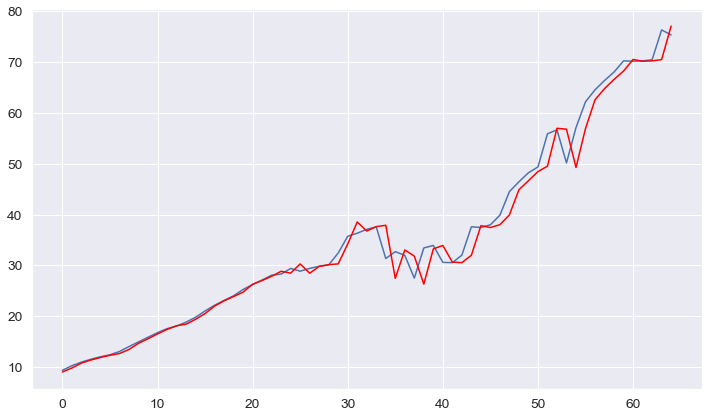

-----------------------------------------------------------------------
Turks and Caicos Islands
predicted=0.184831, expected=0.183000
predicted=0.184883, expected=0.183000
predicted=0.183000, expected=0.183000
predicted=0.183000, expected=0.187000
predicted=0.189500, expected=0.198000
predicted=0.204747, expected=0.205000
predicted=0.209305, expected=0.216000
predicted=0.222956, expected=0.231000
predicted=0.240948, expected=0.234000
predicted=0.235890, expected=0.229000
predicted=0.225886, expected=0.203000
Test RMSE: 0.009


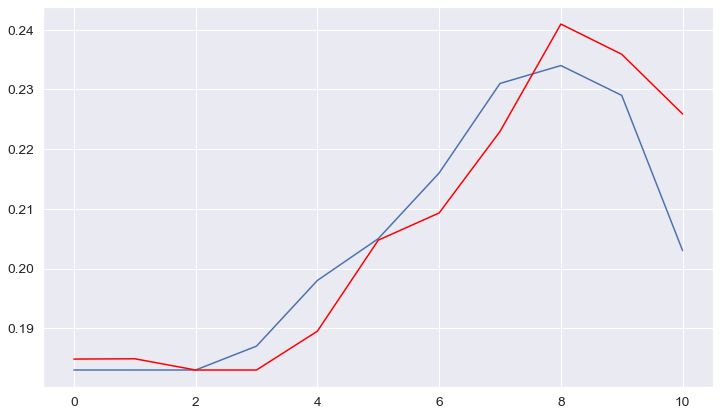

-----------------------------------------------------------------------
Tuvalu
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.011000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.011000, expected=0.011000
predicted=0.011000, expected=0.007000
predicted=0.008624, expected=0.007000
predicted=0.007000, expected=0.007000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.007000
predicted=0.007000, expected=0.008000
predicted=0.007629, expected=0.008000
Test RMSE: 0.001


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


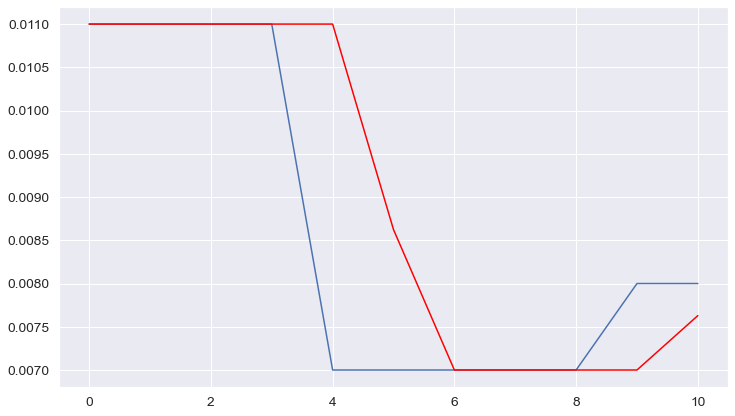

-----------------------------------------------------------------------
Uganda
predicted=1.034843, expected=1.018000
predicted=1.064309, expected=1.062000
predicted=1.083898, expected=1.209000
predicted=1.283946, expected=1.255000
predicted=1.278039, expected=1.361000
predicted=1.414960, expected=1.417000
predicted=1.445543, expected=1.446000
predicted=1.460788, expected=1.513000
predicted=1.547384, expected=1.607000
predicted=1.656021, expected=2.018000
predicted=2.258876, expected=2.383000
predicted=2.624276, expected=2.710000
predicted=2.938587, expected=2.780000
predicted=2.825007, expected=3.000000
predicted=3.144251, expected=3.570000
predicted=3.994790, expected=3.824000
predicted=3.994789, expected=3.627000
predicted=3.508139, expected=3.755000
predicted=3.827769, expected=4.090000
predicted=4.288135, expected=4.526000
predicted=4.806052, expected=4.790000
predicted=4.958559, expected=5.374000
predicted=5.780867, expected=5.498000
predicted=5.574952, expected=5.721000
predicted

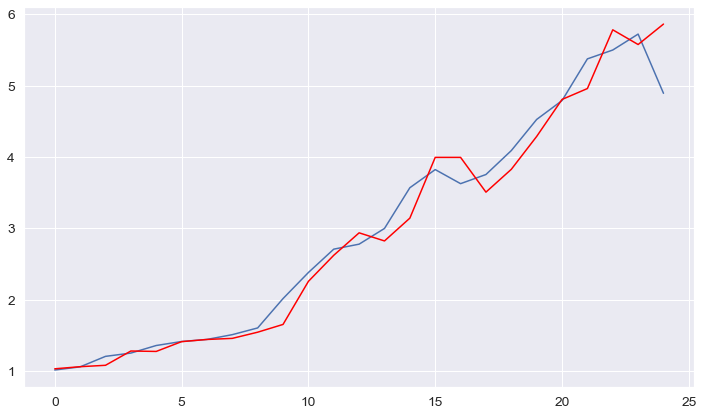

-----------------------------------------------------------------------
Ukraine
predicted=211.679835, expected=219.172000
predicted=229.478283, expected=239.831000
predicted=251.675220, expected=255.968000
predicted=265.473520, expected=269.093000
predicted=276.954321, expected=280.123000
predicted=286.805171, expected=288.822000
predicted=294.123449, expected=303.052000
predicted=311.899184, expected=324.965000
predicted=339.211513, expected=345.560000
predicted=359.358701, expected=366.521000
predicted=380.979785, expected=387.013000
predicted=401.476044, expected=404.610000
predicted=417.165974, expected=415.910000
predicted=423.944395, expected=433.109000
predicted=445.539452, expected=455.567000
predicted=472.221673, expected=483.408000
predicted=504.775983, expected=508.601000
predicted=528.193378, expected=530.038000
predicted=546.799668, expected=550.160000
predicted=566.018922, expected=578.272000
predicted=600.999343, expected=600.517000
predicted=618.478660, expected=620.894

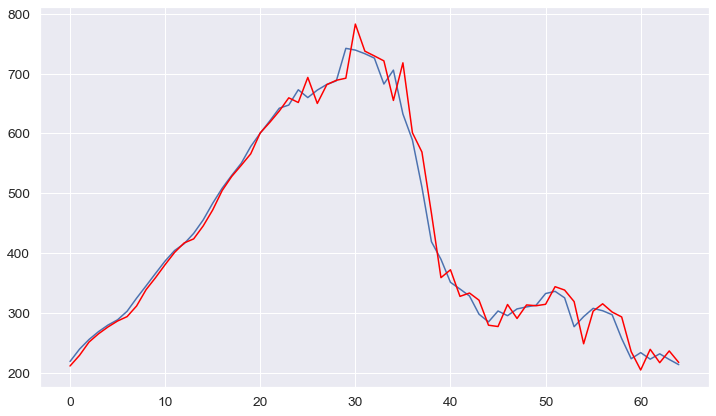

-----------------------------------------------------------------------
United Arab Emirates
predicted=79.777479, expected=77.544000
predicted=77.967822, expected=111.787000
predicted=104.064578, expected=100.591000
predicted=103.694086, expected=83.698000
predicted=86.814880, expected=105.619000
predicted=99.036959, expected=111.802000
predicted=110.484048, expected=114.478000
predicted=113.927705, expected=121.737000
predicted=120.290822, expected=133.264000
predicted=131.296874, expected=153.970000
predicted=152.014611, expected=165.500000
predicted=165.242358, expected=180.622000
predicted=180.952900, expected=192.991000
predicted=193.792503, expected=201.548000
predicted=202.289383, expected=205.390000
predicted=205.745785, expected=201.927000
predicted=201.617555, expected=216.583000
predicted=217.722817, expected=214.667000
predicted=214.536177, expected=168.831000
predicted=164.878738, expected=154.204000
predicted=151.897903, expected=154.186000
predicted=154.183247, expected=

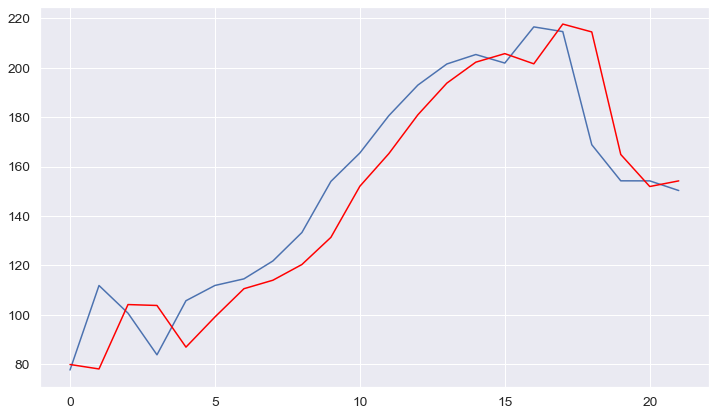

-----------------------------------------------------------------------
United Kingdom
predicted=334.853941, expected=437.640000
predicted=450.450399, expected=460.674000
predicted=450.484274, expected=441.074000
predicted=449.774283, expected=412.212000
predicted=424.876450, expected=395.900000
predicted=402.963830, expected=392.155000
predicted=393.772265, expected=423.204000
predicted=409.772268, expected=429.107000
predicted=426.577484, expected=453.796000
predicted=443.243489, expected=468.131000
predicted=462.063712, expected=448.940000
predicted=457.087215, expected=452.456000
predicted=450.965414, expected=475.144000
predicted=465.538572, expected=469.652000
predicted=471.973760, expected=468.900000
predicted=469.217833, expected=454.820000
predicted=460.770001, expected=442.025000
predicted=447.409333, expected=417.624000
predicted=427.829739, expected=436.128000
predicted=428.363440, expected=461.269000
predicted=450.821842, expected=475.563000
predicted=469.682344, expected=

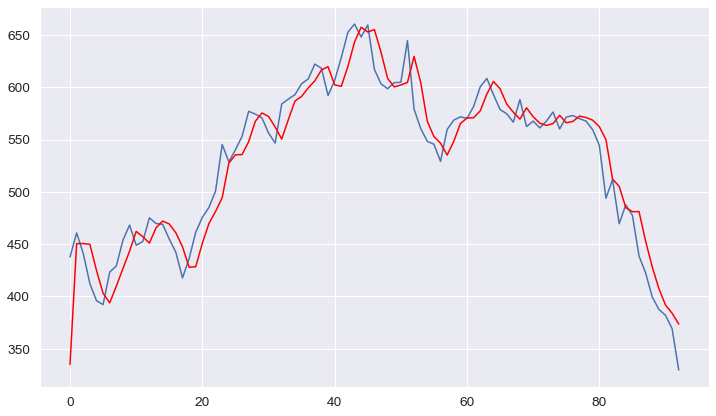

-----------------------------------------------------------------------
United States
predicted=2432.623526, expected=2359.495000
predicted=2366.401515, expected=2257.404000
predicted=2264.905239, expected=2485.752000
predicted=2464.898823, expected=2582.445000
predicted=2575.589530, expected=2164.747000
predicted=2206.861957, expected=2541.361000
predicted=2468.332171, expected=2618.576000
predicted=2606.263395, expected=2551.082000
predicted=2562.019314, expected=2612.826000
predicted=2602.692043, expected=2489.314000
predicted=2510.107582, expected=2728.348000
predicted=2684.259149, expected=2859.820000
predicted=2838.762175, expected=2835.606000
predicted=2839.490252, expected=2746.937000
predicted=2761.047076, expected=2831.737000
predicted=2817.939440, expected=2897.138000
predicted=2886.745905, expected=2886.696000
predicted=2888.355296, expected=2993.718000
predicted=2976.644925, expected=3126.294000
predicted=3106.339532, expected=3264.111000
predicted=3244.974159, expected=33

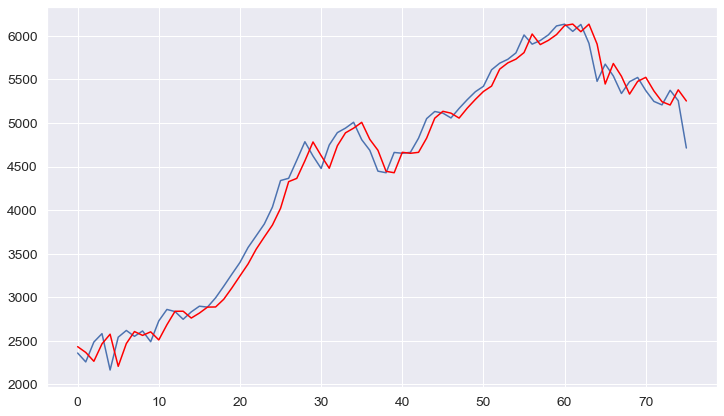

-----------------------------------------------------------------------
Upper-middle-income countries
predicted=1378.091937, expected=1405.548000
predicted=1489.596487, expected=1553.309000
predicted=1660.525777, expected=1906.204000
predicted=2228.772069, expected=2170.096000
predicted=2394.904009, expected=2317.339000
predicted=2434.791420, expected=2145.807000
predicted=2027.984759, expected=2123.147000
predicted=2108.467103, expected=2226.887000
predicted=2293.403975, expected=2362.933000
predicted=2452.436026, expected=2521.114000
predicted=2628.455395, expected=2697.083000
predicted=2820.496135, expected=2724.909000
predicted=2743.498507, expected=2869.623000
predicted=2967.266474, expected=3108.751000
predicted=3279.250958, expected=3459.116000
predicted=3734.070062, expected=3738.864000
predicted=3959.061303, expected=3933.353000
predicted=4084.703853, expected=4139.176000
predicted=4301.938007, expected=4273.348000
predicted=4378.560414, expected=4593.953000
predicted=4855.343

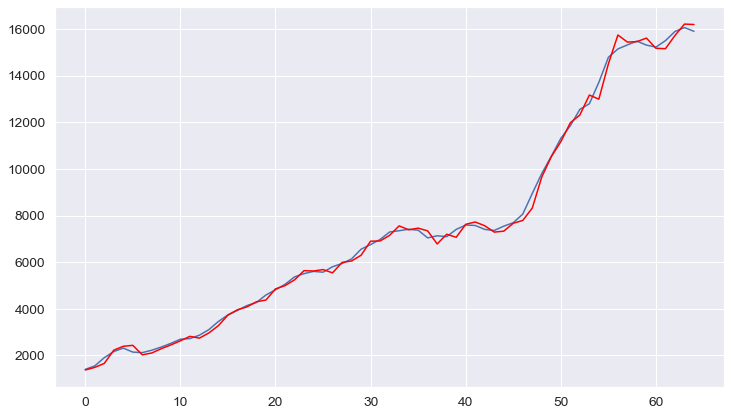

-----------------------------------------------------------------------
Uruguay
predicted=4.865915, expected=3.967000
predicted=3.800510, expected=4.528000
predicted=4.606858, expected=5.143000
predicted=5.242706, expected=4.439000
predicted=4.349202, expected=4.030000
predicted=3.971621, expected=4.557000
predicted=4.623796, expected=5.405000
predicted=5.535298, expected=5.514000
predicted=5.530629, expected=5.639000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=5.658166, expected=6.682000
predicted=6.850129, expected=5.268000
predicted=5.176614, expected=5.030000
predicted=5.012036, expected=4.558000
predicted=4.519713, expected=4.527000
predicted=4.524490, expected=5.565000
predicted=5.647257, expected=5.727000
predicted=5.740495, expected=6.597000
predicted=6.675329, expected=5.948000
predicted=5.908872, expected=8.202000
predicted=8.183172, expected=7.947000
predicted=7.954170, expected=6.298000
predicted=6.318470, expected=7.653000
predicted=7.535703, expected=8.592000
predicted=8.553378, expected=7.492000
predicted=7.571055, expected=6.684000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=6.718616, expected=6.725000
predicted=6.723237, expected=6.520000
predicted=6.528865, expected=6.163000
predicted=6.177660, expected=6.571000
predicted=6.552581, expected=6.584000
predicted=6.583418, expected=5.840000
Test RMSE: 0.865


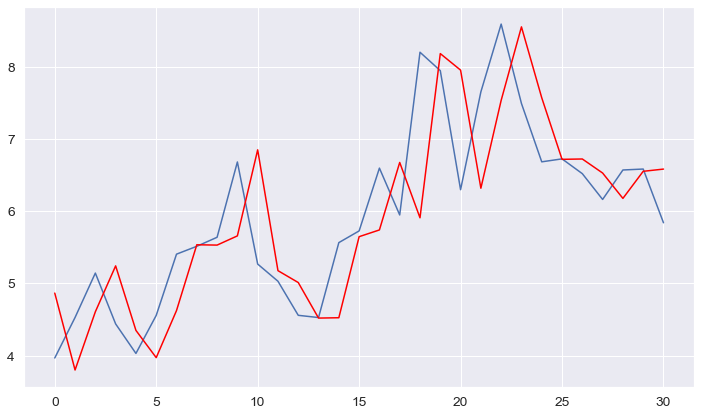

-----------------------------------------------------------------------
Uzbekistan
predicted=28.584284, expected=29.712000
predicted=31.127064, expected=32.563000
predicted=34.183851, expected=34.830000
predicted=36.159195, expected=36.635000
predicted=37.711252, expected=38.177000
predicted=39.108033, expected=39.492000
predicted=40.292807, expected=41.581000
predicted=42.883425, expected=44.734000
predicted=46.799927, expected=47.710000
predicted=49.724919, expected=50.678000
predicted=52.747328, expected=53.564000
predicted=55.622855, expected=56.109000
predicted=57.947193, expected=57.794000
predicted=59.007113, expected=60.265000
predicted=62.075025, expected=63.269000
predicted=65.520078, expected=67.285000
predicted=70.409173, expected=70.807000
predicted=73.574897, expected=73.838000
predicted=76.233237, expected=76.695000
predicted=78.970675, expected=80.650000
predicted=83.881038, expected=83.753000
predicted=86.281825, expected=86.588000
predicted=88.908948, expected=89.5740

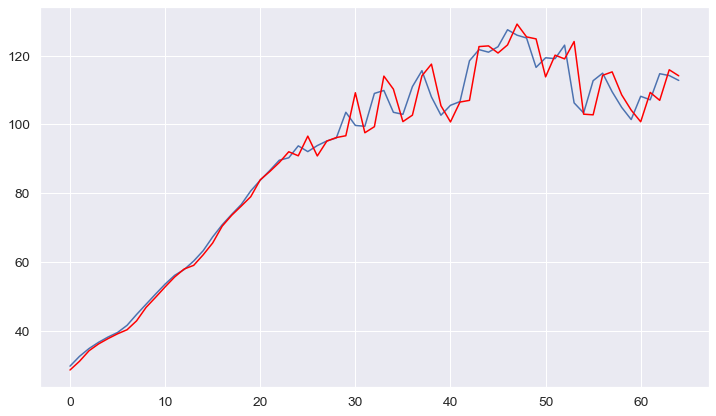

-----------------------------------------------------------------------
Vanuatu
predicted=0.083014, expected=0.084000
predicted=0.084000, expected=0.088000
predicted=0.086686, expected=0.084000
predicted=0.085318, expected=0.084000
predicted=0.084000, expected=0.059000
predicted=0.067226, expected=0.059000
predicted=0.059000, expected=0.048000
predicted=0.051451, expected=0.099000
predicted=0.081433, expected=0.095000
predicted=0.096209, expected=0.121000
predicted=0.112985, expected=0.121000
predicted=0.121000, expected=0.132000
predicted=0.128742, expected=0.114000
predicted=0.119602, expected=0.106000
predicted=0.108376, expected=0.154000
predicted=0.138731, expected=0.132000
predicted=0.139360, expected=0.147000
predicted=0.141944, expected=0.139000
predicted=0.141760, expected=0.176000
predicted=0.162738, expected=0.181000
predicted=0.179363, expected=0.182000
Test RMSE: 0.020


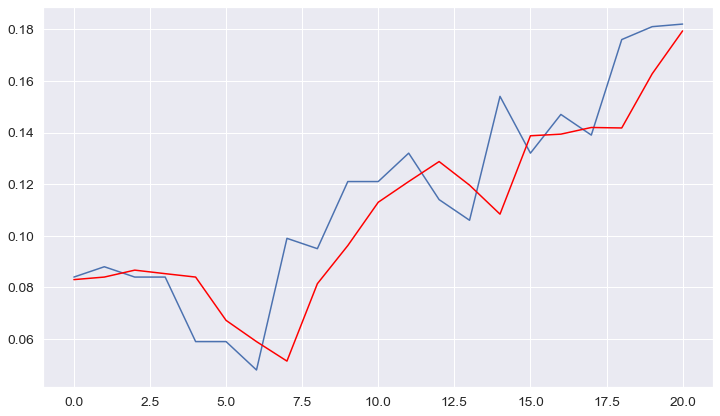

-----------------------------------------------------------------------
Venezuela
predicted=84.464746, expected=91.792000
predicted=91.303455, expected=93.201000
predicted=92.603169, expected=92.908000
predicted=93.032325, expected=93.003000
predicted=92.962684, expected=101.027000
predicted=97.622224, expected=109.240000
predicted=105.833637, expected=110.661000
predicted=110.077305, expected=115.752000
predicted=113.664785, expected=108.571000
predicted=111.534273, expected=121.823000
predicted=116.255739, expected=115.052000
predicted=117.907627, expected=105.577000
predicted=109.494592, expected=123.966000
predicted=116.117195, expected=129.531000
predicted=127.286006, expected=132.876000
predicted=131.536307, expected=122.338000
predicted=126.589202, expected=133.483000
predicted=128.911028, expected=166.804000
predicted=154.453927, expected=172.563000
predicted=170.719893, expected=151.870000
predicted=158.678683, expected=171.975000
predicted=164.914252, expected=192.747000
pred

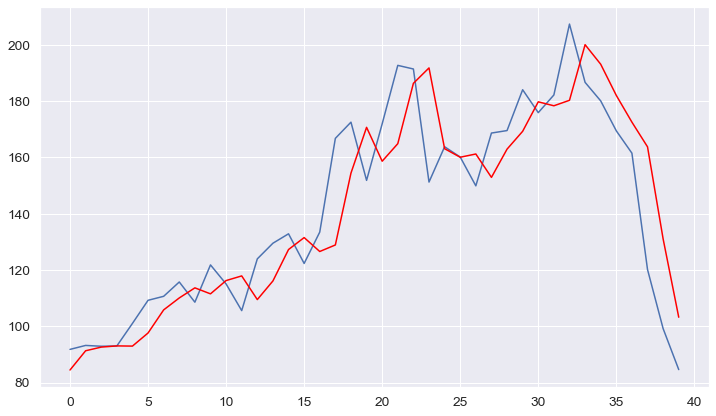

-----------------------------------------------------------------------
Vietnam
predicted=13.738778, expected=15.247000
predicted=15.205425, expected=15.388000
predicted=15.383799, expected=16.250000
predicted=16.224765, expected=16.789000
predicted=16.774337, expected=17.695000
predicted=17.672266, expected=18.342000
predicted=18.327430, expected=19.270000
predicted=19.251499, expected=17.495000
predicted=17.542609, expected=21.097000
predicted=20.905730, expected=20.585000
predicted=20.614528, expected=23.297000
predicted=23.125913, expected=23.073000
predicted=23.087256, expected=17.398000
predicted=17.731026, expected=21.299000
predicted=20.800762, expected=21.376000
predicted=21.366725, expected=21.466000
predicted=21.455160, expected=22.853000
predicted=22.686503, expected=26.169000
predicted=25.822653, expected=28.697000
predicted=28.507960, expected=34.206000
predicted=34.036241, expected=44.517000
predicted=45.856667, expected=46.791000
predicted=47.133502, expected=46.890000


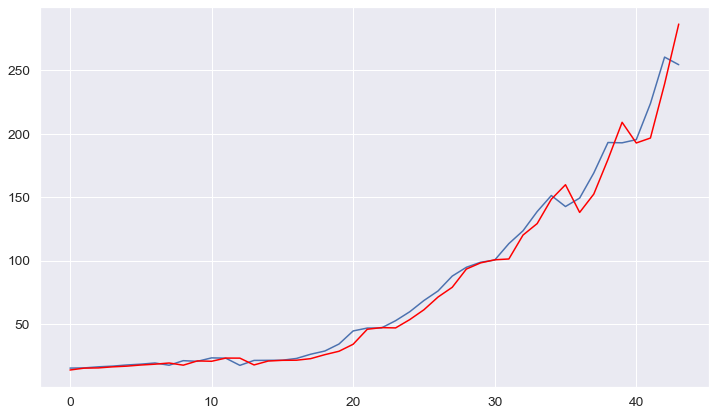

-----------------------------------------------------------------------
Wallis and Futuna


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.022827, expected=0.022000
predicted=0.022000, expected=0.022000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.022000, expected=0.026000
predicted=0.025225, expected=0.026000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.026000, expected=0.026000
predicted=0.026000, expected=0.026000


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


predicted=0.026000, expected=0.026000
Test RMSE: 0.002


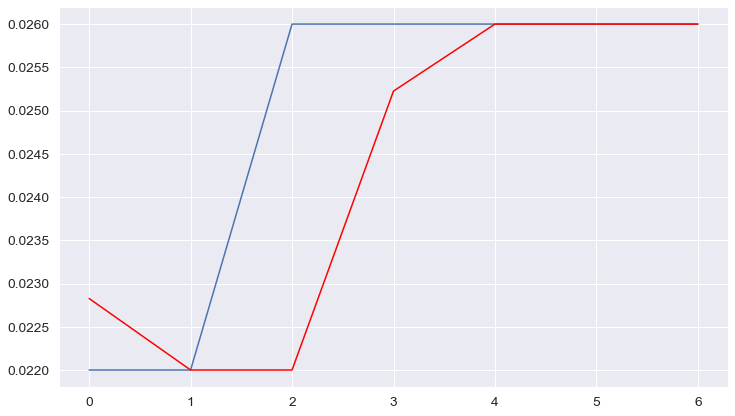

-----------------------------------------------------------------------
World
predicted=3915.265542, expected=3962.553000
predicted=3966.085423, expected=4255.151000
predicted=4199.447427, expected=3923.058000
predicted=4001.813911, expected=3505.272000
predicted=3566.813398, expected=3159.133000
predicted=3180.809716, expected=3326.454000
predicted=3312.020412, expected=3617.658000
predicted=3599.434378, expected=3796.088000
predicted=3789.483805, expected=4170.574000
predicted=4167.882787, expected=4458.901000
predicted=4469.786831, expected=4195.243000
predicted=4193.628492, expected=4438.144000
predicted=4433.561263, expected=4849.927000
predicted=4857.973951, expected=4959.186000
predicted=4962.941192, expected=4939.725000
predicted=4939.073631, expected=5023.251000
predicted=5025.998138, expected=5105.437000
predicted=5108.333160, expected=4244.738000
predicted=4235.996744, expected=4633.477000
predicted=4600.208326, expected=5130.185000
predicted=5115.160545, expected=5401.11500

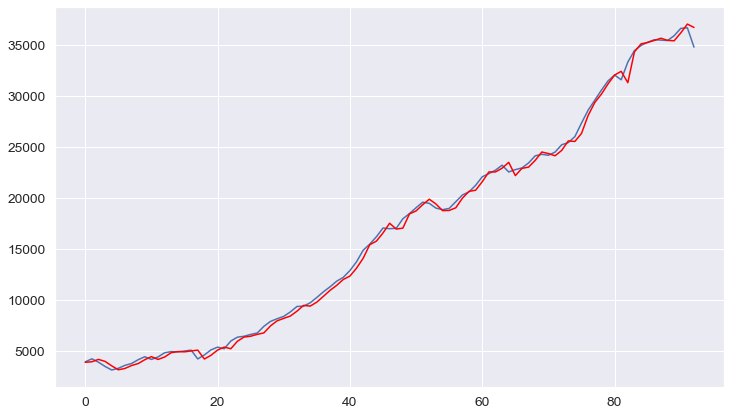

-----------------------------------------------------------------------
Yemen
predicted=9.896554, expected=10.526000
predicted=10.468978, expected=11.316000
predicted=11.057672, expected=12.065000
predicted=11.823360, expected=13.724000
predicted=13.202056, expected=14.475000
predicted=14.247447, expected=16.017000
predicted=15.561071, expected=15.554000
predicted=15.690975, expected=17.081000
predicted=16.623841, expected=18.647000
predicted=18.204208, expected=19.794000
predicted=19.484814, expected=21.085000
predicted=20.749470, expected=20.719000
predicted=20.814228, expected=22.025000
predicted=21.682122, expected=24.251000
predicted=23.705455, expected=23.151000
predicted=23.427512, expected=20.190000
predicted=20.880923, expected=18.268000
predicted=18.644854, expected=24.976000
predicted=23.280085, expected=24.216000
predicted=24.389645, expected=12.806000
predicted=15.005621, expected=10.427000
predicted=10.566720, expected=9.951000
predicted=9.977197, expected=9.984000
predic

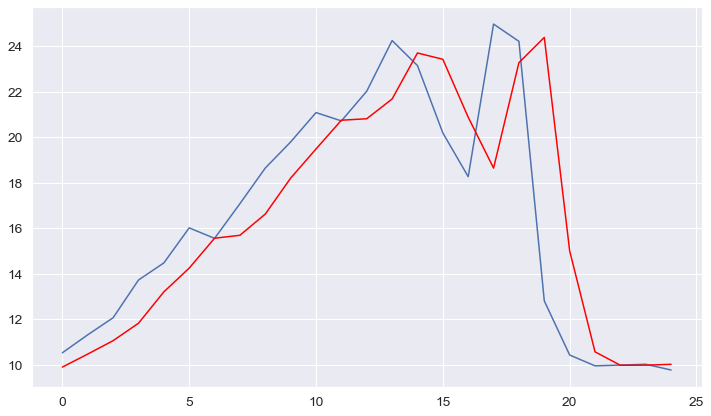

-----------------------------------------------------------------------
Zambia
predicted=2.162733, expected=1.838000
predicted=1.859129, expected=2.354000
predicted=2.305855, expected=2.278000
predicted=2.285260, expected=1.778000
predicted=1.822819, expected=1.784000
predicted=1.783479, expected=1.886000
predicted=1.877149, expected=1.961000
predicted=1.954583, expected=2.074000
predicted=2.064477, expected=2.104000
predicted=2.101490, expected=2.243000
predicted=2.231455, expected=2.231000
predicted=2.231997, expected=2.294000
predicted=2.288757, expected=2.553000
predicted=2.532070, expected=2.940000
predicted=2.914625, expected=3.120000
predicted=3.110214, expected=3.372000
predicted=3.359967, expected=4.166000
predicted=4.150571, expected=4.416000
predicted=4.417894, expected=4.877000
predicted=4.887186, expected=5.098000
predicted=5.105537, expected=5.659000
predicted=5.686553, expected=6.517000
predicted=6.606302, expected=7.313000
predicted=7.448180, expected=7.047000
predicted

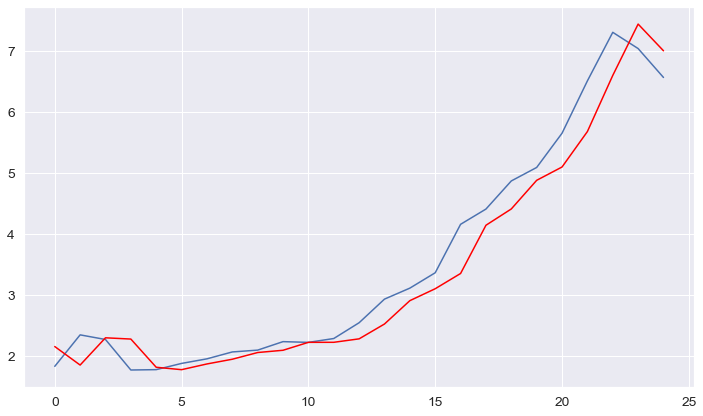

-----------------------------------------------------------------------
Zimbabwe
predicted=9.406151, expected=9.614000
predicted=9.583245, expected=9.405000
predicted=9.440560, expected=8.780000
predicted=8.883329, expected=10.425000
predicted=10.098857, expected=9.880000
predicted=9.994231, expected=10.214000
predicted=10.142740, expected=13.068000
predicted=12.547234, expected=15.170000
predicted=15.175439, expected=16.029000
predicted=16.065527, expected=16.114000
predicted=16.117692, expected=15.552000
predicted=15.528177, expected=15.502000
predicted=15.499864, expected=16.713000
predicted=16.763118, expected=16.047000
predicted=16.031610, expected=17.394000
predicted=17.399621, expected=15.028000
predicted=15.170045, expected=14.909000
predicted=14.914817, expected=13.912000
predicted=13.958587, expected=14.131000
predicted=14.120098, expected=15.728000
predicted=15.658493, expected=13.818000
predicted=13.996220, expected=12.509000
predicted=12.571788, expected=11.896000
predicte

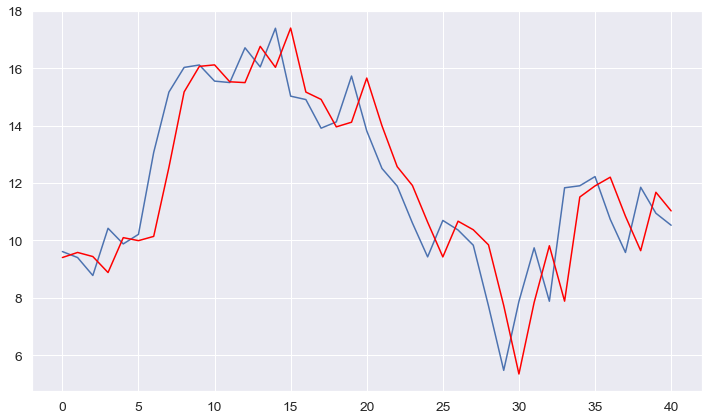

In [187]:
total_predictions = list()
country_list = list()
total_history = list()
all_dates = list()

for country in countries:
    df = data[data.country == country]
    dates = data.index
    
    count = len(df.country)
    l = []
    x = str(country)
    for i in range(count):
        l.append(x)
    #adding the country into our country list
    country_list.append(l)
    
    df = df.drop(columns=['country'])
    
    # split into train and test sets
    X = df['co2'].values
    size = int(len(X) * 0.66)
    train, test = X[0:size], X[size:len(X)]
    history = [x for x in train]
    predictions = list()
    
    print('-----------------------------------------------------------------------')
    print(country)
    
    # walk-forward validation
    for t in range(len(test)):
        model = ARIMA(history, order=(1,1,0))
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
        print('predicted=%f, expected=%f' % (yhat, obs))
        
    total_predictions.append(predictions)
    total_history.append(history)
    all_dates.append(dates)
    
    # evaluate forecasts
    rmse = sqrt(mean_squared_error(test, predictions))
    print('Test RMSE: %.3f' % rmse)
    # plot forecasts against actual outcomes
    plt.rcParams["figure.figsize"] = (12, 7)
    pyplot.plot(test)
    pyplot.plot(predictions, color='red')
    pyplot.show()

In [188]:
info = pd.DataFrame()

In [189]:
info['predictions'] = total_predictions

In [190]:
info['date'] = all_dates

In [191]:
info['country'] = country_list

In [192]:
info

,predictions,date,country
0,"[1.2278805352600888, 1.1622935384182569, 1.080...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Afghanistan, Afghanistan, Afghanistan, Afghan..."
1,"[402.339110814009, 397.81890869812787, 386.971...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Africa, Africa, Africa, Africa, Africa, Afric..."
2,"[7.13762385071246, 4.462047441553271, 2.716598...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Albania, Albania, Albania, Albania, Albania, ..."
3,"[65.32572451444291, 72.19180372528358, 75.2175...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Algeria, Algeria, Algeria, Algeria, Algeria, ..."
4,"[0.5067765425500455, 0.5169999999999959, 0.479...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Andorra, Andorra, Andorra, Andorra, Andorra, ..."
...,...,...,...
243,"[0.022826998263366437, 0.0219999999999913, 0.0...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Wallis and Futuna, Wallis and Futuna, Wallis ..."
244,"[3915.2655422804023, 3966.085422773296, 4199.4...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[World, World, World, World, World, World, Wor..."
245,"[9.896553549811436, 10.468977641424225, 11.057...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Yemen, Yemen, Yemen, Yemen, Yemen, Yemen, Yem..."
246,"[2.1627328934518895, 1.859128813492835, 2.3058...","DatetimeIndex(['1949-01-01', '1950-01-01', '19...","[Zambia, Zambia, Zambia, Zambia, Zambia, Zambi..."


https://www.youtube.com/watch?v=8FCDpFhd1zk 

In [193]:
from sklearn.metrics import mean_squared_error
from math import sqrt

## Future co2 Predictions using ARIMA for years 2021-2026

In [194]:
total_predictions = pd.DataFrame(columns = ['date', 'country', 'predictions'])
#total_predictions.index = pd.to_datetime(data.index, format='%Y')


(72, 42)
Afghanistan
2021-01-01    12.164524
2022-01-01    12.166099
2023-01-01    12.166647
2024-01-01    12.166837
2025-01-01    12.166904
2026-01-01    12.166927
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(137, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Africa
2021-01-01    1302.055553
2022-01-01    1295.074955
2023-01-01    1293.043612
2024-01-01    1292.452495
2025-01-01    1292.280481
2026-01-01    1292.230425
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(88, 42)
Albania
2021-01-01    4.572755
2022-01-01    4.568409
2023-01-01    4.568910
2024-01-01    4.568852
2025-01-01    4.568859
2026-01-01    4.568858
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(105, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Algeria
2021-01-01    157.489127
2022-01-01    156.955026
2023-01-01    157.069400
2024-01-01    157.044908
2025-01-01    157.050153
2026-01-01    157.049029
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)
Andorra
2021-01-01    0.454623
2022-01-01    0.451027
2023-01-01    0.449891
2024-01-01    0.449532
2025-01-01    0.449418
2026-01-01    0.449382
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
Angola
2021-01-01    22.266026
2022-01-01    22.262436
2023-01-01    22.262625
2024-01-01    22.262615
2025-01-01    22.262616
2026-01-01    22.262616
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(31, 42)
Anguilla
2021-01-01    0.120425
2022-01-01    0.120011
2023-01-01    0.119944
2024-01-01    0.119933
2025-01-01    0.119932
2026-01-01    0.119931
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(34, 42)
Antarctica
2021-01-01    0.007
2022-01-01    0.007
2023-01-01    0.007
2024-01-01    0.007
2025-01-01    0.007
2026-01-01    0.007
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(64, 42)
Antigua and Barbuda
2021-01-01    0.430684
2022-01-01    0.430676
2023-01-01    0.430676
2024-01-01    0.430676
2025-01-01    0.430676
2026-01-01    0.430676
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(134, 42)
Argentina
2021-01-01    154.040632
2022-01-01    153.225735
2023-01-01    152.999662
2024-01-01    152.936944
2025-01-01    152.919545
2026-01-01    152.914718
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(191, 42)
Armenia
2021-01-01    5.996952
2022-01-01    6.028638
2023-01-01    6.038026
2024-01-01    6.040807
2025-01-01    6.041631
2026-01-01    6.041875
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(95, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Aruba
2021-01-01    0.758848
2022-01-01    0.758499
2023-01-01    0.758520
2024-01-01    0.758519
2025-01-01    0.758519
2026-01-01    0.758519
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)
Asia
2021-01-01    20062.390104
2022-01-01    19839.927151
2023-01-01    19645.596549
2024-01-01    19475.840720
2025-01-01    19327.551974
2026-01-01    19198.015613
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Asia (excl. China & India)
2021-01-01    7015.166706
2022-01-01    6885.649933
2023-01-01    6798.378749
2024-01-01    6739.573551
2025-01-01    6699.949346
2026-01-01    6673.249705
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(161, 42)
Australia
2021-01-01    381.973152
2022-01-01    377.624709
2023-01-01    375.718342
2024-01-01    374.882586
2025-01-01    374.516189
2026-01-01    374.355560
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(214, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Austria
2021-01-01    60.785896
2022-01-01    60.782789
2023-01-01    60.782853
2024-01-01    60.782851
2025-01-01    60.782851
2026-01-01    60.782851
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)
Azerbaijan
2021-01-01    37.659372
2022-01-01    37.655715
2023-01-01    37.655494
2024-01-01    37.655481
2025-01-01    37.655480
2026-01-01    37.655480
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(71, 42)
Bahamas
2021-01-01    2.414479
2022-01-01    2.394982
2023-01-01    2.399952
2024-01-01    2.398685
2025-01-01    2.399008
2026-01-01    2.398926
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(88, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Bahrain
2021-01-01    34.959241
2022-01-01    34.959242
2023-01-01    34.959242
2024-01-01    34.959242
2025-01-01    34.959242
2026-01-01    34.959242
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(75, 42)
Bangladesh
2021-01-01    92.187044
2022-01-01    91.874614
2023-01-01    91.725577
2024-01-01    91.654483
2025-01-01    91.620569
2026-01-01    91.604391
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(93, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Barbados
2021-01-01    1.104272
2022-01-01    1.101942
2023-01-01    1.102256
2024-01-01    1.102214
2025-01-01    1.102219
2026-01-01    1.102219
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)
Belarus
2021-01-01    55.761205
2022-01-01    54.968595
2023-01-01    54.595491
2024-01-01    54.419861
2025-01-01    54.337186
2026-01-01    54.298269
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(219, 42)
Belgium
2021-01-01    82.235452
2022-01-01    82.092249
2023-01-01    82.078700
2024-01-01    82.077418
2025-01-01    82.077296
2026-01-01    82.077285
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Belize
2021-01-01    0.594978
2022-01-01    0.593065
2023-01-01    0.593370
2024-01-01    0.593321
2025-01-01    0.593329
2026-01-01    0.593328
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(63, 42)
Benin
2021-01-01    6.419804
2022-01-01    6.288759
2023-01-01    6.228119
2024-01-01    6.200059
2025-01-01    6.187075
2026-01-01    6.181066
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
Bermuda
2021-01-01    0.638366
2022-01-01    0.635577
2023-01-01    0.636118
2024-01-01    0.636013
2025-01-01    0.636034
2026-01-01    0.636030
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(51, 42)
Bhutan
2021-01-01    1.924180
2022-01-01    1.923843
2023-01-01    1.923705
2024-01-01    1.923649
2025-01-01    1.923625
2026-01-01    1.923616
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


(93, 42)
Bolivia
2021-01-01    18.782628
2022-01-01    17.614802
2023-01-01    16.903508
2024-01-01    16.470275
2025-01-01    16.206403
2026-01-01    16.045685
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(95, 42)
Bonaire Sint Eustatius and Saba
2021-01-01    0.313972
2022-01-01    0.309657
2023-01-01    0.311092
2024-01-01    0.310615
2025-01-01    0.310774
2026-01-01    0.310721
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(136, 42)
Bosnia and Herzegovina
2021-01-01    21.183851
2022-01-01    21.167863
2023-01-01    21.166771
2024-01-01    21.166696
2025-01-01    21.166691
2026-01-01    21.166691
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(49, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Botswana
2021-01-01    6.595912
2022-01-01    6.581342
2023-01-01    6.584102
2024-01-01    6.583579
2025-01-01    6.583678
2026-01-01    6.583659
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(120, 42)
Brazil
2021-01-01    459.957539
2022-01-01    456.961595
2023-01-01    455.752987
2024-01-01    455.265417
2025-01-01    455.068724
2026-01-01    454.989375
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(59, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


British Virgin Islands
2021-01-01    0.132966
2022-01-01    0.130943
2023-01-01    0.130265
2024-01-01    0.130037
2025-01-01    0.129961
2026-01-01    0.129936
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(88, 42)
Brunei
2021-01-01    10.064628
2022-01-01    10.108220
2023-01-01    10.087869
2024-01-01    10.097370
2025-01-01    10.092934
2026-01-01    10.095005
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(140, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Bulgaria
2021-01-01    35.829443
2022-01-01    35.283974
2023-01-01    35.099690
2024-01-01    35.037431
2025-01-01    35.016397
2026-01-01    35.009291
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(63, 42)
Burkina Faso
2021-01-01    3.808382
2022-01-01    3.737016
2023-01-01    3.705501
2024-01-01    3.691586
2025-01-01    3.685441
2026-01-01    3.682727
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


Burundi
2021-01-01    0.591879
2022-01-01    0.590875
2023-01-01    0.590775
2024-01-01    0.590765
2025-01-01    0.590764
2026-01-01    0.590764
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(66, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Cambodia
2021-01-01    15.324539
2022-01-01    15.323827
2023-01-01    15.323480
2024-01-01    15.323311
2025-01-01    15.323229
2026-01-01    15.323189
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
Cameroon
2021-01-01    7.011561
2022-01-01    6.982050
2023-01-01    6.989155
2024-01-01    6.987444
2025-01-01    6.987856
2026-01-01    6.987757
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(236, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Canada
2021-01-01    526.143033
2022-01-01    524.130841
2023-01-01    523.712563
2024-01-01    523.625615
2025-01-01    523.607541
2026-01-01    523.603784
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
Cape Verde
2021-01-01    0.537604
2022-01-01    0.534649
2023-01-01    0.533945
2024-01-01    0.533777
2025-01-01    0.533737
2026-01-01    0.533727
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Central African Republic
2021-01-01    0.189152
2022-01-01    0.189092
2023-01-01    0.189095
2024-01-01    0.189095
2025-01-01    0.189095
2026-01-01    0.189095
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)
Chad
2021-01-01    0.940009
2022-01-01    0.931574
2023-01-01    0.934114
2024-01-01    0.933349
2025-01-01    0.933579
2026-01-01    0.933510
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(126, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Chile
2021-01-01    79.453304
2022-01-01    78.858209
2023-01-01    78.652039
2024-01-01    78.580612
2025-01-01    78.555866
2026-01-01    78.547292
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(122, 42)
China
2021-01-01    10818.000351
2022-01-01    10944.668543
2023-01-01    11051.553313
2024-01-01    11141.744495
2025-01-01    11217.849344
2026-01-01    11282.067908
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(51, 42)

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


Christmas Island
2021-01-01    0.092
2022-01-01    0.092
2023-01-01    0.092
2024-01-01    0.092
2025-01-01    0.092
2026-01-01    0.092
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(100, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Colombia
2021-01-01    88.954289
2022-01-01    88.937003
2023-01-01    88.935020
2024-01-01    88.934793
2025-01-01    88.934767
2026-01-01    88.934764
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)
Comoros
2021-01-01    0.252703
2022-01-01    0.252119
2023-01-01    0.252054
2024-01-01    0.252047
2025-01-01    0.252046
2026-01-01    0.252046
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)
Congo
2021-01-01    3.139652
2022-01-01    3.136703
2023-01-01    3.137087
2024-01-01    3.137037
2025-01-01    3.137044
2026-01-01    3.137043
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(52, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Cook Islands
2021-01-01    0.079
2022-01-01    0.079
2023-01-01    0.079
2024-01-01    0.079
2025-01-01    0.079
2026-01-01    0.079
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
Costa Rica
2021-01-01    7.801419
2022-01-01    7.789183
2023-01-01    7.787765
2024-01-01    7.787601
2025-01-01    7.787582
2026-01-01    7.787579
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(63, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Cote d'Ivoire
2021-01-01    10.103617
2022-01-01    10.101016
2023-01-01    10.101223
2024-01-01    10.101207
2025-01-01    10.101208
2026-01-01    10.101208
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(136, 42)
Croatia
2021-01-01    17.035766
2022-01-01    17.032139
2023-01-01    17.032384
2024-01-01    17.032367
2025-01-01    17.032368
2026-01-01    17.032368
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f


(80, 42)
Cuba
2021-01-01    19.889078
2022-01-01    19.859947
2023-01-01    19.856719
2024-01-01    19.856361
2025-01-01    19.856322
2026-01-01    19.856317
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(95, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Curacao
2021-01-01    3.474221
2022-01-01    3.428722
2023-01-01    3.443591
2024-01-01    3.438732
2025-01-01    3.440320
2026-01-01    3.439801
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Cyprus
2021-01-01    6.142474
2022-01-01    5.994394
2023-01-01    5.932367
2024-01-01    5.906386
2025-01-01    5.895503
2026-01-01    5.890945
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(161, 42)
Czechia
2021-01-01    83.907629
2022-01-01    82.618893
2023-01-01    82.210561
2024-01-01    82.081181
2025-01-01    82.040188
2026-01-01    82.027199
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(101, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Democratic Republic of Congo
2021-01-01    2.469728
2022-01-01    2.469479
2023-01-01    2.469470
2024-01-01    2.469470
2025-01-01    2.469470
2026-01-01    2.469470
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(178, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Denmark
2021-01-01    26.752005
2022-01-01    26.686022
2023-01-01    26.693838
2024-01-01    26.692912
2025-01-01    26.693022
2026-01-01    26.693009
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Djibouti
2021-01-01    0.368944
2022-01-01    0.362630
2023-01-01    0.364852
2024-01-01    0.364070
2025-01-01    0.364345
2026-01-01    0.364248
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(70, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Dominica
2021-01-01    0.141345
2022-01-01    0.141039
2023-01-01    0.141079
2024-01-01    0.141074
2025-01-01    0.141075
2026-01-01    0.141074
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(74, 42)
Dominican Republic
2021-01-01    27.824707
2022-01-01    27.837170
2023-01-01    27.839958
2024-01-01    27.840582
2025-01-01    27.840721
2026-01-01    27.840753
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(29, 42)
EU-27
2019-01-01    3325.927143
2020-01-01    3325.166651
2021-01-01    3325.086690
2022-01-01    3325.078282
2023-01-01    3325.077398
2024-01-01    3325.077305
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(104, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Ecuador
2021-01-01    32.243992
2022-01-01    31.948537
2023-01-01    32.015072
2024-01-01    32.000089
2025-01-01    32.003463
2026-01-01    32.002703
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(110, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Egypt
2021-01-01    212.675625
2022-01-01    212.626486
2023-01-01    212.623396
2024-01-01    212.623201
2025-01-01    212.623189
2026-01-01    212.623188
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


El Salvador
2021-01-01    6.136309
2022-01-01    6.136101
2023-01-01    6.136105
2024-01-01    6.136105
2025-01-01    6.136105
2026-01-01    6.136105
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Equatorial Guinea
2021-01-01    10.263994
2022-01-01    10.263791
2023-01-01    10.263750
2024-01-01    10.263742
2025-01-01    10.263740
2026-01-01    10.263740
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(82, 42)
Eritrea
2021-01-01    0.720668
2022-01-01    0.720652
2023-01-01    0.720652
2024-01-01    0.720652
2025-01-01    0.720652
2026-01-01    0.720652
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Estonia
2021-01-01    9.764291
2022-01-01    9.518988
2023-01-01    9.431490
2024-01-01    9.400280
2025-01-01    9.389147
2026-01-01    9.385176
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Eswatini
2021-01-01    0.970782
2022-01-01    0.966949
2023-01-01    0.967943
2024-01-01    0.967685
2025-01-01    0.967752
2026-01-01    0.967735
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(80, 42)
Ethiopia
2021-01-01    13.686705
2022-01-01    13.125708
2023-01-01    12.804008
2024-01-01    12.619531
2025-01-01    12.513744
2026-01-01    12.453081
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(271, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Europe
2021-01-01    4785.116647
2022-01-01    4731.638483
2023-01-01    4713.865918
2024-01-01    4707.959506
2025-01-01    4705.996610
2026-01-01    4705.344275
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(271, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Europe (excl. EU-27)
2021-01-01    2279.792300
2022-01-01    2253.335903
2023-01-01    2242.991953
2024-01-01    2238.947664
2025-01-01    2237.366424
2026-01-01    2236.748189
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(192, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Europe (excl. EU-28)
2021-01-01    1946.784155
2022-01-01    1908.961220
2023-01-01    1888.839448
2024-01-01    1878.134680
2025-01-01    1872.439752
2026-01-01    1869.410055
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(229, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


European Union (27)
2021-01-01    2536.644833
2022-01-01    2524.317923
2023-01-01    2521.864309
2024-01-01    2521.375929
2025-01-01    2521.278719
2026-01-01    2521.259370
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(271, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


European Union (28)
2021-01-01    2882.522892
2022-01-01    2876.583360
2023-01-01    2875.810246
2024-01-01    2875.709614
2025-01-01    2875.696515
2026-01-01    2875.694810
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Faeroe Islands
2021-01-01    0.686613
2022-01-01    0.686482
2023-01-01    0.686488
2024-01-01    0.686488
2025-01-01    0.686488
2026-01-01    0.686488
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Fiji
2021-01-01    1.392726
2022-01-01    1.392801
2023-01-01    1.392780
2024-01-01    1.392786
2025-01-01    1.392784
2026-01-01    1.392785
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(161, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Finland
2021-01-01    39.373694
2022-01-01    39.371440
2023-01-01    39.371499
2024-01-01    39.371497
2025-01-01    39.371497
2026-01-01    39.371497
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(219, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


France
2021-01-01    270.141876
2022-01-01    269.069335
2023-01-01    268.892144
2024-01-01    268.862871
2025-01-01    268.858035
2026-01-01    268.857236
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
French Equatorial Africa
2021-01-01    0.3205
2022-01-01    0.3205
2023-01-01    0.3205
2024-01-01    0.3205
2025-01-01    0.3205
2026-01-01    0.3205
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(71, 42)
French Guiana
2021-01-01    0.728
2022-01-01    0.728
2023-01-01    0.728
2024-01-01    0.728
2025-01-01    0.728
2026-01-01    0.728
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(66, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


French Polynesia
2021-01-01    0.828336
2022-01-01    0.828449
2023-01-01    0.828487
2024-01-01    0.828500
2025-01-01    0.828504
2026-01-01    0.828505
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(72, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


French West Africa
2021-01-01    1.3865
2022-01-01    1.3865
2023-01-01    1.3865
2024-01-01    1.3865
2025-01-01    1.3865
2026-01-01    1.3865
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)
Gabon
2021-01-01    4.307837
2022-01-01    4.307328
2023-01-01    4.307354
2024-01-01    4.307353
2025-01-01    4.307353
2026-01-01    4.307353
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(71, 42)
Gambia
2021-01-01    0.494263
2022-01-01    0.493563
2023-01-01    0.493477
2024-01-01    0.493467
2025-01-01    0.493465
2026-01-01    0.493465
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64

C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'



(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Georgia
2021-01-01    9.719820
2022-01-01    9.599520
2023-01-01    9.541208
2024-01-01    9.512942
2025-01-01    9.499241
2026-01-01    9.492600
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(229, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Germany
2021-01-01    644.505522
2022-01-01    644.504952
2023-01-01    644.504954
2024-01-01    644.504954
2025-01-01    644.504954
2026-01-01    644.504954
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)
Ghana
2021-01-01    16.071729
2022-01-01    16.066274
2023-01-01    16.066694
2024-01-01    16.066662
2025-01-01    16.066664
2026-01-01    16.066664
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


(154, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Greece
2021-01-01    44.544027
2022-01-01    40.162790
2023-01-01    37.666977
2024-01-01    36.245214
2025-01-01    35.435293
2026-01-01    34.973913
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Greenland
2021-01-01    0.534919
2022-01-01    0.523979
2023-01-01    0.529700
2024-01-01    0.526708
2025-01-01    0.528273
2026-01-01    0.527455
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Grenada
2021-01-01    0.302310
2022-01-01    0.300866
2023-01-01    0.301151
2024-01-01    0.301095
2025-01-01    0.301106
2026-01-01    0.301104
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Guadeloupe
2021-01-01    2.562
2022-01-01    2.562
2023-01-01    2.562
2024-01-01    2.562
2025-01-01    2.562
2026-01-01    2.562
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(80, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Guatemala
2021-01-01    18.682976
2022-01-01    18.661268
2023-01-01    18.659420
2024-01-01    18.659263
2025-01-01    18.659249
2026-01-01    18.659248
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(63, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Guinea
2021-01-01    3.193021
2022-01-01    3.067967
2023-01-01    2.990155
2024-01-01    2.941738
2025-01-01    2.911612
2026-01-01    2.892867
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Guinea-Bissau
2021-01-01    0.290181
2022-01-01    0.289806
2023-01-01    0.289851
2024-01-01    0.289845
2025-01-01    0.289846
2026-01-01    0.289846
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Guyana
2021-01-01    2.252418
2022-01-01    2.246747
2023-01-01    2.247563
2024-01-01    2.247446
2025-01-01    2.247462
2026-01-01    2.247460
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Haiti
2021-01-01    2.939432
2022-01-01    2.938409
2023-01-01    2.938463
2024-01-01    2.938460
2025-01-01    2.938460
2026-01-01    2.938460
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(271, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


High-income countries
2021-01-01    11535.300292
2022-01-01    11459.508698
2023-01-01    11439.937801
2024-01-01    11434.884206
2025-01-01    11433.579267
2026-01-01    11433.242306
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Honduras
2021-01-01    9.502323
2022-01-01    9.480302
2023-01-01    9.477227
2024-01-01    9.476797
2025-01-01    9.476737
2026-01-01    9.476729
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(83, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Hong Kong
2021-01-01    29.138080
2022-01-01    28.719704
2023-01-01    28.636389
2024-01-01    28.619798
2025-01-01    28.616494
2026-01-01    28.615836
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Hungary
2021-01-01    48.055711
2022-01-01    47.995975
2023-01-01    47.979703
2024-01-01    47.975270
2025-01-01    47.974062
2026-01-01    47.973734
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(85, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Iceland
2021-01-01    2.944516
2022-01-01    2.944398
2023-01-01    2.944400
2024-01-01    2.944400
2025-01-01    2.944400
2026-01-01    2.944400
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(163, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


India
2021-01-01    2301.683549
2022-01-01    2195.098663
2023-01-01    2114.016202
2024-01-01    2052.334234
2025-01-01    2005.410830
2026-01-01    1969.714727
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(132, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Indonesia
2021-01-01    578.161883
2022-01-01    576.353673
2023-01-01    576.065299
2024-01-01    576.019308
2025-01-01    576.011974
2026-01-01    576.010804
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


International transport
2021-01-01    873.948784
2022-01-01    806.999274
2023-01-01    772.595745
2024-01-01    754.916708
2025-01-01    745.831933
2026-01-01    741.163514
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(115, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Iran
2021-01-01    747.943804
2022-01-01    748.668900
2023-01-01    748.849649
2024-01-01    748.894706
2025-01-01    748.905937
2026-01-01    748.908737
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(94, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Iraq
2021-01-01    208.845508
2022-01-01    208.522022
2023-01-01    208.469264
2024-01-01    208.460660
2025-01-01    208.459257
2026-01-01    208.459028
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(171, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Ireland
2021-01-01    32.901604
2022-01-01    32.850620
2023-01-01    32.844810
2024-01-01    32.844148
2025-01-01    32.844073
2026-01-01    32.844064
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(91, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Israel
2021-01-01    56.848737
2022-01-01    56.807740
2023-01-01    56.811117
2024-01-01    56.810839
2025-01-01    56.810862
2026-01-01    56.810860
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(161, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Italy
2021-01-01    290.393288
2022-01-01    285.383350
2023-01-01    283.513285
2024-01-01    282.815243
2025-01-01    282.554684
2026-01-01    282.457425
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Jamaica
2021-01-01    7.493109
2022-01-01    7.486437
2023-01-01    7.487131
2024-01-01    7.487059
2025-01-01    7.487067
2026-01-01    7.487066
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(153, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Japan
2021-01-01    998.863274
2022-01-01    985.312987
2023-01-01    979.559294
2024-01-01    977.116174
2025-01-01    976.078782
2026-01-01    975.638286
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Jordan
2021-01-01    25.462433
2022-01-01    25.460094
2023-01-01    25.459871
2024-01-01    25.459850
2025-01-01    25.459848
2026-01-01    25.459847
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Kazakhstan
2021-01-01    289.801942
2022-01-01    289.282786
2023-01-01    289.107093
2024-01-01    289.047635
2025-01-01    289.027513
2026-01-01    289.020703
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Kenya
2021-01-01    16.003244
2022-01-01    15.993985
2023-01-01    15.993384
2024-01-01    15.993345
2025-01-01    15.993343
2026-01-01    15.993343
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(60, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Kiribati
2021-01-01    0.068
2022-01-01    0.068
2023-01-01    0.068
2024-01-01    0.068
2025-01-01    0.068
2026-01-01    0.068
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(13, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Kosovo
2021-01-01    8.381125
2022-01-01    8.181783
2023-01-01    8.262693
2024-01-01    8.229853
2025-01-01    8.243182
2026-01-01    8.237772
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(75, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Kuwait
2021-01-01    89.011075
2022-01-01    89.010325
2023-01-01    89.010332
2024-01-01    89.010332
2025-01-01    89.010332
2026-01-01    89.010332
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(30, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Kuwaiti Oil Fires
2021-01-01    477.925
2022-01-01    477.925
2023-01-01    477.925
2024-01-01    477.925
2025-01-01    477.925
2026-01-01    477.925
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Kyrgyzstan
2021-01-01    11.786590
2022-01-01    11.944984
2023-01-01    12.035038
2024-01-01    12.086239
2025-01-01    12.115349
2026-01-01    12.131900
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(66, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Laos
2021-01-01    33.827651
2022-01-01    33.823247
2023-01-01    33.822244
2024-01-01    33.822016
2025-01-01    33.821964
2026-01-01    33.821952
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Latvia
2021-01-01    6.373975
2022-01-01    6.192008
2023-01-01    6.109026
2024-01-01    6.071183
2025-01-01    6.053926
2026-01-01    6.046056
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(90, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Lebanon
2021-01-01    25.841460
2022-01-01    25.817851
2023-01-01    25.813481
2024-01-01    25.812672
2025-01-01    25.812522
2026-01-01    25.812494
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Leeward Islands
2021-01-01    0.0295
2022-01-01    0.0295
2023-01-01    0.0295
2024-01-01    0.0295
2025-01-01    0.0295
2026-01-01    0.0295
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Lesotho
2021-01-01    2.185346
2022-01-01    2.185306
2023-01-01    2.185307
2024-01-01    2.185307
2025-01-01    2.185307
2026-01-01    2.185307
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Liberia
2021-01-01    1.002018
2022-01-01    1.001437
2023-01-01    1.001389
2024-01-01    1.001385
2025-01-01    1.001385
2026-01-01    1.001385
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Libya
2021-01-01    51.409291
2022-01-01    51.284226
2023-01-01    51.306951
2024-01-01    51.302822
2025-01-01    51.303572
2026-01-01    51.303436
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Liechtenstein
2021-01-01    0.142450
2022-01-01    0.142149
2023-01-01    0.142212
2024-01-01    0.142199
2025-01-01    0.142201
2026-01-01    0.142201
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Lithuania
2021-01-01    13.778259
2022-01-01    13.774790
2023-01-01    13.774210
2024-01-01    13.774113
2025-01-01    13.774096
2026-01-01    13.774094
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(116, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Low-income countries
2021-01-01    156.301825
2022-01-01    156.275938
2023-01-01    156.274639
2024-01-01    156.274574
2025-01-01    156.274571
2026-01-01    156.274571
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Lower-middle-income countries
2021-01-01    5577.927205
2022-01-01    5386.783466
2023-01-01    5239.437284
2024-01-01    5125.853144
2025-01-01    5038.295008
2026-01-01    4970.799431
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(76, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Luxembourg
2021-01-01    7.816846
2022-01-01    7.735505
2023-01-01    7.717032
2024-01-01    7.712836
2025-01-01    7.711884
2026-01-01    7.711667
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(67, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Macao
2021-01-01    1.260520
2022-01-01    1.261399
2023-01-01    1.261087
2024-01-01    1.261198
2025-01-01    1.261159
2026-01-01    1.261172
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(88, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Madagascar
2021-01-01    3.684852
2022-01-01    3.684788
2023-01-01    3.684789
2024-01-01    3.684789
2025-01-01    3.684789
2026-01-01    3.684789
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Malawi
2021-01-01    1.369605
2022-01-01    1.366263
2023-01-01    1.365823
2024-01-01    1.365766
2025-01-01    1.365758
2026-01-01    1.365757
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(131, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Malaysia
2021-01-01    271.693562
2022-01-01    271.555695
2023-01-01    271.534887
2024-01-01    271.531746
2025-01-01    271.531272
2026-01-01    271.531200
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(50, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Maldives
2021-01-01    1.796042
2022-01-01    1.796043
2023-01-01    1.796043
2024-01-01    1.796043
2025-01-01    1.796043
2026-01-01    1.796043
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mali
2021-01-01    3.193990
2022-01-01    3.065064
2023-01-01    2.980263
2024-01-01    2.924485
2025-01-01    2.887797
2026-01-01    2.863665
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Malta
2021-01-01    1.596321
2022-01-01    1.596298
2023-01-01    1.596298
2024-01-01    1.596298
2025-01-01    1.596298
2026-01-01    1.596298
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Marshall Islands
2021-01-01    0.151
2022-01-01    0.151
2023-01-01    0.151
2024-01-01    0.151
2025-01-01    0.151
2026-01-01    0.151
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Martinique
2021-01-01    2.348
2022-01-01    2.348
2023-01-01    2.348
2024-01-01    2.348
2025-01-01    2.348
2026-01-01    2.348
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mauritania
2021-01-01    3.388164
2022-01-01    3.387776
2023-01-01    3.387790
2024-01-01    3.387789
2025-01-01    3.387789
2026-01-01    3.387789
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mauritius
2021-01-01    3.824532
2022-01-01    3.764732
2023-01-01    3.741582
2024-01-01    3.732619
2025-01-01    3.729149
2026-01-01    3.727806
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mayotte
2021-01-01    0.306
2022-01-01    0.306
2023-01-01    0.306
2024-01-01    0.306
2025-01-01    0.306
2026-01-01    0.306
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(130, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mexico
2021-01-01    318.446072
2022-01-01    299.552980
2023-01-01    290.286858
2024-01-01    285.742285
2025-01-01    283.513399
2026-01-01    282.420240
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Micronesia (country)
2021-01-01    0.147416
2022-01-01    0.147757
2023-01-01    0.147558
2024-01-01    0.147674
2025-01-01    0.147606
2026-01-01    0.147646
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Moldova
2021-01-01    5.140751
2022-01-01    5.136411
2023-01-01    5.133398
2024-01-01    5.131306
2025-01-01    5.129853
2026-01-01    5.128844
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mongolia
2021-01-01    88.358859
2022-01-01    88.331099
2023-01-01    88.321830
2024-01-01    88.318735
2025-01-01    88.317702
2026-01-01    88.317357
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(136, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Montenegro
2021-01-01    2.457424
2022-01-01    2.392547
2023-01-01    2.421098
2024-01-01    2.408533
2025-01-01    2.414062
2026-01-01    2.411629
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(59, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Montserrat
2021-01-01    0.026763
2022-01-01    0.025986
2023-01-01    0.026329
2024-01-01    0.026178
2025-01-01    0.026244
2026-01-01    0.026215
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(93, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Morocco
2021-01-01    63.843752
2022-01-01    63.713569
2023-01-01    63.689086
2024-01-01    63.684482
2025-01-01    63.683616
2026-01-01    63.683454
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(94, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Mozambique
2021-01-01    6.755389
2022-01-01    6.707970
2023-01-01    6.720165
2024-01-01    6.717029
2025-01-01    6.717835
2026-01-01    6.717628
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(93, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Myanmar
2021-01-01    36.411859
2022-01-01    36.438281
2023-01-01    36.446413
2024-01-01    36.448915
2025-01-01    36.449685
2026-01-01    36.449922
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Namibia
2021-01-01    3.957122
2022-01-01    3.925807
2023-01-01    3.938046
2024-01-01    3.933263
2025-01-01    3.935132
2026-01-01    3.934401
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(57, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Nauru
2021-01-01    0.057
2022-01-01    0.057
2023-01-01    0.057
2024-01-01    0.057
2025-01-01    0.057
2026-01-01    0.057
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Nepal
2021-01-01    16.954357
2022-01-01    16.952882
2023-01-01    16.952285
2024-01-01    16.952043
2025-01-01    16.951945
2026-01-01    16.951906
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(175, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Netherlands
2021-01-01    137.063507
2022-01-01    136.994196
2023-01-01    136.989561
2024-01-01    136.989251
2025-01-01    136.989230
2026-01-01    136.989229
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


New Caledonia
2021-01-01    8.692674
2022-01-01    8.692666
2023-01-01    8.692666
2024-01-01    8.692666
2025-01-01    8.692666
2026-01-01    8.692666
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(143, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


New Zealand
2021-01-01    33.759516
2022-01-01    33.739379
2023-01-01    33.740805
2024-01-01    33.740704
2025-01-01    33.740711
2026-01-01    33.740710
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(78, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Nicaragua
2021-01-01    5.120530
2022-01-01    5.116915
2023-01-01    5.117196
2024-01-01    5.117174
2025-01-01    5.117176
2026-01-01    5.117176
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(63, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Niger
2021-01-01    1.632563
2022-01-01    1.612323
2023-01-01    1.605191
2024-01-01    1.602678
2025-01-01    1.601792
2026-01-01    1.601480
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(106, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No f

Nigeria
2021-01-01    125.806424
2022-01-01    125.781011
2023-01-01    125.782892
2024-01-01    125.782753
2025-01-01    125.782763
2026-01-01    125.782762
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(51, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Niue
2021-01-01    0.011
2022-01-01    0.011
2023-01-01    0.011
2024-01-01    0.011
2025-01-01    0.011
2026-01-01    0.011
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(236, 42)
North America
2021-01-01    5713.687823
2022-01-01    5708.176026
2023-01-01    5707.681813
2024-01-01    5707.637499
2025-01-01    5707.633526
2026-01-01    5707.633169
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(236, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


North America (excl. USA)
2021-01-01    1002.664171
2022-01-01     977.636906
2023-01-01     967.149234
2024-01-01     962.754376
2025-01-01     960.912711
2026-01-01     960.140962
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(116, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


North Korea
2021-01-01    29.307217
2022-01-01    29.307006
2023-01-01    29.306994
2024-01-01    29.306994
2025-01-01    29.306994
2026-01-01    29.306994
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(136, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


North Macedonia
2021-01-01    7.297414
2022-01-01    7.270090
2023-01-01    7.275053
2024-01-01    7.274152
2025-01-01    7.274315
2026-01-01    7.274286
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(192, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Norway
2021-01-01    41.426465
2022-01-01    41.413454
2023-01-01    41.414634
2024-01-01    41.414527
2025-01-01    41.414537
2026-01-01    41.414536
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(161, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Oceania
2021-01-01    432.802613
2022-01-01    427.599558
2023-01-01    425.299176
2024-01-01    424.282128
2025-01-01    423.832470
2026-01-01    423.633666
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(57, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Oman
2021-01-01    62.466809
2022-01-01    62.532456
2023-01-01    62.546641
2024-01-01    62.549706
2025-01-01    62.550368
2026-01-01    62.550512
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(75, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Pakistan
2021-01-01    235.056548
2022-01-01    235.251679
2023-01-01    235.377949
2024-01-01    235.459657
2025-01-01    235.512531
2026-01-01    235.546745
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(66, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Palau
2021-01-01    0.219
2022-01-01    0.219
2023-01-01    0.219
2024-01-01    0.219
2025-01-01    0.219
2026-01-01    0.219
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Palestine
2021-01-01    2.892601
2022-01-01    2.892130
2023-01-01    2.892096
2024-01-01    2.892093
2025-01-01    2.892093
2026-01-01    2.892093
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(73, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Panama
2021-01-01    11.166932
2022-01-01    11.068044
2023-01-01    11.093317
2024-01-01    11.086858
2025-01-01    11.088508
2026-01-01    11.088087
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Panama Canal Zone
2021-01-01    1.057
2022-01-01    1.057
2023-01-01    1.057
2024-01-01    1.057
2025-01-01    1.057
2026-01-01    1.057
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Papua New Guinea
2021-01-01    6.642630
2022-01-01    6.645212
2023-01-01    6.644501
2024-01-01    6.644697
2025-01-01    6.644643
2026-01-01    6.644658
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Paraguay
2021-01-01    7.061607
2022-01-01    6.790964
2023-01-01    6.646887
2024-01-01    6.570188
2025-01-01    6.529358
2026-01-01    6.507621
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(137, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Peru
2021-01-01    46.179560
2022-01-01    45.968172
2023-01-01    45.998496
2024-01-01    45.994146
2025-01-01    45.994770
2026-01-01    45.994680
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(114, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Philippines
2021-01-01    130.965626
2022-01-01    128.556785
2023-01-01    127.408312
2024-01-01    126.860750
2025-01-01    126.599687
2026-01-01    126.475219
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(221, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Poland
2021-01-01    301.524888
2022-01-01    301.337604
2023-01-01    301.355760
2024-01-01    301.354000
2025-01-01    301.354170
2026-01-01    301.354154
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(151, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Portugal
2021-01-01    38.760312
2022-01-01    38.394428
2023-01-01    38.312181
2024-01-01    38.293693
2025-01-01    38.289537
2026-01-01    38.288603
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(101, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Puerto Rico
2021-01-01    0.209
2022-01-01    0.209
2023-01-01    0.209
2024-01-01    0.209
2025-01-01    0.209
2026-01-01    0.209
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(72, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Qatar
2021-01-01    105.478034
2022-01-01    105.312770
2023-01-01    105.289564
2024-01-01    105.286305
2025-01-01    105.285848
2026-01-01    105.285784
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Reunion
2021-01-01    4.588
2022-01-01    4.588
2023-01-01    4.588
2024-01-01    4.588
2025-01-01    4.588
2026-01-01    4.588
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(163, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Romania
2021-01-01    69.761171
2022-01-01    68.889855
2023-01-01    68.446874
2024-01-01    68.221661
2025-01-01    68.107162
2026-01-01    68.048950
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Russia
2021-01-01    1534.405977
2022-01-01    1516.560202
2023-01-01    1509.107088
2024-01-01    1505.994369
2025-01-01    1504.694372
2026-01-01    1504.151441
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Rwanda
2021-01-01    0.975740
2022-01-01    0.954451
2023-01-01    0.946535
2024-01-01    0.943591
2025-01-01    0.942497
2026-01-01    0.942090
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(69, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Ryukyu Islands
2021-01-01    0.7645
2022-01-01    0.7645
2023-01-01    0.7645
2024-01-01    0.7645
2025-01-01    0.7645
2026-01-01    0.7645
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(53, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Saint Helena
2021-01-01    0.009481
2022-01-01    0.009365
2023-01-01    0.009393
2024-01-01    0.009386
2025-01-01    0.009388
2026-01-01    0.009388
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(40, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Saint Kitts and Nevis
2021-01-01    0.211515
2022-01-01    0.211506
2023-01-01    0.211506
2024-01-01    0.211506
2025-01-01    0.211506
2026-01-01    0.211506
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Saint Lucia
2021-01-01    0.429044
2022-01-01    0.426938
2023-01-01    0.426534
2024-01-01    0.426456
2025-01-01    0.426441
2026-01-01    0.426438
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Saint Pierre and Miquelon
2021-01-01    0.052003
2022-01-01    0.051835
2023-01-01    0.051863
2024-01-01    0.051858
2025-01-01    0.051859
2026-01-01    0.051859
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Saint Vincent and the Grenadines
2021-01-01    0.219725
2022-01-01    0.215465
2023-01-01    0.217157
2024-01-01    0.216485
2025-01-01    0.216752
2026-01-01    0.216646
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Samoa
2021-01-01    0.246072
2022-01-01    0.246077
2023-01-01    0.246077
2024-01-01    0.246077
2025-01-01    0.246077
2026-01-01    0.246077
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(70, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Sao Tome and Principe
2021-01-01    0.109114
2022-01-01    0.107953
2023-01-01    0.107606
2024-01-01    0.107502
2025-01-01    0.107471
2026-01-01    0.107462
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(85, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Saudi Arabia
2021-01-01    625.704252
2022-01-01    625.716697
2023-01-01    625.717486
2024-01-01    625.717536
2025-01-01    625.717539
2026-01-01    625.717539
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(63, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Senegal
2021-01-01    10.328140
2022-01-01    10.309620
2023-01-01    10.306828
2024-01-01    10.306407
2025-01-01    10.306343
2026-01-01    10.306334
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(136, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Serbia
2021-01-01    44.561054
2022-01-01    44.233208
2023-01-01    44.308579
2024-01-01    44.291251
2025-01-01    44.295235
2026-01-01    44.294319
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(58, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Seychelles
2021-01-01    0.497254
2022-01-01    0.496819
2023-01-01    0.496850
2024-01-01    0.496847
2025-01-01    0.496848
2026-01-01    0.496848
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Sierra Leone
2021-01-01    0.895711
2022-01-01    0.891543
2023-01-01    0.892471
2024-01-01    0.892264
2025-01-01    0.892310
2026-01-01    0.892300
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Singapore
2021-01-01    45.529184
2022-01-01    45.526028
2023-01-01    45.526424
2024-01-01    45.526374
2025-01-01    45.526380
2026-01-01    45.526380
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(95, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Sint Maarten (Dutch part)
2021-01-01    0.650222
2022-01-01    0.641185
2023-01-01    0.644185
2024-01-01    0.643189
2025-01-01    0.643520
2026-01-01    0.643410
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(161, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Slovakia
2021-01-01    30.427625
2022-01-01    30.397578
2023-01-01    30.394593
2024-01-01    30.394296
2025-01-01    30.394267
2026-01-01    30.394264
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(136, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Slovenia
2021-01-01    12.420412
2022-01-01    12.406322
2023-01-01    12.404930
2024-01-01    12.404792
2025-01-01    12.404779
2026-01-01    12.404777
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(69, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Solomon Islands
2021-01-01    0.298994
2022-01-01    0.298994
2023-01-01    0.298994
2024-01-01    0.298994
2025-01-01    0.298994
2026-01-01    0.298994
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Somalia
2021-01-01    0.607327
2022-01-01    0.587380
2023-01-01    0.596158
2024-01-01    0.592295
2025-01-01    0.593995
2026-01-01    0.593247
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(137, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


South Africa
2021-01-01    451.386203
2022-01-01    451.372608
2023-01-01    451.372284
2024-01-01    451.372276
2025-01-01    451.372276
2026-01-01    451.372276
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(137, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


South America
2021-01-01    966.237330
2022-01-01    955.309853
2023-01-01    951.033408
2024-01-01    949.359831
2025-01-01    948.704880
2026-01-01    948.448566
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(116, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


South Korea
2021-01-01    576.219714
2022-01-01    567.149296
2023-01-01    563.302142
2024-01-01    561.670399
2025-01-01    560.978307
2026-01-01    560.684761
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


South Sudan
2021-01-01    1.159606
2022-01-01    1.157865
2023-01-01    1.157709
2024-01-01    1.157695
2025-01-01    1.157693
2026-01-01    1.157693
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Spain
2021-01-01    191.950747
2022-01-01    185.192513
2023-01-01    182.500161
2024-01-01    181.427580
2025-01-01    181.000284
2026-01-01    180.830058
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Sri Lanka
2021-01-01    20.926822
2022-01-01    20.908145
2023-01-01    20.906198
2024-01-01    20.905995
2025-01-01    20.905974
2026-01-01    20.905972
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(64, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


St. Kitts-Nevis-Anguilla
2021-01-01    0.037
2022-01-01    0.037
2023-01-01    0.037
2024-01-01    0.037
2025-01-01    0.037
2026-01-01    0.037
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Sudan
2021-01-01    19.073065
2022-01-01    19.058618
2023-01-01    19.059593
2024-01-01    19.059528
2025-01-01    19.059532
2026-01-01    19.059532
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Suriname
2021-01-01    2.273925
2022-01-01    2.265504
2023-01-01    2.266924
2024-01-01    2.266685
2025-01-01    2.266725
2026-01-01    2.266718
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(187, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Sweden
2021-01-01    38.667180
2022-01-01    38.666730
2023-01-01    38.666736
2024-01-01    38.666736
2025-01-01    38.666736
2026-01-01    38.666736
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(163, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Switzerland
2021-01-01    32.183994
2022-01-01    32.181069
2023-01-01    32.180994
2024-01-01    32.180992
2025-01-01    32.180992
2026-01-01    32.180992
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(90, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Syria
2021-01-01    30.493721
2022-01-01    30.490649
2023-01-01    30.490402
2024-01-01    30.490382
2025-01-01    30.490381
2026-01-01    30.490381
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(125, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Taiwan
2021-01-01    272.055375
2022-01-01    271.474485
2023-01-01    271.173105
2024-01-01    271.016741
2025-01-01    270.935616
2026-01-01    270.893526
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Tajikistan
2021-01-01     9.929003
2022-01-01    10.213234
2023-01-01    10.381190
2024-01-01    10.480438
2025-01-01    10.539084
2026-01-01    10.573739
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Tanzania
2021-01-01    10.713083
2022-01-01    10.666852
2023-01-01    10.657392
2024-01-01    10.655456
2025-01-01    10.655060
2026-01-01    10.654979
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(90, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Thailand
2021-01-01    250.126977
2022-01-01    245.916378
2023-01-01    243.595514
2024-01-01    242.316263
2025-01-01    241.611146
2026-01-01    241.222488
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Timor
2021-01-01    0.526353
2022-01-01    0.526477
2023-01-01    0.526521
2024-01-01    0.526536
2025-01-01    0.526542
2026-01-01    0.526544
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Togo
2021-01-01    2.207134
2022-01-01    2.205107
2023-01-01    2.205379
2024-01-01    2.205343
2025-01-01    2.205347
2026-01-01    2.205347
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Tonga
2021-01-01    0.144
2022-01-01    0.144
2023-01-01    0.144
2024-01-01    0.144
2025-01-01    0.144
2026-01-01    0.144
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(112, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Trinidad and Tobago
2021-01-01    35.455823
2022-01-01    35.455242
2023-01-01    35.455236
2024-01-01    35.455236
2025-01-01    35.455236
2026-01-01    35.455236
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(105, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Tunisia
2021-01-01    28.093671
2022-01-01    28.093081
2023-01-01    28.093071
2024-01-01    28.093071
2025-01-01    28.093071
2026-01-01    28.093071
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(156, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Turkey
2021-01-01    390.141449
2022-01-01    389.067410
2023-01-01    388.632523
2024-01-01    388.456434
2025-01-01    388.385134
2026-01-01    388.356264
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Turkmenistan
2021-01-01    75.235154
2022-01-01    75.224372
2023-01-01    75.223242
2024-01-01    75.223123
2025-01-01    75.223111
2026-01-01    75.223109
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Turks and Caicos Islands
2021-01-01    0.185235
2022-01-01    0.173096
2023-01-01    0.164801
2024-01-01    0.159134
2025-01-01    0.155261
2026-01-01    0.152615
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(31, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Tuvalu
2021-01-01    0.008
2022-01-01    0.008
2023-01-01    0.008
2024-01-01    0.008
2025-01-01    0.008
2026-01-01    0.008
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Uganda
2021-01-01    4.454850
2022-01-01    4.224332
2023-01-01    4.102775
2024-01-01    4.038675
2025-01-01    4.004874
2026-01-01    3.987050
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Ukraine
2021-01-01    209.289012
2022-01-01    206.827156
2023-01-01    205.515305
2024-01-01    204.816258
2025-01-01    204.443757
2026-01-01    204.245262
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(62, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


United Arab Emirates
2021-01-01    149.668504
2022-01-01    149.576774
2023-01-01    149.562739
2024-01-01    149.560591
2025-01-01    149.560263
2026-01-01    149.560212
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(271, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


United Kingdom
2021-01-01    343.232971
2022-01-01    338.504942
2023-01-01    340.142140
2024-01-01    339.575219
2025-01-01    339.771530
2026-01-01    339.703552
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(221, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


United States
2021-01-01    4688.458527
2022-01-01    4687.370042
2023-01-01    4687.321309
2024-01-01    4687.319128
2025-01-01    4687.319030
2026-01-01    4687.319026
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Upper-middle-income countries
2021-01-01    15770.675020
2022-01-01    15671.674654
2023-01-01    15593.420692
2024-01-01    15531.565541
2025-01-01    15482.672684
2026-01-01    15444.025759
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(89, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Uruguay
2021-01-01    5.873523
2022-01-01    5.872012
2023-01-01    5.872080
2024-01-01    5.872077
2025-01-01    5.872077
2026-01-01    5.872077
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(191, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Uzbekistan
2021-01-01    112.581088
2022-01-01    112.551990
2023-01-01    112.547817
2024-01-01    112.547219
2025-01-01    112.547133
2026-01-01    112.547121
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(59, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Vanuatu
2021-01-01    0.181673
2022-01-01    0.181780
2023-01-01    0.181745
2024-01-01    0.181757
2025-01-01    0.181753
2026-01-01    0.181754
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(117, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Venezuela
2021-01-01    87.120207
2022-01-01    86.687270
2023-01-01    86.761909
2024-01-01    86.749041
2025-01-01    86.751259
2026-01-01    86.750877
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(129, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Vietnam
2021-01-01    251.480321
2022-01-01    250.154391
2023-01-01    249.531546
2024-01-01    249.238969
2025-01-01    249.101534
2026-01-01    249.036975
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(20, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Wallis and Futuna
2021-01-01    0.026
2022-01-01    0.026
2023-01-01    0.026
2024-01-01    0.026
2025-01-01    0.026
2026-01-01    0.026
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(271, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


World
2021-01-01    33721.965966
2022-01-01    33100.483472
2023-01-01    32744.597569
2024-01-01    32540.802970
2025-01-01    32424.101975
2026-01-01    32357.274287
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Yemen
2021-01-01    9.781885
2022-01-01    9.781120
2023-01-01    9.781162
2024-01-01    9.781160
2025-01-01    9.781160
2026-01-01    9.781160
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(71, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Zambia
2021-01-01    6.502315
2022-01-01    6.491774
2023-01-01    6.490203
2024-01-01    6.489968
2025-01-01    6.489933
2026-01-01    6.489928
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64
(118, 42)


C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'
C:\Users\Quinn\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  warnings.warn('No frequency information was'


Zimbabwe
2021-01-01    10.567497
2022-01-01    10.564310
2023-01-01    10.564589
2024-01-01    10.564564
2025-01-01    10.564566
2026-01-01    10.564566
Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64


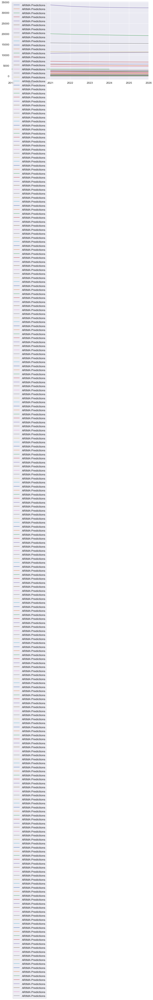

In [195]:
total_predictions = list()
country_list = list()
dates = ['2021', '2022', '2023', '2024', '2025', '2026']

all_dates = list()
for country in countries:
    df = data[data.country == country]
    #dates = data.index
    all_dates.append(dates)
    
    count = 6
    l= []
    x = str(country)
    for i in range(count):
        l.append(x)
    #adding country to our country list
    
    country_list.append(l)
    
    
    df = df.drop(columns=['country'])
    print(df.shape)
    
    
    model2 = ARIMA(df['co2'], order=(1, 1, 0))
    model2 = model2.fit()
    
    #future years predictions
    preds = list()
    index_future_dates = pd.date_range(start='2021-01-01', end='2026-01-01', freq='8760H')
    
    predictions = model2.predict(start=len(df), end=len(df)+5, typ='levels').rename('ARIMA Predictions')
    yhat = predictions[0]
    preds.append(yhat)
    
    
    total_predictions.append(predictions)
 
    predictions.plot(legend=True)
    print(country)
    print(predictions)
    

In [196]:
country_list

[['Afghanistan',
  'Afghanistan',
  'Afghanistan',
  'Afghanistan',
  'Afghanistan',
  'Afghanistan'],
 ['Africa', 'Africa', 'Africa', 'Africa', 'Africa', 'Africa'],
 ['Albania', 'Albania', 'Albania', 'Albania', 'Albania', 'Albania'],
 ['Algeria', 'Algeria', 'Algeria', 'Algeria', 'Algeria', 'Algeria'],
 ['Andorra', 'Andorra', 'Andorra', 'Andorra', 'Andorra', 'Andorra'],
 ['Angola', 'Angola', 'Angola', 'Angola', 'Angola', 'Angola'],
 ['Anguilla', 'Anguilla', 'Anguilla', 'Anguilla', 'Anguilla', 'Anguilla'],
 ['Antarctica',
  'Antarctica',
  'Antarctica',
  'Antarctica',
  'Antarctica',
  'Antarctica'],
 ['Antigua and Barbuda',
  'Antigua and Barbuda',
  'Antigua and Barbuda',
  'Antigua and Barbuda',
  'Antigua and Barbuda',
  'Antigua and Barbuda'],
 ['Argentina',
  'Argentina',
  'Argentina',
  'Argentina',
  'Argentina',
  'Argentina'],
 ['Armenia', 'Armenia', 'Armenia', 'Armenia', 'Armenia', 'Armenia'],
 ['Aruba', 'Aruba', 'Aruba', 'Aruba', 'Aruba', 'Aruba'],
 ['Asia', 'Asia', 'Asia'

In [197]:
total_predictions

[2021-01-01    12.164524
 2022-01-01    12.166099
 2023-01-01    12.166647
 2024-01-01    12.166837
 2025-01-01    12.166904
 2026-01-01    12.166927
 Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64,
 2021-01-01    1302.055553
 2022-01-01    1295.074955
 2023-01-01    1293.043612
 2024-01-01    1292.452495
 2025-01-01    1292.280481
 2026-01-01    1292.230425
 Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64,
 2021-01-01    4.572755
 2022-01-01    4.568409
 2023-01-01    4.568910
 2024-01-01    4.568852
 2025-01-01    4.568859
 2026-01-01    4.568858
 Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64,
 2021-01-01    157.489127
 2022-01-01    156.955026
 2023-01-01    157.069400
 2024-01-01    157.044908
 2025-01-01    157.050153
 2026-01-01    157.049029
 Freq: AS-JAN, Name: ARIMA Predictions, dtype: float64,
 2021-01-01    0.454623
 2022-01-01    0.451027
 2023-01-01    0.449891
 2024-01-01    0.449532
 2025-01-01    0.449418
 2026-01-01    0.449382
 Freq: AS-JAN, Name:

## Adding our predictions into a Dataframe

In [198]:
predictions = pd.DataFrame(columns=['year', 'country', 'co2'])

In [199]:
countries = co2_df.country.unique()

In [200]:
country_counts = len(countries)
date_counts = len(dates)
merged_predictions = list()

for i in range(country_counts):
    for j in range(date_counts):
        merged_predictions.append(total_predictions[i][j])
    

In [201]:
merged_predictions

[12.16452426748051,
 12.16609880565243,
 12.166646777333044,
 12.166837482752646,
 12.166903852162513,
 12.166926950082724,
 1302.0555526880232,
 1295.0749545872227,
 1293.0436121993155,
 1292.4524949573079,
 1292.2804808272042,
 1292.2304250026527,
 4.5727553588793866,
 4.568409422525394,
 4.568909673704394,
 4.568852090891001,
 4.568858719122053,
 4.568857956160949,
 157.48912650898163,
 156.95502613611268,
 157.06940012928084,
 157.04490770991973,
 157.05015259636238,
 157.04902943929935,
 0.4546227314097546,
 0.45102711361601117,
 0.4498907716885858,
 0.44953164759640013,
 0.4494181517282327,
 0.4493822830344542,
 22.26602553941554,
 22.262435567334254,
 22.262625024112623,
 22.262615025742146,
 22.262615553395012,
 22.26261552554872,
 0.1204250787838857,
 0.12001069007956457,
 0.11994400143791023,
 0.11993326906301843,
 0.11993154187428043,
 0.11993126391334757,
 0.007000000000005,
 0.007000000000005,
 0.007000000000005,
 0.007000000000005,
 0.007000000000005,
 0.007000000000005,


In [202]:
all_dates

[['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024', '2025', '2026'],
 ['2021', '2022', '2023', '2024

In [203]:
import itertools

In [204]:
merged_dates = list(itertools.chain(*all_dates))

In [205]:
merged_dates

['2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 '2024',
 '2025',
 '2026',
 '2021',
 '2022',
 '2023',
 

In [206]:
merged_country = list(itertools.chain(*country_list))

In [207]:
predictions['year'] = merged_dates

In [208]:
predictions['co2'] = merged_predictions

In [209]:
predictions['country'] = merged_country

In [210]:
predictions

,year,country,co2
0,2021,Afghanistan,12.164524
1,2022,Afghanistan,12.166099
2,2023,Afghanistan,12.166647
3,2024,Afghanistan,12.166837
4,2025,Afghanistan,12.166904
...,...,...,...
1483,2022,Zimbabwe,10.564310
1484,2023,Zimbabwe,10.564589
1485,2024,Zimbabwe,10.564564
1486,2025,Zimbabwe,10.564566


In [211]:
predictions.index = predictions['year']

In [212]:
predictions.index = pd.to_datetime(predictions.index, format='%Y')

In [213]:
predictions

,year,country,co2
year,,,
2021-01-01,2021,Afghanistan,12.164524
2022-01-01,2022,Afghanistan,12.166099
2023-01-01,2023,Afghanistan,12.166647
2024-01-01,2024,Afghanistan,12.166837
2025-01-01,2025,Afghanistan,12.166904
...,...,...,...
2022-01-01,2022,Zimbabwe,10.564310
2023-01-01,2023,Zimbabwe,10.564589
2024-01-01,2024,Zimbabwe,10.564564


In [214]:
predictions = predictions.drop(columns=['year'])

In [215]:
predictions

,country,co2
year,,
2021-01-01,Afghanistan,12.164524
2022-01-01,Afghanistan,12.166099
2023-01-01,Afghanistan,12.166647
2024-01-01,Afghanistan,12.166837
2025-01-01,Afghanistan,12.166904
...,...,...
2022-01-01,Zimbabwe,10.564310
2023-01-01,Zimbabwe,10.564589
2024-01-01,Zimbabwe,10.564564


### Plotting previous co2 emissions values along with our prediction values

In [216]:
data

,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
year,,,,,,,,,,,,,,,,,,,,,
1949-01-01,0.015,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,9.460000e+00,0.5740,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.83600,0.53450,Afghanistan
1950-01-01,0.084,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,1.143000e+01,0.4750,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.89250,0.23850,Afghanistan
1951-01-01,0.092,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,1.123000e+01,0.5490,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.93500,0.54700,Afghanistan
1952-01-01,0.092,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,1.123000e+01,0.5490,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.93500,0.54700,Afghanistan
1953-01-01,0.106,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,1.123000e+01,0.5490,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.93500,0.54700,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-01-01,10.738,0.765,0.639,0.0460,6.959,0.496,3.1390,0.2240,-12.1700,-1.488,...,2.096179e+10,46.6660,3326.073,2.2260,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
2017-01-01,9.582,0.673,0.678,0.0480,5.665,0.398,3.2390,0.2280,-10.7700,-1.156,...,2.194784e+10,45.9360,3226.617,2.0930,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe
2018-01-01,11.854,0.821,0.697,0.0480,7.101,0.492,4.0560,0.2810,23.7200,2.273,...,2.271535e+10,47.5020,3289.887,2.0910,40677052.5,2.828654e+11,2322.8500,42573.62775,2.69575,Zimbabwe


In [217]:
data['co2']

year
1949-01-01     0.015
1950-01-01     0.084
1951-01-01     0.092
1952-01-01     0.092
1953-01-01     0.106
               ...  
2016-01-01    10.738
2017-01-01     9.582
2018-01-01    11.854
2019-01-01    10.949
2020-01-01    10.531
Name: co2, Length: 25989, dtype: float64

---------------------------------------------------------------------------------
Afghanistan


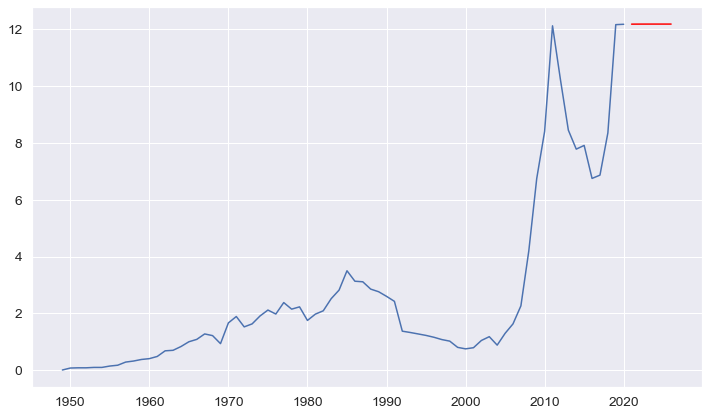

---------------------------------------------------------------------------------
Africa


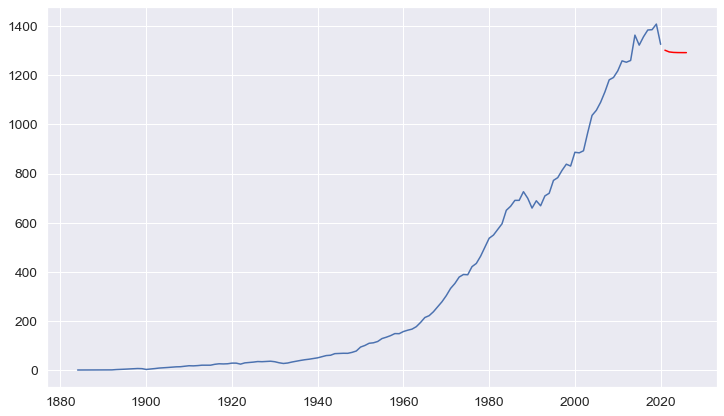

---------------------------------------------------------------------------------
Albania


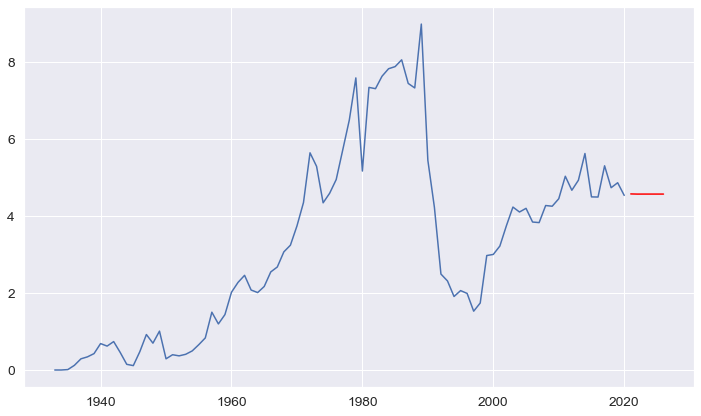

---------------------------------------------------------------------------------
Algeria


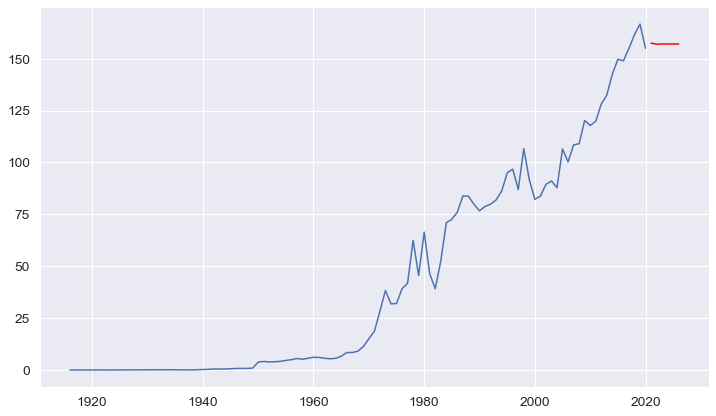

---------------------------------------------------------------------------------
Andorra


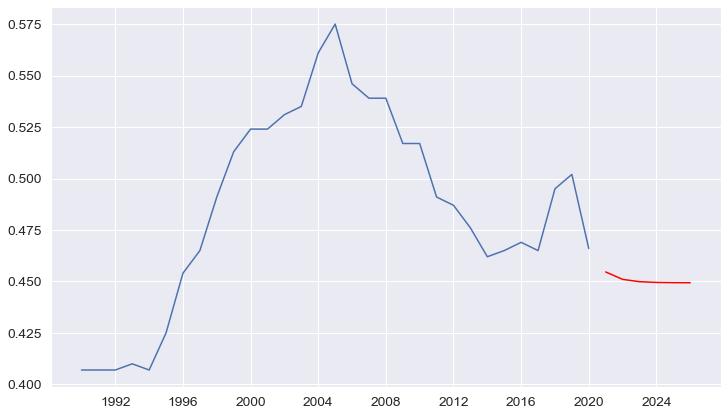

---------------------------------------------------------------------------------
Angola


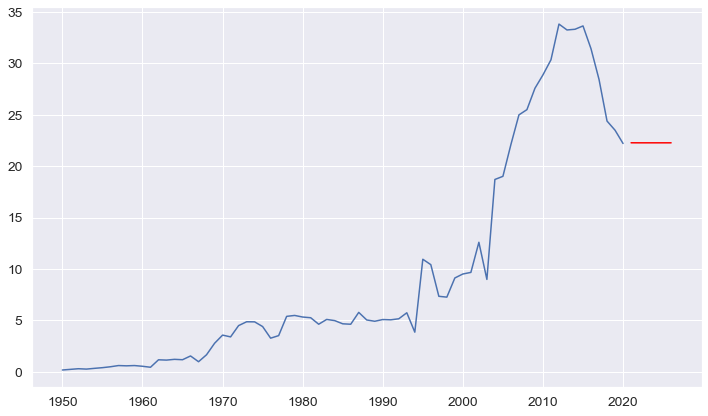

---------------------------------------------------------------------------------
Anguilla


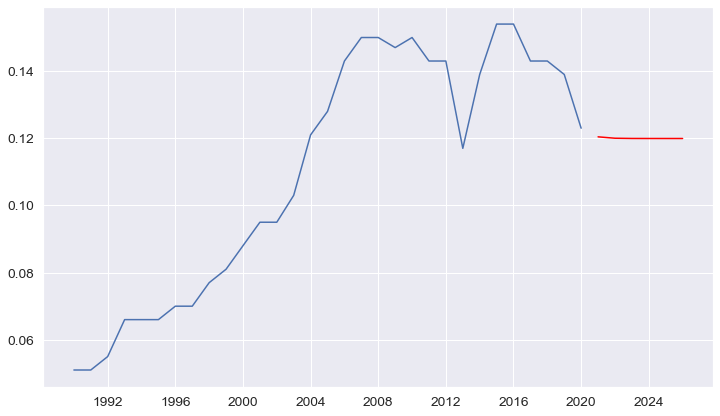

---------------------------------------------------------------------------------
Antarctica


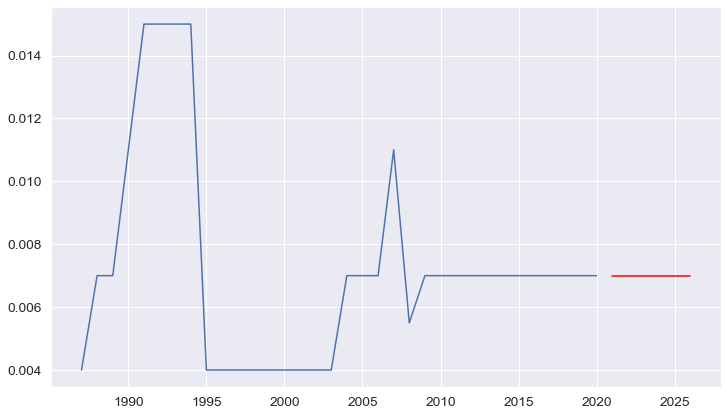

---------------------------------------------------------------------------------
Antigua and Barbuda


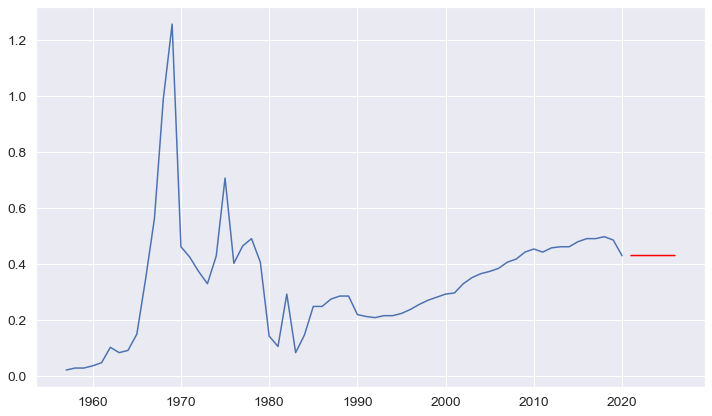

---------------------------------------------------------------------------------
Argentina


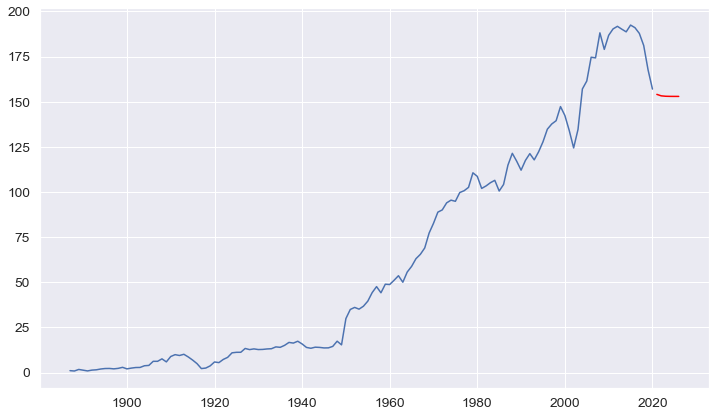

---------------------------------------------------------------------------------
Armenia


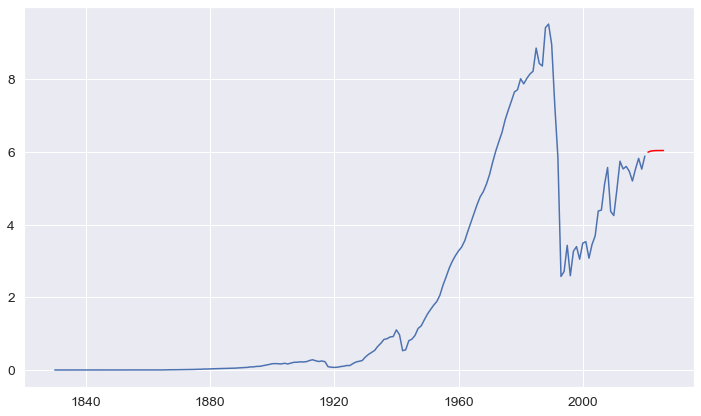

---------------------------------------------------------------------------------
Aruba


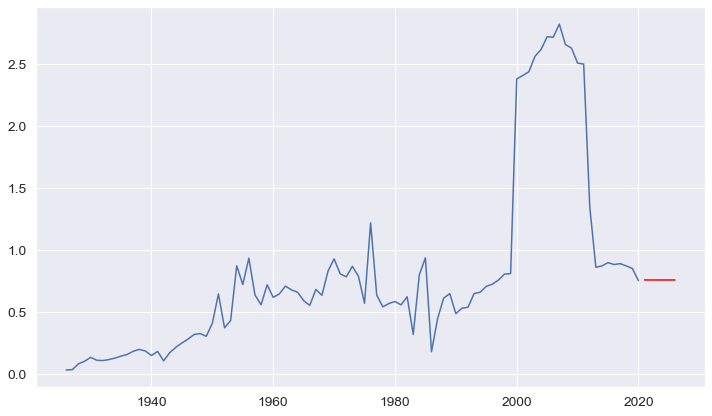

---------------------------------------------------------------------------------
Asia


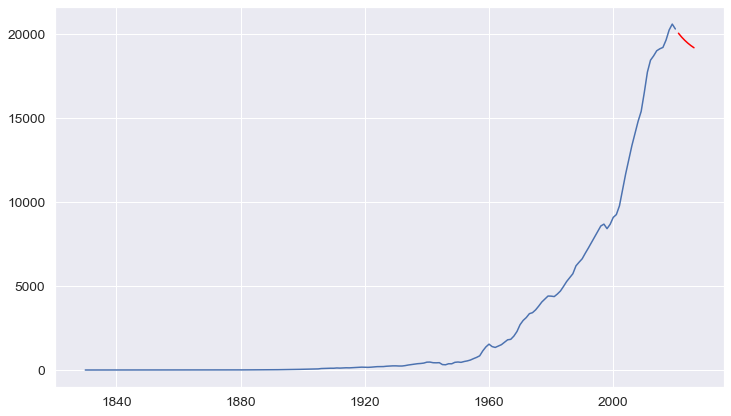

---------------------------------------------------------------------------------
Asia (excl. China & India)


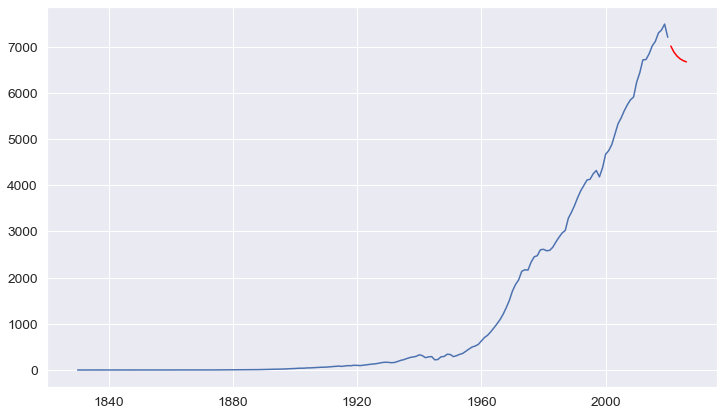

---------------------------------------------------------------------------------
Australia


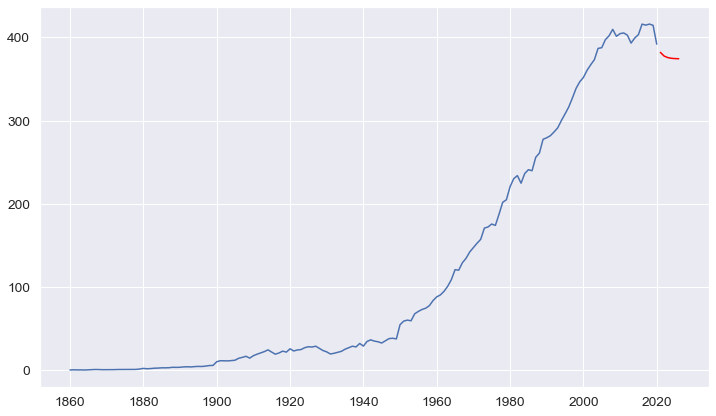

---------------------------------------------------------------------------------
Austria


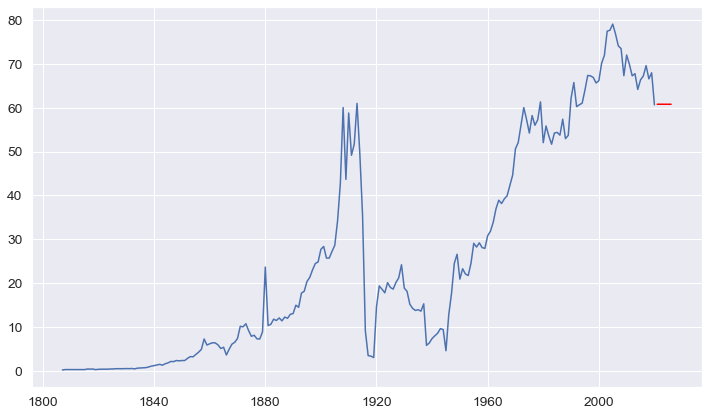

---------------------------------------------------------------------------------
Azerbaijan


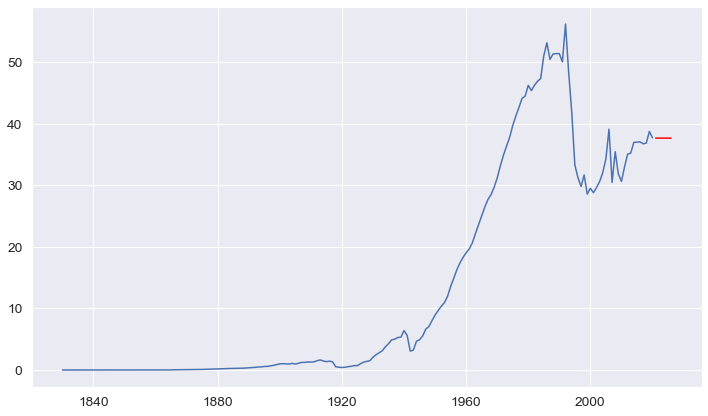

---------------------------------------------------------------------------------
Bahamas


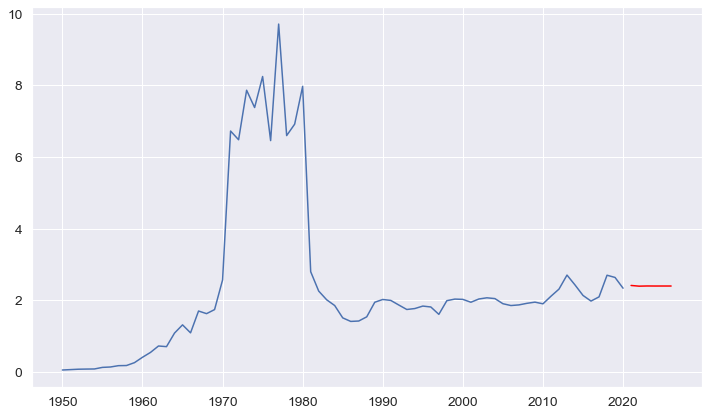

---------------------------------------------------------------------------------
Bahrain


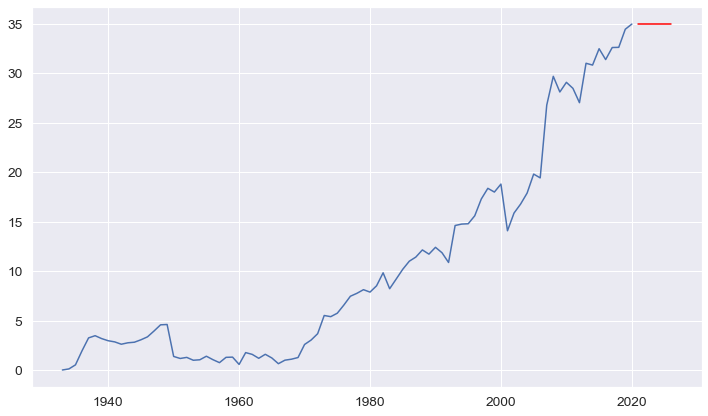

---------------------------------------------------------------------------------
Bangladesh


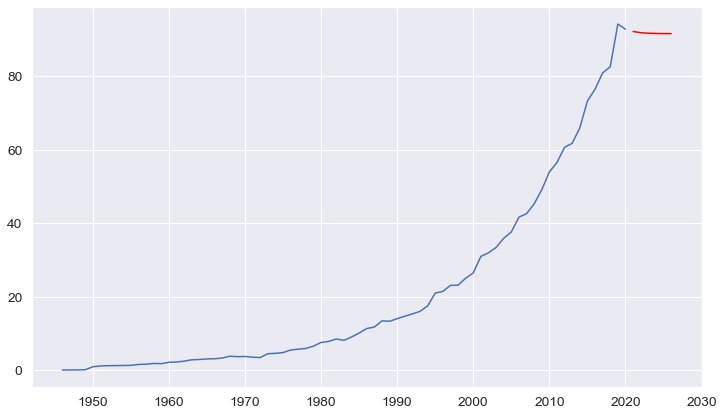

---------------------------------------------------------------------------------
Barbados


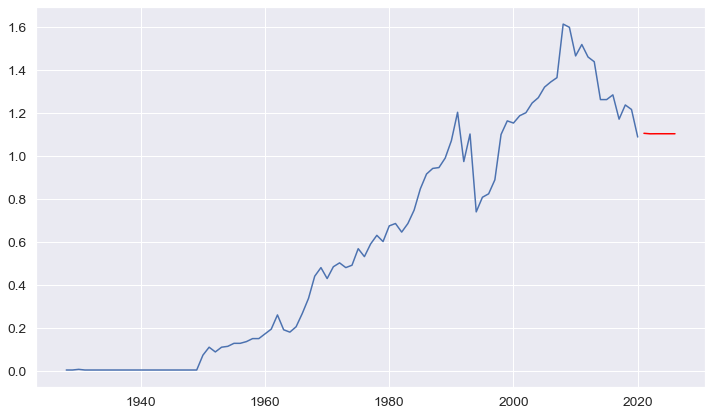

---------------------------------------------------------------------------------
Belarus


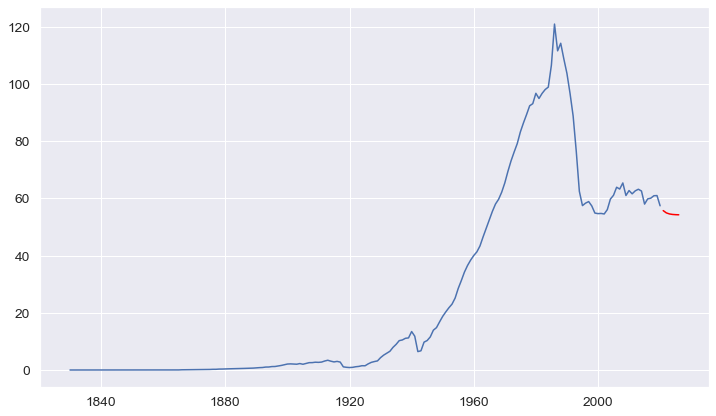

---------------------------------------------------------------------------------
Belgium


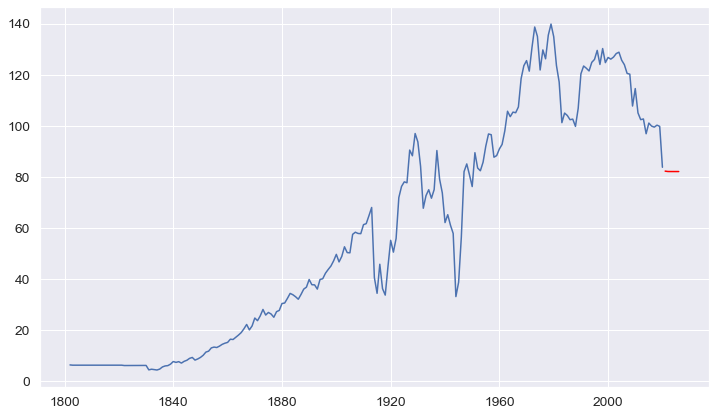

---------------------------------------------------------------------------------
Belize


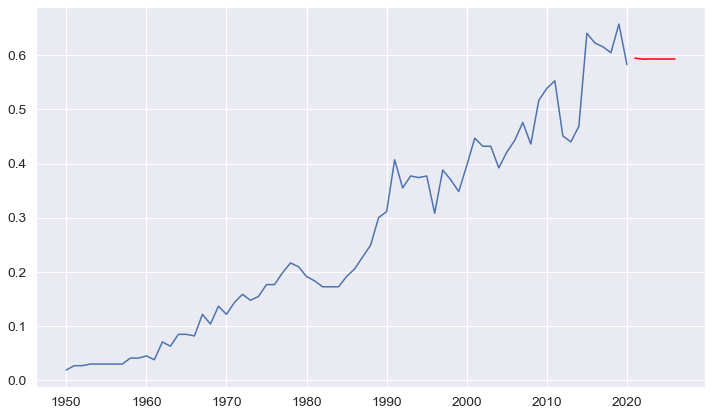

---------------------------------------------------------------------------------
Benin


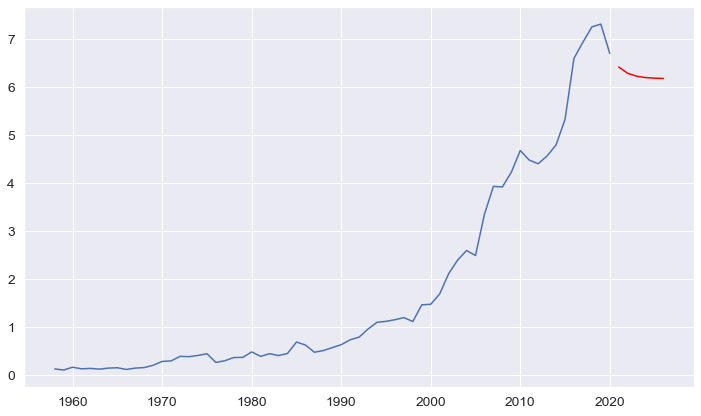

---------------------------------------------------------------------------------
Bermuda


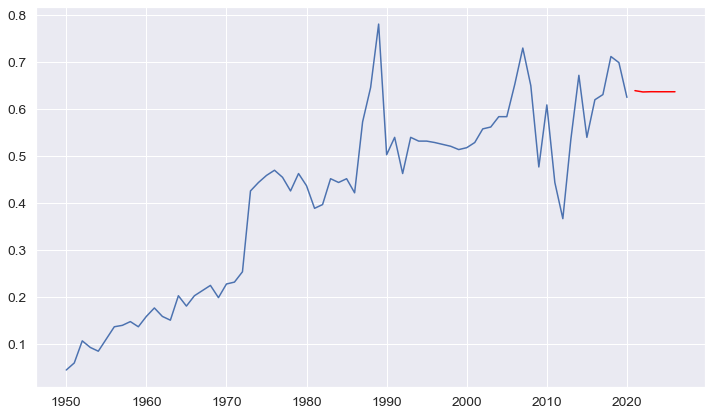

---------------------------------------------------------------------------------
Bhutan


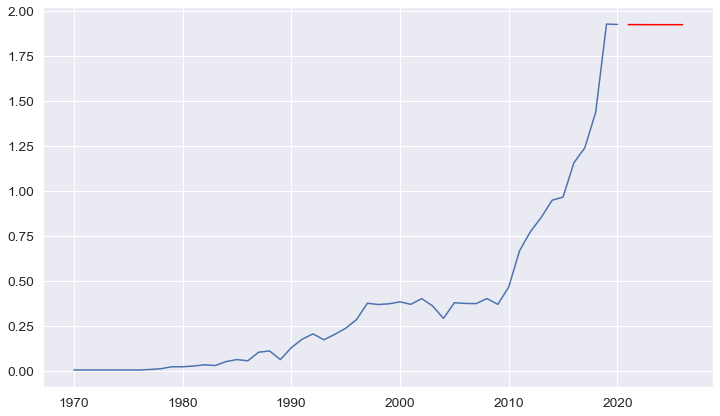

---------------------------------------------------------------------------------
Bolivia


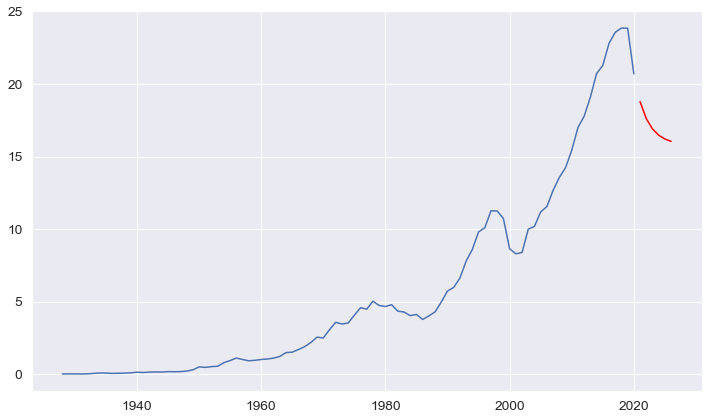

---------------------------------------------------------------------------------
Bonaire Sint Eustatius and Saba


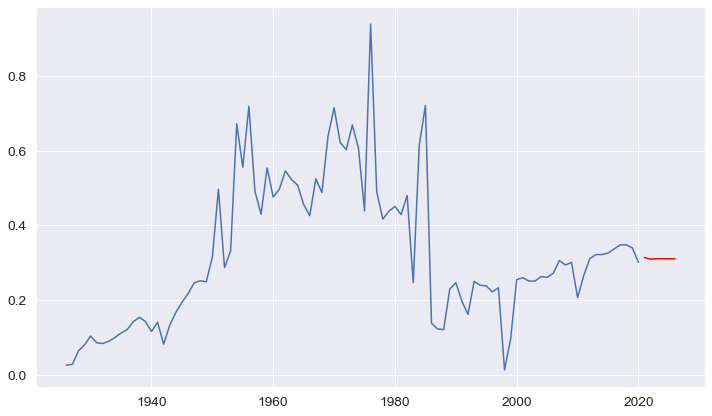

---------------------------------------------------------------------------------
Bosnia and Herzegovina


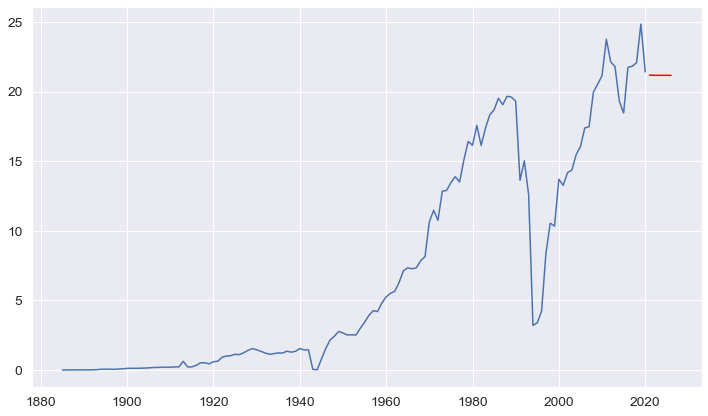

---------------------------------------------------------------------------------
Botswana


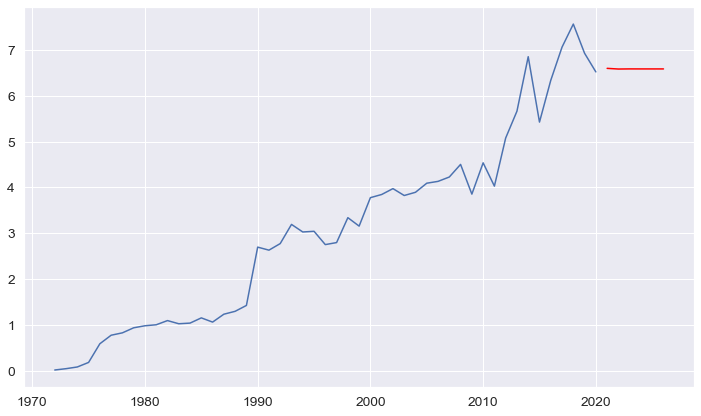

---------------------------------------------------------------------------------
Brazil


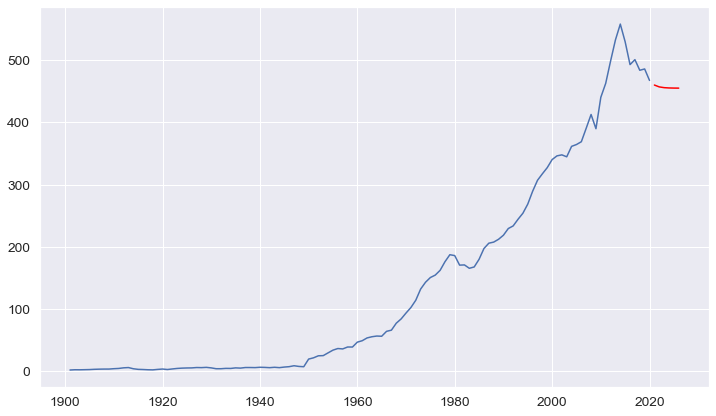

---------------------------------------------------------------------------------
British Virgin Islands


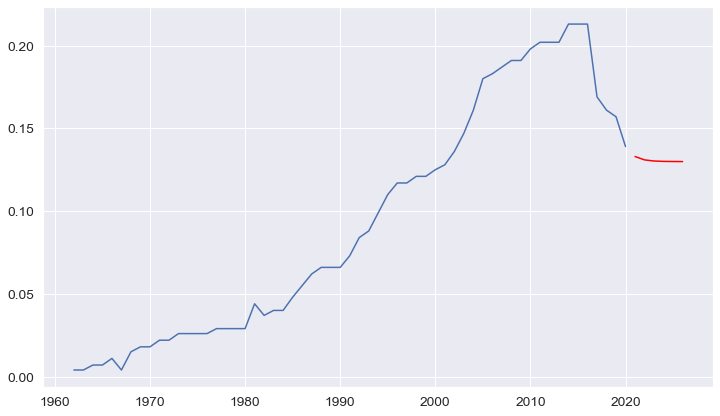

---------------------------------------------------------------------------------
Brunei


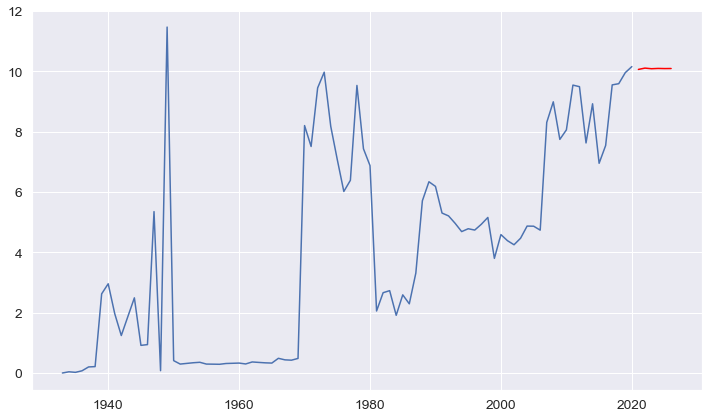

---------------------------------------------------------------------------------
Bulgaria


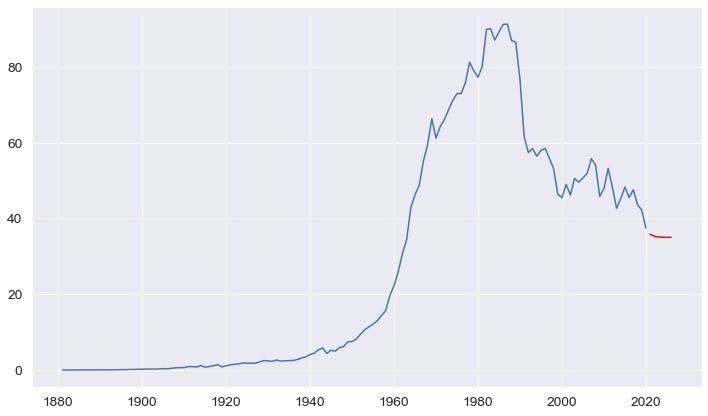

---------------------------------------------------------------------------------
Burkina Faso


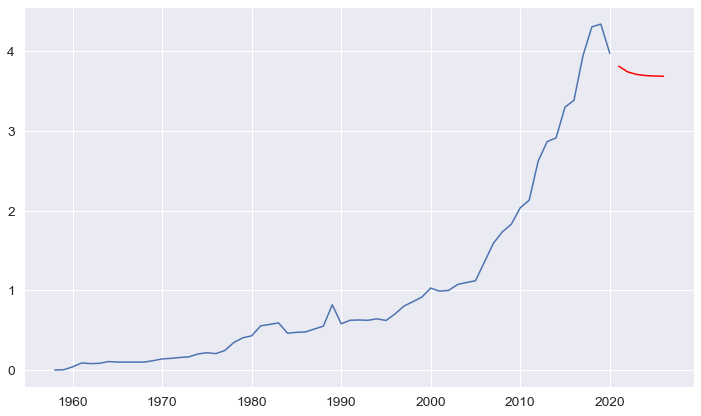

---------------------------------------------------------------------------------
Burundi


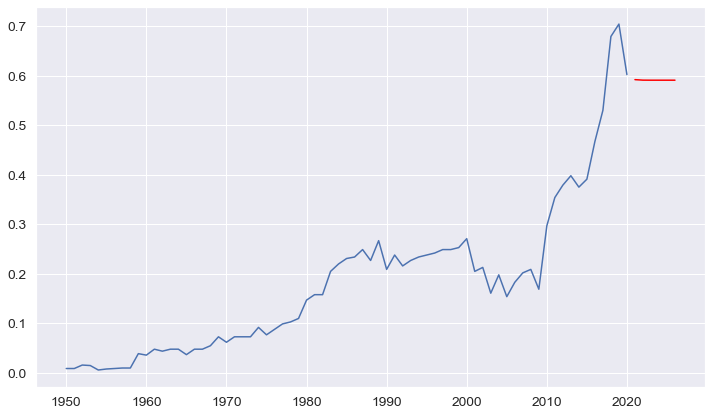

---------------------------------------------------------------------------------
Cambodia


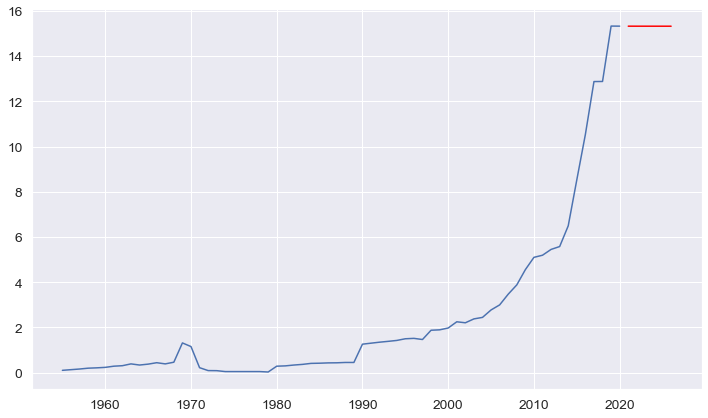

---------------------------------------------------------------------------------
Cameroon


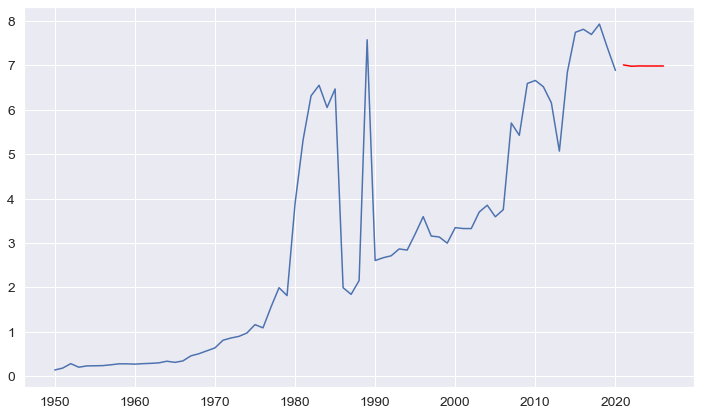

---------------------------------------------------------------------------------
Canada


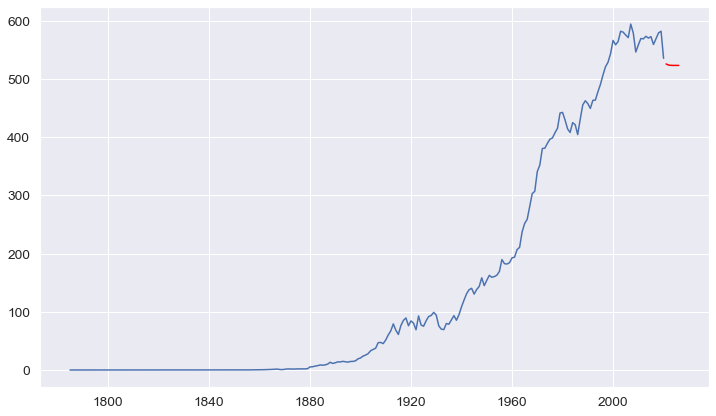

---------------------------------------------------------------------------------
Cape Verde


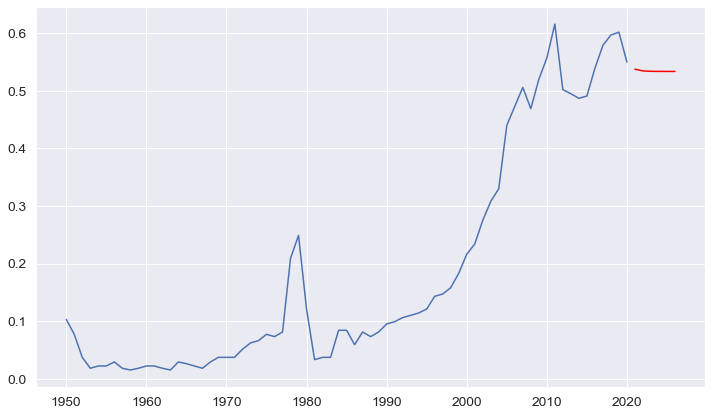

---------------------------------------------------------------------------------
Central African Republic


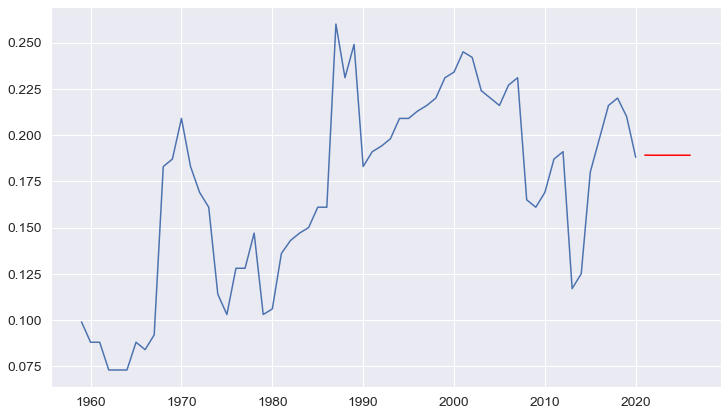

---------------------------------------------------------------------------------
Chad


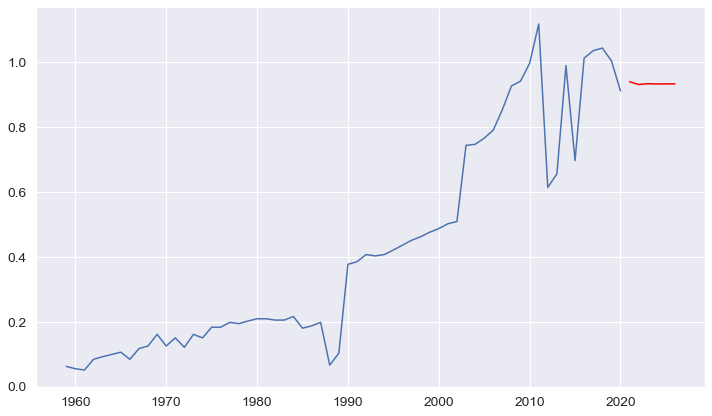

---------------------------------------------------------------------------------
Chile


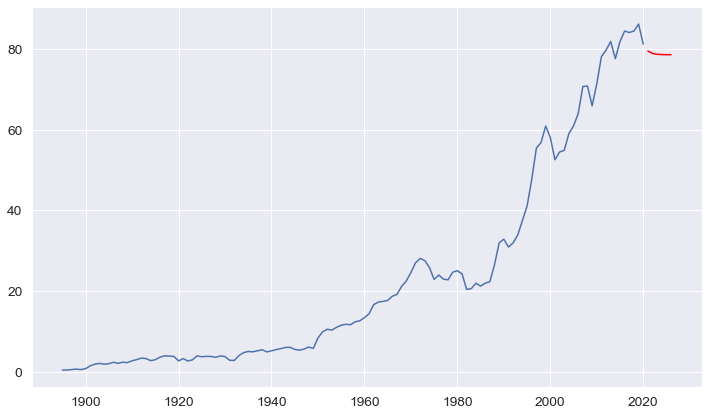

---------------------------------------------------------------------------------
China


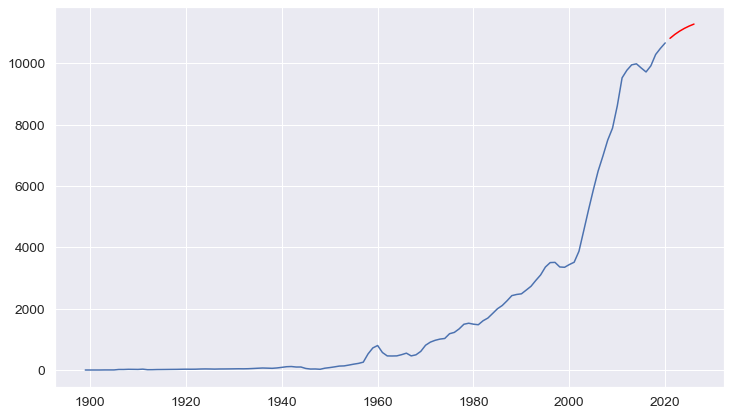

---------------------------------------------------------------------------------
Christmas Island


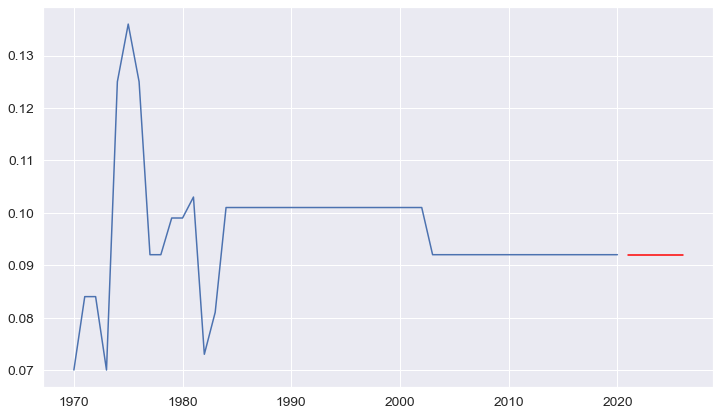

---------------------------------------------------------------------------------
Colombia


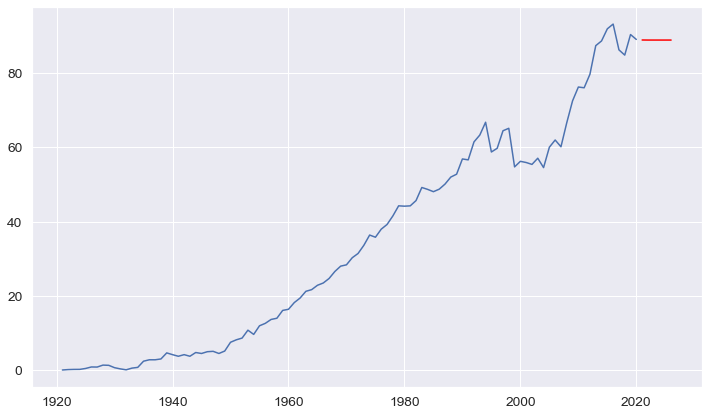

---------------------------------------------------------------------------------
Comoros


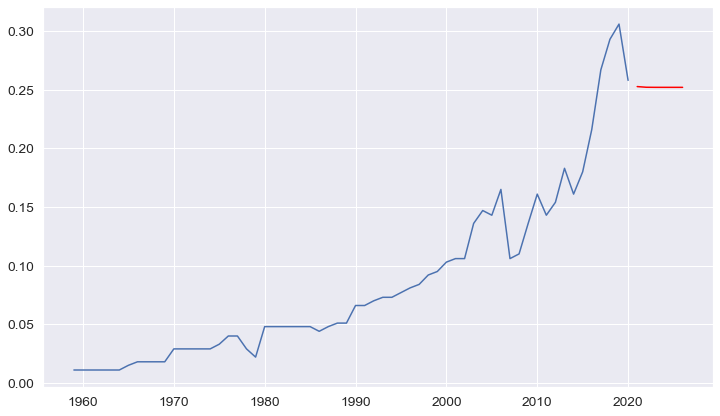

---------------------------------------------------------------------------------
Congo


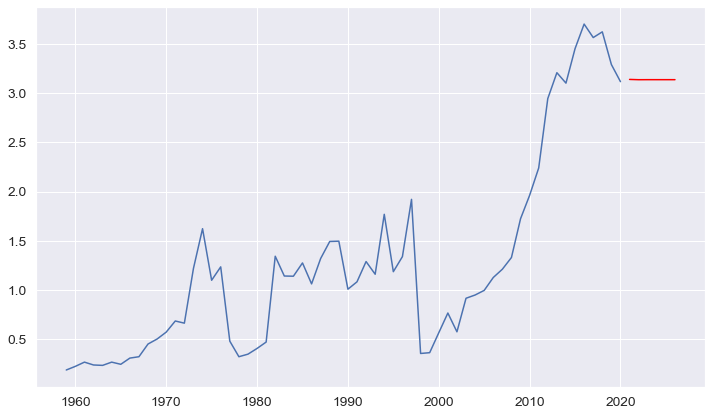

---------------------------------------------------------------------------------
Cook Islands


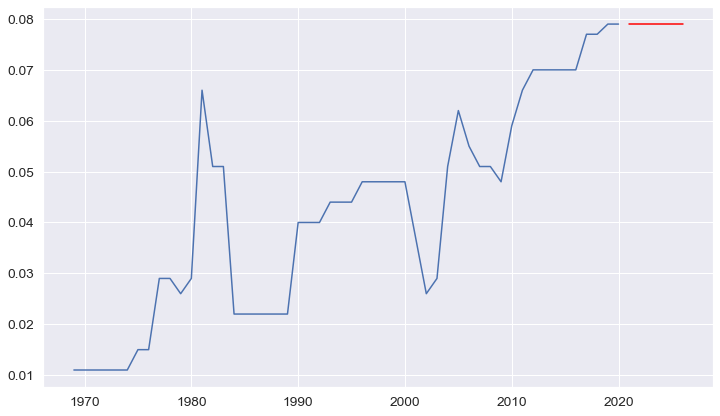

---------------------------------------------------------------------------------
Costa Rica


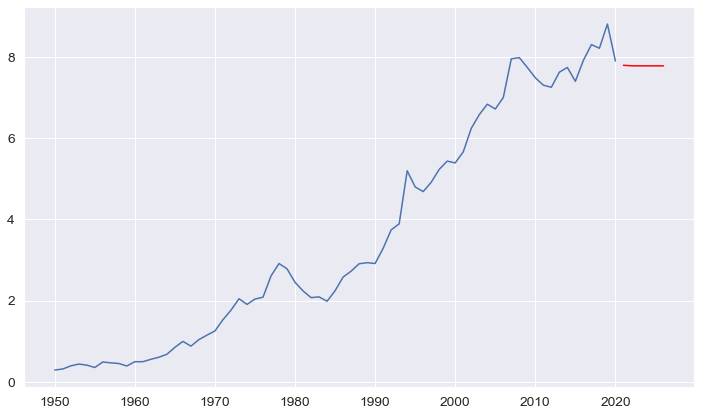

---------------------------------------------------------------------------------
Cote d'Ivoire


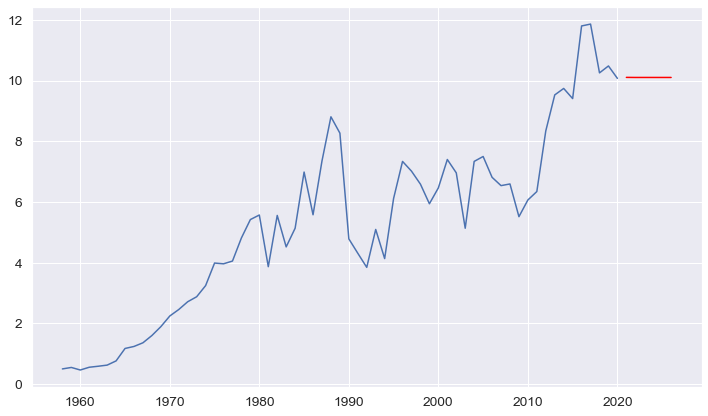

---------------------------------------------------------------------------------
Croatia


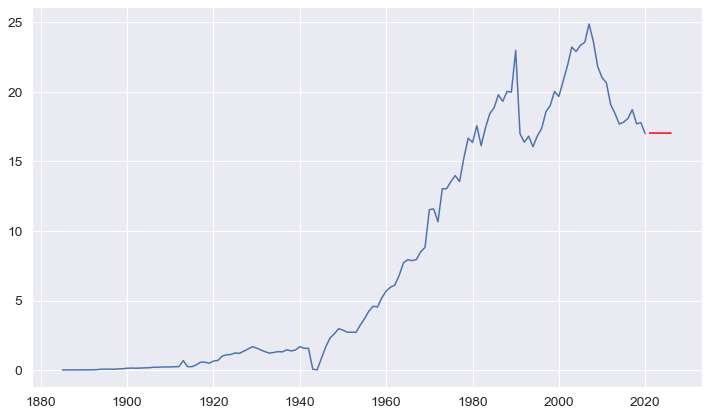

---------------------------------------------------------------------------------
Cuba


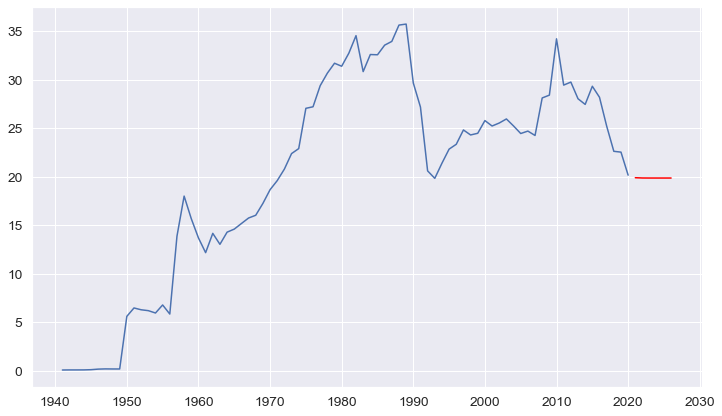

---------------------------------------------------------------------------------
Curacao


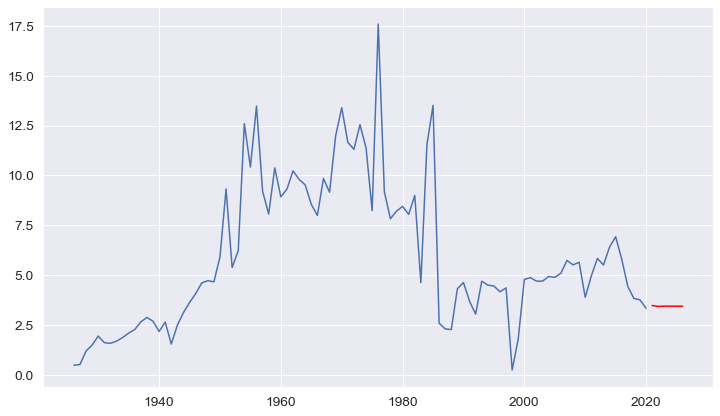

---------------------------------------------------------------------------------
Cyprus


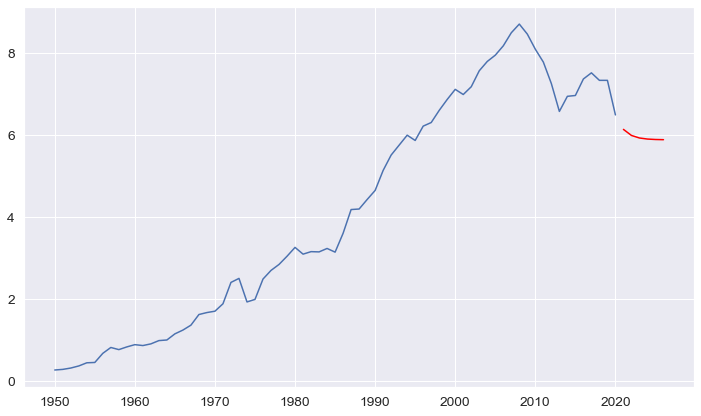

---------------------------------------------------------------------------------
Czechia


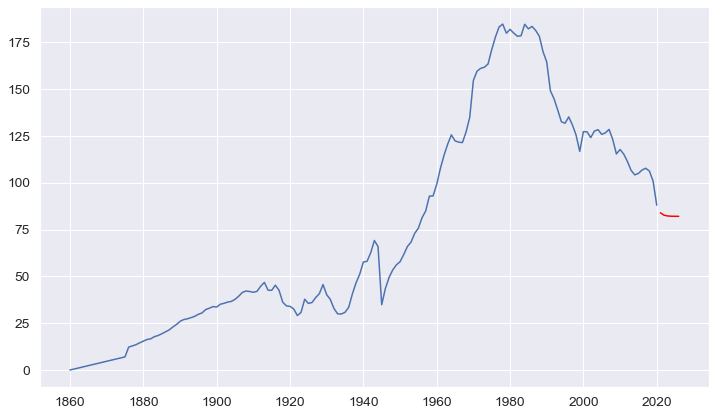

---------------------------------------------------------------------------------
Democratic Republic of Congo


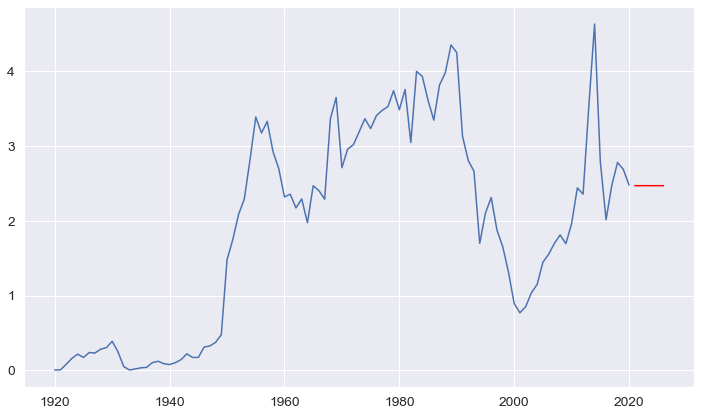

---------------------------------------------------------------------------------
Denmark


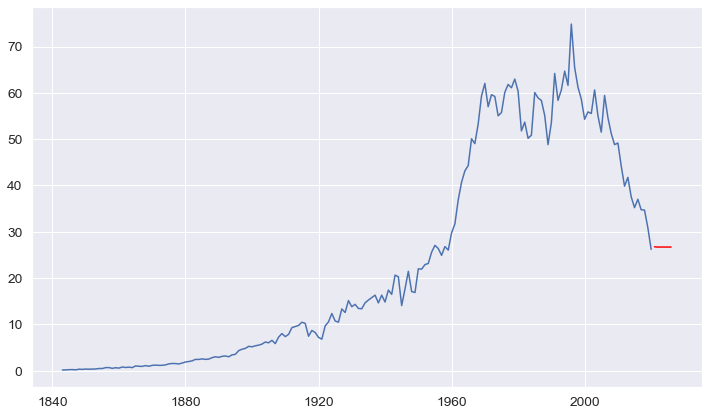

---------------------------------------------------------------------------------
Djibouti


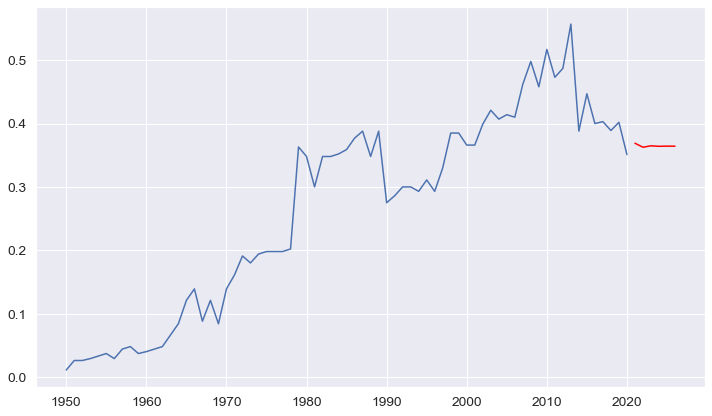

---------------------------------------------------------------------------------
Dominica


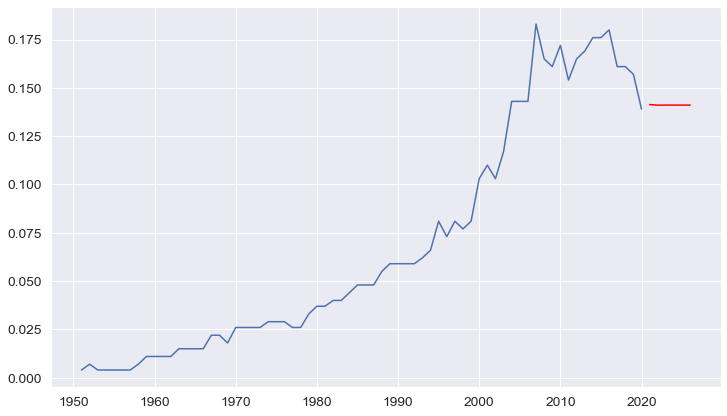

---------------------------------------------------------------------------------
Dominican Republic


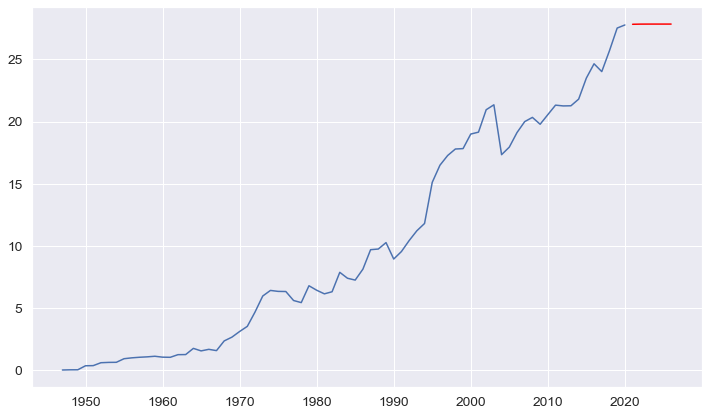

---------------------------------------------------------------------------------
EU-27


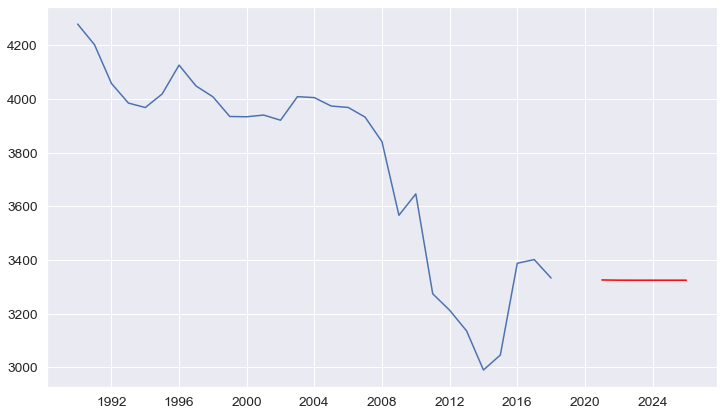

---------------------------------------------------------------------------------
Ecuador


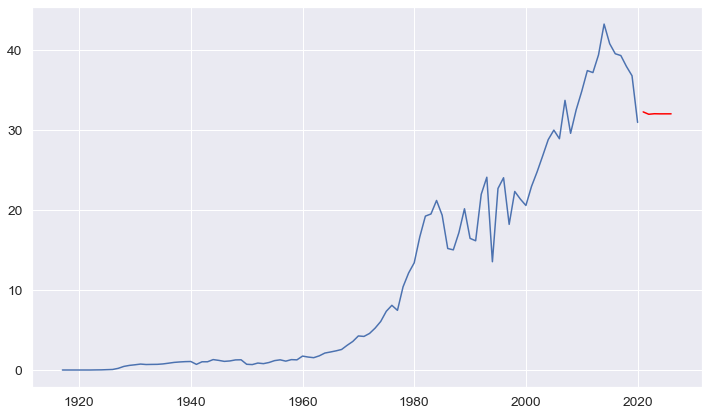

---------------------------------------------------------------------------------
Egypt


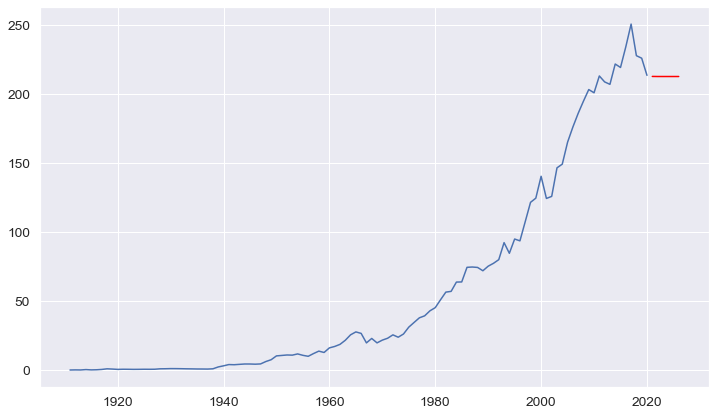

---------------------------------------------------------------------------------
El Salvador


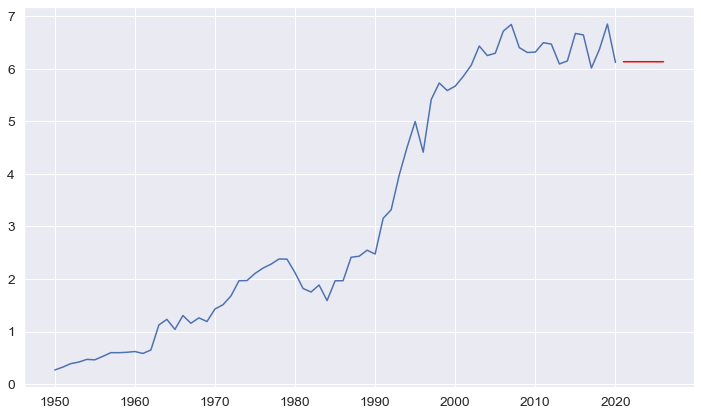

---------------------------------------------------------------------------------
Equatorial Guinea


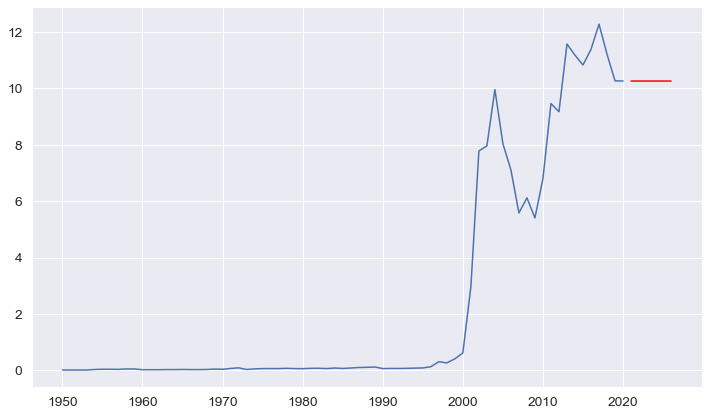

---------------------------------------------------------------------------------
Eritrea


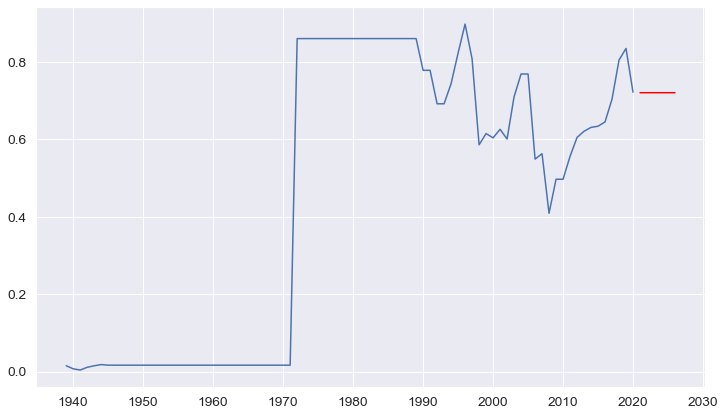

---------------------------------------------------------------------------------
Estonia


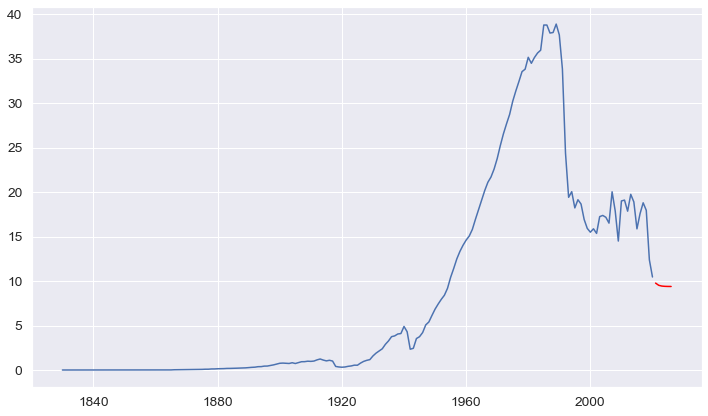

---------------------------------------------------------------------------------
Eswatini


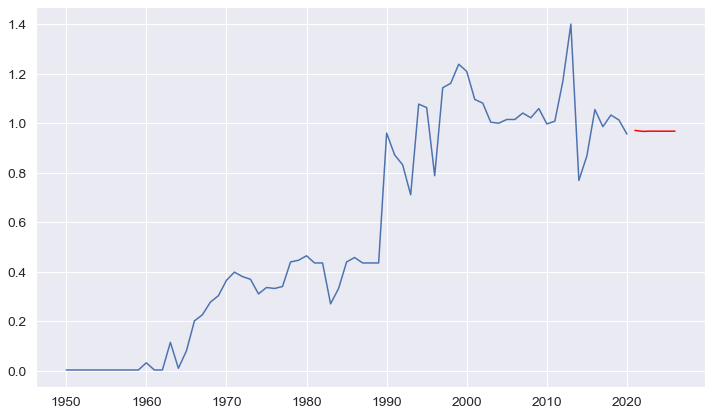

---------------------------------------------------------------------------------
Ethiopia


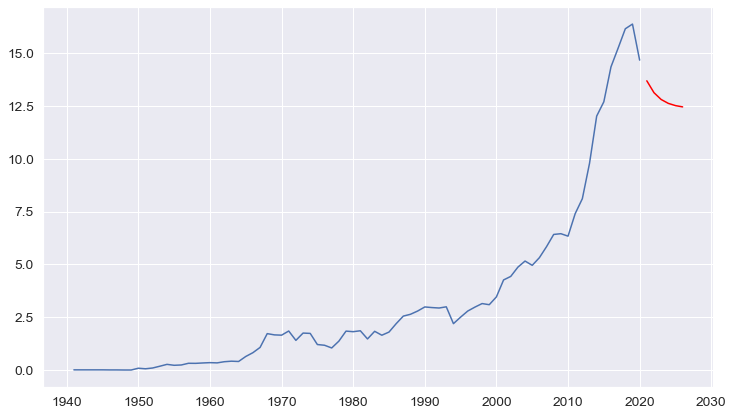

---------------------------------------------------------------------------------
Europe


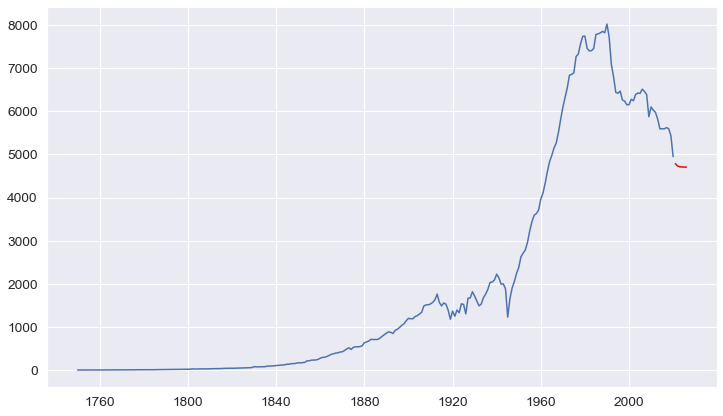

---------------------------------------------------------------------------------
Europe (excl. EU-27)


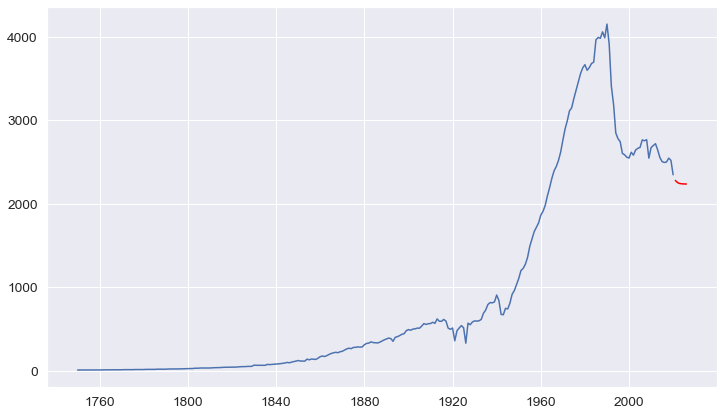

---------------------------------------------------------------------------------
Europe (excl. EU-28)


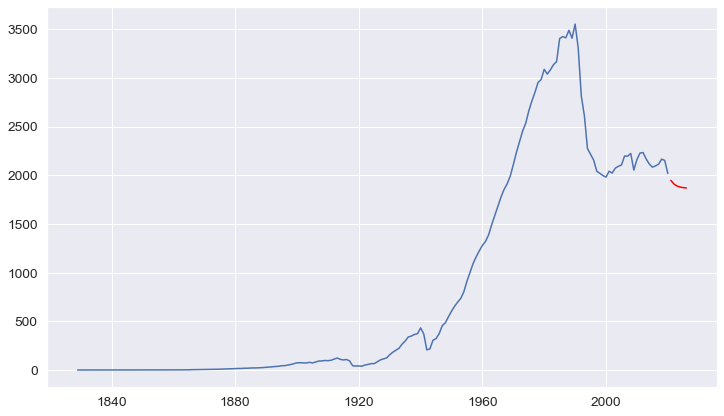

---------------------------------------------------------------------------------
European Union (27)


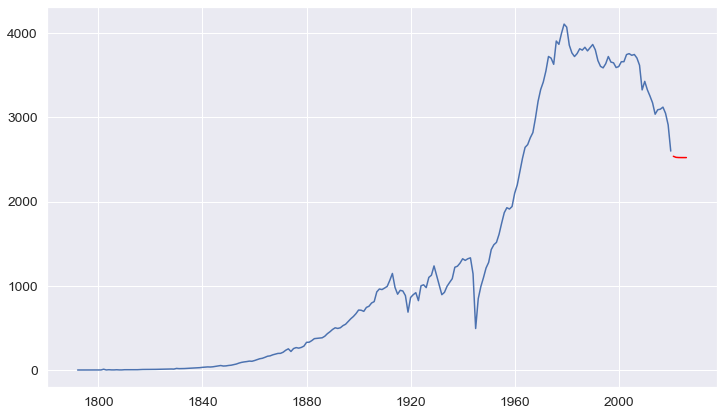

---------------------------------------------------------------------------------
European Union (28)


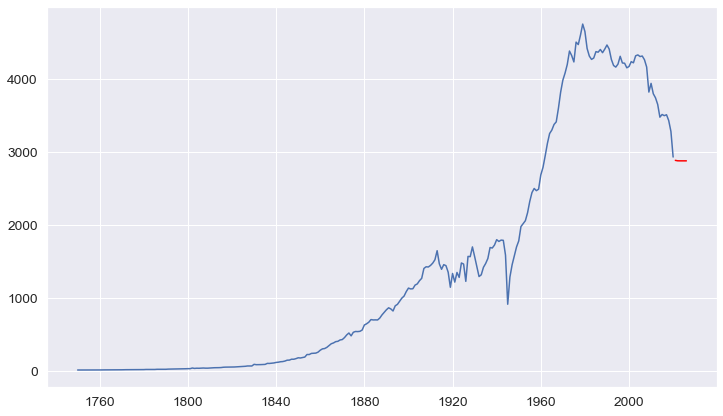

---------------------------------------------------------------------------------
Faeroe Islands


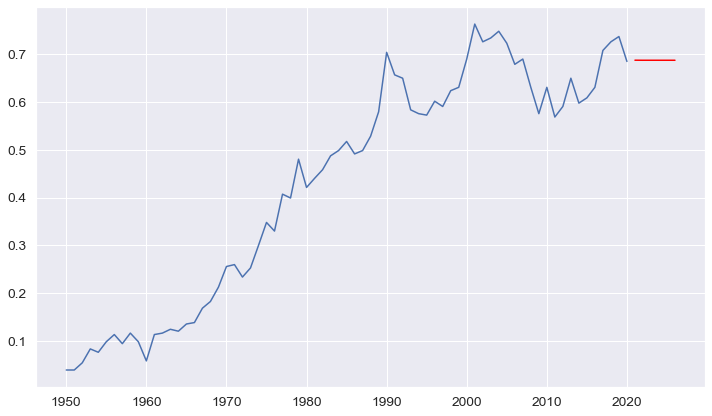

---------------------------------------------------------------------------------
Fiji


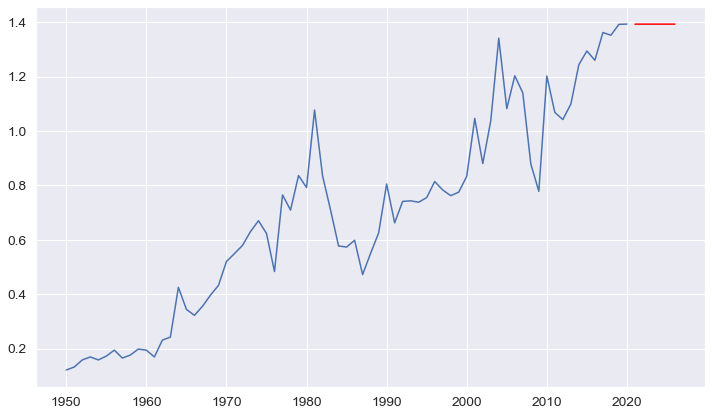

---------------------------------------------------------------------------------
Finland


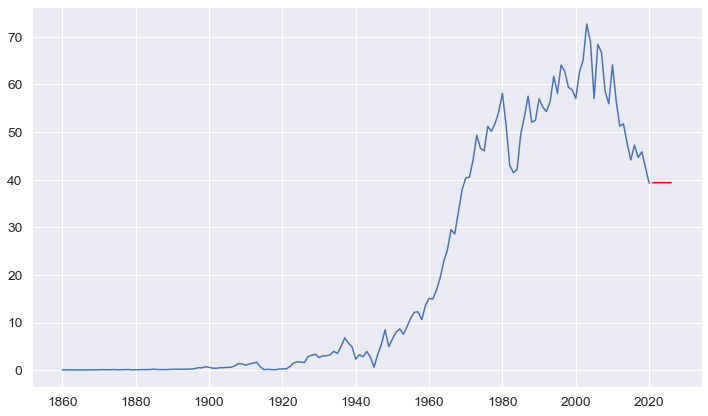

---------------------------------------------------------------------------------
France


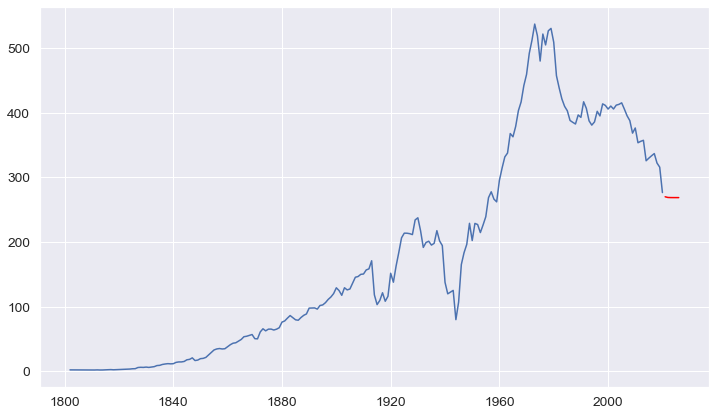

---------------------------------------------------------------------------------
French Equatorial Africa


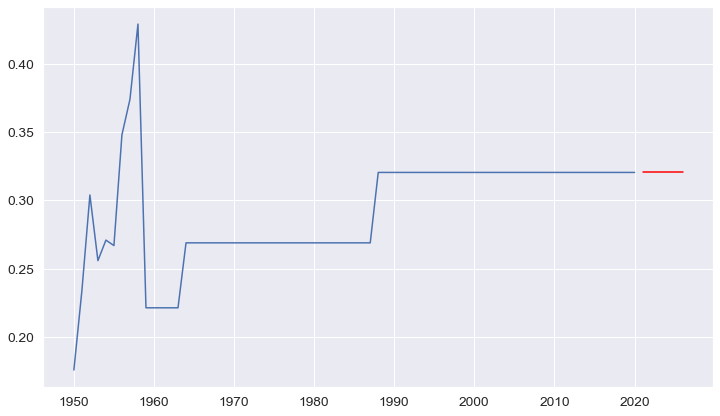

---------------------------------------------------------------------------------
French Guiana


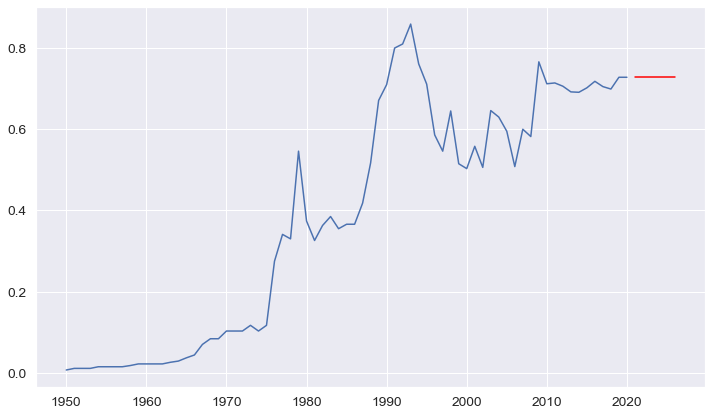

---------------------------------------------------------------------------------
French Polynesia


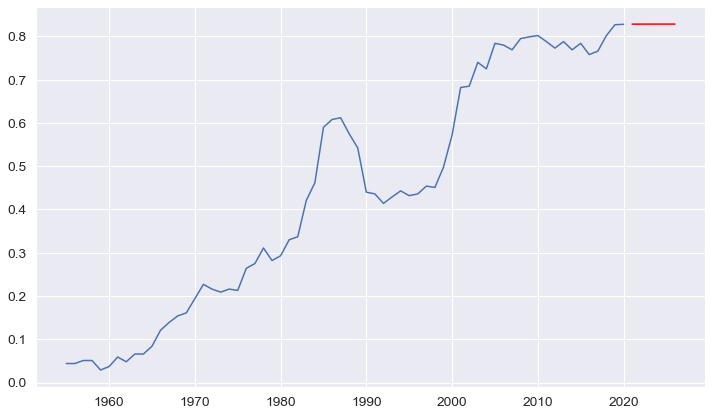

---------------------------------------------------------------------------------
French West Africa


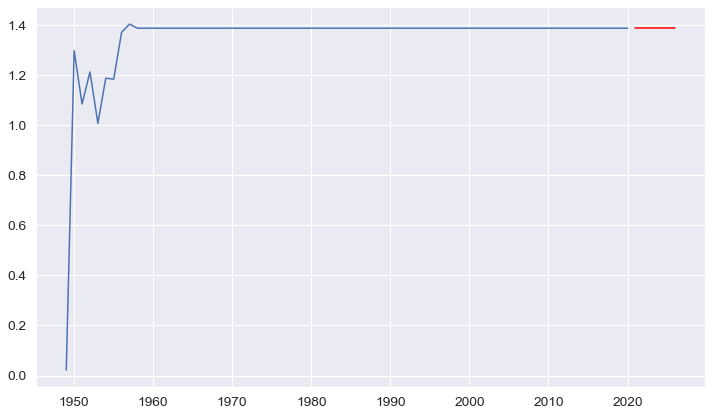

---------------------------------------------------------------------------------
Gabon


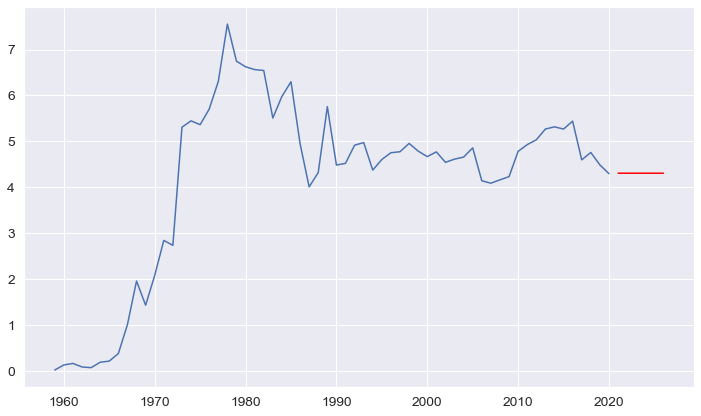

---------------------------------------------------------------------------------
Gambia


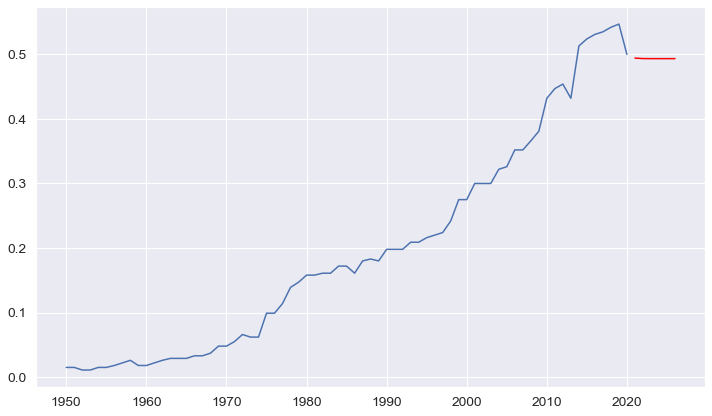

---------------------------------------------------------------------------------
Georgia


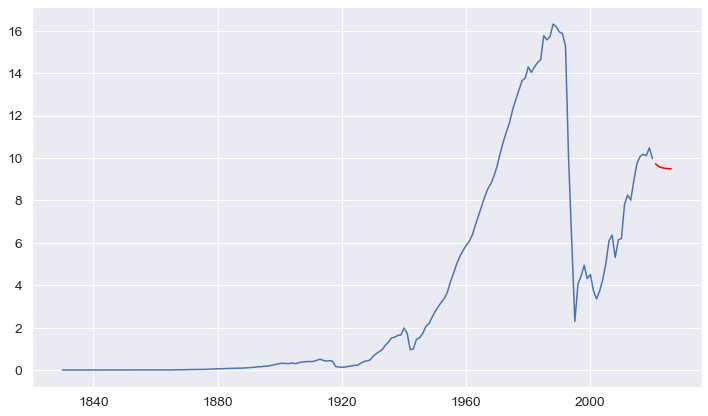

---------------------------------------------------------------------------------
Germany


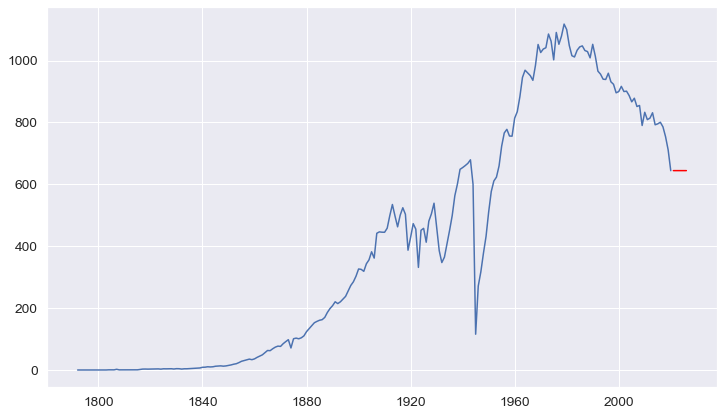

---------------------------------------------------------------------------------
Ghana


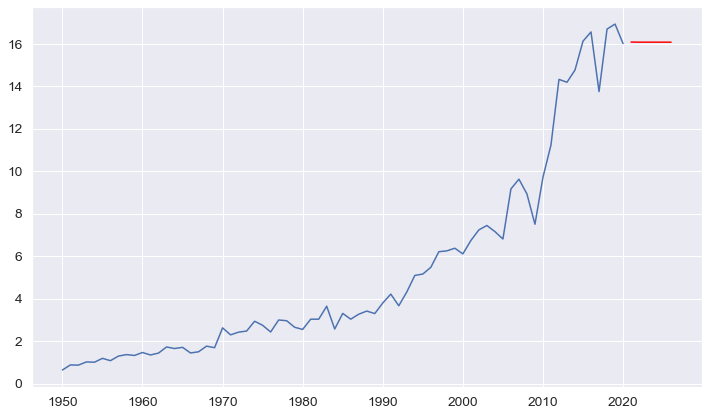

---------------------------------------------------------------------------------
Greece


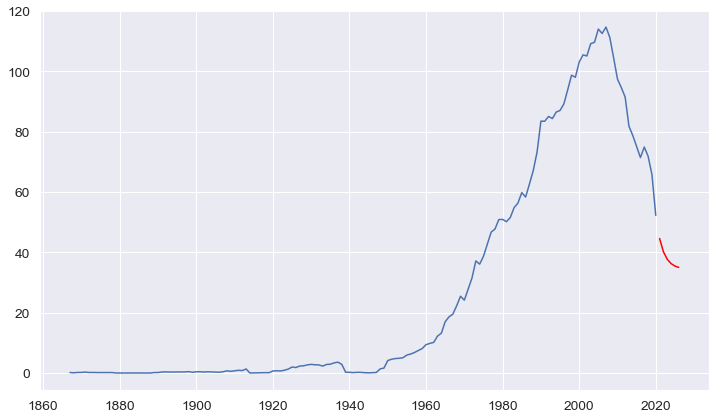

---------------------------------------------------------------------------------
Greenland


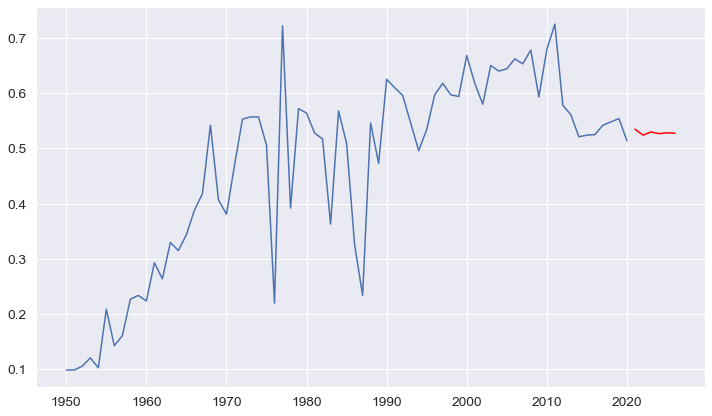

---------------------------------------------------------------------------------
Grenada


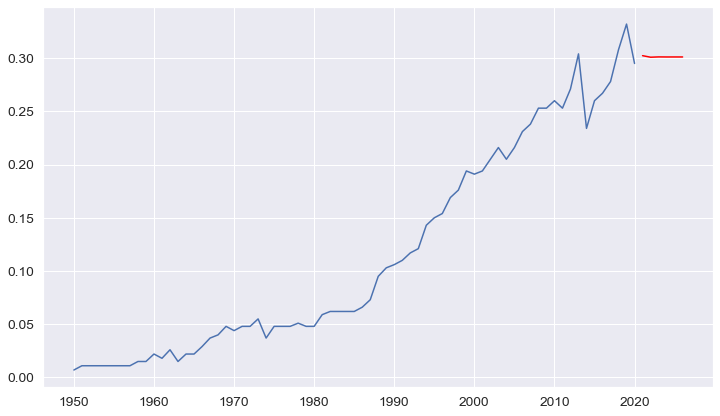

---------------------------------------------------------------------------------
Guadeloupe


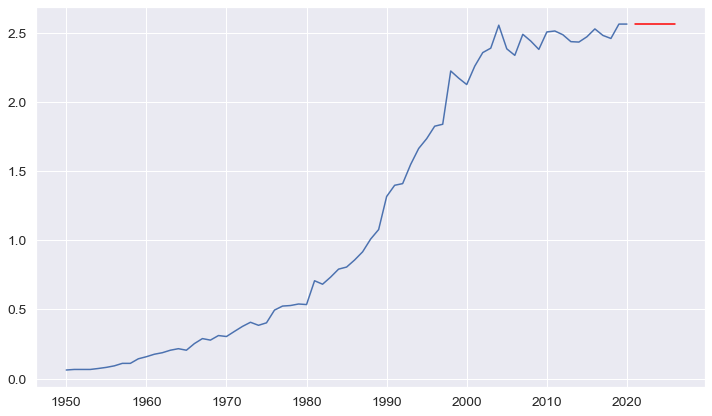

---------------------------------------------------------------------------------
Guatemala


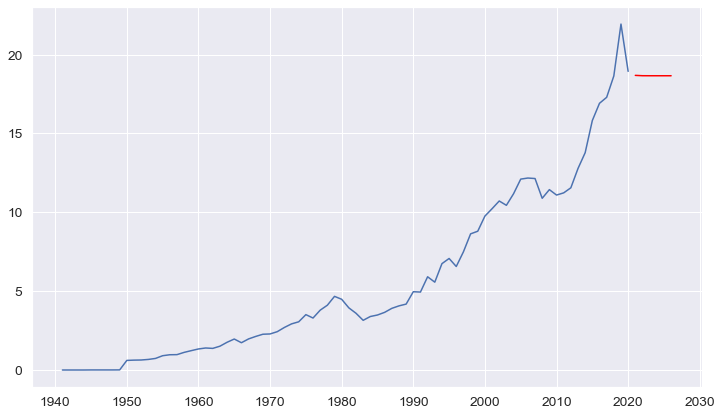

---------------------------------------------------------------------------------
Guinea


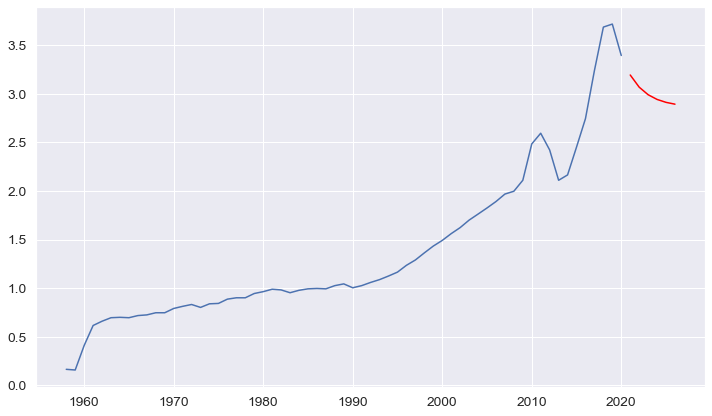

---------------------------------------------------------------------------------
Guinea-Bissau


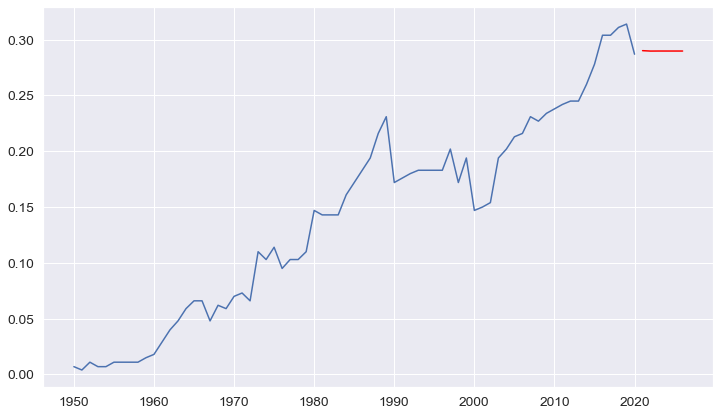

---------------------------------------------------------------------------------
Guyana


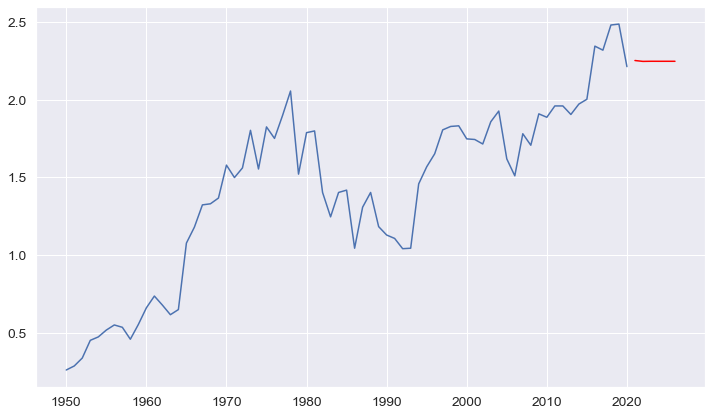

---------------------------------------------------------------------------------
Haiti


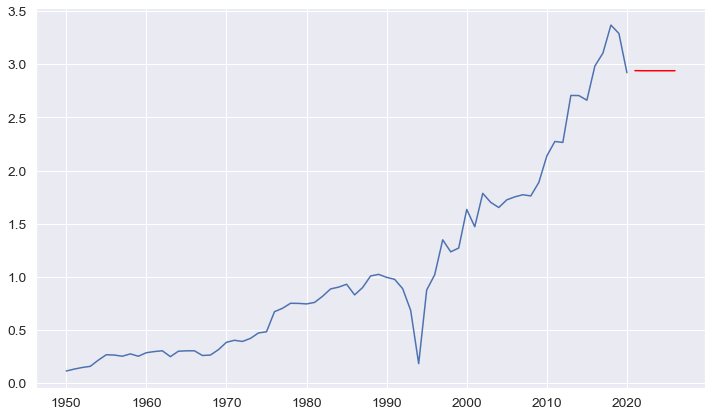

---------------------------------------------------------------------------------
High-income countries


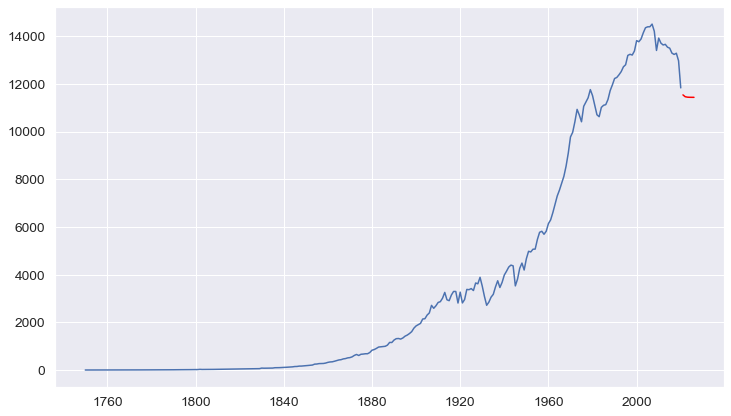

---------------------------------------------------------------------------------
Honduras


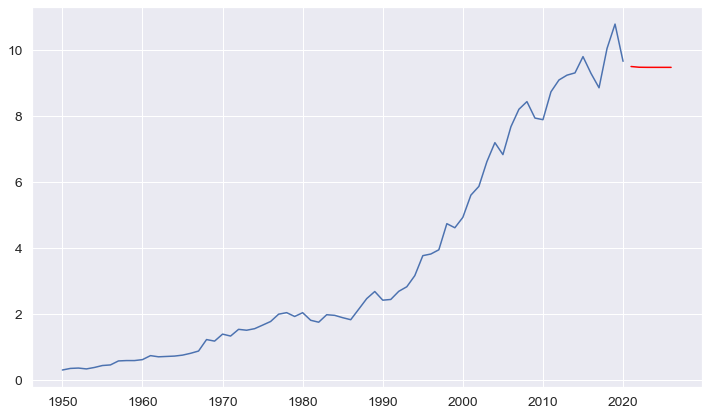

---------------------------------------------------------------------------------
Hong Kong


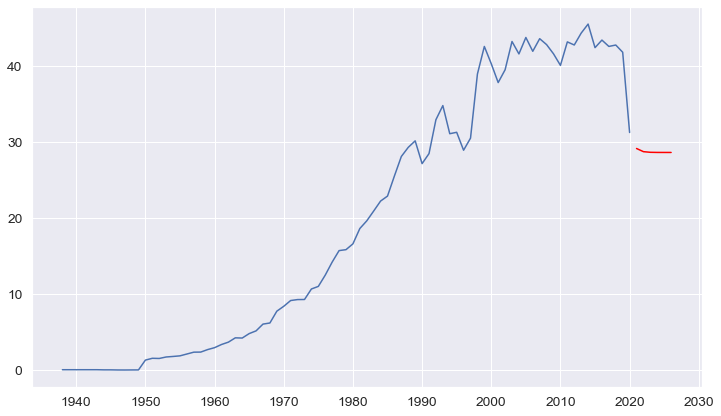

---------------------------------------------------------------------------------
Hungary


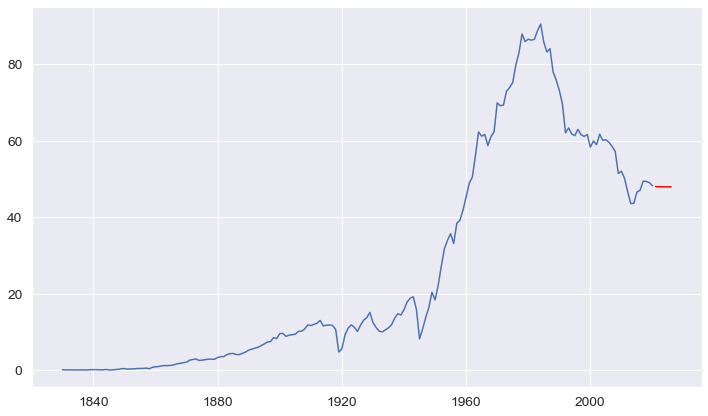

---------------------------------------------------------------------------------
Iceland


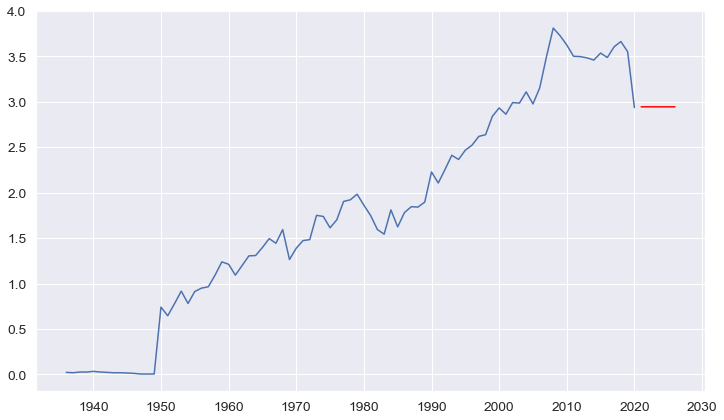

---------------------------------------------------------------------------------
India


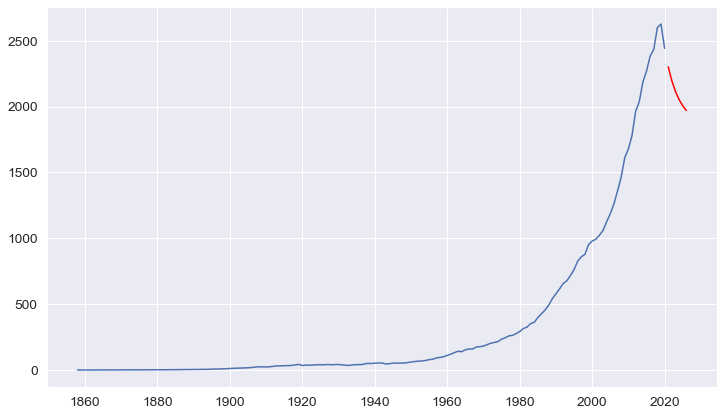

---------------------------------------------------------------------------------
Indonesia


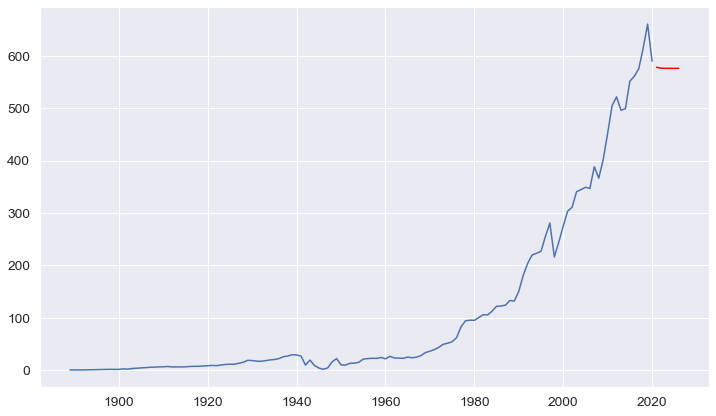

---------------------------------------------------------------------------------
International transport


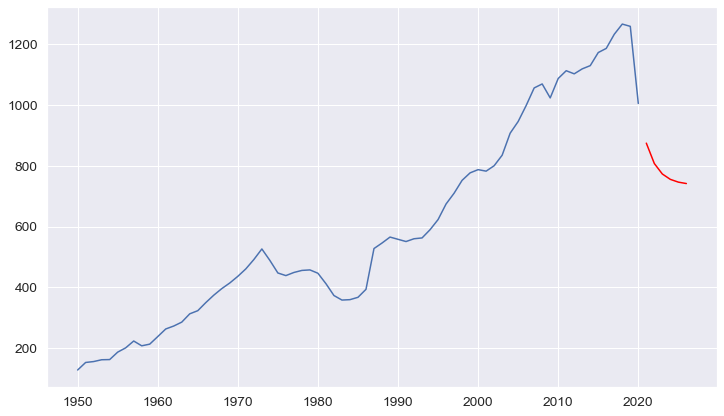

---------------------------------------------------------------------------------
Iran


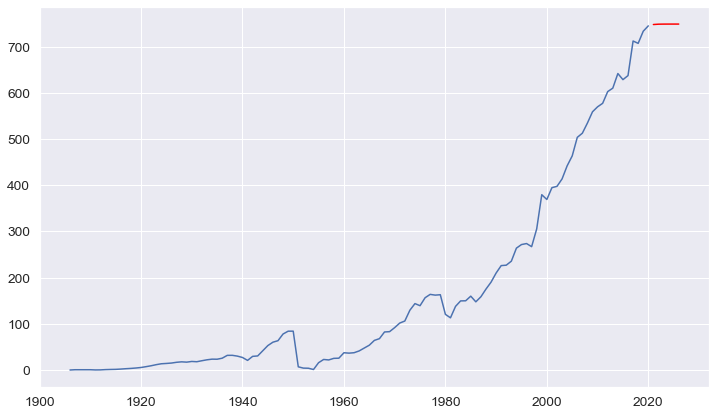

---------------------------------------------------------------------------------
Iraq


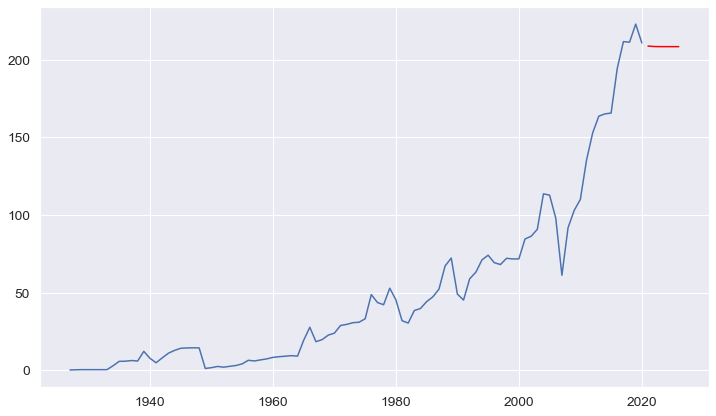

---------------------------------------------------------------------------------
Ireland


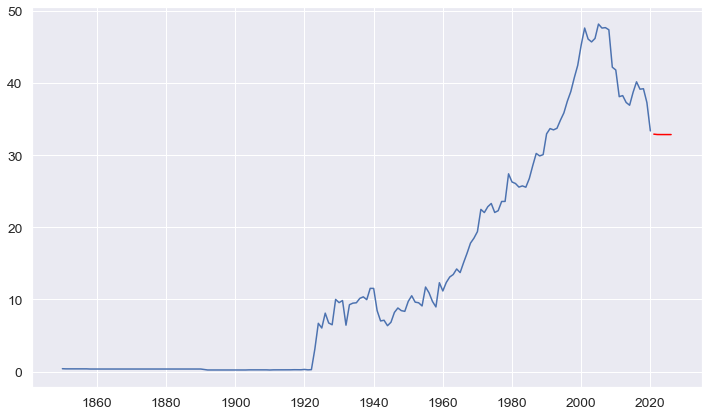

---------------------------------------------------------------------------------
Israel


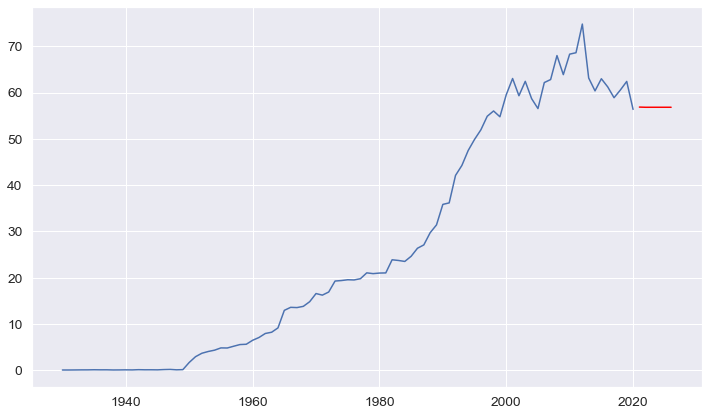

---------------------------------------------------------------------------------
Italy


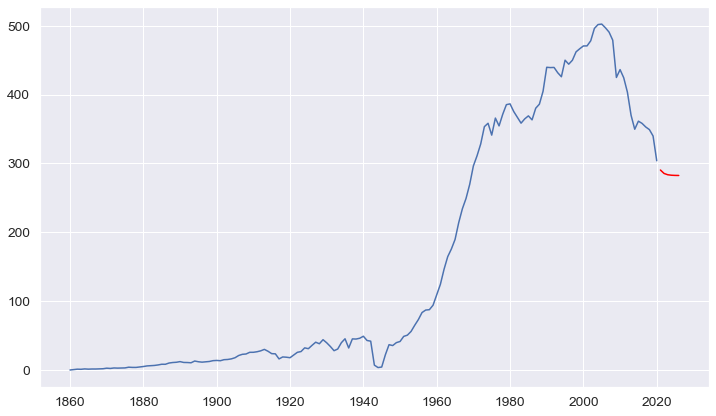

---------------------------------------------------------------------------------
Jamaica


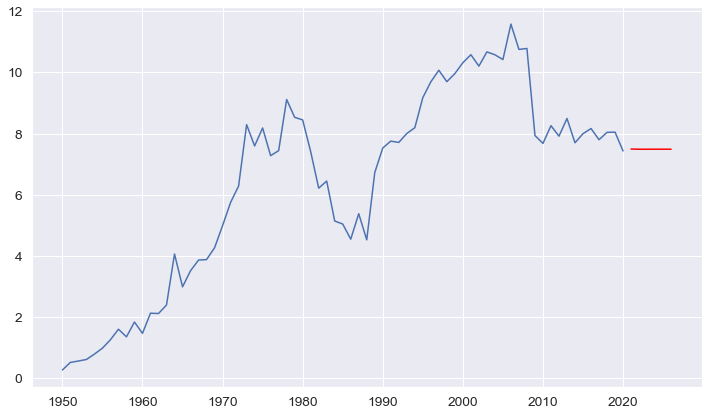

---------------------------------------------------------------------------------
Japan


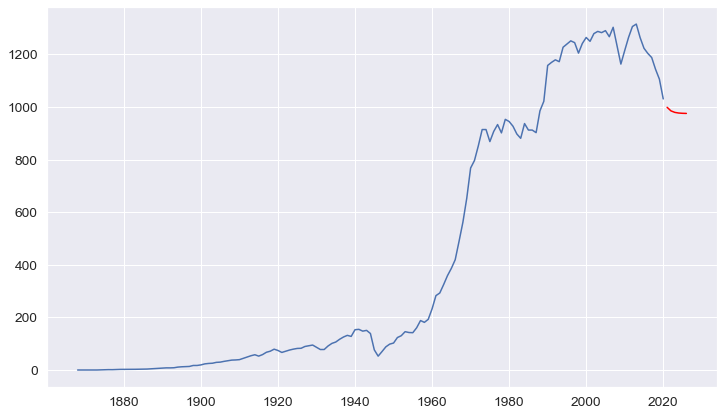

---------------------------------------------------------------------------------
Jordan


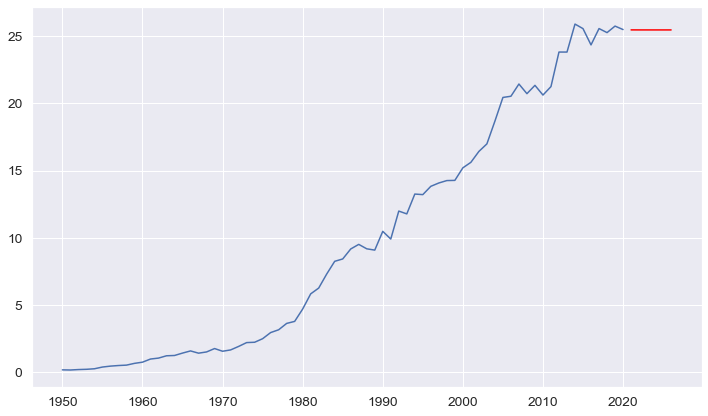

---------------------------------------------------------------------------------
Kazakhstan


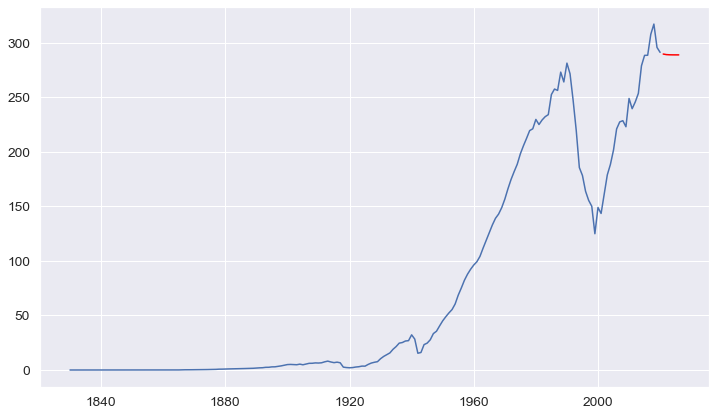

---------------------------------------------------------------------------------
Kenya


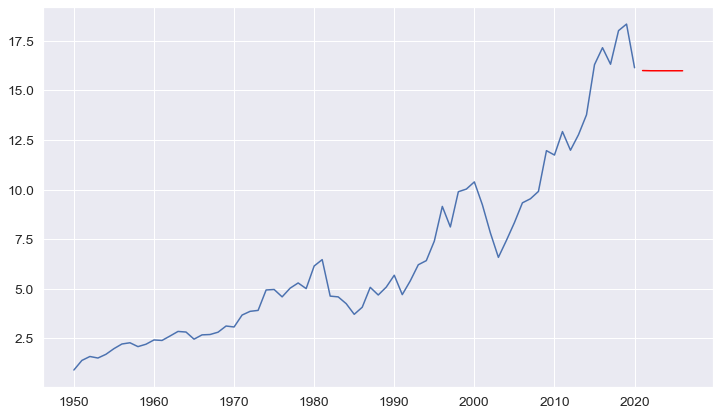

---------------------------------------------------------------------------------
Kiribati


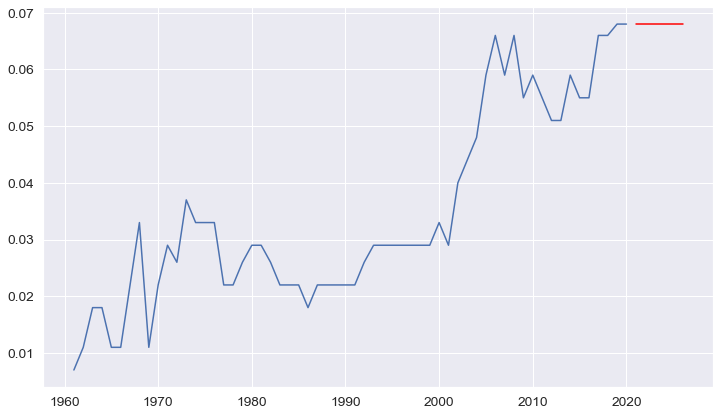

---------------------------------------------------------------------------------
Kosovo


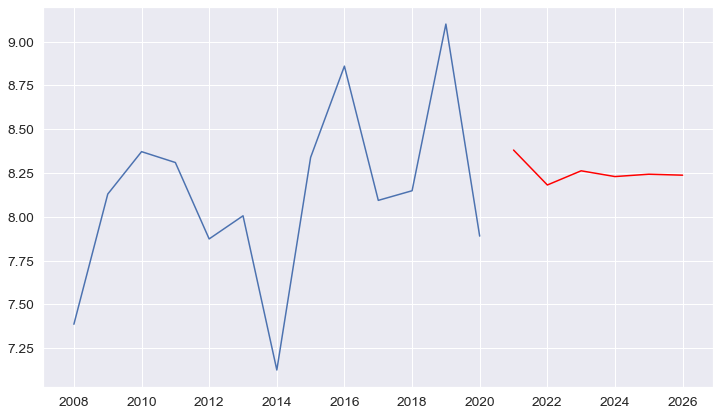

---------------------------------------------------------------------------------
Kuwait


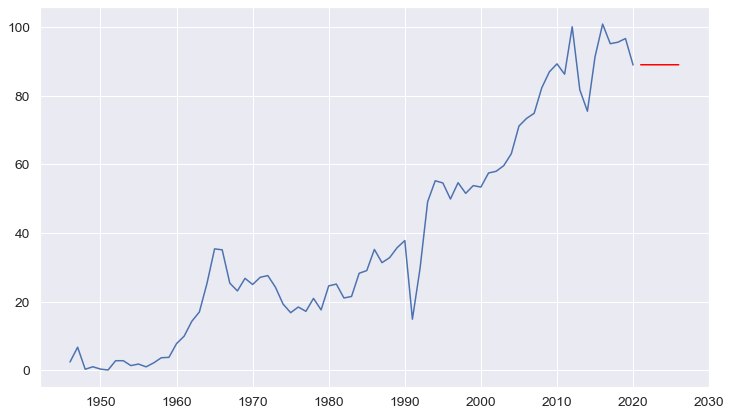

---------------------------------------------------------------------------------
Kuwaiti Oil Fires


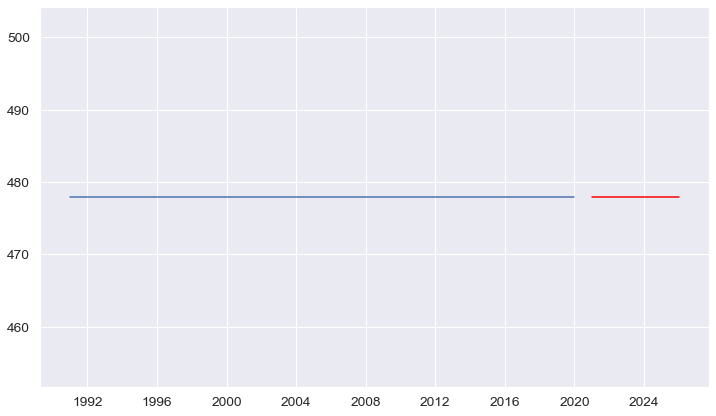

---------------------------------------------------------------------------------
Kyrgyzstan


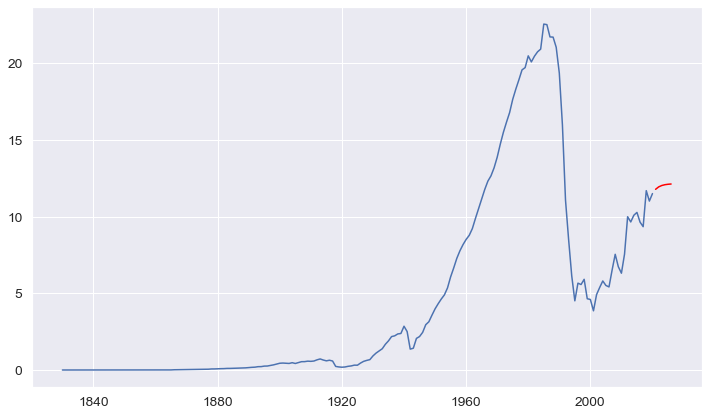

---------------------------------------------------------------------------------
Laos


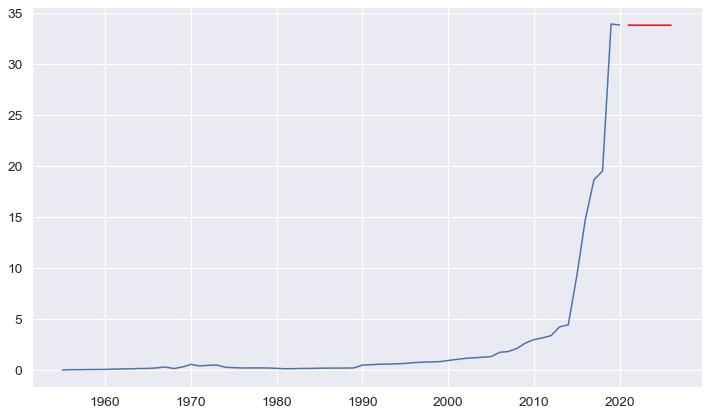

---------------------------------------------------------------------------------
Latvia


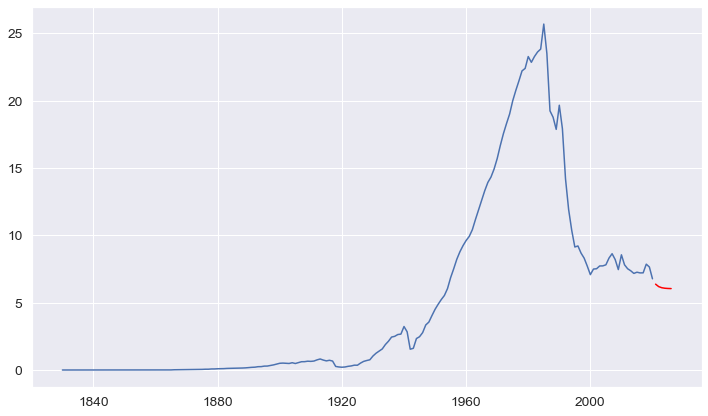

---------------------------------------------------------------------------------
Lebanon


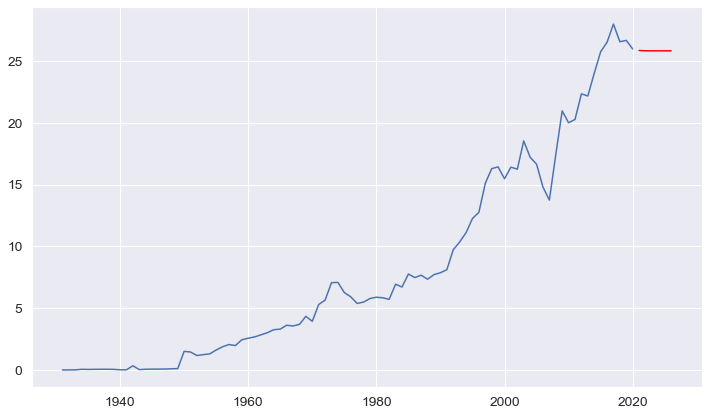

---------------------------------------------------------------------------------
Leeward Islands


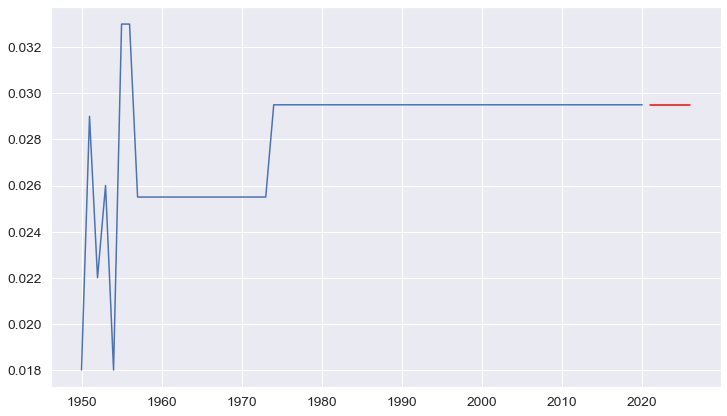

---------------------------------------------------------------------------------
Lesotho


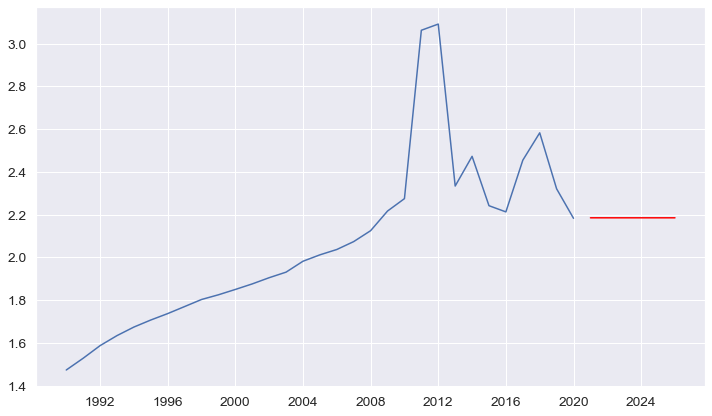

---------------------------------------------------------------------------------
Liberia


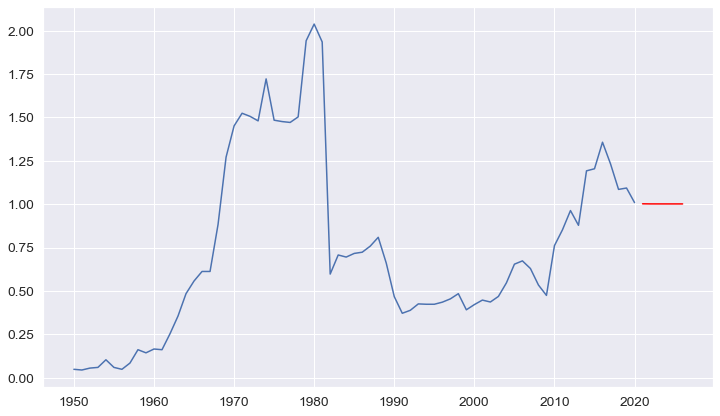

---------------------------------------------------------------------------------
Libya


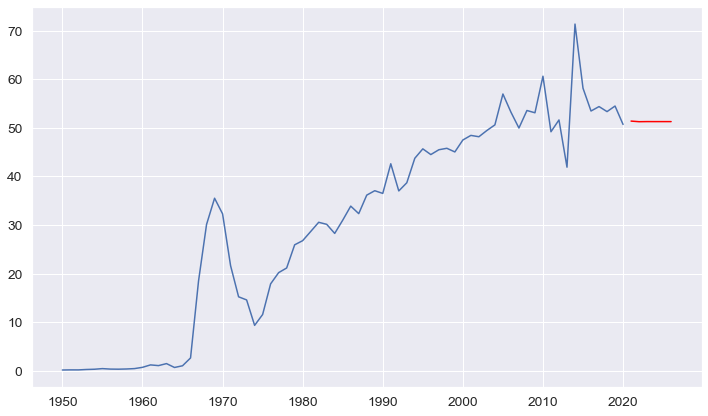

---------------------------------------------------------------------------------
Liechtenstein


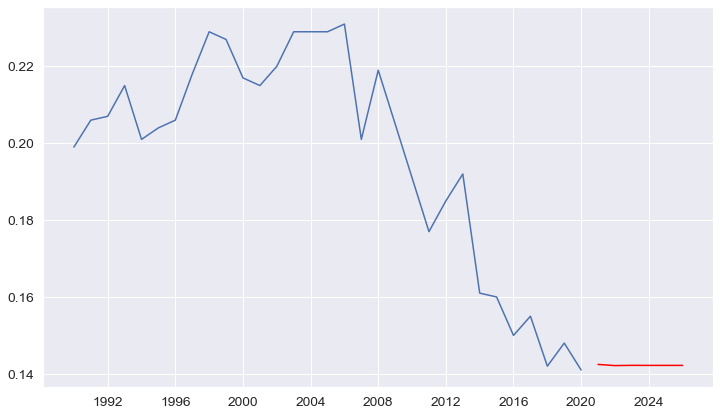

---------------------------------------------------------------------------------
Lithuania


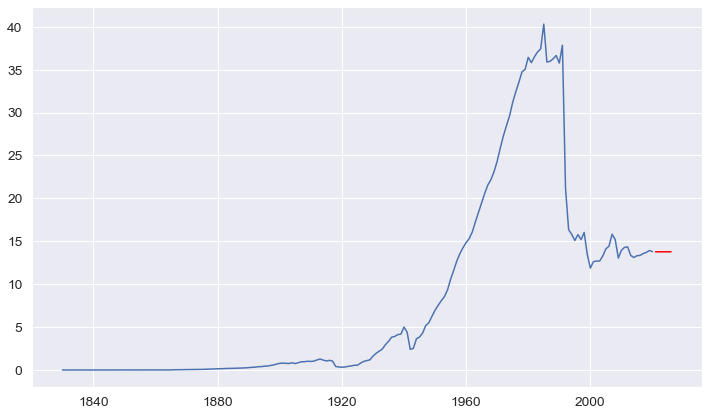

---------------------------------------------------------------------------------
Low-income countries


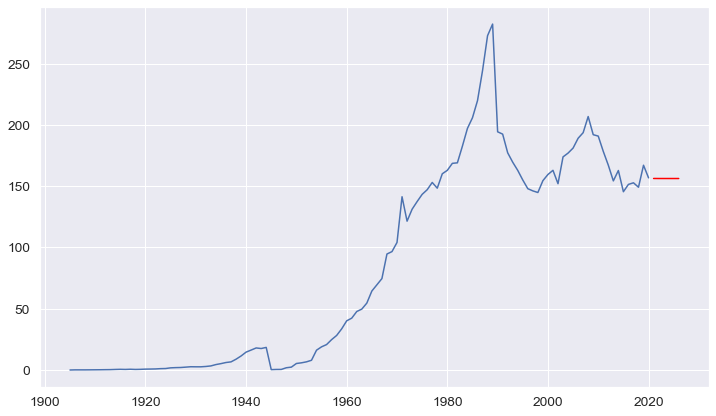

---------------------------------------------------------------------------------
Lower-middle-income countries


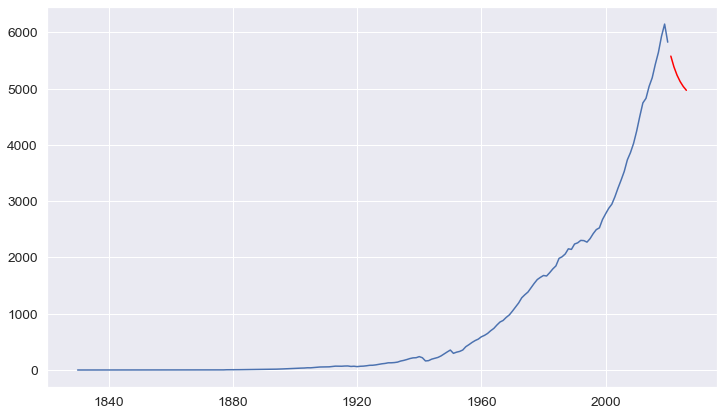

---------------------------------------------------------------------------------
Luxembourg


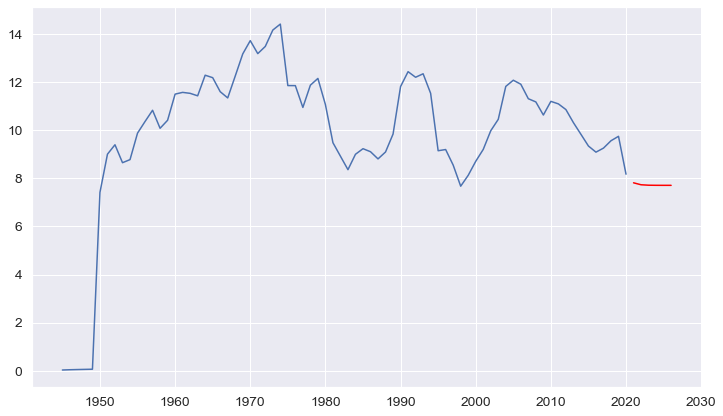

---------------------------------------------------------------------------------
Macao


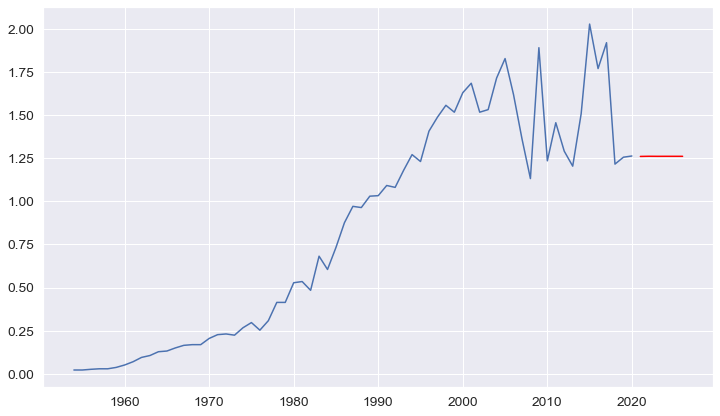

---------------------------------------------------------------------------------
Madagascar


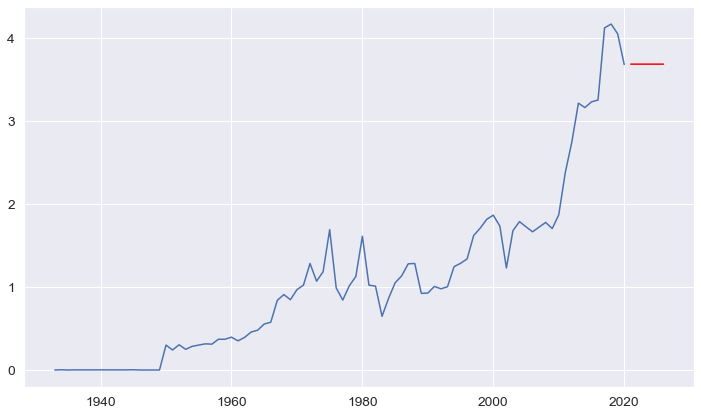

---------------------------------------------------------------------------------
Malawi


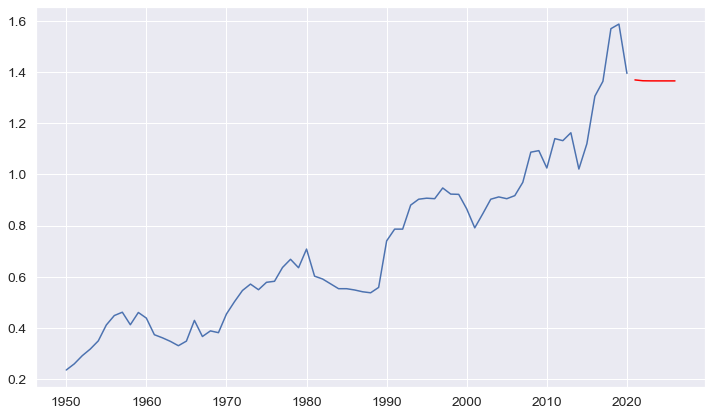

---------------------------------------------------------------------------------
Malaysia


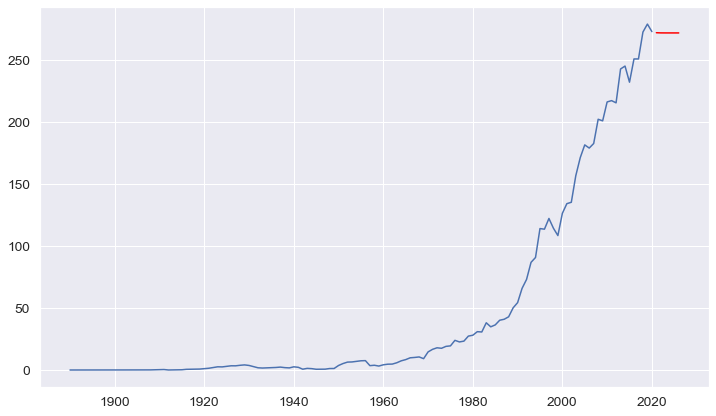

---------------------------------------------------------------------------------
Maldives


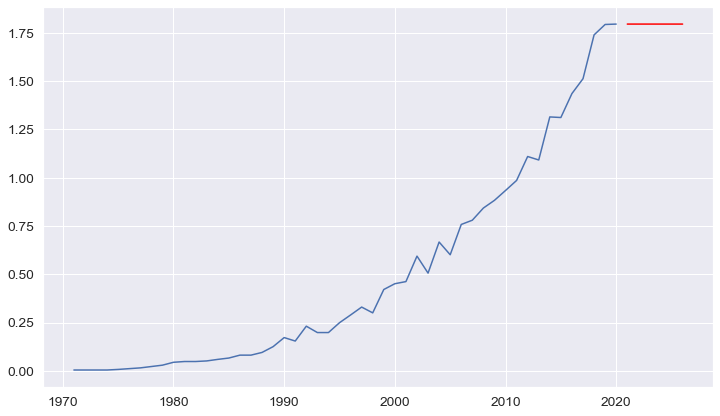

---------------------------------------------------------------------------------
Mali


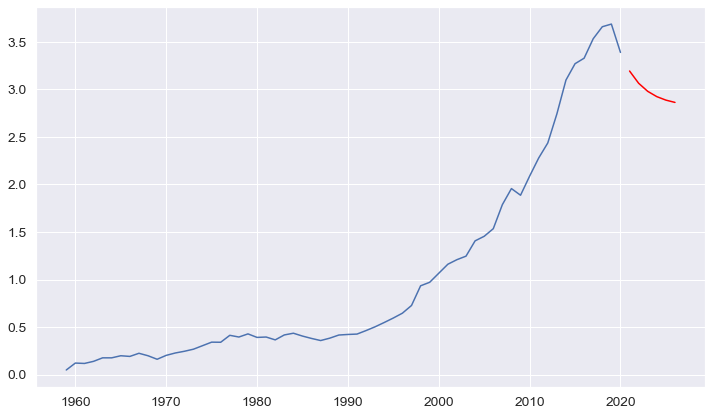

---------------------------------------------------------------------------------
Malta


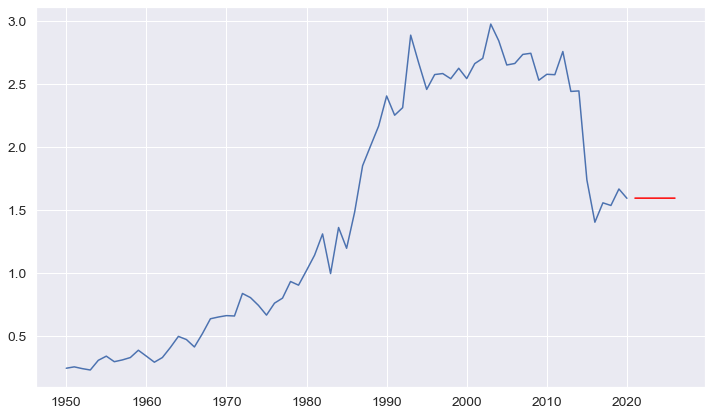

---------------------------------------------------------------------------------
Marshall Islands


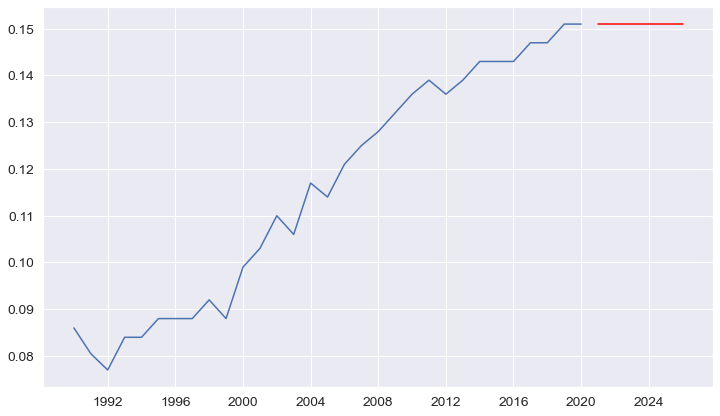

---------------------------------------------------------------------------------
Martinique


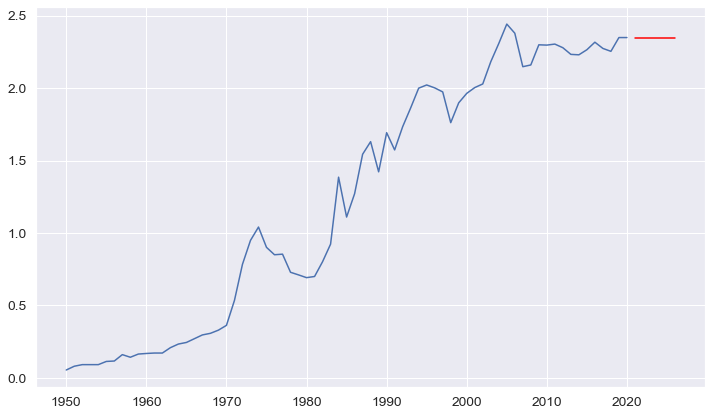

---------------------------------------------------------------------------------
Mauritania


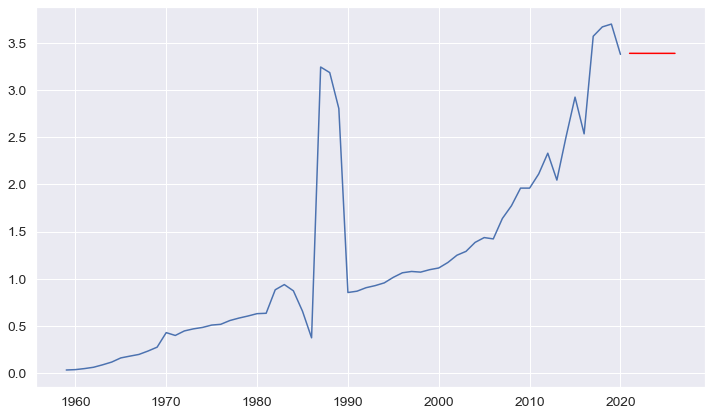

---------------------------------------------------------------------------------
Mauritius


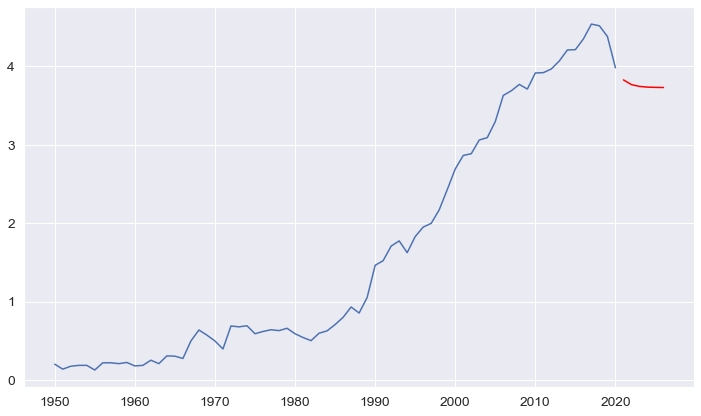

---------------------------------------------------------------------------------
Mayotte


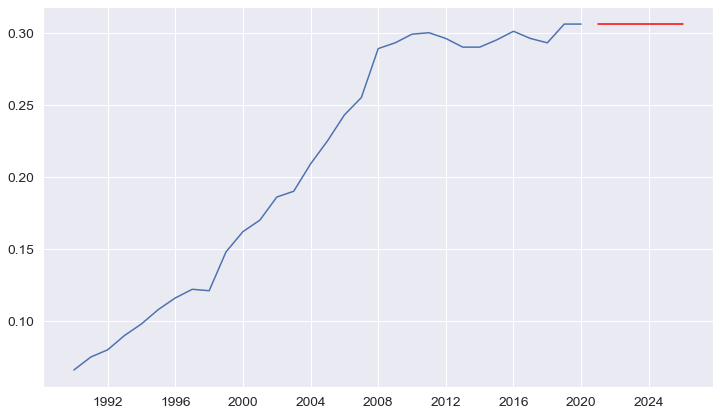

---------------------------------------------------------------------------------
Mexico


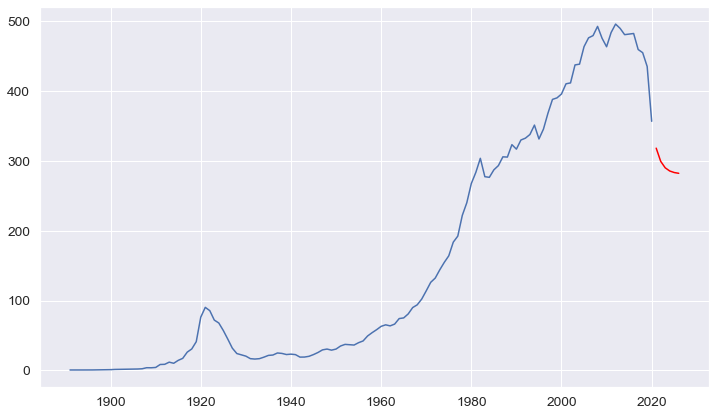

---------------------------------------------------------------------------------
Micronesia (country)


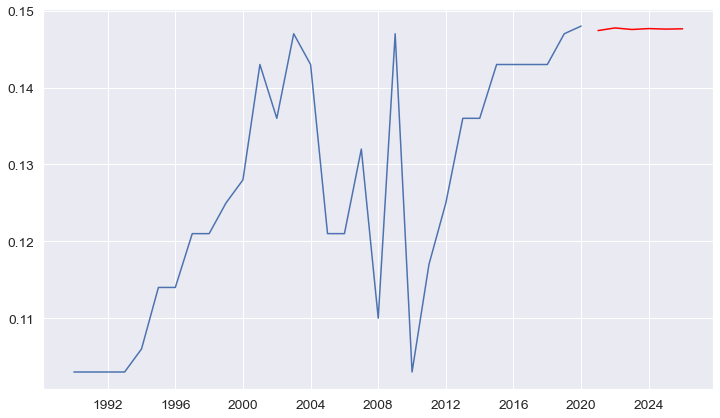

---------------------------------------------------------------------------------
Moldova


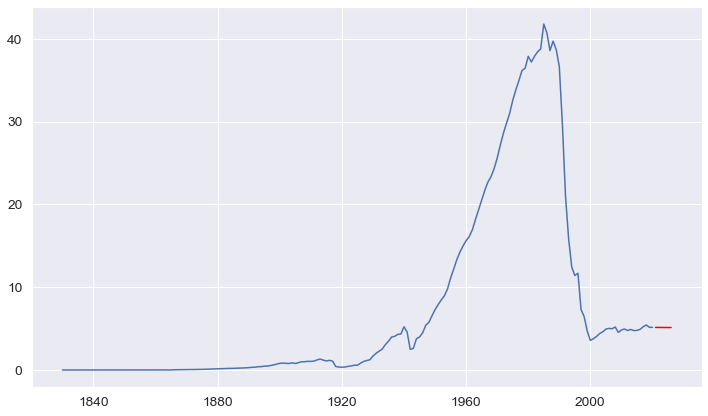

---------------------------------------------------------------------------------
Mongolia


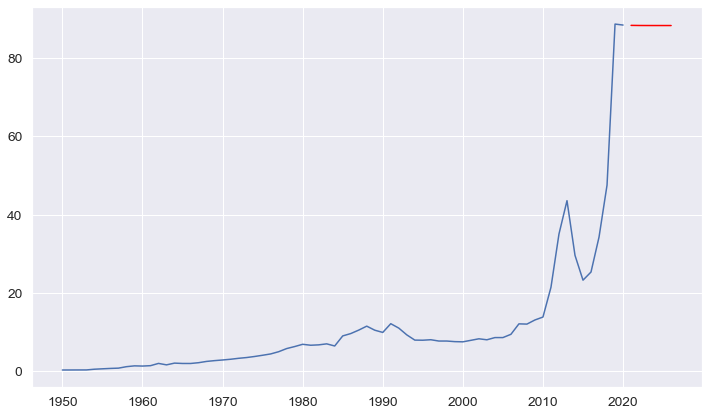

---------------------------------------------------------------------------------
Montenegro


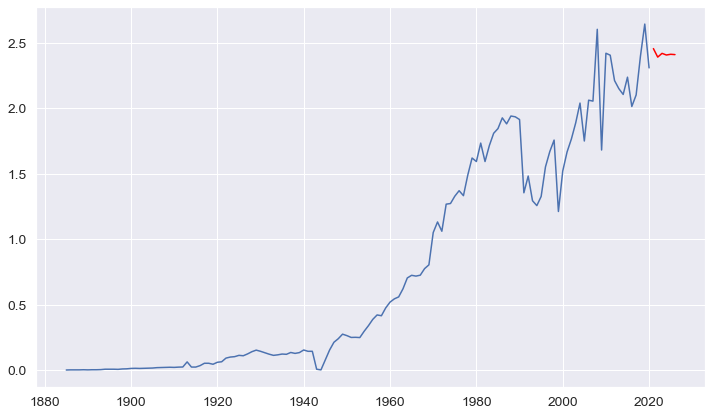

---------------------------------------------------------------------------------
Montserrat


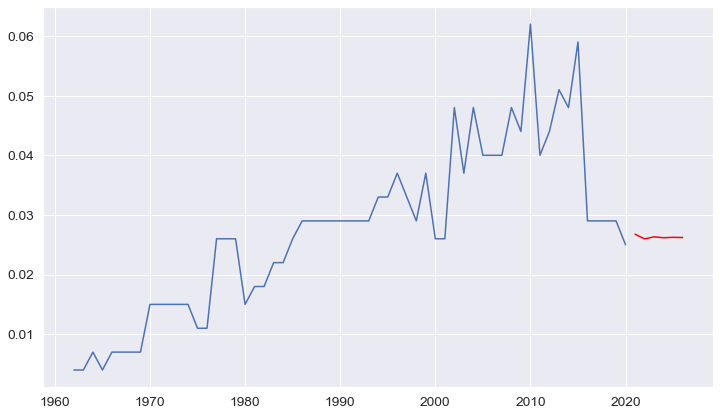

---------------------------------------------------------------------------------
Morocco


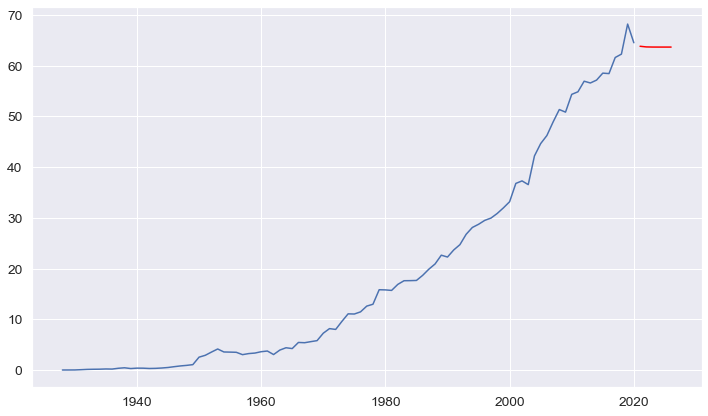

---------------------------------------------------------------------------------
Mozambique


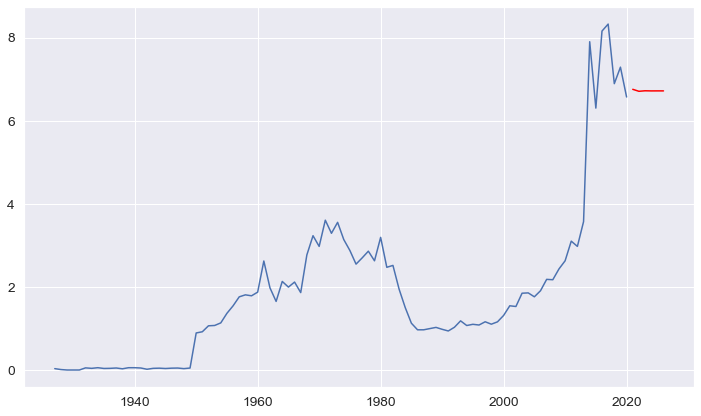

---------------------------------------------------------------------------------
Myanmar


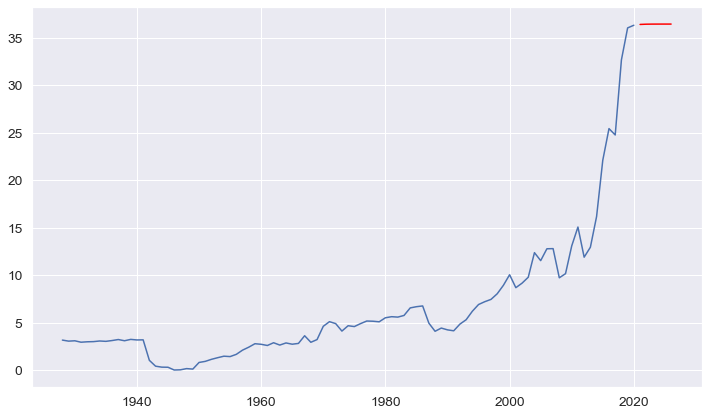

---------------------------------------------------------------------------------
Namibia


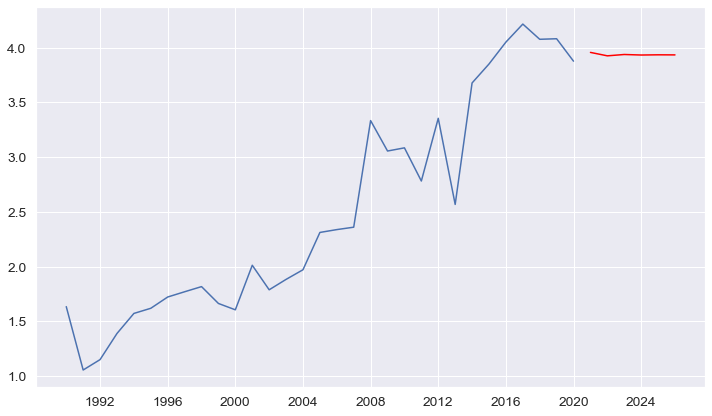

---------------------------------------------------------------------------------
Nauru


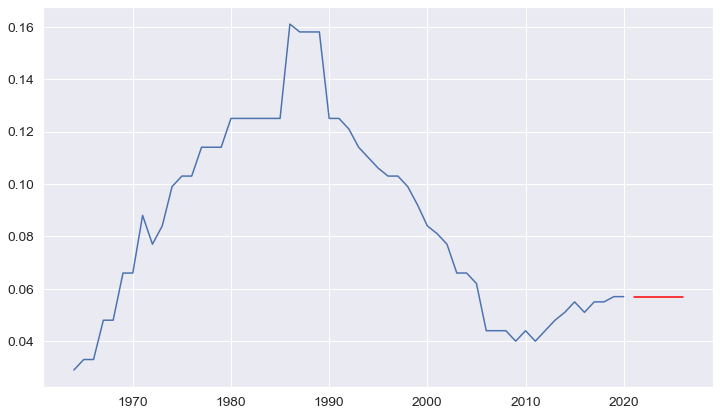

---------------------------------------------------------------------------------
Nepal


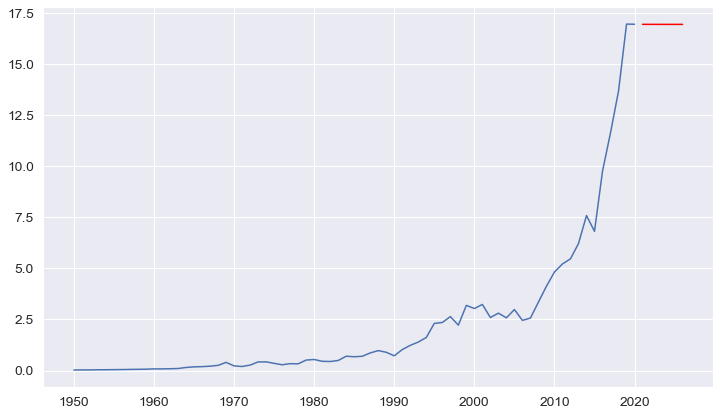

---------------------------------------------------------------------------------
Netherlands


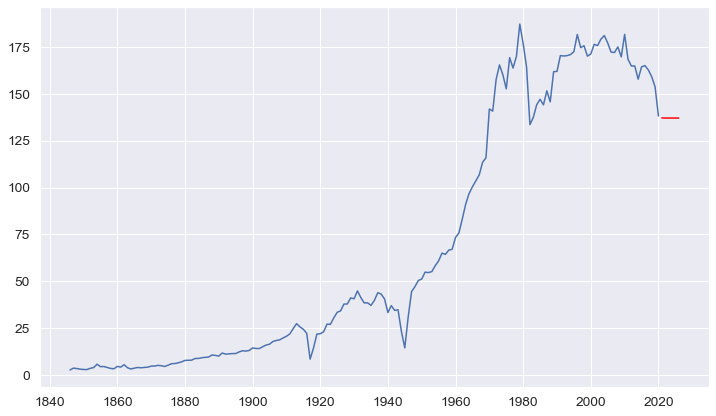

---------------------------------------------------------------------------------
New Caledonia


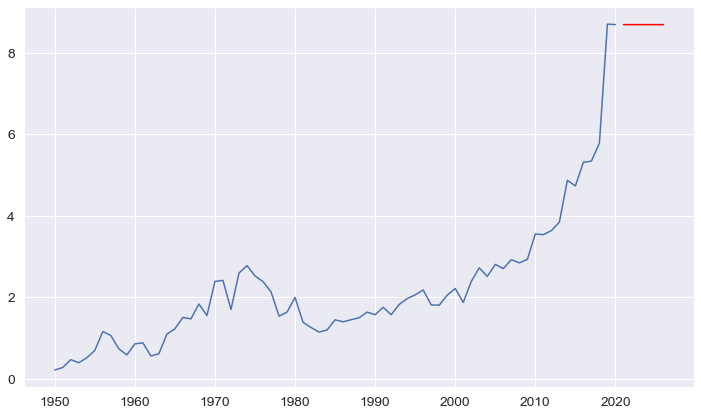

---------------------------------------------------------------------------------
New Zealand


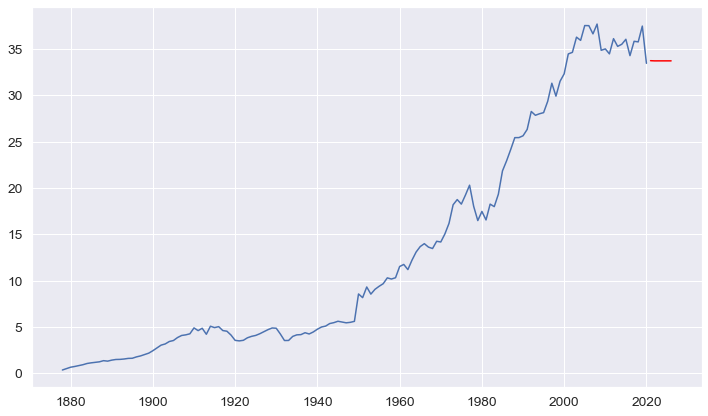

---------------------------------------------------------------------------------
Nicaragua


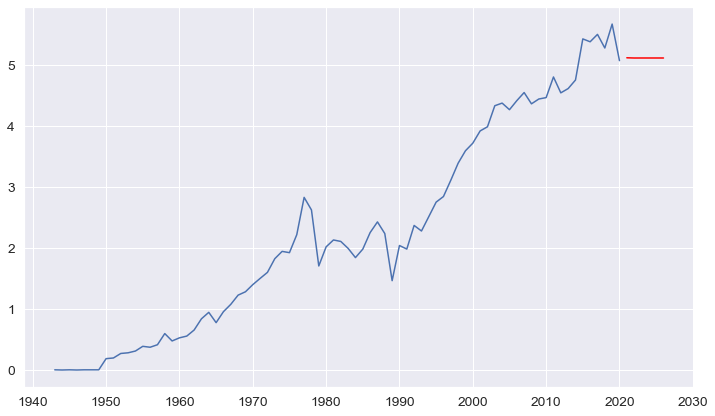

---------------------------------------------------------------------------------
Niger


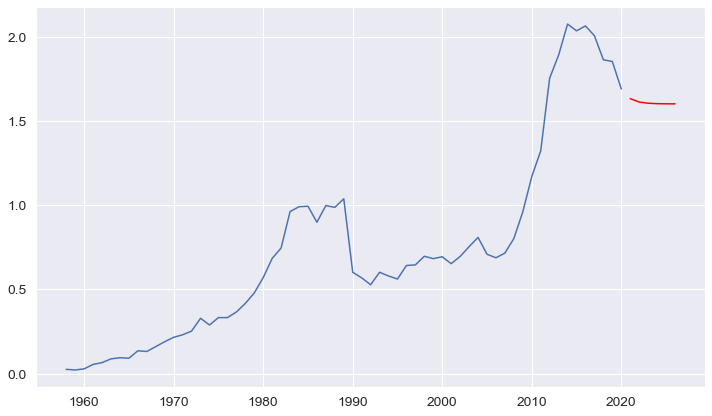

---------------------------------------------------------------------------------
Nigeria


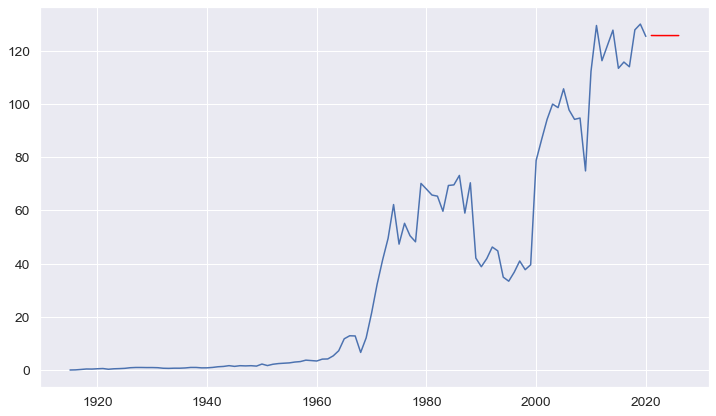

---------------------------------------------------------------------------------
Niue


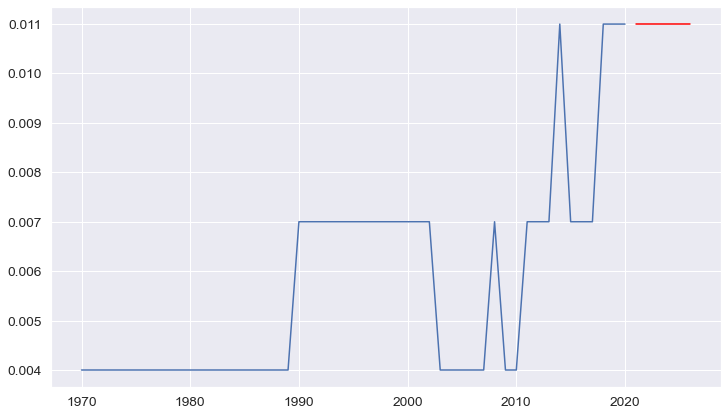

---------------------------------------------------------------------------------
North America


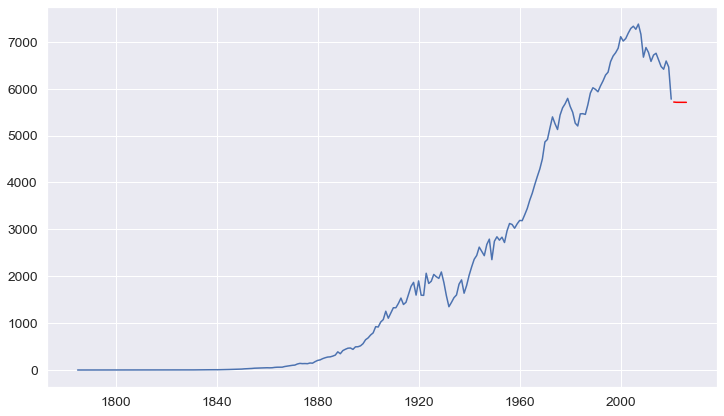

---------------------------------------------------------------------------------
North America (excl. USA)


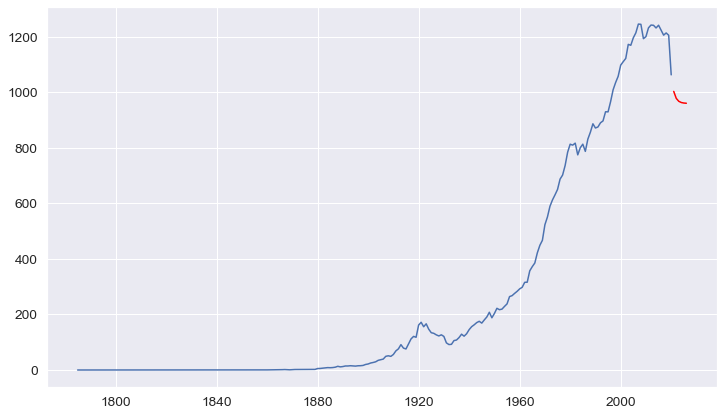

---------------------------------------------------------------------------------
North Korea


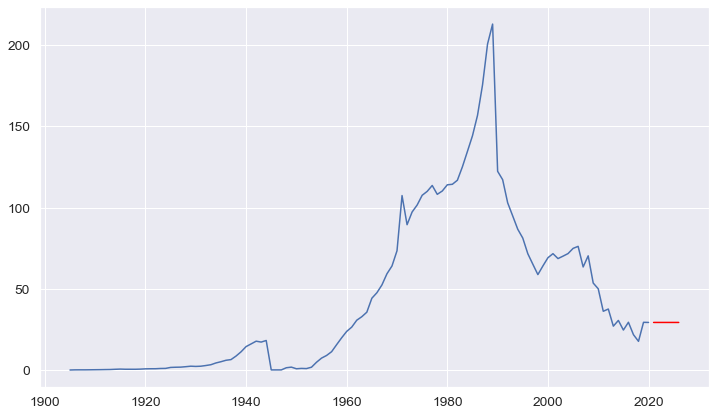

---------------------------------------------------------------------------------
North Macedonia


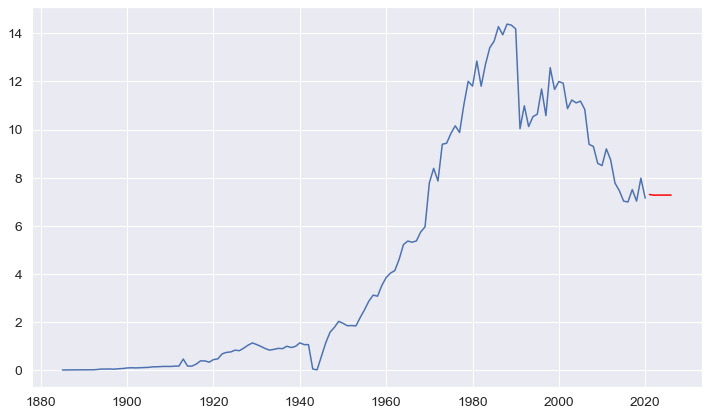

---------------------------------------------------------------------------------
Norway


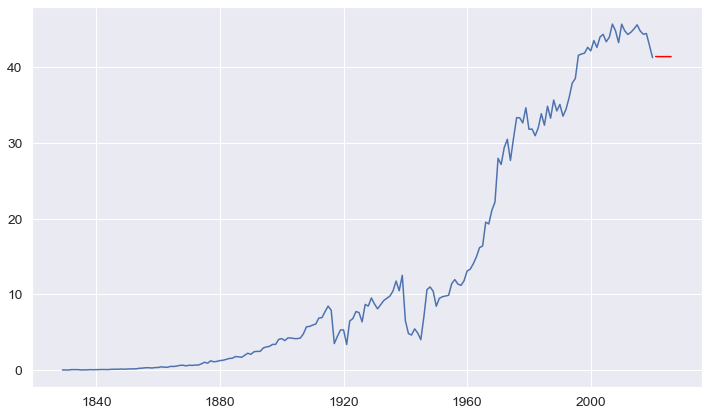

---------------------------------------------------------------------------------
Oceania


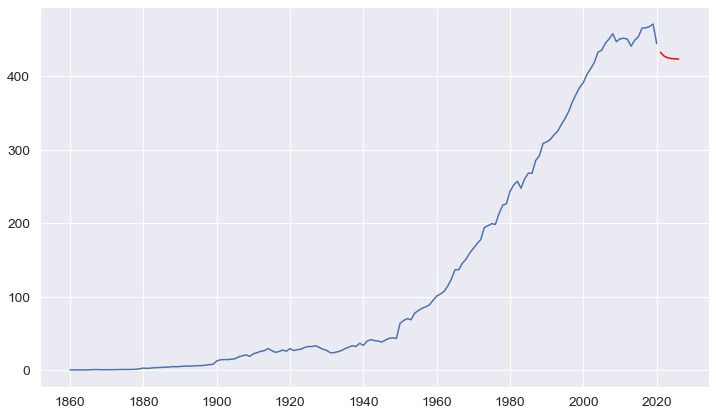

---------------------------------------------------------------------------------
Oman


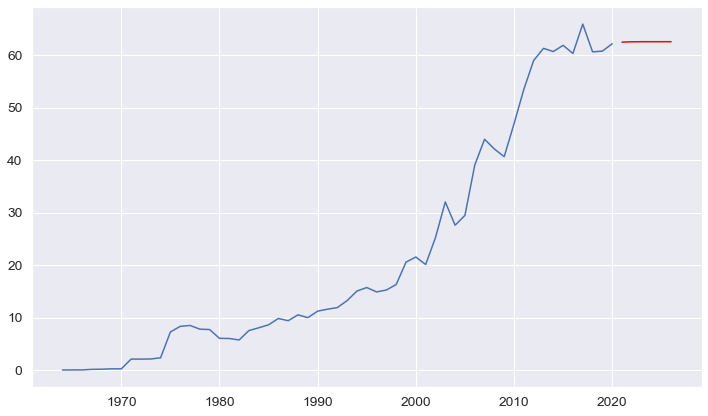

---------------------------------------------------------------------------------
Pakistan


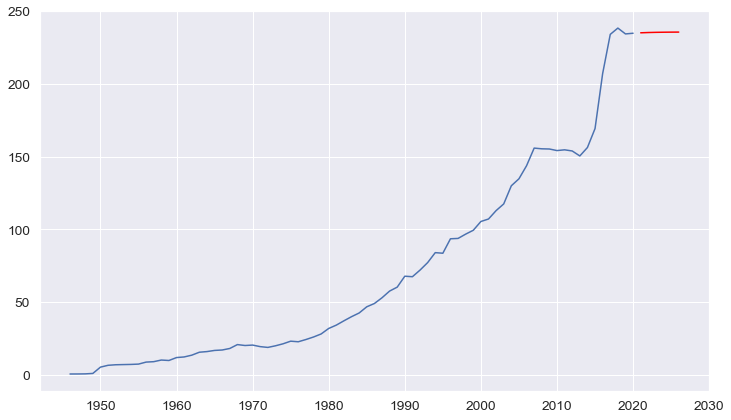

---------------------------------------------------------------------------------
Palau


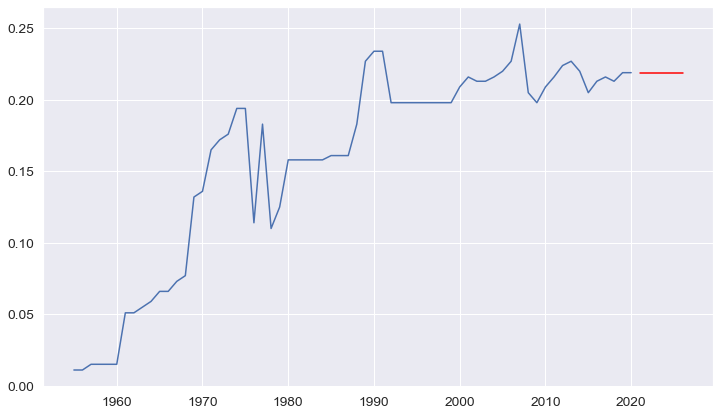

---------------------------------------------------------------------------------
Palestine


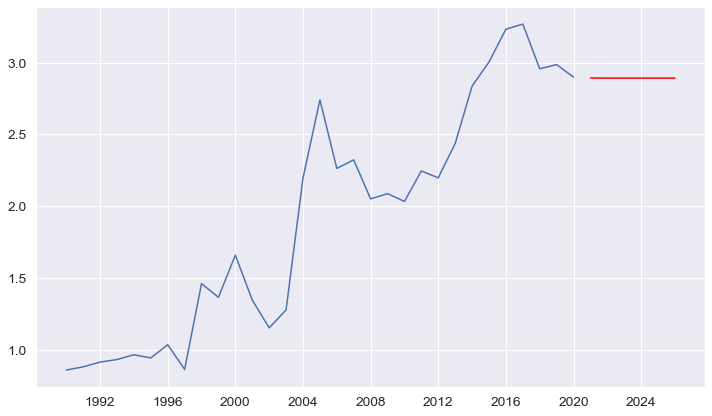

---------------------------------------------------------------------------------
Panama


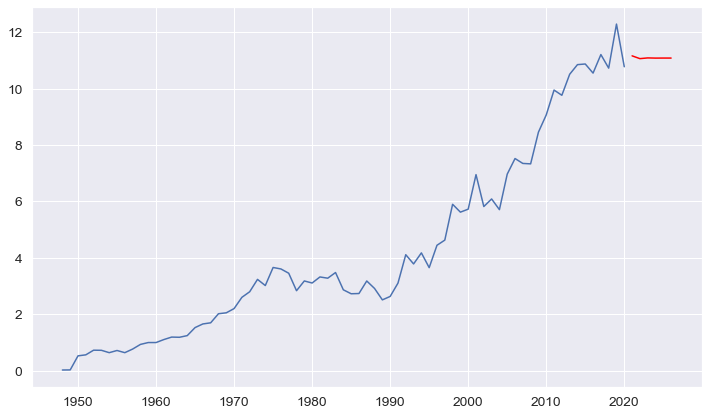

---------------------------------------------------------------------------------
Panama Canal Zone


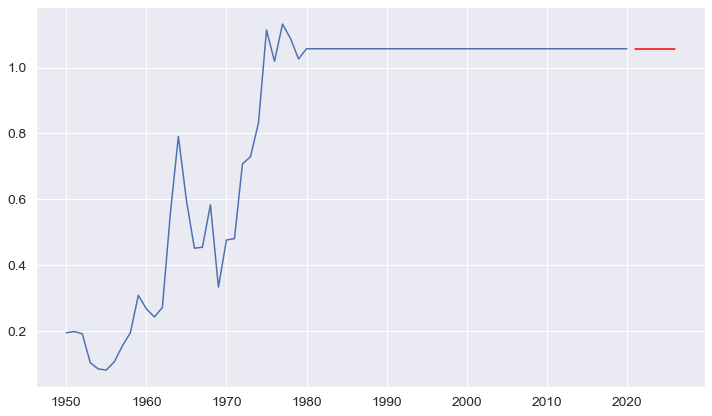

---------------------------------------------------------------------------------
Papua New Guinea


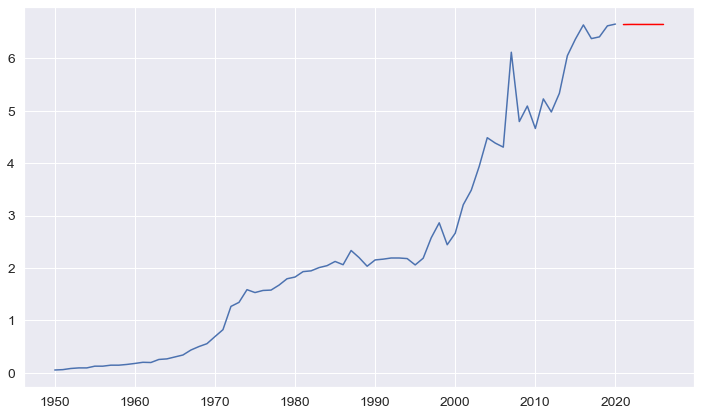

---------------------------------------------------------------------------------
Paraguay


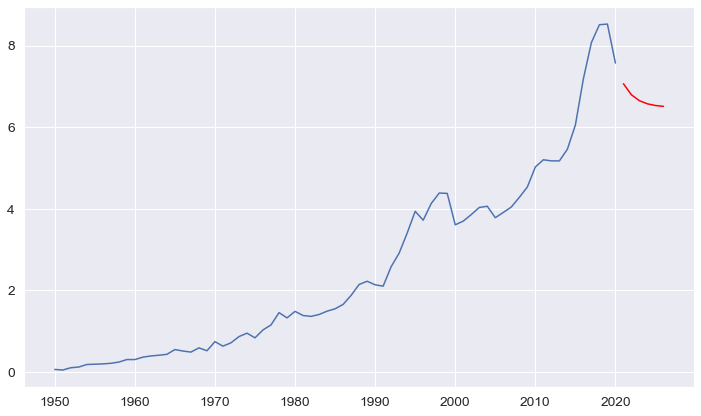

---------------------------------------------------------------------------------
Peru


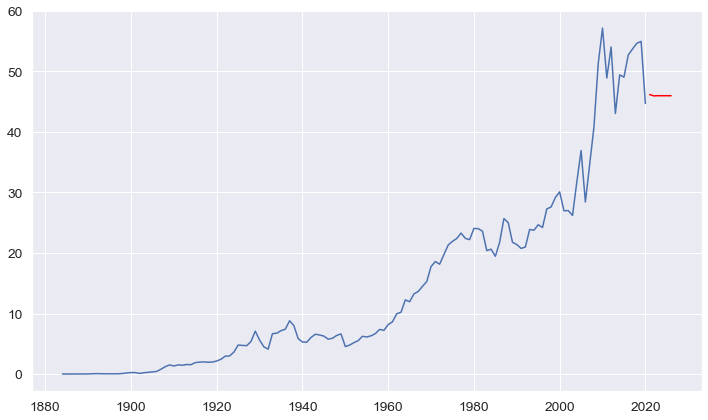

---------------------------------------------------------------------------------
Philippines


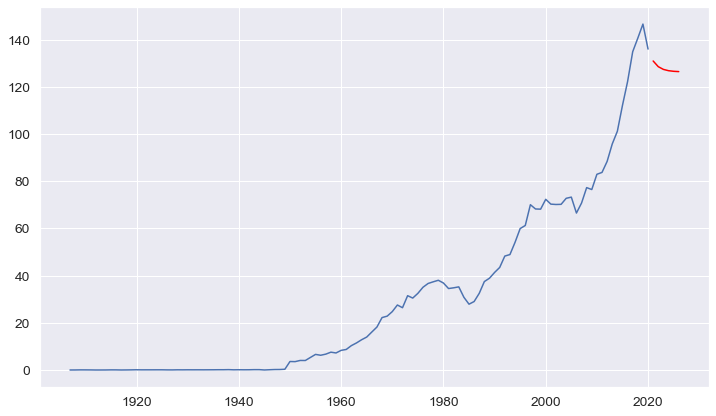

---------------------------------------------------------------------------------
Poland


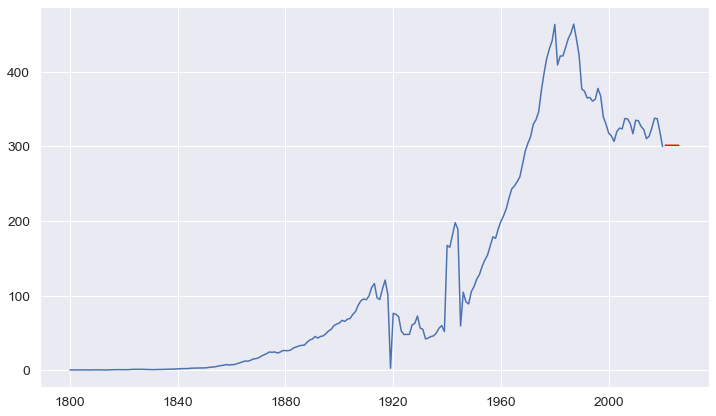

---------------------------------------------------------------------------------
Portugal


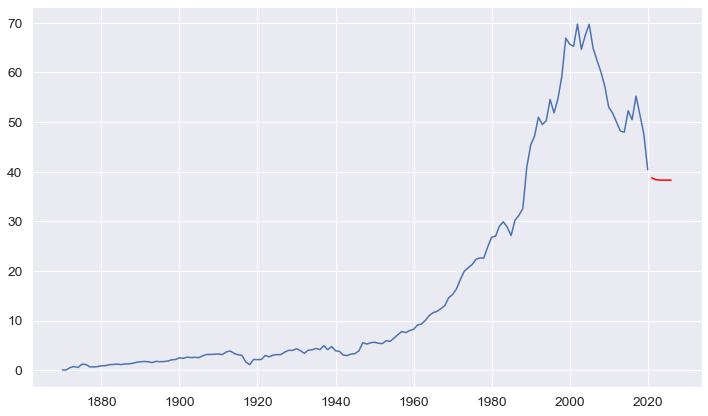

---------------------------------------------------------------------------------
Puerto Rico


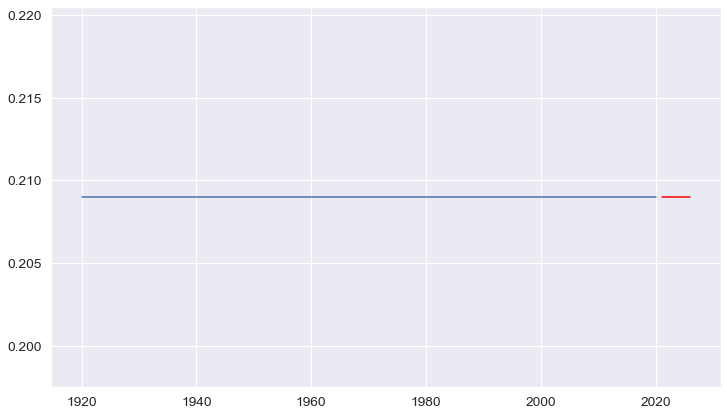

---------------------------------------------------------------------------------
Qatar


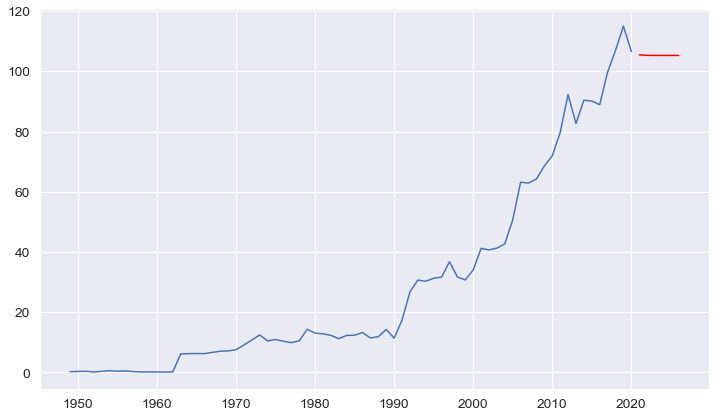

---------------------------------------------------------------------------------
Reunion


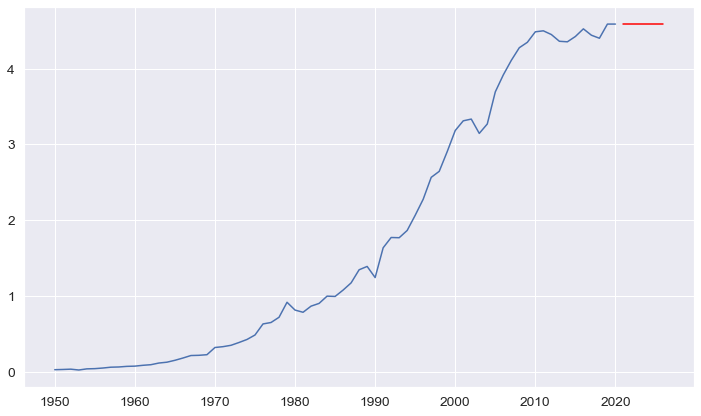

---------------------------------------------------------------------------------
Romania


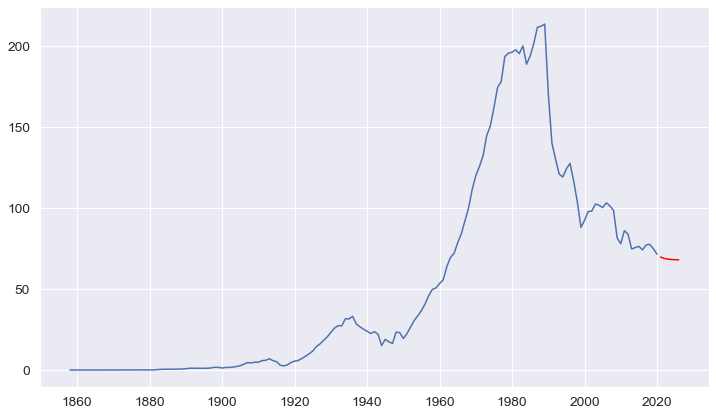

---------------------------------------------------------------------------------
Russia


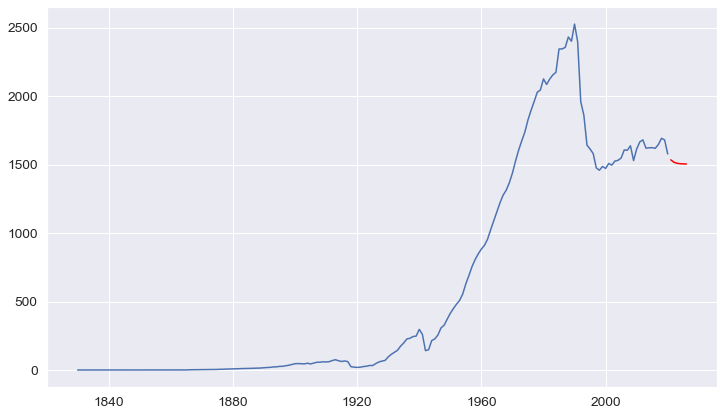

---------------------------------------------------------------------------------
Rwanda


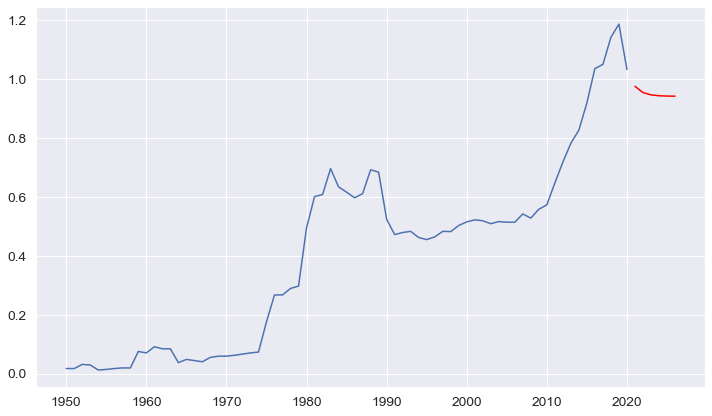

---------------------------------------------------------------------------------
Ryukyu Islands


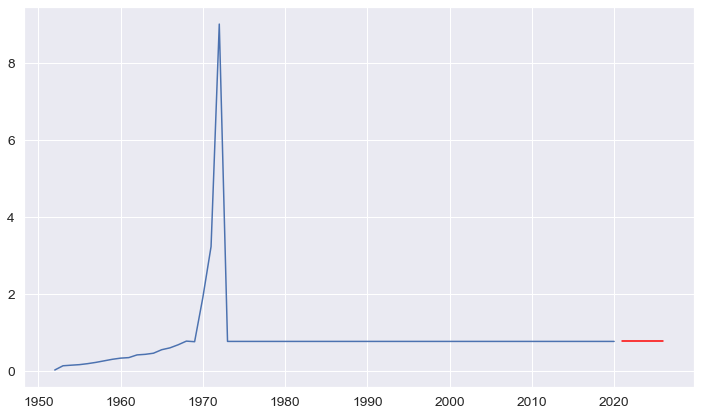

---------------------------------------------------------------------------------
Saint Helena


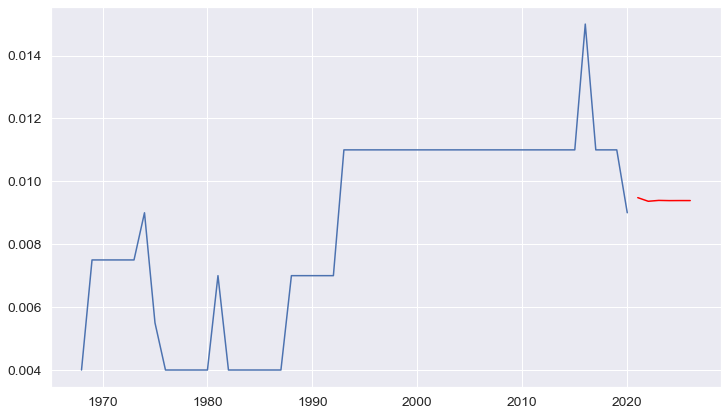

---------------------------------------------------------------------------------
Saint Kitts and Nevis


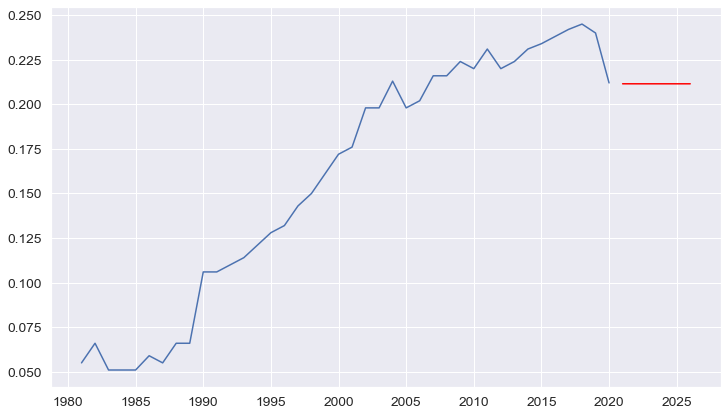

---------------------------------------------------------------------------------
Saint Lucia


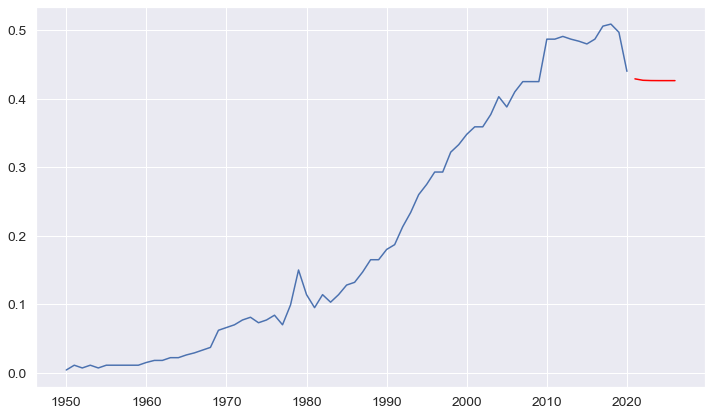

---------------------------------------------------------------------------------
Saint Pierre and Miquelon


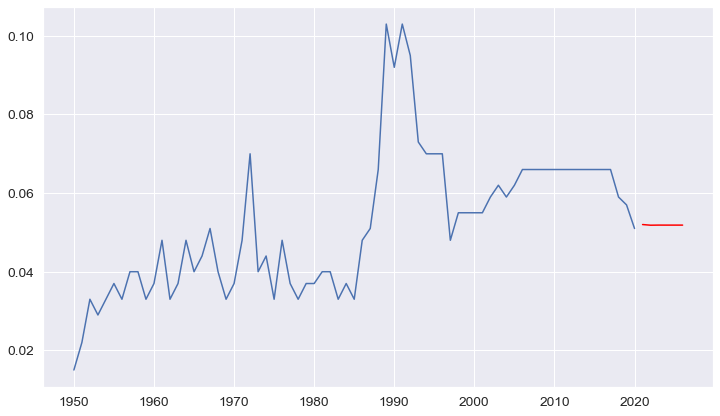

---------------------------------------------------------------------------------
Saint Vincent and the Grenadines


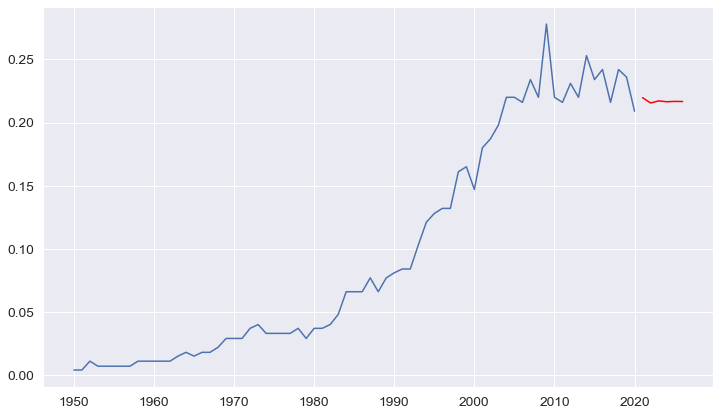

---------------------------------------------------------------------------------
Samoa


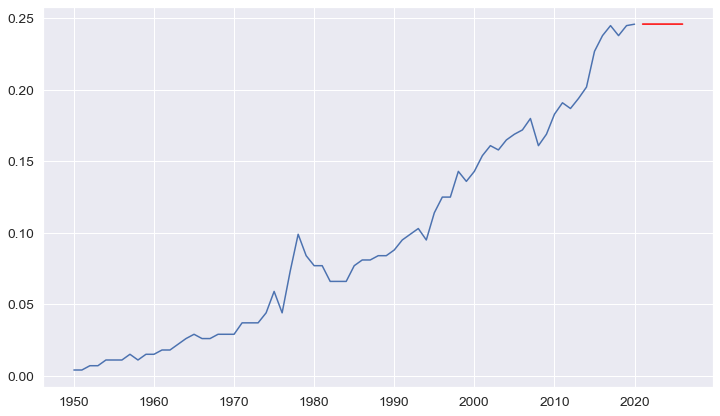

---------------------------------------------------------------------------------
Sao Tome and Principe


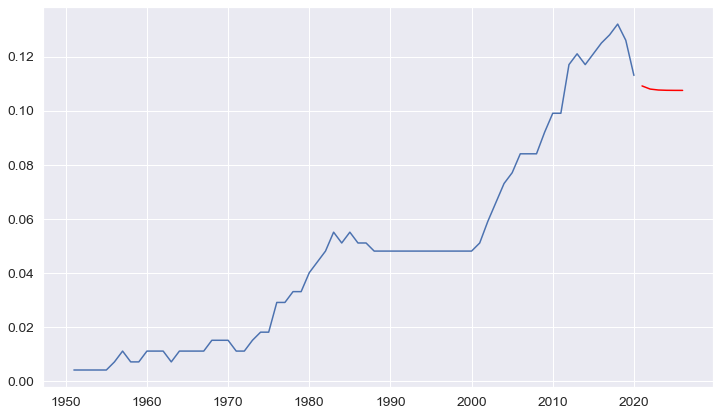

---------------------------------------------------------------------------------
Saudi Arabia


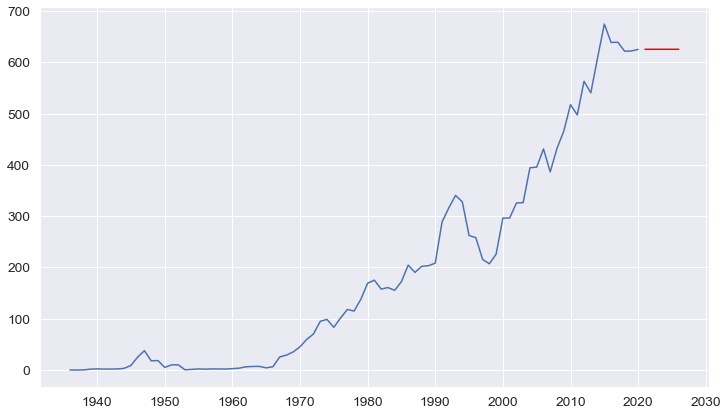

---------------------------------------------------------------------------------
Senegal


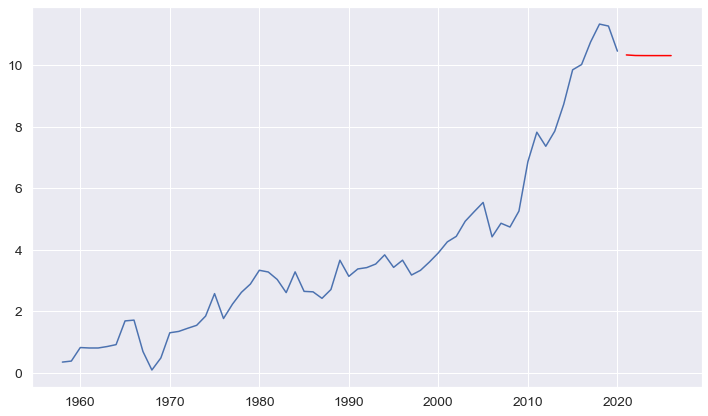

---------------------------------------------------------------------------------
Serbia


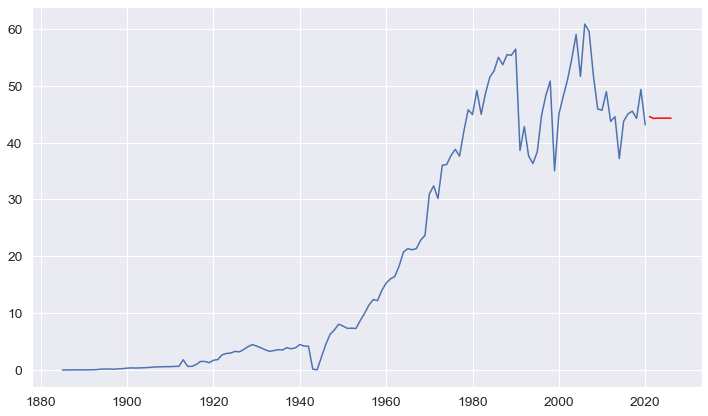

---------------------------------------------------------------------------------
Seychelles


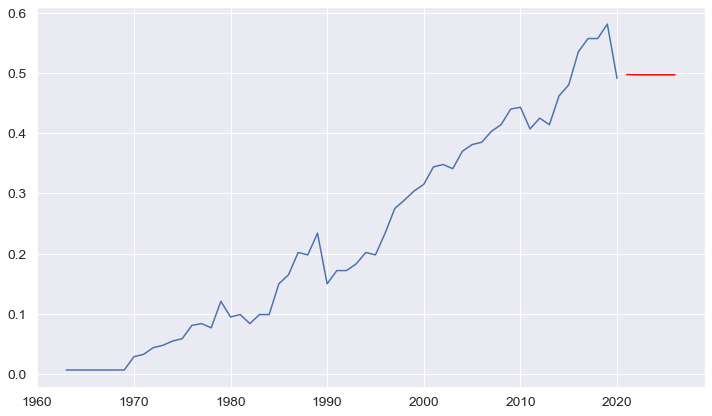

---------------------------------------------------------------------------------
Sierra Leone


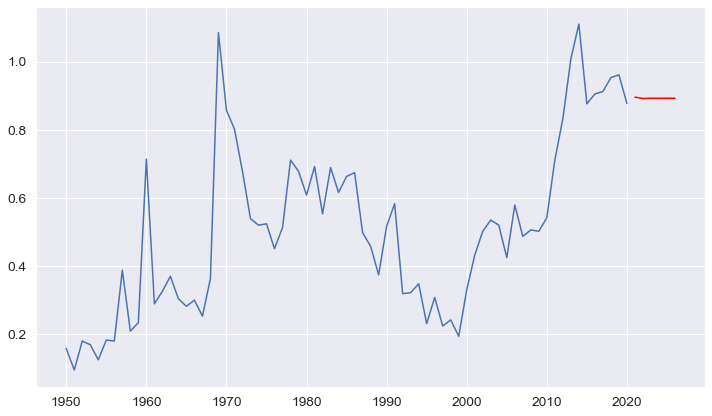

---------------------------------------------------------------------------------
Singapore


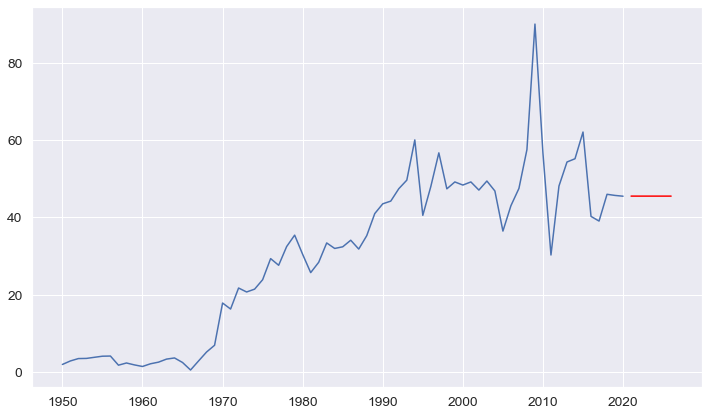

---------------------------------------------------------------------------------
Sint Maarten (Dutch part)


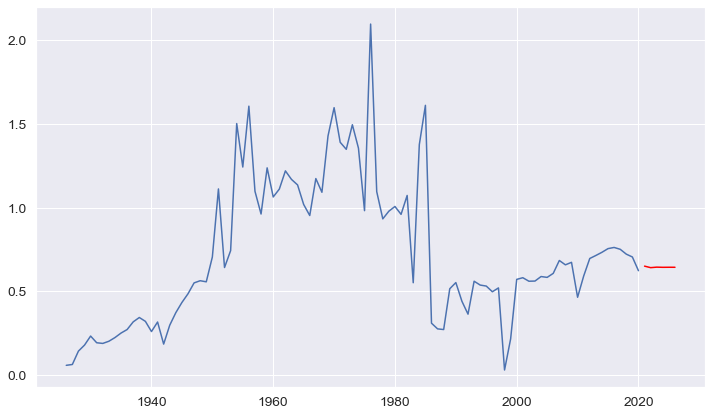

---------------------------------------------------------------------------------
Slovakia


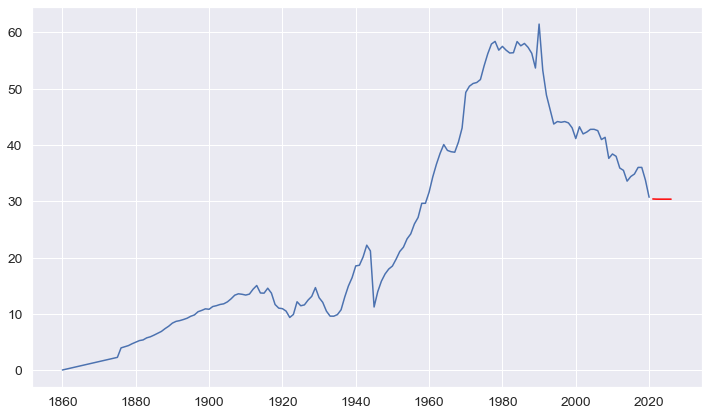

---------------------------------------------------------------------------------
Slovenia


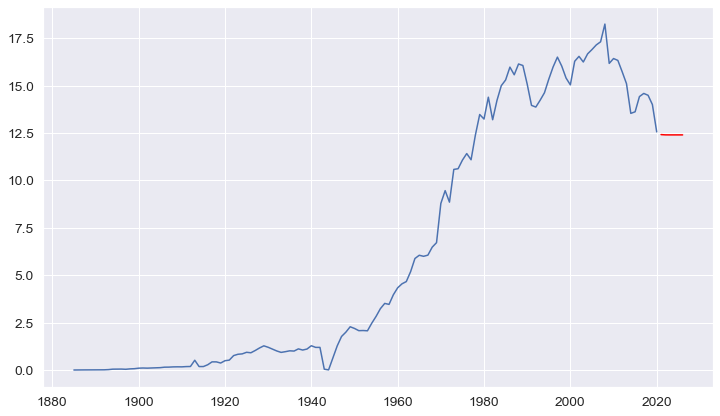

---------------------------------------------------------------------------------
Solomon Islands


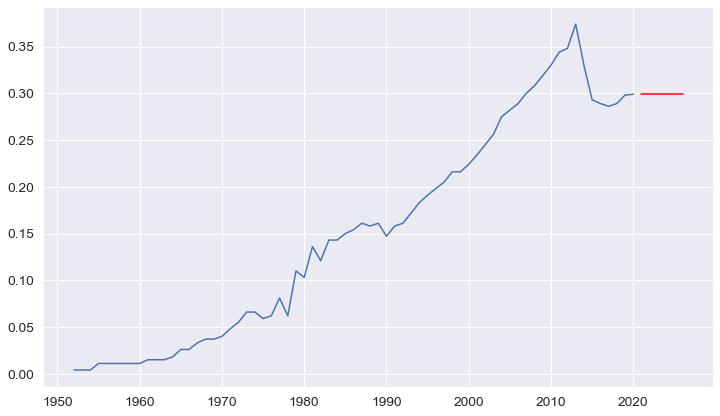

---------------------------------------------------------------------------------
Somalia


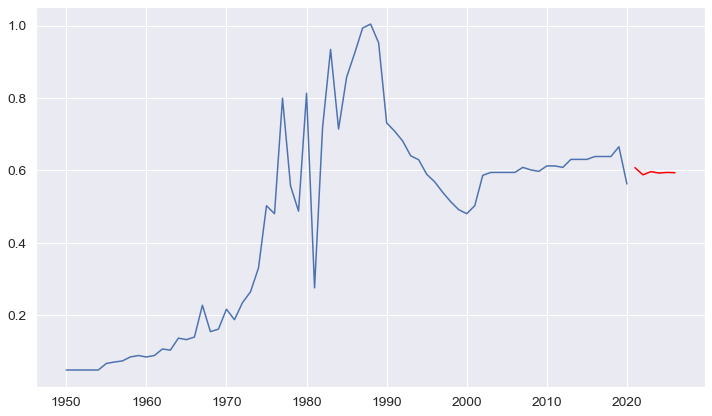

---------------------------------------------------------------------------------
South Africa


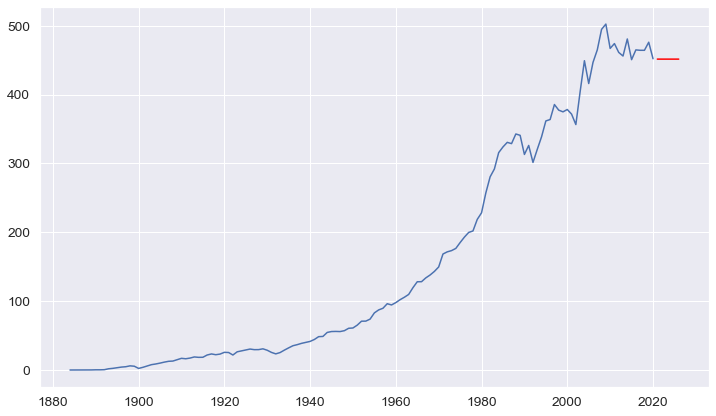

---------------------------------------------------------------------------------
South America


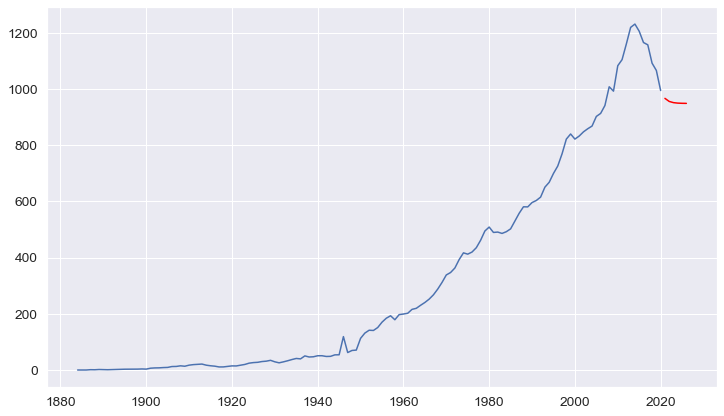

---------------------------------------------------------------------------------
South Korea


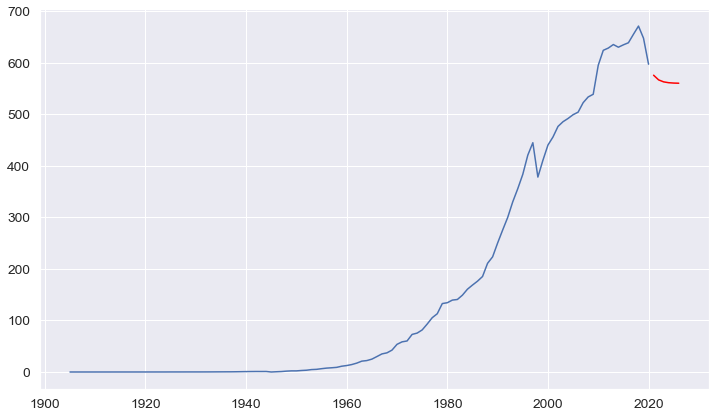

---------------------------------------------------------------------------------
South Sudan


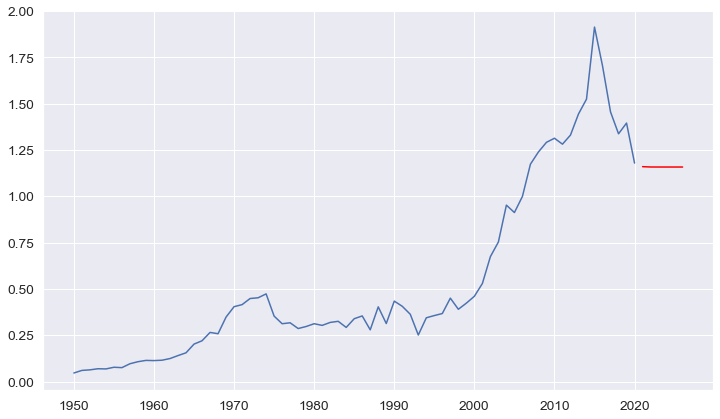

---------------------------------------------------------------------------------
Spain


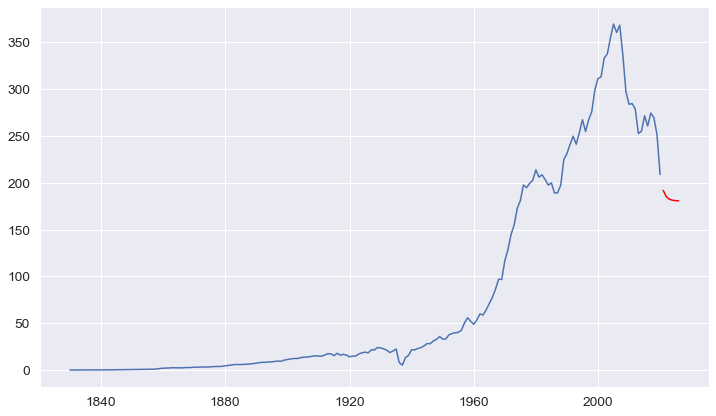

---------------------------------------------------------------------------------
Sri Lanka


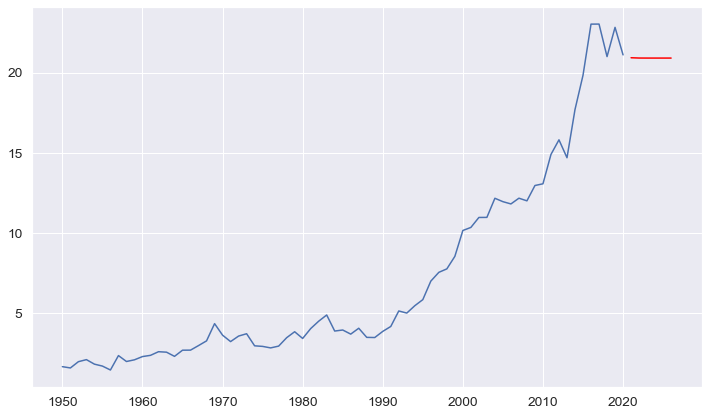

---------------------------------------------------------------------------------
St. Kitts-Nevis-Anguilla


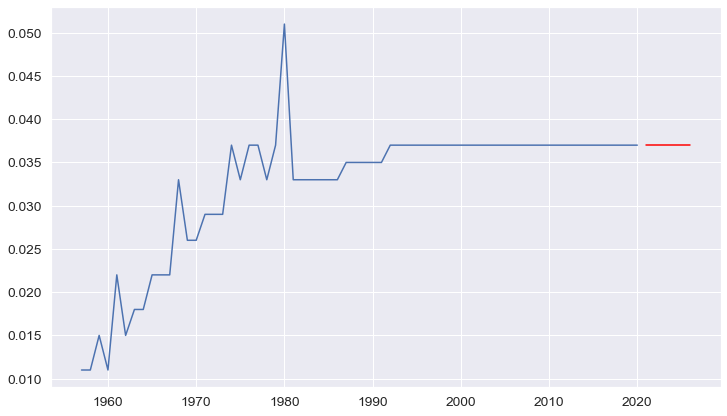

---------------------------------------------------------------------------------
Sudan


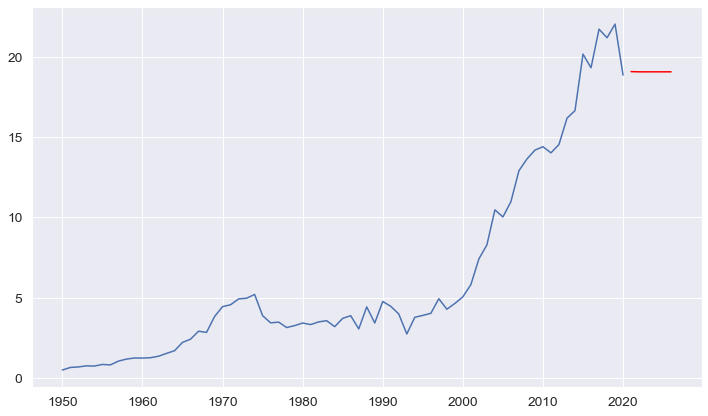

---------------------------------------------------------------------------------
Suriname


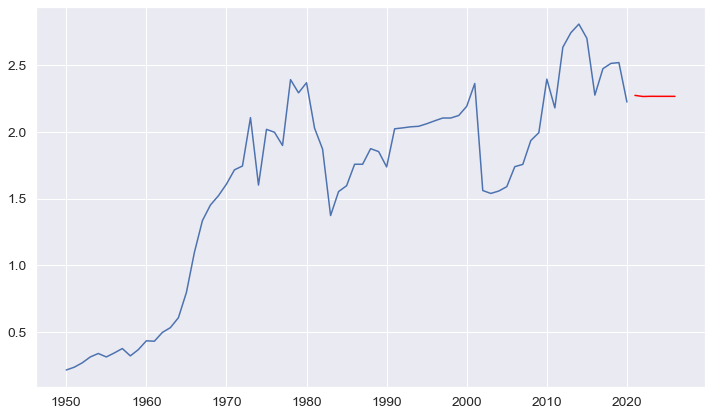

---------------------------------------------------------------------------------
Sweden


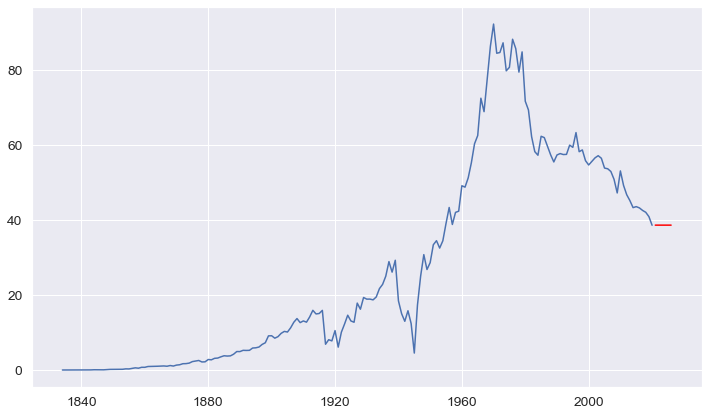

---------------------------------------------------------------------------------
Switzerland


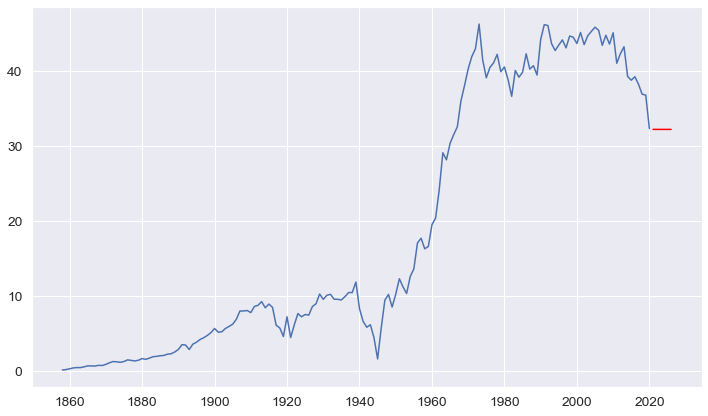

---------------------------------------------------------------------------------
Syria


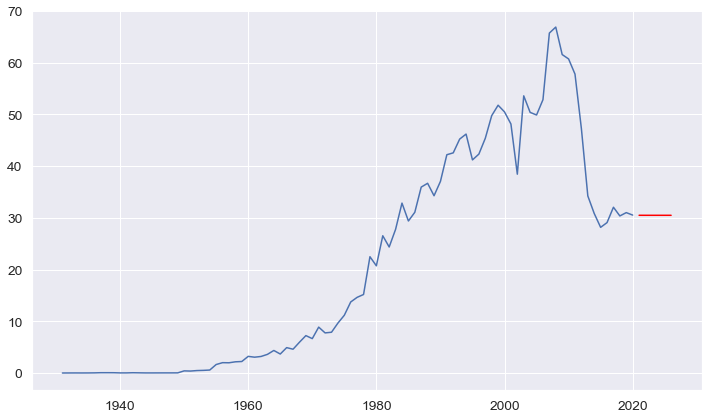

---------------------------------------------------------------------------------
Taiwan


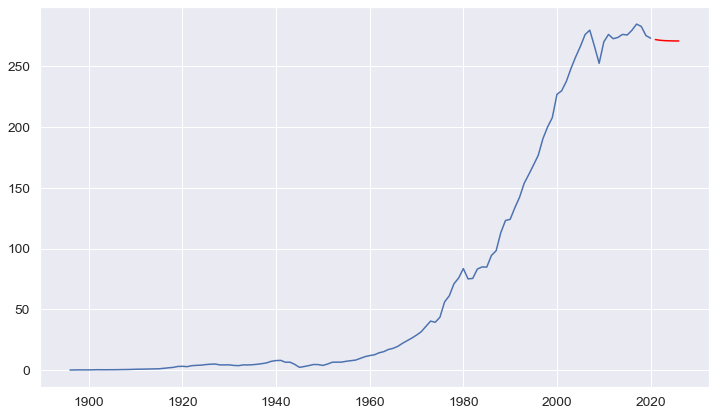

---------------------------------------------------------------------------------
Tajikistan


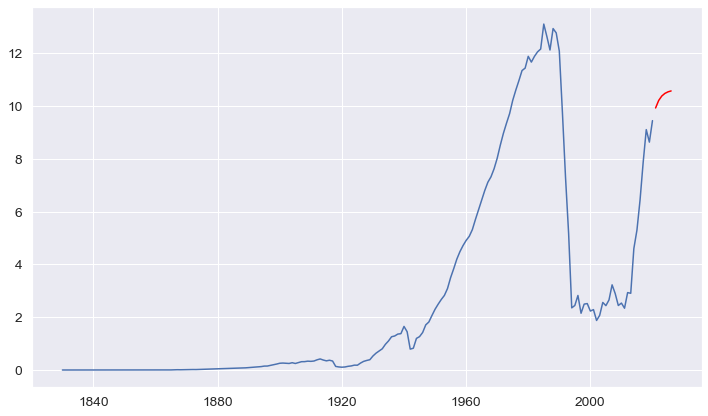

---------------------------------------------------------------------------------
Tanzania


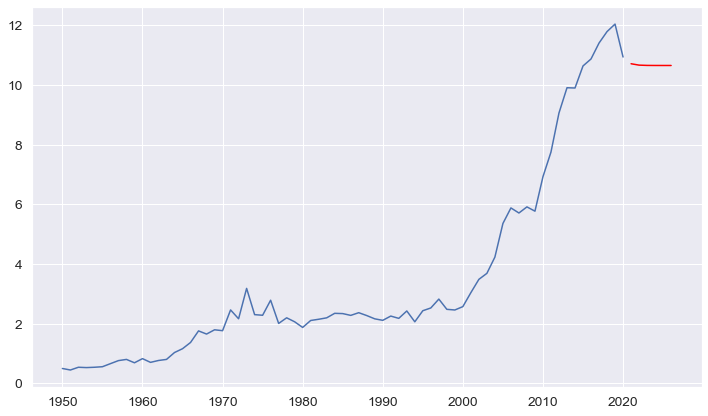

---------------------------------------------------------------------------------
Thailand


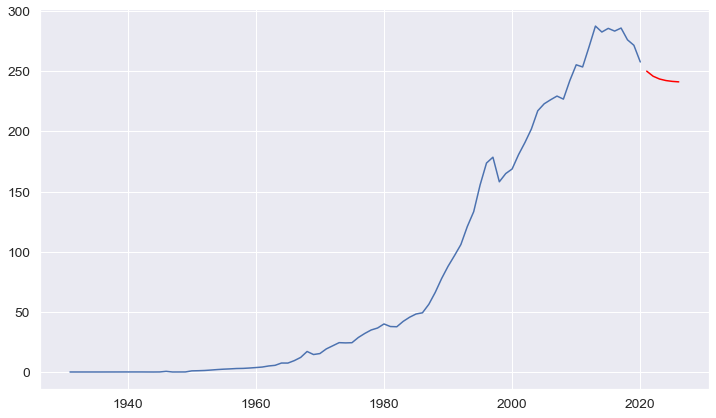

---------------------------------------------------------------------------------
Timor


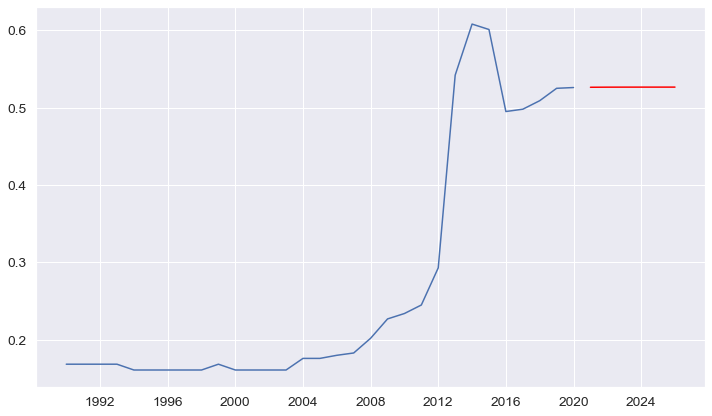

---------------------------------------------------------------------------------
Togo


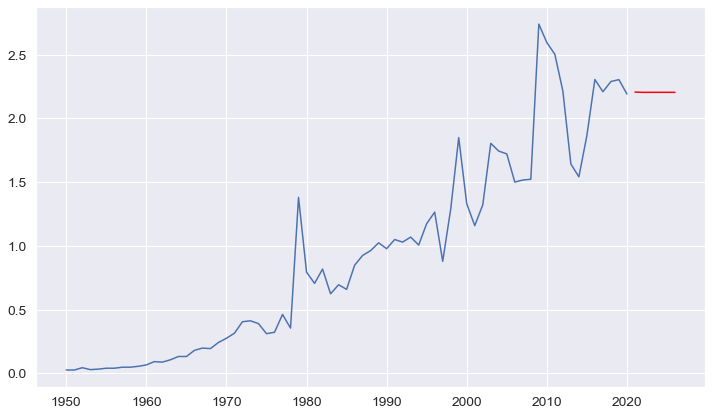

---------------------------------------------------------------------------------
Tonga


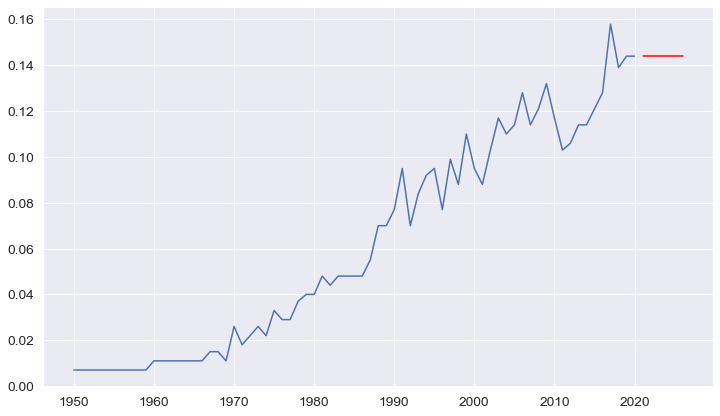

---------------------------------------------------------------------------------
Trinidad and Tobago


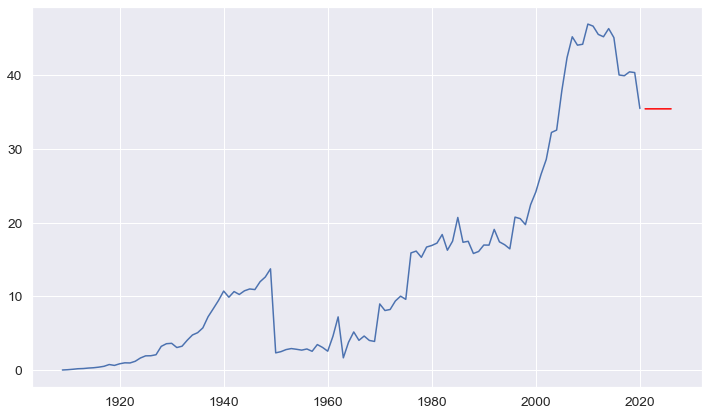

---------------------------------------------------------------------------------
Tunisia


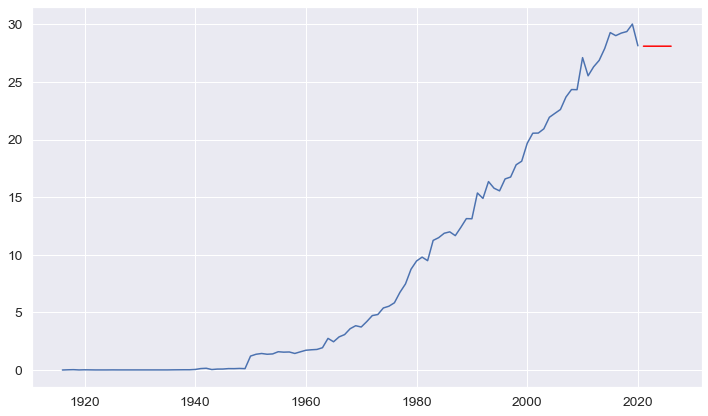

---------------------------------------------------------------------------------
Turkey


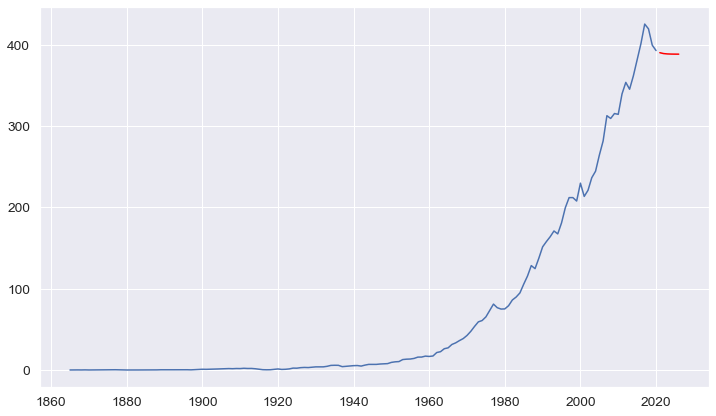

---------------------------------------------------------------------------------
Turkmenistan


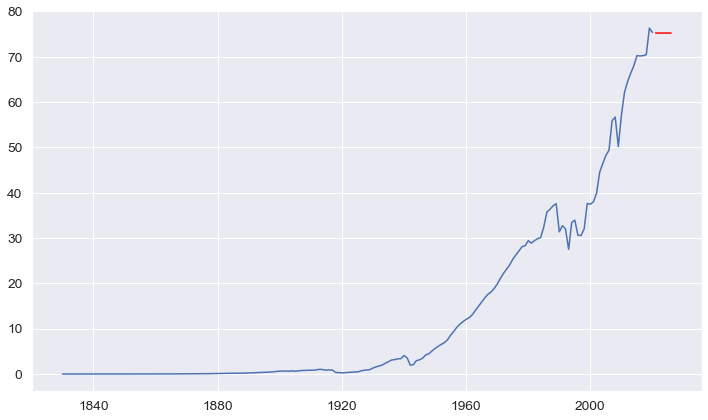

---------------------------------------------------------------------------------
Turks and Caicos Islands


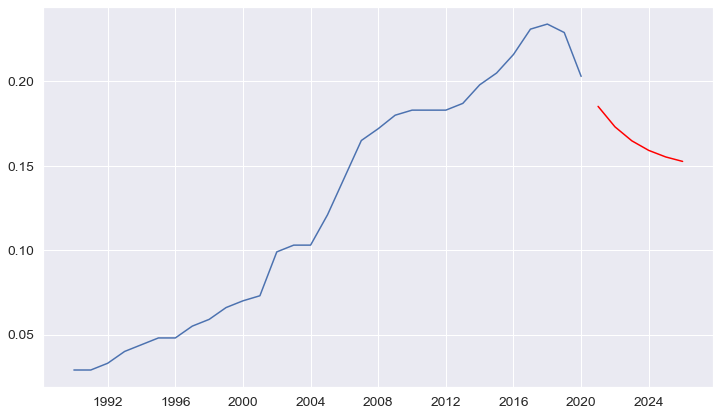

---------------------------------------------------------------------------------
Tuvalu


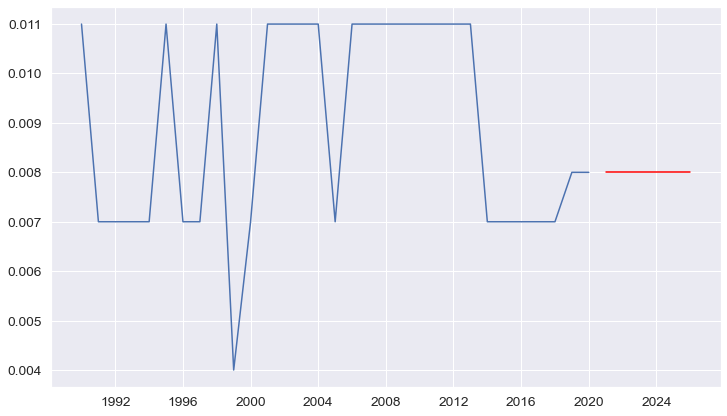

---------------------------------------------------------------------------------
Uganda


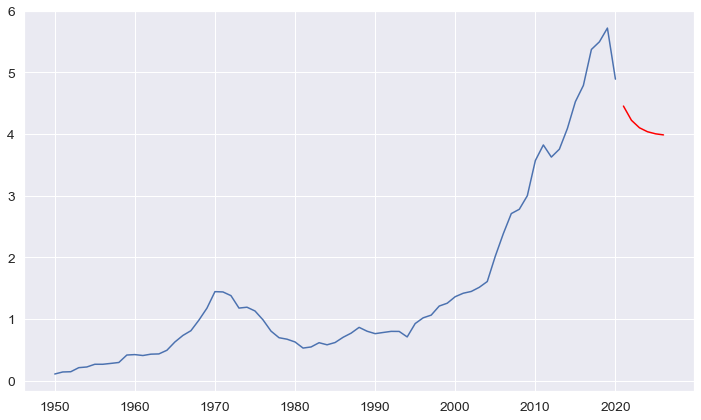

---------------------------------------------------------------------------------
Ukraine


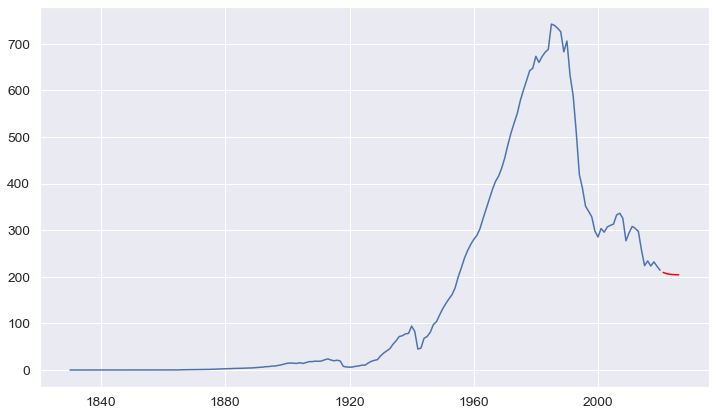

---------------------------------------------------------------------------------
United Arab Emirates


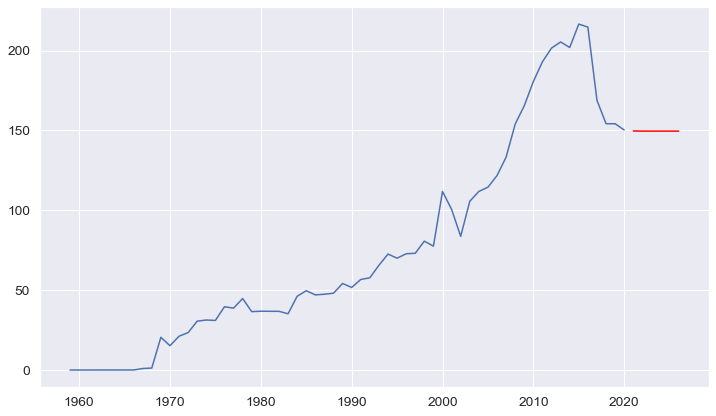

---------------------------------------------------------------------------------
United Kingdom


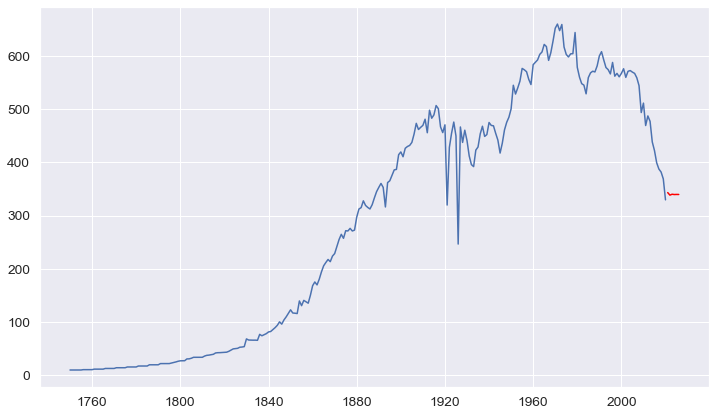

---------------------------------------------------------------------------------
United States


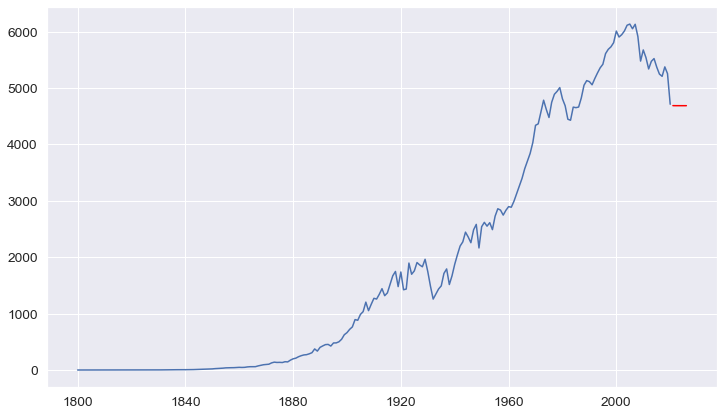

---------------------------------------------------------------------------------
Upper-middle-income countries


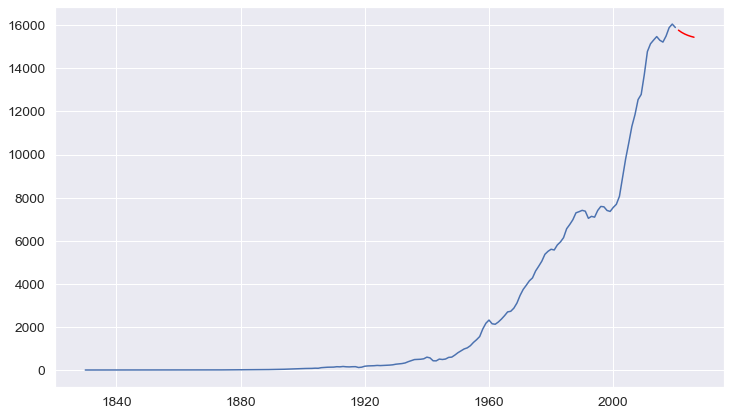

---------------------------------------------------------------------------------
Uruguay


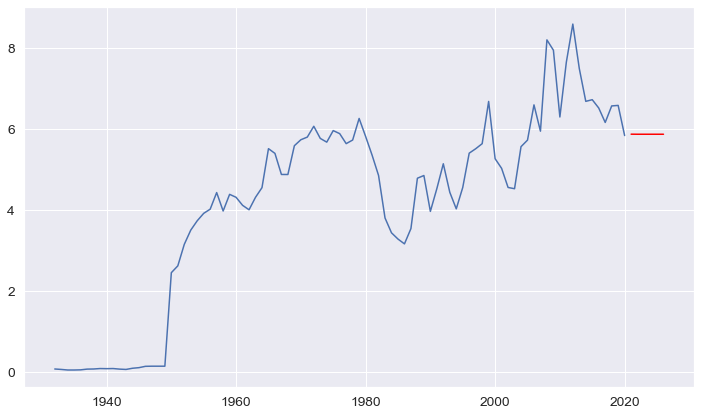

---------------------------------------------------------------------------------
Uzbekistan


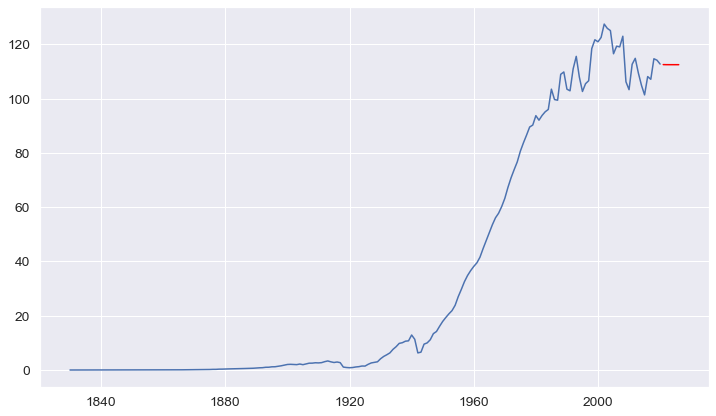

---------------------------------------------------------------------------------
Vanuatu


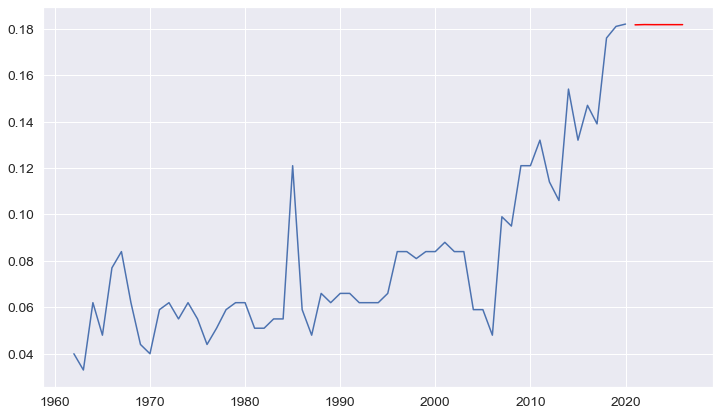

---------------------------------------------------------------------------------
Venezuela


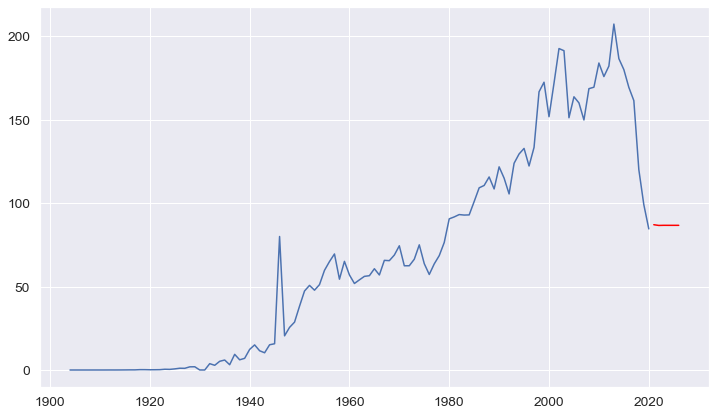

---------------------------------------------------------------------------------
Vietnam


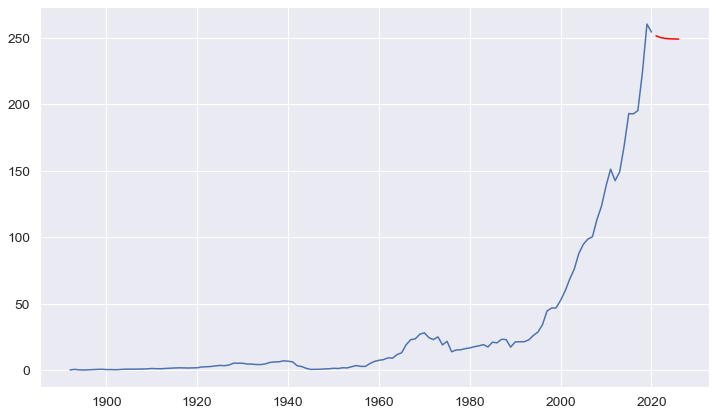

---------------------------------------------------------------------------------
Wallis and Futuna


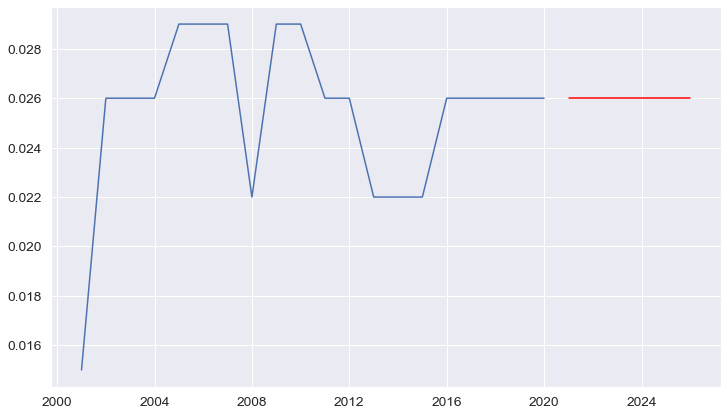

---------------------------------------------------------------------------------
World


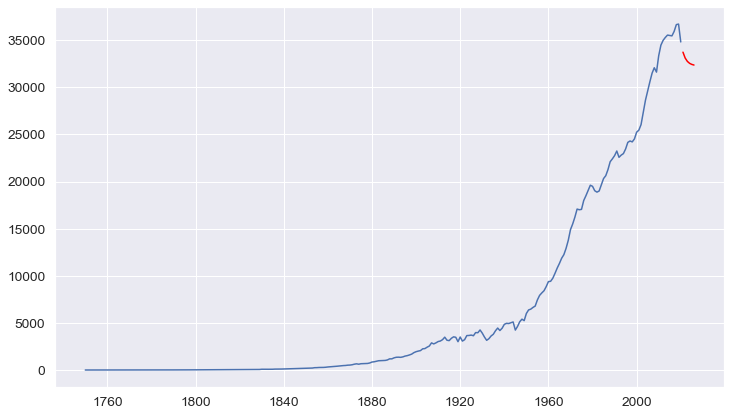

---------------------------------------------------------------------------------
Yemen


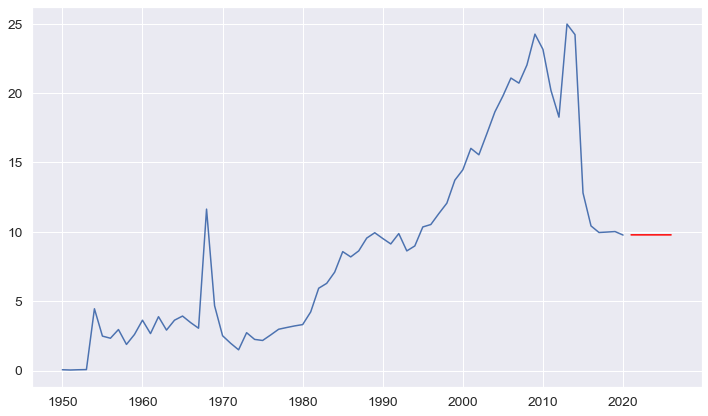

---------------------------------------------------------------------------------
Zambia


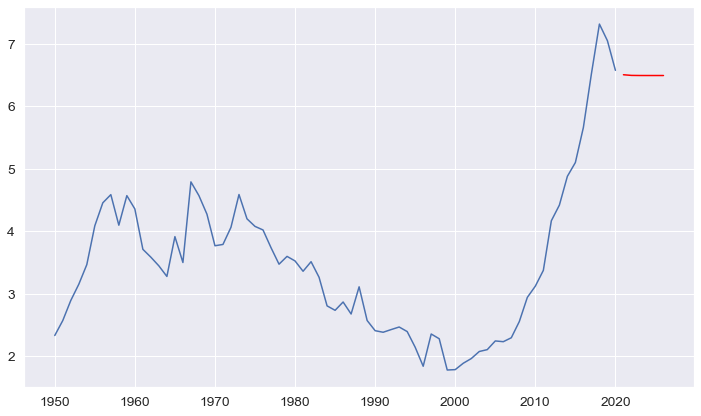

---------------------------------------------------------------------------------
Zimbabwe


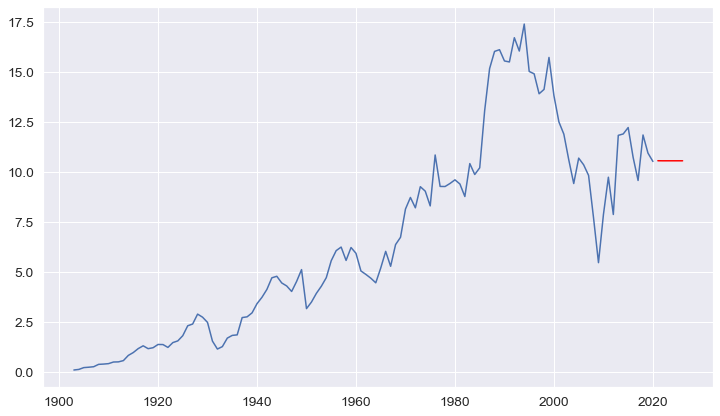

<Figure size 864x504 with 0 Axes>

In [227]:
for country in countries:
    original_df = data[data.country == country]
    original_df = original_df['co2']
    
    prediction_co2 = predictions[predictions.country == country].co2
    
    print('---------------------------------------------------------------------------------')
    print(country)

    plt.rcParams["figure.figsize"] = (12, 7)
    pyplot.plot(original_df)
    pyplot.plot(prediction_co2, color='red')
    pyplot.show()
    pyplot.savefig('predictions.pdf', bbox_inches='tight')


## Inserting our predictions values into our original dataframe

In [219]:
# assign dataframes
data1 = data
  
data2 = predictions

# merge two data frames
print('After merging')
final_df = pd.concat([data1, data2], axis=0)
final_df

After merging


,co2,co2_per_capita,cement_co2,cement_co2_per_capita,coal_co2,coal_co2_per_capita,gas_co2,gas_co2_per_capita,oil_co2,oil_co2_per_capita,...,methane,methane_per_capita,nitrous_oxide,nitrous_oxide_per_capita,population,gdp,primary_energy_consumption,energy_per_capita,energy_per_gdp,country
year,,,,,,,,,,,,,,,,,,,,,
1949-01-01,0.015000,0.002,0.018,0.0020,0.015,0.002,0.3235,0.0295,0.0645,0.008,...,9.46,0.574,3.245,0.1980,7624058.0,9.556840e+09,8.2840,624.8360,0.5345,Afghanistan
1950-01-01,0.084000,0.011,0.038,0.0035,0.021,0.003,0.2385,0.0220,0.0630,0.008,...,11.43,0.475,3.835,0.1595,7752117.0,9.421400e+09,5.2905,217.8925,0.2385,Afghanistan
1951-01-01,0.092000,0.012,0.018,0.0020,0.026,0.003,0.3035,0.0290,0.0660,0.008,...,11.23,0.549,3.885,0.1900,7840151.0,9.692280e+09,7.2700,458.9350,0.5470,Afghanistan
1952-01-01,0.092000,0.012,0.018,0.0020,0.032,0.004,0.3035,0.0290,0.0600,0.008,...,11.23,0.549,3.885,0.1900,7935996.0,1.001733e+10,7.2700,458.9350,0.5470,Afghanistan
1953-01-01,0.106000,0.013,0.018,0.0020,0.038,0.005,0.3035,0.0290,0.0680,0.008,...,11.23,0.549,3.885,0.1900,8039684.0,1.063052e+10,7.2700,458.9350,0.5470,Afghanistan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-01-01,10.564310,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
2023-01-01,10.564589,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe
2024-01-01,10.564564,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Zimbabwe


In [223]:
final_df.shape

(27477, 43)

In [222]:
co2_df.shape

(25989, 44)

#### Exporting our dataframe to a cvs

In [220]:
#Saving a new csv file with our new cleaned dataset for tableu
final_df.to_csv('C:/Users/Quinn/Practicum Project/final_cleaned_co2.csv')

## ARIMA Predictions for 'cement_co2', 'coal_co2', 'gas_co2', 'oil_co2', 'nitrous_oxide', 'methane' columns

def arima_model(column):    
    total_predictions = list()
    country_list = list()
    total_history = list()
    all_dates = list()

    for country in countries:
        df = data[data.country == country]
        dates = data.index

        count = len(df.country)
        l = []
        x = str(country)
        for i in range(count):
            l.append(x)
        #adding the country into our country list
        country_list.append(l)

        df = df.drop(columns=['country'])

        # split into train and test sets
        X = df[column].values
        size = int(len(X) * 0.66)
        train, test = X[0:size], X[size:len(X)]
        history = [x for x in train]
        predictions = list()

        print('-----------------------------------------------------------------------')
        print(country)
        print(column)

        # walk-forward validation
        for t in range(len(test)):
            model = ARIMA(history, order=(1,1,0))
            model_fit = model.fit()
            output = model_fit.forecast()
            yhat = output[0]
            predictions.append(yhat)
            obs = test[t]
            history.append(obs)
            print('predicted=%f, expected=%f' % (yhat, obs))

        total_predictions.append(predictions)
        total_history.append(history)
        all_dates.append(dates)

        # evaluate forecasts
        rmse = sqrt(mean_squared_error(test, predictions))
        print('Test RMSE: %.3f' % rmse)
        # plot forecasts against actual outcomes
        plt.rcParams["figure.figsize"] = (12, 7)
        pyplot.plot(test)
        pyplot.plot(predictions, color='red')
        pyplot.show()

temp = data.drop(columns=['country', 'co2'])

columns = list()
columns = temp.columns

columns

columns = ['cement_co2', 'coal_co2', 'gas_co2', 'oil_co2', 'nitrous_oxide', 'methane']

#### Fitting the model for each of our columns

for col in columns:
    arima_model(col)

#### Predicting the values for each of our columns for years 2021-2026

total_predictions = list()
country_list = list()
dates = ['2021', '2022', '2023', '2024', '2025', '2026']
def arima_predictions(column, prediction_df):
    all_dates = list()
    for country in countries:
        df = data[data.country == country]
        #dates = data.index
        all_dates.append(dates)

        count = 6
        l= []
        x = str(country)
        for i in range(count):
            l.append(x)
        #adding country to our country list

        country_list.append(l)


        df = df.drop(columns=['country'])
        print(df.shape)


        model2 = ARIMA(df[column], order=(1, 1, 0))
        model2 = model2.fit()

        #future years predictions
        preds = list()
        index_future_dates = pd.date_range(start='2021-01-01', end='2026-01-01', freq='8760H')

        predictions = model2.predict(start=len(df), end=len(df)+5, typ='levels').rename('ARIMA Predictions')
        yhat = predictions[0]
        preds.append(yhat)



        total_predictions.append(predictions)

        predictions.plot(legend=True)
        print(country)
        print(column)
        
        print(predictions)

for col in columns:
    df = pd.DataFrame(columns=['year', 'country', col])
    arima_predictions(col, df)

total_predictions

len(total_predictions)

country_list

len(co2_df.country.unique())

pred = pd.DataFrame(columns=['year', 'country', 'cement_co2', 'coal_co2', 'gas_co2', 'oil_co2', 'nitrous_oxide', 'methane'])

pred

merged_country = list(itertools.chain(*country_list))

len(merged_country)

pred['country'] = merged_country

all_dates

merged_dates = list(itertools.chain(*all_dates))

pred['year'] = merged_dates

country_counts = len(co2_df.country.unique())
date_counts = len(dates)
merged_predictions = list()

for i in range(country_counts):
    for j in range(date_counts):
        merged_predictions.append(total_predictions[i][j])

len(total_predictions)

merged_predictions

cement_co2 = merged_predictions[0:1489]

cement_co2

len(merged_predictions)

len(cement_co2)

pred['cement_co2'] = cement_co2

coal_co2 = merged_predictions[1489:2976]

len(coal_co2)

pred['coal_co2'] = coal_co2